# Writing a training loop from scratch
https://www.tensorflow.org/guide/keras/writing_a_training_loop_from_scratch

## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_models import *
from ipynb.fs.full.myfun_nn import *
from ipynb.fs.defs.myfun_plot import *

2023-09-09 00:20:26.421753: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Tensorflow/Keras: 2.11.0
sklearn: 1.3.0


## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"
processed_flag = 'post'
merged_df, dflist = load_dataset(dir_name, processed_flag)

## Get $v_{0}$ mean over each df looping on dflist

In [3]:
# params
v0_guess = 30
NUM_ITER = 350
LEARNING_RATE_v0 = 0.5
flag_save = True

In [4]:
# Create the model NN
DOE =[[1,2,1], [1,4,1], [1,10,1]] #Design of experiment

# Create the dataset
dataset = dflist



NN structure: 1-2-1
****************************************************************************************************
In df n.1/10 we have 28 scenes
****************************************************************************************************
            - Time interval n.0: [14.24, 14.44]
                * y_true: [32.1443344  20.77111865]
                * v_ann: [26.52194595336914, 27.964004516601562, 27.63629536512858]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [14.44, 14.64]
                * y_true: [32.5721373  24.27162308]
                * v_ann: [28.148696899414062, 27.01963996887207, 27.63629536512858]

----------------------------------------------------------------------------------------------------
            * err= 1.266913339967216
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0015123215982650873


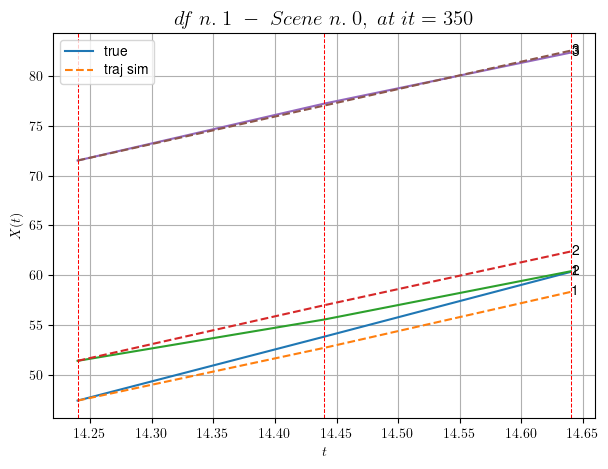

        For scene 0/28
        * use LR_NN=0.001 with err=18.361335833571175 at it=19
        * v0_scn_mean = 27.838881482454543
        * MAE = 1.266913339967216



            - Time interval n.0: [23.64, 23.84]
                * y_true: [26.6509107  26.65125804]
                * v_ann: [27.51402473449707, 26.672809600830078, 31.184412007415922]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [27.47565460205078, 26.7515869140625, 31.184412007415922]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [27.707202911376953, 27.21336555480957, 31.184412007415922]

----------------------------------------------------------------------------

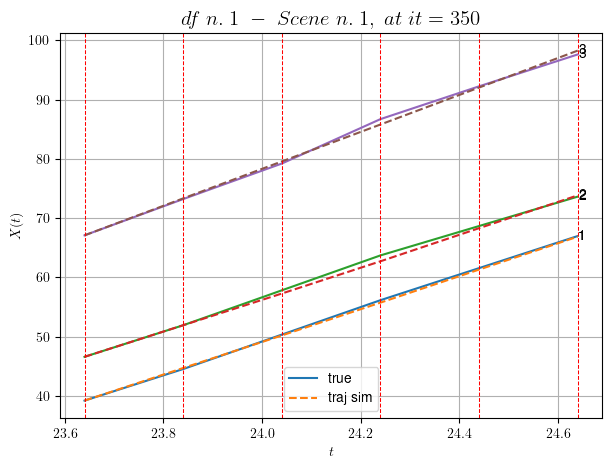

        For scene 1/28
        * use LR_NN=0.0001 with err=33.93524400863389 at it=19
        * v0_scn_mean = 31.08289956531264
        * MAE = 0.1762258123629531



            - Time interval n.0: [72.44, 72.64]
                * y_true: [25.85001228 31.10049693]
                * v_ann: [26.55873680114746, 28.387540817260742, 28.250933212462645]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.64, 72.84]
                * y_true: [30.00006309 33.82077482]
                * v_ann: [26.986858367919922, 28.796533584594727, 28.250933212462645]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.84, 73.04]
                * y_true: [23.75011307 26.19081077]
                * v_ann: [28.718860626220703, 29.743515014648438, 28.250933212462645]

------------------------------------------------------------------------

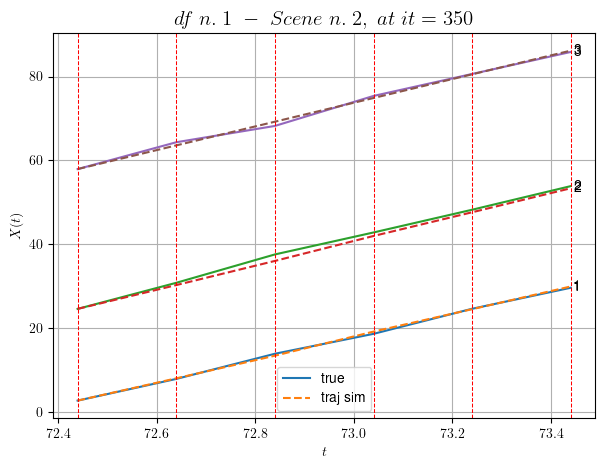

        For scene 2/28
        * use LR_NN=0.0001 with err=3.3552855794797014 at it=19
        * v0_scn_mean = 28.400840541916395
        * MAE = 0.29557278952892835



            - Time interval n.0: [84.24, 84.44]
                * y_true: [29.4403562  23.48047527]
                * v_ann: [21.47234535217285, 25.114160537719727, 29.49436924721101]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [84.44, 84.64]
                * y_true: [27.01049004 24.28067739]
                * v_ann: [22.33160972595215, 29.652450561523438, 29.49436924721101]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [84.64, 84.84]
                * y_true: [27.60069732 32.65118399]
                * v_ann: [21.15283203125, 23.575313568115234, 29.49436924721101]

-----------------------------------------------------------------------------

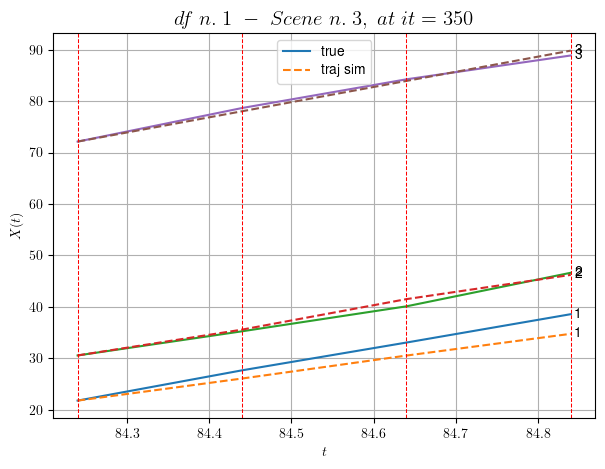

        For scene 3/28
        * use LR_NN=0.0005 with err=25.098945309285444 at it=19
        * v0_scn_mean = 29.53770536014881
        * MAE = 1.2036013430973638



            - Time interval n.0: [131.64, 131.84]
                * y_true: [30.80073929 29.11067519]
                * v_ann: [26.808828353881836, 22.302427291870117, 28.442903953643]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.84, 132.04]
                * y_true: [30.16079766 28.07097758]
                * v_ann: [28.42342758178711, 36.773868560791016, 28.442903953643]

----------------------------------------------------------------------------------------------------
            * err= 0.47732157764579314
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.008444042453425282


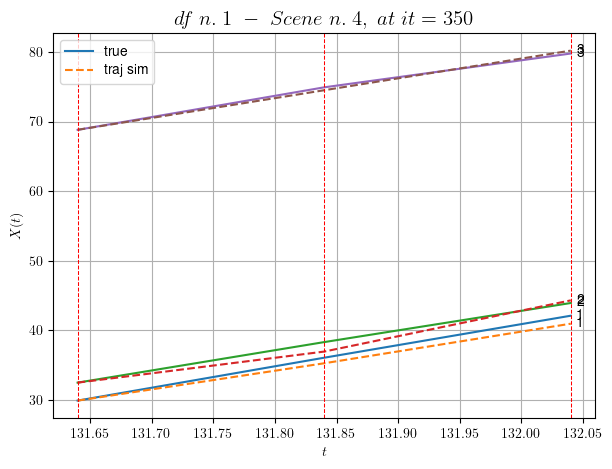

        For scene 4/28
        * use LR_NN=0.0005 with err=17.601005173596132 at it=19
        * v0_scn_mean = 28.57635803994525
        * MAE = 0.4186264695326045



            - Time interval n.0: [148.04, 148.24]
                * y_true: [21.93113488 25.90203153]
                * v_ann: [26.209501266479492, 26.214340209960938, 27.62167390672513]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [148.24, 148.44]
                * y_true: [23.17638158 33.20310746]
                * v_ann: [25.936983108520508, 25.96316909790039, 27.62167390672513]

----------------------------------------------------------------------------------------------------
            * err= 0.5196930508019525
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00011393117864089142


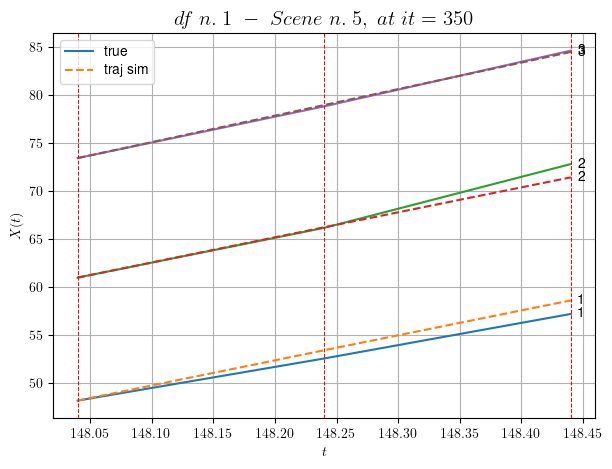

        For scene 5/28
        * use LR_NN=0.0001 with err=0.8115644845597109 at it=19
        * v0_scn_mean = 27.825513185907507
        * MAE = 0.5169543055355343



            - Time interval n.0: [161.64, 161.84]
                * y_true: [31.66062591 25.70084842]
                * v_ann: [28.62908172607422, 28.537090301513672, 34.71178115125162]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [161.84, 162.04]
                * y_true: [29.96082912 27.30094687]
                * v_ann: [28.6909122467041, 28.765077590942383, 34.71178115125162]

----------------------------------------------------------------------------------------------------
            * err= 0.2808525506434593
            * Learning rate NN = 0.00036449998151510954
            * diff = 4.471305689035532e-07


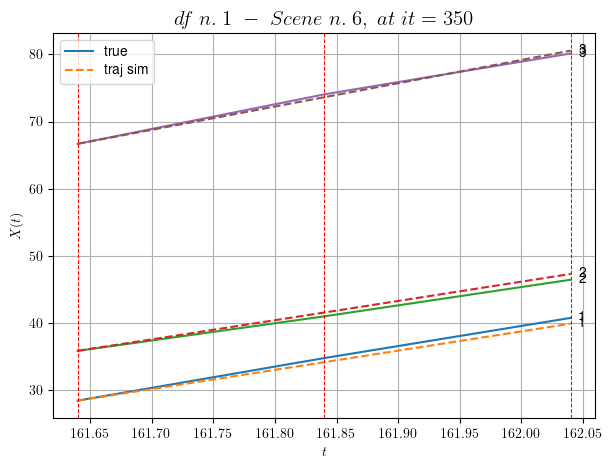

        For scene 6/28
        * use LR_NN=0.0005 with err=13.10752025361149 at it=19
        * v0_scn_mean = 34.30794835630691
        * MAE = 0.2577331558229889



        For scene 7/28
        * use LR_NN=0.0005 with err=1.494595592392726 at it=19
        * v0_scn_mean = 32.140969810118825
        * MAE = 3.749294805530107



        For scene 8/28
        * use LR_NN=0.0005 with err=1.8602995113307552 at it=19
        * v0_scn_mean = 36.50803476622434
        * MAE = 45.21914520773556



            - Time interval n.0: [216.64, 216.84]
                * y_true: [37.52054047 34.13112536]
                * v_ann: [35.9346923828125, 36.745849609375, 34.8517900522816]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [216.84, 217.04]
                * y_true: [39.83095433 33.81148861]
                * v_ann: [35.71519088745117, 36.38134765625, 34.8517900522816]

-------------------------------------

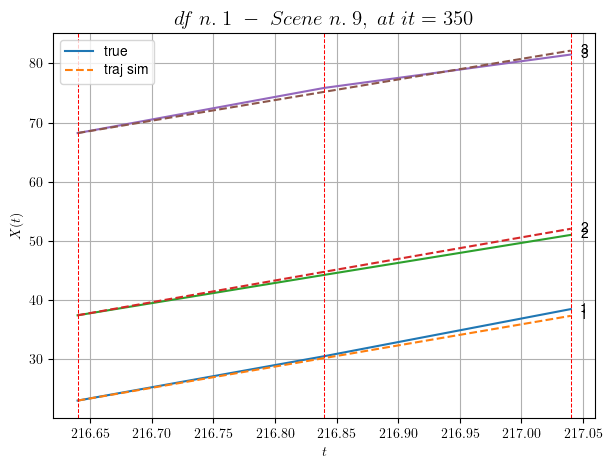

        For scene 9/28
        * use LR_NN=0.0001 with err=9.661024143728232 at it=19
        * v0_scn_mean = 34.43595750947035
        * MAE = 0.4038875473855857



            - Time interval n.0: [240.64, 240.84]
                * y_true: [28.54090912 24.62265201]
                * v_ann: [39.24374771118164, 28.972070693969727, 33.344745672340764]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [240.84, 241.04]
                * y_true: [33.36143299 35.0745887 ]
                * v_ann: [22.661218643188477, 23.243833541870117, 33.344745672340764]

----------------------------------------------------------------------------------------------------
            * err= 0.8419600738184988
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0038974257338599827


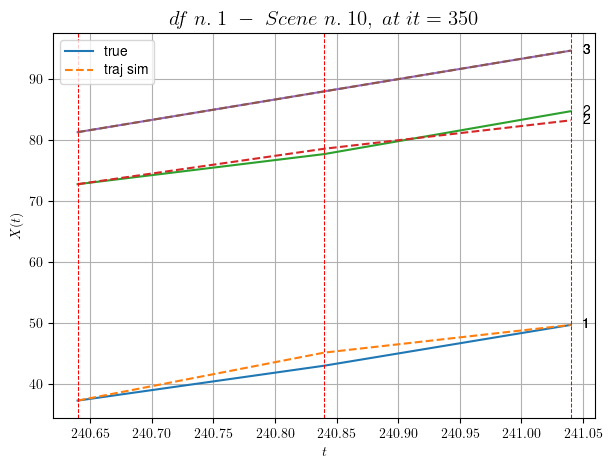

        For scene 10/28
        * use LR_NN=0.0005 with err=10.383226221197436 at it=19
        * v0_scn_mean = 33.058077435876
        * MAE = 0.8419600738184988



            - Time interval n.0: [253.64, 253.84]
                * y_true: [26.81042151 28.10122634]
                * v_ann: [30.268775939941406, 31.360107421875, 27.474897828444977]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [253.84, 254.04]
                * y_true: [31.5007643  35.35225595]
                * v_ann: [29.523160934448242, 30.20036506652832, 27.474897828444977]

----------------------------------------------------------------------------------------------------
            * err= 0.13486317678134085
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0006999297003928706


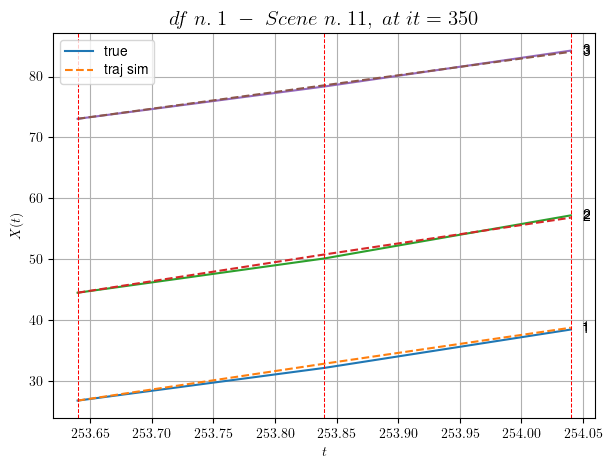

        For scene 11/28
        * use LR_NN=0.0001 with err=1.5396942933878064 at it=19
        * v0_scn_mean = 27.691316850196014
        * MAE = 0.1159250488254303



            - Time interval n.0: [262.64, 262.84]
                * y_true: [36.75102901 34.57147294]
                * v_ann: [30.913362503051758, 30.733163833618164, 35.93105457035001]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [262.84, 263.04]
                * y_true: [20.65076329 34.76181544]
                * v_ann: [31.78126335144043, 32.13803482055664, 35.93105457035001]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [263.04, 263.24]
                * y_true: [40.30193432 23.95156631]
                * v_ann: [30.95956039428711, 30.84438705444336, 35.93105457035001]

---------------------------------------------------------------------

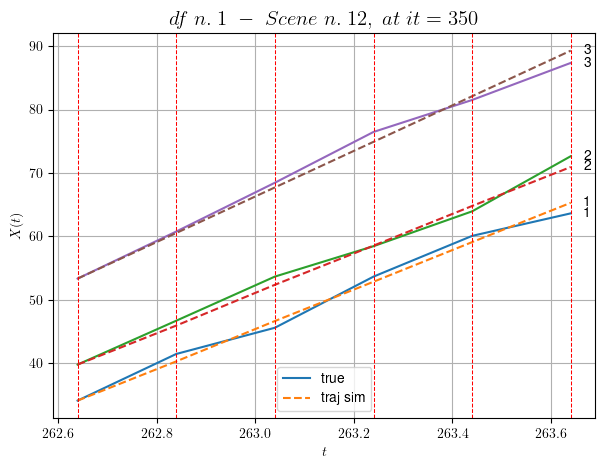

        For scene 12/28
        * use LR_NN=0.0005 with err=37.775669977645116 at it=19
        * v0_scn_mean = 35.42272146505013
        * MAE = 1.0552395748772383



            - Time interval n.0: [314.84, 315.04]
                * y_true: [29.62016755 31.54681236]
                * v_ann: [29.99666976928711, 29.69679832458496, 30.926241166015267]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [315.04, 315.24]
                * y_true: [30.12030665 32.32740505]
                * v_ann: [31.0399227142334, 30.210769653320312, 30.926241166015267]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [315.24, 315.44]
                * y_true: [25.99040223 31.02242591]
                * v_ann: [31.755496978759766, 30.494863510131836, 30.926241166015267]

-------------------------------------------------------------------

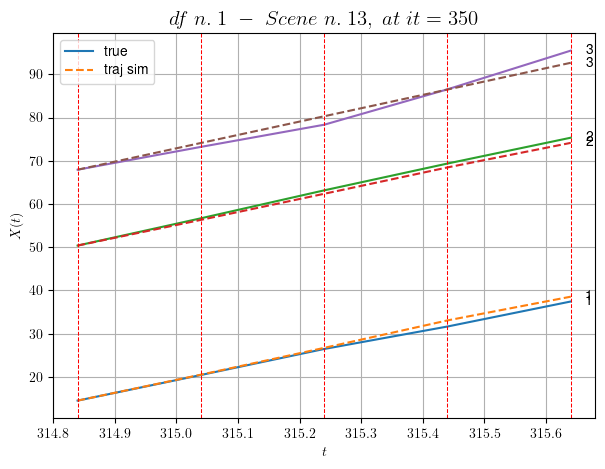

        For scene 13/28
        * use LR_NN=0.0005 with err=22.808847010003216 at it=19
        * v0_scn_mean = 30.846855781410756
        * MAE = 1.260596852636981



            - Time interval n.0: [325.24, 325.44]
                * y_true: [29.06068603 28.85087529]
                * v_ann: [29.18709945678711, 28.55873680114746, 29.804035226087446]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.44, 325.64]
                * y_true: [28.37089255 31.80128105]
                * v_ann: [29.22136116027832, 28.459264755249023, 29.804035226087446]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [325.64, 325.84]
                * y_true: [30.70143178 22.60113815]
                * v_ann: [29.458234786987305, 28.986793518066406, 29.804035226087446]

------------------------------------------------------------------

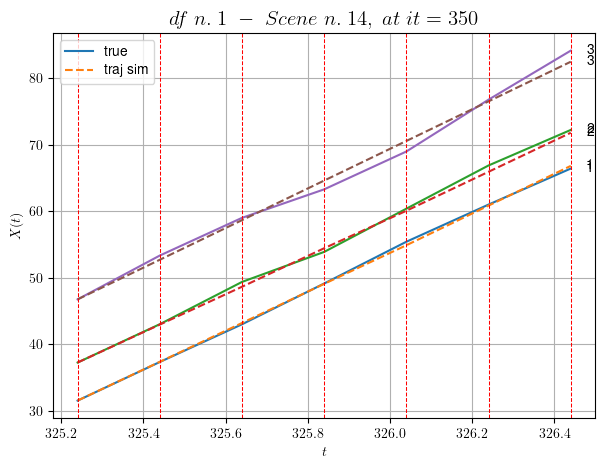

        For scene 14/28
        * use LR_NN=0.001 with err=17.52453876072967 at it=19
        * v0_scn_mean = 29.820830785944782
        * MAE = 0.48216353113705646



            - Time interval n.0: [354.04, 354.24]
                * y_true: [29.77169216 32.15176545]
                * v_ann: [30.27695655822754, 27.530040740966797, 32.69350270999615]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [354.24, 354.44]
                * y_true: [35.38251939 26.55179403]
                * v_ann: [31.062744140625, 30.02081298828125, 32.69350270999615]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [354.44, 354.64]
                * y_true: [26.40441101 27.01000163]
                * v_ann: [27.38876724243164, 30.687009811401367, 32.69350270999615]

------------------------------------------------------------------------

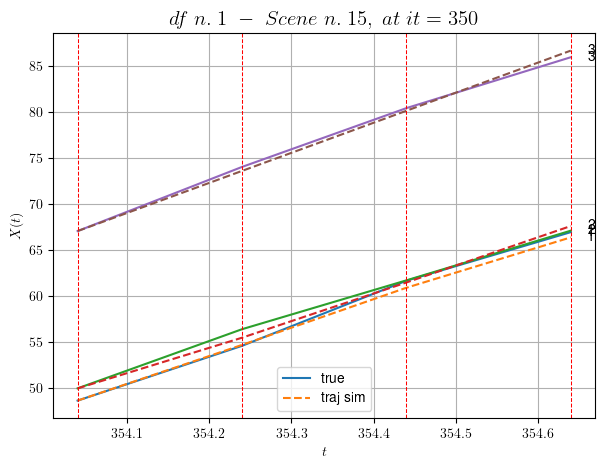

        For scene 15/28
        * use LR_NN=0.001 with err=22.50549207173529 at it=19
        * v0_scn_mean = 32.46265057729916
        * MAE = 0.23857988964950103



            - Time interval n.0: [363.44, 363.64]
                * y_true: [23.6502752  28.55056389]
                * v_ann: [28.68557357788086, 29.45871353149414, 38.923429963342706]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [363.64, 363.84]
                * y_true: [26.3393983  33.66093634]
                * v_ann: [28.424564361572266, 28.134185791015625, 38.923429963342706]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [363.84, 364.04]
                * y_true: [30.2407755  29.94110461]
                * v_ann: [28.601394653320312, 28.958768844604492, 38.923429963342706]

------------------------------------------------------------------

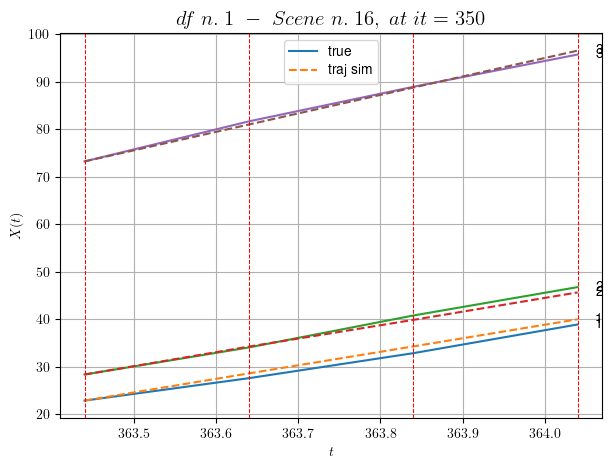

        For scene 16/28
        * use LR_NN=0.0001 with err=24.26447309319103 at it=19
        * v0_scn_mean = 38.158629233659326
        * MAE = 0.61260171950178



            - Time interval n.0: [386.64, 386.84]
                * y_true: [28.15052447 34.1607672 ]
                * v_ann: [34.57210159301758, 36.51673126220703, 39.34603263427208]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [386.84, 387.04]
                * y_true: [34.00091123 38.91120777]
                * v_ann: [32.53606033325195, 30.913864135742188, 39.34603263427208]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.04, 387.24]
                * y_true: [32.52639997 34.00151192]
                * v_ann: [34.848636627197266, 37.03892135620117, 39.34603263427208]

------------------------------------------------------------------------

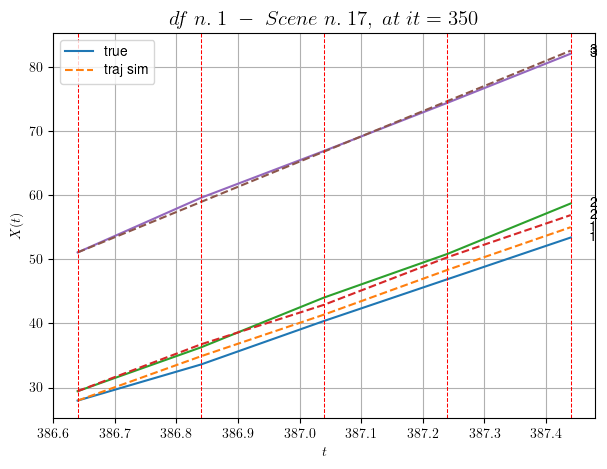

        For scene 17/28
        * use LR_NN=0.001 with err=50.7026466443458 at it=19
        * v0_scn_mean = 38.54501188242043
        * MAE = 0.6809730394074517



            - Time interval n.0: [431.84, 432.04]
                * y_true: [30.8908033  31.49166882]
                * v_ann: [32.25456237792969, 32.266876220703125, 30.084161028049007]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [432.04, 432.24]
                * y_true: [39.73151551 26.376716  ]
                * v_ann: [32.04884338378906, 31.913707733154297, 30.084161028049007]

----------------------------------------------------------------------------------------------------
            * err= 0.4778664262281374
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00014578111096164026


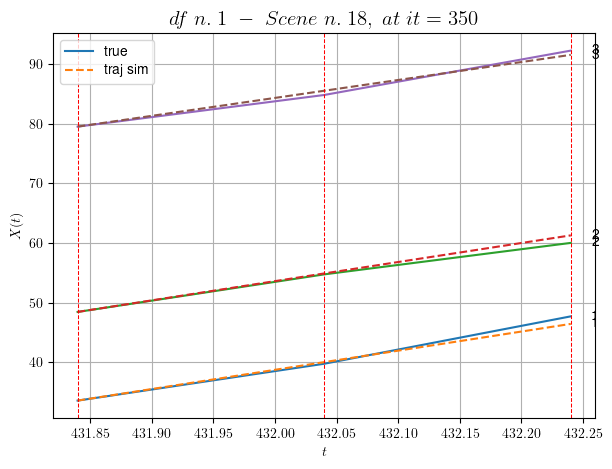

        For scene 18/28
        * use LR_NN=0.0001 with err=7.158051420389246 at it=19
        * v0_scn_mean = 30.076947835820985
        * MAE = 0.40390158551330907



            - Time interval n.0: [446.24, 446.44]
                * y_true: [25.89017971 23.30046083]
                * v_ann: [25.390182495117188, 24.757917404174805, 29.554432428746026]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [446.44, 446.64]
                * y_true: [28.05031625 27.72075411]
                * v_ann: [25.005674362182617, 24.00605583190918, 29.554432428746026]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [446.64, 446.84]
                * y_true: [26.94045507 27.8009832 ]
                * v_ann: [28.53337860107422, 31.127452850341797, 29.554432428746026]

----------------------------------------------------------------

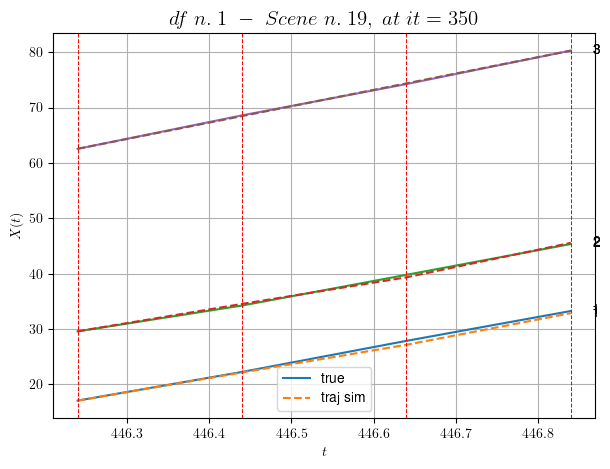

        For scene 19/28
        * use LR_NN=0.001 with err=12.34442723966712 at it=19
        * v0_scn_mean = 29.592620704444073
        * MAE = 0.08385242989012925



            - Time interval n.0: [447.44, 447.64]
                * y_true: [31.0713577  29.31148494]
                * v_ann: [27.90363883972168, 28.111722946166992, 32.58484136741293]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [447.64, 447.84]
                * y_true: [37.68225285 24.50151408]
                * v_ann: [27.95956802368164, 28.20635223388672, 32.58484136741293]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [447.84, 448.04]
                * y_true: [25.261801   20.71149408]
                * v_ann: [27.97406578063965, 28.369665145874023, 32.58484136741293]

----------------------------------------------------------------------

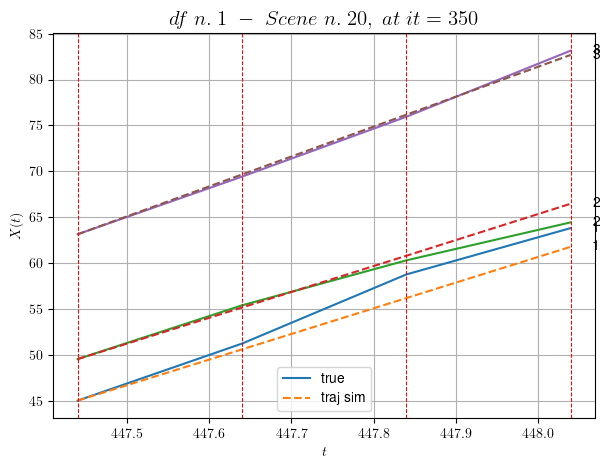

        For scene 20/28
        * use LR_NN=5e-05 with err=26.35719975124376 at it=19
        * v0_scn_mean = 32.36330227627491
        * MAE = 1.3294802919813236



        For scene 21/28
        * use LR_NN=0.001 with err=2.5834202727791644 at it=19
        * v0_scn_mean = 24.166541486145263
        * MAE = 0.8704994300181091



            - Time interval n.0: [496.84, 497.04]
                * y_true: [19.47545433 17.05100655]
                * v_ann: [18.235675811767578, 18.1204833984375, 23.671067862249377]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [497.04, 497.24]
                * y_true: [13.44536038 20.12642582]
                * v_ann: [18.254806518554688, 18.15828514099121, 23.671067862249377]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [497.24, 497.44]
                * y_true: [18.49565962 

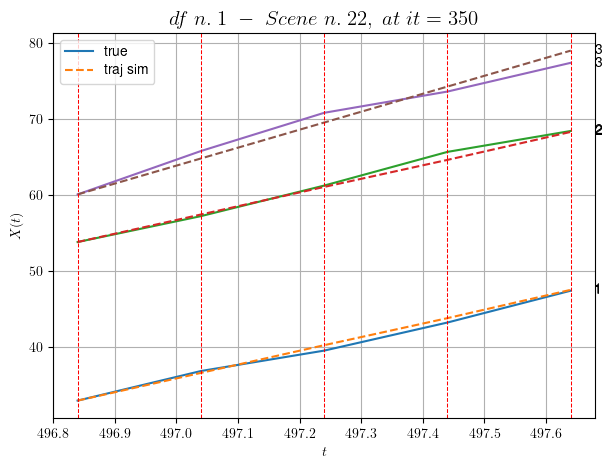

        For scene 22/28
        * use LR_NN=0.0005 with err=14.136356481232431 at it=19
        * v0_scn_mean = 24.213501874388925
        * MAE = 0.5143025452753686



            - Time interval n.0: [499.04, 499.24]
                * y_true: [23.84103851 15.32650765]
                * v_ann: [21.558202743530273, 21.62358283996582, 17.832251439874415]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [499.24, 499.44]
                * y_true: [26.92142921 19.88726092]
                * v_ann: [21.32090187072754, 21.453950881958008, 17.832251439874415]

----------------------------------------------------------------------------------------------------
            * err= 0.7874471147770717
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00019156875282355657


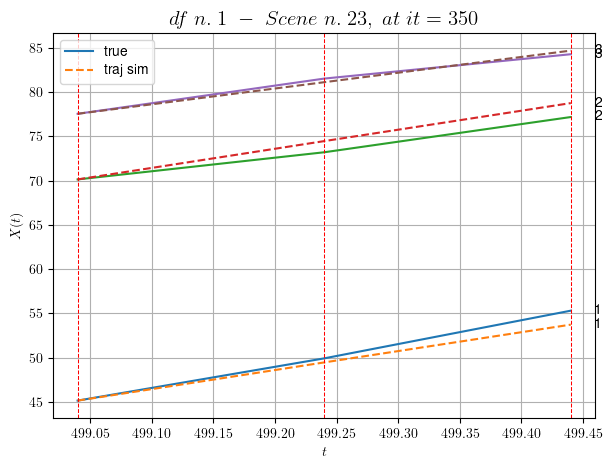

        For scene 23/28
        * use LR_NN=0.0001 with err=5.226036650921323 at it=19
        * v0_scn_mean = 18.875113099080586
        * MAE = 0.7445919525058157



            - Time interval n.0: [500.64, 500.84]
                * y_true: [16.2004483  16.13562888]
                * v_ann: [18.028602600097656, 18.430253982543945, 12.361497672471485]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [500.84, 501.04]
                * y_true: [18.900675   17.67575332]
                * v_ann: [16.453603744506836, 15.77331256866455, 12.361497672471485]

----------------------------------------------------------------------------------------------------
            * err= 0.052502569088972974
            * Learning rate NN = 0.0007289999630302191
            * diff = 8.285474404831628e-07


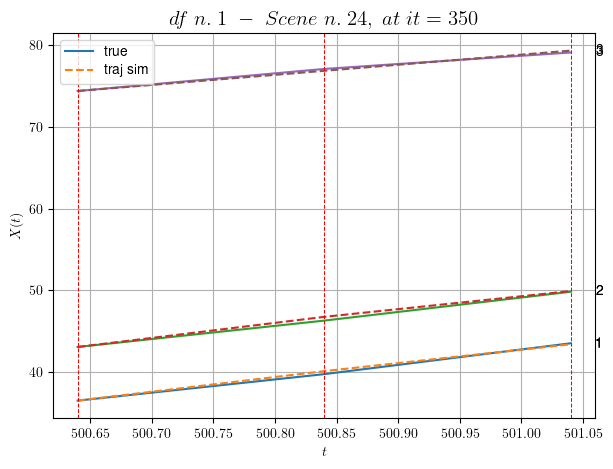

        For scene 24/28
        * use LR_NN=0.001 with err=11.109189783474399 at it=19
        * v0_scn_mean = 13.873241419665247
        * MAE = 0.052118559082327466



            - Time interval n.0: [502.24, 502.44]
                * y_true: [20.97545504 14.04040867]
                * v_ann: [17.8609561920166, 18.200199127197266, 15.581120912086929]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [502.44, 502.64]
                * y_true: [18.07559412 14.7904947 ]
                * v_ann: [17.609371185302734, 17.75984764099121, 15.581120912086929]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [502.64, 502.84]
                * y_true: [18.07559412 14.18054394]
                * v_ann: [17.074241638183594, 16.829919815063477, 15.581120912086929]

----------------------------------------------------------------

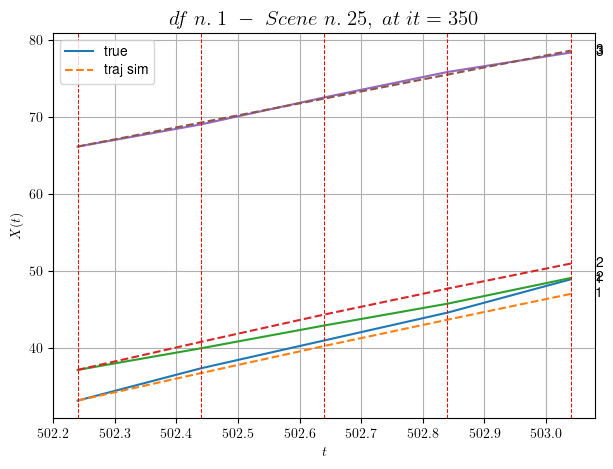

        For scene 25/28
        * use LR_NN=0.001 with err=40.7935525927145 at it=19
        * v0_scn_mean = 16.816920295613482
        * MAE = 1.0419415295352368



            - Time interval n.0: [534.84, 535.04]
                * y_true: [ 8.93323515 20.37071651]
                * v_ann: [17.744651794433594, 18.68567657470703, 29.753484139129853]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.04, 535.24]
                * y_true: [ 8.47527286 31.64140498]
                * v_ann: [16.390233993530273, 16.258485794067383, 29.753484139129853]

----------------------------------------------------------------------------------------------------
            * err= 2.907617096171892
            * Learning rate NN = 0.00036449998151510954
            * diff = 1.0082061141947207e-05


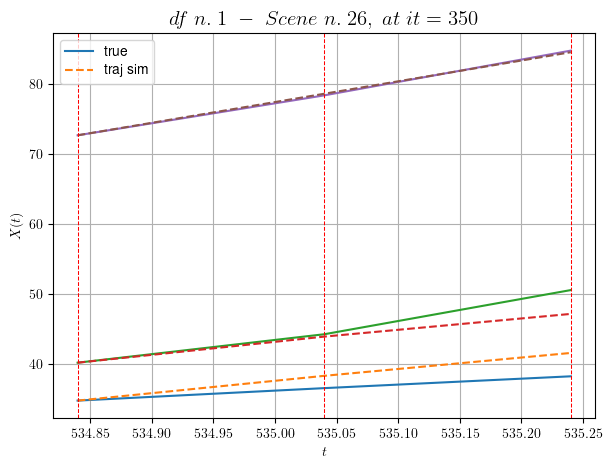

        For scene 26/28
        * use LR_NN=0.0005 with err=1.0628697262385562 at it=19
        * v0_scn_mean = 29.774612282797555
        * MAE = 2.8962872077088644



            - Time interval n.0: [573.84, 574.04]
                * y_true: [20.07571717 13.74586409]
                * v_ann: [13.25574016571045, 13.436470985412598, 9.338868955850456]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [574.04, 574.24]
                * y_true: [13.45064024 11.92582032]
                * v_ann: [14.36572265625, 14.73500919342041, 9.338868955850456]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.24, 574.44]
                * y_true: [13.45064024 11.00083908]
                * v_ann: [13.746430397033691, 14.008755683898926, 9.338868955850456]

-----------------------------------------------------------------------

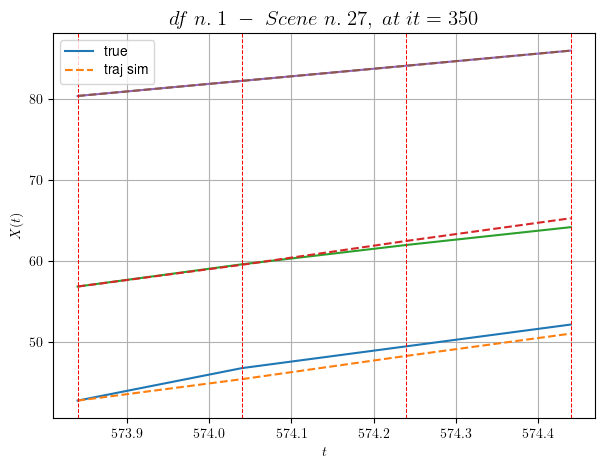

        For scene 27/28
        * use LR_NN=0.0005 with err=22.67499845094248 at it=19
        * v0_scn_mean = 11.10967325011275
        * MAE = 0.4830748423410582



For df=1 with 28 scenes, time taken:        272.97
------------------------------------------------------------
****************************************************************************************************
In df n.2/10 we have 18 scenes
****************************************************************************************************
        For scene 0/18
        * use LR_NN=5e-05 with err=15.818232818772927 at it=19
        * v0_scn_mean = 17.61174379946328
        * MAE = 0.20718348501205097



            - Time interval n.0: [109.36, 109.56]
                * y_true: [28.77160952 15.03115545]
                * v_ann: [22.31959342956543, 22.881675720214844, 20.033930717995364]

----------------------------------------------------------------------------------------------------
            - Time interval n.1:

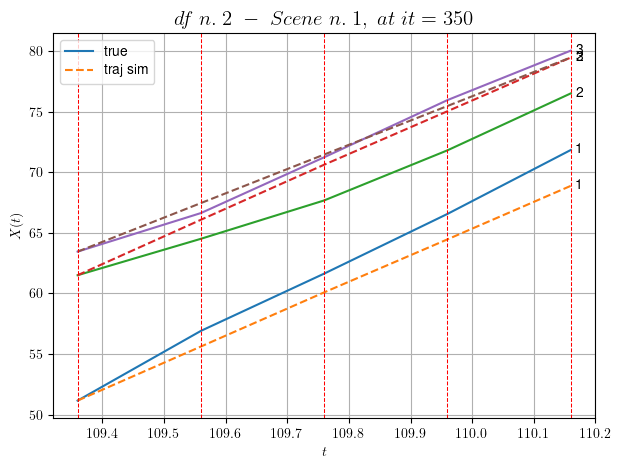

        For scene 1/18
        * use LR_NN=0.0005 with err=11.529771033980808 at it=19
        * v0_scn_mean = 20.88809297289708
        * MAE = 3.2555548804577885



            - Time interval n.0: [170.36, 170.56]
                * y_true: [25.3307413  19.52081588]
                * v_ann: [25.55002784729004, 25.647918701171875, 16.151709457623525]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [29.74113537 17.1608437 ]
                * v_ann: [23.74110221862793, 22.753894805908203, 16.151709457623525]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [170.76, 170.96]
                * y_true: [24.43113316 23.6413756 ]
                * v_ann: [24.02245330810547, 23.073301315307617, 16.151709457623525]

-------------------------------------------------------------------

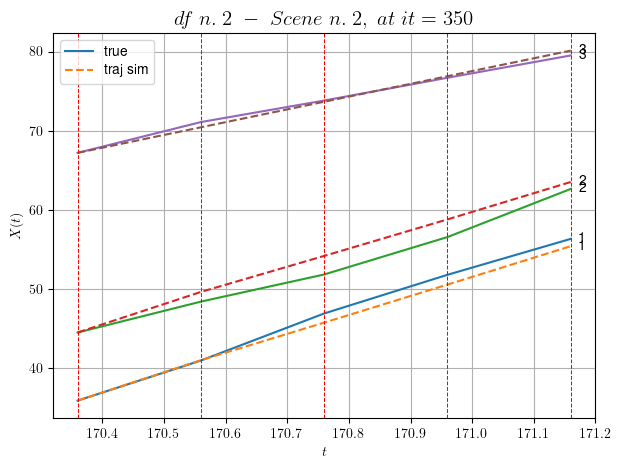

        For scene 2/18
        * use LR_NN=0.001 with err=39.78077030454121 at it=19
        * v0_scn_mean = 17.338605388356104
        * MAE = 1.1533719497719768



            - Time interval n.0: [179.36, 179.56]
                * y_true: [10.36002857 23.43048282]
                * v_ann: [17.628662109375, 17.402786254882812, 22.08205674402126]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [179.56, 179.76]
                * y_true: [10.37004005 22.87060641]
                * v_ann: [17.52906036376953, 17.365015029907227, 22.08205674402126]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [179.76, 179.96]
                * y_true: [15.39008451 20.81068862]
                * v_ann: [17.40715980529785, 17.279726028442383, 22.08205674402126]

-------------------------------------------------------------------------

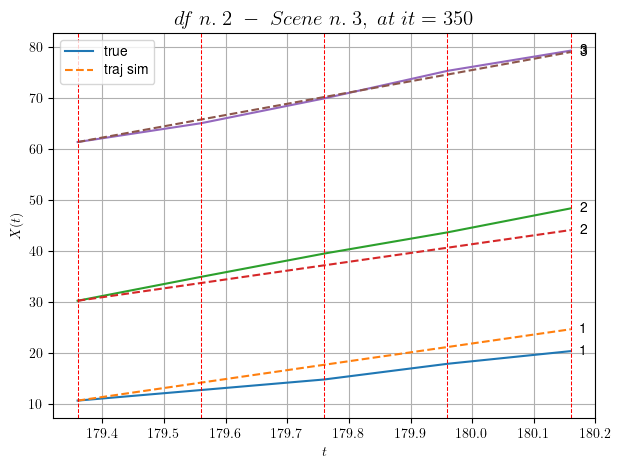

        For scene 3/18
        * use LR_NN=0.0001 with err=5.9296393139208865 at it=19
        * v0_scn_mean = 22.760680188664768
        * MAE = 4.987385890243888



        For scene 4/18
        * use LR_NN=0.001 with err=10.30241999059408 at it=19
        * v0_scn_mean = 16.136951087360984
        * MAE = 0.013380452034866411



            - Time interval n.0: [212.56, 212.76]
                * y_true: [14.43013055 12.85042103]
                * v_ann: [16.844989776611328, 16.632600784301758, 20.50720391476299]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [212.76, 212.96]
                * y_true: [10.79011916 33.80137312]
                * v_ann: [16.745601654052734, 16.43081283569336, 20.50720391476299]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [212.96, 213.16]
                * y_true: [16.24022861

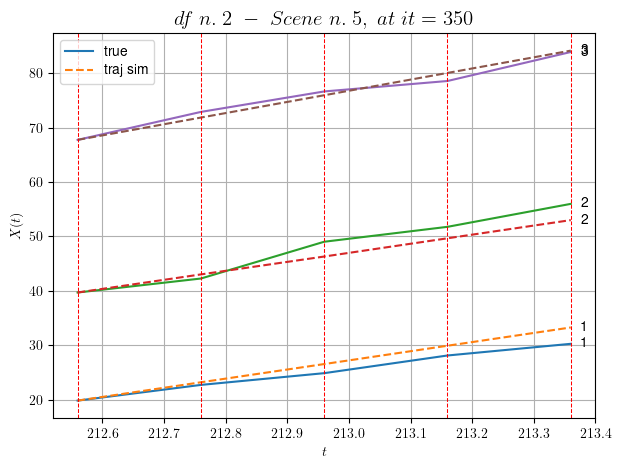

        For scene 5/18
        * use LR_NN=5e-05 with err=8.76674493796508 at it=19
        * v0_scn_mean = 21.32080332693334
        * MAE = 2.6947561213425018



            - Time interval n.0: [318.16, 318.36]
                * y_true: [13.01007537 20.36054455]
                * v_ann: [17.045108795166016, 16.944992065429688, 20.355267320886764]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [318.36, 318.56]
                * y_true: [14.27010639 20.89068863]
                * v_ann: [17.016799926757812, 16.922895431518555, 20.355267320886764]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.56, 318.76]
                * y_true: [12.16011799 21.20084683]
                * v_ann: [17.032852172851562, 16.961347579956055, 20.355267320886764]

-------------------------------------------------------------------

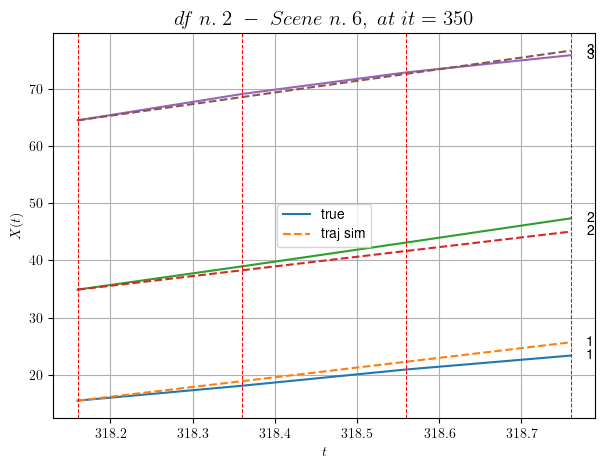

        For scene 6/18
        * use LR_NN=5e-05 with err=4.955759177038417 at it=19
        * v0_scn_mean = 21.181888768119535
        * MAE = 1.4154710225624312



            - Time interval n.0: [430.16, 430.36]
                * y_true: [15.83005748 20.27065425]
                * v_ann: [18.9021053314209, 18.866209030151367, 21.23696606139114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [430.36, 430.56]
                * y_true: [19.99011659 24.33092793]
                * v_ann: [18.902889251708984, 18.890472412109375, 21.23696606139114]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [430.56, 430.76]
                * y_true: [14.67011767 20.05093433]
                * v_ann: [19.100786209106445, 18.96662712097168, 21.23696606139114]

-----------------------------------------------------------------------

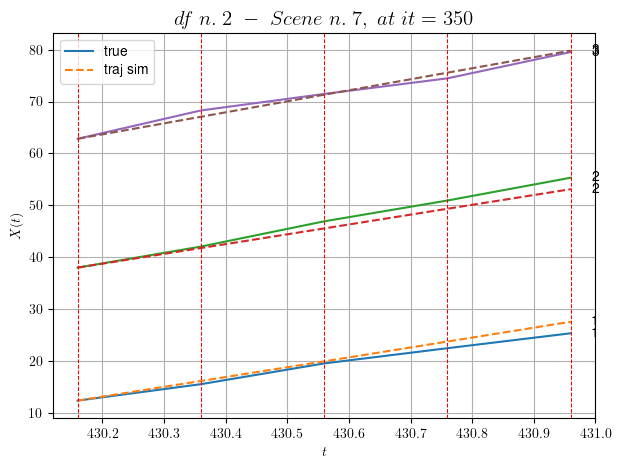

        For scene 7/18
        * use LR_NN=5e-05 with err=8.6279906375642 at it=19
        * v0_scn_mean = 21.98801972326932
        * MAE = 1.281090909898044



            - Time interval n.0: [435.96, 436.16]
                * y_true: [15.85107698 23.95169404]
                * v_ann: [19.90125274658203, 21.911714553833008, 21.458777210396597]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [436.16, 436.36]
                * y_true: [18.0813972  25.19206379]
                * v_ann: [21.79795265197754, 19.309202194213867, 21.458777210396597]

----------------------------------------------------------------------------------------------------
            * err= 0.6416500335916303
            * Learning rate NN = 0.0036449995823204517
            * diff = 1.992646583781621e-05


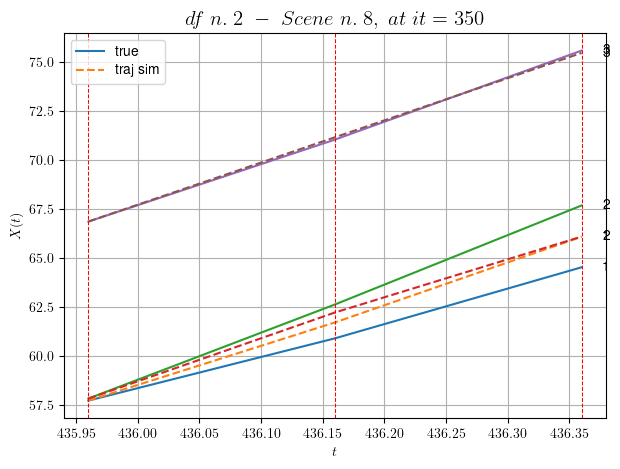

        For scene 8/18
        * use LR_NN=0.005 with err=3.856453283611493 at it=19
        * v0_scn_mean = 22.190820096226993
        * MAE = 0.639392044447821



            - Time interval n.0: [442.76, 442.96]
                * y_true: [18.06141662 13.31057742]
                * v_ann: [19.343490600585938, 18.954648971557617, 22.775949002662287]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [442.96, 443.16]
                * y_true: [20.34015276 11.01053508]
                * v_ann: [18.95160484313965, 18.80369758605957, 22.775949002662287]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [443.16, 443.36]
                * y_true: [26.42894929 13.47072378]
                * v_ann: [18.61204719543457, 18.63627052307129, 22.775949002662287]

----------------------------------------------------------------------

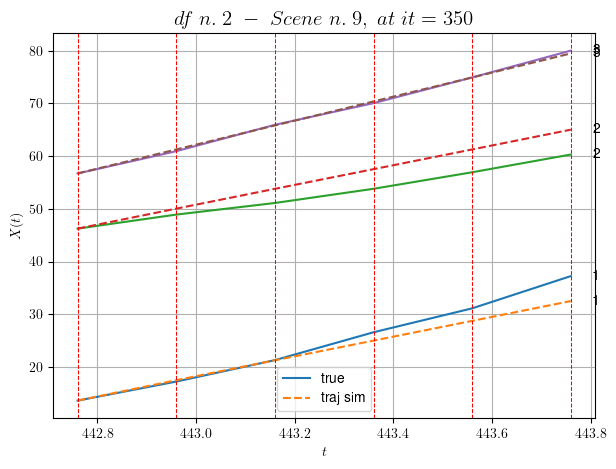

        For scene 9/18
        * use LR_NN=0.0001 with err=8.130015761940177 at it=19
        * v0_scn_mean = 23.39510099878082
        * MAE = 5.250175128119737



            - Time interval n.0: [487.56, 487.76]
                * y_true: [22.90018755 16.61065196]
                * v_ann: [20.747037887573242, 20.51173210144043, 21.111964471909]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.76, 487.96]
                * y_true: [21.00025249 21.71102285]
                * v_ann: [20.515413284301758, 20.40465545654297, 21.111964471909]

----------------------------------------------------------------------------------------------------
            * err= 0.16211113119742482
            * Learning rate NN = 7.289998757187277e-05
            * diff = 4.739214790000501e-05


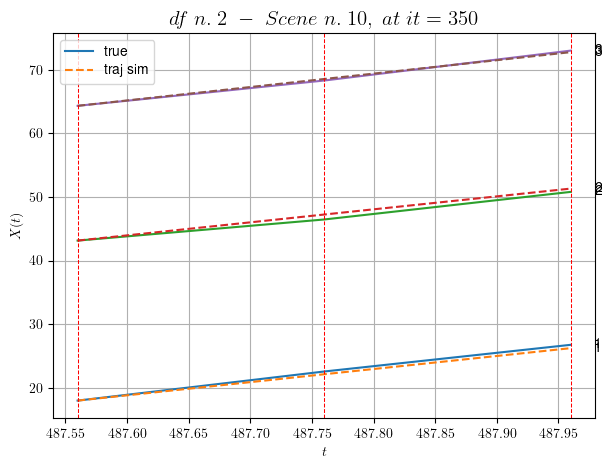

        For scene 10/18
        * use LR_NN=0.0001 with err=1.6990253816163774 at it=19
        * v0_scn_mean = 21.87373164946894
        * MAE = 0.1595929568298912



            - Time interval n.0: [531.76, 531.96]
                * y_true: [23.26110286 19.80102444]
                * v_ann: [21.176286697387695, 21.887279510498047, 17.911818675880156]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.96, 532.16]
                * y_true: [19.37730225 14.13461647]
                * v_ann: [21.129566192626953, 21.70137596130371, 17.911818675880156]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.16, 532.36]
                * y_true: [16.15104075 20.18132342]
                * v_ann: [19.810941696166992, 20.299602508544922, 17.911818675880156]

----------------------------------------------------------------

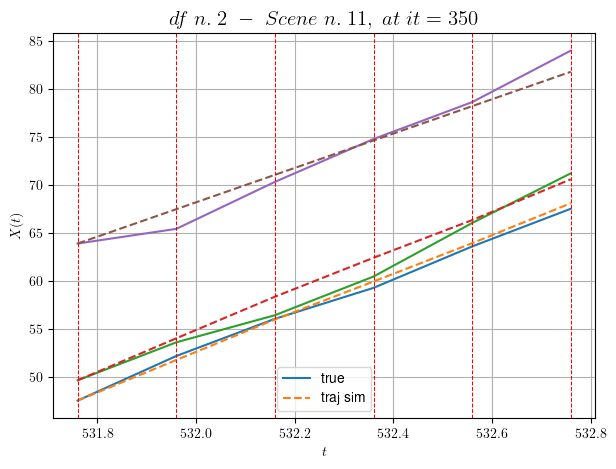

        For scene 11/18
        * use LR_NN=0.001 with err=35.76926218041219 at it=19
        * v0_scn_mean = 18.947860863156084
        * MAE = 1.0339003309955268



            - Time interval n.0: [538.36, 538.56]
                * y_true: [17.69068154 17.20117669]
                * v_ann: [21.754079818725586, 20.744016647338867, 21.51893062775074]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [538.56, 538.76]
                * y_true: [18.89091077 18.60142936]
                * v_ann: [20.01490020751953, 19.789710998535156, 21.51893062775074]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [538.76, 538.96]
                * y_true: [19.15102468 24.05210496]
                * v_ann: [19.525367736816406, 19.50920295715332, 21.51893062775074]

---------------------------------------------------------------------

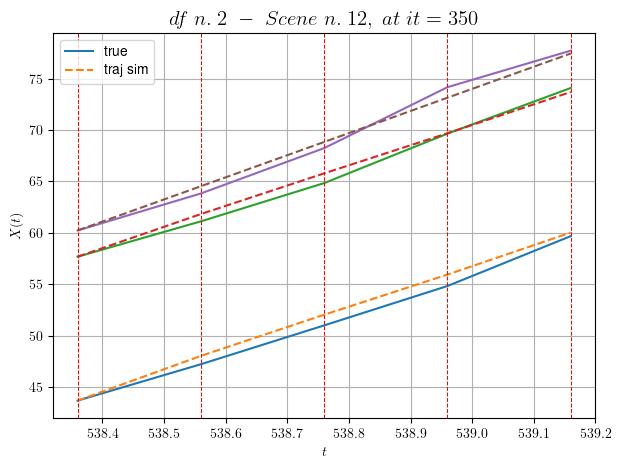

        For scene 12/18
        * use LR_NN=0.001 with err=19.890680985165563 at it=19
        * v0_scn_mean = 22.24581794249738
        * MAE = 0.4414551525501443



            - Time interval n.0: [541.16, 541.36]
                * y_true: [22.67086863 28.23390149]
                * v_ann: [23.272424697875977, 22.99195671081543, 20.490059693196006]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [541.36, 541.56]
                * y_true: [19.45088023 23.11862329]
                * v_ann: [23.672731399536133, 23.844709396362305, 20.490059693196006]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [541.56, 541.76]
                * y_true: [24.96136667 24.68114114]
                * v_ann: [23.20278549194336, 23.003768920898438, 20.490059693196006]

------------------------------------------------------------------

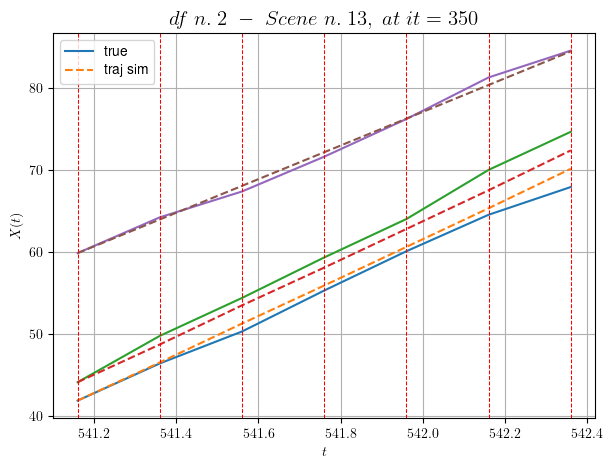

        For scene 13/18
        * use LR_NN=0.001 with err=39.605107926153686 at it=19
        * v0_scn_mean = 21.305128485774667
        * MAE = 1.1875082863619661



            - Time interval n.0: [549.76, 549.96]
                * y_true: [23.30098965 17.25125335]
                * v_ann: [21.746353149414062, 22.020225524902344, 22.495773750080495]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [549.96, 550.16]
                * y_true: [23.30098965 23.35192881]
                * v_ann: [21.64873504638672, 21.820388793945312, 22.495773750080495]

----------------------------------------------------------------------------------------------------
            * err= 0.20484189397078048
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00017410100123282923


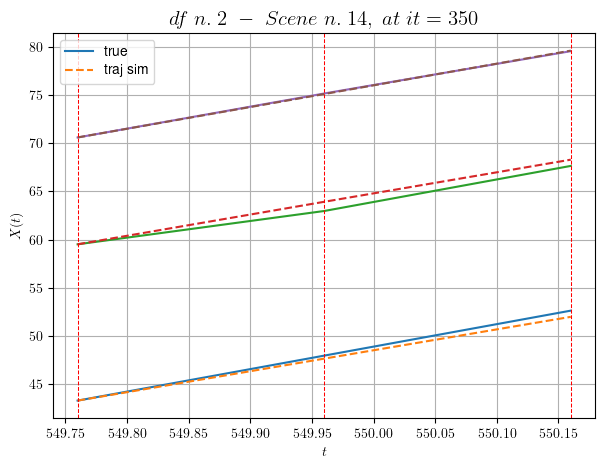

        For scene 14/18
        * use LR_NN=0.0001 with err=1.3889918151951812 at it=19
        * v0_scn_mean = 23.138938736550113
        * MAE = 0.20484189397078048



            - Time interval n.0: [566.76, 566.96]
                * y_true: [31.35080123 25.9264585 ]
                * v_ann: [26.997697830200195, 26.42528533935547, 24.22256213824868]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [566.96, 567.16]
                * y_true: [23.95081051 25.9264585 ]
                * v_ann: [27.099895477294922, 26.671512603759766, 24.22256213824868]

----------------------------------------------------------------------------------------------------
            * err= 0.10153338285153457
            * Learning rate NN = 7.289998757187277e-05
            * diff = 7.290349316883826e-05


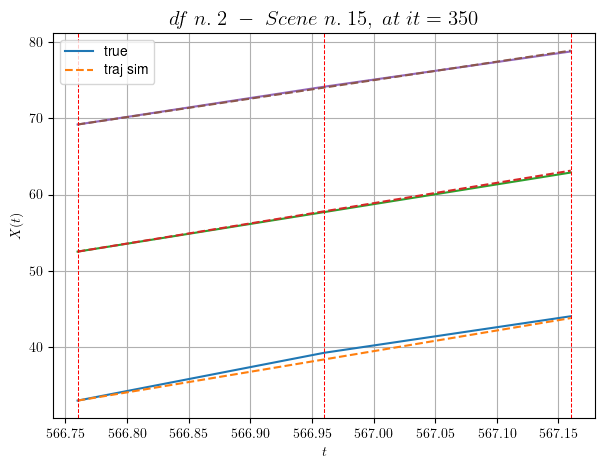

        For scene 15/18
        * use LR_NN=0.0001 with err=0.8367347870874643 at it=19
        * v0_scn_mean = 24.717729210834154
        * MAE = 0.10153338285153457



            - Time interval n.0: [87.56, 87.76]
                * y_true: [20.56019483 17.07029985 18.3510221 ]
                * v_ann: [19.862003326416016, 20.42595672607422, 20.146100997924805, 23.400041684740067]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [87.76, 87.96]
                * y_true: [21.72029145 17.49039467 19.46124504]
                * v_ann: [19.03671646118164, 18.78673553466797, 18.880268096923828, 23.400041684740067]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [87.96, 88.16]
                * y_true: [24.51045762 21.12058621 15.36109554]
                * v_ann: [19.375213623046875, 19.51077651977539, 19.4644660949707

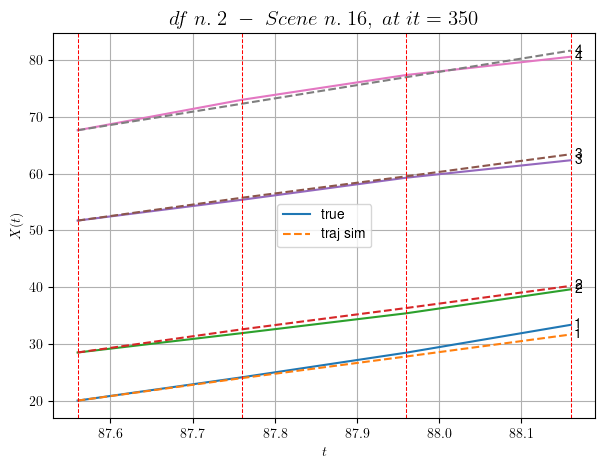

        For scene 16/18
        * use LR_NN=0.001 with err=9.998350180277026 at it=19
        * v0_scn_mean = 24.153365501346634
        * MAE = 0.5112987873664835



            - Time interval n.0: [305.96, 306.16]
                * y_true: [18.64270885 18.88070057 19.63111636]
                * v_ann: [20.593276977539062, 20.563690185546875, 20.42917823791504, 13.683661586234264]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [306.16, 306.36]
                * y_true: [22.41204338 21.34093202 20.7913521 ]
                * v_ann: [20.128864288330078, 20.060821533203125, 19.85150718688965, 13.683661586234264]

----------------------------------------------------------------------------------------------------
            * err= 0.03387219595273282
            * Learning rate NN = 0.00036449998151510954
            * diff = 8.903472030821757e-06


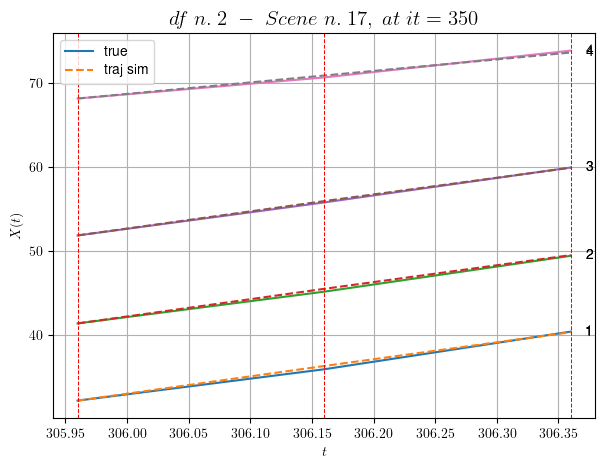

        For scene 17/18
        * use LR_NN=0.0005 with err=5.279898972146012 at it=19
        * v0_scn_mean = 15.546019761812968
        * MAE = 0.03371123143066157



For df=2 with 18 scenes, time taken:        196.39
------------------------------------------------------------
****************************************************************************************************
In df n.3/10 we have 55 scenes
****************************************************************************************************
            - Time interval n.0: [16.16, 16.36]
                * y_true: [27.36596872 40.6089382 ]
                * v_ann: [28.60688018798828, 27.132802963256836, 39.22721511204402]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [16.36, 16.56]
                * y_true: [22.16572117 32.62072047]
                * v_ann: [29.325237274169922, 27.862966537475586, 39.22721511204402]

--------------

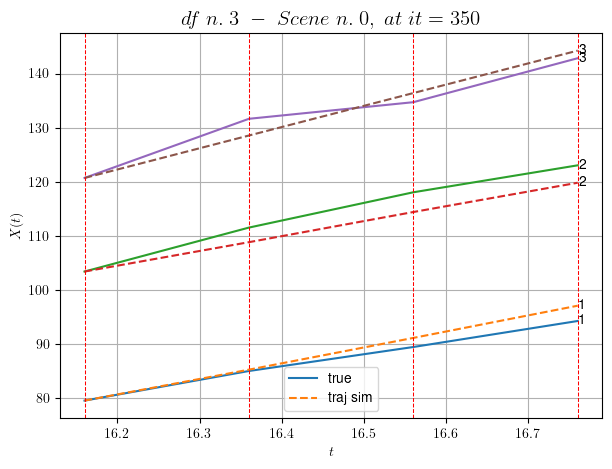

        For scene 0/55
        * use LR_NN=1e-05 with err=27.340458900975644 at it=19
        * v0_scn_mean = 38.43637785780201
        * MAE = 4.680823871237975



            - Time interval n.0: [17.56, 17.76]
                * y_true: [26.87631442 28.75240293]
                * v_ann: [28.938079833984375, 29.66941261291504, 37.341555892655244]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [17.76, 17.96]
                * y_true: [26.32655772 34.05345458]
                * v_ann: [28.617094039916992, 28.45901107788086, 37.341555892655244]

----------------------------------------------------------------------------------------------------
            * err= 0.8493139192067908
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0014115300908561501


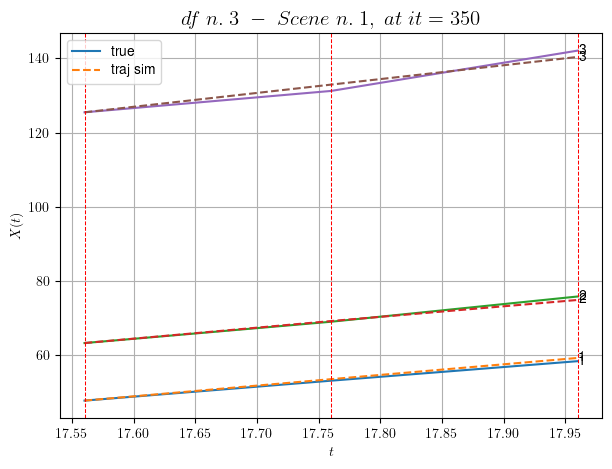

        For scene 1/55
        * use LR_NN=5e-05 with err=9.806470378773621 at it=19
        * v0_scn_mean = 36.7123329002885
        * MAE = 0.7604358123555377



            - Time interval n.0: [23.96, 24.16]
                * y_true: [31.9527567  21.95230333]
                * v_ann: [25.41429328918457, 27.44501304626465, 27.016685910779763]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.16, 24.36]
                * y_true: [26.79271708 14.85171745]
                * v_ann: [25.350950241088867, 27.56077003479004, 27.016685910779763]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.36, 24.56]
                * y_true: [20.5424093  31.65411216]
                * v_ann: [23.273712158203125, 19.353574752807617, 27.016685910779763]

----------------------------------------------------------------------------

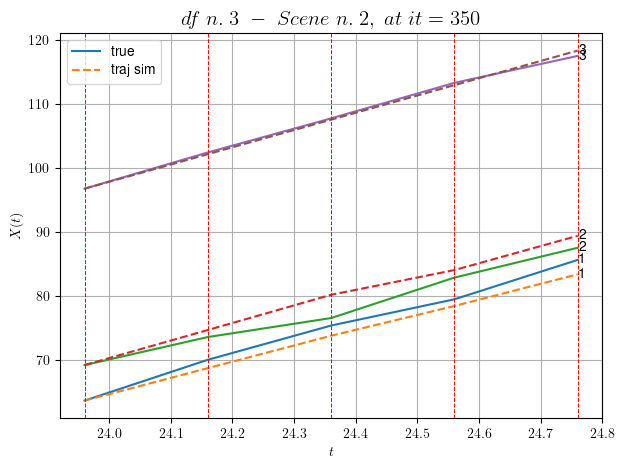

        For scene 2/55
        * use LR_NN=0.001 with err=38.235991512878904 at it=19
        * v0_scn_mean = 27.27237691767749
        * MAE = 2.049085001974537



            - Time interval n.0: [42.96, 43.16]
                * y_true: [34.44093898 36.40531345]
                * v_ann: [25.41411590576172, 25.585107803344727, 27.3506925845114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [43.16, 43.36]
                * y_true: [27.09071898 44.10770887]
                * v_ann: [33.18497085571289, 31.9106502532959, 27.3506925845114]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [43.36, 43.56]
                * y_true: [24.51583897 25.2301032 ]
                * v_ann: [37.383094787597656, 31.42262077331543, 27.3506925845114]

-----------------------------------------------------------------------------------

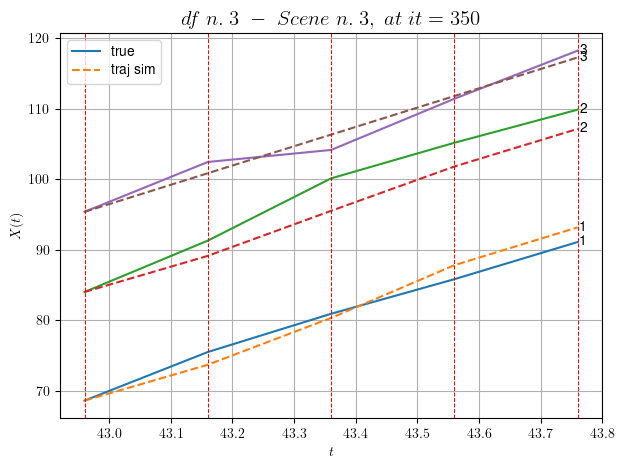

        For scene 3/55
        * use LR_NN=0.001 with err=24.563384478661856 at it=19
        * v0_scn_mean = 27.577756869527697
        * MAE = 3.593920579635546



            - Time interval n.0: [61.76, 61.96]
                * y_true: [28.79377133  7.10177762]
                * v_ann: [31.76532745361328, 30.866474151611328, 27.830106096169573]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [61.96, 62.16]
                * y_true: [41.29768472 31.64601894]
                * v_ann: [20.60118865966797, 20.89558219909668, 27.830106096169573]

----------------------------------------------------------------------------------------------------
            * err= 5.637087747202483
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0007384517493216336


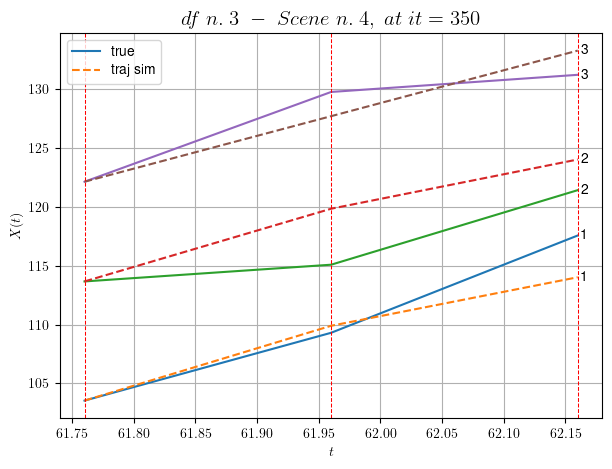

        For scene 4/55
        * use LR_NN=0.001 with err=7.443871671154651 at it=19
        * v0_scn_mean = 28.01608127026752
        * MAE = 5.609029257740553



            - Time interval n.0: [63.76, 63.96]
                * y_true: [39.33120973 30.97229006]
                * v_ann: [31.309101104736328, 29.948591232299805, 33.83985492803373]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [63.96, 64.16]
                * y_true: [32.2308074  22.86038312]
                * v_ann: [32.450504302978516, 30.838237762451172, 33.83985492803373]

----------------------------------------------------------------------------------------------------
            * err= 1.0677278327334832
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.004178342629852283


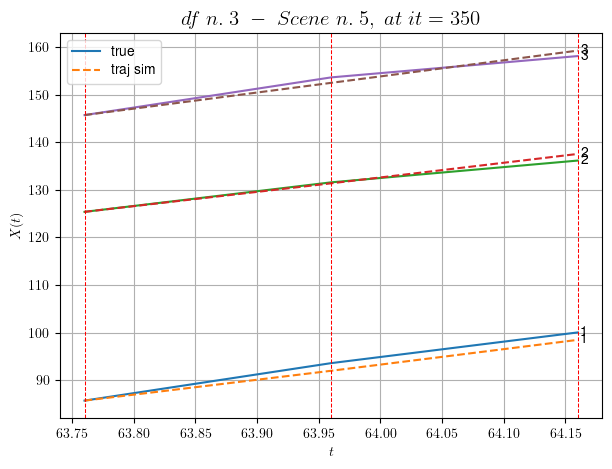

        For scene 5/55
        * use LR_NN=5e-05 with err=1.7489236868790965 at it=19
        * v0_scn_mean = 33.51075234495742
        * MAE = 0.7362438799134737



            - Time interval n.0: [67.16, 67.36]
                * y_true: [27.17586615 28.72375126]
                * v_ann: [26.41227149963379, 26.724895477294922, 32.13930608407803]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [67.36, 67.56]
                * y_true: [31.70635664 24.62373081]
                * v_ann: [26.76089096069336, 26.898839950561523, 32.13930608407803]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [67.56, 67.76]
                * y_true: [27.5714436  21.15852297]
                * v_ann: [27.106061935424805, 27.096271514892578, 32.13930608407803]

----------------------------------------------------------------------------

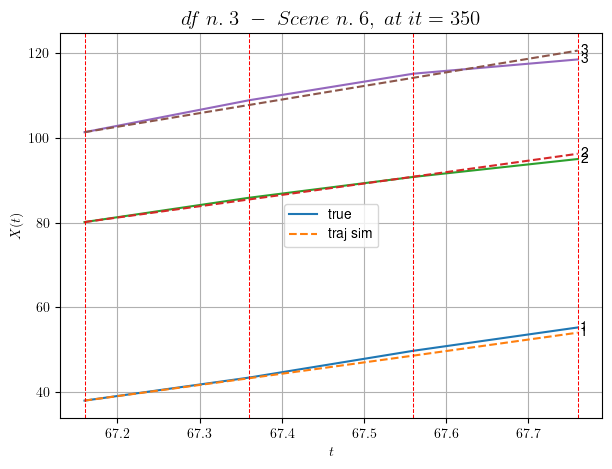

        For scene 6/55
        * use LR_NN=5e-05 with err=4.209461120697944 at it=19
        * v0_scn_mean = 31.955952501337016
        * MAE = 0.9253288290300675



            - Time interval n.0: [72.76, 72.96]
                * y_true: [28.501496   30.93407752]
                * v_ann: [31.571033477783203, 31.718721389770508, 28.121253838742728]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.96, 73.16]
                * y_true: [36.65243351 31.9148258 ]
                * v_ann: [31.252765655517578, 31.571311950683594, 28.121253838742728]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [73.16, 73.36]
                * y_true: [27.70226144 28.33497935]
                * v_ann: [31.723217010498047, 31.840129852294922, 28.121253838742728]

-----------------------------------------------------------------------

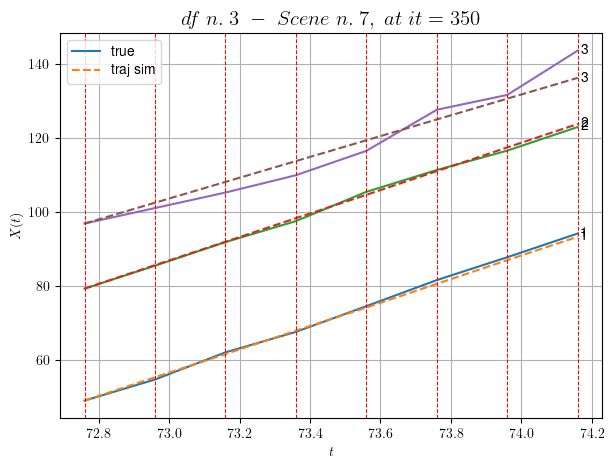

        For scene 7/55
        * use LR_NN=0.0001 with err=48.66585514336963 at it=19
        * v0_scn_mean = 28.282275602898547
        * MAE = 3.8080566207267483



            - Time interval n.0: [82.16, 82.36]
                * y_true: [30.54468004 23.04450554]
                * v_ann: [27.507129669189453, 29.544471740722656, 27.55025511528052]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [82.36, 82.56]
                * y_true: [22.71402344 43.65971655]
                * v_ann: [25.61023712158203, 26.682373046875, 27.55025511528052]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.56, 82.76]
                * y_true: [35.61686857 24.88594316]
                * v_ann: [33.24769973754883, 35.72968292236328, 27.55025511528052]

-------------------------------------------------------------------------------

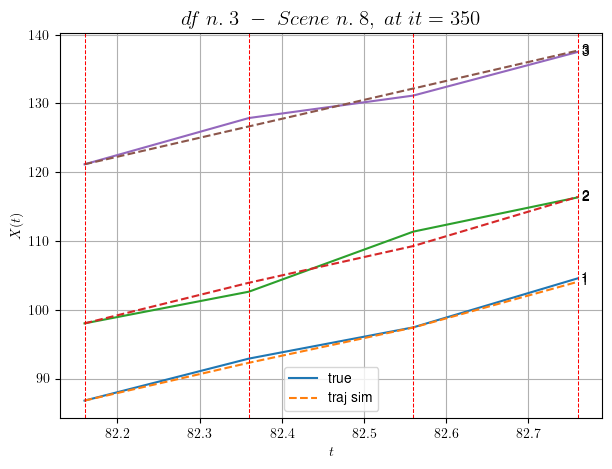

        For scene 8/55
        * use LR_NN=0.001 with err=7.475033758768159 at it=19
        * v0_scn_mean = 27.760215487364633
        * MAE = 0.7710029158486337



            - Time interval n.0: [86.16, 86.36]
                * y_true: [27.89181051 25.45740923]
                * v_ann: [29.499235153198242, 31.681957244873047, 35.76469495843541]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [36.25627338 46.92477715]
                * v_ann: [29.232192993164062, 31.164228439331055, 35.76469495843541]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [86.56, 86.76]
                * y_true: [29.50579063 21.07714474]
                * v_ann: [29.990726470947266, 32.58525848388672, 35.76469495843541]

---------------------------------------------------------------------------

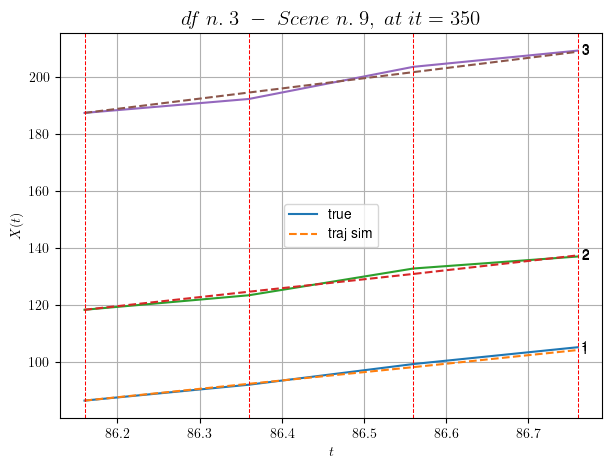

        For scene 9/55
        * use LR_NN=1e-05 with err=12.845137122363345 at it=19
        * v0_scn_mean = 35.27062004231874
        * MAE = 1.3597862351988734



            - Time interval n.0: [130.96, 131.16]
                * y_true: [15.85249734 39.95916833]
                * v_ann: [32.50764083862305, 31.19352149963379, 31.752325223025]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.16, 131.36]
                * y_true: [19.2732587 14.0236874]
                * v_ann: [34.256996154785156, 29.43083953857422, 31.752325223025]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [131.36, 131.56]
                * y_true: [20.77382027 41.90201833]
                * v_ann: [33.05005645751953, 29.8587646484375, 31.752325223025]

----------------------------------------------------------------------------------

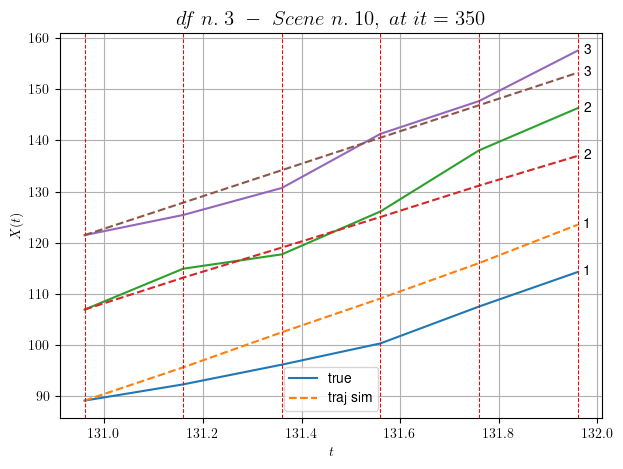

        For scene 10/55
        * use LR_NN=5e-05 with err=59.64885310952267 at it=19
        * v0_scn_mean = 31.60213862272465
        * MAE = 20.165316250270234



            - Time interval n.0: [139.16, 139.36]
                * y_true: [22.50033849 31.62238978]
                * v_ann: [27.869359970092773, 27.59697723388672, 28.144643973847053]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.36, 139.56]
                * y_true: [29.90063418 17.15160439]
                * v_ann: [27.855087280273438, 27.600290298461914, 28.144643973847053]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [139.56, 139.76]
                * y_true: [27.10078793 37.57385655]
                * v_ann: [27.66400146484375, 27.553363800048828, 28.144643973847053]

-------------------------------------------------------------------

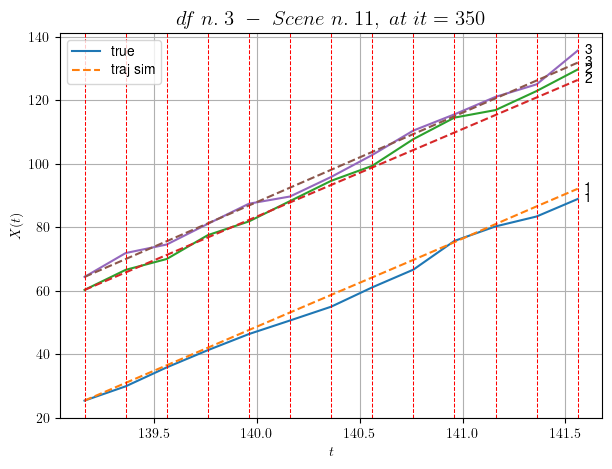

        For scene 11/55
        * use LR_NN=0.0001 with err=446.9438954303257 at it=19
        * v0_scn_mean = 28.30366103886055
        * MAE = 3.9300596927933964



            - Time interval n.0: [143.76, 143.96]
                * y_true: [30.62207823 41.7261053 ]
                * v_ann: [30.38348960876465, 30.27963638305664, 29.414748692205094]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [143.96, 144.16]
                * y_true: [21.21173425 33.31570327]
                * v_ann: [31.1810245513916, 30.66285514831543, 29.414748692205094]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [144.16, 144.36]
                * y_true: [29.72284222 27.36558717]
                * v_ann: [30.7353572845459, 30.388744354248047, 29.414748692205094]

-----------------------------------------------------------------------

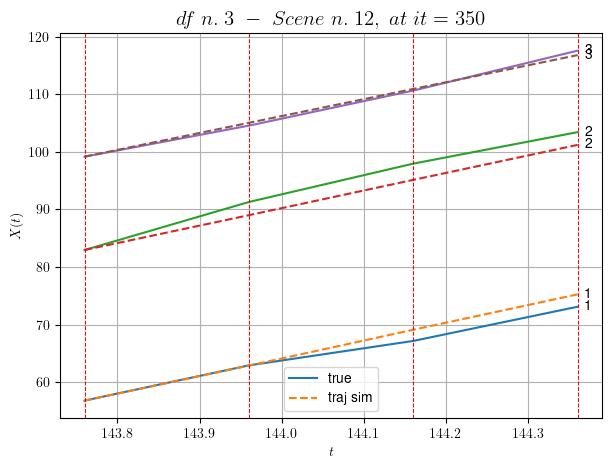

        For scene 12/55
        * use LR_NN=5e-05 with err=17.70035140949838 at it=19
        * v0_scn_mean = 29.464908846886736
        * MAE = 2.2857983783890305



            - Time interval n.0: [149.36, 149.56]
                * y_true: [25.90049539 27.45094024]
                * v_ann: [27.39385986328125, 27.234424591064453, 23.443602704289464]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [149.56, 149.76]
                * y_true: [21.18057417 22.42095425]
                * v_ann: [27.383100509643555, 27.180583953857422, 23.443602704289464]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [149.76, 149.96]
                * y_true: [37.02126181 27.98148311]
                * v_ann: [27.290767669677734, 26.595870971679688, 23.443602704289464]

-----------------------------------------------------------------

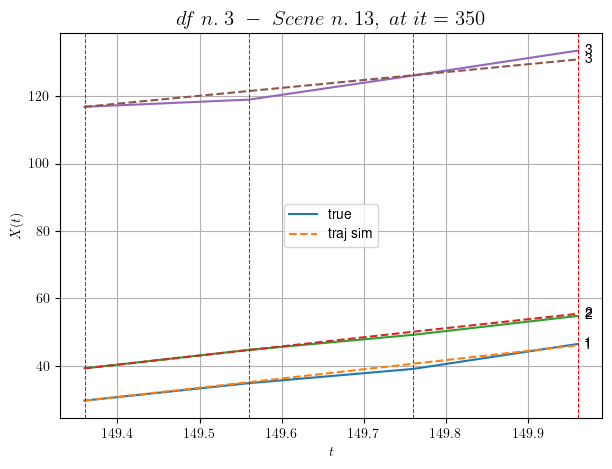

        For scene 13/55
        * use LR_NN=1e-05 with err=26.67542827537676 at it=19
        * v0_scn_mean = 24.005532080823883
        * MAE = 1.4365840834055073



            - Time interval n.0: [156.16, 156.36]
                * y_true: [12.56997445 35.72646923]
                * v_ann: [28.55571937561035, 30.04335594177246, 36.779567918368514]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [156.36, 156.56]
                * y_true: [42.07610638 31.26485338]
                * v_ann: [29.30654525756836, 29.905115127563477, 36.779567918368514]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [156.56, 156.76]
                * y_true: [30.09491831 26.35466702]
                * v_ann: [29.30937957763672, 30.182626724243164, 36.779567918368514]

--------------------------------------------------------------------

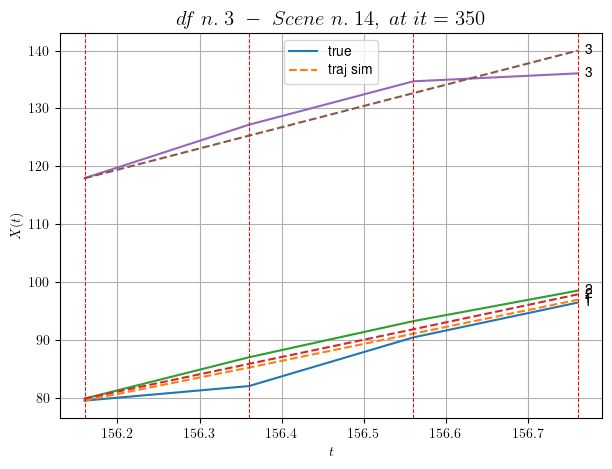

        For scene 14/55
        * use LR_NN=1e-05 with err=32.05035098680883 at it=19
        * v0_scn_mean = 36.19851124932992
        * MAE = 2.759395152180156



            - Time interval n.0: [207.96, 208.16]
                * y_true: [30.12104774 28.85226703]
                * v_ann: [30.580976486206055, 30.362916946411133, 31.124901516782685]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [208.16, 208.36]
                * y_true: [31.19139939 27.73265496]
                * v_ann: [29.864397048950195, 29.972373962402344, 31.124901516782685]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [208.36, 208.56]
                * y_true: [31.59181924 26.81292648]
                * v_ann: [29.569700241088867, 29.7488956451416, 31.124901516782685]

--------------------------------------------------------------------

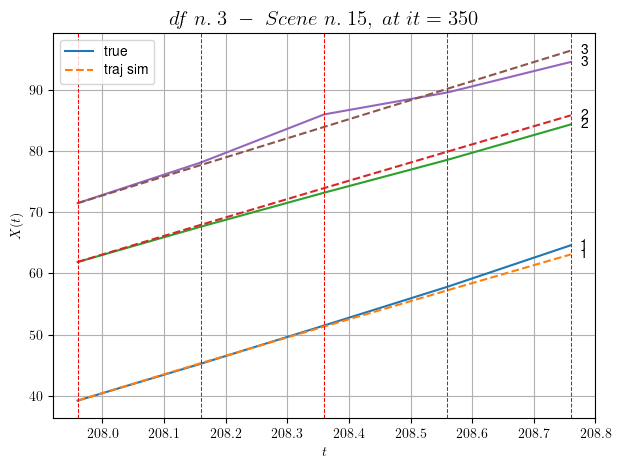

        For scene 15/55
        * use LR_NN=0.0005 with err=10.874439647690552 at it=19
        * v0_scn_mean = 31.028489542419454
        * MAE = 0.887758603097964



            - Time interval n.0: [218.16, 218.36]
                * y_true: [26.47083003 31.40159485]
                * v_ann: [31.252395629882812, 31.398469924926758, 31.94691151510619]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [218.36, 218.56]
                * y_true: [32.09751616 29.50187244]
                * v_ann: [31.15485191345215, 31.18132209777832, 31.94691151510619]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [218.56, 218.76]
                * y_true: [31.61167285 38.50305628]
                * v_ann: [31.138092041015625, 31.148332595825195, 31.94691151510619]

--------------------------------------------------------------------

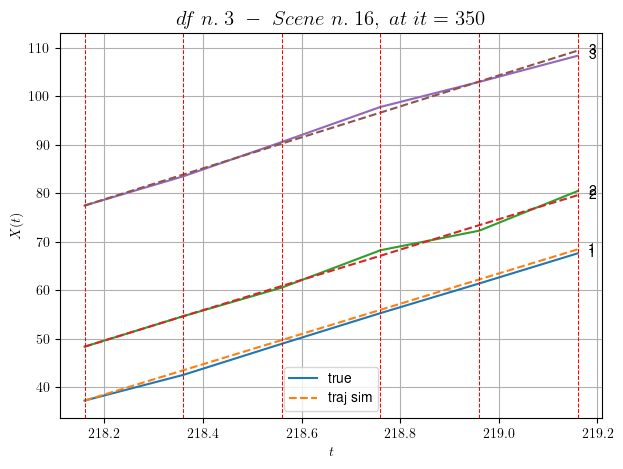

        For scene 16/55
        * use LR_NN=5e-05 with err=30.004485171431742 at it=19
        * v0_scn_mean = 31.780047500540046
        * MAE = 0.49265211875209486



            - Time interval n.0: [222.96, 223.16]
                * y_true: [37.21103813 39.71315438]
                * v_ann: [35.337135314941406, 34.340389251708984, 31.27974144015426]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.16, 223.36]
                * y_true: [31.35126998 28.99272163]
                * v_ann: [36.21866989135742, 34.44675827026367, 31.27974144015426]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.36, 223.56]
                * y_true: [33.72173898 31.78369531]
                * v_ann: [34.99710464477539, 33.81270217895508, 31.27974144015426]

---------------------------------------------------------------------

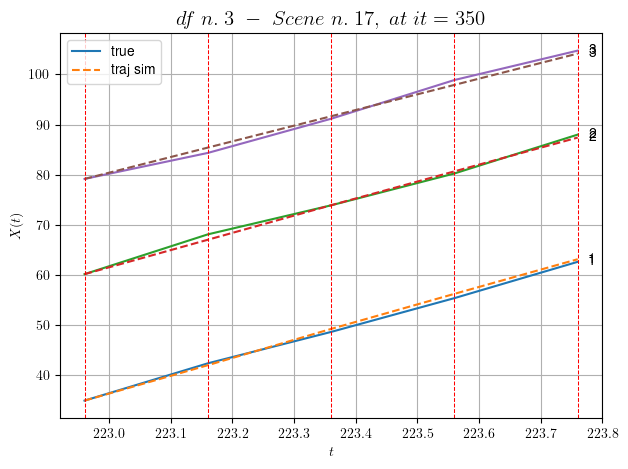

        For scene 17/55
        * use LR_NN=0.0001 with err=6.2440216860399325 at it=19
        * v0_scn_mean = 31.17005859496375
        * MAE = 0.39115293290845976



            - Time interval n.0: [247.36, 247.56]
                * y_true: [24.34113117 25.37248976]
                * v_ann: [31.472835540771484, 25.967193603515625, 29.199550876740744]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [247.56, 247.76]
                * y_true: [20.86113385 27.00305492]
                * v_ann: [27.733867645263672, 23.897748947143555, 29.199550876740744]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [247.76, 247.96]
                * y_true: [25.44173909 29.15378269]
                * v_ann: [25.571245193481445, 27.73728370666504, 29.199550876740744]

---------------------------------------------------------------

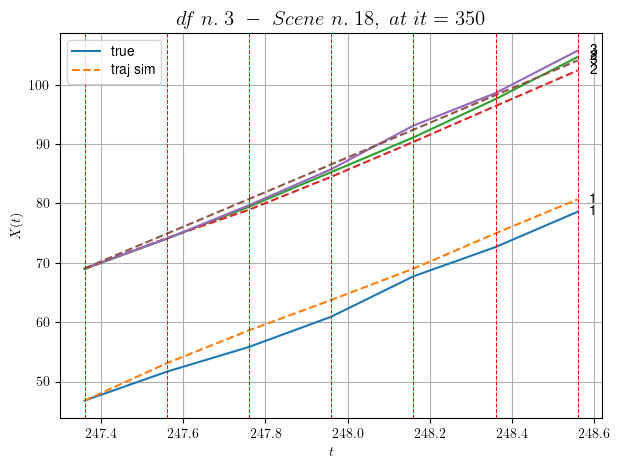

        For scene 18/55
        * use LR_NN=0.001 with err=39.269767431509145 at it=19
        * v0_scn_mean = 29.26815499825632
        * MAE = 1.7039908509241066



            - Time interval n.0: [269.56, 269.76]
                * y_true: [27.75027124 32.18076388]
                * v_ann: [29.538272857666016, 29.39051628112793, 30.539171773719648]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [269.76, 269.96]
                * y_true: [33.80053503 32.77104018]
                * v_ann: [29.545255661010742, 29.457294464111328, 30.539171773719648]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [269.96, 270.16]
                * y_true: [22.10049768 29.95131945]
                * v_ann: [29.748214721679688, 29.686376571655273, 30.539171773719648]

-----------------------------------------------------------------

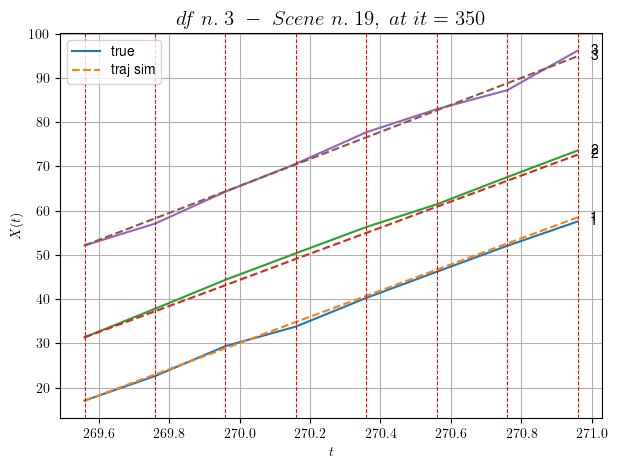

        For scene 19/55
        * use LR_NN=0.0001 with err=6.1642492265177795 at it=19
        * v0_scn_mean = 30.492960959306302
        * MAE = 0.6995098452669009



            - Time interval n.0: [316.16, 316.36]
                * y_true: [33.9635286 19.3731464]
                * v_ann: [27.018341064453125, 27.014427185058594, 31.119723216261207]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.36, 316.56]
                * y_true: [24.60296417 29.75560281]
                * v_ann: [26.790678024291992, 26.868989944458008, 31.119723216261207]

----------------------------------------------------------------------------------------------------
            * err= 0.7371052996483436
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.536138083348739e-06


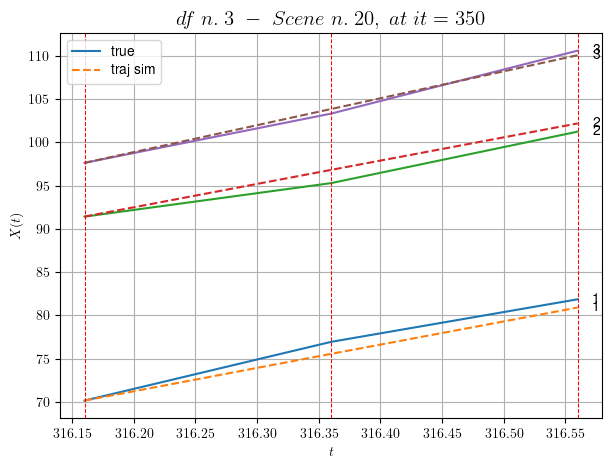

        For scene 20/55
        * use LR_NN=0.0005 with err=3.4849789505980815 at it=19
        * v0_scn_mean = 31.02375505868512
        * MAE = 0.7366999364798952



            - Time interval n.0: [317.76, 317.96]
                * y_true: [22.24301013 28.10582296]
                * v_ann: [25.397043228149414, 24.536529541015625, 28.729615682184367]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.96, 318.16]
                * y_true: [28.26433817 33.10585656]
                * v_ann: [26.008934020996094, 24.138561248779297, 28.729615682184367]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.16, 318.36]
                * y_true: [11.28182915 18.67354228]
                * v_ann: [27.582420349121094, 24.816797256469727, 28.729615682184367]

---------------------------------------------------------------

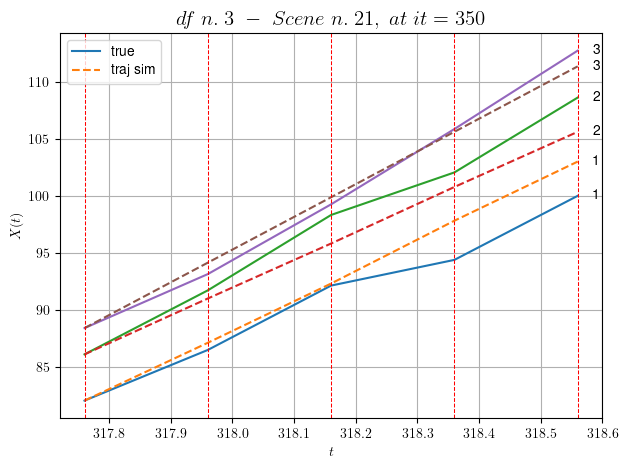

        For scene 21/55
        * use LR_NN=0.0005 with err=25.749061523574994 at it=19
        * v0_scn_mean = 28.83849655615748
        * MAE = 1.9957791313215925



            - Time interval n.0: [325.76, 325.96]
                * y_true: [25.31057708 30.22149101]
                * v_ann: [26.927520751953125, 27.165328979492188, 33.135529650132085]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.96, 326.16]
                * y_true: [25.23074384 33.46208613]
                * v_ann: [26.966842651367188, 27.204519271850586, 33.135529650132085]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [326.16, 326.36]
                * y_true: [24.63092838 29.01218385]
                * v_ann: [27.080894470214844, 27.357929229736328, 33.135529650132085]

---------------------------------------------------------------

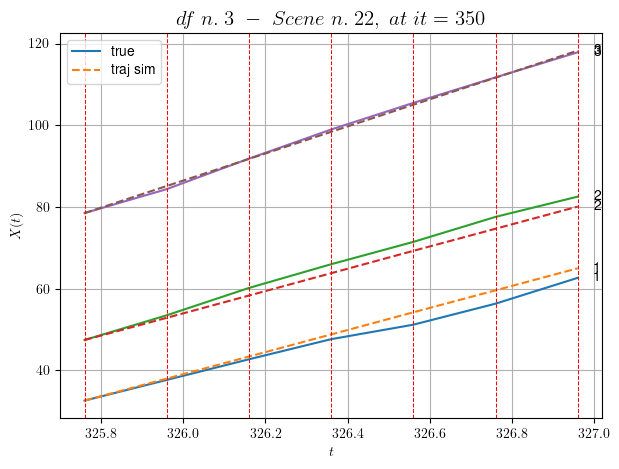

        For scene 22/55
        * use LR_NN=5e-05 with err=11.63437044723014 at it=19
        * v0_scn_mean = 32.86679269873433
        * MAE = 1.3607276389244969



            - Time interval n.0: [335.76, 335.96]
                * y_true: [36.00253797 32.17585284]
                * v_ann: [42.132686614990234, 36.56119155883789, 9.495828685169807]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.96, 336.16]
                * y_true: [33.90297107 37.71766361]
                * v_ann: [27.635351181030273, 29.75760841369629, 9.495828685169807]

----------------------------------------------------------------------------------------------------
            * err= 0.8100490762890301
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0016144219678556615


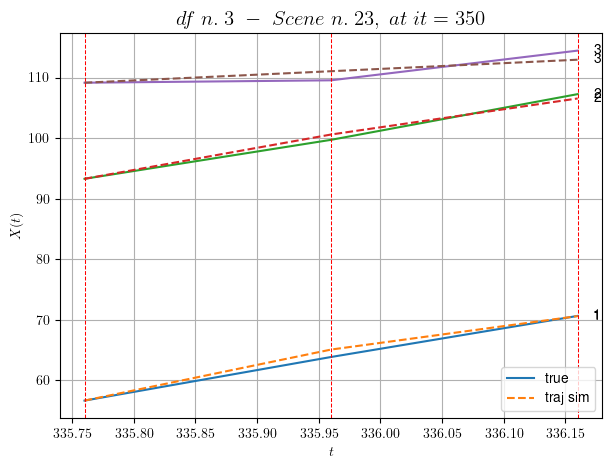

        For scene 23/55
        * use LR_NN=0.0005 with err=16.936925257089374 at it=19
        * v0_scn_mean = 11.25318042632105
        * MAE = 0.7625047435007977



            - Time interval n.0: [371.16, 371.36]
                * y_true: [24.42036896 26.80112378]
                * v_ann: [27.099184036254883, 27.155662536621094, 32.53948924917097]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.36, 371.56]
                * y_true: [25.21053633 31.30165898]
                * v_ann: [26.958223342895508, 26.843414306640625, 32.53948924917097]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.56, 371.76]
                * y_true: [24.36067127 30.15199262]
                * v_ann: [27.087890625, 27.126861572265625, 32.53948924917097]

------------------------------------------------------------------------

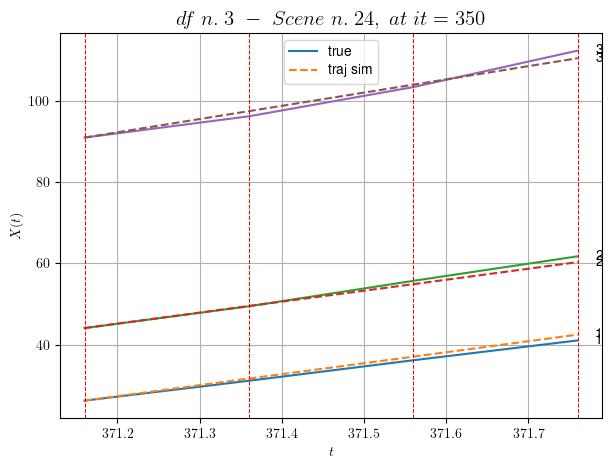

        For scene 24/55
        * use LR_NN=5e-05 with err=8.588577130367655 at it=19
        * v0_scn_mean = 32.32183715364606
        * MAE = 0.94006648418727



            - Time interval n.0: [387.36, 387.56]
                * y_true: [32.47194771 39.46360823]
                * v_ann: [28.343311309814453, 29.079008102416992, 33.031876180270814]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [387.56, 387.76]
                * y_true: [28.80212467 26.65295039]
                * v_ann: [31.96422004699707, 34.20478820800781, 33.031876180270814]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.76, 387.96]
                * y_true: [28.30253286 24.25305315]
                * v_ann: [29.041154861450195, 30.176118850708008, 33.031876180270814]

---------------------------------------------------------------------

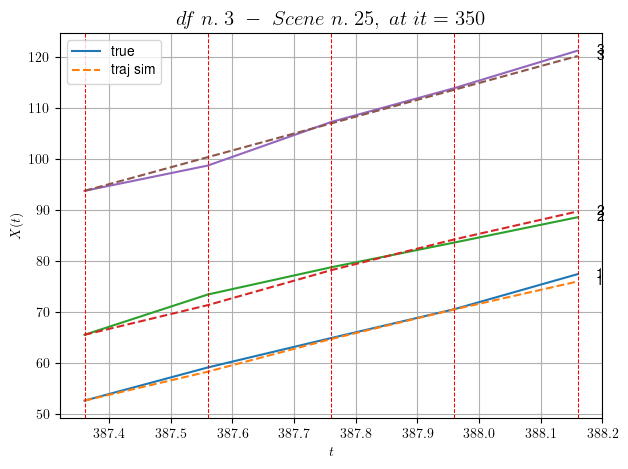

        For scene 25/55
        * use LR_NN=0.0005 with err=17.2431599934914 at it=19
        * v0_scn_mean = 32.772023060505326
        * MAE = 0.8723732009041948



            - Time interval n.0: [390.36, 390.56]
                * y_true: [34.37306474 33.21473815]
                * v_ann: [32.14795684814453, 31.941102981567383, 36.35421452147191]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [390.56, 390.76]
                * y_true: [31.79338609 29.7348149 ]
                * v_ann: [32.42655944824219, 32.45477294921875, 36.35421452147191]

----------------------------------------------------------------------------------------------------
            * err= 0.5358306981343771
            * Learning rate NN = 7.289998757187277e-05
            * diff = 3.247915773862964e-05


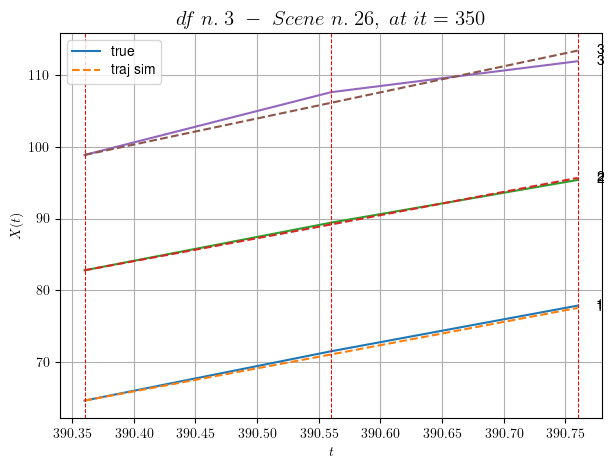

        For scene 26/55
        * use LR_NN=0.0001 with err=35.904940197238794 at it=19
        * v0_scn_mean = 35.809613631169675
        * MAE = 0.4882711157141779



            - Time interval n.0: [427.96, 428.16]
                * y_true: [33.16108667 24.70091575]
                * v_ann: [32.073429107666016, 32.17848587036133, 37.34980306665235]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [428.16, 428.36]
                * y_true: [36.08159054 35.68166414]
                * v_ann: [31.998931884765625, 31.46647071838379, 37.34980306665235]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [428.36, 428.56]
                * y_true: [27.64533545 36.4184567 ]
                * v_ann: [32.090850830078125, 32.45298767089844, 37.34980306665235]

--------------------------------------------------------------------

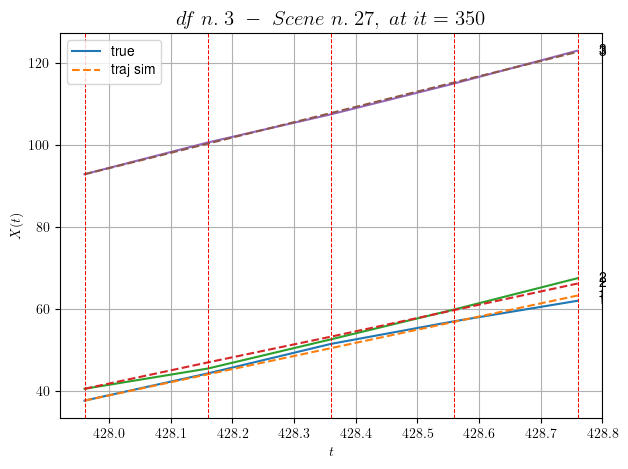

        For scene 27/55
        * use LR_NN=5e-05 with err=74.07516332185959 at it=19
        * v0_scn_mean = 36.71987323345084
        * MAE = 0.4911453693457519



            - Time interval n.0: [439.36, 439.56]
                * y_true: [29.12388438 22.06331107]
                * v_ann: [25.28569984436035, 25.28070068359375, 33.53635301945251]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [439.56, 439.76]
                * y_true: [38.07606081 22.99369197]
                * v_ann: [25.297849655151367, 25.503671646118164, 33.53635301945251]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [439.76, 439.96]
                * y_true: [23.98424021 18.65338098]
                * v_ann: [26.32842445373535, 27.108291625976562, 33.53635301945251]

-----------------------------------------------------------------------

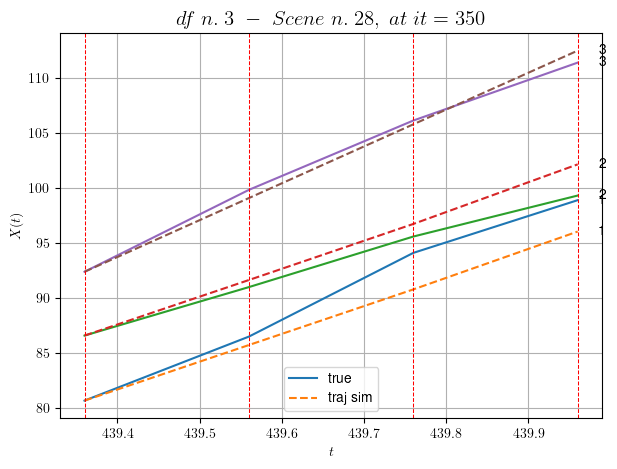

        For scene 28/55
        * use LR_NN=0.0005 with err=13.439517722104625 at it=19
        * v0_scn_mean = 33.233262685264364
        * MAE = 2.536800847068544



            - Time interval n.0: [448.36, 448.56]
                * y_true: [32.70350359 27.85524745]
                * v_ann: [32.942081451416016, 31.968551635742188, 31.585036733084028]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [448.56, 448.76]
                * y_true: [39.76511656 28.75604876]
                * v_ann: [32.265506744384766, 31.68000030517578, 31.585036733084028]

----------------------------------------------------------------------------------------------------
            * err= 0.6999535971262197
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0023810507799355562


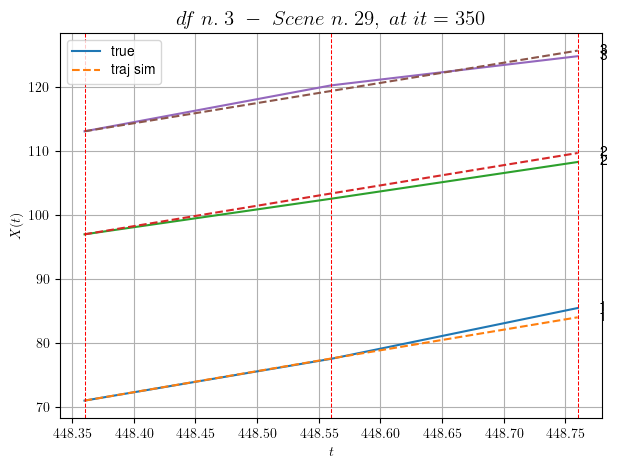

        For scene 29/55
        * use LR_NN=0.0001 with err=0.6180741663290968 at it=19
        * v0_scn_mean = 31.449187933349577
        * MAE = 0.5144327322019285



            - Time interval n.0: [465.16, 465.36]
                * y_true: [25.95020905 30.0319773 ]
                * v_ann: [26.452707290649414, 26.464176177978516, 24.72211720249987]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [465.36, 465.56]
                * y_true: [21.30025919 28.782318  ]
                * v_ann: [26.64558219909668, 26.567989349365234, 24.72211720249987]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [465.56, 465.76]
                * y_true: [22.00036741 28.59272475]
                * v_ann: [26.444576263427734, 26.46048927307129, 24.72211720249987]

-------------------------------------------------------------------

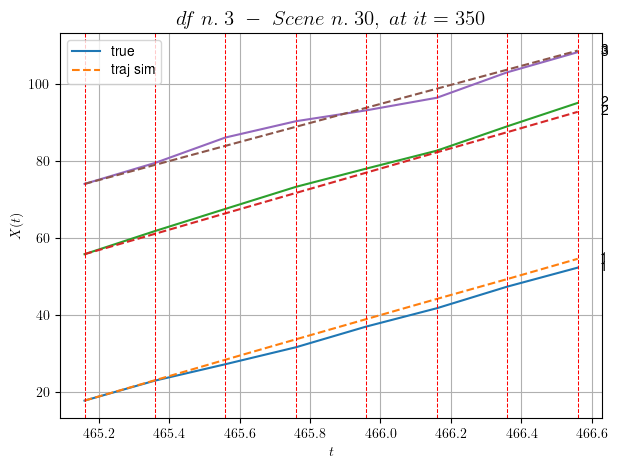

        For scene 30/55
        * use LR_NN=0.0001 with err=64.66371757784452 at it=19
        * v0_scn_mean = 25.174468891400444
        * MAE = 2.122576397324757



            - Time interval n.0: [467.16, 467.36]
                * y_true: [14.52040439 29.14139959]
                * v_ann: [19.264604568481445, 20.42564582824707, 20.77632950178191]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [467.36, 467.56]
                * y_true: [ 8.96028804 21.01119683]
                * v_ann: [19.641769409179688, 20.15561294555664, 20.77632950178191]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [467.56, 467.76]
                * y_true: [15.62056342 22.22157858]
                * v_ann: [19.690837860107422, 20.048931121826172, 20.77632950178191]

---------------------------------------------------------------------

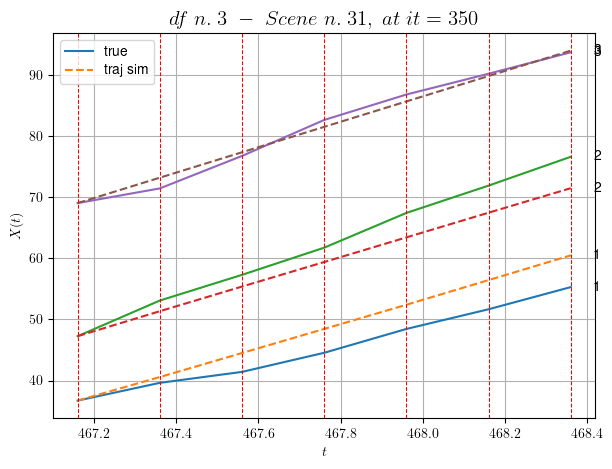

        For scene 31/55
        * use LR_NN=0.0001 with err=16.145627948963206 at it=19
        * v0_scn_mean = 21.56686295768006
        * MAE = 8.162825530138855



            - Time interval n.0: [480.76, 480.96]
                * y_true: [26.72145209 13.04113053]
                * v_ann: [17.86609649658203, 18.330333709716797, 18.30492624469463]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [480.96, 481.16]
                * y_true: [27.70182882 12.50117676]
                * v_ann: [17.729413986206055, 18.468538284301758, 18.30492624469463]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [481.16, 481.36]
                * y_true: [16.26121495 12.26123448]
                * v_ann: [17.56527328491211, 18.573802947998047, 18.30492624469463]

---------------------------------------------------------------------

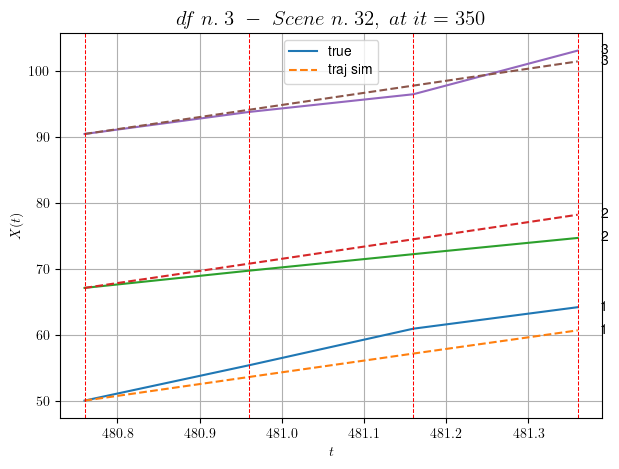

        For scene 32/55
        * use LR_NN=5e-05 with err=15.376741328705089 at it=19
        * v0_scn_mean = 19.30727634756958
        * MAE = 4.290206517746608



            - Time interval n.0: [487.16, 487.36]
                * y_true: [ 6.3002445  28.62315801]
                * v_ann: [9.857588768005371, 9.811659812927246, 23.071881683467836]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.36, 487.56]
                * y_true: [10.63044184 13.60161023]
                * v_ann: [17.852508544921875, 17.44837188720703, 23.071881683467836]

----------------------------------------------------------------------------------------------------
            * err= 3.1416311439470204
            * Learning rate NN = 0.0007289999630302191
            * diff = 5.716627699881016e-05


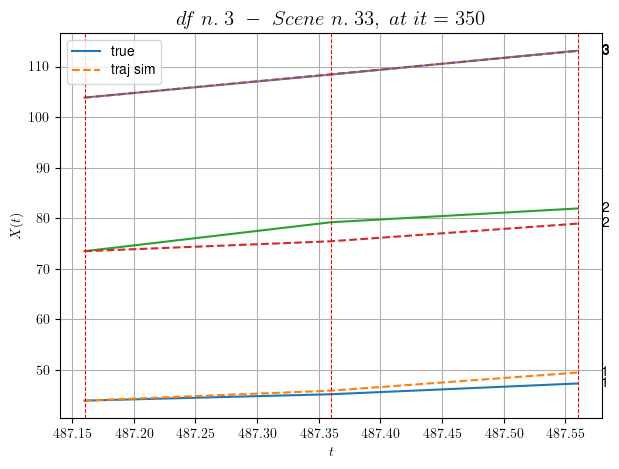

        For scene 33/55
        * use LR_NN=0.001 with err=8.28628065176694 at it=19
        * v0_scn_mean = 23.665670166773452
        * MAE = 2.9310801125521895



            - Time interval n.0: [498.56, 498.76]
                * y_true: [19.66086018 15.38134444]
                * v_ann: [17.040180206298828, 17.14320945739746, 26.404288947135246]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [498.76, 498.96]
                * y_true: [16.17082592 17.38167269]
                * v_ann: [17.044939041137695, 17.32421875, 26.404288947135246]

----------------------------------------------------------------------------------------------------
            * err= 0.1958224404698108
            * Learning rate NN = 7.289998757187277e-05
            * diff = 7.80076391166673e-05


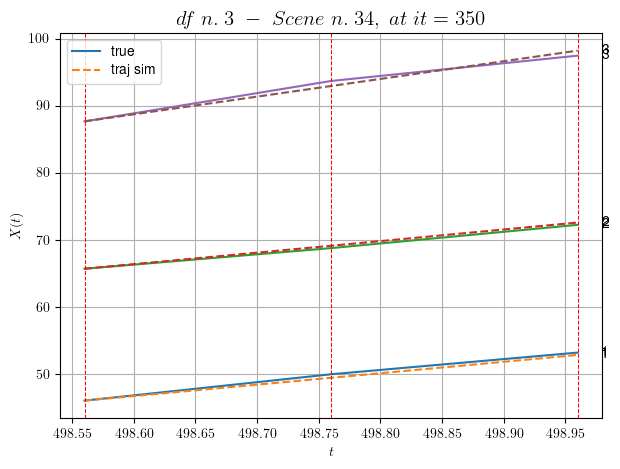

        For scene 34/55
        * use LR_NN=0.0001 with err=0.8225402262122365 at it=19
        * v0_scn_mean = 26.71246668240688
        * MAE = 0.1958224404698108



            - Time interval n.0: [517.96, 518.16]
                * y_true: [11.01062169 17.99135838]
                * v_ann: [13.620274543762207, 13.482928276062012, 13.435858379543824]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [518.16, 518.36]
                * y_true: [13.11081201 12.94110202]
                * v_ann: [13.934783935546875, 13.992992401123047, 13.435858379543824]

----------------------------------------------------------------------------------------------------
            * err= 0.2594570143346288
            * Learning rate NN = 0.00036449998151510954
            * diff = 9.975845006726658e-07


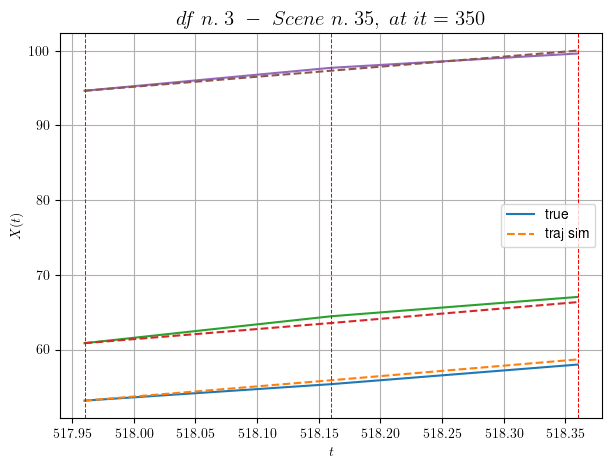

        For scene 35/55
        * use LR_NN=0.0005 with err=7.929108178473025 at it=19
        * v0_scn_mean = 14.855521855352594
        * MAE = 0.2594570143346288



            - Time interval n.0: [527.36, 527.56]
                * y_true: [14.45064103 23.0016556 ]
                * v_ann: [17.0281925201416, 16.89641761779785, 16.921000530112345]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [527.56, 527.76]
                * y_true: [16.14079976 10.04077962]
                * v_ann: [17.178569793701172, 17.402545928955078, 16.921000530112345]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [527.76, 527.96]
                * y_true: [12.25068777 19.3317022 ]
                * v_ann: [16.423498153686523, 16.46876335144043, 16.921000530112345]

-------------------------------------------------------------------

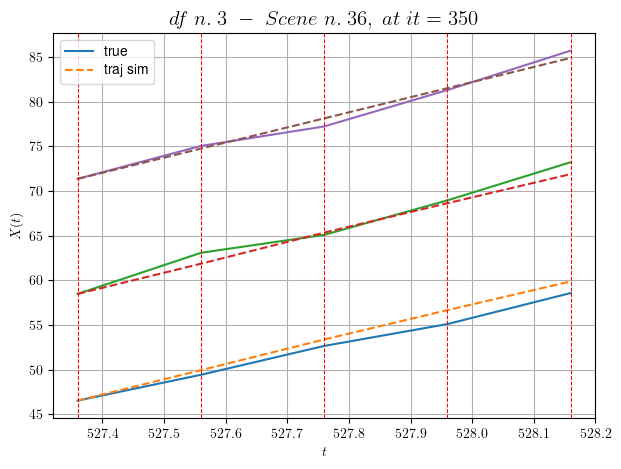

        For scene 36/55
        * use LR_NN=0.0005 with err=14.134166920997496 at it=19
        * v0_scn_mean = 18.04196280349681
        * MAE = 0.6628160640530504



            - Time interval n.0: [530.36, 530.56]
                * y_true: [16.07060164 26.13260896]
                * v_ann: [19.66476058959961, 19.759748458862305, 18.05494146639506]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [530.56, 530.76]
                * y_true: [15.14064363 18.85215172]
                * v_ann: [19.715038299560547, 19.85580825805664, 18.05494146639506]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [530.76, 530.96]
                * y_true: [16.69081323 25.36324467]
                * v_ann: [19.503013610839844, 19.7209529876709, 18.05494146639506]

----------------------------------------------------------------------

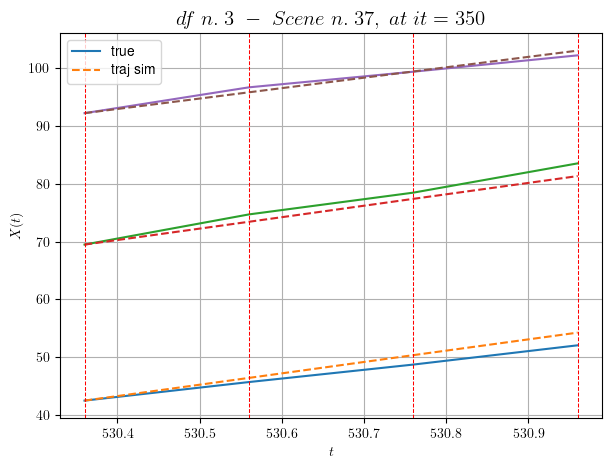

        For scene 37/55
        * use LR_NN=5e-05 with err=10.971107420404898 at it=19
        * v0_scn_mean = 19.078717023566924
        * MAE = 1.4210073075481304



            - Time interval n.0: [576.56, 576.76]
                * y_true: [22.12000755 22.50086521]
                * v_ann: [21.871915817260742, 21.723949432373047, 21.51674944574841]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [576.76, 576.96]
                * y_true: [22.90003133 17.69083   ]
                * v_ann: [22.20016860961914, 21.960506439208984, 21.51674944574841]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [576.96, 577.16]
                * y_true: [24.57008129 24.8113942 ]
                * v_ann: [21.000293731689453, 21.14042091369629, 21.51674944574841]

--------------------------------------------------------------------

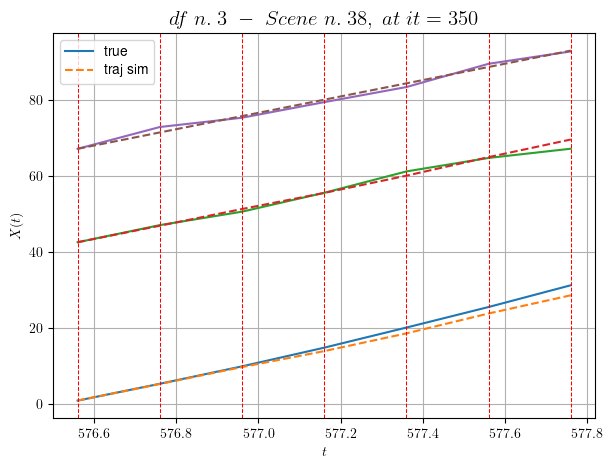

        For scene 38/55
        * use LR_NN=0.0005 with err=19.656990583951735 at it=19
        * v0_scn_mean = 22.243823703139324
        * MAE = 0.9588131991067628



            - Time interval n.0: [579.56, 579.76]
                * y_true: [21.03058275 42.18516565]
                * v_ann: [26.175569534301758, 25.752973556518555, 25.358438002860908]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.76, 579.96]
                * y_true: [19.36065083 36.06520173]
                * v_ann: [26.987524032592773, 26.05910301208496, 25.358438002860908]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.96, 580.16]
                * y_true: [21.76088956 12.96224398]
                * v_ann: [27.306385040283203, 25.98809051513672, 25.358438002860908]

----------------------------------------------------------------

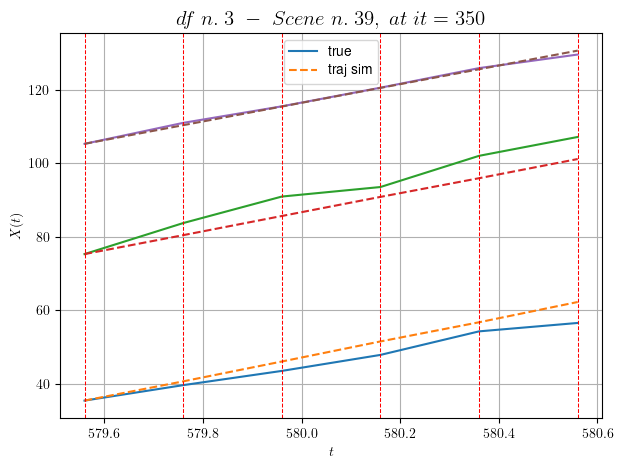

        For scene 39/55
        * use LR_NN=5e-05 with err=39.07278408968597 at it=19
        * v0_scn_mean = 25.756252522262212
        * MAE = 10.017588688847239



            - Time interval n.0: [592.16, 592.36]
                * y_true: [ 4.45046478 21.56401461]
                * v_ann: [15.935111999511719, 15.775304794311523, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [592.36, 592.56]
                * y_true: [14.40168088 21.61284101]
                * v_ann: [14.326683044433594, 15.565744400024414, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [592.56, 592.76]
                * y_true: [14.40168088 22.933287  ]
                * v_ann: [14.301277160644531, 15.703169822692871, 24.71001897344754]

-------------------------------------------------------------------

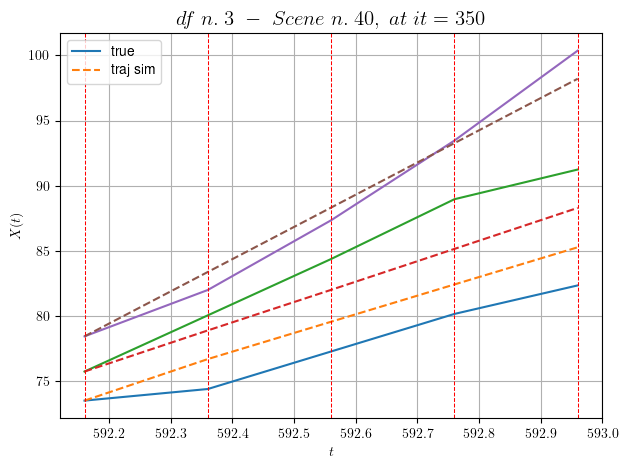

        For scene 40/55
        * use LR_NN=0.0005 with err=17.037992513529755 at it=19
        * v0_scn_mean = 25.163407565696268
        * MAE = 4.037092922208184



            - Time interval n.0: [21.56, 21.76]
                * y_true: [26.48927836 26.93283237 27.60013316]
                * v_ann: [24.615890502929688, 24.418725967407227, 24.724266052246094, 29.083788662827438]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.76, 21.96]
                * y_true: [24.19440937 24.35304119 22.73494812]
                * v_ann: [26.059181213378906, 26.349346160888672, 25.88808250427246, 29.083788662827438]

----------------------------------------------------------------------------------------------------
            * err= 0.1242205054075138
            * Learning rate NN = 0.00036449998151510954
            * diff = 7.730153394752692e-07


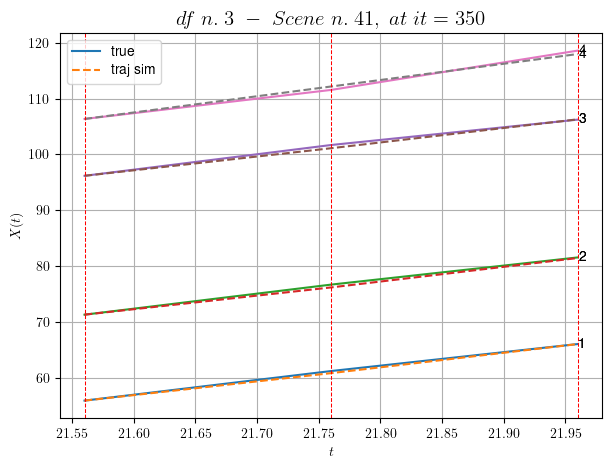

        For scene 41/55
        * use LR_NN=0.0005 with err=3.923617770154979 at it=19
        * v0_scn_mean = 29.188365659888323
        * MAE = 0.12418959948828687



            - Time interval n.0: [31.36, 31.56]
                * y_true: [24.92105739 19.11766565 26.56610692]
                * v_ann: [20.985729217529297, 22.197599411010742, 18.94379997253418, 30.91704367792893]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [31.56, 31.76]
                * y_true: [24.72130541 29.91666352 24.00857353]
                * v_ann: [24.37675666809082, 24.16852569580078, 24.644826889038086, 30.91704367792893]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [31.76, 31.96]
                * y_true: [24.58151426  8.80091982 33.80389928]
                * v_ann: [26.350481033325195, 25.040748596191406, 27.902986526489258

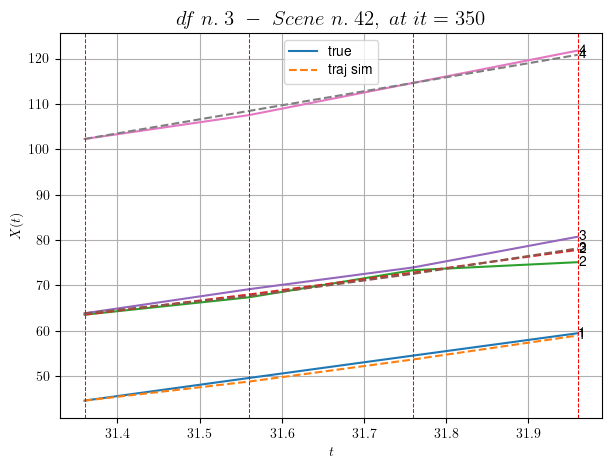

        For scene 42/55
        * use LR_NN=0.001 with err=15.516078758621955 at it=19
        * v0_scn_mean = 30.812371676917195
        * MAE = 0.5834155778294235



        For scene 43/55
        * use LR_NN=0.0005 with err=15.196929874661691 at it=19
        * v0_scn_mean = 25.099172339191735
        * MAE = 4.274273025663263



            - Time interval n.0: [34.96, 35.16]
                * y_true: [33.40218228 30.49313647 20.11252108]
                * v_ann: [25.714658737182617, 25.744192123413086, 25.639833450317383, 34.0439495799761]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [35.16, 35.36]
                * y_true: [28.66899207 22.90260208 19.5026699 ]
                * v_ann: [25.980249404907227, 25.97140884399414, 26.00191307067871, 34.0439495799761]

----------------------------------------------------------------------------------------------------
            * err= 1.224596643

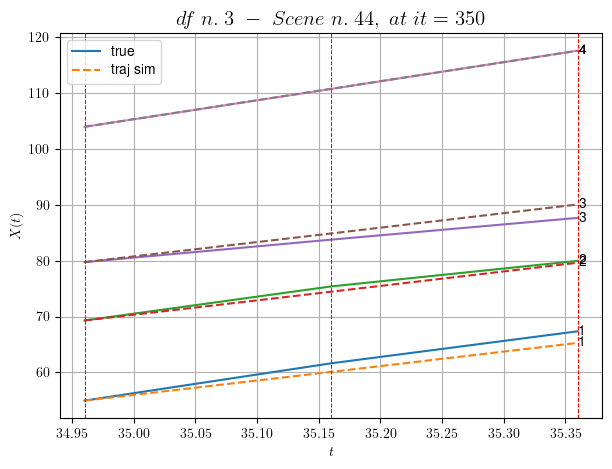

        For scene 44/55
        * use LR_NN=0.0001 with err=10.24597504865998 at it=19
        * v0_scn_mean = 33.582370372012356
        * MAE = 1.1462733522929858



            - Time interval n.0: [83.36, 83.56]
                * y_true: [27.1108197  22.97496526 13.79424223]
                * v_ann: [30.45500373840332, 28.849225997924805, 28.50033950805664, 26.108277505261047]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [83.56, 83.76]
                * y_true: [28.73111951 35.1785896  26.83859352]
                * v_ann: [20.131916046142578, 25.054738998413086, 25.847814559936523, 26.108277505261047]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [83.76, 83.96]
                * y_true: [29.25142438 34.77932949 18.27648805]
                * v_ann: [29.315080642700195, 28.122713088989258, 28.0235462188720

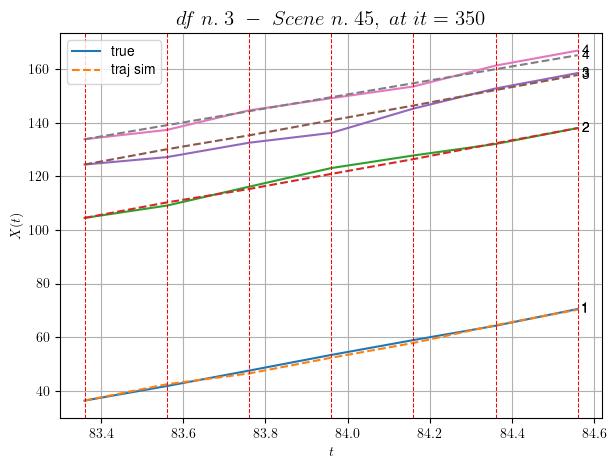

        For scene 45/55
        * use LR_NN=0.0005 with err=110.18702386898966 at it=19
        * v0_scn_mean = 26.552481408205672
        * MAE = 2.2150619584236644



        For scene 46/55
        * use LR_NN=0.001 with err=23.897275682026315 at it=19
        * v0_scn_mean = 29.593790259949973
        * MAE = 1.1050431404976826



            - Time interval n.0: [142.16, 142.36]
                * y_true: [31.90177154 33.47450881 19.84324761]
                * v_ann: [26.539993286132812, 26.726667404174805, 26.317508697509766, 28.121504824700015]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [142.36, 142.56]
                * y_true: [31.50218522 24.08376432 24.27420294]
                * v_ann: [26.580934524536133, 26.76845359802246, 26.395248413085938, 28.121504824700015]

----------------------------------------------------------------------------------------------------
            - Time i

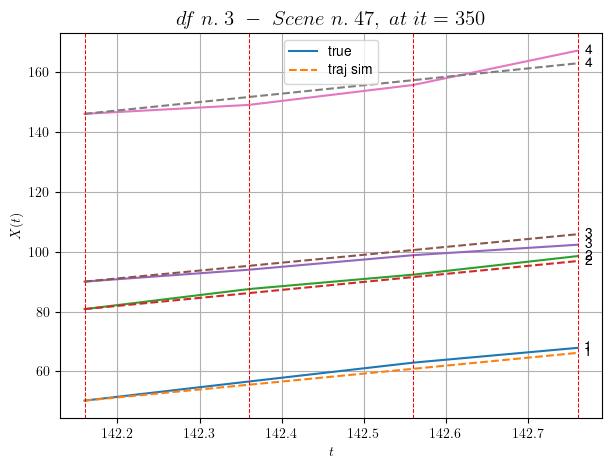

        For scene 47/55
        * use LR_NN=1e-05 with err=34.724776179352574 at it=19
        * v0_scn_mean = 28.335917566014114
        * MAE = 2.8305833240243246



            - Time interval n.0: [170.36, 170.56]
                * y_true: [24.1106547  30.95205085 31.86307572]
                * v_ann: [16.61099624633789, 18.227313995361328, 14.920310974121094, 32.99611396138362]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [28.33103197 10.10076519 29.63331411]
                * v_ann: [31.56001091003418, 30.09109115600586, 32.74980545043945, 32.99611396138362]

----------------------------------------------------------------------------------------------------
            * err= 2.563444625024922
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.00031305871399300855


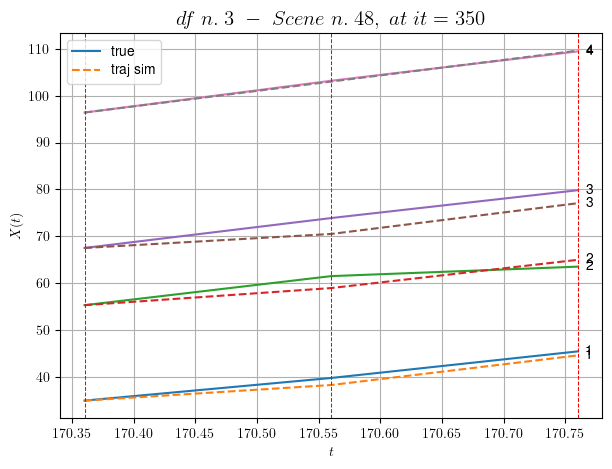

        For scene 48/55
        * use LR_NN=0.001 with err=2.794829113697448 at it=19
        * v0_scn_mean = 32.654135437192195
        * MAE = 1.0938116070976887



            - Time interval n.0: [248.16, 248.36]
                * y_true: [31.21204442 24.6823336  32.34552948]
                * v_ann: [33.1444091796875, 33.856109619140625, 32.43177795410156, 30.248935217315484]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [248.36, 248.56]
                * y_true: [31.9625999  29.77329807 35.48696999]
                * v_ann: [28.493820190429688, 27.394485473632812, 29.336904525756836, 30.248935217315484]

----------------------------------------------------------------------------------------------------
            * err= 0.6286437218744874
            * Learning rate NN = 0.0007289999630302191
            * diff = 1.7167618873825674e-05


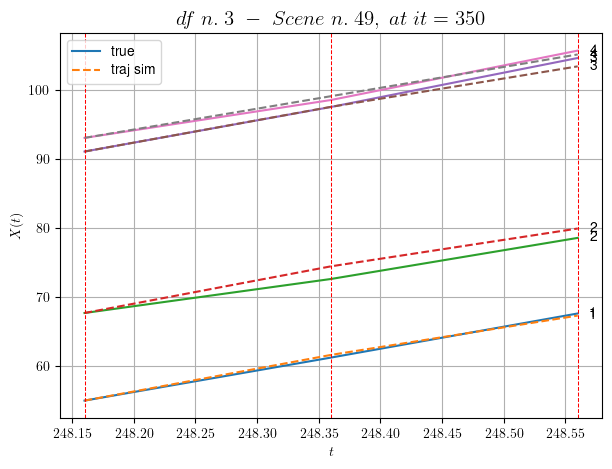

        For scene 49/55
        * use LR_NN=0.001 with err=19.75672945698446 at it=19
        * v0_scn_mean = 30.220521579071338
        * MAE = 0.6242745796506388



            - Time interval n.0: [320.56, 320.76]
                * y_true: [27.61038846 20.60122903 24.07186814]
                * v_ann: [34.163002014160156, 31.150192260742188, 33.90595626831055, 28.130406759666638]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.76, 320.96]
                * y_true: [30.26064275 26.25184013 33.56317876]
                * v_ann: [17.61450958251953, 21.671323776245117, 18.195711135864258, 28.130406759666638]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.96, 321.16]
                * y_true: [38.25114958 30.20253063 29.36323845]
                * v_ann: [31.9204044342041, 30.21126937866211, 32.06136703491

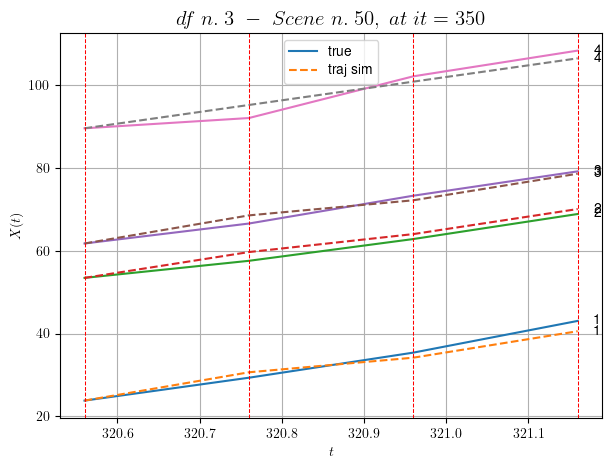

        For scene 50/55
        * use LR_NN=0.001 with err=10.853717087529741 at it=19
        * v0_scn_mean = 28.343803427953556
        * MAE = 1.651123561983326



            - Time interval n.0: [333.96, 334.16]
                * y_true: [31.40121985 21.58136302 16.05156144]
                * v_ann: [29.75279998779297, 29.532527923583984, 29.61368179321289, 24.21959719997416]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [334.16, 334.36]
                * y_true: [27.67132891 33.9725354  36.25406589]
                * v_ann: [29.260709762573242, 28.90464210510254, 28.767351150512695, 24.21959719997416]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [334.36, 334.56]
                * y_true: [23.81145278 36.52334008 36.85496039]
                * v_ann: [29.508373260498047, 29.25006675720215, 29.290056228637

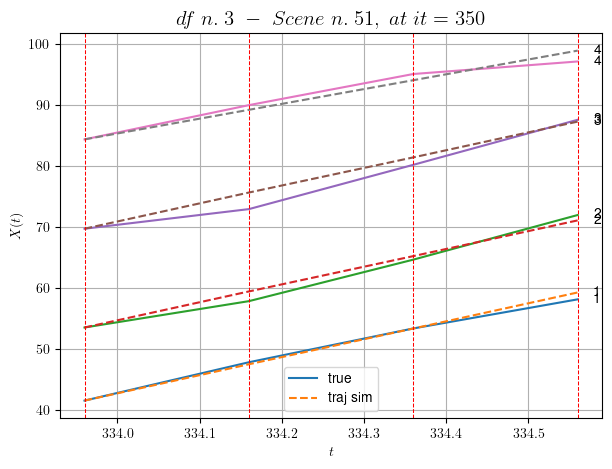

        For scene 51/55
        * use LR_NN=0.0001 with err=4.374771225213381 at it=19
        * v0_scn_mean = 24.87937638202892
        * MAE = 1.161939950435816



            - Time interval n.0: [393.36, 393.56]
                * y_true: [28.21049617 36.91227562 35.66212709]
                * v_ann: [29.371822357177734, 30.08201789855957, 28.306108474731445, 27.00671910788577]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [393.56, 393.76]
                * y_true: [27.89067116 17.24119841 30.82238865]
                * v_ann: [30.48555564880371, 27.780658721923828, 30.30460548400879, 27.00671910788577]

----------------------------------------------------------------------------------------------------
            * err= 1.5451655329648557
            * Learning rate NN = 7.289998757187277e-05
            * diff = 5.099437682298813e-05


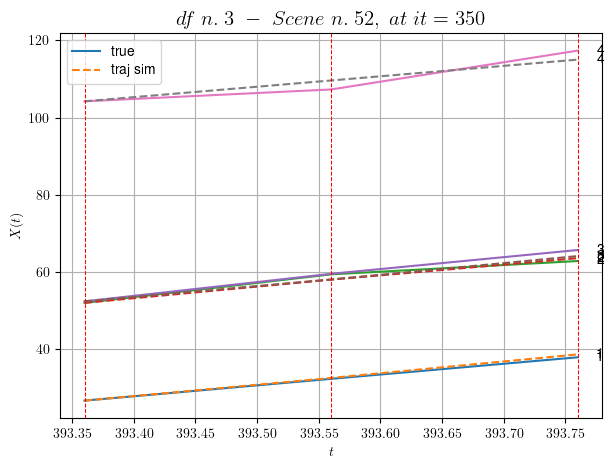

        For scene 52/55
        * use LR_NN=0.0001 with err=16.014899806605822 at it=19
        * v0_scn_mean = 27.348374263587086
        * MAE = 1.4832225581676433



            - Time interval n.0: [521.76, 521.96]
                * y_true: [10.54036018 15.07054541 11.30098461]
                * v_ann: [15.034915924072266, 15.00855541229248, 15.021486282348633, 17.249600462639368]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [521.96, 522.16]
                * y_true: [20.11080333 12.92054275 19.50185752]
                * v_ann: [14.917736053466797, 14.870739936828613, 14.894996643066406, 17.249600462639368]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [522.16, 522.36]
                * y_true: [16.31074126 16.85079656 12.50130097]
                * v_ann: [14.958535194396973, 15.00235366821289, 15.016489

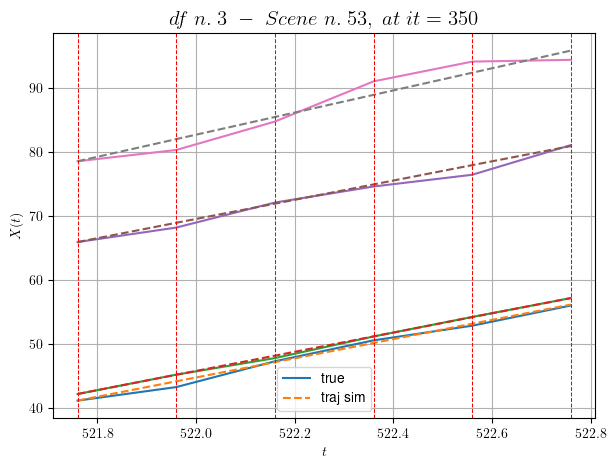

        For scene 53/55
        * use LR_NN=0.0001 with err=32.19660174545088 at it=19
        * v0_scn_mean = 18.704939903274198
        * MAE = 0.7081608852538857



            - Time interval n.0: [95.36, 95.56]
                * y_true: [30.52238998 38.21809619 31.62683865 21.81676128]
                * v_ann: [23.845670700073242, 25.862186431884766, 24.694522857666016, 25.89435577392578, 33.34860961624609]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [95.56, 95.76]
                * y_true: [29.11270185 26.43618159 23.59563306 15.73527867]
                * v_ann: [29.958499908447266, 28.057947158813477, 29.060199737548828, 28.179649353027344, 33.34860961624609]

----------------------------------------------------------------------------------------------------
            * err= 1.9092671821365648
            * Learning rate NN = 0.00036449998151510954
            * diff = 1.15313784285753

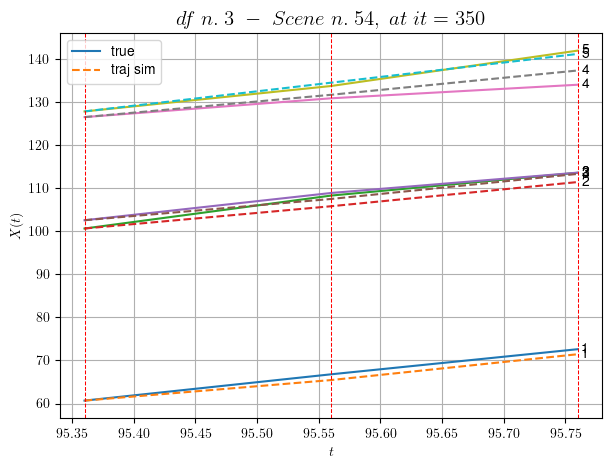

        For scene 54/55
        * use LR_NN=0.0005 with err=19.381706044719127 at it=19
        * v0_scn_mean = 32.873133483201805
        * MAE = 1.9083989434163662



For df=3 with 55 scenes, time taken:        639.02
------------------------------------------------------------
****************************************************************************************************
In df n.4/10 we have 30 scenes
****************************************************************************************************
        For scene 0/30
        * use LR_NN=0.0005 with err=11.680605117442097 at it=19
        * v0_scn_mean = 35.61121563984123
        * MAE = 2.248391521850327



            - Time interval n.0: [19.84, 20.04]
                * y_true: [38.50393497 35.76621737]
                * v_ann: [30.626131057739258, 29.431468963623047, 26.058995147815423]

----------------------------------------------------------------------------------------------------
            - Time interval n.1:

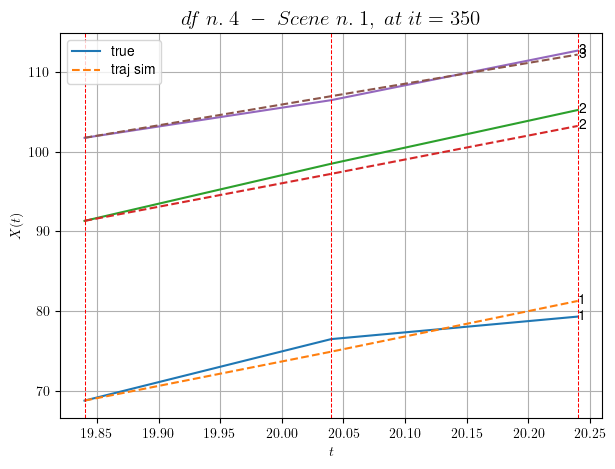

        For scene 1/30
        * use LR_NN=0.0001 with err=10.6158278413586 at it=19
        * v0_scn_mean = 26.396766991043386
        * MAE = 1.3761919682872028



            - Time interval n.0: [23.64, 23.84]
                * y_true: [16.50112189 27.57447859]
                * v_ann: [16.5927677154541, 17.63410186767578, 25.974604646459856]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [13.80103575 15.46275359]
                * v_ann: [18.156747817993164, 16.511442184448242, 25.974604646459856]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [18.55153987 13.07248815]
                * v_ann: [17.117244720458984, 18.01714324951172, 25.974604646459856]

---------------------------------------------------------------------------

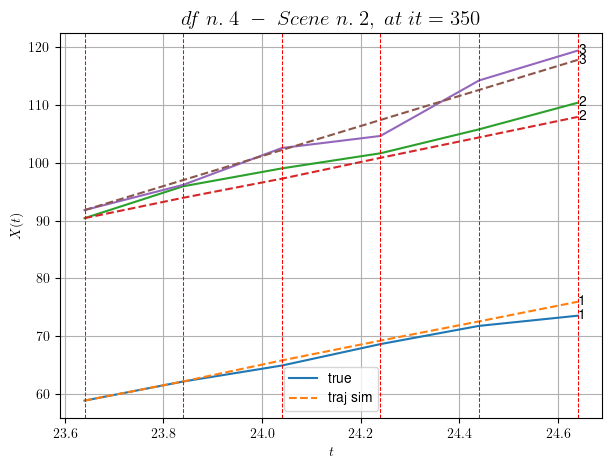

        For scene 2/30
        * use LR_NN=0.0005 with err=41.94995666718079 at it=19
        * v0_scn_mean = 26.31960934939314
        * MAE = 1.961044792759564



            - Time interval n.0: [80.24, 80.44]
                * y_true: [20.8407888  28.56113721]
                * v_ann: [26.569547653198242, 27.273258209228516, 22.36782942305619]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [80.44, 80.64]
                * y_true: [28.49133895 28.481454  ]
                * v_ann: [26.347606658935547, 26.368837356567383, 22.36782942305619]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [80.64, 80.84]
                * y_true: [29.84173661 32.11200361]
                * v_ann: [26.7303466796875, 27.136411666870117, 22.36782942305619]

-----------------------------------------------------------------------------

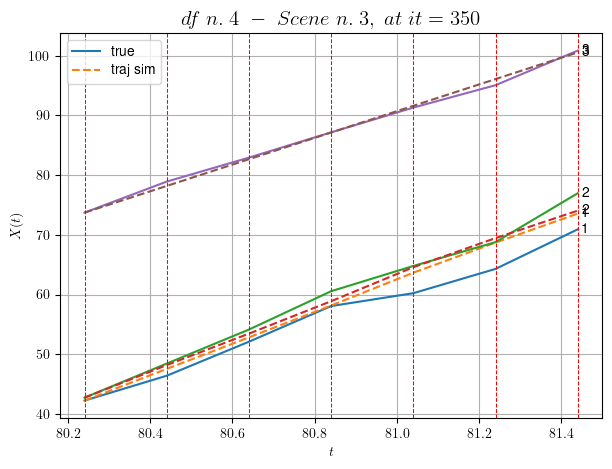

        For scene 3/30
        * use LR_NN=0.0005 with err=81.41218223509162 at it=19
        * v0_scn_mean = 23.02196013851969
        * MAE = 2.574763928454213



            - Time interval n.0: [89.04, 89.24]
                * y_true: [19.34082001 24.8230577 ]
                * v_ann: [19.618221282958984, 20.29630470275879, 32.77541157779934]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.24, 89.44]
                * y_true: [14.120693   17.32233598]
                * v_ann: [19.775373458862305, 20.4846248626709, 32.77541157779934]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.44, 89.64]
                * y_true: [18.19104002 31.50485669]
                * v_ann: [19.069238662719727, 19.56142807006836, 32.77541157779934]

-------------------------------------------------------------------------------

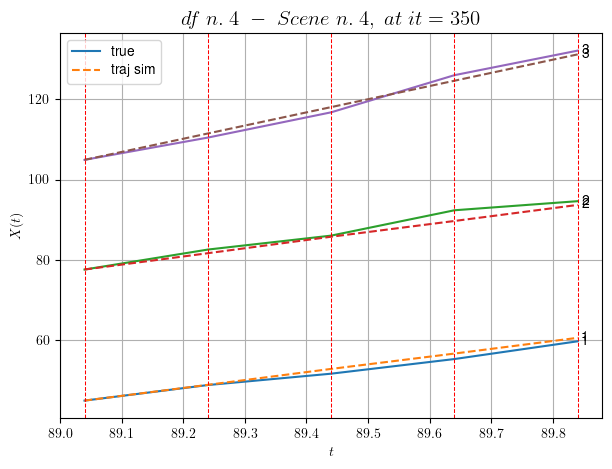

        For scene 4/30
        * use LR_NN=0.0001 with err=3.986043344178521 at it=19
        * v0_scn_mean = 32.537539278852584
        * MAE = 1.2234135953568972



            - Time interval n.0: [96.44, 96.64]
                * y_true: [16.86045215 20.08121647]
                * v_ann: [19.281095504760742, 19.100027084350586, 18.40136441642366]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.64, 96.84]
                * y_true: [17.24055532  8.93061591]
                * v_ann: [19.076875686645508, 18.892444610595703, 18.40136441642366]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [96.84, 97.04]
                * y_true: [21.11081641 16.18118624]
                * v_ann: [17.688457489013672, 17.087383270263672, 18.40136441642366]

-------------------------------------------------------------------------

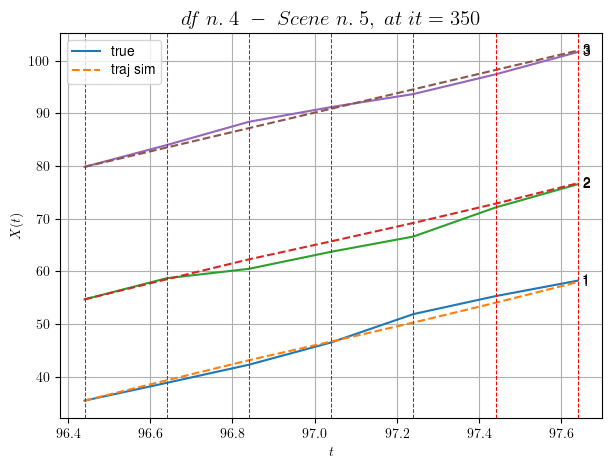

        For scene 5/30
        * use LR_NN=0.0005 with err=31.432182254680423 at it=19
        * v0_scn_mean = 19.395449089479236
        * MAE = 1.061671142807507



            - Time interval n.0: [182.24, 182.44]
                * y_true: [18.61043577 13.125309  ]
                * v_ann: [19.71595573425293, 20.16777801513672, 20.773266238582984]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.44, 182.64]
                * y_true: [12.51734154 21.64870909]
                * v_ann: [16.401653289794922, 18.079301834106445, 20.773266238582984]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [182.64, 182.84]
                * y_true: [15.03048681 24.29091592]
                * v_ann: [19.08622932434082, 17.72199249267578, 20.773266238582984]

--------------------------------------------------------------------

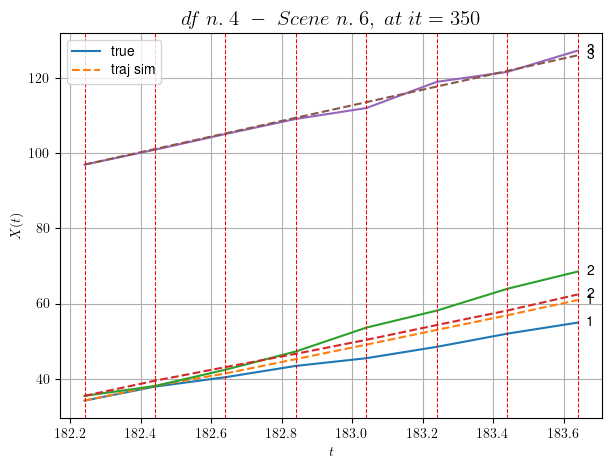

        For scene 6/30
        * use LR_NN=0.0005 with err=50.809465854171826 at it=19
        * v0_scn_mean = 21.564062237689914
        * MAE = 8.342117426090793



            - Time interval n.0: [193.04, 193.24]
                * y_true: [26.28155868 27.90372348]
                * v_ann: [25.67852783203125, 25.668153762817383, 18.506611798356342]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [193.24, 193.44]
                * y_true: [29.63205884 19.30286837]
                * v_ann: [25.933929443359375, 25.82658576965332, 18.506611798356342]

----------------------------------------------------------------------------------------------------
            * err= 0.33266835025018177
            * Learning rate NN = 7.289998757187277e-05
            * diff = 4.536576248537205e-05


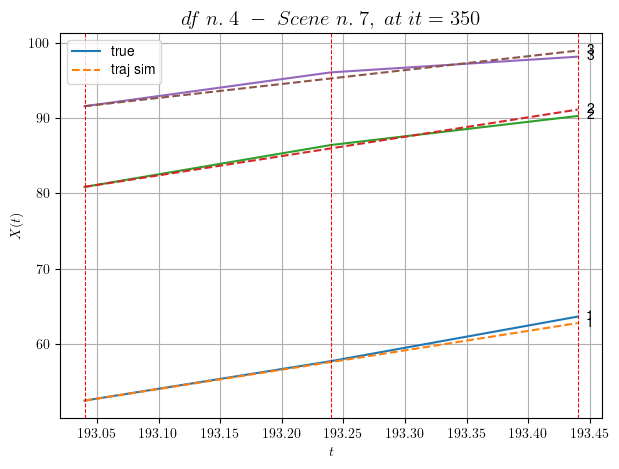

        For scene 7/30
        * use LR_NN=0.0001 with err=7.294961875030755 at it=19
        * v0_scn_mean = 19.491676030300034
        * MAE = 0.3268317647257801



            - Time interval n.0: [196.84, 197.04]
                * y_true: [ 8.77046468 10.16548364]
                * v_ann: [9.562921524047852, 3.923259080305407e-21, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [197.04, 197.24]
                * y_true: [7.43042623 9.26246532]
                * v_ann: [8.240025520324707, 4.658481257719436e-26, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            * err= 2.222884135560768
            * Learning rate NN = 0.0036449995823204517
            * diff = 5.431860987670234e-06


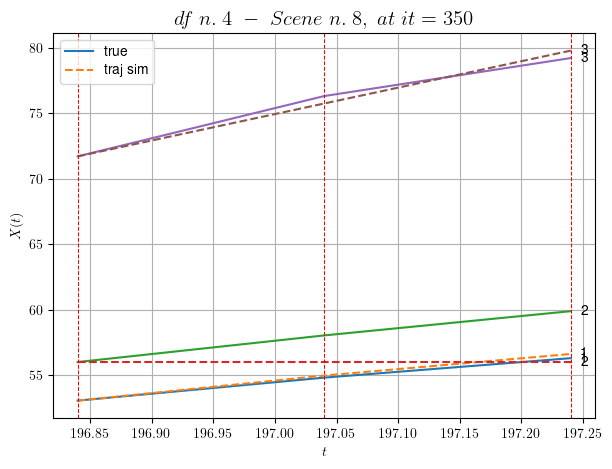

        For scene 8/30
        * use LR_NN=0.005 with err=3.1507788534767207 at it=19
        * v0_scn_mean = 21.02972921038931
        * MAE = 2.222884135560768



        For scene 9/30
        * use LR_NN=0.0001 with err=5.404060740914589 at it=19
        * v0_scn_mean = 30.094441532938035
        * MAE = 30.51618156307838



            - Time interval n.0: [224.84, 225.04]
                * y_true: [17.10046829 25.29311811]
                * v_ann: [19.026439666748047, 19.195287704467773, 15.713780360625558]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.04, 225.24]
                * y_true: [17.70062553 10.9614656 ]
                * v_ann: [19.264522552490234, 19.327985763549805, 15.713780360625558]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.24, 225.44]
                * y_true: [22.57087879 

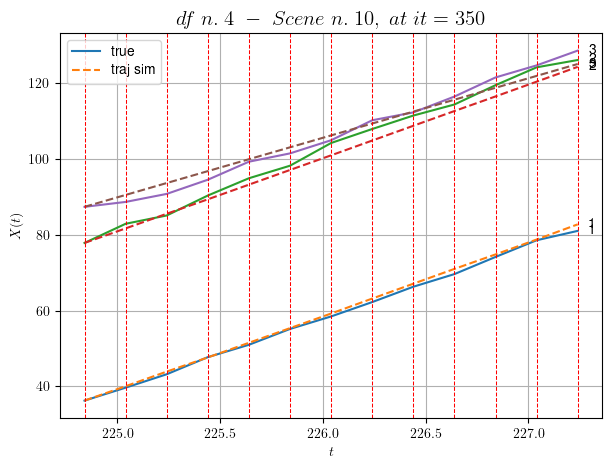

        For scene 10/30
        * use LR_NN=0.0005 with err=297.7317018403666 at it=19
        * v0_scn_mean = 16.938209896071562
        * MAE = 3.1365387236851046



            - Time interval n.0: [230.84, 231.04]
                * y_true: [ 5.64695095 17.97864337]
                * v_ann: [11.856456756591797, 14.060428619384766, 23.322771251469145]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [231.04, 231.24]
                * y_true: [ 5.72513489 21.19066695]
                * v_ann: [14.189878463745117, 13.741402626037598, 23.322771251469145]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [231.24, 231.44]
                * y_true: [ 6.01015392 28.29114422]
                * v_ann: [14.08372974395752, 13.634557723999023, 23.322771251469145]

----------------------------------------------------------------

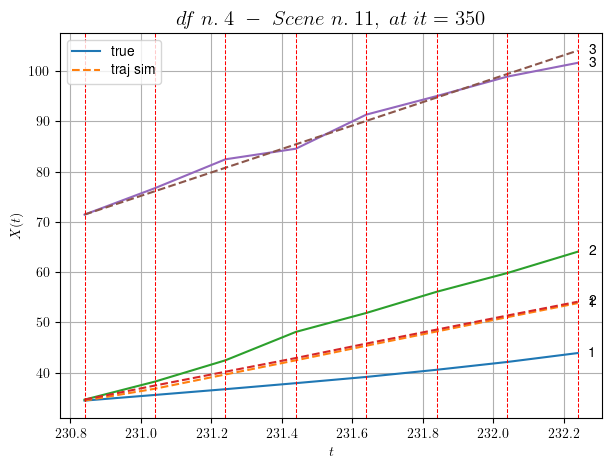

        For scene 11/30
        * use LR_NN=0.0005 with err=20.665587220634137 at it=19
        * v0_scn_mean = 23.895056733633968
        * MAE = 25.600795319914297



            - Time interval n.0: [233.84, 234.04]
                * y_true: [14.14101026 12.7012637 ]
                * v_ann: [21.418004989624023, 21.898347854614258, 21.46286816031569]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.04, 234.24]
                * y_true: [26.43219185 20.11227439]
                * v_ann: [19.904781341552734, 19.822917938232422, 21.46286816031569]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [234.24, 234.44]
                * y_true: [22.40209801 33.22429882]
                * v_ann: [20.49079704284668, 20.668676376342773, 21.46286816031569]

------------------------------------------------------------------

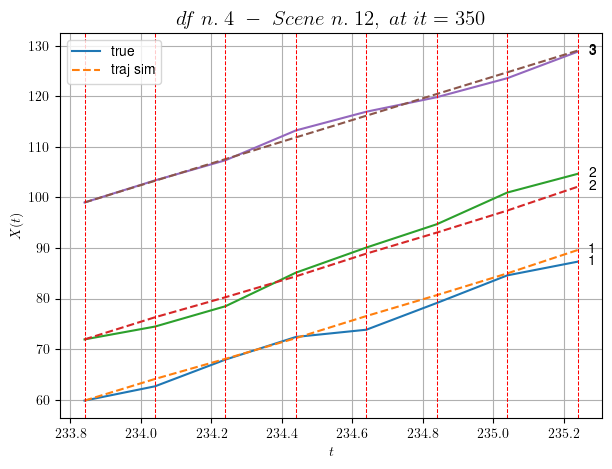

        For scene 12/30
        * use LR_NN=0.0005 with err=35.09454349695392 at it=19
        * v0_scn_mean = 22.194560422955675
        * MAE = 2.1568107489778696



            - Time interval n.0: [302.44, 302.64]
                * y_true: [15.00036276 19.90190261]
                * v_ann: [19.756567001342773, 19.552919387817383, 25.744568982281763]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [302.64, 302.84]
                * y_true: [17.72492583 25.30273749]
                * v_ann: [19.376846313476562, 19.23517417907715, 25.744568982281763]

----------------------------------------------------------------------------------------------------
            * err= 0.5471495441314711
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0005236081416472027


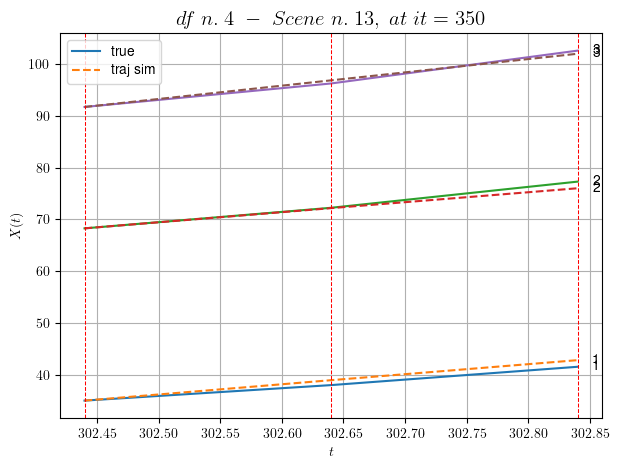

        For scene 13/30
        * use LR_NN=0.0001 with err=2.106106461231638 at it=19
        * v0_scn_mean = 26.10928936007713
        * MAE = 0.5093024387759266



            - Time interval n.0: [364.64, 364.84]
                * y_true: [23.68175628 20.26218764]
                * v_ann: [18.190343856811523, 19.289077758789062, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [364.84, 365.04]
                * y_true: [20.38169455 13.81168669]
                * v_ann: [19.22191619873047, 19.91887092590332, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [365.04, 365.24]
                * y_true: [10.17092159 27.1635357 ]
                * v_ann: [19.100807189941406, 17.894515991210938, 28.205737859029586]

------------------------------------------------------------------

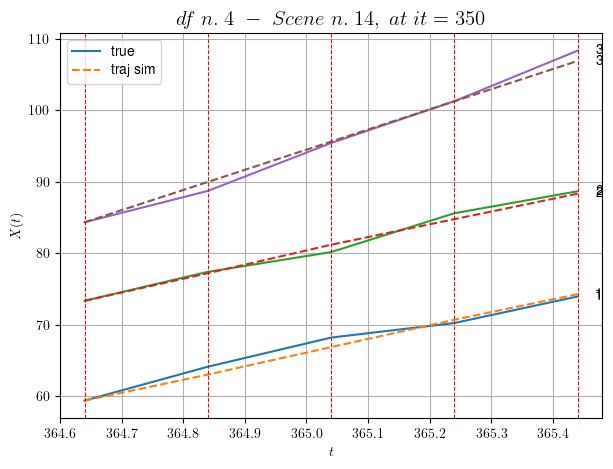

        For scene 14/30
        * use LR_NN=0.0005 with err=1.2716943511598782 at it=19
        * v0_scn_mean = 28.35951874824957
        * MAE = 0.563346359080449



            - Time interval n.0: [422.64, 422.84]
                * y_true: [18.36052369 19.91162557]
                * v_ann: [25.10344696044922, 24.685733795166016, 27.545107346546942]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [422.84, 423.04]
                * y_true: [28.40107569 15.51150308]
                * v_ann: [24.558748245239258, 24.300617218017578, 27.545107346546942]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [423.04, 423.24]
                * y_true: [26.09121176 24.58263804]
                * v_ann: [24.274093627929688, 24.15873146057129, 27.545107346546942]

------------------------------------------------------------------

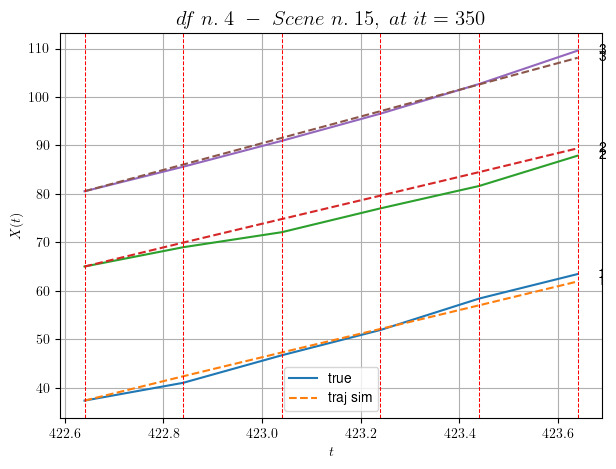

        For scene 15/30
        * use LR_NN=0.0001 with err=3.109979989133881 at it=19
        * v0_scn_mean = 27.755508918629264
        * MAE = 1.9552129901632753



            - Time interval n.0: [440.44, 440.64]
                * y_true: [23.50209477 27.05306951]
                * v_ann: [19.89450454711914, 19.115615844726562, 21.12705861242083]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [440.64, 440.84]
                * y_true: [ 8.15079495 24.70319187]
                * v_ann: [22.153898239135742, 21.88751792907715, 21.12705861242083]

----------------------------------------------------------------------------------------------------
            * err= 1.3371107844216799
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0005966117736357912


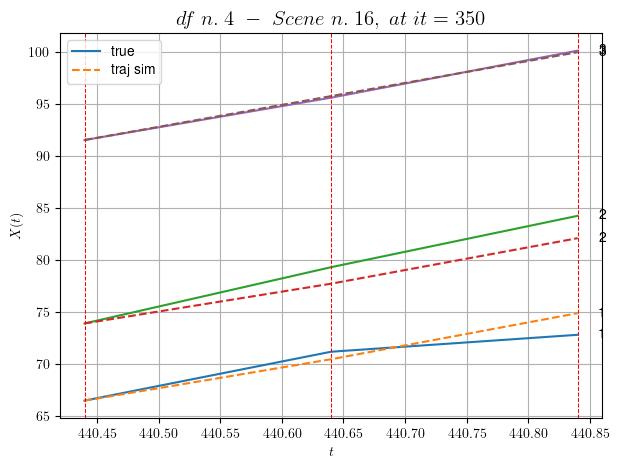

        For scene 16/30
        * use LR_NN=0.0005 with err=2.8325475368605257 at it=19
        * v0_scn_mean = 21.88753211594219
        * MAE = 1.3371107844216799



            - Time interval n.0: [459.64, 459.84]
                * y_true: [ 8.02057991 18.30147717]
                * v_ann: [16.668907165527344, 19.366756439208984, 21.749537222116768]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [459.84, 460.04]
                * y_true: [15.90126261 32.50305135]
                * v_ann: [17.086626052856445, 19.39788246154785, 21.749537222116768]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [460.04, 460.24]
                * y_true: [12.56106954  7.60079575]
                * v_ann: [18.42960548400879, 18.300676345825195, 21.749537222116768]

-----------------------------------------------------------------

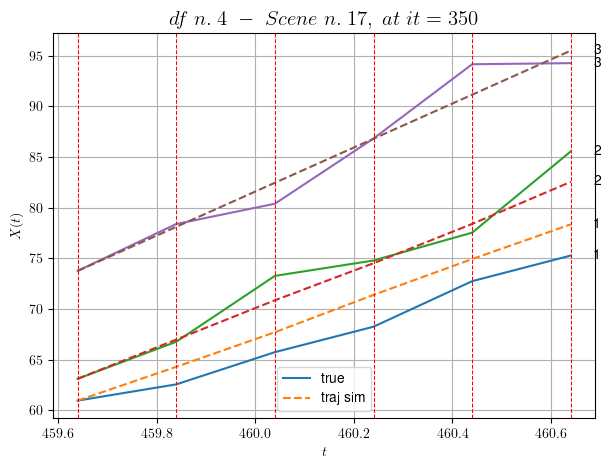

        For scene 17/30
        * use LR_NN=0.0001 with err=11.822932477373245 at it=19
        * v0_scn_mean = 22.456659929267406
        * MAE = 3.420296819760638



            - Time interval n.0: [493.84, 494.04]
                * y_true: [22.94003108 21.75102788]
                * v_ann: [22.790802001953125, 22.953325271606445, 20.437010740210074]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.04, 494.24]
                * y_true: [17.14085991 24.35137427]
                * v_ann: [22.75130844116211, 22.91646385192871, 20.437010740210074]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [494.24, 494.44]
                * y_true: [21.88131212 25.00167951]
                * v_ann: [22.62896156311035, 22.732147216796875, 20.437010740210074]

------------------------------------------------------------------

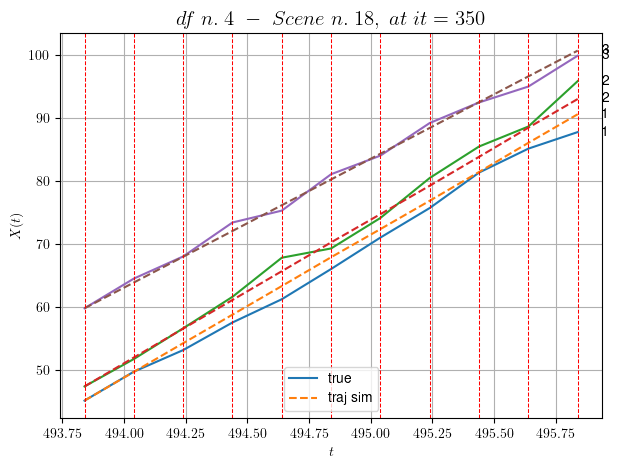

        For scene 18/30
        * use LR_NN=0.0005 with err=92.34477263383586 at it=19
        * v0_scn_mean = 21.25662620129172
        * MAE = 1.4726617091535932



            - Time interval n.0: [520.04, 520.24]
                * y_true: [17.72000935 17.53021327]
                * v_ann: [20.777868270874023, 21.050907135009766, 25.962836499253886]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [520.24, 520.44]
                * y_true: [21.19003079 20.68032877]
                * v_ann: [20.707231521606445, 20.971569061279297, 25.962836499253886]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [520.44, 520.64]
                * y_true: [20.95006602 20.21041565]
                * v_ann: [20.70755386352539, 20.97283172607422, 25.962836499253886]

------------------------------------------------------------------

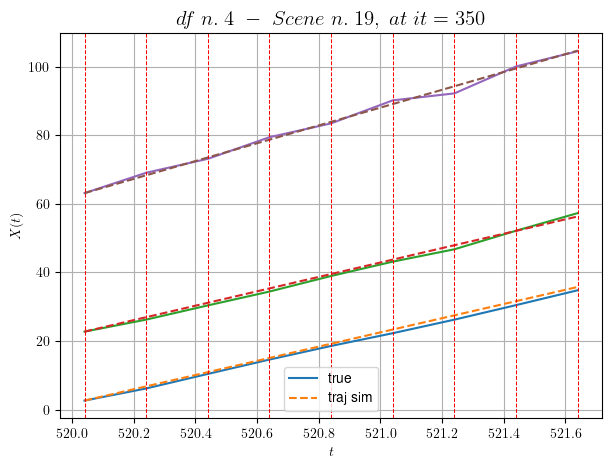

        For scene 19/30
        * use LR_NN=5e-05 with err=30.963372508130078 at it=19
        * v0_scn_mean = 26.30884981519902
        * MAE = 0.6827832090860029



            - Time interval n.0: [550.44, 550.64]
                * y_true: [23.95217582 22.66294351]
                * v_ann: [23.63493537902832, 23.531497955322266, 20.148468822561938]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [550.64, 550.84]
                * y_true: [22.2022957  28.49416646]
                * v_ann: [23.544227600097656, 23.456016540527344, 20.148468822561938]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [550.84, 551.04]
                * y_true: [19.80228834 20.61332089]
                * v_ann: [24.147533416748047, 23.88067054748535, 20.148468822561938]

------------------------------------------------------------------

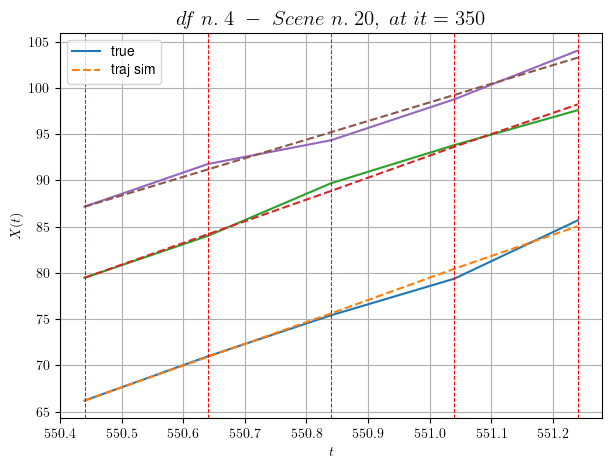

        For scene 20/30
        * use LR_NN=0.0005 with err=16.73555403365511 at it=19
        * v0_scn_mean = 20.99281435605698
        * MAE = 0.3102136640491268



            - Time interval n.0: [554.64, 554.84]
                * y_true: [16.3871362  34.43556815]
                * v_ann: [23.503236770629883, 23.316654205322266, 20.440796892460902]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.84, 555.04]
                * y_true: [19.58824641 23.53414882]
                * v_ann: [23.563745498657227, 23.54641342163086, 20.440796892460902]

----------------------------------------------------------------------------------------------------
            * err= 1.8728309061102852
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0008012637160335068


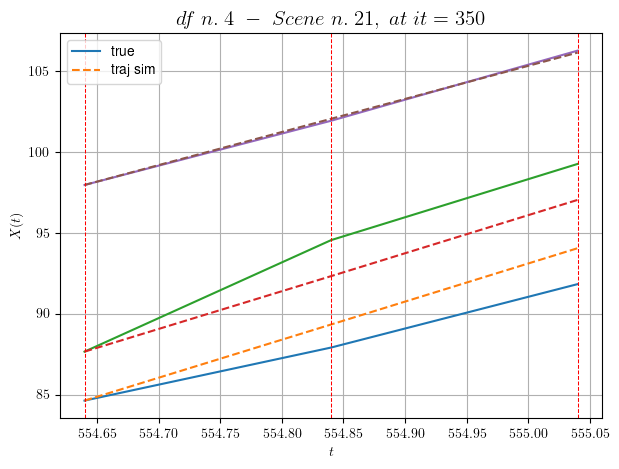

        For scene 21/30
        * use LR_NN=0.0001 with err=11.057749594205353 at it=19
        * v0_scn_mean = 21.260087853656678
        * MAE = 1.8411562099496452



            - Time interval n.0: [556.24, 556.44]
                * y_true: [24.75252122 21.70224237]
                * v_ann: [24.0706787109375, 24.164358139038086, 15.086200202024663]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [556.44, 556.64]
                * y_true: [25.4427559  22.85265518]
                * v_ann: [23.420764923095703, 23.07245445251465, 15.086200202024663]

----------------------------------------------------------------------------------------------------
            * err= 0.16485297403537616
            * Learning rate NN = 0.0007289999630302191
            * diff = 1.024682347916528e-06


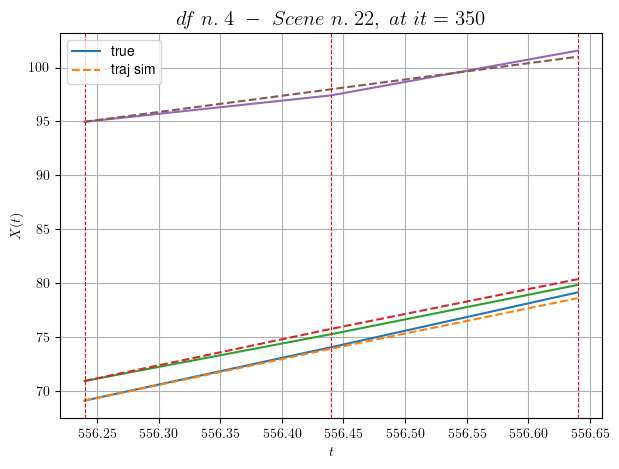

        For scene 22/30
        * use LR_NN=0.001 with err=15.164591399885024 at it=19
        * v0_scn_mean = 16.364417772475882
        * MAE = 0.15949079451123174



            - Time interval n.0: [575.04, 575.24]
                * y_true: [25.50060057 18.90068968]
                * v_ann: [21.19577407836914, 21.448888778686523, 24.545660919824957]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [575.24, 575.44]
                * y_true: [27.95087423 28.65128625]
                * v_ann: [21.49623680114746, 22.442733764648438, 24.545660919824957]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [575.44, 575.64]
                * y_true: [21.25083564 15.85084753]
                * v_ann: [23.88385009765625, 29.980316162109375, 24.545660919824957]

-----------------------------------------------------------------

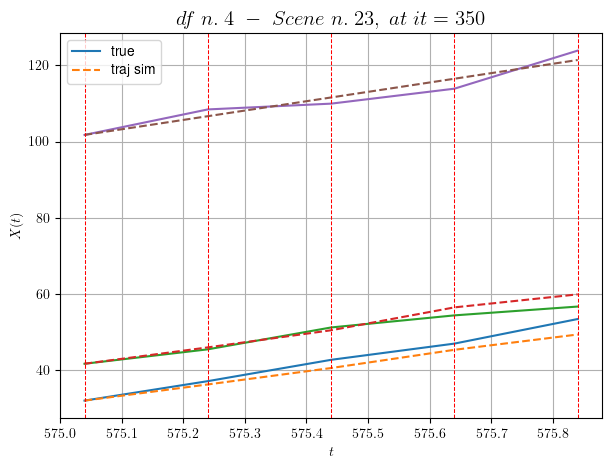

        For scene 23/30
        * use LR_NN=0.0005 with err=46.13898781192979 at it=19
        * v0_scn_mean = 25.013136153629997
        * MAE = 2.014003601704452



            - Time interval n.0: [313.84, 314.04]
                * y_true: [15.70108851 23.28855659 11.30165534]
                * v_ann: [24.635507583618164, 25.200607299804688, 25.360374450683594, 26.41603907656736]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [314.04, 314.24]
                * y_true: [25.15198981 24.43240479 30.10483754]
                * v_ann: [24.051023483276367, 24.195650100708008, 24.310794830322266, 26.41603907656736]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [314.24, 314.44]
                * y_true: [27.30252596 23.75264682 40.35752125]
                * v_ann: [24.226755142211914, 24.473417282104492, 24.61129379

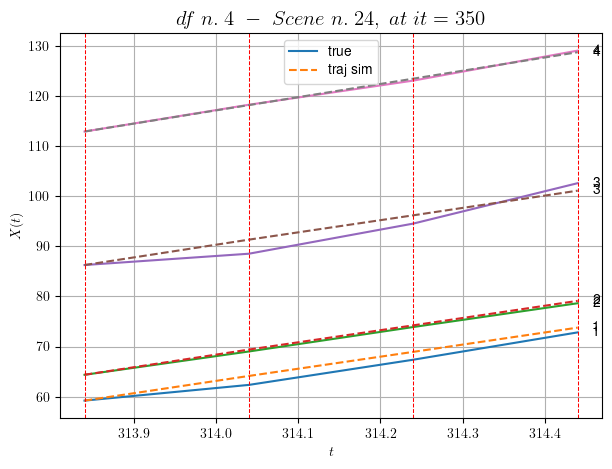

        For scene 24/30
        * use LR_NN=0.0001 with err=10.864988318456957 at it=19
        * v0_scn_mean = 26.825114860449865
        * MAE = 1.2508199718701773



            - Time interval n.0: [460.84, 461.04]
                * y_true: [19.8211655  14.23151831 20.23251805]
                * v_ann: [19.160152435302734, 19.089731216430664, 19.11089324951172, 26.4048256752631]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [461.04, 461.24]
                * y_true: [19.5413591  21.77263281 16.55223683]
                * v_ann: [18.193939208984375, 18.3037166595459, 18.268281936645508, 26.4048256752631]

----------------------------------------------------------------------------------------------------
            * err= 0.13620610801227329
            * Learning rate NN = 0.0007289999630302191
            * diff = 7.833915888488807e-07


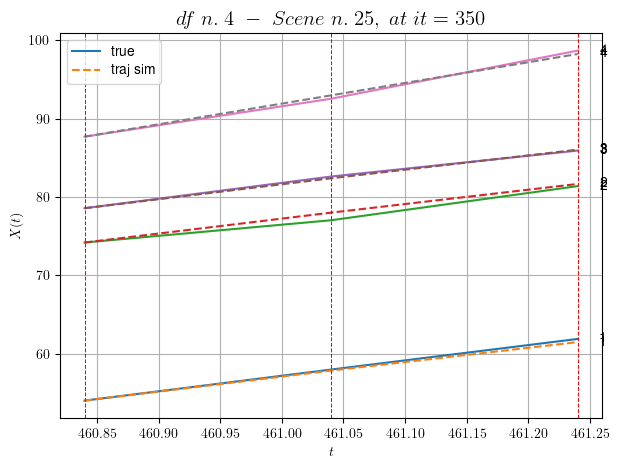

        For scene 25/30
        * use LR_NN=0.001 with err=3.3427762954273166 at it=19
        * v0_scn_mean = 26.81518136454267
        * MAE = 0.13620610801227329



        For scene 26/30
        * use LR_NN=0.001 with err=10.101155940415032 at it=19
        * v0_scn_mean = 31.19336871918831
        * MAE = 0.2833646852654319



            - Time interval n.0: [495.24, 495.44]
                * y_true: [12.91123632 28.10335872 24.95329593]
                * v_ann: [24.134740829467773, 24.364604949951172, 22.847890853881836, 16.439733421153882]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [495.44, 495.64]
                * y_true: [ 9.32105302 18.99250639 15.85230368]
                * v_ann: [22.076993942260742, 23.740501403808594, 22.62839698791504, 16.439733421153882]

----------------------------------------------------------------------------------------------------
            - Time int

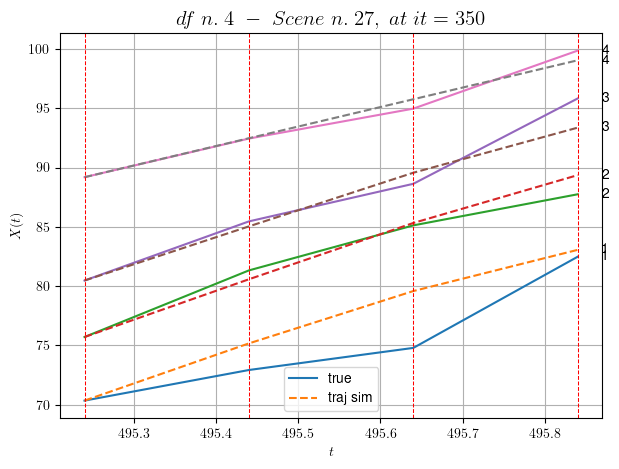

        For scene 27/30
        * use LR_NN=0.001 with err=10.544952083387187 at it=19
        * v0_scn_mean = 17.987511647231127
        * MAE = 2.4992456363816586



            - Time interval n.0: [541.84, 542.04]
                * y_true: [15.49040827 18.57067001 15.06113134]
                * v_ann: [19.00322723388672, 19.10588836669922, 19.103843688964844, 25.31225808344113]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [542.04, 542.24]
                * y_true: [18.02057424 22.22093452 14.29121645]
                * v_ann: [18.470184326171875, 18.345829010009766, 18.32575035095215, 25.31225808344113]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [542.24, 542.44]
                * y_true: [23.32090187 15.10072652 30.16295254]
                * v_ann: [18.423662185668945, 18.30733299255371, 18.25021743774

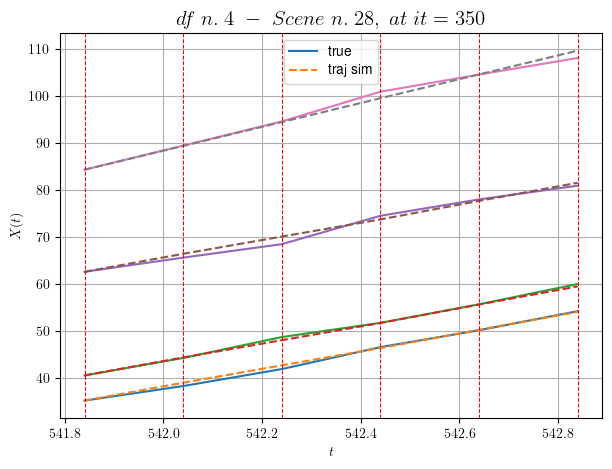

        For scene 28/30
        * use LR_NN=0.0005 with err=18.534733262500158 at it=19
        * v0_scn_mean = 25.84732019492212
        * MAE = 0.4444489105133214



            - Time interval n.0: [559.04, 559.24]
                * y_true: [23.32160164 21.40183754 23.15354324]
                * v_ann: [18.010669708251953, 17.377771377563477, 18.004125595092773, 21.821996764913905]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [559.24, 559.44]
                * y_true: [16.34126249 10.38103794 18.30306556]
                * v_ann: [19.770286560058594, 19.57807731628418, 19.768207550048828, 21.821996764913905]

----------------------------------------------------------------------------------------------------
            * err= 0.38441314986902453
            * Learning rate NN = 0.00036449998151510954
            * diff = 9.029993690923277e-05


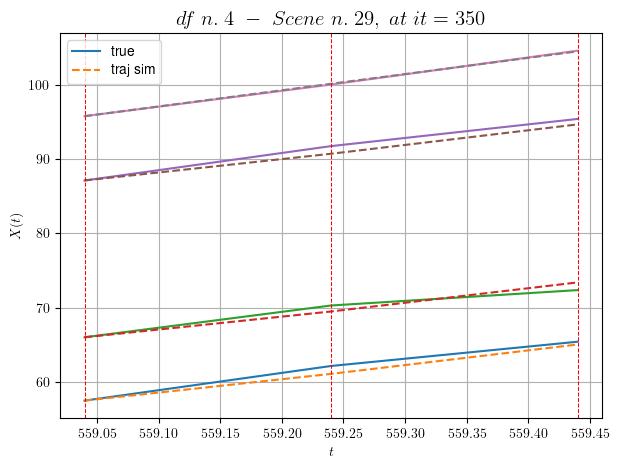

        For scene 29/30
        * use LR_NN=0.0005 with err=5.844863571208522 at it=19
        * v0_scn_mean = 22.755439722429752
        * MAE = 0.379299240411523



For df=4 with 30 scenes, time taken:        396.34
------------------------------------------------------------
****************************************************************************************************
In df n.5/10 we have 14 scenes
****************************************************************************************************
            - Time interval n.0: [23.72, 23.92]
                * y_true: [21.79018354 24.07032953]
                * v_ann: [20.79743003845215, 19.009031295776367, 24.534843225110123]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.92, 24.12]
                * y_true: [25.91031727 27.52052784]
                * v_ann: [22.28333854675293, 22.0712833404541, 24.534843225110123]

-----------------

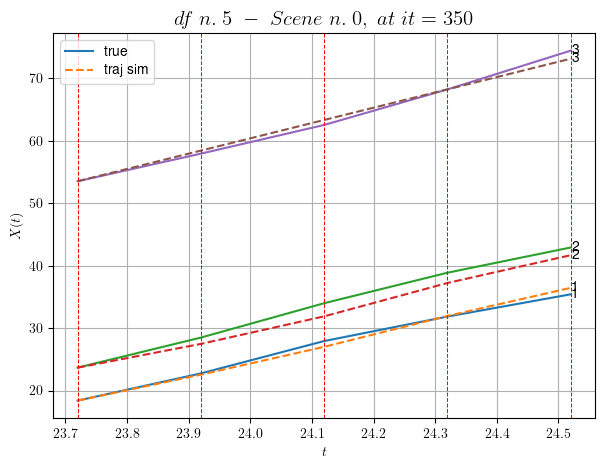

        For scene 0/14
        * use LR_NN=0.001 with err=19.44340869889344 at it=19
        * v0_scn_mean = 25.00324561146117
        * MAE = 0.5958247950974325



            - Time interval n.0: [28.12, 28.32]
                * y_true: [22.39001619 28.9506918 ]
                * v_ann: [28.30097198486328, 27.423534393310547, 25.379417180280814]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [28.32, 28.52]
                * y_true: [21.14004613 26.65085251]
                * v_ann: [26.450979232788086, 25.527130126953125, 25.379417180280814]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [28.52, 28.72]
                * y_true: [24.23010561 33.45140848]
                * v_ann: [24.66596221923828, 23.836681365966797, 25.379417180280814]

--------------------------------------------------------------------------

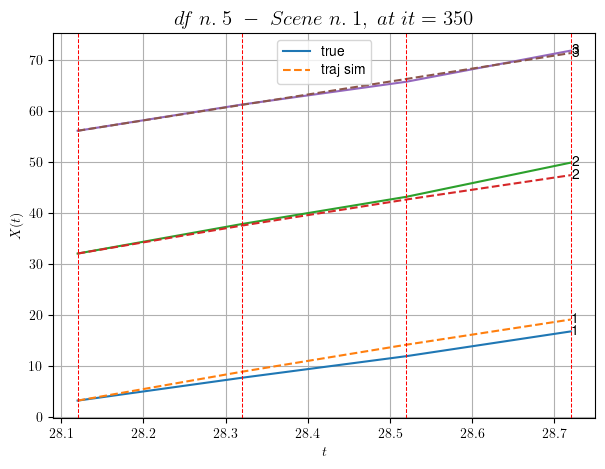

        For scene 1/14
        * use LR_NN=0.0005 with err=5.0099079950010745 at it=19
        * v0_scn_mean = 25.77543363657596
        * MAE = 1.5657321265017352



            - Time interval n.0: [146.52, 146.72]
                * y_true: [32.70054419 14.69037585]
                * v_ann: [24.818599700927734, 24.83711814880371, 33.247161814507386]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [146.72, 146.92]
                * y_true: [35.65090038 15.01046474]
                * v_ann: [24.45138931274414, 24.36065101623535, 33.247161814507386]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [146.92, 147.12]
                * y_true: [28.09191726 21.83491468]
                * v_ann: [24.731910705566406, 24.768774032592773, 33.247161814507386]

-------------------------------------------------------------------

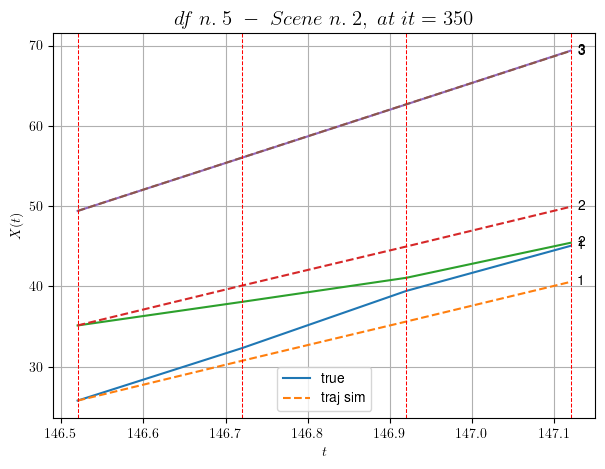

        For scene 2/14
        * use LR_NN=0.0005 with err=29.271829930298892 at it=19
        * v0_scn_mean = 32.968857201221304
        * MAE = 6.370029217956515



            - Time interval n.0: [151.12, 151.32]
                * y_true: [20.88055844 29.97204611]
                * v_ann: [27.668289184570312, 27.037912368774414, 31.51612778259406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [151.32, 151.52]
                * y_true: [26.72089495 29.6522691 ]
                * v_ann: [26.36759376525879, 26.071189880371094, 31.51612778259406]

----------------------------------------------------------------------------------------------------
            * err= 0.6582018165787562
            * Learning rate NN = 0.00036449998151510954
            * diff = 6.585102496559081e-05


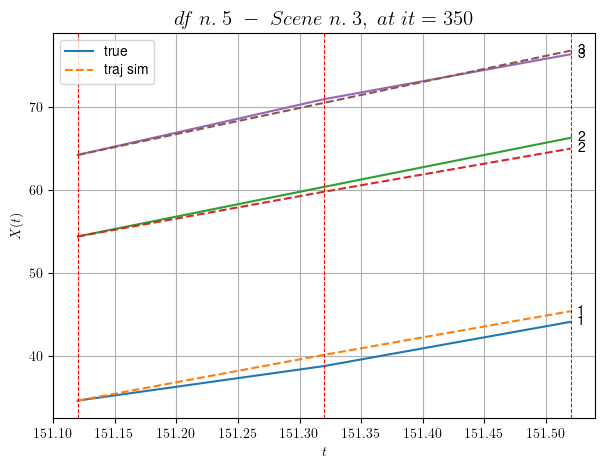

        For scene 3/14
        * use LR_NN=0.0005 with err=5.758800791203869 at it=19
        * v0_scn_mean = 31.38618496473311
        * MAE = 0.6582018165787562



            - Time interval n.0: [177.32, 177.52]
                * y_true: [23.78017477 21.57540501]
                * v_ann: [27.797222137451172, 28.29766082763672, 26.18040598473072]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [177.52, 177.72]
                * y_true: [28.99044664 21.37044807]
                * v_ann: [25.513736724853516, 25.598360061645508, 26.18040598473072]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [177.72, 177.92]
                * y_true: [30.9005134  20.55062028]
                * v_ann: [25.35320472717285, 25.421842575073242, 26.18040598473072]

----------------------------------------------------------------------

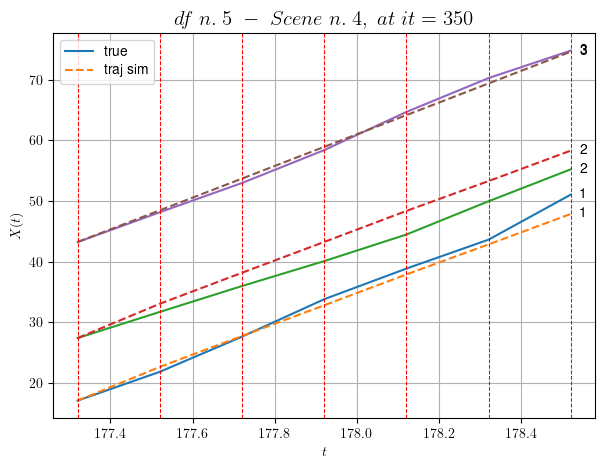

        For scene 4/14
        * use LR_NN=0.001 with err=35.99098469421517 at it=19
        * v0_scn_mean = 26.507772065035116
        * MAE = 2.7843252409741965



            - Time interval n.0: [266.92, 267.12]
                * y_true: [18.75024149 31.34179995]
                * v_ann: [31.070419311523438, 29.847698211669922, 29.085708232493797]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [267.12, 267.32]
                * y_true: [26.80047756 43.40316595]
                * v_ann: [30.019115447998047, 29.11721420288086, 29.085708232493797]

----------------------------------------------------------------------------------------------------
            * err= 2.918457772994589
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0008220041202600115


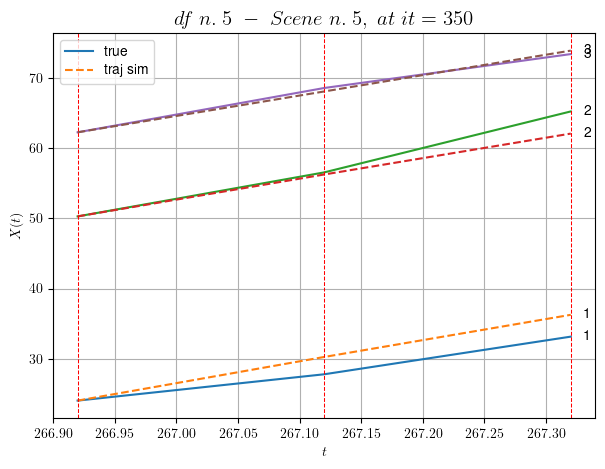

        For scene 5/14
        * use LR_NN=0.0001 with err=13.2753055514929 at it=19
        * v0_scn_mean = 29.164069469574116
        * MAE = 2.918457772994589



            - Time interval n.0: [316.92, 317.12]
                * y_true: [22.23560763 28.12633872]
                * v_ann: [25.239084243774414, 25.167970657348633, 22.34210119630189]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.12, 317.32]
                * y_true: [22.67586827 27.74684297]
                * v_ann: [25.2086238861084, 25.174612045288086, 22.34210119630189]

----------------------------------------------------------------------------------------------------
            * err= 0.35312023938466003
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00022853664681155017


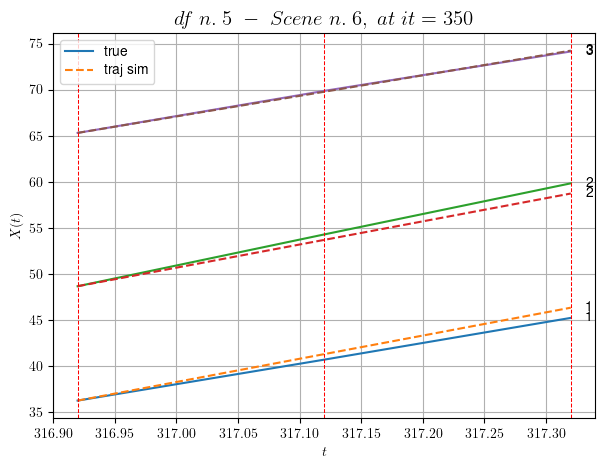

        For scene 6/14
        * use LR_NN=0.0005 with err=1.3466389528120593 at it=19
        * v0_scn_mean = 22.99843700181229
        * MAE = 0.35312023938466003



        For scene 7/14
        * use LR_NN=0.001 with err=8.195077046139165 at it=19
        * v0_scn_mean = 27.555695130783338
        * MAE = 0.03163436540061177



        For scene 8/14
        * use LR_NN=5e-05 with err=1.8713883320684739 at it=19
        * v0_scn_mean = 34.514893662539684
        * MAE = 0.006000754345427839



            - Time interval n.0: [338.52, 338.72]
                * y_true: [22.83038671 20.44060351]
                * v_ann: [23.94913101196289, 23.97880744934082, 27.853943933248797]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [338.72, 338.92]
                * y_true: [25.85061095 23.65082523]
                * v_ann: [23.47209358215332, 23.55126953125, 27.853943933248797]

------------------------

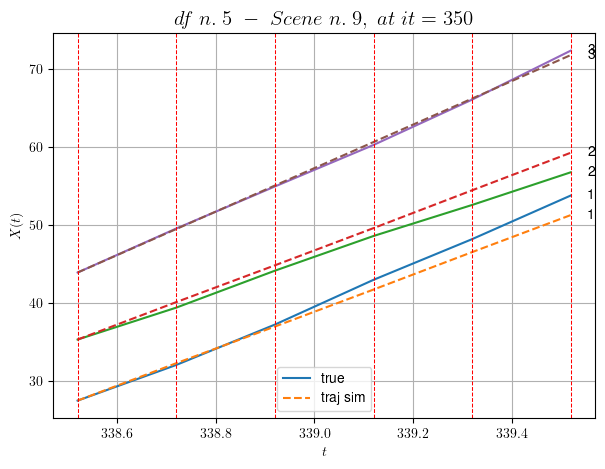

        For scene 9/14
        * use LR_NN=0.0005 with err=12.821213719258454 at it=19
        * v0_scn_mean = 28.037876036995176
        * MAE = 1.231470565492519



            - Time interval n.0: [435.72, 435.92]
                * y_true: [16.6003121  32.10080247]
                * v_ann: [20.646635055541992, 18.959850311279297, 23.002320042478413]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [435.92, 436.12]
                * y_true: [17.55040576 22.4007406 ]
                * v_ann: [21.115816116333008, 20.223487854003906, 23.002320042478413]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [436.12, 436.32]
                * y_true: [16.72550921 26.8011085 ]
                * v_ann: [20.90894317626953, 20.04387855529785, 23.002320042478413]

------------------------------------------------------------------

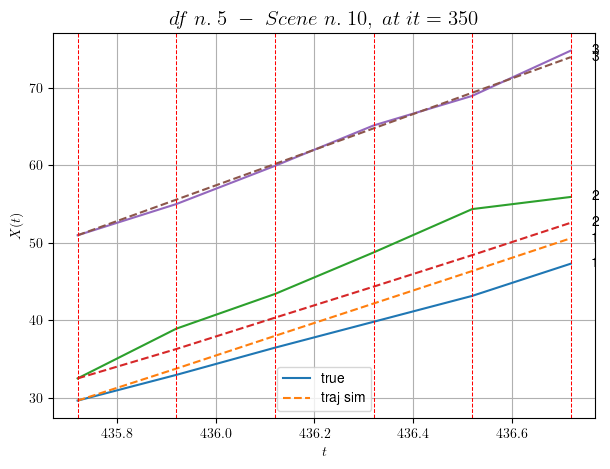

        For scene 10/14
        * use LR_NN=0.0005 with err=15.39648491552488 at it=19
        * v0_scn_mean = 23.602070447825245
        * MAE = 6.284528046213668



            - Time interval n.0: [565.12, 565.32]
                * y_true: [12.82514463 16.9507403 ]
                * v_ann: [16.172605514526367, 16.073081970214844, 20.750380470950947]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [565.32, 565.52]
                * y_true: [14.2510345  19.19106683]
                * v_ann: [15.498453140258789, 15.452722549438477, 20.750380470950947]

----------------------------------------------------------------------------------------------------
            * err= 0.24263376388277205
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0005482745483962326


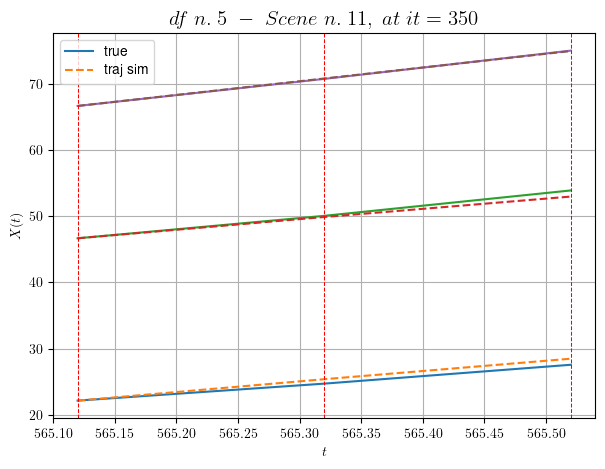

        For scene 11/14
        * use LR_NN=0.0005 with err=2.550610888891597 at it=19
        * v0_scn_mean = 21.543137941359785
        * MAE = 0.2142292408860634



        For scene 12/14
        * use LR_NN=5e-05 with err=3.627296596030018 at it=19
        * v0_scn_mean = 21.768162114369044
        * MAE = 0.09421355768435585



        For scene 13/14
        * use LR_NN=0.001 with err=6.80251303774229 at it=19
        * v0_scn_mean = 26.653774489439495
        * MAE = 0.7819533244166292



For df=5 with 14 scenes, time taken:        133.79
------------------------------------------------------------
****************************************************************************************************
In df n.6/10 we have 3 scenes
****************************************************************************************************
            - Time interval n.0: [552.20, 552.40]
                * y_true: [14.01030513 13.18063102]
                * v_ann: [17.832008361816406, 18.336

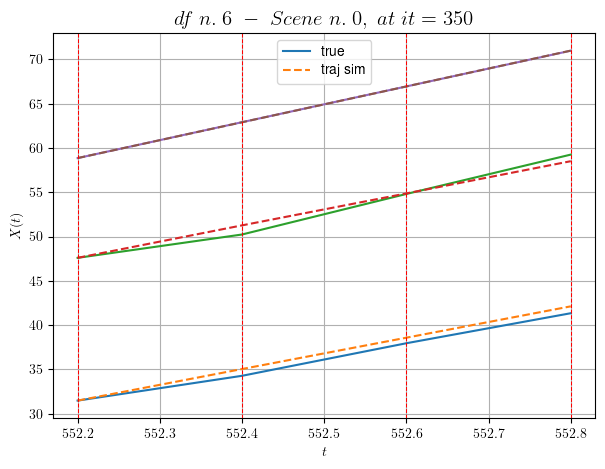

        For scene 0/3
        * use LR_NN=5e-05 with err=5.8075361777528896 at it=19
        * v0_scn_mean = 21.070352607678007
        * MAE = 0.25036854888859067



            - Time interval n.0: [553.00, 553.20]
                * y_true: [23.0804555  19.17546127 18.9008181 ]
                * v_ann: [19.569377899169922, 19.55061149597168, 19.52875328063965, 23.749701248855363]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [553.20, 553.40]
                * y_true: [22.02058024 17.45053567 16.85079909]
                * v_ann: [19.626556396484375, 19.614744186401367, 19.601497650146484, 23.749701248855363]

----------------------------------------------------------------------------------------------------
            * err= 0.25791026995583316
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00025565514845166115


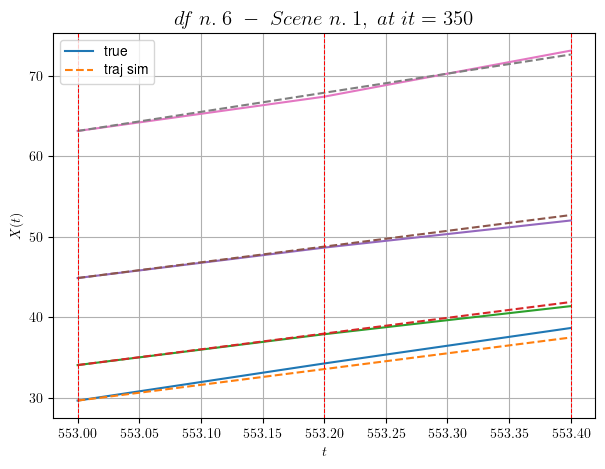

        For scene 1/3
        * use LR_NN=0.0001 with err=6.12257987283601 at it=19
        * v0_scn_mean = 24.463114680461086
        * MAE = 0.2254607540567593



            - Time interval n.0: [554.00, 554.20]
                * y_true: [20.50061186 21.35116733 22.20133365]
                * v_ann: [21.943166732788086, 21.900951385498047, 21.92542266845703, 23.647953726265413]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.20, 554.40]
                * y_true: [18.86075328 25.85180384 21.5614577 ]
                * v_ann: [21.49713706970215, 21.5396671295166, 21.51578140258789, 23.647953726265413]

----------------------------------------------------------------------------------------------------
            * err= 0.1280352242709663
            * Learning rate NN = 0.0007289999630302191
            * diff = 3.300779032489043e-06


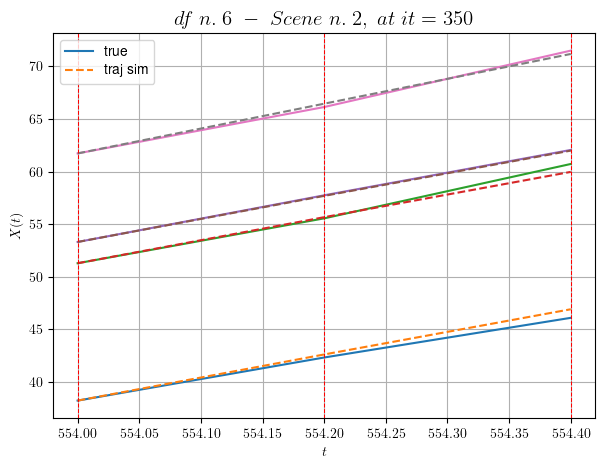

        For scene 2/3
        * use LR_NN=0.001 with err=7.4688144361795015 at it=19
        * v0_scn_mean = 24.372980690622708
        * MAE = 0.12696969649033457



For df=6 with 3 scenes, time taken:        24.54
------------------------------------------------------------
****************************************************************************************************
In df n.7/10 we have 8 scenes
****************************************************************************************************
            - Time interval n.0: [38.56, 38.76]
                * y_true: [34.50899027 34.29923068]
                * v_ann: [31.060169219970703, 31.74642562866211, 28.990017888098876]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.76, 38.96]
                * y_true: [33.76780394 27.40980382]
                * v_ann: [33.245506286621094, 33.87731170654297, 28.990017888098876]

------------------

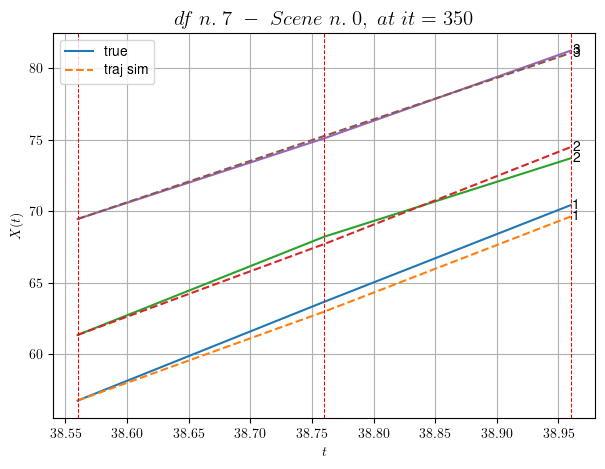

        For scene 0/8
        * use LR_NN=0.001 with err=3.7042486106685337 at it=19
        * v0_scn_mean = 29.0765804609348
        * MAE = 0.22207648459368778



        For scene 1/8
        * use LR_NN=5e-05 with err=28.327188227866042 at it=19
        * v0_scn_mean = 28.857616168683286
        * MAE = 0.3417964952336235



            - Time interval n.0: [45.96, 46.16]
                * y_true: [25.63954073 32.24792255]
                * v_ann: [28.33566665649414, 28.299232482910156, 21.679426419577293]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [46.16, 46.36]
                * y_true: [27.5623729  28.76269973]
                * v_ann: [28.874204635620117, 28.68825912475586, 21.679426419577293]

----------------------------------------------------------------------------------------------------
            * err= 0.24681777649947043
            * Learning rate NN = 0.00036449998151510954


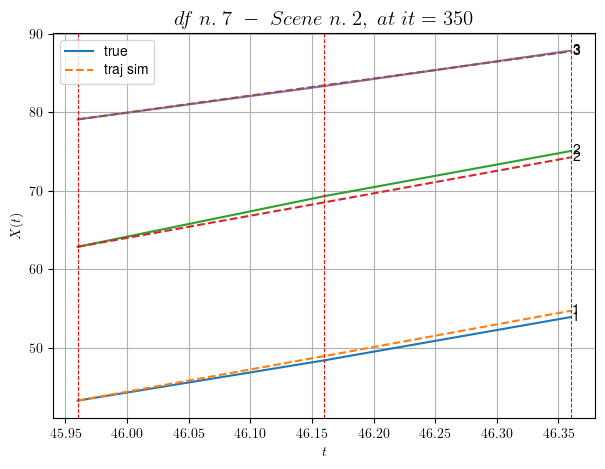

        For scene 2/8
        * use LR_NN=0.0005 with err=3.1100536998102015 at it=19
        * v0_scn_mean = 22.39255811577796
        * MAE = 0.24681777649947043



            - Time interval n.0: [162.76, 162.96]
                * y_true: [10.08699654 20.77195672]
                * v_ann: [17.476655960083008, 17.614782333374023, 33.51452922086696]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [162.96, 163.16]
                * y_true: [12.77745535 25.37230132]
                * v_ann: [17.05147933959961, 17.100723266601562, 33.51452922086696]

----------------------------------------------------------------------------------------------------
            * err= 1.5267810102028658
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0007679740072736863


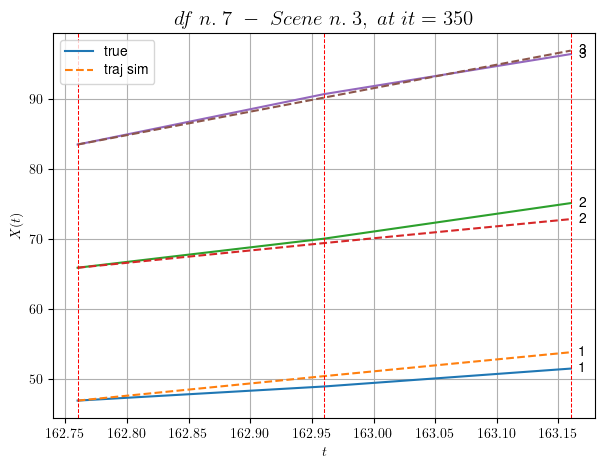

        For scene 3/8
        * use LR_NN=0.0001 with err=1.9424029703929264 at it=19
        * v0_scn_mean = 33.21330933976166
        * MAE = 1.488848276108522



            - Time interval n.0: [165.76, 165.96]
                * y_true: [14.62535373 14.97522028]
                * v_ann: [14.14257526397705, 14.487004280090332, 27.26222960772804]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [165.96, 166.16]
                * y_true: [14.90483904 10.97892299]
                * v_ann: [14.41775131225586, 14.6160888671875, 27.26222960772804]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.16, 166.36]
                * y_true: [13.82116599 15.66867879]
                * v_ann: [13.55479907989502, 13.72256088256836, 27.26222960772804]

---------------------------------------------------------------------------

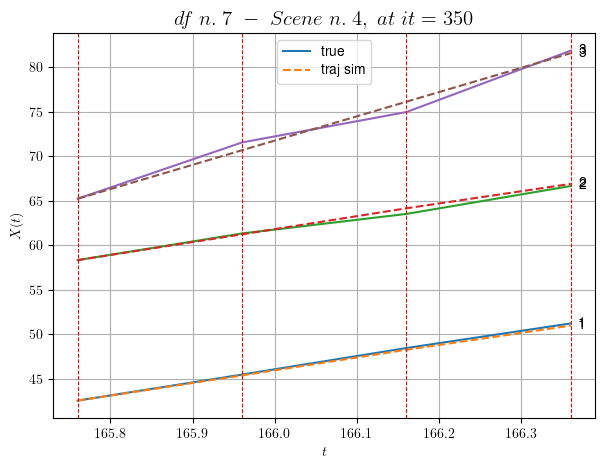

        For scene 4/8
        * use LR_NN=0.001 with err=1.4423883268349067 at it=19
        * v0_scn_mean = 27.49687579224644
        * MAE = 0.23131138433949996



            - Time interval n.0: [188.16, 188.36]
                * y_true: [18.26365072 21.2472937 ]
                * v_ann: [20.8835391998291, 21.098026275634766, 24.898645104742375]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [188.36, 188.56]
                * y_true: [19.58083161 26.63811802]
                * v_ann: [20.773984909057617, 20.953163146972656, 24.898645104742375]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [188.56, 188.76]
                * y_true: [19.1135942  21.22632097]
                * v_ann: [21.025205612182617, 21.244190216064453, 24.898645104742375]

-------------------------------------------------------------------

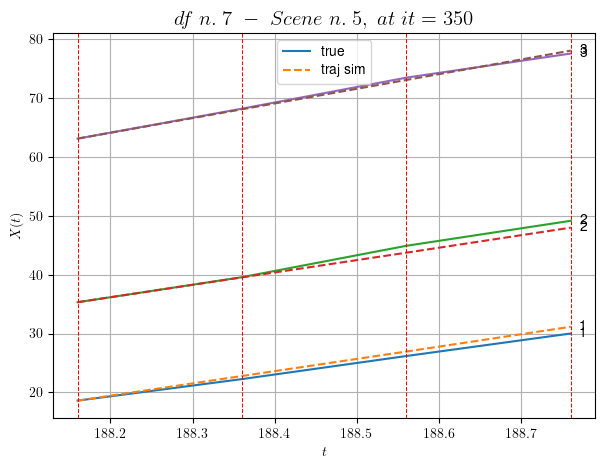

        For scene 5/8
        * use LR_NN=0.0001 with err=2.1560798396960337 at it=19
        * v0_scn_mean = 25.335867110438645
        * MAE = 0.363327667927343



            - Time interval n.0: [220.96, 221.16]
                * y_true: [27.25777683 27.84910592]
                * v_ann: [28.739328384399414, 29.227272033691406, 26.579870119515753]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [221.16, 221.36]
                * y_true: [24.9447965  32.01250046]
                * v_ann: [27.144920349121094, 26.829133987426758, 26.579870119515753]

----------------------------------------------------------------------------------------------------
            * err= 0.19560699533359038
            * Learning rate NN = 0.0007289999630302191
            * diff = 3.7909337743669003e-06


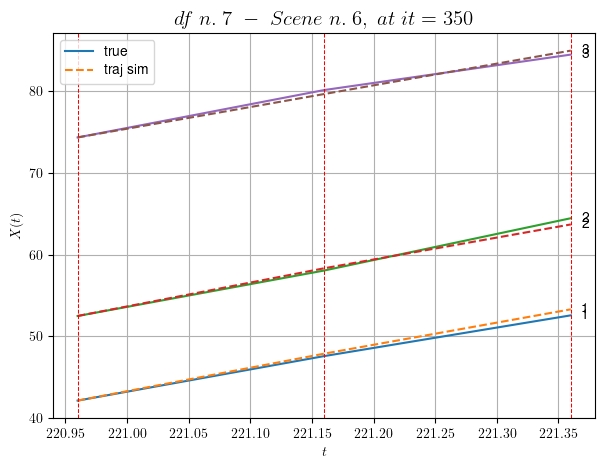

        For scene 6/8
        * use LR_NN=0.001 with err=3.073718789643824 at it=19
        * v0_scn_mean = 26.87299931299283
        * MAE = 0.1921957254973982



            - Time interval n.0: [166.56, 166.76]
                * y_true: [17.24164345 15.73752306 15.58083022]
                * v_ann: [18.029022216796875, 17.971296310424805, 17.996423721313477, 17.37043158542256]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [166.76, 166.96]
                * y_true: [18.38470966 27.72552812  9.3330177 ]
                * v_ann: [16.692100524902344, 17.089494705200195, 16.894025802612305, 17.37043158542256]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.96, 167.16]
                * y_true: [16.02323775 24.97208403 13.98221987]
                * v_ann: [17.853073120117188, 17.84807777404785, 17.850919723510

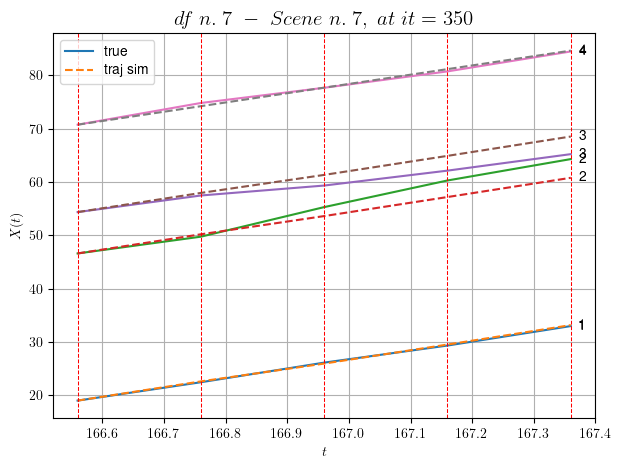

        For scene 7/8
        * use LR_NN=0.001 with err=26.194751849368185 at it=19
        * v0_scn_mean = 18.81197927795331
        * MAE = 2.4127179751119545



For df=7 with 8 scenes, time taken:        67.64
------------------------------------------------------------
****************************************************************************************************
In df n.8/10 we have 21 scenes
****************************************************************************************************
        For scene 0/21
        * use LR_NN=0.001 with err=18.16701131303655 at it=19
        * v0_scn_mean = 18.29000811679546
        * MAE = 1.5795717778803116



            - Time interval n.0: [50.24, 50.44]
                * y_true: [14.83043604 14.50055453]
                * v_ann: [18.068275451660156, 18.975391387939453, 30.157659834879066]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [50.44

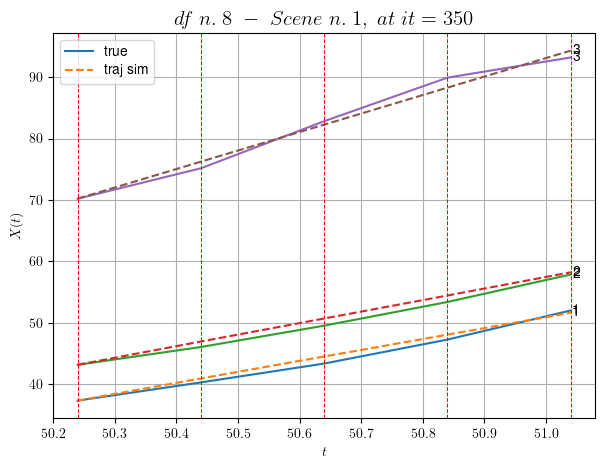

        For scene 1/21
        * use LR_NN=0.0001 with err=14.348800342951208 at it=19
        * v0_scn_mean = 30.144147277795916
        * MAE = 0.6918606071256278



            - Time interval n.0: [102.24, 102.44]
                * y_true: [22.78095819 15.94092959]
                * v_ann: [20.181676864624023, 20.242311477661133, 31.34828224079019]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [102.44, 102.64]
                * y_true: [23.36120187 12.10080168]
                * v_ann: [20.09499740600586, 20.356124877929688, 31.34828224079019]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [102.64, 102.84]
                * y_true: [20.51121756 22.37162153]
                * v_ann: [19.905803680419922, 20.274646759033203, 31.34828224079019]

-------------------------------------------------------------------

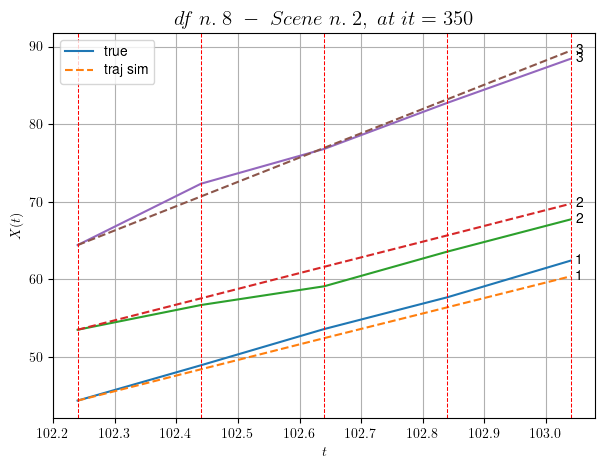

        For scene 2/21
        * use LR_NN=0.0001 with err=13.118916245062081 at it=19
        * v0_scn_mean = 31.232724966758735
        * MAE = 1.795316547558915



            - Time interval n.0: [108.84, 109.04]
                * y_true: [17.9810803  26.65193678]
                * v_ann: [20.825847625732422, 20.504470825195312, 20.549083403843422]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.04, 109.24]
                * y_true: [14.30252156 22.9019425 ]
                * v_ann: [21.64151382446289, 21.545238494873047, 20.549083403843422]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.24, 109.44]
                * y_true: [21.24158827 21.25204953]
                * v_ann: [19.97014808654785, 19.768665313720703, 20.549083403843422]

------------------------------------------------------------------

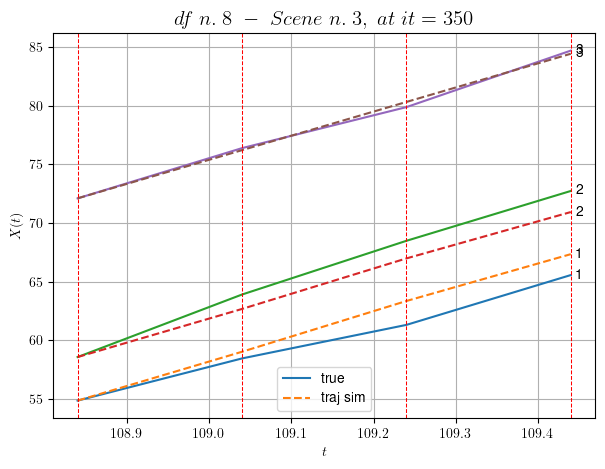

        For scene 3/21
        * use LR_NN=0.001 with err=6.339019265211557 at it=19
        * v0_scn_mean = 21.359093449151494
        * MAE = 1.2450306835170102



        For scene 4/21
        * use LR_NN=0.0001 with err=10.131658449392411 at it=19
        * v0_scn_mean = 40.08013629578427
        * MAE = 0.06905759696514864



            - Time interval n.0: [215.24, 215.44]
                * y_true: [ 1.34614625 10.42531549]
                * v_ann: [19.632244110107422, 20.894010543823242, 15.10079727046582]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.44, 215.64]
                * y_true: [18.28906766 10.32533879]
                * v_ann: [14.905900955200195, 13.293567657470703, 15.10079727046582]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.64, 215.84]
                * y_true: [29.02100933

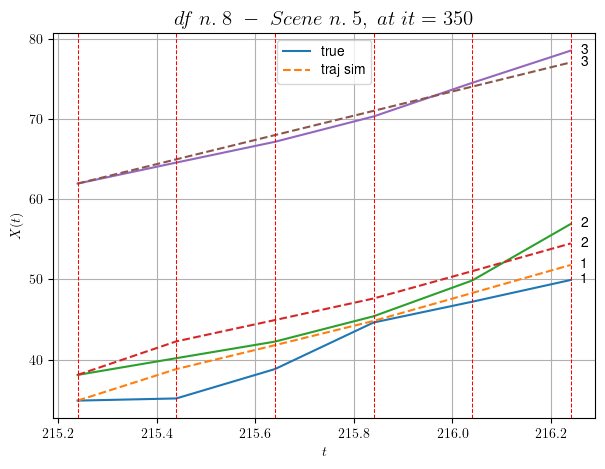

        For scene 5/21
        * use LR_NN=0.001 with err=40.65590010042042 at it=19
        * v0_scn_mean = 16.377763769452052
        * MAE = 3.028032928761489



            - Time interval n.0: [222.64, 222.84]
                * y_true: [3.4148313  7.54419185]
                * v_ann: [5.450466632843018, 5.684472560882568, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [222.84, 223.04]
                * y_true: [1.34614625 9.61287691]
                * v_ann: [5.71796178817749, 5.664350986480713, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.04, 223.24]
                * y_true: [ 1.34614625 10.20300693]
                * v_ann: [5.6792073249816895, 5.623630523681641, 12.428665091344943]

----------------------------------------------------------------------------

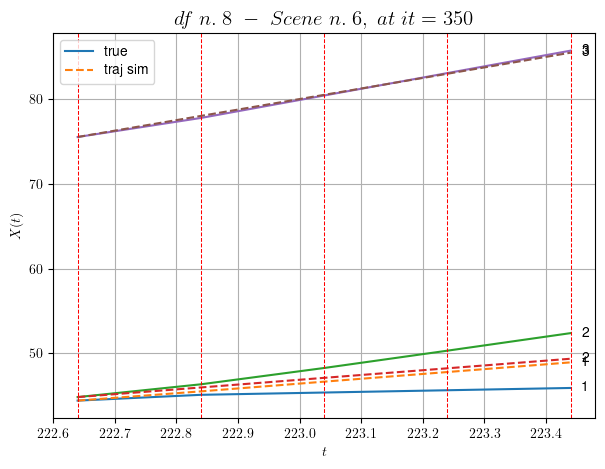

        For scene 6/21
        * use LR_NN=0.0005 with err=25.22000810112819 at it=19
        * v0_scn_mean = 13.934652118177096
        * MAE = 2.036512864622349



            - Time interval n.0: [225.24, 225.44]
                * y_true: [9.85023046 1.34614625]
                * v_ann: [9.904397964477539, 9.829791069030762, 13.143805199617319]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.44, 225.64]
                * y_true: [11.30531094  1.34614625]
                * v_ann: [8.635886192321777, 8.329422950744629, 13.143805199617319]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.64, 225.84]
                * y_true: [12.27536459  1.34614625]
                * v_ann: [8.086935043334961, 7.591662406921387, 13.143805199617319]

-------------------------------------------------------------------------

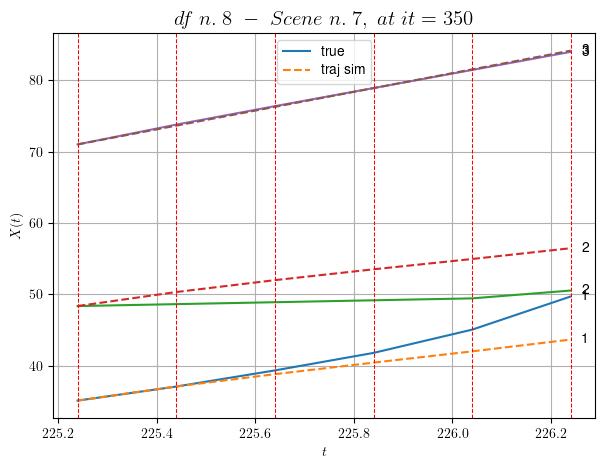

        For scene 7/21
        * use LR_NN=0.001 with err=52.4297696636282 at it=19
        * v0_scn_mean = 14.588499687719558
        * MAE = 7.588547044803232



            - Time interval n.0: [227.04, 227.24]
                * y_true: [ 1.34614625 11.86069537]
                * v_ann: [7.162720680236816, 7.802738666534424, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [227.24, 227.44]
                * y_true: [ 1.34614625 11.90074479]
                * v_ann: [6.94191312789917, 7.518592357635498, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.44, 227.64]
                * y_true: [ 1.34614625 14.03099458]
                * v_ann: [6.808216094970703, 7.46502161026001, 26.24318261171468]

------------------------------------------------------------------------------

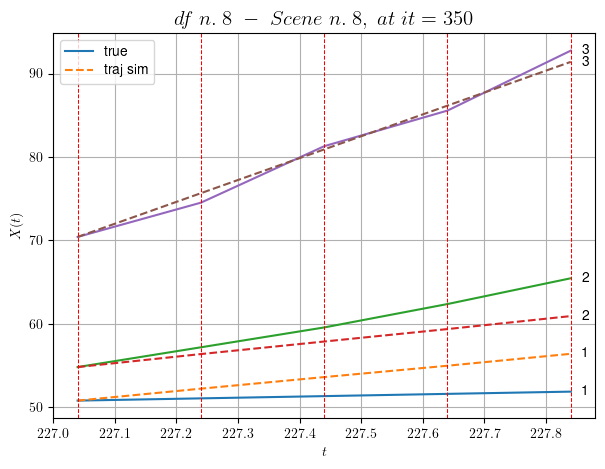

        For scene 8/21
        * use LR_NN=0.001 with err=2.9460411620356246 at it=19
        * v0_scn_mean = 26.56516829341416
        * MAE = 5.010904036124747



            - Time interval n.0: [237.64, 237.84]
                * y_true: [17.80043487 10.22573725]
                * v_ann: [15.716849327087402, 15.414022445678711, 29.702969638681846]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.84, 238.04]
                * y_true: [20.29063338 11.60088234]
                * v_ann: [14.28746509552002, 14.40438175201416, 29.702969638681846]

----------------------------------------------------------------------------------------------------
            * err= 0.7376493114258468
            * Learning rate NN = 0.0007289999630302191
            * diff = 7.383456858800486e-06


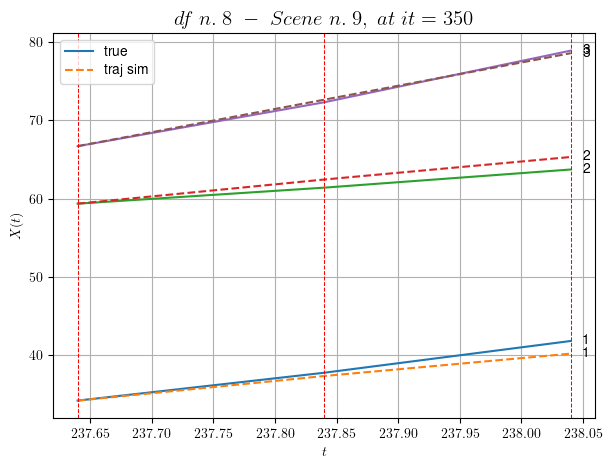

        For scene 9/21
        * use LR_NN=0.001 with err=0.43446965288364153 at it=19
        * v0_scn_mean = 29.728427230438378
        * MAE = 0.4057780426805218



        For scene 10/21
        * use LR_NN=0.0005 with err=4.235236383575253 at it=19
        * v0_scn_mean = 30.114128375535604
        * MAE = 0.058895304463964876



            - Time interval n.0: [243.44, 243.64]
                * y_true: [18.26109982  7.28715228]
                * v_ann: [13.8164701461792, 13.524211883544922, 16.743010063526963]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [243.64, 243.84]
                * y_true: [23.05153691  9.06731774]
                * v_ann: [13.601067543029785, 13.113937377929688, 16.743010063526963]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [243.84, 244.04]
                * y_true: [10.5233

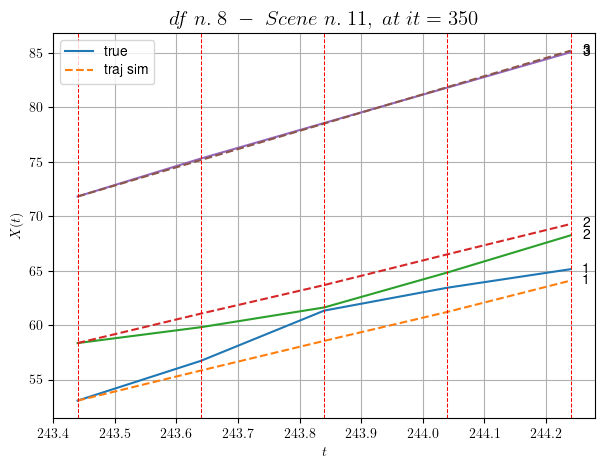

        For scene 11/21
        * use LR_NN=0.001 with err=26.08110377750309 at it=19
        * v0_scn_mean = 17.879227372169584
        * MAE = 1.6050653438870492



            - Time interval n.0: [251.64, 251.84]
                * y_true: [14.32016282 17.2315068 ]
                * v_ann: [13.413105010986328, 15.582756042480469, 19.824979611544876]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [251.84, 252.04]
                * y_true: [20.34029568 17.65159646]
                * v_ann: [14.873981475830078, 15.977401733398438, 19.824979611544876]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [252.04, 252.24]
                * y_true: [20.93040622 16.61174803]
                * v_ann: [18.211137771606445, 17.134140014648438, 19.824979611544876]

----------------------------------------------------------------

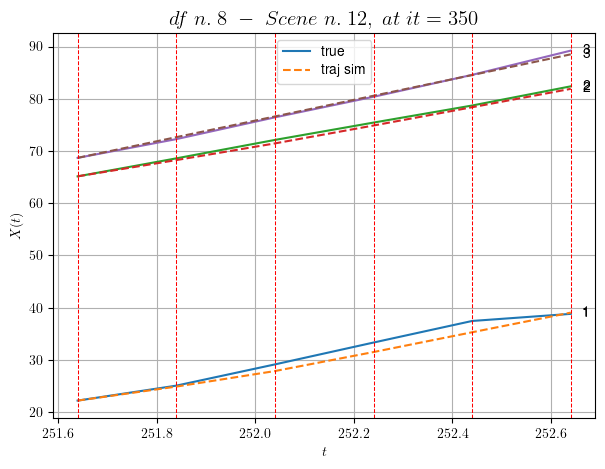

        For scene 12/21
        * use LR_NN=0.001 with err=36.04151944971287 at it=19
        * v0_scn_mean = 20.69705044636904
        * MAE = 0.6457215635699043



            - Time interval n.0: [290.84, 291.04]
                * y_true: [10.67508652 21.71084933]
                * v_ann: [16.326229095458984, 17.60530662536621, 25.378277675805226]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [291.04, 291.24]
                * y_true: [ 9.47510968 18.71084105]
                * v_ann: [15.715596199035645, 16.62525177001953, 25.378277675805226]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [291.24, 291.44]
                * y_true: [ 9.47510968 24.76138307]
                * v_ann: [13.741147994995117, 14.319968223571777, 25.378277675805226]

-------------------------------------------------------------------

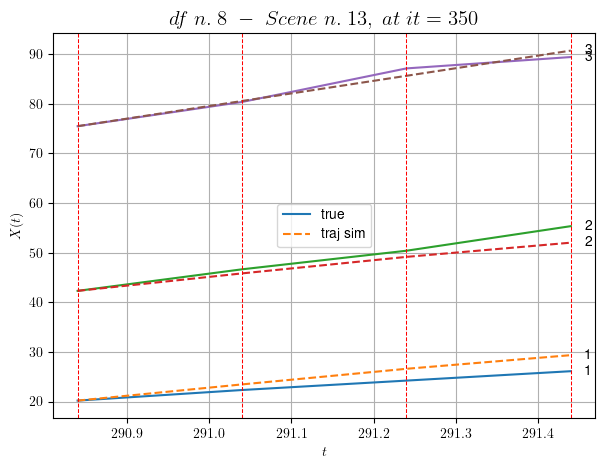

        For scene 13/21
        * use LR_NN=0.001 with err=2.2584470025662395 at it=19
        * v0_scn_mean = 25.77439179565114
        * MAE = 2.858433037308508



            - Time interval n.0: [350.64, 350.84]
                * y_true: [14.24956692  9.34769854]
                * v_ann: [15.784603118896484, 16.52347183227539, 24.0175992597937]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [350.84, 351.04]
                * y_true: [ 4.06677119 24.77080184]
                * v_ann: [15.625553131103516, 16.424846649169922, 24.0175992597937]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [351.04, 351.24]
                * y_true: [15.46321179 18.97073364]
                * v_ann: [15.694074630737305, 16.29877281188965, 24.0175992597937]

-------------------------------------------------------------------------

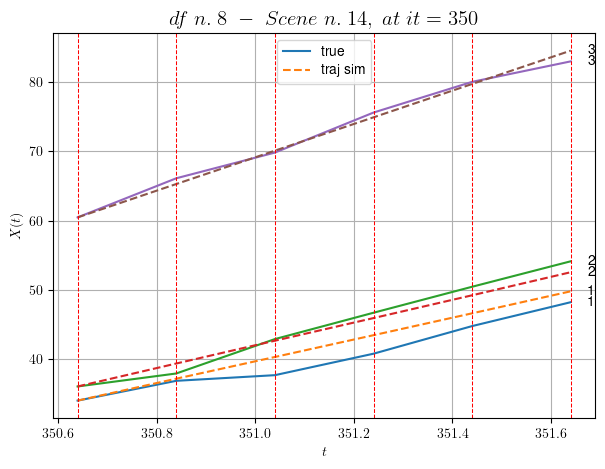

        For scene 14/21
        * use LR_NN=0.0001 with err=17.316392187071447 at it=19
        * v0_scn_mean = 24.53033309310227
        * MAE = 1.6832562751392786



            - Time interval n.0: [368.84, 369.04]
                * y_true: [17.45059381  8.87536169]
                * v_ann: [14.300031661987305, 13.006009101867676, 17.012105849841017]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.04, 369.24]
                * y_true: [23.11801305  8.05829994]
                * v_ann: [14.292251586914062, 12.817272186279297, 17.012105849841017]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.24, 369.44]
                * y_true: [ 6.12528304 15.69072344]
                * v_ann: [11.203667640686035, 13.597108840942383, 17.012105849841017]

---------------------------------------------------------------

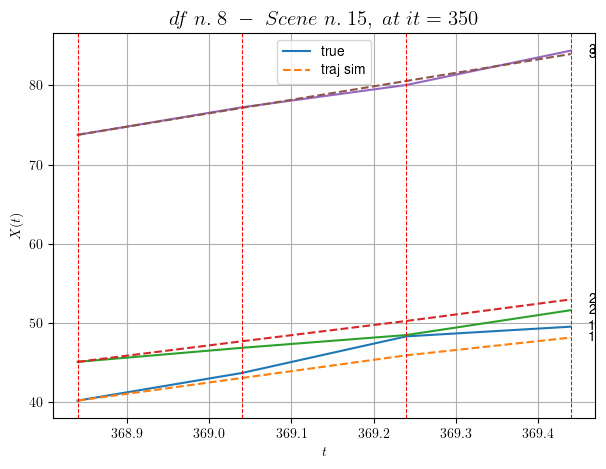

        For scene 15/21
        * use LR_NN=0.0005 with err=19.48364380475655 at it=19
        * v0_scn_mean = 18.12525975634212
        * MAE = 1.1777808569334582



            - Time interval n.0: [414.44, 414.64]
                * y_true: [25.58017481 23.93124381]
                * v_ann: [22.00704574584961, 21.50175666809082, 14.740338902151922]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.64, 414.84]
                * y_true: [28.7103211   9.12051681]
                * v_ann: [22.278371810913086, 21.576948165893555, 14.740338902151922]

----------------------------------------------------------------------------------------------------
            * err= 1.0053653233340796
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00018641219673920517


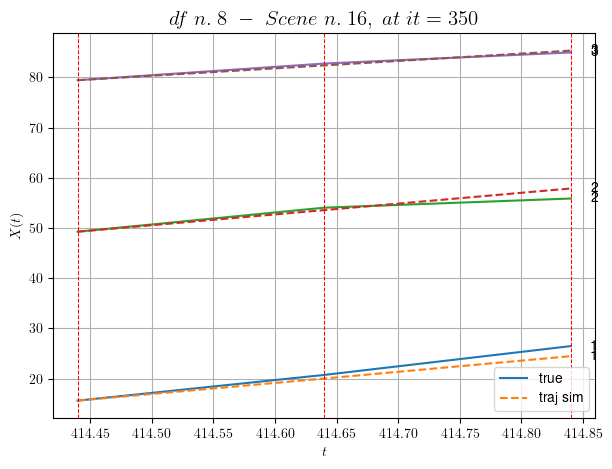

        For scene 16/21
        * use LR_NN=5e-05 with err=6.072603490378711 at it=19
        * v0_scn_mean = 16.048199219348838
        * MAE = 1.0053653233340796



            - Time interval n.0: [477.84, 478.04]
                * y_true: [17.90015387 15.74042221]
                * v_ann: [18.914369583129883, 19.02136993408203, 21.268222396992396]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [478.04, 478.24]
                * y_true: [18.02021575 17.32056356]
                * v_ann: [18.311981201171875, 18.182022094726562, 21.268222396992396]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [478.24, 478.44]
                * y_true: [20.95033635 22.3908747 ]
                * v_ann: [18.16026496887207, 17.964448928833008, 21.268222396992396]

------------------------------------------------------------------

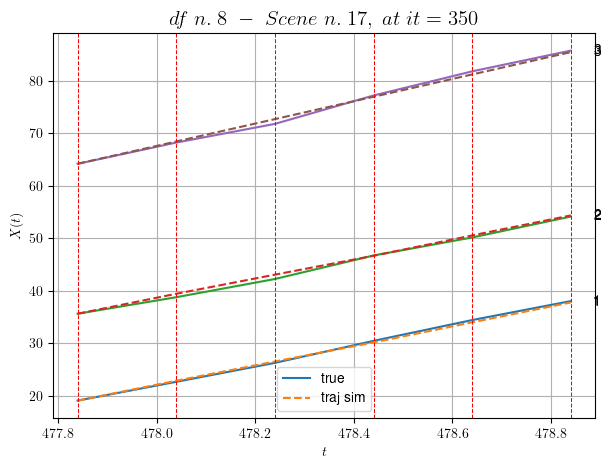

        For scene 17/21
        * use LR_NN=0.0005 with err=15.647191680285749 at it=19
        * v0_scn_mean = 22.016597171001827
        * MAE = 0.16664135917729048



            - Time interval n.0: [522.64, 522.84]
                * y_true: [ 6.78505349 16.71042372]
                * v_ann: [13.570564270019531, 13.923514366149902, 25.1560078847199]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [522.84, 523.04]
                * y_true: [ 7.85007105 23.28071684]
                * v_ann: [13.431187629699707, 13.702947616577148, 25.1560078847199]

----------------------------------------------------------------------------------------------------
            * err= 1.6511333543788254
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.001479093251777197


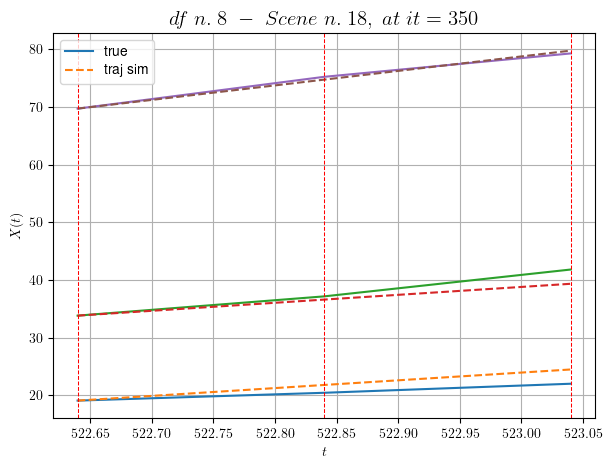

        For scene 18/21
        * use LR_NN=0.0001 with err=0.8880333315878918 at it=19
        * v0_scn_mean = 25.571172089468103
        * MAE = 1.6511333543788254



        For scene 19/21
        * use LR_NN=0.001 with err=30.886879768224272 at it=19
        * v0_scn_mean = 21.375739761490316
        * MAE = 4.514897304223357



            - Time interval n.0: [256.44, 256.64]
                * y_true: [ 7.48303167 10.07767618 21.73093279]
                * v_ann: [11.652874946594238, 14.320024490356445, 15.442960739135742, 17.10609187367722]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [256.64, 256.84]
                * y_true: [13.09283525 13.17831107 21.42106847]
                * v_ann: [16.29656219482422, 16.246864318847656, 15.242761611938477, 17.10609187367722]

----------------------------------------------------------------------------------------------------
            - Time inte

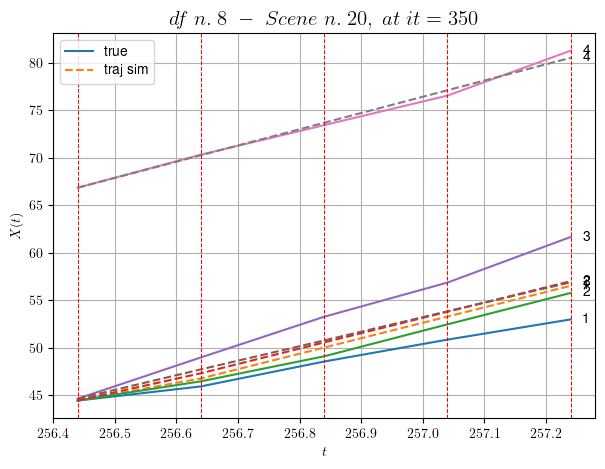

        For scene 20/21
        * use LR_NN=0.0005 with err=17.995880267371657 at it=19
        * v0_scn_mean = 18.57781148412372
        * MAE = 3.3843075381759284



For df=8 with 21 scenes, time taken:        237.99
------------------------------------------------------------
****************************************************************************************************
In df n.9/10 we have 9 scenes
****************************************************************************************************
        For scene 0/9
        * use LR_NN=0.0005 with err=34.91090550111759 at it=19
        * v0_scn_mean = 29.176159823438702
        * MAE = 1.64746709652319



        For scene 1/9
        * use LR_NN=0.001 with err=15.998523453079024 at it=19
        * v0_scn_mean = 32.45999098978225
        * MAE = 0.15070864454834754



            - Time interval n.0: [37.80, 38.00]
                * y_true: [21.35828745 27.25004814]
                * v_ann: [22.80927848815918, 22.5837974548

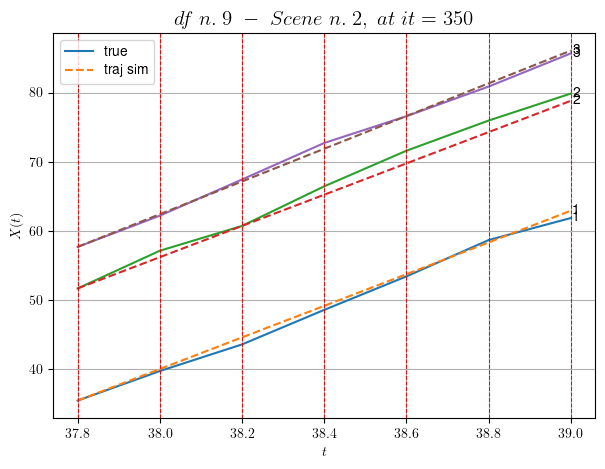

        For scene 2/9
        * use LR_NN=5e-05 with err=47.67538841446633 at it=19
        * v0_scn_mean = 24.184271169635437
        * MAE = 0.5446246961420051



            - Time interval n.0: [44.40, 44.60]
                * y_true: [24.95803839 22.94664651]
                * v_ann: [25.866596221923828, 26.083477020263672, 18.016193314109223]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [44.60, 44.80]
                * y_true: [22.38974011 30.85088397]
                * v_ann: [24.725759506225586, 24.315019607543945, 18.016193314109223]

----------------------------------------------------------------------------------------------------
            * err= 0.1591359486071062
            * Learning rate NN = 0.00036449998151510954
            * diff = 1.2336728280493148e-05


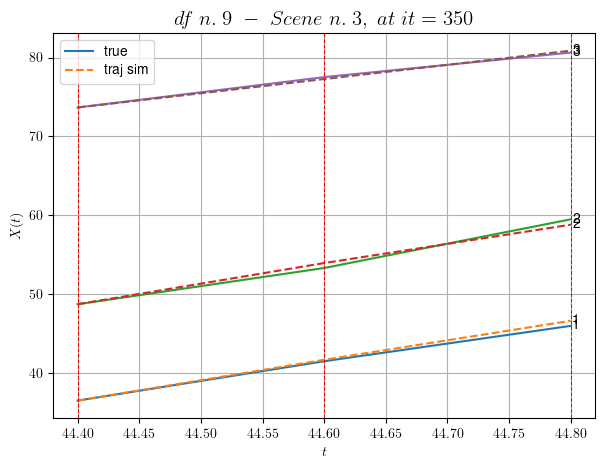

        For scene 3/9
        * use LR_NN=0.0005 with err=5.696592801714421 at it=19
        * v0_scn_mean = 19.043289860549024
        * MAE = 0.158450034452764



            - Time interval n.0: [117.80, 118.00]
                * y_true: [26.21501314 26.51617559]
                * v_ann: [25.91661834716797, 25.664236068725586, 32.947804333007745]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [118.00, 118.20]
                * y_true: [24.27291409 32.45579962]
                * v_ann: [25.94540786743164, 25.69896125793457, 32.947804333007745]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [118.20, 118.40]
                * y_true: [21.96072195 23.86482679]
                * v_ann: [26.06397819519043, 25.948488235473633, 32.947804333007745]

----------------------------------------------------------------------

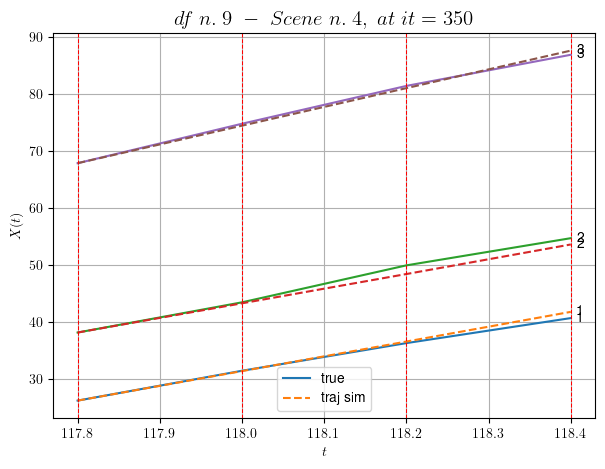

        For scene 4/9
        * use LR_NN=5e-05 with err=7.436587004939271 at it=19
        * v0_scn_mean = 32.69515676205062
        * MAE = 0.4391524786974819



            - Time interval n.0: [119.20, 119.40]
                * y_true: [23.20444186 22.52067771]
                * v_ann: [25.888498306274414, 25.534395217895508, 26.734613425844117]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [119.40, 119.60]
                * y_true: [27.39348249 26.5570173 ]
                * v_ann: [24.107690811157227, 24.006906509399414, 26.734613425844117]

----------------------------------------------------------------------------------------------------
            * err= 0.07614989254111752
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.092769189584621e-05


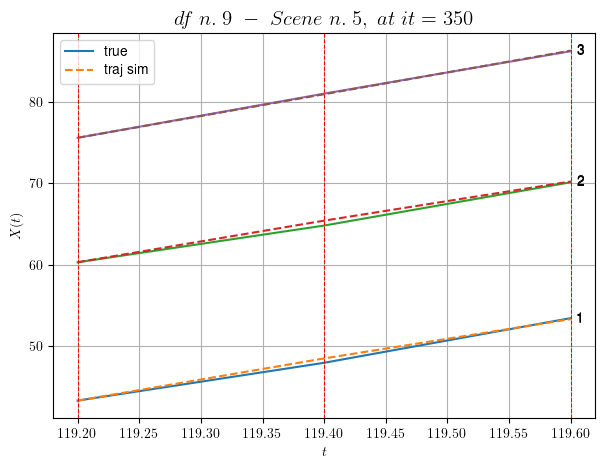

        For scene 5/9
        * use LR_NN=0.0005 with err=0.342848507417477 at it=19
        * v0_scn_mean = 27.014480029254482
        * MAE = 0.07614989254111752



            - Time interval n.0: [120.20, 120.40]
                * y_true: [30.48045094 26.16776015]
                * v_ann: [26.406023025512695, 27.17797088623047, 27.349006463343958]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [120.40, 120.60]
                * y_true: [26.23623075 25.12734403]
                * v_ann: [26.655054092407227, 27.58773422241211, 27.349006463343958]

----------------------------------------------------------------------------------------------------
            * err= 0.22248618291968414
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0009406618480489459


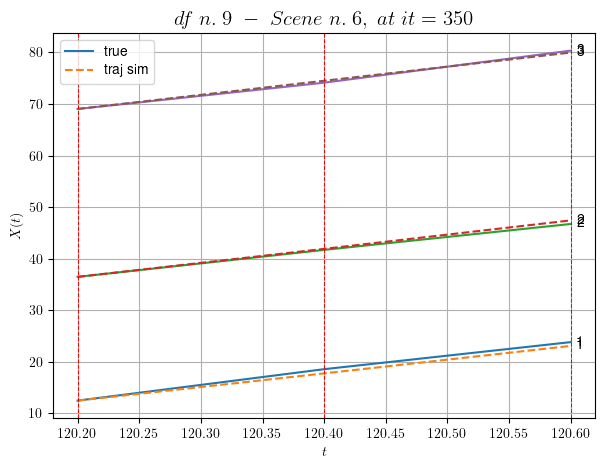

        For scene 6/9
        * use LR_NN=0.0001 with err=1.6705031935597932 at it=19
        * v0_scn_mean = 27.5762152608073
        * MAE = 0.22248618291968414



        For scene 7/9
        * use LR_NN=0.0005 with err=18.338963755779496 at it=19
        * v0_scn_mean = 28.801353771637697
        * MAE = 0.24373741012195027



            - Time interval n.0: [205.80, 206.00]
                * y_true: [16.81767795  9.52209489]
                * v_ann: [11.732536315917969, 12.700749397277832, 23.158700610445106]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [206.00, 206.20]
                * y_true: [13.65726133  9.1692133 ]
                * v_ann: [12.500988006591797, 12.22205924987793, 23.158700610445106]

----------------------------------------------------------------------------------------------------
            * err= 0.5074992229076684
            * Learning rate NN = 0.00036449998151

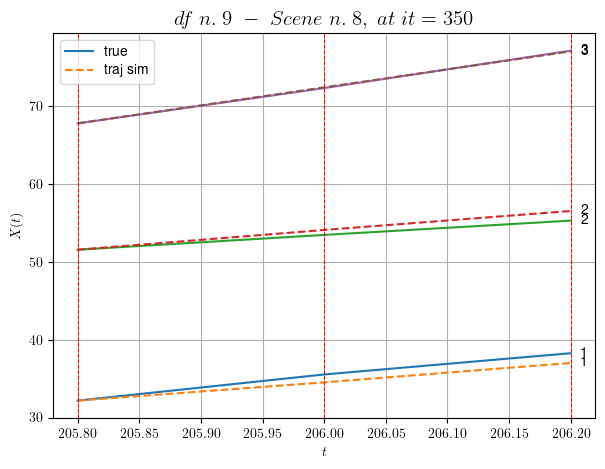

        For scene 8/9
        * use LR_NN=0.0005 with err=1.3320214701448112 at it=19
        * v0_scn_mean = 23.745048100883743
        * MAE = 0.5074992229076684



For df=9 with 9 scenes, time taken:        77.56
------------------------------------------------------------
****************************************************************************************************
In df n.10/10 we have 22 scenes
****************************************************************************************************
            - Time interval n.0: [25.72, 25.92]
                * y_true: [19.85100065 23.2716    ]
                * v_ann: [24.125423431396484, 23.902973175048828, 19.70885794583033]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [25.92, 26.12]
                * y_true: [21.59125574 29.46240542]
                * v_ann: [23.187803268432617, 22.88347816467285, 19.70885794583033]

-----------------

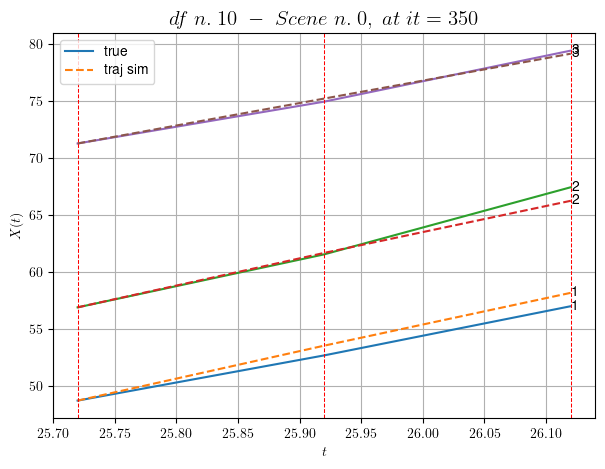

        For scene 0/22
        * use LR_NN=0.0005 with err=2.789562783606366 at it=19
        * v0_scn_mean = 20.590881224393662
        * MAE = 0.4095069962061125



            - Time interval n.0: [71.72, 71.92]
                * y_true: [25.44045996  0.68637625]
                * v_ann: [16.617507934570312, 17.889549255371094, 24.696218424736657]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [71.92, 72.12]
                * y_true: [ 7.65710886 16.8398502 ]
                * v_ann: [13.759509086608887, 19.750757217407227, 24.696218424736657]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.12, 72.32]
                * y_true: [ 0.68637625 22.9307169 ]
                * v_ann: [13.946966171264648, 19.0402774810791, 24.696218424736657]

------------------------------------------------------------------------

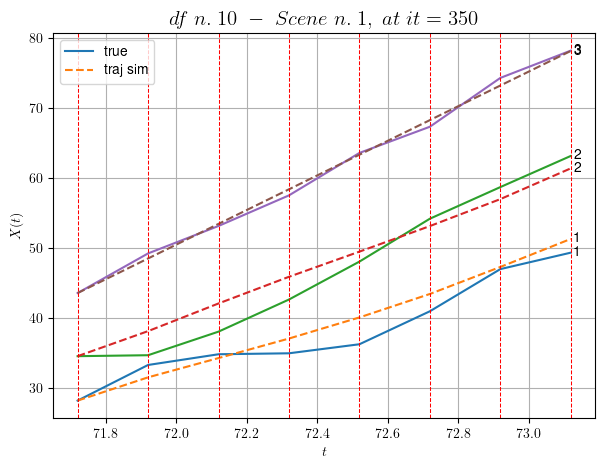

        For scene 1/22
        * use LR_NN=0.0005 with err=13.20850918527656 at it=19
        * v0_scn_mean = 25.150789821105842
        * MAE = 3.493133556802754



            - Time interval n.0: [120.92, 121.12]
                * y_true: [2.40007998 4.01291198]
                * v_ann: [7.435296535491943, 7.235768795013428, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.12, 121.32]
                * y_true: [3.94779745 3.96114827]
                * v_ann: [7.137988567352295, 7.473182201385498, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.32, 121.52]
                * y_true: [24.74097787  3.92663913]
                * v_ann: [6.844151973724365, 7.55855131149292, 19.875509421847788]

----------------------------------------------------------------------------

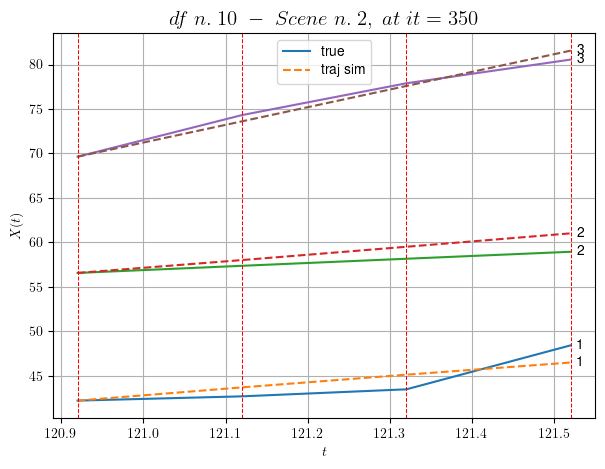

        For scene 2/22
        * use LR_NN=0.0001 with err=6.528281538063254 at it=19
        * v0_scn_mean = 20.743249496420685
        * MAE = 1.2937923855337015



            - Time interval n.0: [122.12, 122.32]
                * y_true: [20.84138029  3.6661027 ]
                * v_ann: [9.958492279052734, 10.247319221496582, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [122.32, 122.52]
                * y_true: [11.80149783  9.92593948]
                * v_ann: [11.284887313842773, 10.345389366149902, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [122.52, 122.72]
                * y_true: [ 5.61571017 11.00089954]
                * v_ann: [11.356419563293457, 9.632266998291016, 27.527697849634308]

------------------------------------------------------------------

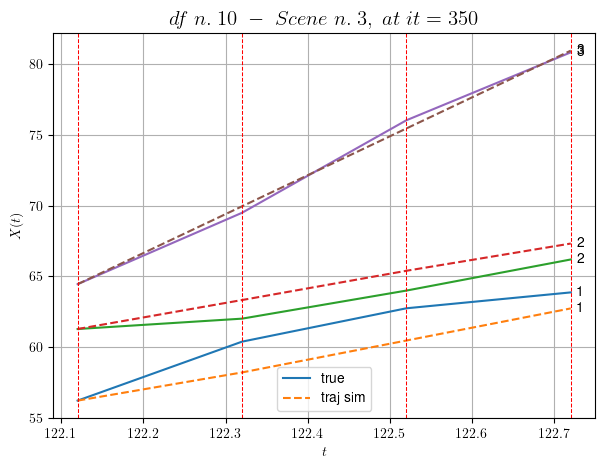

        For scene 3/22
        * use LR_NN=0.001 with err=5.278312635049271 at it=19
        * v0_scn_mean = 27.739591538088593
        * MAE = 1.3899511513545066



            - Time interval n.0: [194.52, 194.72]
                * y_true: [18.69097642 14.73135237]
                * v_ann: [20.10326385498047, 20.225648880004883, 15.385152268185989]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [194.72, 194.92]
                * y_true: [17.84107996 20.91213867]
                * v_ann: [18.992151260375977, 19.391948699951172, 15.385152268185989]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [194.92, 195.12]
                * y_true: [20.95142105 24.20273885]
                * v_ann: [19.039522171020508, 19.47511100769043, 15.385152268185989]

-------------------------------------------------------------------

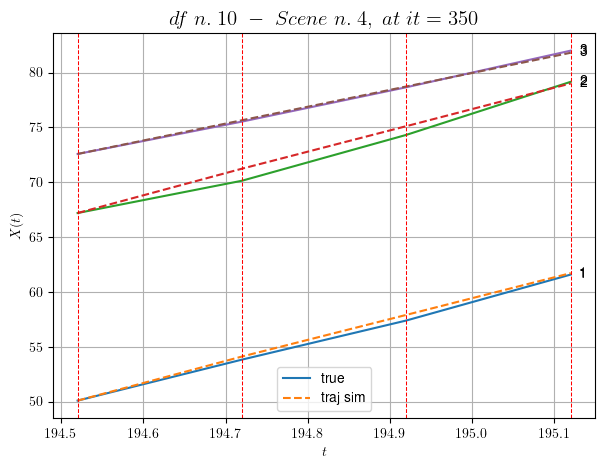

        For scene 4/22
        * use LR_NN=0.0005 with err=16.647475500752247 at it=19
        * v0_scn_mean = 16.63774754325502
        * MAE = 0.18661932811074658



            - Time interval n.0: [201.52, 201.72]
                * y_true: [45.67726396 25.9301702 ]
                * v_ann: [29.245580673217773, 29.46814727783203, 25.79745372458011]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [201.72, 201.92]
                * y_true: [22.15536429 29.26032799]
                * v_ann: [30.15479850769043, 31.4931583404541, 25.79745372458011]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [201.92, 202.12]
                * y_true: [30.43022185 23.25036083]
                * v_ann: [29.42189598083496, 29.901029586791992, 25.79745372458011]

-----------------------------------------------------------------------

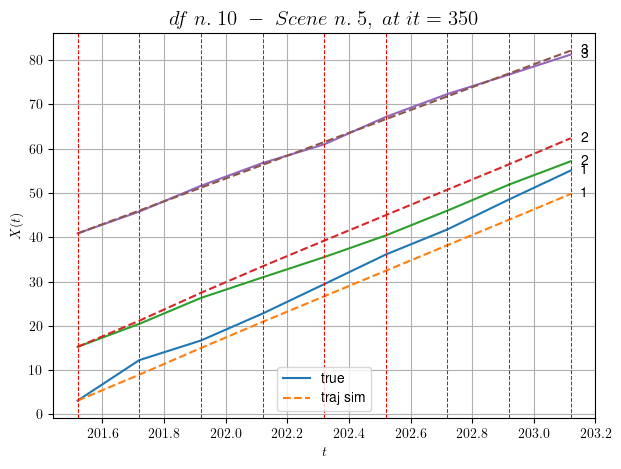

        For scene 5/22
        * use LR_NN=0.0005 with err=153.8976147099776 at it=19
        * v0_scn_mean = 26.15764150788415
        * MAE = 7.968419047590182



            - Time interval n.0: [210.12, 210.32]
                * y_true: [23.65050773 21.02104774]
                * v_ann: [23.74071502685547, 24.045509338378906, 24.382940011426964]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [210.32, 210.52]
                * y_true: [27.53081175 21.02121012]
                * v_ann: [22.616804122924805, 22.70525360107422, 24.382940011426964]

----------------------------------------------------------------------------------------------------
            * err= 0.24862242510003174
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00012790737181714307


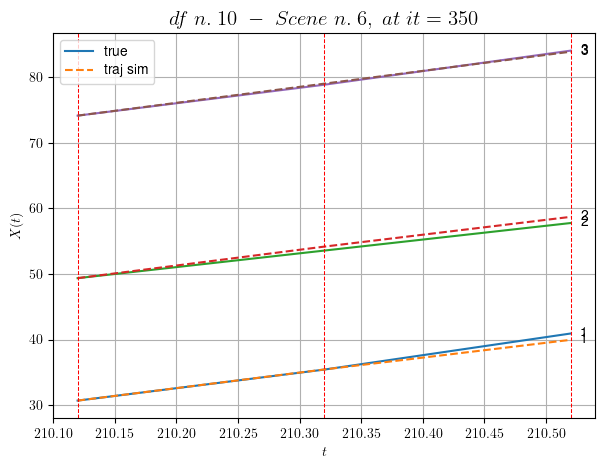

        For scene 6/22
        * use LR_NN=0.0005 with err=1.982690719953644 at it=19
        * v0_scn_mean = 24.864361571923407
        * MAE = 0.24094988431636186



            - Time interval n.0: [236.52, 236.72]
                * y_true: [22.75077388 14.36119092]
                * v_ann: [22.988784790039062, 22.25442886352539, 24.944297288056724]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [236.72, 236.92]
                * y_true: [21.51093715 22.77208028]
                * v_ann: [20.977134704589844, 21.157594680786133, 24.944297288056724]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [236.92, 237.12]
                * y_true: [26.0213192  23.10241688]
                * v_ann: [21.463455200195312, 21.454092025756836, 24.944297288056724]

----------------------------------------------------------------

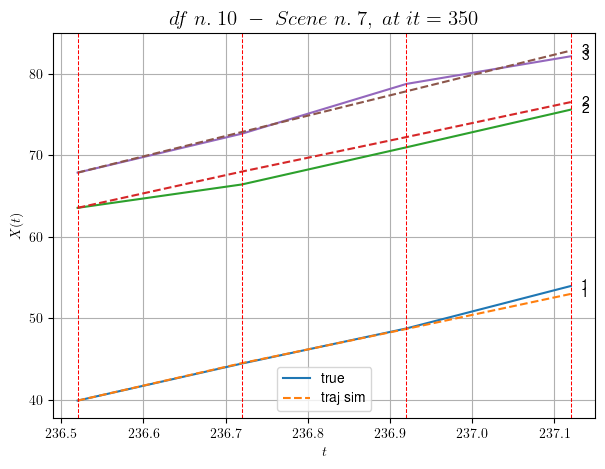

        For scene 7/22
        * use LR_NN=0.0005 with err=9.034098144247135 at it=19
        * v0_scn_mean = 25.377606580451932
        * MAE = 0.6009963913232627



            - Time interval n.0: [237.72, 237.92]
                * y_true: [25.90146221 17.55123599]
                * v_ann: [21.580984115600586, 21.57988739013672, 25.832622552460432]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.92, 238.12]
                * y_true: [21.20141323 21.76181979]
                * v_ann: [21.62672996520996, 21.627269744873047, 25.832622552460432]

----------------------------------------------------------------------------------------------------
            * err= 0.3031543443707149
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.175180413877987e-05


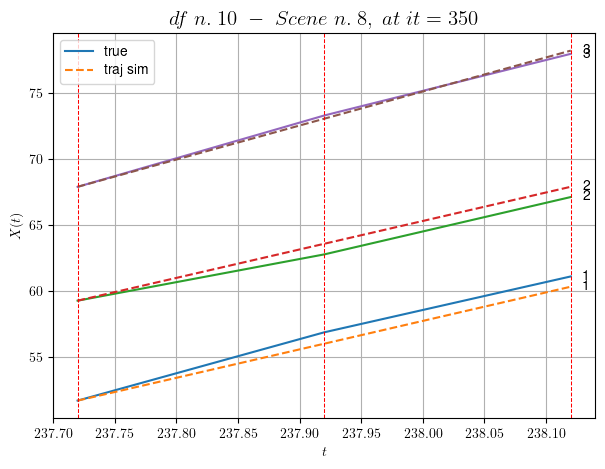

        For scene 8/22
        * use LR_NN=0.0005 with err=1.830149792429293 at it=19
        * v0_scn_mean = 26.189796119780986
        * MAE = 0.3031543443707149



            - Time interval n.0: [317.32, 317.52]
                * y_true: [14.46061508  5.00523108]
                * v_ann: [9.569231986999512, 9.327963829040527, 5.959565079937888]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.52, 317.72]
                * y_true: [10.48047894  8.66542797]
                * v_ann: [9.8140287399292, 9.637215614318848, 5.959565079937888]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [317.72, 317.92]
                * y_true: [ 5.95030099 13.38070893]
                * v_ann: [9.694769859313965, 9.510478019714355, 5.959565079937888]

---------------------------------------------------------------------------

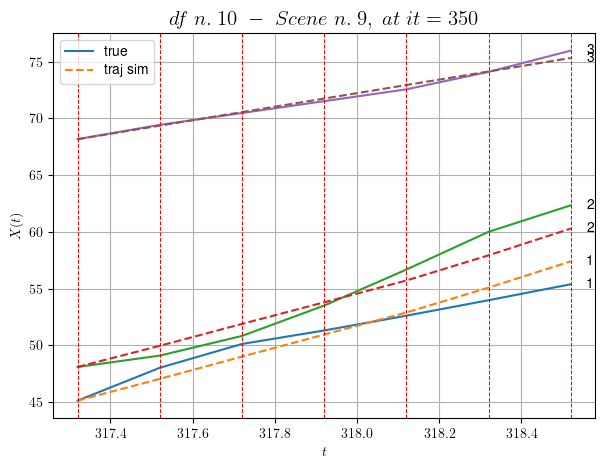

        For scene 9/22
        * use LR_NN=0.005 with err=102.02623822998646 at it=19
        * v0_scn_mean = 8.019999491849417
        * MAE = 0.9384108407943601



            - Time interval n.0: [321.12, 321.32]
                * y_true: [25.50087189 14.95118626]
                * v_ann: [19.402942657470703, 17.85501480102539, 25.328462391543354]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [321.32, 321.52]
                * y_true: [23.87107171  3.25027229]
                * v_ann: [19.09100341796875, 18.243328094482422, 25.328462391543354]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [321.52, 321.72]
                * y_true: [25.04128771 23.00208642]
                * v_ann: [18.215356826782227, 18.895753860473633, 25.328462391543354]

-------------------------------------------------------------------

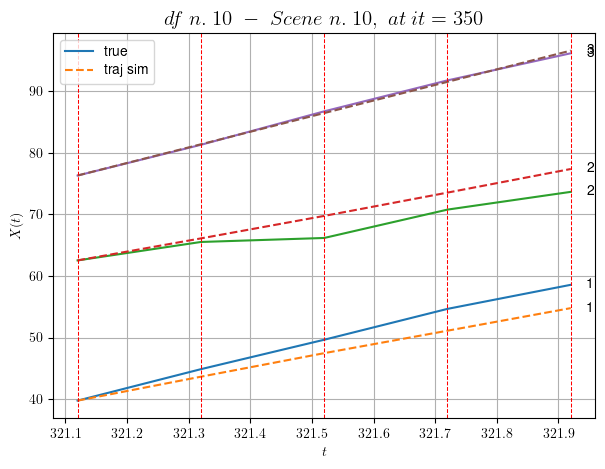

        For scene 10/22
        * use LR_NN=5e-05 with err=4.594079451753049 at it=19
        * v0_scn_mean = 25.728846031731475
        * MAE = 4.455038294724569



            - Time interval n.0: [323.12, 323.32]
                * y_true: [ 6.90008114 15.05052158]
                * v_ann: [11.893677711486816, 11.69863224029541, 13.161438821255102]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [323.32, 323.52]
                * y_true: [ 8.30010994 16.45065772]
                * v_ann: [11.825864791870117, 11.673136711120605, 13.161438821255102]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [323.52, 323.72]
                * y_true: [ 9.85014911 16.15074097]
                * v_ann: [11.824070930480957, 11.71770191192627, 13.161438821255102]

-------------------------------------------------------------------

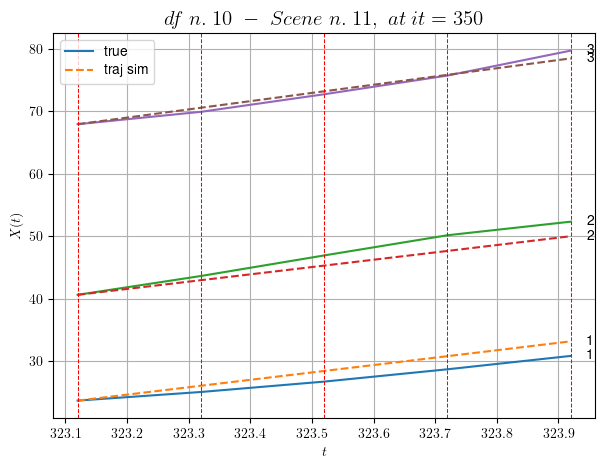

        For scene 11/22
        * use LR_NN=0.0001 with err=21.79801230938669 at it=19
        * v0_scn_mean = 14.60462198391961
        * MAE = 2.050228940100809



            - Time interval n.0: [337.72, 337.92]
                * y_true: [11.69035174 22.47147634]
                * v_ann: [12.46230697631836, 12.875212669372559, 16.738540275581308]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [337.92, 338.12]
                * y_true: [10.20034007 18.27135214]
                * v_ann: [14.53343677520752, 15.083122253417969, 16.738540275581308]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.12, 338.32]
                * y_true: [ 7.94029275 13.91116184]
                * v_ann: [14.044697761535645, 14.820871353149414, 16.738540275581308]

-------------------------------------------------------------------

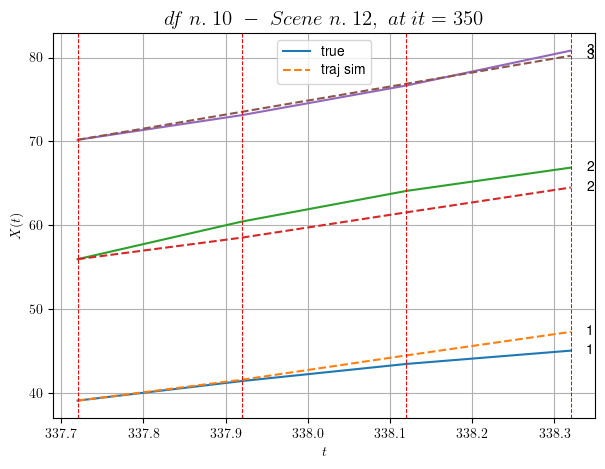

        For scene 12/22
        * use LR_NN=0.001 with err=12.361684616416326 at it=19
        * v0_scn_mean = 17.87514067649869
        * MAE = 1.8771781648243049



            - Time interval n.0: [369.32, 369.52]
                * y_true: [22.34117259 11.42097363]
                * v_ann: [16.343530654907227, 16.467254638671875, 20.50893055390458]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.52, 369.72]
                * y_true: [22.31135956  8.65079743]
                * v_ann: [16.38825798034668, 16.462926864624023, 20.50893055390458]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.72, 369.92]
                * y_true: [16.17115552 17.53172003]
                * v_ann: [16.37084197998047, 16.41187858581543, 20.50893055390458]

----------------------------------------------------------------------

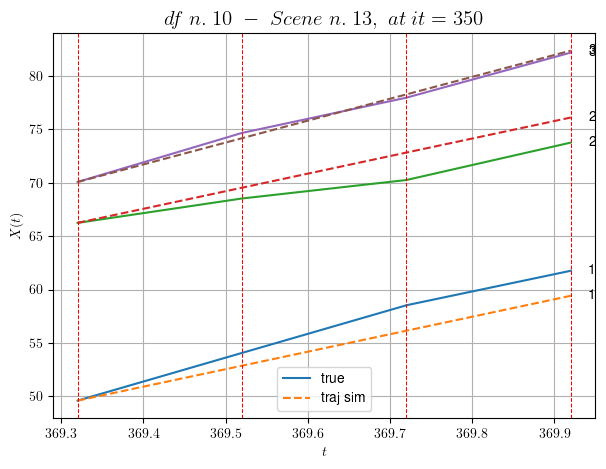

        For scene 13/22
        * use LR_NN=0.0001 with err=5.428282264339799 at it=19
        * v0_scn_mean = 21.322381980952727
        * MAE = 2.177807054878374



            - Time interval n.0: [370.92, 371.12]
                * y_true: [12.30016813 11.70074461]
                * v_ann: [10.063539505004883, 9.452290534973145, 19.892193491627953]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.12, 371.32]
                * y_true: [ 9.3501493  10.70073785]
                * v_ann: [10.363929748535156, 10.650484085083008, 19.892193491627953]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.32, 371.52]
                * y_true: [ 8.90016062 10.12074395]
                * v_ann: [10.297874450683594, 10.596333503723145, 19.892193491627953]

-----------------------------------------------------------------

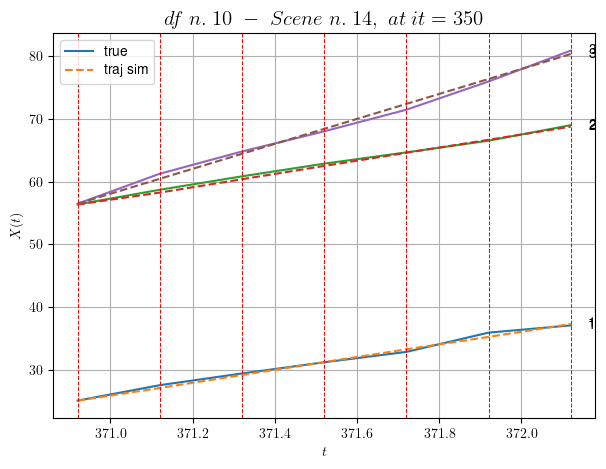

        For scene 14/22
        * use LR_NN=0.0005 with err=31.7446297004896 at it=19
        * v0_scn_mean = 20.75850362403792
        * MAE = 0.18143341755491926



            - Time interval n.0: [376.92, 377.12]
                * y_true: [ 9.78017765 12.68091602]
                * v_ann: [10.988422393798828, 11.036825180053711, 13.629784520487759]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [377.12, 377.32]
                * y_true: [10.39021059 11.81092637]
                * v_ann: [11.13314437866211, 11.11887264251709, 13.629784520487759]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [377.32, 377.52]
                * y_true: [10.59024861 11.25094207]
                * v_ann: [11.114956855773926, 11.109322547912598, 13.629784520487759]

------------------------------------------------------------------

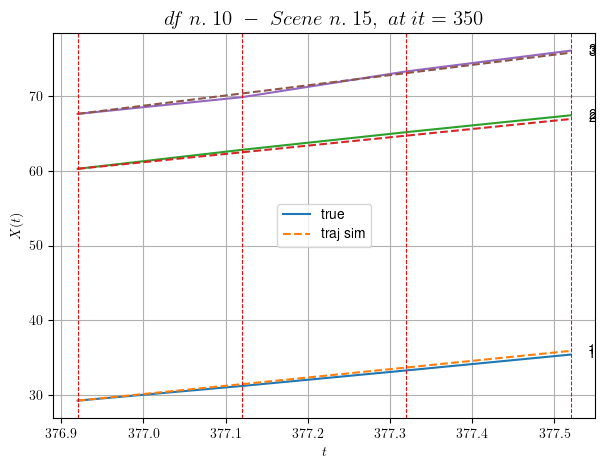

        For scene 15/22
        * use LR_NN=0.001 with err=16.071642304221253 at it=19
        * v0_scn_mean = 15.03282716162701
        * MAE = 0.1127844485127616



            - Time interval n.0: [433.52, 433.72]
                * y_true: [21.56070162 24.64178312]
                * v_ann: [22.70292091369629, 21.50837516784668, 21.095742864931967]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [433.72, 433.92]
                * y_true: [20.75082718 21.171764  ]
                * v_ann: [22.841506958007812, 21.35932731628418, 21.095742864931967]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [433.92, 434.12]
                * y_true: [19.97093958 25.19244807]
                * v_ann: [22.792835235595703, 21.411211013793945, 21.095742864931967]

-------------------------------------------------------------------

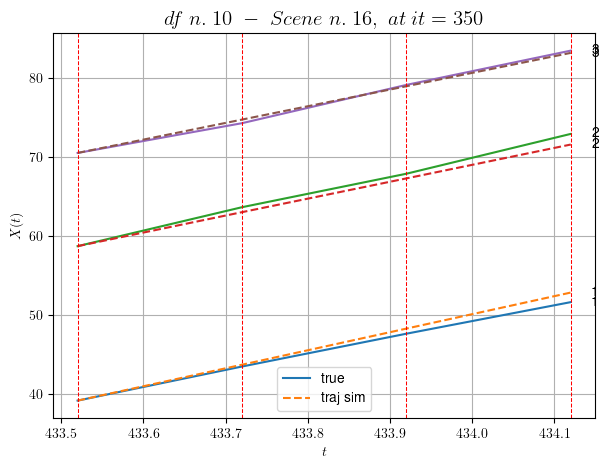

        For scene 16/22
        * use LR_NN=5e-05 with err=7.994905063286431 at it=19
        * v0_scn_mean = 21.858900348338913
        * MAE = 0.4003113016445628



            - Time interval n.0: [483.92, 484.12]
                * y_true: [19.08092085  0.51217506]
                * v_ann: [9.765682220458984, 9.959234237670898, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [484.12, 484.32]
                * y_true: [19.26103904  0.51217506]
                * v_ann: [9.923405647277832, 9.729046821594238, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            * err= 3.902046748722191
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00041378621136356486


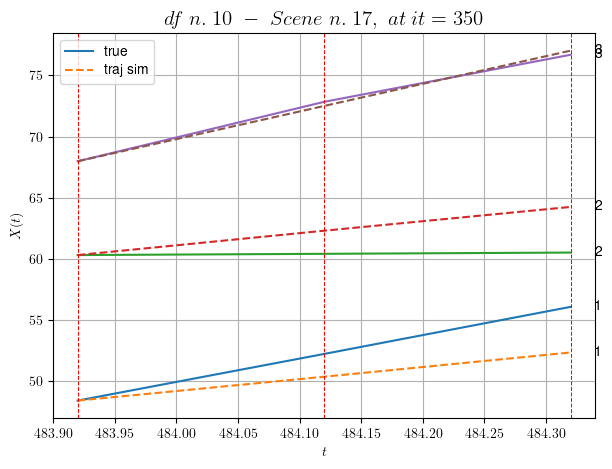

        For scene 17/22
        * use LR_NN=0.0005 with err=4.930089583572412 at it=19
        * v0_scn_mean = 23.251576451714048
        * MAE = 3.902046748722191



        For scene 18/22
        * use LR_NN=0.0001 with err=8.871700740211539 at it=19
        * v0_scn_mean = 19.277415533253297
        * MAE = 0.4844404622281533



            - Time interval n.0: [202.52, 202.72]
                * y_true: [23.35318258 28.37081651 28.03104175]
                * v_ann: [28.091442108154297, 28.029695510864258, 28.438875198364258, 24.014995625684776]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [202.72, 202.92]
                * y_true: [23.6005682  33.85129081 29.41136895]
                * v_ann: [26.915376663208008, 27.197874069213867, 25.798927307128906, 24.014995625684776]

----------------------------------------------------------------------------------------------------
            - Time in

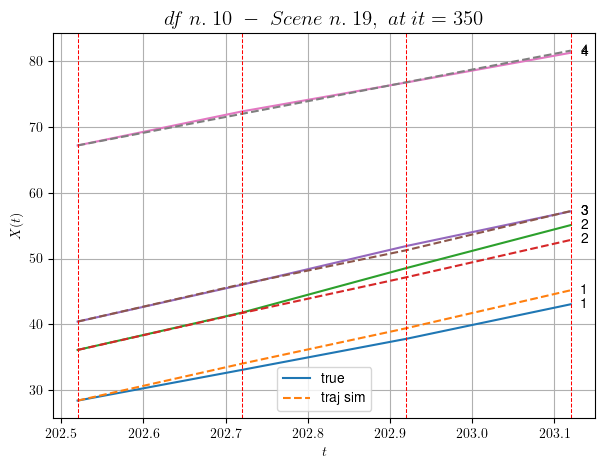

        For scene 19/22
        * use LR_NN=0.001 with err=26.876294755428763 at it=19
        * v0_scn_mean = 24.698128173240637
        * MAE = 0.9844493693378047



            - Time interval n.0: [342.92, 343.12]
                * y_true: [ 9.90771225 17.81228574 16.23940532]
                * v_ann: [15.108668327331543, 19.760066986083984, 14.97243881225586, 15.473603093356406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [343.12, 343.32]
                * y_true: [13.33029638 14.00078454 21.70124661]
                * v_ann: [14.692327499389648, 19.44874382019043, 14.920601844787598, 15.473603093356406]

----------------------------------------------------------------------------------------------------
            * err= 0.6674643094056659
            * Learning rate NN = 7.289998848136747e-06
            * diff = 0.007903856862470415


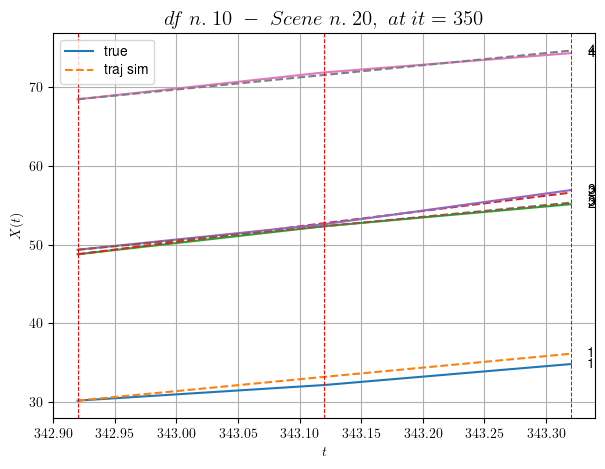

        For scene 20/22
        * use LR_NN=1e-05 with err=9.375398244598385 at it=19
        * v0_scn_mean = 17.131656104684076
        * MAE = 0.6674643094056659



        For scene 21/22
        * use LR_NN=0.001 with err=4.3860607933537725 at it=19
        * v0_scn_mean = 20.872359945531915
        * MAE = 0.5741463516657737



For df=10 with 22 scenes, time taken:        242.39
------------------------------------------------------------

Time taken for the computation: 2288.63

Time taken using 1-2-1 NN structure: 2288.70


NN structure: 1-4-1
****************************************************************************************************
In df n.1/10 we have 28 scenes
****************************************************************************************************
            - Time interval n.0: [14.24, 14.44]
                * y_true: [32.1443344  20.77111865]
                * v_ann: [26.359628677368164, 27.23128318786621, 27.63629536512849]

-------------------------

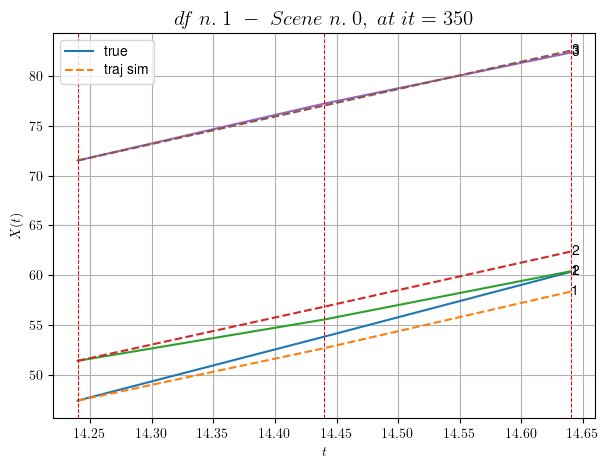

        For scene 0/28
        * use LR_NN=0.001 with err=16.769671794500457 at it=19
        * v0_scn_mean = 27.838881482454525
        * MAE = 1.2141439059107493



            - Time interval n.0: [23.64, 23.84]
                * y_true: [26.6509107  26.65125804]
                * v_ann: [26.429601669311523, 24.976219177246094, 31.18441200741597]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [26.825151443481445, 26.023529052734375, 31.18441200741597]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [28.06322479248047, 27.753976821899414, 31.18441200741597]

--------------------------------------------------------------------------

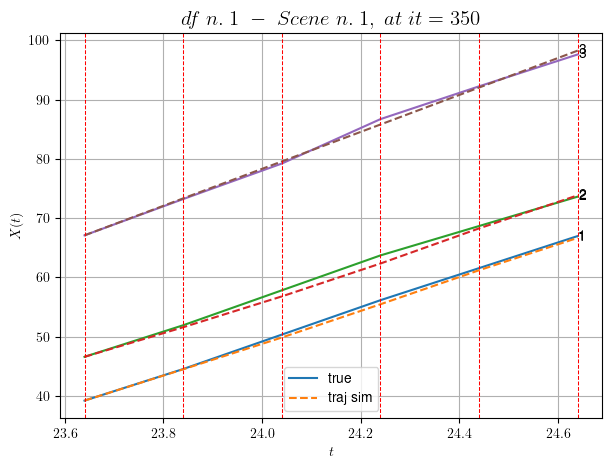

        For scene 1/28
        * use LR_NN=0.0005 with err=32.327263158187556 at it=19
        * v0_scn_mean = 31.082899565312655
        * MAE = 0.21478339402322164



            - Time interval n.0: [72.44, 72.64]
                * y_true: [25.85001228 31.10049693]
                * v_ann: [27.170948028564453, 28.41912841796875, 28.2509332124626]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.64, 72.84]
                * y_true: [30.00006309 33.82077482]
                * v_ann: [27.299518585205078, 28.632545471191406, 28.2509332124626]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.84, 73.04]
                * y_true: [23.75011307 26.19081077]
                * v_ann: [28.395627975463867, 28.955310821533203, 28.2509332124626]

---------------------------------------------------------------------------

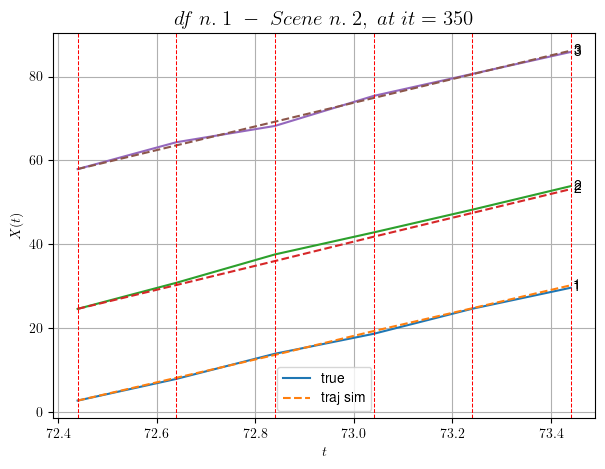

        For scene 2/28
        * use LR_NN=5e-05 with err=3.364350240455405 at it=19
        * v0_scn_mean = 28.400840541916434
        * MAE = 0.3228657775402899



            - Time interval n.0: [84.24, 84.44]
                * y_true: [29.4403562  23.48047527]
                * v_ann: [26.760515213012695, 26.931514739990234, 29.494369247210926]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [84.44, 84.64]
                * y_true: [27.01049004 24.28067739]
                * v_ann: [27.500022888183594, 27.701833724975586, 29.494369247210926]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [84.64, 84.84]
                * y_true: [27.60069732 32.65118399]
                * v_ann: [27.725116729736328, 27.661216735839844, 29.494369247210926]

-----------------------------------------------------------------------

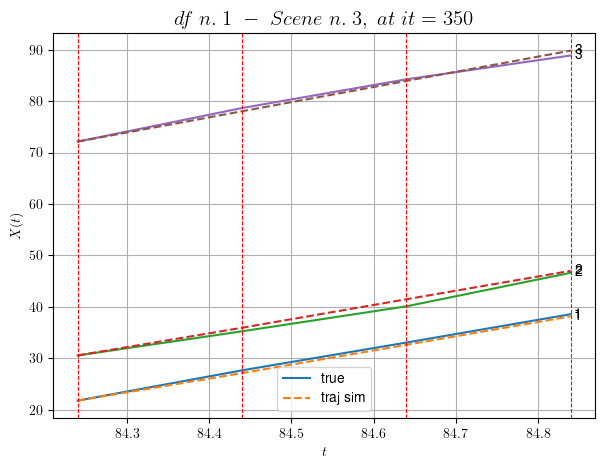

        For scene 3/28
        * use LR_NN=5e-05 with err=23.140751211158655 at it=19
        * v0_scn_mean = 29.53770536014879
        * MAE = 0.37847415193587103



            - Time interval n.0: [131.64, 131.84]
                * y_true: [30.80073929 29.11067519]
                * v_ann: [29.38424301147461, 29.404193878173828, 28.44290395364265]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.84, 132.04]
                * y_true: [30.16079766 28.07097758]
                * v_ann: [29.76184844970703, 29.6622314453125, 28.44290395364265]

----------------------------------------------------------------------------------------------------
            * err= 0.07838335106733772
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 4.985146622073222e-05


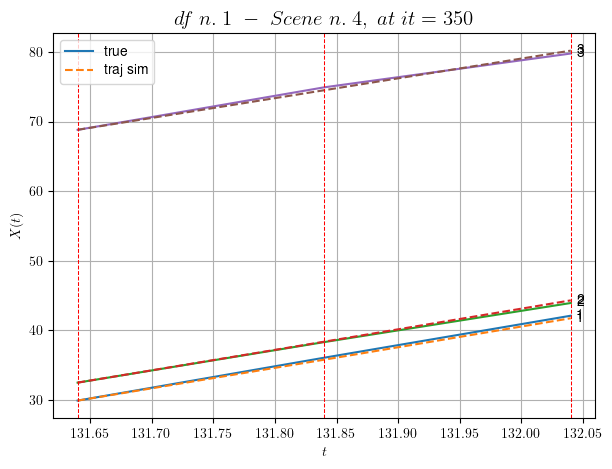

        For scene 4/28
        * use LR_NN=5e-05 with err=17.313395037608885 at it=19
        * v0_scn_mean = 28.576358039945283
        * MAE = 0.06018140970429623



            - Time interval n.0: [148.04, 148.24]
                * y_true: [21.93113488 25.90203153]
                * v_ann: [26.542640686035156, 25.993541717529297, 27.6216739067253]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [148.24, 148.44]
                * y_true: [23.17638158 33.20310746]
                * v_ann: [26.53440284729004, 25.15172004699707, 27.6216739067253]

----------------------------------------------------------------------------------------------------
            * err= 0.6628321137689659
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00013400883228753546


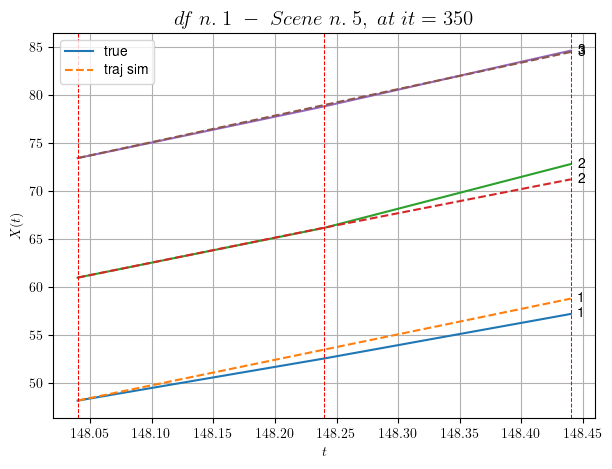

        For scene 5/28
        * use LR_NN=0.0005 with err=0.8251024761049065 at it=19
        * v0_scn_mean = 27.825513185907518
        * MAE = 0.6615304150455181



            - Time interval n.0: [161.64, 161.84]
                * y_true: [31.66062591 25.70084842]
                * v_ann: [27.94440460205078, 27.186717987060547, 34.711781151250925]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [161.84, 162.04]
                * y_true: [29.96082912 27.30094687]
                * v_ann: [29.413965225219727, 30.018882751464844, 34.711781151250925]

----------------------------------------------------------------------------------------------------
            * err= 0.27033559496257753
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00024122754196315155


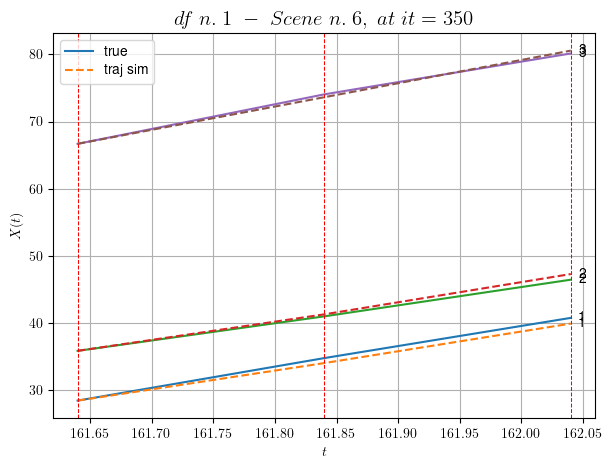

        For scene 6/28
        * use LR_NN=0.0005 with err=13.5285674413551 at it=19
        * v0_scn_mean = 34.30794835630702
        * MAE = 0.26823254779709094



            - Time interval n.0: [164.04, 164.24]
                * y_true: [27.950014  32.5307084]
                * v_ann: [21.698041915893555, 27.97955894470215, 32.43283336687095]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [164.24, 164.44]
                * y_true: [26.70005561 31.43096027]
                * v_ann: [28.1053466796875, 34.719669342041016, 32.43283336687095]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [164.44, 164.64]
                * y_true: [26.20012328 27.61110245]
                * v_ann: [24.415502548217773, 31.588787078857422, 32.43283336687095]

-------------------------------------------------------------------------

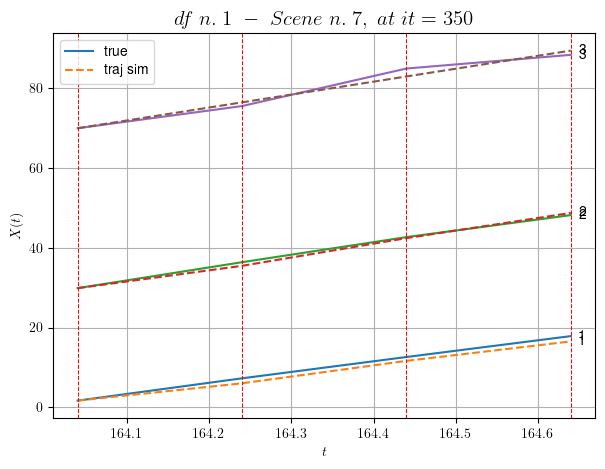

        For scene 7/28
        * use LR_NN=0.0005 with err=1.5530398760839461 at it=19
        * v0_scn_mean = 32.224322430849156
        * MAE = 0.8660878910996882



        For scene 8/28
        * use LR_NN=0.0001 with err=1.3485963046989573 at it=19
        * v0_scn_mean = 36.0867561570375
        * MAE = 0.01803622411424836



            - Time interval n.0: [216.64, 216.84]
                * y_true: [37.52054047 34.13112536]
                * v_ann: [29.754173278808594, 39.90424346923828, 34.851790052280656]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [216.84, 217.04]
                * y_true: [39.83095433 33.81148861]
                * v_ann: [28.80957794189453, 39.2108039855957, 34.851790052280656]

----------------------------------------------------------------------------------------------------
            * err= 2.6381451302509515
            * Learning rate NN = 7.289998757187277e

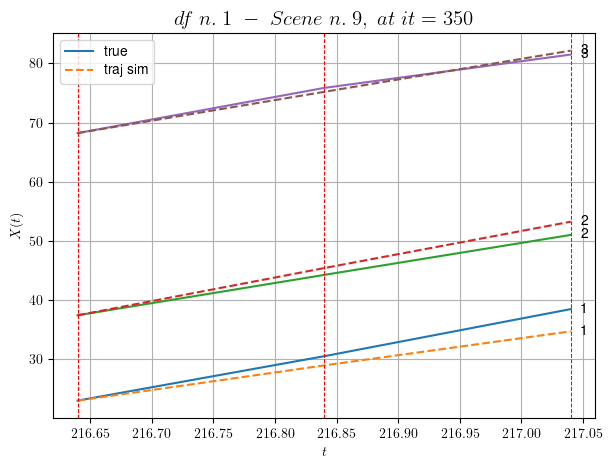

        For scene 9/28
        * use LR_NN=0.0001 with err=9.90049569268831 at it=19
        * v0_scn_mean = 34.43595750947053
        * MAE = 2.6381451302509515



            - Time interval n.0: [240.64, 240.84]
                * y_true: [28.54090912 24.62265201]
                * v_ann: [35.24565124511719, 28.28492546081543, 33.34474567234028]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [240.84, 241.04]
                * y_true: [33.36143299 35.0745887 ]
                * v_ann: [27.441059112548828, 25.70730972290039, 33.34474567234028]

----------------------------------------------------------------------------------------------------
            * err= 0.40680245725400527
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.004242113380434787


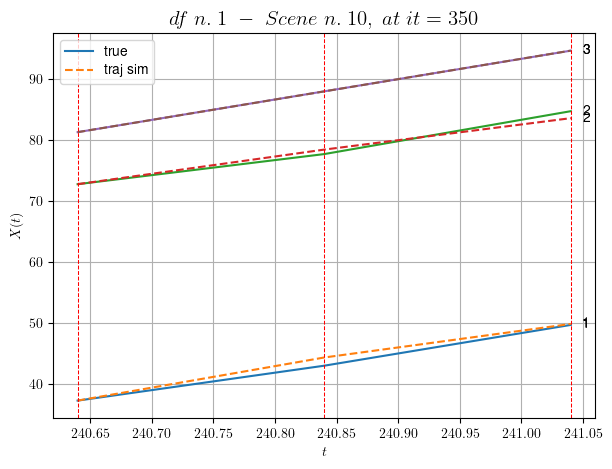

        For scene 10/28
        * use LR_NN=0.0001 with err=8.873459952557758 at it=19
        * v0_scn_mean = 33.05807743587603
        * MAE = 0.40680245725400527



            - Time interval n.0: [253.64, 253.84]
                * y_true: [26.81042151 28.10122634]
                * v_ann: [29.9593505859375, 33.69296646118164, 27.474897828445823]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [253.84, 254.04]
                * y_true: [31.5007643  35.35225595]
                * v_ann: [27.059694290161133, 29.57805061340332, 27.474897828445823]

----------------------------------------------------------------------------------------------------
            * err= 0.1994391881518528
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00012695291797404362


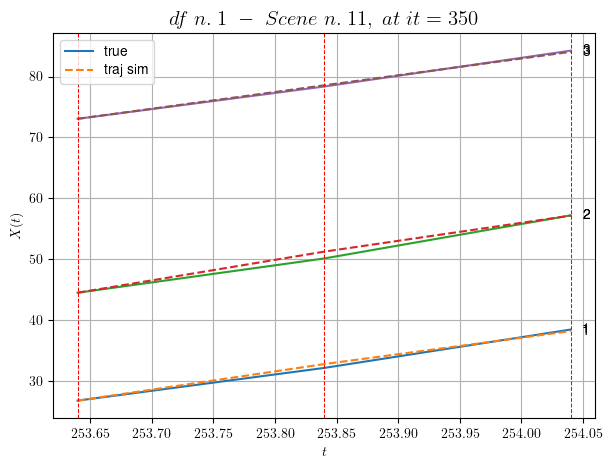

        For scene 11/28
        * use LR_NN=0.0001 with err=1.6875544636975637 at it=19
        * v0_scn_mean = 27.691316850195935
        * MAE = 0.1986879011802645



            - Time interval n.0: [262.64, 262.84]
                * y_true: [36.75102901 34.57147294]
                * v_ann: [29.869077682495117, 28.443233489990234, 35.93105457034953]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [262.84, 263.04]
                * y_true: [20.65076329 34.76181544]
                * v_ann: [33.210289001464844, 34.40570831298828, 35.93105457034953]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [263.04, 263.24]
                * y_true: [40.30193432 23.95156631]
                * v_ann: [28.445003509521484, 28.618223190307617, 35.93105457034953]

------------------------------------------------------------------

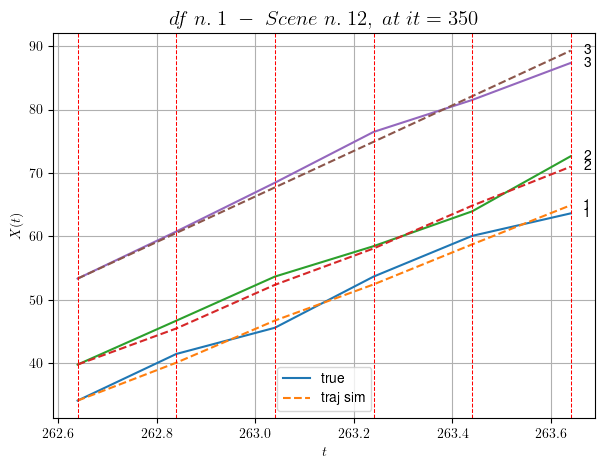

        For scene 12/28
        * use LR_NN=0.001 with err=29.40161395650682 at it=19
        * v0_scn_mean = 35.42272146505022
        * MAE = 1.228023974619015



            - Time interval n.0: [314.84, 315.04]
                * y_true: [29.62016755 31.54681236]
                * v_ann: [29.9865779876709, 29.568817138671875, 30.92624116601543]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [315.04, 315.24]
                * y_true: [30.12030665 32.32740505]
                * v_ann: [31.302814483642578, 30.931747436523438, 30.92624116601543]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [315.24, 315.44]
                * y_true: [25.99040223 31.02242591]
                * v_ann: [31.546466827392578, 31.348831176757812, 30.92624116601543]

-----------------------------------------------------------------------

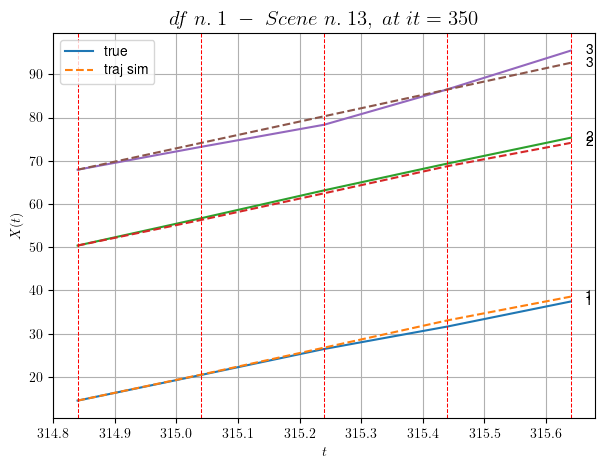

        For scene 13/28
        * use LR_NN=0.0005 with err=21.374523241188726 at it=19
        * v0_scn_mean = 30.846855781410746
        * MAE = 1.2199289446199988



            - Time interval n.0: [325.24, 325.44]
                * y_true: [29.06068603 28.85087529]
                * v_ann: [29.05036735534668, 28.499309539794922, 29.804035226087482]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.44, 325.64]
                * y_true: [28.37089255 31.80128105]
                * v_ann: [29.11863899230957, 28.484560012817383, 29.804035226087482]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [325.64, 325.84]
                * y_true: [30.70143178 22.60113815]
                * v_ann: [29.413434982299805, 29.12793731689453, 29.804035226087482]

-----------------------------------------------------------------

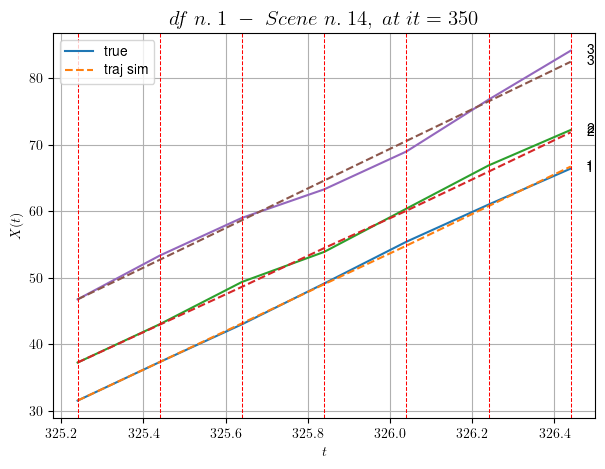

        For scene 14/28
        * use LR_NN=0.001 with err=14.399630691414233 at it=19
        * v0_scn_mean = 29.820830785944874
        * MAE = 0.4799406504122279



            - Time interval n.0: [354.04, 354.24]
                * y_true: [29.77169216 32.15176545]
                * v_ann: [28.658069610595703, 26.47397232055664, 32.69350270999544]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [354.24, 354.44]
                * y_true: [35.38251939 26.55179403]
                * v_ann: [29.614845275878906, 30.336078643798828, 32.69350270999544]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [354.44, 354.64]
                * y_true: [26.40441101 27.01000163]
                * v_ann: [30.10340118408203, 31.507225036621094, 32.69350270999544]

--------------------------------------------------------------------

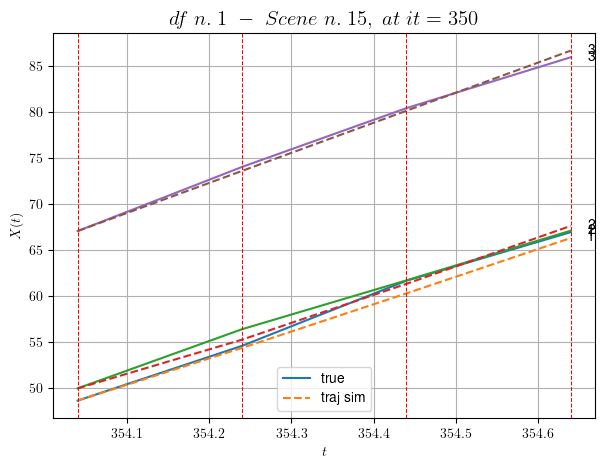

        For scene 15/28
        * use LR_NN=0.001 with err=30.73958135176689 at it=19
        * v0_scn_mean = 32.46265057729951
        * MAE = 0.40339582686156533



            - Time interval n.0: [363.44, 363.64]
                * y_true: [23.6502752  28.55056389]
                * v_ann: [29.51182746887207, 28.969181060791016, 38.923429963342016]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [363.64, 363.84]
                * y_true: [26.3393983  33.66093634]
                * v_ann: [28.035409927368164, 27.320999145507812, 38.923429963342016]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [363.84, 364.04]
                * y_true: [30.2407755  29.94110461]
                * v_ann: [28.37066650390625, 30.080699920654297, 38.923429963342016]

------------------------------------------------------------------

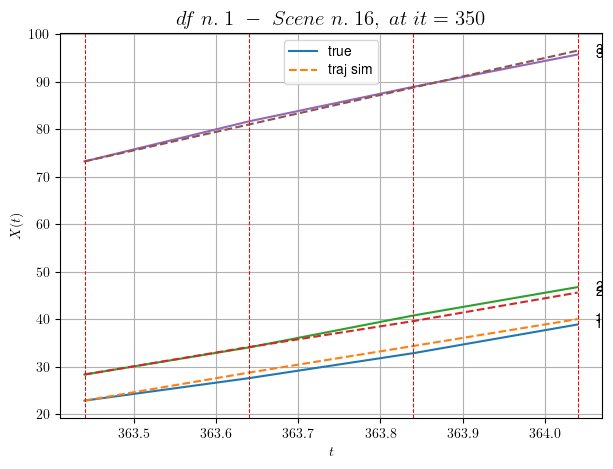

        For scene 16/28
        * use LR_NN=0.0005 with err=24.188063191029197 at it=19
        * v0_scn_mean = 38.15862923365949
        * MAE = 0.7337276122977342



            - Time interval n.0: [386.64, 386.84]
                * y_true: [28.15052447 34.1607672 ]
                * v_ann: [34.683013916015625, 34.927330017089844, 39.346032634271026]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [386.84, 387.04]
                * y_true: [34.00091123 38.91120777]
                * v_ann: [33.660064697265625, 33.14164733886719, 39.346032634271026]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.04, 387.24]
                * y_true: [32.52639997 34.00151192]
                * v_ann: [33.997947692871094, 35.170223236083984, 39.346032634271026]

----------------------------------------------------------------

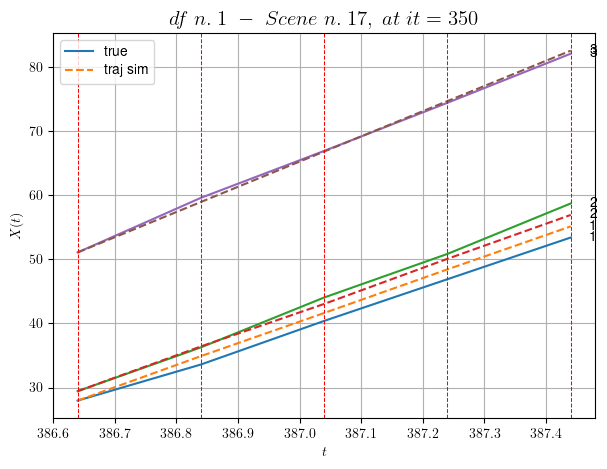

        For scene 17/28
        * use LR_NN=0.0005 with err=49.311684309744244 at it=19
        * v0_scn_mean = 38.545011882420255
        * MAE = 0.8045008548785217



            - Time interval n.0: [431.84, 432.04]
                * y_true: [30.8908033  31.49166882]
                * v_ann: [32.25104904174805, 32.28857421875, 30.08416102804929]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [432.04, 432.24]
                * y_true: [39.73151551 26.376716  ]
                * v_ann: [32.0391845703125, 31.90165901184082, 30.08416102804929]

----------------------------------------------------------------------------------------------------
            * err= 0.4792579445341101
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 3.557693971290021e-05


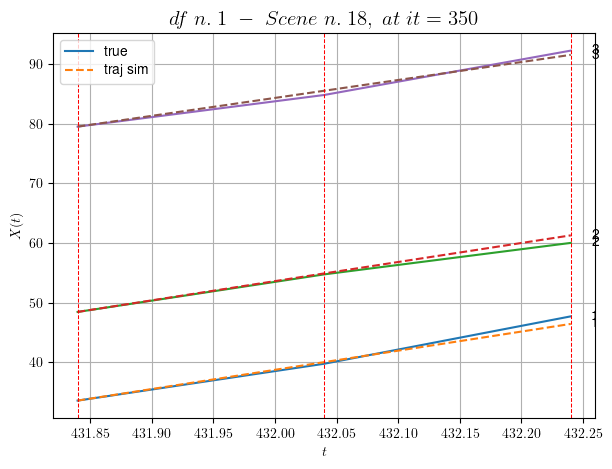

        For scene 18/28
        * use LR_NN=5e-05 with err=7.294260989264124 at it=19
        * v0_scn_mean = 30.076947835821176
        * MAE = 0.4792579445341101



            - Time interval n.0: [446.24, 446.44]
                * y_true: [25.89017971 23.30046083]
                * v_ann: [26.36172866821289, 25.67398452758789, 29.5544324287454]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [446.44, 446.64]
                * y_true: [28.05031625 27.72075411]
                * v_ann: [24.926979064941406, 24.520484924316406, 29.5544324287454]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [446.64, 446.84]
                * y_true: [26.94045507 27.8009832 ]
                * v_ann: [28.352447509765625, 29.46428871154785, 29.5544324287454]

-------------------------------------------------------------------------

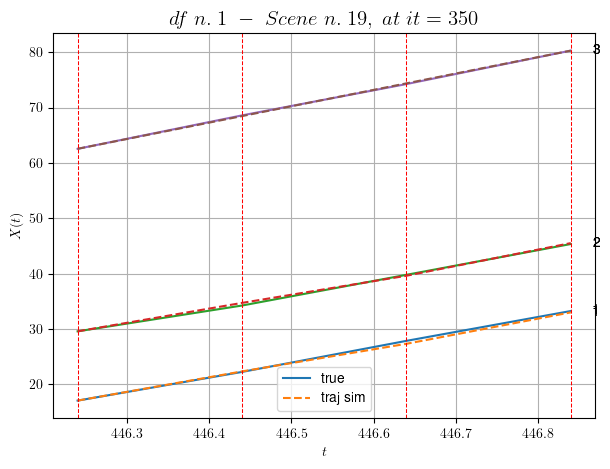

        For scene 19/28
        * use LR_NN=0.001 with err=12.028070542532028 at it=19
        * v0_scn_mean = 29.592620704444446
        * MAE = 0.05551843389284584



            - Time interval n.0: [447.44, 447.64]
                * y_true: [31.0713577  29.31148494]
                * v_ann: [27.04413414001465, 26.756553649902344, 32.58484136741256]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [447.64, 447.84]
                * y_true: [37.68225285 24.50151408]
                * v_ann: [27.728750228881836, 28.16815185546875, 32.58484136741256]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [447.84, 448.04]
                * y_true: [25.261801   20.71149408]
                * v_ann: [28.679309844970703, 29.706783294677734, 32.58484136741256]

-------------------------------------------------------------------

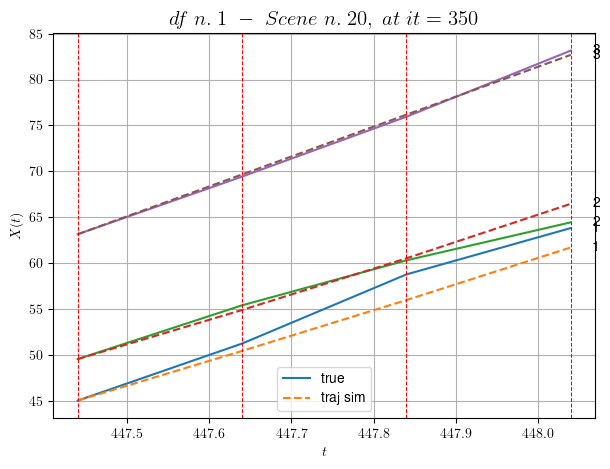

        For scene 20/28
        * use LR_NN=0.0005 with err=24.421383893219424 at it=19
        * v0_scn_mean = 32.36330227627505
        * MAE = 0.9850164875481257



            - Time interval n.0: [495.84, 496.04]
                * y_true: [23.1307843  13.57637571]
                * v_ann: [20.477739334106445, 19.550764083862305, 23.563140002878278]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [496.04, 496.24]
                * y_true: [23.23098731 16.2618474 ]
                * v_ann: [17.447237014770508, 18.443897247314453, 23.563140002878278]

----------------------------------------------------------------------------------------------------
            * err= 0.8487848104786235
            * Learning rate NN = 0.0007289999630302191
            * diff = 8.075719532918413e-05


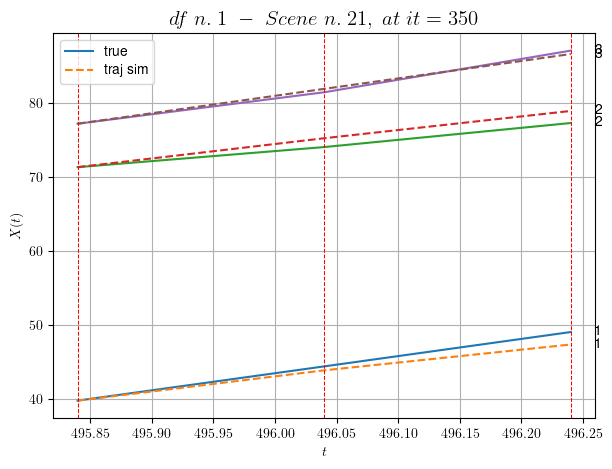

        For scene 21/28
        * use LR_NN=0.001 with err=2.7553293827724716 at it=19
        * v0_scn_mean = 24.11482419190473
        * MAE = 0.8406019570020223



            - Time interval n.0: [496.84, 497.04]
                * y_true: [19.47545433 17.05100655]
                * v_ann: [17.864837646484375, 18.11942481994629, 23.67106786224961]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [497.04, 497.24]
                * y_true: [13.44536038 20.12642582]
                * v_ann: [17.944778442382812, 18.062889099121094, 23.67106786224961]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [497.24, 497.44]
                * y_true: [18.49565962 22.17670532]
                * v_ann: [17.5425968170166, 17.509326934814453, 23.67106786224961]

----------------------------------------------------------------------

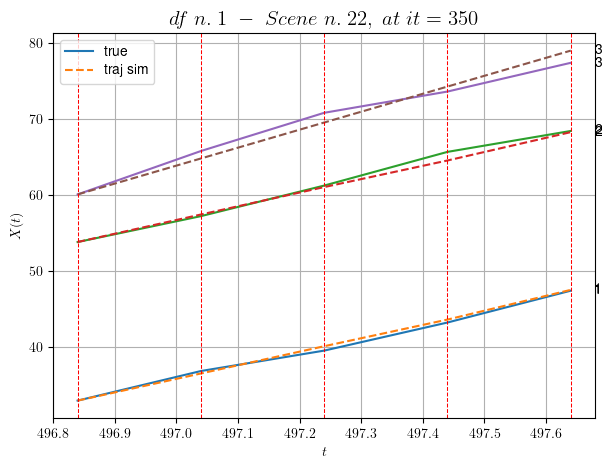

        For scene 22/28
        * use LR_NN=0.001 with err=13.635904152358913 at it=19
        * v0_scn_mean = 24.213501874389145
        * MAE = 0.5058327111938151



            - Time interval n.0: [499.04, 499.24]
                * y_true: [23.84103851 15.32650765]
                * v_ann: [21.69794273376465, 21.542282104492188, 17.83225143987409]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [499.24, 499.44]
                * y_true: [26.92142921 19.88726092]
                * v_ann: [21.281108856201172, 21.38272476196289, 17.83225143987409]

----------------------------------------------------------------------------------------------------
            * err= 0.7626593947131085
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0009646346345650869


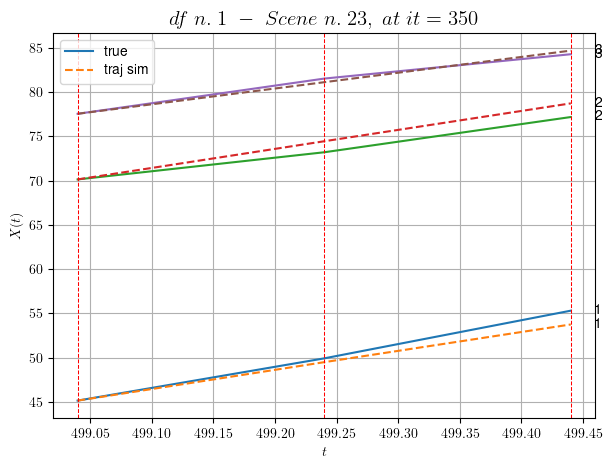

        For scene 23/28
        * use LR_NN=0.0001 with err=5.151124679790102 at it=19
        * v0_scn_mean = 18.875113099080316
        * MAE = 0.6504461329889398



        For scene 24/28
        * use LR_NN=0.0001 with err=10.452493680934827 at it=19
        * v0_scn_mean = 14.477563694580484
        * MAE = 0.027173220324467274



            - Time interval n.0: [502.24, 502.44]
                * y_true: [20.97545504 14.04040867]
                * v_ann: [16.670854568481445, 17.575937271118164, 15.581120912086643]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [502.44, 502.64]
                * y_true: [18.07559412 14.7904947 ]
                * v_ann: [16.987184524536133, 17.682100296020508, 15.581120912086643]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [502.64, 502.84]
                * y_true: [18.0

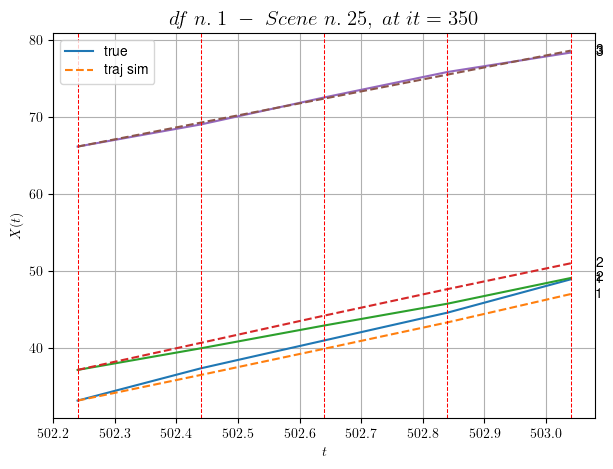

        For scene 25/28
        * use LR_NN=0.001 with err=36.628784137348646 at it=19
        * v0_scn_mean = 16.816920295613517
        * MAE = 1.1209702091180083



            - Time interval n.0: [534.84, 535.04]
                * y_true: [ 8.93323515 20.37071651]
                * v_ann: [16.80109214782715, 17.45479965209961, 29.753484139131494]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.04, 535.24]
                * y_true: [ 8.47527286 31.64140498]
                * v_ann: [16.493385314941406, 18.016971588134766, 29.753484139131494]

----------------------------------------------------------------------------------------------------
            * err= 2.6622197260772587
            * Learning rate NN = 7.289998848136747e-06
            * diff = 0.005403501422811985


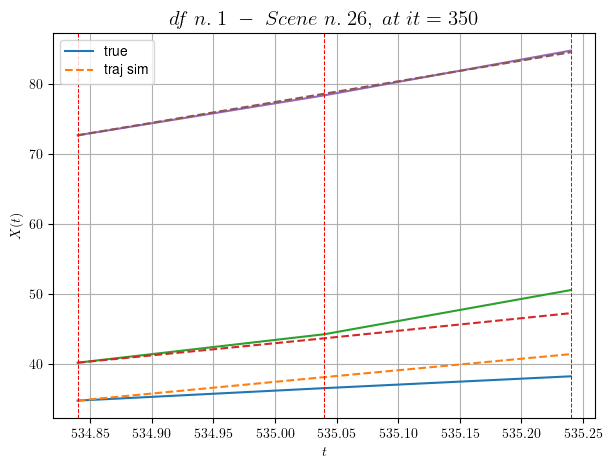

        For scene 26/28
        * use LR_NN=1e-05 with err=1.2170549619136424 at it=19
        * v0_scn_mean = 29.774612282797335
        * MAE = 2.097396664442259



            - Time interval n.0: [573.84, 574.04]
                * y_true: [20.07571717 13.74586409]
                * v_ann: [13.681988716125488, 14.243513107299805, 9.3388689558502]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [574.04, 574.24]
                * y_true: [13.45064024 11.92582032]
                * v_ann: [13.99129581451416, 14.060551643371582, 9.3388689558502]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.24, 574.44]
                * y_true: [13.45064024 11.00083908]
                * v_ann: [14.012529373168945, 13.865221977233887, 9.3388689558502]

--------------------------------------------------------------------------

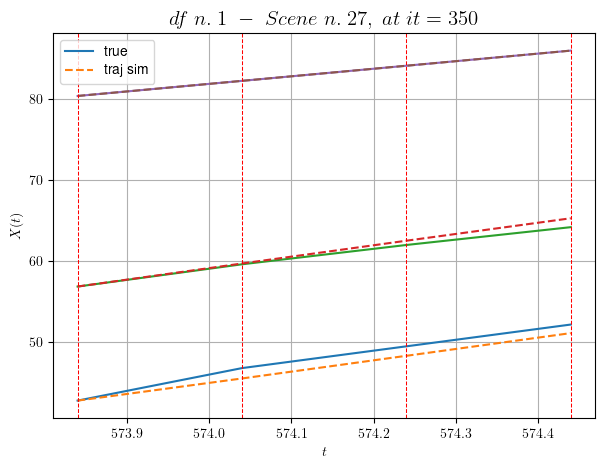

        For scene 27/28
        * use LR_NN=5e-05 with err=22.446657274570672 at it=19
        * v0_scn_mean = 11.109673250112769
        * MAE = 0.40715607266308257



For df=1 with 28 scenes, time taken:        256.69
------------------------------------------------------------
****************************************************************************************************
In df n.2/10 we have 18 scenes
****************************************************************************************************
            - Time interval n.0: [86.16, 86.36]
                * y_true: [16.74023073 23.1409288 ]
                * v_ann: [18.414236068725586, 18.414207458496094, 16.235429521340045]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [19.40034801 15.51071286]
                * v_ann: [18.60247802734375, 18.402667999267578, 16.235429521340045]

------------

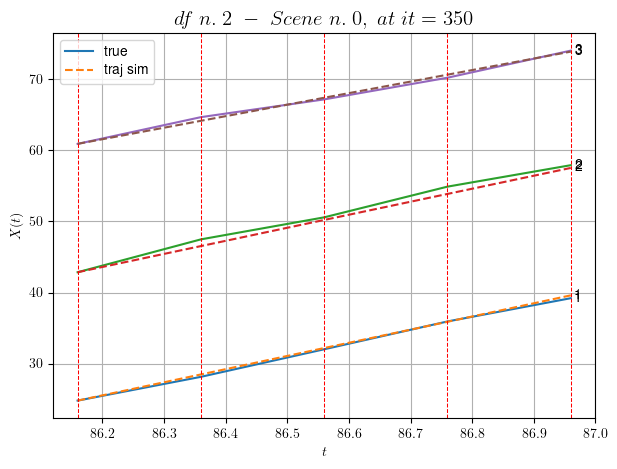

        For scene 0/18
        * use LR_NN=5e-05 with err=15.81935885936477 at it=19
        * v0_scn_mean = 17.41515005358985
        * MAE = 0.2038801199675305



            - Time interval n.0: [109.36, 109.56]
                * y_true: [28.77160952 15.03115545]
                * v_ann: [22.340652465820312, 22.771595001220703, 20.033930717995407]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.56, 109.76]
                * y_true: [23.64157457 15.83133823]
                * v_ann: [22.307891845703125, 22.618314743041992, 20.033930717995407]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.76, 109.96]
                * y_true: [24.63196009 20.68195399]
                * v_ann: [22.006641387939453, 22.12303352355957, 20.033930717995407]

-------------------------------------------------------------------

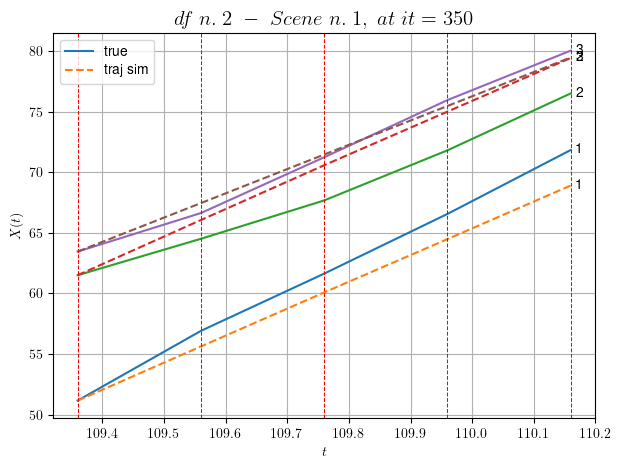

        For scene 1/18
        * use LR_NN=0.0005 with err=11.30848536494569 at it=19
        * v0_scn_mean = 20.888092972897137
        * MAE = 3.1912759513221225



            - Time interval n.0: [170.36, 170.56]
                * y_true: [25.3307413  19.52081588]
                * v_ann: [22.760536193847656, 26.321142196655273, 16.15170945762333]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [29.74113537 17.1608437 ]
                * v_ann: [22.809438705444336, 23.931350708007812, 16.15170945762333]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [170.76, 170.96]
                * y_true: [24.43113316 23.6413756 ]
                * v_ann: [25.437456130981445, 23.345020294189453, 16.15170945762333]

-------------------------------------------------------------------

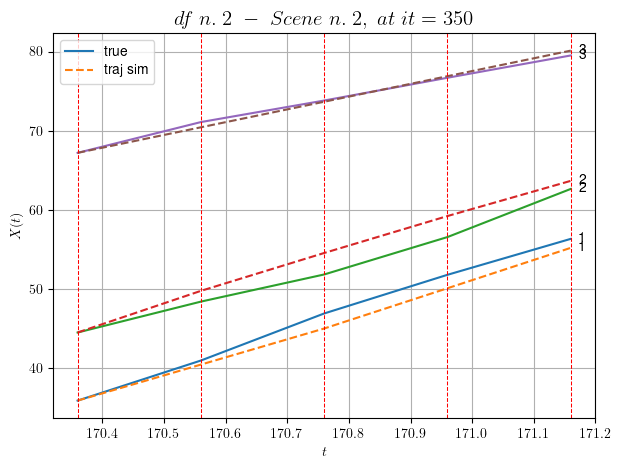

        For scene 2/18
        * use LR_NN=0.001 with err=39.50598421339057 at it=19
        * v0_scn_mean = 17.338605388356036
        * MAE = 1.748648220691912



            - Time interval n.0: [179.36, 179.56]
                * y_true: [10.36002857 23.43048282]
                * v_ann: [15.174501419067383, 18.487085342407227, 22.08205674402131]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [179.56, 179.76]
                * y_true: [10.37004005 22.87060641]
                * v_ann: [15.891209602355957, 18.160430908203125, 22.08205674402131]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [179.76, 179.96]
                * y_true: [15.39008451 20.81068862]
                * v_ann: [16.537031173706055, 18.161705017089844, 22.08205674402131]

---------------------------------------------------------------------

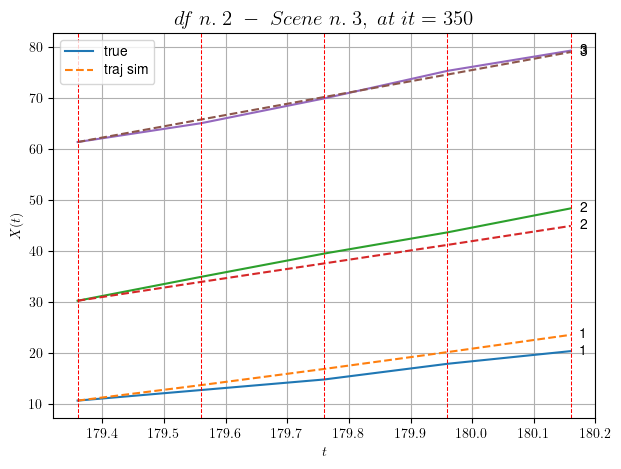

        For scene 3/18
        * use LR_NN=0.0001 with err=5.853135224848707 at it=19
        * v0_scn_mean = 22.760680188664754
        * MAE = 2.7267232836916704



        For scene 4/18
        * use LR_NN=0.001 with err=10.178737750125755 at it=19
        * v0_scn_mean = 16.422367386116626
        * MAE = 0.005498948918908967



            - Time interval n.0: [212.56, 212.76]
                * y_true: [14.43013055 12.85042103]
                * v_ann: [14.560511589050293, 17.67108726501465, 20.507203914762993]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [212.76, 212.96]
                * y_true: [10.79011916 33.80137312]
                * v_ann: [14.351775169372559, 18.518001556396484, 20.507203914762993]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [212.96, 213.16]
                * y_true: [16.24022

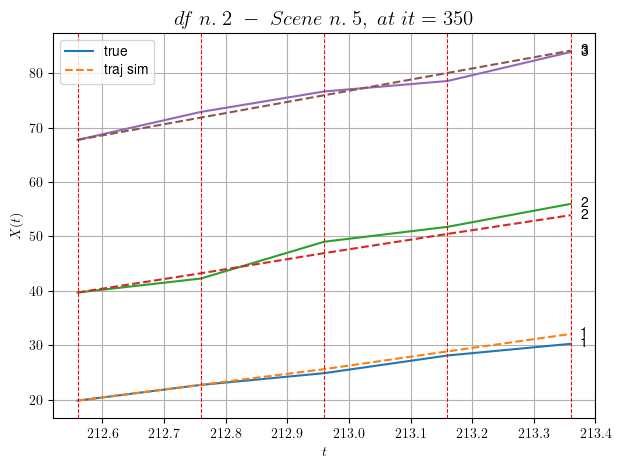

        For scene 5/18
        * use LR_NN=5e-05 with err=8.83132563470521 at it=19
        * v0_scn_mean = 21.320803326933294
        * MAE = 1.2849118431528437



            - Time interval n.0: [318.16, 318.36]
                * y_true: [13.01007537 20.36054455]
                * v_ann: [14.674943923950195, 18.197132110595703, 20.35526732088682]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [318.36, 318.56]
                * y_true: [14.27010639 20.89068863]
                * v_ann: [15.178363800048828, 18.37958335876465, 20.35526732088682]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.56, 318.76]
                * y_true: [12.16011799 21.20084683]
                * v_ann: [15.663729667663574, 18.281288146972656, 20.35526732088682]

----------------------------------------------------------------------

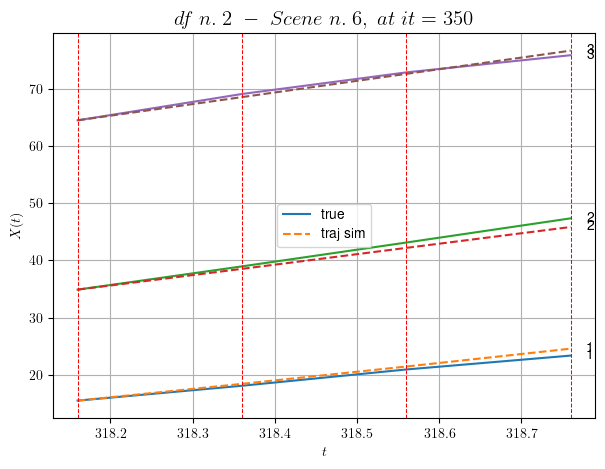

        For scene 6/18
        * use LR_NN=5e-05 with err=4.9587346471989955 at it=19
        * v0_scn_mean = 21.181888768119666
        * MAE = 0.4892757918947916



            - Time interval n.0: [430.16, 430.36]
                * y_true: [15.83005748 20.27065425]
                * v_ann: [18.770217895507812, 18.440711975097656, 21.236966061390955]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [430.36, 430.56]
                * y_true: [19.99011659 24.33092793]
                * v_ann: [19.10576629638672, 18.989953994750977, 21.236966061390955]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [430.56, 430.76]
                * y_true: [14.67011767 20.05093433]
                * v_ann: [19.643190383911133, 18.46299171447754, 21.236966061390955]

------------------------------------------------------------------

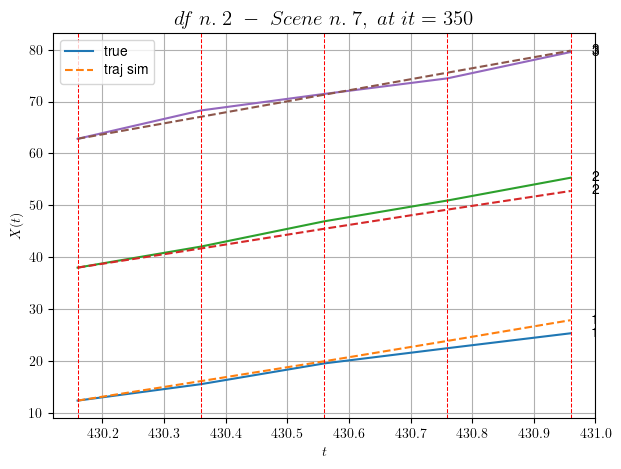

        For scene 7/18
        * use LR_NN=5e-05 with err=8.625481676308079 at it=19
        * v0_scn_mean = 21.98801972326914
        * MAE = 1.5620664336567234



            - Time interval n.0: [435.96, 436.16]
                * y_true: [15.85107698 23.95169404]
                * v_ann: [19.846843719482422, 22.90180015563965, 21.458777210396583]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [436.16, 436.36]
                * y_true: [18.0813972  25.19206379]
                * v_ann: [21.694835662841797, 18.1392822265625, 21.458777210396583]

----------------------------------------------------------------------------------------------------
            * err= 0.6281514449072642
            * Learning rate NN = 0.0036449995823204517
            * diff = 0.0005685154437110596


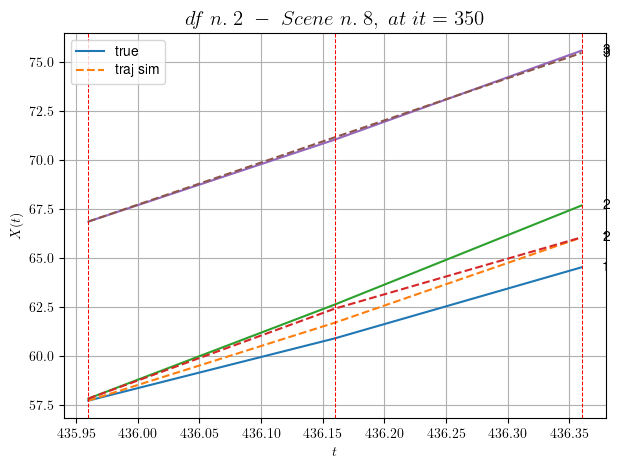

        For scene 8/18
        * use LR_NN=0.005 with err=2.4744620696983373 at it=19
        * v0_scn_mean = 22.19082009622713
        * MAE = 0.6281514449072642



            - Time interval n.0: [442.76, 442.96]
                * y_true: [18.06141662 13.31057742]
                * v_ann: [21.606395721435547, 17.32643699645996, 22.775949002662195]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [442.96, 443.16]
                * y_true: [20.34015276 11.01053508]
                * v_ann: [20.12200164794922, 16.62427520751953, 22.775949002662195]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [443.16, 443.36]
                * y_true: [26.42894929 13.47072378]
                * v_ann: [18.911466598510742, 16.54416847229004, 22.775949002662195]

---------------------------------------------------------------------

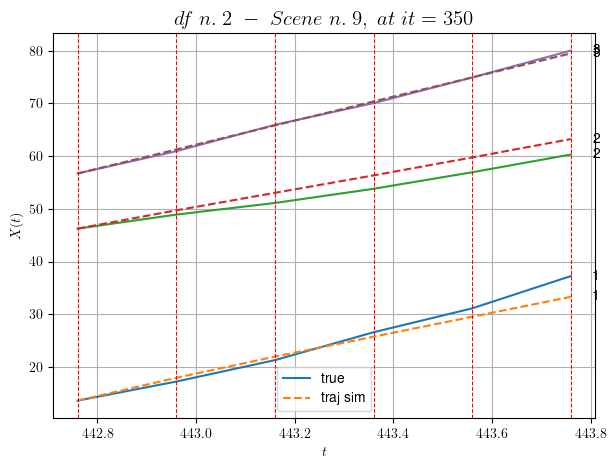

        For scene 9/18
        * use LR_NN=0.0001 with err=8.211099141580478 at it=19
        * v0_scn_mean = 23.395100998780844
        * MAE = 1.6367792635110805



            - Time interval n.0: [487.56, 487.76]
                * y_true: [22.90018755 16.61065196]
                * v_ann: [21.3170166015625, 20.219572067260742, 21.11196447190883]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.76, 487.96]
                * y_true: [21.00025249 21.71102285]
                * v_ann: [20.53611946105957, 20.004581451416016, 21.11196447190883]

----------------------------------------------------------------------------------------------------
            * err= 0.11675830525337709
            * Learning rate NN = 7.289998757187277e-05
            * diff = 2.4841711262324484e-05


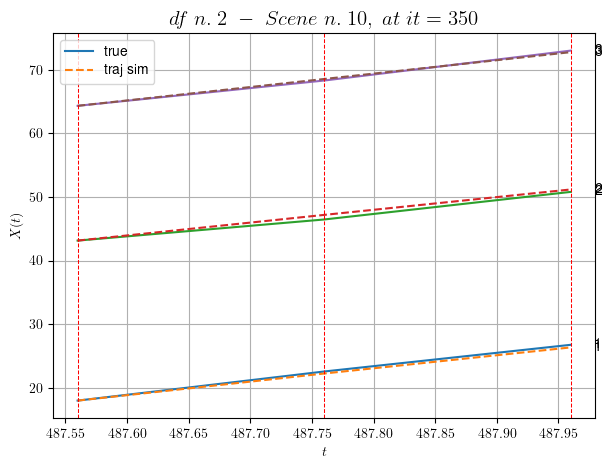

        For scene 10/18
        * use LR_NN=0.0001 with err=1.6982006608689495 at it=19
        * v0_scn_mean = 21.873731649468894
        * MAE = 0.11562866809336925



        For scene 11/18
        * use LR_NN=0.001 with err=44.58464570312751 at it=19
        * v0_scn_mean = 19.12051142649833
        * MAE = 1.0178198990900658



            - Time interval n.0: [538.36, 538.56]
                * y_true: [17.69068154 17.20117669]
                * v_ann: [21.495433807373047, 20.607528686523438, 21.51893062774937]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [538.56, 538.76]
                * y_true: [18.89091077 18.60142936]
                * v_ann: [19.932144165039062, 19.940237045288086, 21.51893062774937]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [538.76, 538.96]
                * y_true: [19.151024

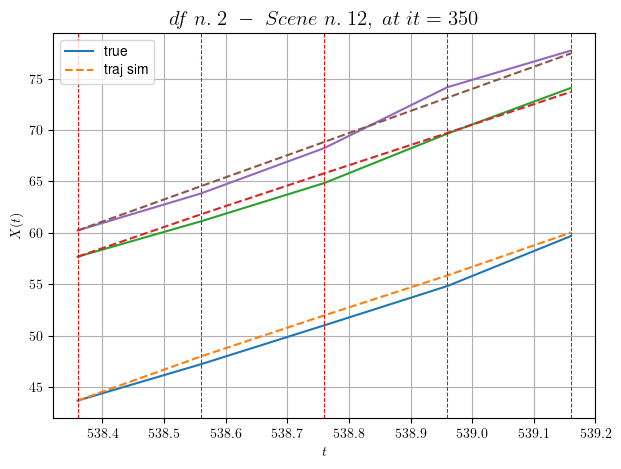

        For scene 12/18
        * use LR_NN=0.001 with err=14.520747172247985 at it=19
        * v0_scn_mean = 22.245817942497307
        * MAE = 0.41297846146431033



            - Time interval n.0: [541.16, 541.36]
                * y_true: [22.67086863 28.23390149]
                * v_ann: [23.810476303100586, 24.71294403076172, 20.490059693195878]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [541.36, 541.56]
                * y_true: [19.45088023 23.11862329]
                * v_ann: [23.745708465576172, 23.835309982299805, 20.490059693195878]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [541.56, 541.76]
                * y_true: [24.96136667 24.68114114]
                * v_ann: [23.618375778198242, 23.11260414123535, 20.490059693195878]

----------------------------------------------------------------

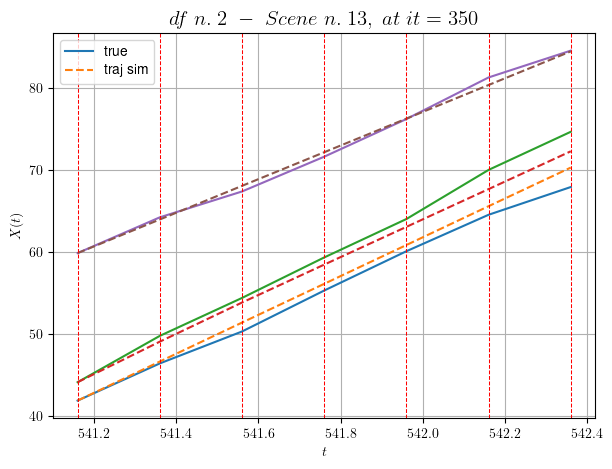

        For scene 13/18
        * use LR_NN=0.0001 with err=43.982369727862185 at it=19
        * v0_scn_mean = 21.305128485774674
        * MAE = 1.1108335875983493



            - Time interval n.0: [549.76, 549.96]
                * y_true: [23.30098965 17.25125335]
                * v_ann: [21.874391555786133, 22.064350128173828, 22.49577375007973]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [549.96, 550.16]
                * y_true: [23.30098965 23.35192881]
                * v_ann: [21.59547233581543, 21.771080017089844, 22.49577375007973]

----------------------------------------------------------------------------------------------------
            * err= 0.2027687779573408
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00025705995856634134


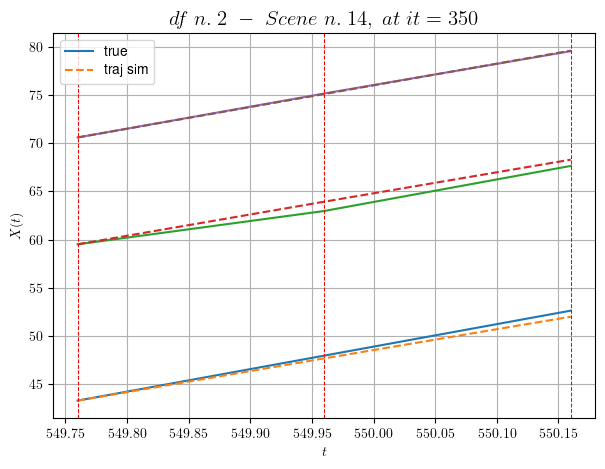

        For scene 14/18
        * use LR_NN=0.0001 with err=1.395420506348378 at it=19
        * v0_scn_mean = 23.138938736550347
        * MAE = 0.16694185835988148



            - Time interval n.0: [566.76, 566.96]
                * y_true: [31.35080123 25.9264585 ]
                * v_ann: [27.511228561401367, 26.101016998291016, 24.22256213825041]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [566.96, 567.16]
                * y_true: [23.95081051 25.9264585 ]
                * v_ann: [27.171405792236328, 26.330488204956055, 24.22256213825041]

----------------------------------------------------------------------------------------------------
            * err= 0.07173537685355076
            * Learning rate NN = 7.289998757187277e-05
            * diff = 1.0942001379271593e-05


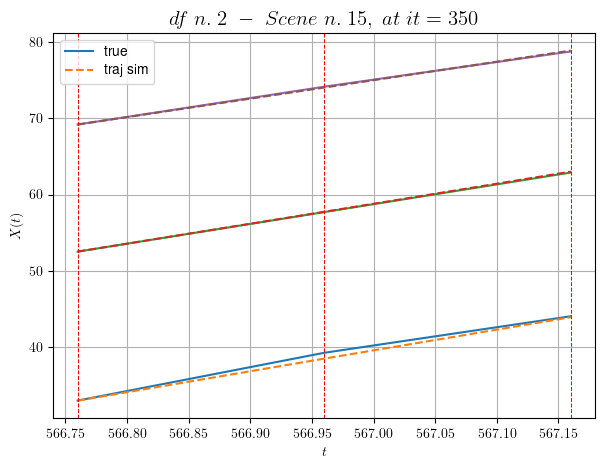

        For scene 15/18
        * use LR_NN=0.0001 with err=0.8363407157236997 at it=19
        * v0_scn_mean = 24.71772921083439
        * MAE = 0.07173537685355076



            - Time interval n.0: [87.56, 87.76]
                * y_true: [20.56019483 17.07029985 18.3510221 ]
                * v_ann: [20.089262008666992, 19.656599044799805, 19.054790496826172, 23.40004168474024]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [87.76, 87.96]
                * y_true: [21.72029145 17.49039467 19.46124504]
                * v_ann: [20.170461654663086, 19.703630447387695, 18.869375228881836, 23.40004168474024]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [87.96, 88.16]
                * y_true: [24.51045762 21.12058621 15.36109554]
                * v_ann: [20.300704956054688, 19.85335922241211, 18.8519649505615

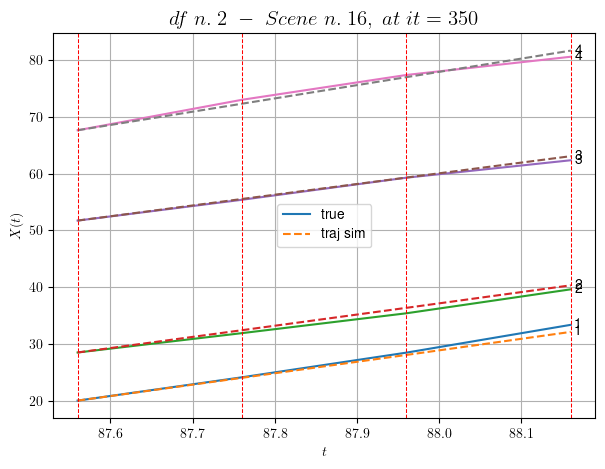

        For scene 16/18
        * use LR_NN=5e-05 with err=9.966393831838543 at it=19
        * v0_scn_mean = 24.153365501346627
        * MAE = 0.34785445573920715



            - Time interval n.0: [305.96, 306.16]
                * y_true: [18.64270885 18.88070057 19.63111636]
                * v_ann: [20.603214263916016, 20.588153839111328, 20.539918899536133, 13.683661586234587]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [306.16, 306.36]
                * y_true: [22.41204338 21.34093202 20.7913521 ]
                * v_ann: [20.074935913085938, 20.002628326416016, 19.791854858398438, 13.683661586234587]

----------------------------------------------------------------------------------------------------
            * err= 0.03488589376044854
            * Learning rate NN = 0.00036449998151510954
            * diff = 1.781449487488207e-06


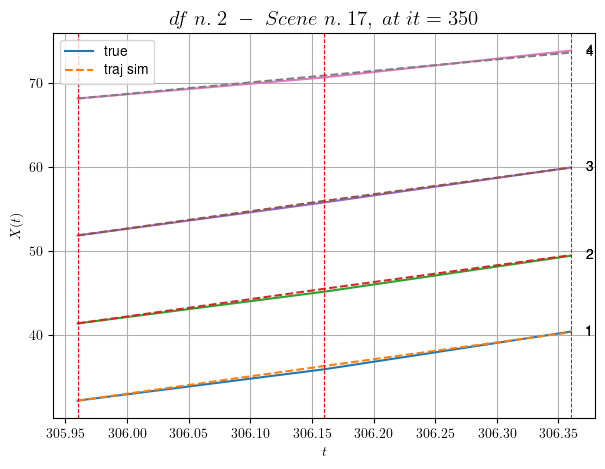

        For scene 17/18
        * use LR_NN=0.0005 with err=5.395699278202143 at it=19
        * v0_scn_mean = 15.546019761812973
        * MAE = 0.034808470499011784



For df=2 with 18 scenes, time taken:        188.41
------------------------------------------------------------
****************************************************************************************************
In df n.3/10 we have 55 scenes
****************************************************************************************************
            - Time interval n.0: [16.16, 16.36]
                * y_true: [27.36596872 40.6089382 ]
                * v_ann: [28.048744201660156, 27.266494750976562, 39.22721511204396]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [16.36, 16.56]
                * y_true: [22.16572117 32.62072047]
                * v_ann: [29.310449600219727, 28.323429107666016, 39.22721511204396]

------------

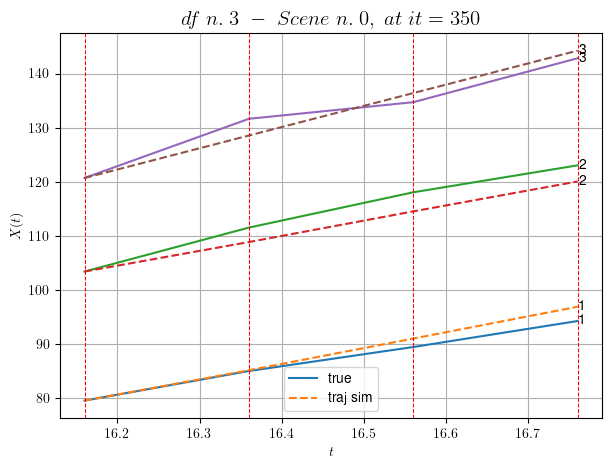

        For scene 0/55
        * use LR_NN=5e-05 with err=13.361026623270396 at it=19
        * v0_scn_mean = 38.43637785780195
        * MAE = 4.353951793819733



            - Time interval n.0: [17.56, 17.76]
                * y_true: [26.87631442 28.75240293]
                * v_ann: [28.793251037597656, 29.521400451660156, 37.341555892655315]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [17.76, 17.96]
                * y_true: [26.32655772 34.05345458]
                * v_ann: [28.49280548095703, 28.669647216796875, 37.341555892655315]

----------------------------------------------------------------------------------------------------
            * err= 0.832967994026598
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0012537492542704642


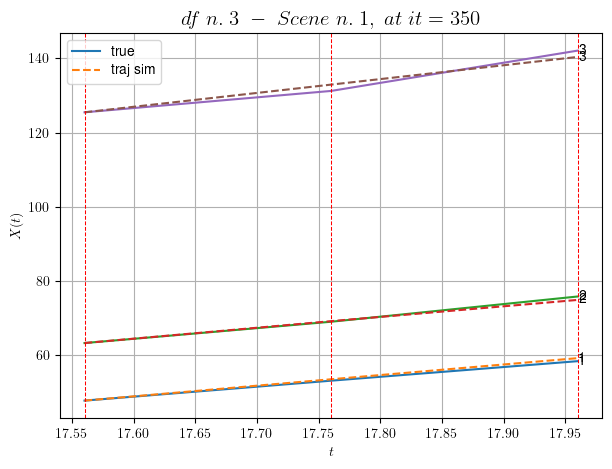

        For scene 1/55
        * use LR_NN=5e-05 with err=9.729200006264632 at it=19
        * v0_scn_mean = 36.71233290028849
        * MAE = 0.7716615097696398



            - Time interval n.0: [23.96, 24.16]
                * y_true: [31.9527567  21.95230333]
                * v_ann: [24.833415985107422, 24.90239715576172, 27.016685910779756]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.16, 24.36]
                * y_true: [26.79271708 14.85171745]
                * v_ann: [26.075809478759766, 27.637378692626953, 27.016685910779756]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.36, 24.56]
                * y_true: [20.5424093  31.65411216]
                * v_ann: [24.97212791442871, 23.207645416259766, 27.016685910779756]

--------------------------------------------------------------------------

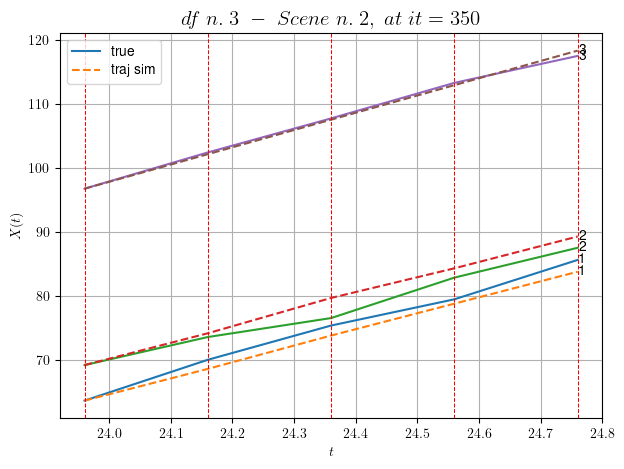

        For scene 2/55
        * use LR_NN=0.001 with err=36.485544404950936 at it=19
        * v0_scn_mean = 27.272376917677487
        * MAE = 1.6522893015905062



            - Time interval n.0: [42.96, 43.16]
                * y_true: [34.44093898 36.40531345]
                * v_ann: [25.164583206176758, 25.16484260559082, 27.35069258451137]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [43.16, 43.36]
                * y_true: [27.09071898 44.10770887]
                * v_ann: [34.052330017089844, 32.04876708984375, 27.35069258451137]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [43.36, 43.56]
                * y_true: [24.51583897 25.2301032 ]
                * v_ann: [38.458961486816406, 30.08537483215332, 27.35069258451137]

----------------------------------------------------------------------------

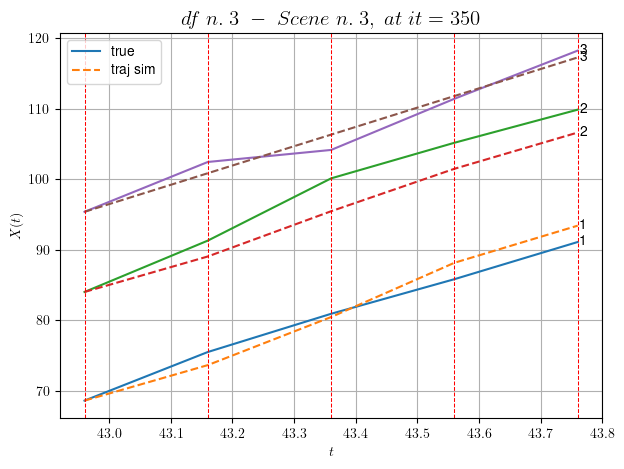

        For scene 3/55
        * use LR_NN=0.001 with err=21.867979002337098 at it=19
        * v0_scn_mean = 27.57775686952768
        * MAE = 4.29173008188292



            - Time interval n.0: [61.76, 61.96]
                * y_true: [28.79377133  7.10177762]
                * v_ann: [31.65740394592285, 30.2014217376709, 27.830106096169654]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [61.96, 62.16]
                * y_true: [41.29768472 31.64601894]
                * v_ann: [19.849515914916992, 22.407230377197266, 27.830106096169654]

----------------------------------------------------------------------------------------------------
            * err= 5.735607087156031
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.001449748599624101


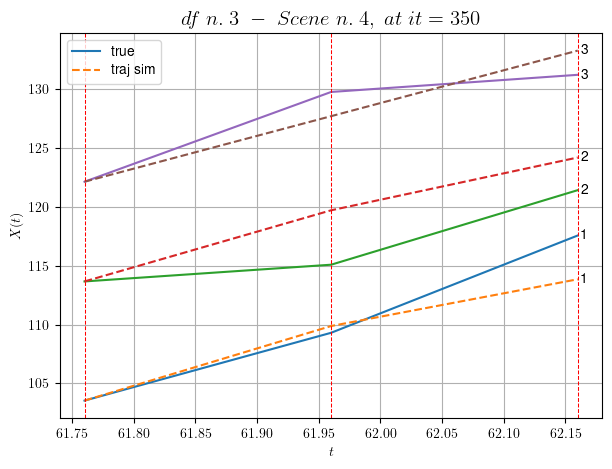

        For scene 4/55
        * use LR_NN=0.001 with err=7.304374593595186 at it=19
        * v0_scn_mean = 28.016081270267517
        * MAE = 5.549247779151273



            - Time interval n.0: [63.76, 63.96]
                * y_true: [39.33120973 30.97229006]
                * v_ann: [30.517738342285156, 28.51445198059082, 33.83985492803379]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [63.96, 64.16]
                * y_true: [32.2308074  22.86038312]
                * v_ann: [33.975276947021484, 30.869537353515625, 33.83985492803379]

----------------------------------------------------------------------------------------------------
            * err= 1.0226880377283867
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0049658066815616575


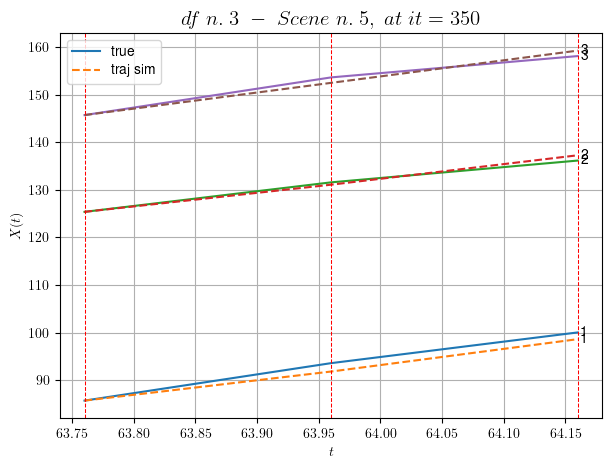

        For scene 5/55
        * use LR_NN=0.0001 with err=1.9465704489023041 at it=19
        * v0_scn_mean = 33.51075234495746
        * MAE = 0.6115360269584328



        For scene 6/55
        * use LR_NN=0.0005 with err=4.112349405209885 at it=19
        * v0_scn_mean = 31.950559826831626
        * MAE = 4.64490111920129



            - Time interval n.0: [72.76, 72.96]
                * y_true: [28.501496   30.93407752]
                * v_ann: [32.75737762451172, 29.795425415039062, 28.121253838742764]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.96, 73.16]
                * y_true: [36.65243351 31.9148258 ]
                * v_ann: [32.03829574584961, 28.90294075012207, 28.121253838742764]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [73.16, 73.36]
                * y_true: [27.70226144 28.33497

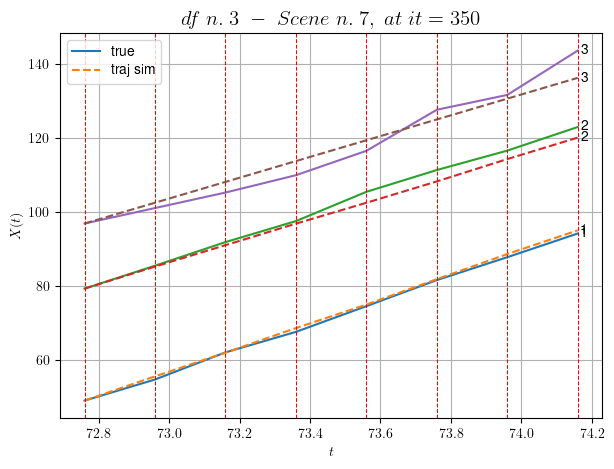

        For scene 7/55
        * use LR_NN=0.0001 with err=50.49119882128681 at it=19
        * v0_scn_mean = 28.282275602898533
        * MAE = 5.474655644058365



            - Time interval n.0: [82.16, 82.36]
                * y_true: [30.54468004 23.04450554]
                * v_ann: [28.90880584716797, 31.91478157043457, 27.550255115280457]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [82.36, 82.56]
                * y_true: [22.71402344 43.65971655]
                * v_ann: [26.315135955810547, 27.34038543701172, 27.550255115280457]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.56, 82.76]
                * y_true: [35.61686857 24.88594316]
                * v_ann: [31.09992027282715, 33.126609802246094, 27.550255115280457]

---------------------------------------------------------------------------

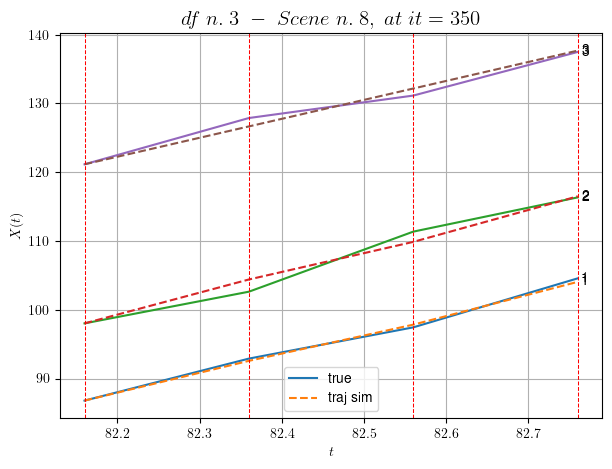

        For scene 8/55
        * use LR_NN=0.0005 with err=7.422936251527934 at it=19
        * v0_scn_mean = 27.760215487364636
        * MAE = 0.7070356722459349



            - Time interval n.0: [86.16, 86.36]
                * y_true: [27.89181051 25.45740923]
                * v_ann: [29.158720016479492, 31.686452865600586, 35.764694958435065]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [36.25627338 46.92477715]
                * v_ann: [28.74485969543457, 30.84695816040039, 35.764694958435065]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [86.56, 86.76]
                * y_true: [29.50579063 21.07714474]
                * v_ann: [29.959199905395508, 33.236812591552734, 35.764694958435065]

------------------------------------------------------------------------

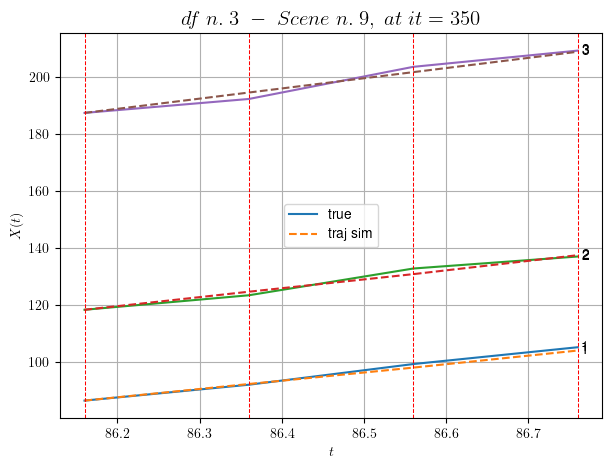

        For scene 9/55
        * use LR_NN=1e-05 with err=13.756993865430431 at it=19
        * v0_scn_mean = 35.27062004231872
        * MAE = 1.4446525193855593



            - Time interval n.0: [130.96, 131.16]
                * y_true: [15.85249734 39.95916833]
                * v_ann: [32.83820343017578, 31.172481536865234, 31.75232522302462]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.16, 131.36]
                * y_true: [19.2732587 14.0236874]
                * v_ann: [34.78976058959961, 28.814334869384766, 31.75232522302462]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [131.36, 131.56]
                * y_true: [20.77382027 41.90201833]
                * v_ann: [32.3190803527832, 28.757368087768555, 31.75232522302462]

--------------------------------------------------------------------------

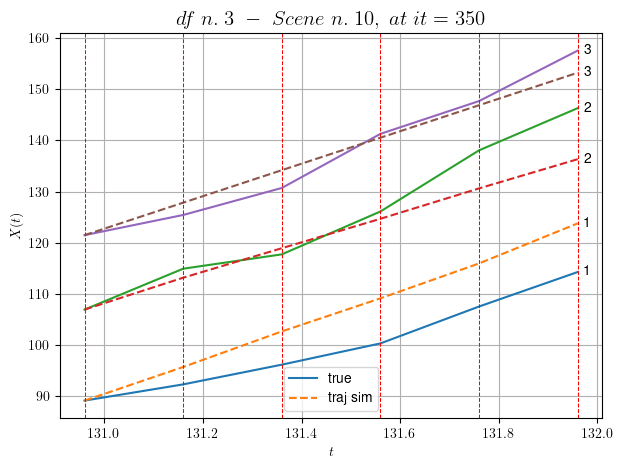

        For scene 10/55
        * use LR_NN=0.0001 with err=58.08182832521323 at it=19
        * v0_scn_mean = 31.602138622724556
        * MAE = 20.94276895763026



            - Time interval n.0: [139.16, 139.36]
                * y_true: [22.50033849 31.62238978]
                * v_ann: [26.650482177734375, 27.907690048217773, 28.144643973847373]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.36, 139.56]
                * y_true: [29.90063418 17.15160439]
                * v_ann: [27.371572494506836, 27.638675689697266, 28.144643973847373]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [139.56, 139.76]
                * y_true: [27.10078793 37.57385655]
                * v_ann: [25.944368362426758, 27.62425422668457, 28.144643973847373]

-----------------------------------------------------------------

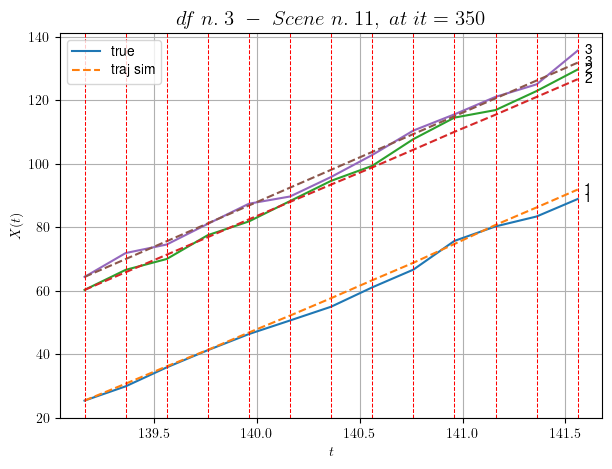

        For scene 11/55
        * use LR_NN=0.0005 with err=360.5982868046655 at it=19
        * v0_scn_mean = 28.30366103886056
        * MAE = 2.733962242012297



            - Time interval n.0: [143.76, 143.96]
                * y_true: [30.62207823 41.7261053 ]
                * v_ann: [28.892066955566406, 26.751686096191406, 29.414748692204874]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [143.96, 144.16]
                * y_true: [21.21173425 33.31570327]
                * v_ann: [39.41748046875, 31.40980339050293, 29.414748692204874]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [144.16, 144.36]
                * y_true: [29.72284222 27.36558717]
                * v_ann: [27.577239990234375, 24.871374130249023, 29.414748692204874]

----------------------------------------------------------------------

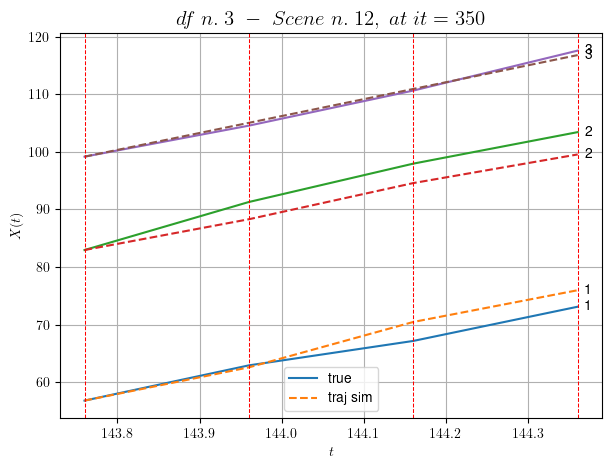

        For scene 12/55
        * use LR_NN=0.0005 with err=17.39191509340238 at it=19
        * v0_scn_mean = 29.46490884688656
        * MAE = 4.624773338331



            - Time interval n.0: [149.36, 149.56]
                * y_true: [25.90049539 27.45094024]
                * v_ann: [26.557876586914062, 29.86421775817871, 23.443602704289308]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [149.56, 149.76]
                * y_true: [21.18057417 22.42095425]
                * v_ann: [26.28774070739746, 27.76011848449707, 23.443602704289308]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [149.76, 149.96]
                * y_true: [37.02126181 27.98148311]
                * v_ann: [25.709930419921875, 23.842557907104492, 23.443602704289308]

-----------------------------------------------------------------------

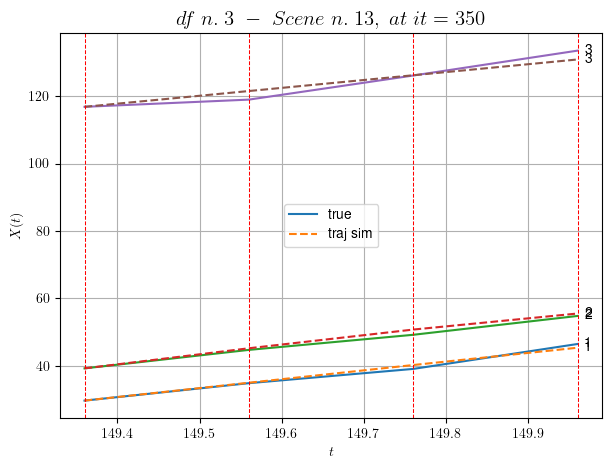

        For scene 13/55
        * use LR_NN=5e-05 with err=27.9113339860794 at it=19
        * v0_scn_mean = 24.00553208082386
        * MAE = 1.5937763056583047



            - Time interval n.0: [156.16, 156.36]
                * y_true: [12.56997445 35.72646923]
                * v_ann: [27.586942672729492, 29.636802673339844, 36.779567918369196]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [156.36, 156.56]
                * y_true: [42.07610638 31.26485338]
                * v_ann: [29.628578186035156, 29.42110252380371, 36.779567918369196]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [156.56, 156.76]
                * y_true: [30.09491831 26.35466702]
                * v_ann: [31.275373458862305, 30.762439727783203, 36.779567918369196]

-------------------------------------------------------------------

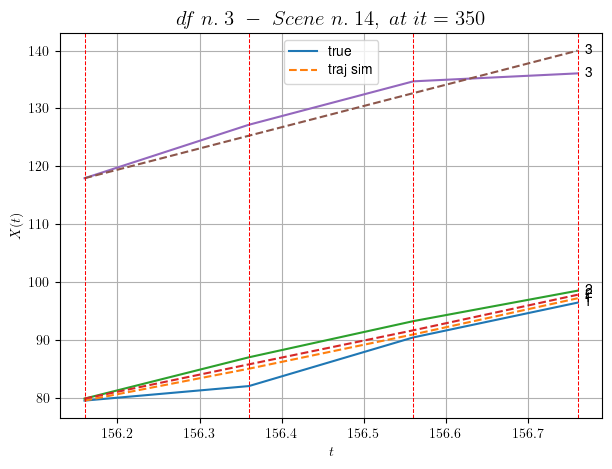

        For scene 14/55
        * use LR_NN=5e-05 with err=31.819256956355474 at it=19
        * v0_scn_mean = 36.19851124933002
        * MAE = 3.1329954933777664



            - Time interval n.0: [207.96, 208.16]
                * y_true: [30.12104774 28.85226703]
                * v_ann: [32.10042953491211, 31.405033111572266, 31.12490151678249]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [208.16, 208.36]
                * y_true: [31.19139939 27.73265496]
                * v_ann: [28.987049102783203, 29.319673538208008, 31.12490151678249]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [208.36, 208.56]
                * y_true: [31.59181924 26.81292648]
                * v_ann: [29.257877349853516, 29.3167667388916, 31.12490151678249]

----------------------------------------------------------------------

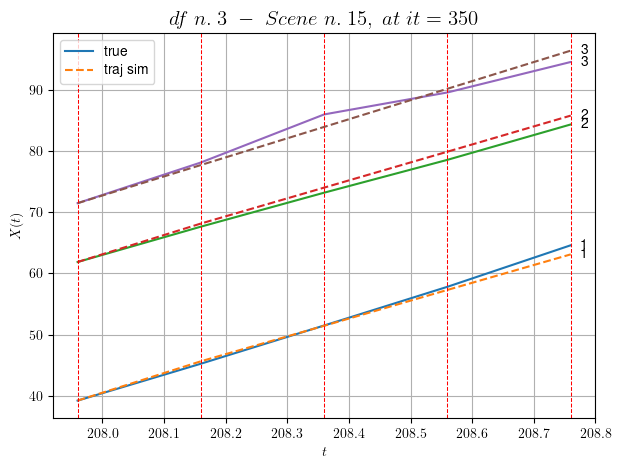

        For scene 15/55
        * use LR_NN=0.001 with err=9.823748582783283 at it=19
        * v0_scn_mean = 31.028489542419443
        * MAE = 0.80841803822172



            - Time interval n.0: [218.16, 218.36]
                * y_true: [26.47083003 31.40159485]
                * v_ann: [31.401954650878906, 31.341880798339844, 31.946911515105928]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [218.36, 218.56]
                * y_true: [32.09751616 29.50187244]
                * v_ann: [30.883285522460938, 30.9345645904541, 31.946911515105928]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [218.56, 218.76]
                * y_true: [31.61167285 38.50305628]
                * v_ann: [31.045743942260742, 31.284549713134766, 31.946911515105928]

--------------------------------------------------------------------

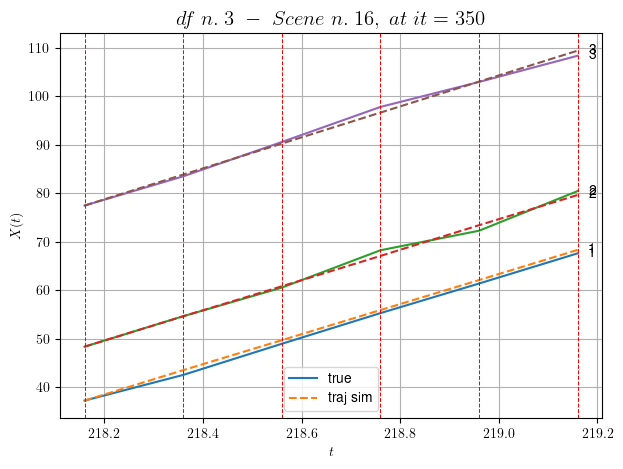

        For scene 16/55
        * use LR_NN=0.0001 with err=31.260698777664672 at it=19
        * v0_scn_mean = 31.78004750054028
        * MAE = 0.4728173049382369



            - Time interval n.0: [222.96, 223.16]
                * y_true: [37.21103813 39.71315438]
                * v_ann: [35.15695571899414, 34.52184295654297, 31.27974144015392]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.16, 223.36]
                * y_true: [31.35126998 28.99272163]
                * v_ann: [36.12613296508789, 35.028404235839844, 31.27974144015392]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.36, 223.56]
                * y_true: [33.72173898 31.78369531]
                * v_ann: [34.7490234375, 34.088233947753906, 31.27974144015392]

--------------------------------------------------------------------------

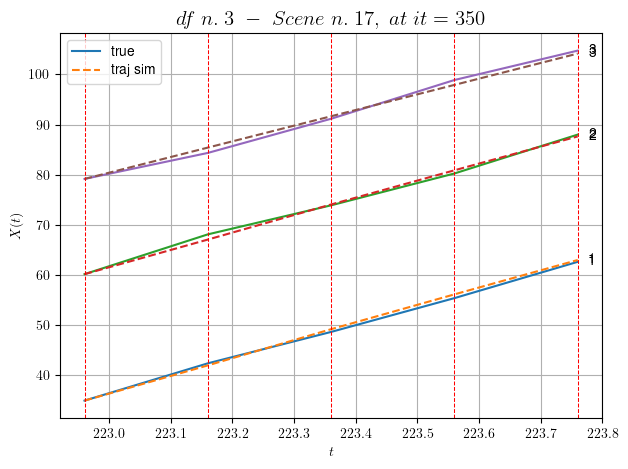

        For scene 17/55
        * use LR_NN=0.0001 with err=6.006039156063275 at it=19
        * v0_scn_mean = 31.170058594963646
        * MAE = 0.3653723037260908



            - Time interval n.0: [247.36, 247.56]
                * y_true: [24.34113117 25.37248976]
                * v_ann: [29.445419311523438, 26.959312438964844, 29.199550876740787]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [247.56, 247.76]
                * y_true: [20.86113385 27.00305492]
                * v_ann: [27.4304141998291, 25.751922607421875, 29.199550876740787]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [247.76, 247.96]
                * y_true: [25.44173909 29.15378269]
                * v_ann: [26.53580665588379, 26.784954071044922, 29.199550876740787]

------------------------------------------------------------------

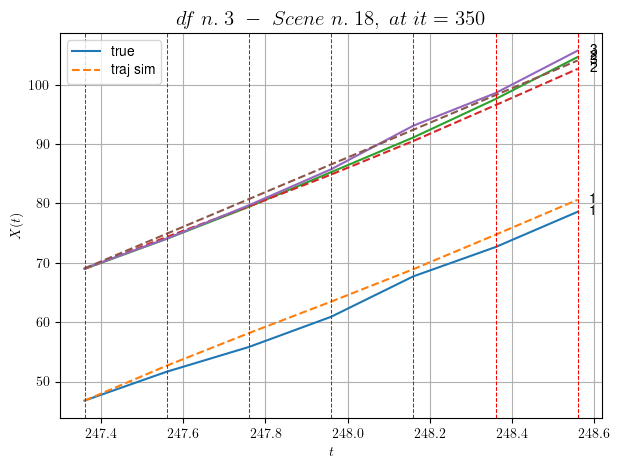

        For scene 18/55
        * use LR_NN=0.001 with err=34.07161873036943 at it=19
        * v0_scn_mean = 29.26815499825643
        * MAE = 1.4230662193970784



            - Time interval n.0: [269.56, 269.76]
                * y_true: [27.75027124 32.18076388]
                * v_ann: [27.89230728149414, 30.466455459594727, 30.539171773719296]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [269.76, 269.96]
                * y_true: [33.80053503 32.77104018]
                * v_ann: [28.274188995361328, 29.90233612060547, 30.539171773719296]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [269.96, 270.16]
                * y_true: [22.10049768 29.95131945]
                * v_ann: [28.397201538085938, 30.420116424560547, 30.539171773719296]

-------------------------------------------------------------------

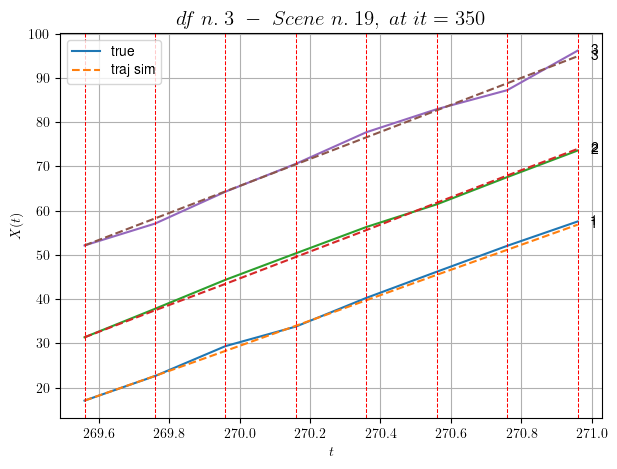

        For scene 19/55
        * use LR_NN=0.0001 with err=6.100852659714061 at it=19
        * v0_scn_mean = 30.49296095930631
        * MAE = 0.5266866069543878



            - Time interval n.0: [316.16, 316.36]
                * y_true: [33.9635286 19.3731464]
                * v_ann: [27.179365158081055, 27.25463104248047, 31.11972321626033]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.36, 316.56]
                * y_true: [24.60296417 29.75560281]
                * v_ann: [26.659238815307617, 26.566057205200195, 31.11972321626033]

----------------------------------------------------------------------------------------------------
            * err= 0.7399705147194581
            * Learning rate NN = 0.00036449998151510954
            * diff = 8.204162098746082e-05


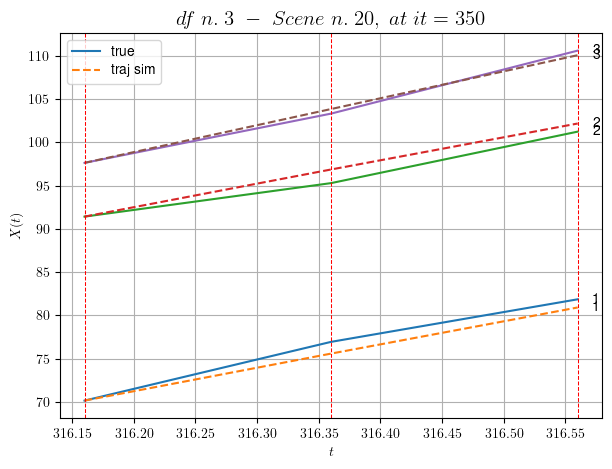

        For scene 20/55
        * use LR_NN=0.0005 with err=3.154545088965621 at it=19
        * v0_scn_mean = 31.023755058685005
        * MAE = 0.7130865791627418



            - Time interval n.0: [317.76, 317.96]
                * y_true: [22.24301013 28.10582296]
                * v_ann: [29.38483238220215, 27.15981674194336, 28.729615682184654]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.96, 318.16]
                * y_true: [28.26433817 33.10585656]
                * v_ann: [27.635560989379883, 29.956056594848633, 28.729615682184654]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.16, 318.36]
                * y_true: [11.28182915 18.67354228]
                * v_ann: [31.757261276245117, 15.090805053710938, 28.729615682184654]

-----------------------------------------------------------------

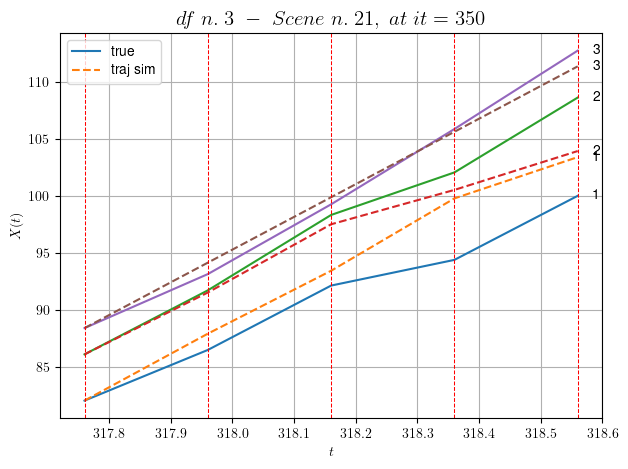

        For scene 21/55
        * use LR_NN=0.005 with err=20.23600493302323 at it=19
        * v0_scn_mean = 28.838496556157494
        * MAE = 2.9867845806004296



            - Time interval n.0: [325.76, 325.96]
                * y_true: [25.31057708 30.22149101]
                * v_ann: [25.674314498901367, 27.491853713989258, 33.135529650132405]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.96, 326.16]
                * y_true: [25.23074384 33.46208613]
                * v_ann: [25.85146141052246, 27.59892463684082, 33.135529650132405]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [326.16, 326.36]
                * y_true: [24.63092838 29.01218385]
                * v_ann: [26.2441349029541, 28.04631996154785, 33.135529650132405]

---------------------------------------------------------------------

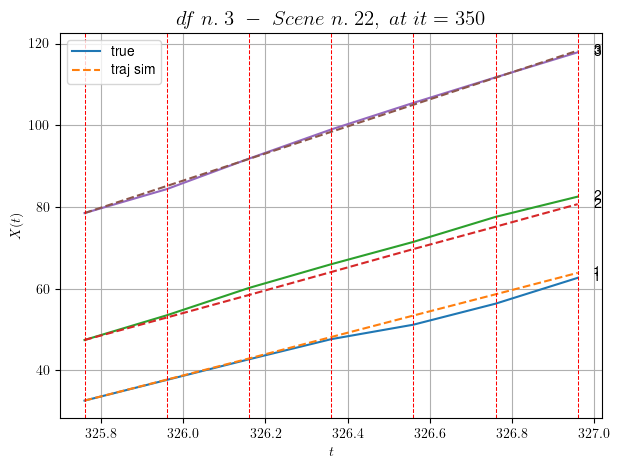

        For scene 22/55
        * use LR_NN=5e-05 with err=11.649947661440473 at it=19
        * v0_scn_mean = 32.86679269873441
        * MAE = 0.8068691122118778



            - Time interval n.0: [335.76, 335.96]
                * y_true: [36.00253797 32.17585284]
                * v_ann: [1.6919425635375674e-36, 1.4123150382744452e-14, 9.495828685169489]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.96, 336.16]
                * y_true: [33.90297107 37.71766361]
                * v_ann: [1.0889268400591404e-35, 3.375516044457072e-08, 9.495828685169489]

----------------------------------------------------------------------------------------------------
            * err= 54.293358694448536
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.548030491629106e-06


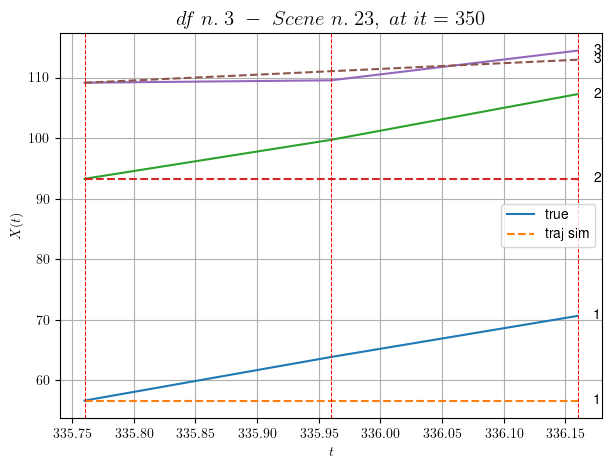

        For scene 23/55
        * use LR_NN=0.0005 with err=17.1173717603529 at it=19
        * v0_scn_mean = 11.253180426321
        * MAE = 12.79050534111922



        For scene 24/55
        * use LR_NN=0.0005 with err=7.638072897937707 at it=19
        * v0_scn_mean = 32.315435713930356
        * MAE = 68.51253873070232



            - Time interval n.0: [387.36, 387.56]
                * y_true: [32.47194771 39.46360823]
                * v_ann: [1.9316246518963354e-11, 1.31540745571456e-27, 33.03187618027038]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [387.56, 387.76]
                * y_true: [28.80212467 26.65295039]
                * v_ann: [6.434708993939553e-13, 1.6468935719543938e-24, 33.03187618027038]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.76, 387.96]
                * y_true: [28

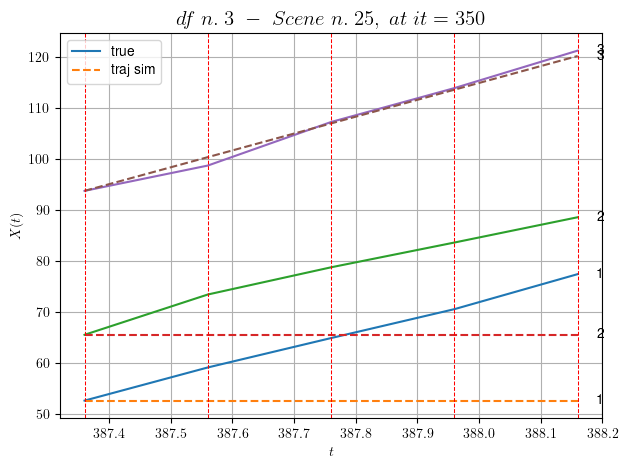

        For scene 25/55
        * use LR_NN=0.0005 with err=15.986962737328701 at it=19
        * v0_scn_mean = 32.77202306050534
        * MAE = 148.36560739267435



            - Time interval n.0: [390.36, 390.56]
                * y_true: [34.37306474 33.21473815]
                * v_ann: [5.325248162912258e-17, 8.462129346580635e-15, 36.35421452147256]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [390.56, 390.76]
                * y_true: [31.79338609 29.7348149 ]
                * v_ann: [9.356231967653416e-17, 5.029395767176337e-17, 36.35421452147256]

----------------------------------------------------------------------------------------------------
            * err= 47.70993068591407
            * Learning rate NN = 7.289998757187277e-05
            * diff = 1.0834298080908411e-06


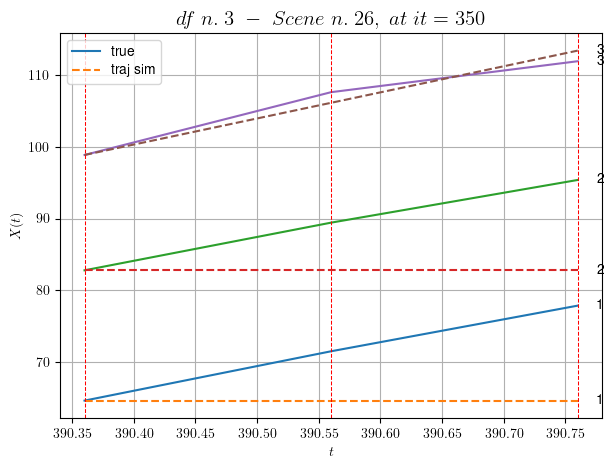

        For scene 26/55
        * use LR_NN=0.0001 with err=1.0581486439763468 at it=19
        * v0_scn_mean = 35.809613631169675
        * MAE = 47.66132784125852



            - Time interval n.0: [427.96, 428.16]
                * y_true: [33.16108667 24.70091575]
                * v_ann: [26.337745666503906, 2.8627004944001506e-22, 37.349803066652754]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [428.16, 428.36]
                * y_true: [36.08159054 35.68166414]
                * v_ann: [39.290428161621094, 1.1548574975915505e-23, 37.349803066652754]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [428.36, 428.56]
                * y_true: [27.64533545 36.4184567 ]
                * v_ann: [36.953495025634766, 1.538135665812766e-23, 37.349803066652754]

----------------------------------------------------

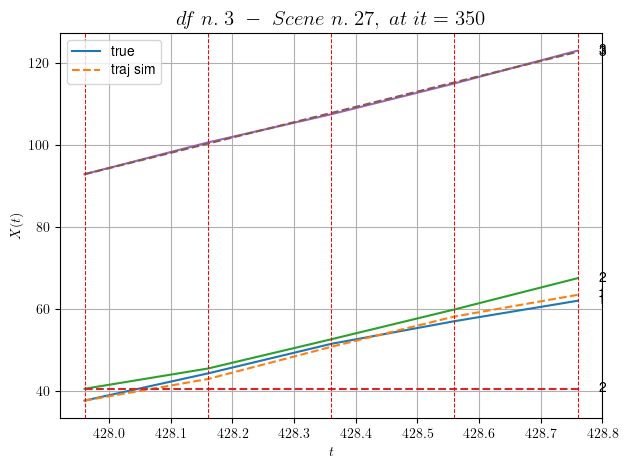

        For scene 27/55
        * use LR_NN=5e-05 with err=75.50540221542354 at it=19
        * v0_scn_mean = 36.719873233450066
        * MAE = 85.32521364760635



            - Time interval n.0: [439.36, 439.56]
                * y_true: [29.12388438 22.06331107]
                * v_ann: [23.89521026611328, 23.781688690185547, 33.536353019452505]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [439.56, 439.76]
                * y_true: [38.07606081 22.99369197]
                * v_ann: [22.499935150146484, 26.993776321411133, 33.536353019452505]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [439.76, 439.96]
                * y_true: [23.98424021 18.65338098]
                * v_ann: [27.71940040588379, 29.04922103881836, 33.536353019452505]

--------------------------------------------------------------------

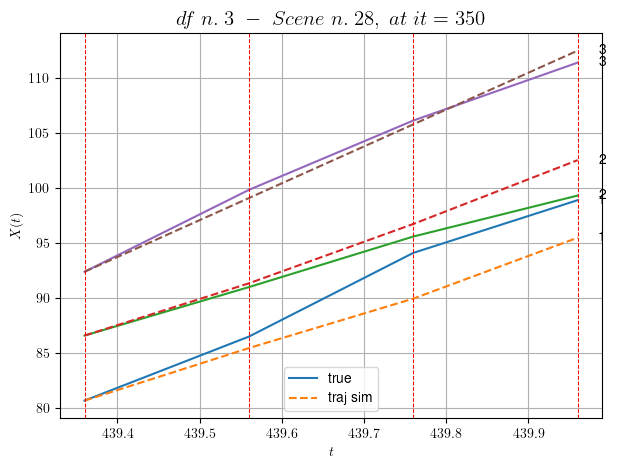

        For scene 28/55
        * use LR_NN=0.0001 with err=13.717467615668438 at it=19
        * v0_scn_mean = 33.2332626852644
        * MAE = 1.7954067331741614



            - Time interval n.0: [448.36, 448.56]
                * y_true: [32.70350359 27.85524745]
                * v_ann: [34.66340255737305, 29.79970359802246, 31.585036733085307]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [448.56, 448.76]
                * y_true: [39.76511656 28.75604876]
                * v_ann: [33.18906784057617, 29.874691009521484, 31.585036733085307]

----------------------------------------------------------------------------------------------------
            * err= 0.3403615081544751
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0026254933993674068


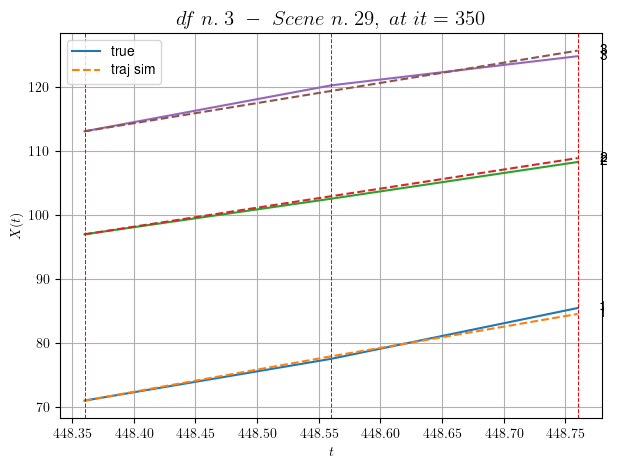

        For scene 29/55
        * use LR_NN=0.0001 with err=0.6339277382405316 at it=19
        * v0_scn_mean = 31.449187933349833
        * MAE = 0.2366781697700814



            - Time interval n.0: [465.16, 465.36]
                * y_true: [25.95020905 30.0319773 ]
                * v_ann: [26.771961212158203, 24.953413009643555, 24.72211720249953]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [465.36, 465.56]
                * y_true: [21.30025919 28.782318  ]
                * v_ann: [26.902318954467773, 24.92777442932129, 24.72211720249953]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [465.56, 465.76]
                * y_true: [22.00036741 28.59272475]
                * v_ann: [27.002811431884766, 24.98866844177246, 24.72211720249953]

-------------------------------------------------------------------

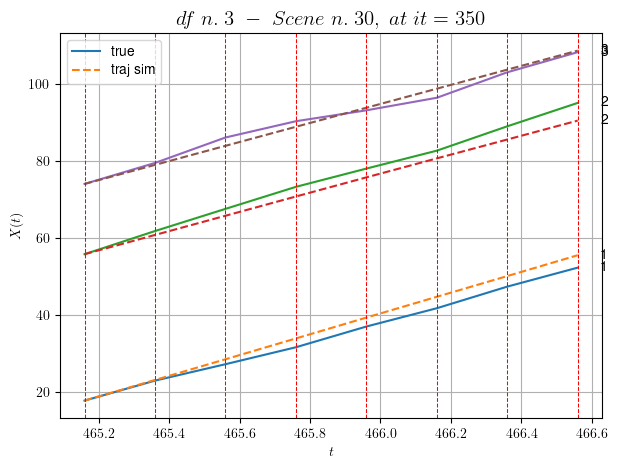

        For scene 30/55
        * use LR_NN=1e-05 with err=68.66418769646317 at it=19
        * v0_scn_mean = 25.174468891400537
        * MAE = 4.384314834352741



            - Time interval n.0: [467.16, 467.36]
                * y_true: [14.52040439 29.14139959]
                * v_ann: [17.561065673828125, 21.375205993652344, 20.776329501781795]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [467.36, 467.56]
                * y_true: [ 8.96028804 21.01119683]
                * v_ann: [18.906896591186523, 20.655811309814453, 20.776329501781795]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [467.56, 467.76]
                * y_true: [15.62056342 22.22157858]
                * v_ann: [18.72055435180664, 19.81622314453125, 20.776329501781795]

-------------------------------------------------------------------

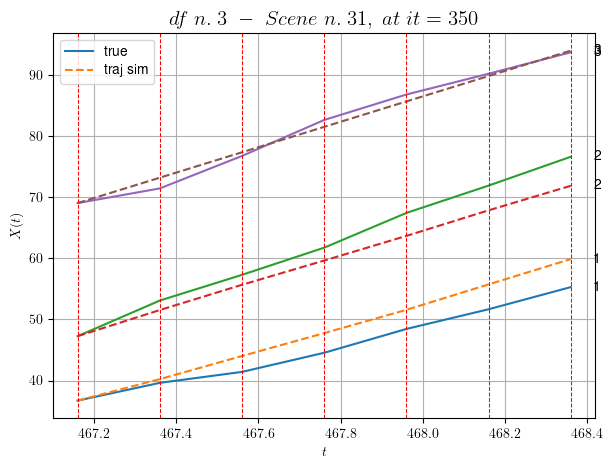

        For scene 31/55
        * use LR_NN=0.0005 with err=16.09868863762424 at it=19
        * v0_scn_mean = 21.566862957680094
        * MAE = 5.993738583307035



            - Time interval n.0: [480.76, 480.96]
                * y_true: [26.72145209 13.04113053]
                * v_ann: [17.50477409362793, 18.424867630004883, 18.304926244695185]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [480.96, 481.16]
                * y_true: [27.70182882 12.50117676]
                * v_ann: [17.27047348022461, 18.796613693237305, 18.304926244695185]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [481.16, 481.36]
                * y_true: [16.26121495 12.26123448]
                * v_ann: [16.930652618408203, 19.086841583251953, 18.304926244695185]

------------------------------------------------------------------

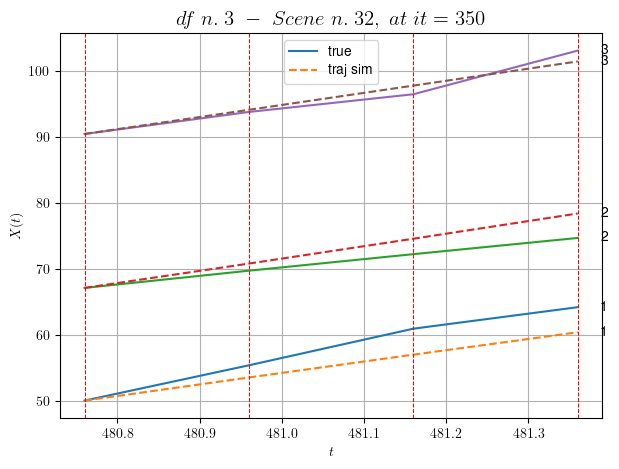

        For scene 32/55
        * use LR_NN=0.0001 with err=15.701742332274941 at it=19
        * v0_scn_mean = 19.30727634756975
        * MAE = 4.837835172888276



            - Time interval n.0: [487.16, 487.36]
                * y_true: [ 6.3002445  28.62315801]
                * v_ann: [14.497360229492188, 14.4862642288208, 23.071881683468334]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.36, 487.56]
                * y_true: [10.63044184 13.60161023]
                * v_ann: [14.931771278381348, 14.929893493652344, 23.071881683468334]

----------------------------------------------------------------------------------------------------
            * err= 2.6111862717335304
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 5.8871215517619646e-05


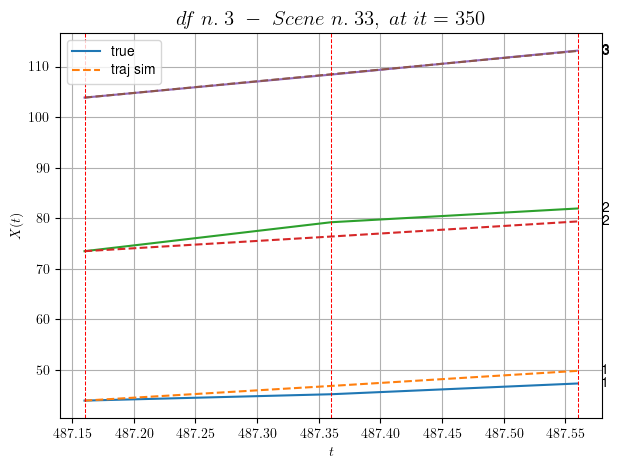

        For scene 33/55
        * use LR_NN=5e-05 with err=3.8881051925170524 at it=19
        * v0_scn_mean = 23.665670166773214
        * MAE = 2.6111862717335304



            - Time interval n.0: [498.56, 498.76]
                * y_true: [19.66086018 15.38134444]
                * v_ann: [16.72035789489746, 16.7758731842041, 26.404288947134464]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [498.76, 498.96]
                * y_true: [16.17082592 17.38167269]
                * v_ann: [17.323192596435547, 17.65284538269043, 26.404288947134464]

----------------------------------------------------------------------------------------------------
            * err= 0.19864737194461365
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00018474638267673704


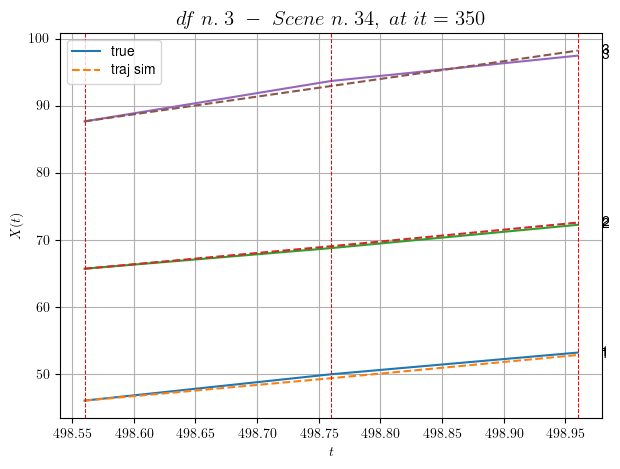

        For scene 34/55
        * use LR_NN=0.0005 with err=0.8391283892469974 at it=19
        * v0_scn_mean = 26.71246668240703
        * MAE = 0.19864737194461365



            - Time interval n.0: [517.96, 518.16]
                * y_true: [11.01062169 17.99135838]
                * v_ann: [14.983441352844238, 13.396964073181152, 13.435858379545238]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [518.16, 518.36]
                * y_true: [13.11081201 12.94110202]
                * v_ann: [14.9039945602417, 13.447794914245605, 13.435858379545238]

----------------------------------------------------------------------------------------------------
            * err= 0.4193421852762782
            * Learning rate NN = 7.289998848136747e-06
            * diff = 0.001421353874263398


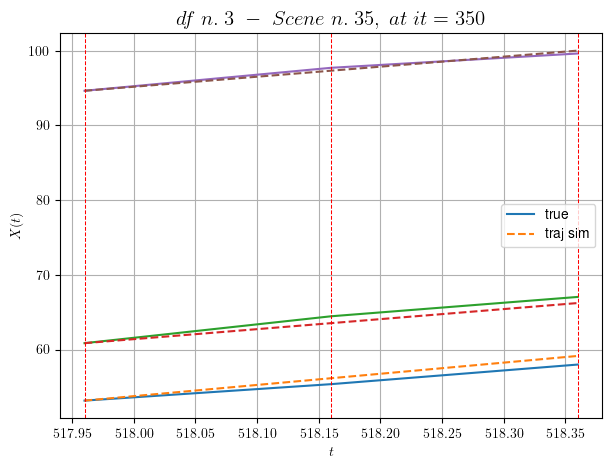

        For scene 35/55
        * use LR_NN=1e-05 with err=7.59341093124601 at it=19
        * v0_scn_mean = 14.855521855353018
        * MAE = 0.4193421852762782



            - Time interval n.0: [527.36, 527.56]
                * y_true: [14.45064103 23.0016556 ]
                * v_ann: [16.711200714111328, 16.79332160949707, 16.92100053011327]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [527.56, 527.76]
                * y_true: [16.14079976 10.04077962]
                * v_ann: [16.95952796936035, 16.80193519592285, 16.92100053011327]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [527.76, 527.96]
                * y_true: [12.25068777 19.3317022 ]
                * v_ann: [16.66515350341797, 16.640750885009766, 16.92100053011327]

------------------------------------------------------------------------

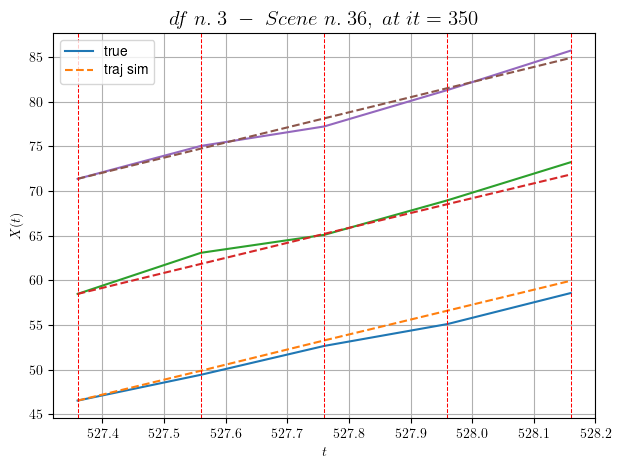

        For scene 36/55
        * use LR_NN=0.0001 with err=14.106059263637542 at it=19
        * v0_scn_mean = 18.04196280349677
        * MAE = 0.6634034073074896



            - Time interval n.0: [530.36, 530.56]
                * y_true: [16.07060164 26.13260896]
                * v_ann: [20.37786102294922, 19.054393768310547, 18.05494146639523]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [530.56, 530.76]
                * y_true: [15.14064363 18.85215172]
                * v_ann: [22.0211238861084, 19.62624168395996, 18.05494146639523]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [530.76, 530.96]
                * y_true: [16.69081323 25.36324467]
                * v_ann: [19.125267028808594, 16.92159080505371, 18.05494146639523]

-----------------------------------------------------------------------

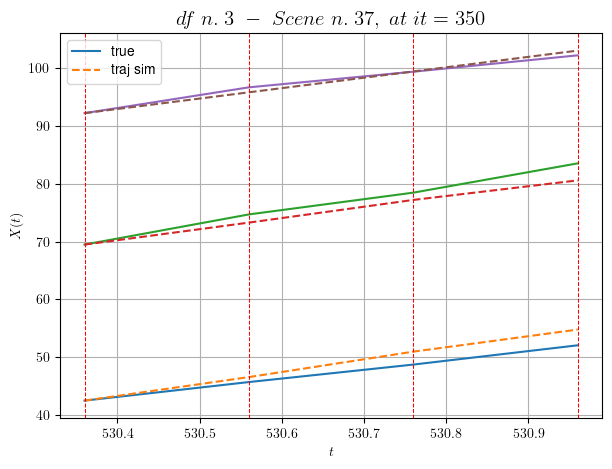

        For scene 37/55
        * use LR_NN=0.0005 with err=11.029733207655504 at it=19
        * v0_scn_mean = 19.07871702356713
        * MAE = 2.2398351015381857



            - Time interval n.0: [576.56, 576.76]
                * y_true: [22.12000755 22.50086521]
                * v_ann: [23.919401168823242, 21.349853515625, 21.51674944574895]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [576.76, 576.96]
                * y_true: [22.90003133 17.69083   ]
                * v_ann: [23.847312927246094, 21.482711791992188, 21.51674944574895]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [576.96, 577.16]
                * y_true: [24.57008129 24.8113942 ]
                * v_ann: [23.352161407470703, 21.10862159729004, 21.51674944574895]

----------------------------------------------------------------------

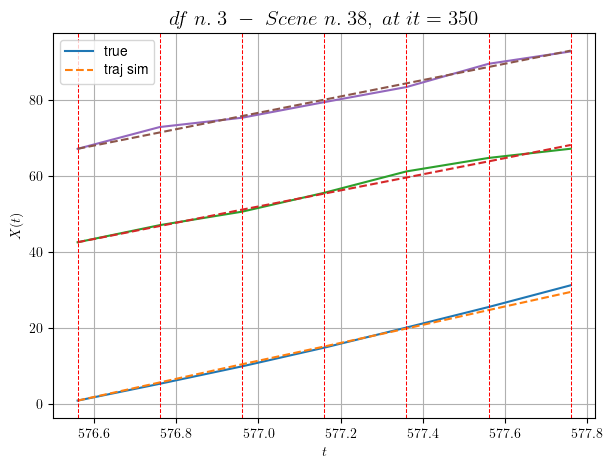

        For scene 38/55
        * use LR_NN=5e-05 with err=19.254689836472338 at it=19
        * v0_scn_mean = 22.243823703139142
        * MAE = 0.6251237352596327



            - Time interval n.0: [579.56, 579.76]
                * y_true: [21.03058275 42.18516565]
                * v_ann: [25.76563835144043, 23.24427032470703, 25.35843800286102]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.76, 579.96]
                * y_true: [19.36065083 36.06520173]
                * v_ann: [28.7778263092041, 23.777109146118164, 25.35843800286102]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.96, 580.16]
                * y_true: [21.76088956 12.96224398]
                * v_ann: [30.042638778686523, 23.120729446411133, 25.35843800286102]

----------------------------------------------------------------------

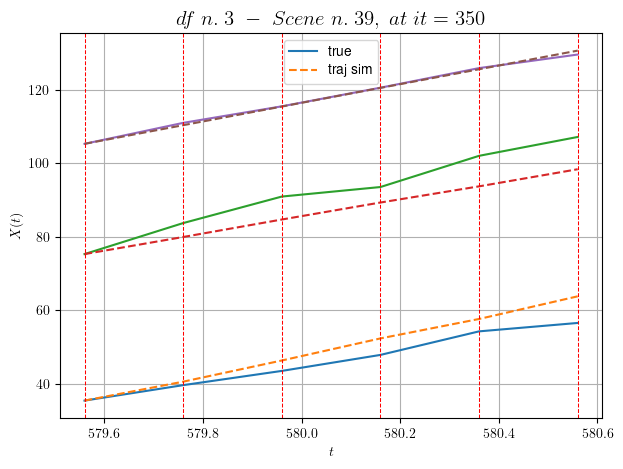

        For scene 39/55
        * use LR_NN=0.0001 with err=37.8052369950259 at it=19
        * v0_scn_mean = 25.756252522262272
        * MAE = 17.314279541029205



            - Time interval n.0: [592.16, 592.36]
                * y_true: [ 4.45046478 21.56401461]
                * v_ann: [16.009471893310547, 14.796456336975098, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [592.36, 592.56]
                * y_true: [14.40168088 21.61284101]
                * v_ann: [10.838993072509766, 15.940418243408203, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [592.56, 592.76]
                * y_true: [14.40168088 22.933287  ]
                * v_ann: [12.64571762084961, 15.630746841430664, 24.71001897344754]

--------------------------------------------------------------------

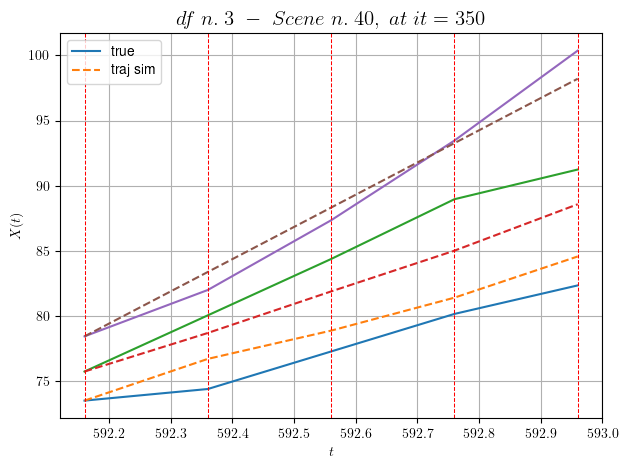

        For scene 40/55
        * use LR_NN=0.005 with err=12.915777229165146 at it=19
        * v0_scn_mean = 25.163407565696268
        * MAE = 3.1121163017844906



            - Time interval n.0: [21.56, 21.76]
                * y_true: [26.48927836 26.93283237 27.60013316]
                * v_ann: [24.835285186767578, 26.11977767944336, 24.129240036010742, 29.083788662827395]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.76, 21.96]
                * y_true: [24.19440937 24.35304119 22.73494812]
                * v_ann: [24.993104934692383, 26.359941482543945, 24.187135696411133, 29.083788662827395]

----------------------------------------------------------------------------------------------------
            * err= 0.1349866033955539
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0015377815171024878


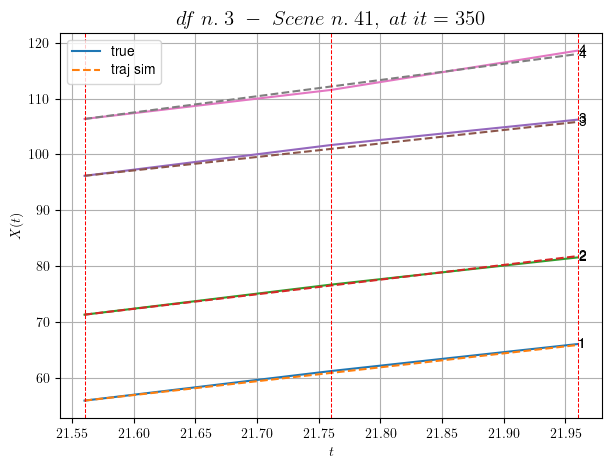

        For scene 41/55
        * use LR_NN=5e-05 with err=3.7487507341144166 at it=19
        * v0_scn_mean = 29.188365659888316
        * MAE = 0.1349866033955539



            - Time interval n.0: [31.36, 31.56]
                * y_true: [24.92105739 19.11766565 26.56610692]
                * v_ann: [1.9518281847534513e-15, 19.698944091796875, 2.2124143906747507e-35, 30.917043677928955]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [31.56, 31.76]
                * y_true: [24.72130541 29.91666352 24.00857353]
                * v_ann: [3.1600417405410267e-14, 25.225019454956055, 2.743222410524238e-35, 30.917043677928955]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [31.76, 31.96]
                * y_true: [24.58151426  8.80091982 33.80389928]
                * v_ann: [2.9123868403458774e-15, 27.076583862304

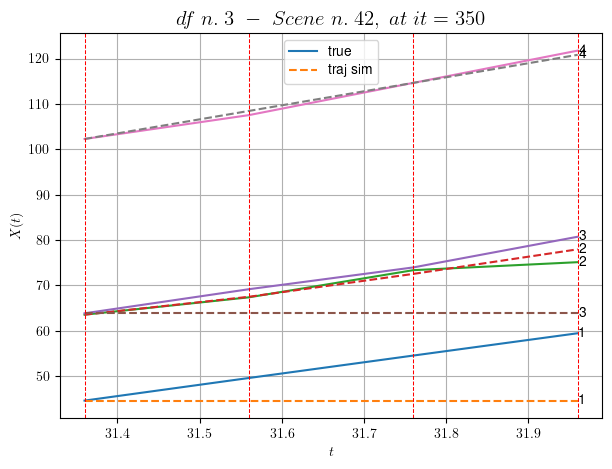

        For scene 42/55
        * use LR_NN=0.001 with err=14.447306657868122 at it=19
        * v0_scn_mean = 30.812371676917216
        * MAE = 48.09612852846717



            - Time interval n.0: [33.76, 33.96]
                * y_true: [24.27120267 28.75319668 39.53553599]
                * v_ann: [4.211583626465205e-20, 0.0017407203558832407, 6.023846521924244e-20, 24.316455544260613]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [33.96, 34.16]
                * y_true: [18.63110748 26.36338094 39.47623422]
                * v_ann: [5.121368401380596e-21, 1.0942497283394914e-05, 2.045406558351314e-16, 24.316455544260613]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [34.16, 34.36]
                * y_true: [25.20172426 27.37399424 29.73574355]
                * v_ann: [1.3504015062918746e-22, 2.2987221015

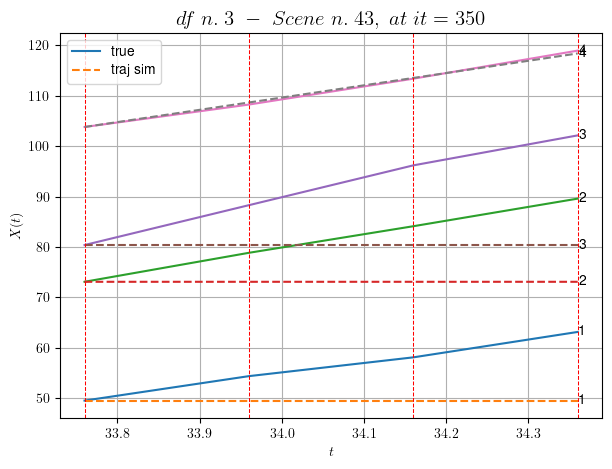

        For scene 43/55
        * use LR_NN=0.0001 with err=15.645374205926661 at it=19
        * v0_scn_mean = 24.965179247765086
        * MAE = 93.44871700698857



        For scene 44/55
        * use LR_NN=0.0001 with err=9.554010933472615 at it=19
        * v0_scn_mean = 33.4870317483745
        * MAE = 35.74461712358815



            - Time interval n.0: [83.36, 83.56]
                * y_true: [27.1108197  22.97496526 13.79424223]
                * v_ann: [0.0, 2.3341104592335517e-16, 1.1356521099514794e-05, 26.108277505261064]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [83.56, 83.76]
                * y_true: [28.73111951 35.1785896  26.83859352]
                * v_ann: [0.0, 1.74605050876726e-14, 2.149384044969338e-06, 26.108277505261064]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [83.76, 83.

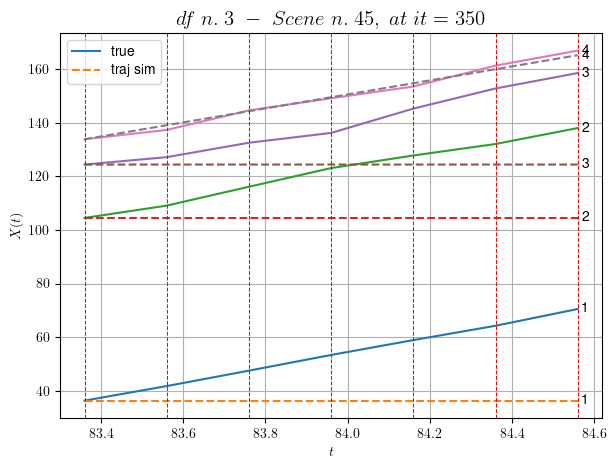

        For scene 45/55
        * use LR_NN=5e-05 with err=116.11360012875463 at it=19
        * v0_scn_mean = 26.552481408205708
        * MAE = 301.7111133745589



            - Time interval n.0: [94.36, 94.56]
                * y_true: [33.70387327 38.57908217 21.70251029]
                * v_ann: [0.007687269244343042, 23.824831008911133, 0.010544706135988235, 29.526223424799767]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [94.56, 94.76]
                * y_true: [29.14386677 24.50535727 32.05702124]
                * v_ann: [0.007212402299046516, 21.338340759277344, 0.0045985691249370575, 29.526223424799767]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [94.76, 94.96]
                * y_true: [29.96461386 30.28702151 28.36707369]
                * v_ann: [0.01877659745514393, 28.646860122680664, 0.047

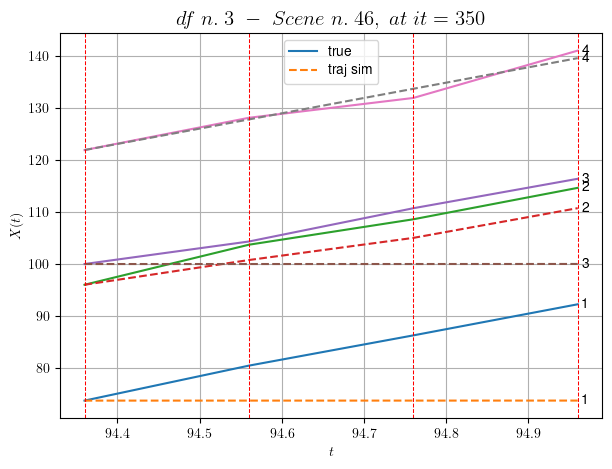

        For scene 46/55
        * use LR_NN=0.001 with err=24.319534455724792 at it=19
        * v0_scn_mean = 29.58030061147272
        * MAE = 8.229682073133665



            - Time interval n.0: [142.16, 142.36]
                * y_true: [31.90177154 33.47450881 19.84324761]
                * v_ann: [27.9312744140625, 30.49253273010254, 24.878738403320312, 28.121504824700203]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [142.36, 142.56]
                * y_true: [31.50218522 24.08376432 24.27420294]
                * v_ann: [28.02027130126953, 30.846548080444336, 25.221572875976562, 28.121504824700203]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [142.56, 142.76]
                * y_true: [24.70204715 30.9853993  17.45337402]
                * v_ann: [28.19320297241211, 30.839893341064453, 25.018087387084

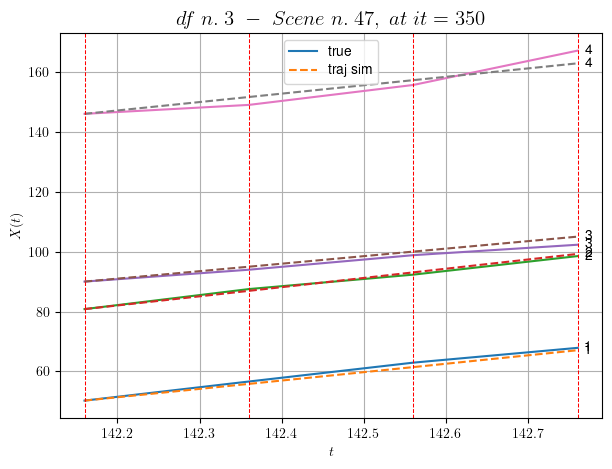

        For scene 47/55
        * use LR_NN=1e-05 with err=32.41184752835993 at it=19
        * v0_scn_mean = 28.33591756601419
        * MAE = 2.4608695235002234



            - Time interval n.0: [170.36, 170.56]
                * y_true: [24.1106547  30.95205085 31.86307572]
                * v_ann: [25.769290924072266, 26.60819435119629, 24.891782760620117, 32.99611396138392]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [28.33103197 10.10076519 29.63331411]
                * v_ann: [26.13588523864746, 26.896333694458008, 25.519935607910156, 32.99611396138392]

----------------------------------------------------------------------------------------------------
            * err= 1.1668032881166388
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00489424402981653


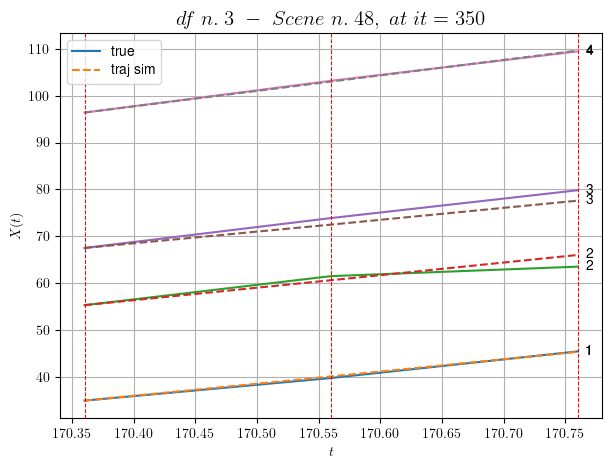

        For scene 48/55
        * use LR_NN=5e-05 with err=1.8249525404369753 at it=19
        * v0_scn_mean = 32.654135437192245
        * MAE = 1.1668032881166388



            - Time interval n.0: [248.16, 248.36]
                * y_true: [31.21204442 24.6823336  32.34552948]
                * v_ann: [33.93238067626953, 36.62454605102539, 31.236186981201172, 30.248935217315978]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [248.36, 248.56]
                * y_true: [31.9625999  29.77329807 35.48696999]
                * v_ann: [27.116512298583984, 25.15591812133789, 28.29195785522461, 30.248935217315978]

----------------------------------------------------------------------------------------------------
            * err= 0.9792436889313199
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0030521933628248066


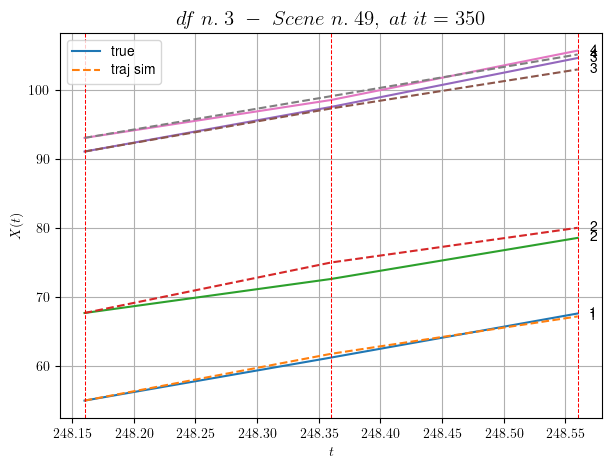

        For scene 49/55
        * use LR_NN=0.001 with err=16.780155011568937 at it=19
        * v0_scn_mean = 30.22052157907147
        * MAE = 0.7446852919198539



            - Time interval n.0: [320.56, 320.76]
                * y_true: [27.61038846 20.60122903 24.07186814]
                * v_ann: [29.78746223449707, 29.04620933532715, 29.724220275878906, 28.130406759666666]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.76, 320.96]
                * y_true: [30.26064275 26.25184013 33.56317876]
                * v_ann: [28.275829315185547, 28.485868453979492, 28.30592155456543, 28.130406759666666]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.96, 321.16]
                * y_true: [38.25114958 30.20253063 29.36323845]
                * v_ann: [28.698387145996094, 28.659622192382812, 28.701587677

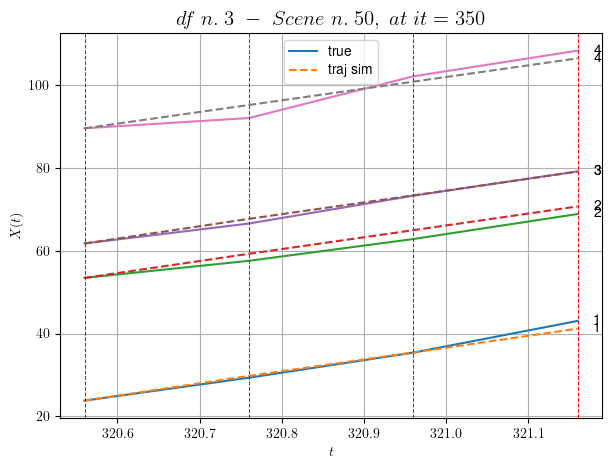

        For scene 50/55
        * use LR_NN=0.0001 with err=8.046510981313002 at it=19
        * v0_scn_mean = 28.34380342795366
        * MAE = 1.9162524898254263



            - Time interval n.0: [333.96, 334.16]
                * y_true: [31.40121985 21.58136302 16.05156144]
                * v_ann: [29.469907760620117, 29.49220848083496, 29.483991622924805, 24.21959719997371]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [334.16, 334.36]
                * y_true: [27.67132891 33.9725354  36.25406589]
                * v_ann: [29.17800521850586, 29.11346435546875, 29.088579177856445, 24.21959719997371]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [334.36, 334.56]
                * y_true: [23.81145278 36.52334008 36.85496039]
                * v_ann: [29.324260711669922, 29.31085205078125, 29.312927246093

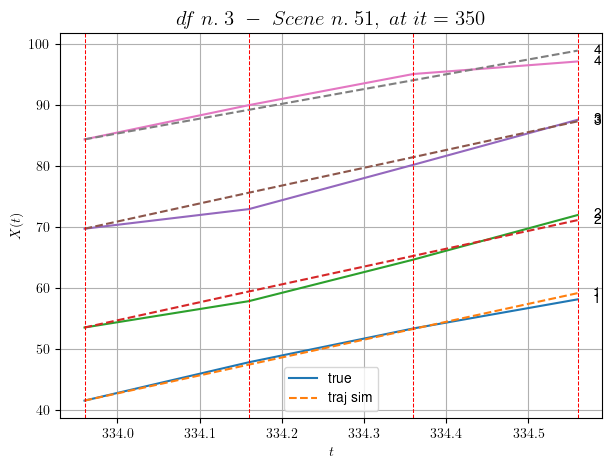

        For scene 51/55
        * use LR_NN=5e-05 with err=4.322068470192431 at it=19
        * v0_scn_mean = 24.879376382028767
        * MAE = 1.1452785385223754



            - Time interval n.0: [393.36, 393.56]
                * y_true: [28.21049617 36.91227562 35.66212709]
                * v_ann: [32.01728057861328, 37.30259704589844, 21.14476203918457, 27.00671910788559]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [393.56, 393.76]
                * y_true: [27.89067116 17.24119841 30.82238865]
                * v_ann: [37.07746124267578, 13.901176452636719, 32.958919525146484, 27.00671910788559]

----------------------------------------------------------------------------------------------------
            * err= 2.7593003551735524
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.025104354059070744


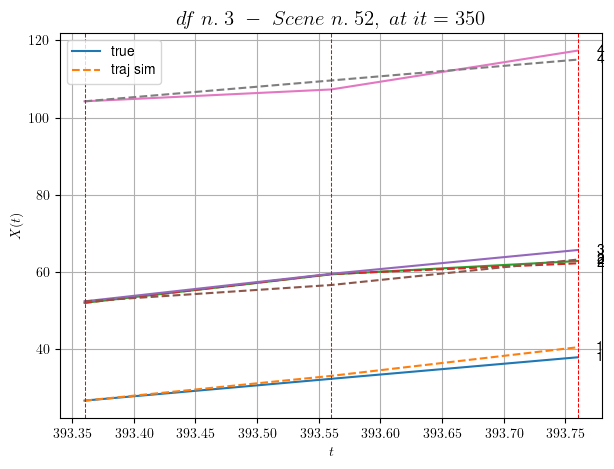

        For scene 52/55
        * use LR_NN=0.0001 with err=14.594224371018452 at it=19
        * v0_scn_mean = 27.348374263587246
        * MAE = 2.7593003551735524



            - Time interval n.0: [521.76, 521.96]
                * y_true: [10.54036018 15.07054541 11.30098461]
                * v_ann: [15.938020706176758, 15.328964233398438, 15.654970169067383, 17.24960046263986]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [521.96, 522.16]
                * y_true: [20.11080333 12.92054275 19.50185752]
                * v_ann: [15.219143867492676, 14.060159683227539, 14.658486366271973, 17.24960046263986]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [522.16, 522.36]
                * y_true: [16.31074126 16.85079656 12.50130097]
                * v_ann: [13.24677848815918, 15.174477577209473, 15.5268020

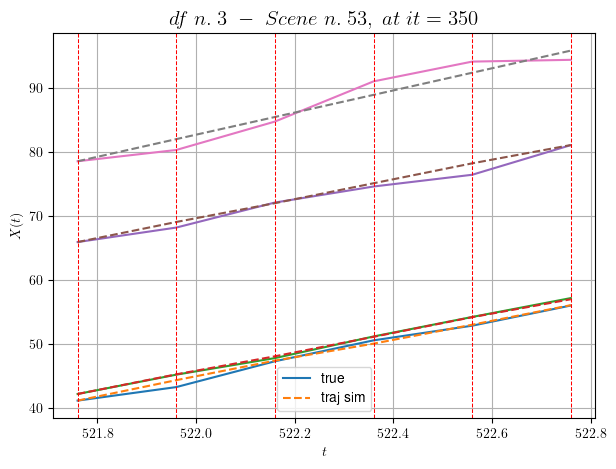

        For scene 53/55
        * use LR_NN=0.001 with err=25.103775063869072 at it=19
        * v0_scn_mean = 18.70493990327428
        * MAE = 0.7709251122641739



            - Time interval n.0: [95.36, 95.56]
                * y_true: [30.52238998 38.21809619 31.62683865 21.81676128]
                * v_ann: [21.963178634643555, 25.815683364868164, 23.585010528564453, 25.867992401123047, 33.34860961624623]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [95.56, 95.76]
                * y_true: [29.11270185 26.43618159 23.59563306 15.73527867]
                * v_ann: [32.21615982055664, 25.88467025756836, 29.893714904785156, 27.617151260375977, 33.34860961624623]

----------------------------------------------------------------------------------------------------
            * err= 2.1128812537750945
            * Learning rate NN = 0.00036449998151510954
            * diff = 7.793662734689732e

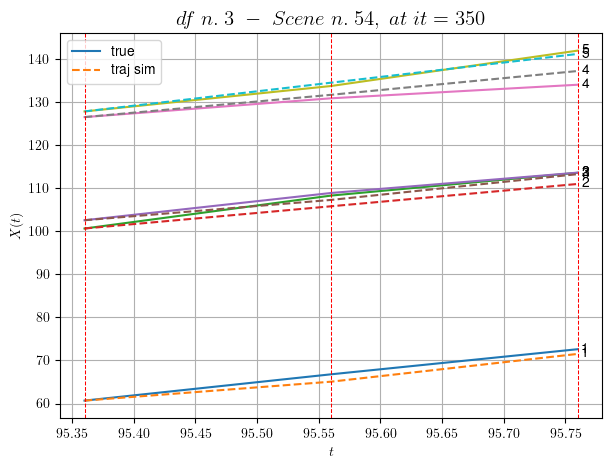

        For scene 54/55
        * use LR_NN=0.0005 with err=17.248042086209125 at it=19
        * v0_scn_mean = 32.8731334832019
        * MAE = 2.094029042868709



For df=3 with 55 scenes, time taken:        618.49
------------------------------------------------------------
****************************************************************************************************
In df n.4/10 we have 30 scenes
****************************************************************************************************
            - Time interval n.0: [7.04, 7.24]
                * y_true: [ 8.37556318 26.1843701 ]
                * v_ann: [17.57613182067871, 17.517425537109375, 36.154185886666866]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [7.24, 7.44]
                * y_true: [12.54090657 23.03433042]
                * v_ann: [17.54067611694336, 17.502084732055664, 36.154185886666866]

--------------------

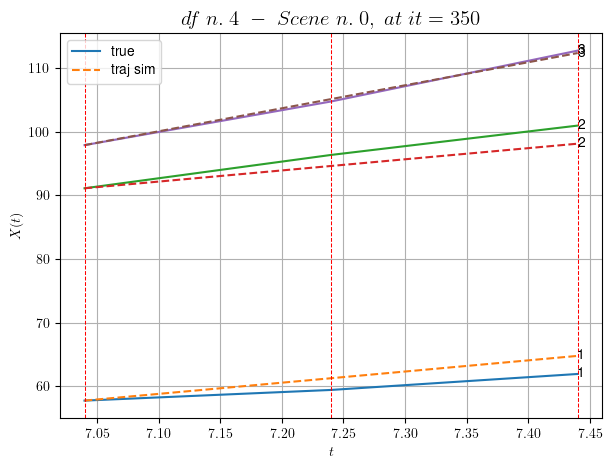

        For scene 0/30
        * use LR_NN=0.0001 with err=12.095532874970756 at it=19
        * v0_scn_mean = 35.62672885769243
        * MAE = 1.6989206375502752



            - Time interval n.0: [19.84, 20.04]
                * y_true: [38.50393497 35.76621737]
                * v_ann: [30.71917152404785, 29.256393432617188, 26.058995147815406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [20.04, 20.24]
                * y_true: [14.10165462 33.63672046]
                * v_ann: [31.97687339782715, 29.65743064880371, 26.058995147815406]

----------------------------------------------------------------------------------------------------
            * err= 1.4540493017116833
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0018675646375023724


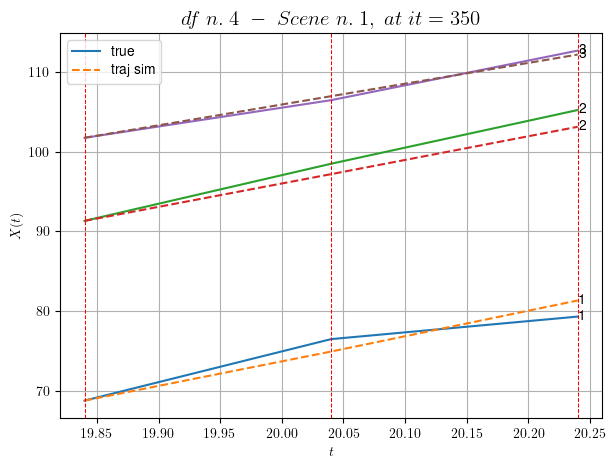

        For scene 1/30
        * use LR_NN=0.0001 with err=10.025856736965268 at it=19
        * v0_scn_mean = 26.396766991043375
        * MAE = 1.4540493017116833



            - Time interval n.0: [23.64, 23.84]
                * y_true: [16.50112189 27.57447859]
                * v_ann: [16.00058937072754, 18.251663208007812, 25.974604646459856]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [13.80103575 15.46275359]
                * v_ann: [19.622516632080078, 13.686443328857422, 25.974604646459856]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [18.55153987 13.07248815]
                * v_ann: [16.592411041259766, 18.742069244384766, 25.974604646459856]

----------------------------------------------------------------------

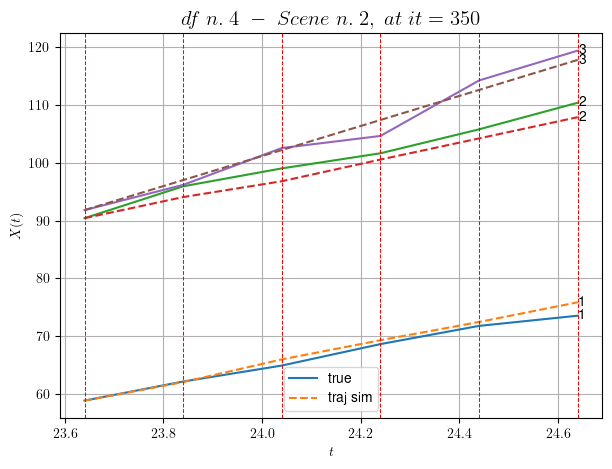

        For scene 2/30
        * use LR_NN=0.001 with err=36.88990077971608 at it=19
        * v0_scn_mean = 26.31960934939313
        * MAE = 2.1895422222127454



            - Time interval n.0: [80.24, 80.44]
                * y_true: [20.8407888  28.56113721]
                * v_ann: [25.525924682617188, 27.576473236083984, 22.367829423056254]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [80.44, 80.64]
                * y_true: [28.49133895 28.481454  ]
                * v_ann: [26.273181915283203, 26.479333877563477, 22.367829423056254]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [80.64, 80.84]
                * y_true: [29.84173661 32.11200361]
                * v_ann: [26.54642677307129, 27.297992706298828, 22.367829423056254]

-------------------------------------------------------------------------

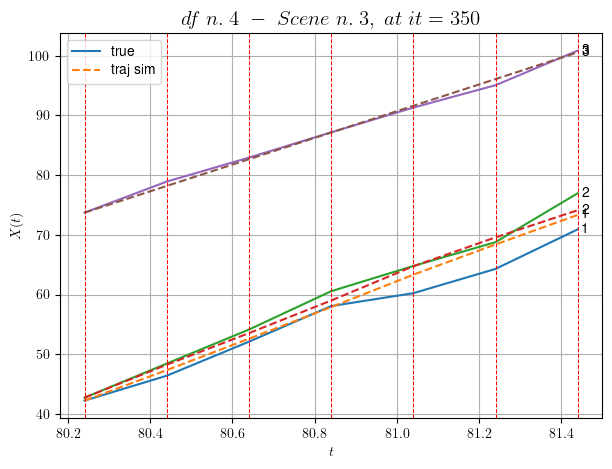

        For scene 3/30
        * use LR_NN=0.0005 with err=75.45141833675403 at it=19
        * v0_scn_mean = 23.02196013851973
        * MAE = 2.193563469557272



            - Time interval n.0: [89.04, 89.24]
                * y_true: [19.34082001 24.8230577 ]
                * v_ann: [19.669151306152344, 20.48894500732422, 32.77541157779944]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.24, 89.44]
                * y_true: [14.120693   17.32233598]
                * v_ann: [19.695146560668945, 20.56686782836914, 32.77541157779944]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.44, 89.64]
                * y_true: [18.19104002 31.50485669]
                * v_ann: [19.162736892700195, 19.75018882751465, 32.77541157779944]

------------------------------------------------------------------------------

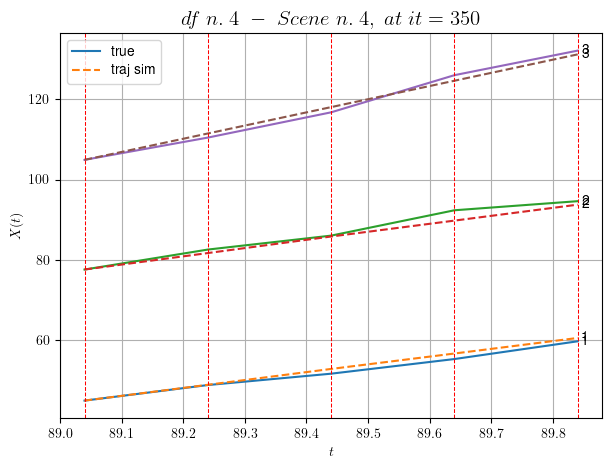

        For scene 4/30
        * use LR_NN=5e-05 with err=4.063352576361134 at it=19
        * v0_scn_mean = 32.53753927885261
        * MAE = 1.1735430563681626



            - Time interval n.0: [96.44, 96.64]
                * y_true: [16.86045215 20.08121647]
                * v_ann: [18.86724281311035, 18.578222274780273, 18.401364416423622]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.64, 96.84]
                * y_true: [17.24055532  8.93061591]
                * v_ann: [18.82361602783203, 18.557588577270508, 18.401364416423622]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [96.84, 97.04]
                * y_true: [21.11081641 16.18118624]
                * v_ann: [18.63232421875, 18.071489334106445, 18.401364416423622]

------------------------------------------------------------------------------

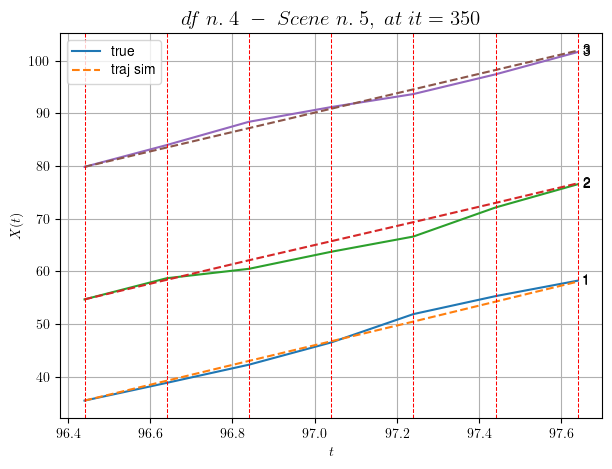

        For scene 5/30
        * use LR_NN=0.0001 with err=31.826271562678325 at it=19
        * v0_scn_mean = 19.39544908947923
        * MAE = 1.0052378521540886



            - Time interval n.0: [182.24, 182.44]
                * y_true: [18.61043577 13.125309  ]
                * v_ann: [20.732440948486328, 19.52529525756836, 20.77326623858314]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.44, 182.64]
                * y_true: [12.51734154 21.64870909]
                * v_ann: [11.055635452270508, 18.970129013061523, 20.77326623858314]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [182.64, 182.84]
                * y_true: [15.03048681 24.29091592]
                * v_ann: [20.664936065673828, 18.775903701782227, 20.77326623858314]

--------------------------------------------------------------------

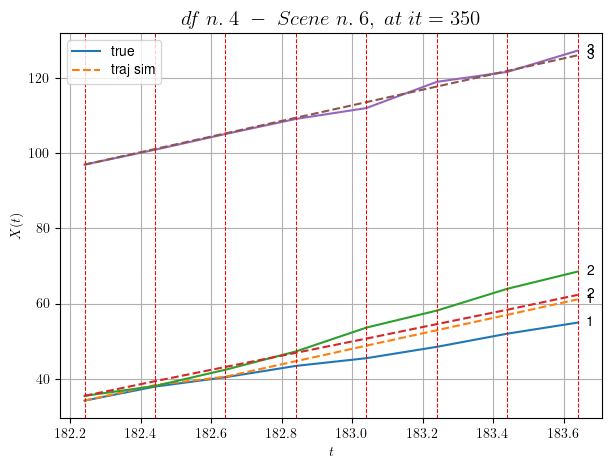

        For scene 6/30
        * use LR_NN=0.0001 with err=51.8121132564686 at it=19
        * v0_scn_mean = 21.564062237689768
        * MAE = 8.0337261308116



        For scene 7/30
        * use LR_NN=0.0005 with err=6.99846598630351 at it=19
        * v0_scn_mean = 20.005060843687644
        * MAE = 0.3494985299054112



            - Time interval n.0: [196.84, 197.04]
                * y_true: [ 8.77046468 10.16548364]
                * v_ann: [8.901779174804688, 8.759636878967285, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [197.04, 197.24]
                * y_true: [7.43042623 9.26246532]
                * v_ann: [9.060017585754395, 8.905850410461426, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            * err= 0.1083235998450721
            * Learning rate NN = 0.00036449998151510954
   

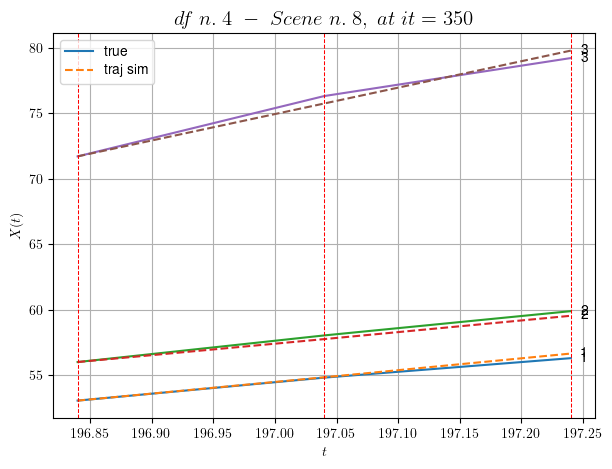

        For scene 8/30
        * use LR_NN=0.0005 with err=3.1726216231027013 at it=19
        * v0_scn_mean = 21.029729210389316
        * MAE = 0.1083235998450721



            - Time interval n.0: [222.84, 223.04]
                * y_true: [19.28108097 23.47419597]
                * v_ann: [14.463631629943848, 15.611518859863281, 30.107927882855954]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.04, 223.24]
                * y_true: [17.49110618 15.20291758]
                * v_ann: [19.513612747192383, 18.296968460083008, 30.107927882855954]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.24, 223.44]
                * y_true: [14.25100604 13.59283886]
                * v_ann: [16.993345260620117, 16.934053421020508, 30.107927882855954]

---------------------------------------------------------------

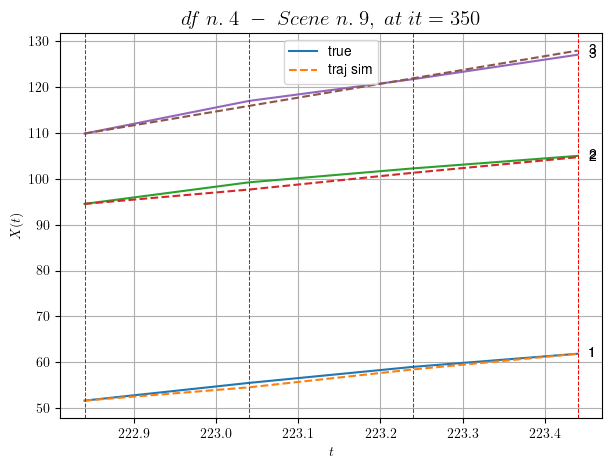

        For scene 9/30
        * use LR_NN=0.0005 with err=5.373715629684461 at it=19
        * v0_scn_mean = 30.098677703956003
        * MAE = 0.5600832576680278



            - Time interval n.0: [224.84, 225.04]
                * y_true: [17.10046829 25.29311811]
                * v_ann: [18.982511520385742, 19.27849006652832, 15.713780360625497]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.04, 225.24]
                * y_true: [17.70062553 10.9614656 ]
                * v_ann: [19.25177001953125, 19.40802764892578, 15.713780360625497]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.24, 225.44]
                * y_true: [22.57087879 26.33405568]
                * v_ann: [18.633575439453125, 19.18519401550293, 15.713780360625497]

--------------------------------------------------------------------

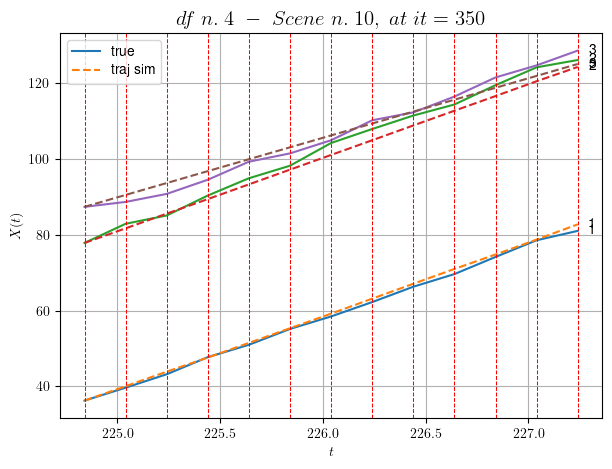

        For scene 10/30
        * use LR_NN=0.0005 with err=257.39668681170764 at it=19
        * v0_scn_mean = 16.938209896071545
        * MAE = 3.03693103925499



            - Time interval n.0: [230.84, 231.04]
                * y_true: [ 5.64695095 17.97864337]
                * v_ann: [7.902956485748291, 13.836896896362305, 23.32277125146921]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [231.04, 231.24]
                * y_true: [ 5.72513489 21.19066695]
                * v_ann: [15.464193344116211, 13.74188232421875, 23.32277125146921]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [231.24, 231.44]
                * y_true: [ 6.01015392 28.29114422]
                * v_ann: [15.304701805114746, 13.655109405517578, 23.32277125146921]

---------------------------------------------------------------------

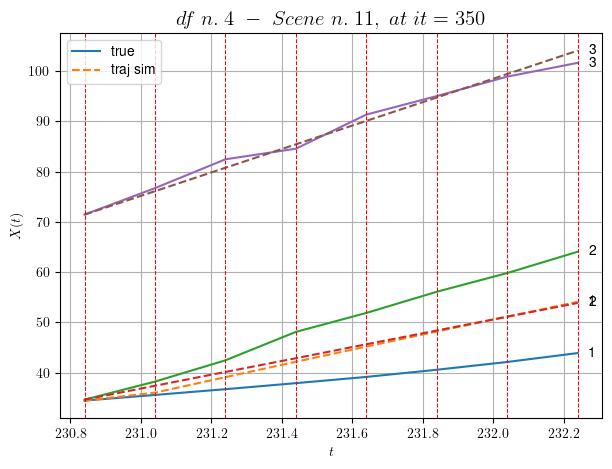

        For scene 11/30
        * use LR_NN=5e-05 with err=20.503877063453277 at it=19
        * v0_scn_mean = 23.895056733634004
        * MAE = 26.15243695528504



            - Time interval n.0: [233.84, 234.04]
                * y_true: [14.14101026 12.7012637 ]
                * v_ann: [21.26500129699707, 21.8785343170166, 21.46286816031553]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.04, 234.24]
                * y_true: [26.43219185 20.11227439]
                * v_ann: [20.97800064086914, 21.50653839111328, 21.46286816031553]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [234.24, 234.44]
                * y_true: [22.40209801 33.22429882]
                * v_ann: [21.00277328491211, 21.613109588623047, 21.46286816031553]

-------------------------------------------------------------------------

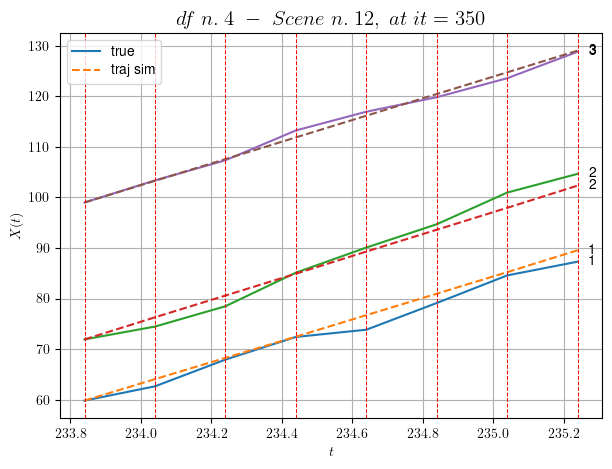

        For scene 12/30
        * use LR_NN=0.0001 with err=34.0777751744181 at it=19
        * v0_scn_mean = 22.19456042295564
        * MAE = 1.9410808395324388



            - Time interval n.0: [302.44, 302.64]
                * y_true: [15.00036276 19.90190261]
                * v_ann: [19.461938858032227, 19.61113166809082, 25.744568982280633]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [302.64, 302.84]
                * y_true: [17.72492583 25.30273749]
                * v_ann: [19.404178619384766, 19.56924057006836, 25.744568982280633]

----------------------------------------------------------------------------------------------------
            * err= 0.4983157296992419
            * Learning rate NN = 7.289998848136747e-06
            * diff = 0.0001226256497566247


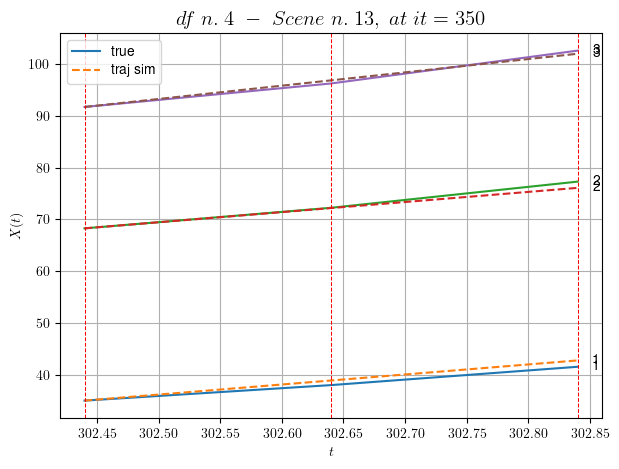

        For scene 13/30
        * use LR_NN=1e-05 with err=2.0895548515519153 at it=19
        * v0_scn_mean = 26.109289360076456
        * MAE = 0.4908714444406854



            - Time interval n.0: [364.64, 364.84]
                * y_true: [23.68175628 20.26218764]
                * v_ann: [18.4955997467041, 19.04279136657715, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [364.84, 365.04]
                * y_true: [20.38169455 13.81168669]
                * v_ann: [18.77220344543457, 19.12400245666504, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [365.04, 365.24]
                * y_true: [10.17092159 27.1635357 ]
                * v_ann: [18.925331115722656, 18.32467269897461, 28.205737859029586]

---------------------------------------------------------------------

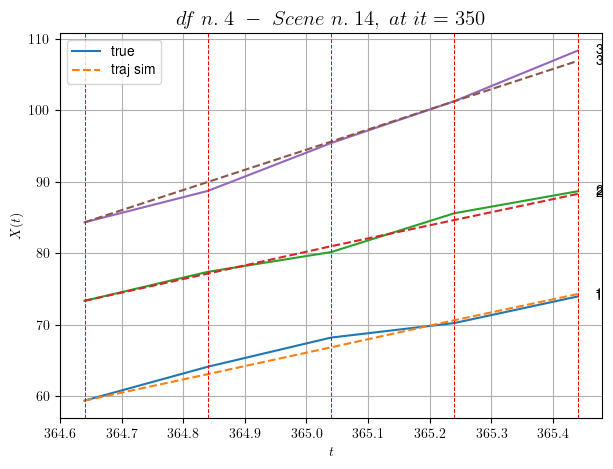

        For scene 14/30
        * use LR_NN=0.0001 with err=1.0008948953919887 at it=19
        * v0_scn_mean = 28.35951874824957
        * MAE = 0.5401080170295156



            - Time interval n.0: [422.64, 422.84]
                * y_true: [18.36052369 19.91162557]
                * v_ann: [29.623355865478516, 26.614269256591797, 27.54510734654712]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [422.84, 423.04]
                * y_true: [28.40107569 15.51150308]
                * v_ann: [20.20254898071289, 19.939027786254883, 27.54510734654712]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [423.04, 423.24]
                * y_true: [26.09121176 24.58263804]
                * v_ann: [21.579782485961914, 21.200428009033203, 27.54510734654712]

-------------------------------------------------------------------

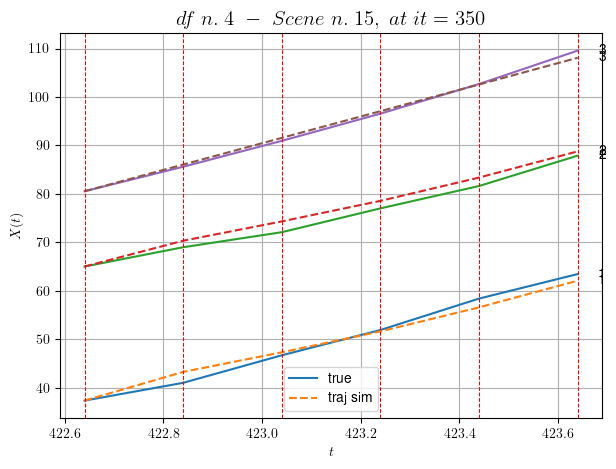

        For scene 15/30
        * use LR_NN=0.001 with err=2.5308485009100923 at it=19
        * v0_scn_mean = 27.755508918629317
        * MAE = 1.1619940682095928



            - Time interval n.0: [440.44, 440.64]
                * y_true: [23.50209477 27.05306951]
                * v_ann: [20.466707229614258, 21.026504516601562, 21.127058612420328]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [440.64, 440.84]
                * y_true: [ 8.15079495 24.70319187]
                * v_ann: [20.67068099975586, 21.15736198425293, 21.127058612420328]

----------------------------------------------------------------------------------------------------
            * err= 1.0144672096961662
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0009475913039873607


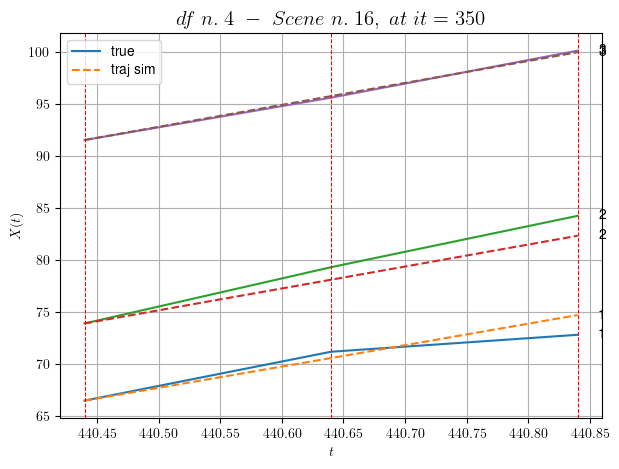

        For scene 16/30
        * use LR_NN=5e-05 with err=2.892376923398054 at it=19
        * v0_scn_mean = 21.88753211594238
        * MAE = 0.9776222551652792



            - Time interval n.0: [459.64, 459.84]
                * y_true: [ 8.02057991 18.30147717]
                * v_ann: [17.83915138244629, 21.151182174682617, 21.749537222117453]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [459.84, 460.04]
                * y_true: [15.90126261 32.50305135]
                * v_ann: [16.662813186645508, 19.022382736206055, 21.749537222117453]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [460.04, 460.24]
                * y_true: [12.56106954  7.60079575]
                * v_ann: [19.867801666259766, 19.712236404418945, 21.749537222117453]

------------------------------------------------------------------

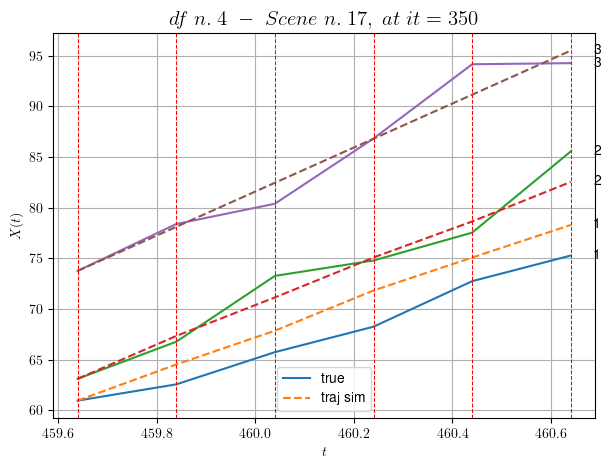

        For scene 17/30
        * use LR_NN=0.001 with err=10.859830912170326 at it=19
        * v0_scn_mean = 22.456659929267367
        * MAE = 3.6566980125613107



            - Time interval n.0: [493.84, 494.04]
                * y_true: [22.94003108 21.75102788]
                * v_ann: [22.783119201660156, 23.046480178833008, 20.437010740209942]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.04, 494.24]
                * y_true: [17.14085991 24.35137427]
                * v_ann: [22.728816986083984, 22.980932235717773, 20.437010740209942]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [494.24, 494.44]
                * y_true: [21.88131212 25.00167951]
                * v_ann: [22.5748291015625, 22.695167541503906, 20.437010740209942]

-----------------------------------------------------------------

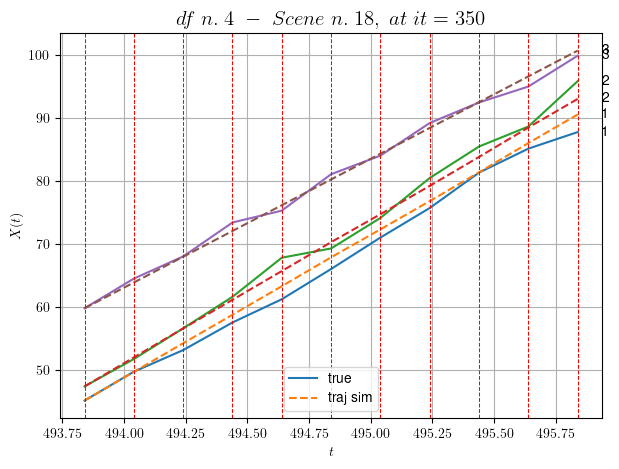

        For scene 18/30
        * use LR_NN=0.001 with err=81.22631657257381 at it=19
        * v0_scn_mean = 21.25662620129171
        * MAE = 1.4478904971464706



            - Time interval n.0: [520.04, 520.24]
                * y_true: [17.72000935 17.53021327]
                * v_ann: [21.093599319458008, 20.88484764099121, 25.9628364992539]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [520.24, 520.44]
                * y_true: [21.19003079 20.68032877]
                * v_ann: [21.076528549194336, 20.826923370361328, 25.9628364992539]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [520.44, 520.64]
                * y_true: [20.95006602 20.21041565]
                * v_ann: [21.077749252319336, 20.82799530029297, 25.9628364992539]

-------------------------------------------------------------------------

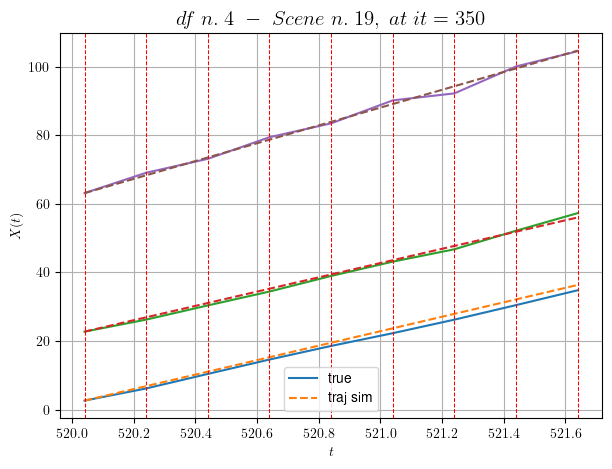

        For scene 19/30
        * use LR_NN=1e-05 with err=32.12457610183869 at it=19
        * v0_scn_mean = 26.30884981519874
        * MAE = 0.892655854877311



        For scene 20/30
        * use LR_NN=0.001 with err=15.454741855357307 at it=19
        * v0_scn_mean = 21.16747375536085
        * MAE = 0.329550092626711



            - Time interval n.0: [554.64, 554.84]
                * y_true: [16.3871362  34.43556815]
                * v_ann: [23.44858169555664, 22.93804359436035, 20.44079689246173]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.84, 555.04]
                * y_true: [19.58824641 23.53414882]
                * v_ann: [23.780370712280273, 23.745227813720703, 20.44079689246173]

----------------------------------------------------------------------------------------------------
            * err= 1.941423762718917
            * Learning rate NN = 0.00036449998151510954


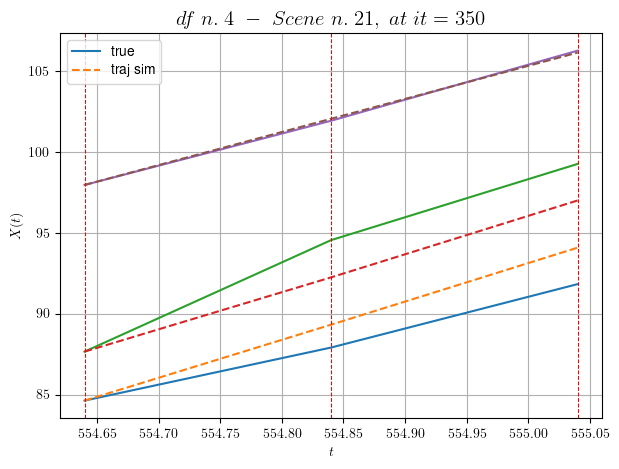

        For scene 21/30
        * use LR_NN=0.0005 with err=2.570746740595855 at it=19
        * v0_scn_mean = 21.260087853656614
        * MAE = 1.9392025784403826



            - Time interval n.0: [556.24, 556.44]
                * y_true: [24.75252122 21.70224237]
                * v_ann: [23.935415267944336, 24.23896598815918, 15.086200202026637]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [556.44, 556.64]
                * y_true: [25.4427559  22.85265518]
                * v_ann: [23.52485466003418, 23.008695602416992, 15.086200202026637]

----------------------------------------------------------------------------------------------------
            * err= 0.16842437088719378
            * Learning rate NN = 0.0007289999630302191
            * diff = 6.983634945889605e-07


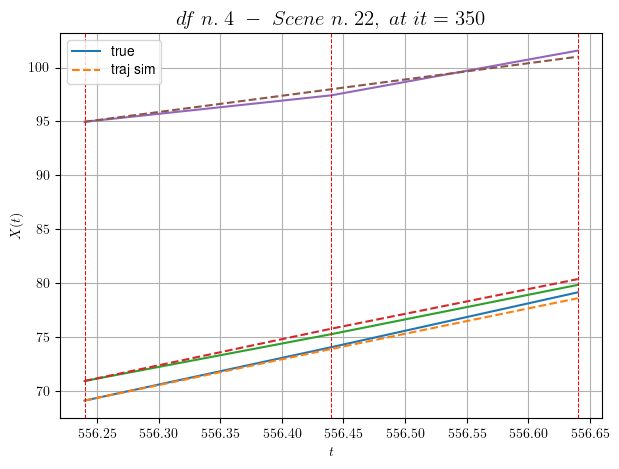

        For scene 22/30
        * use LR_NN=0.001 with err=13.029680606619173 at it=19
        * v0_scn_mean = 16.36441777247632
        * MAE = 0.16792916030847482



            - Time interval n.0: [575.04, 575.24]
                * y_true: [25.50060057 18.90068968]
                * v_ann: [22.476240158081055, 22.562705993652344, 24.545660919825707]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [575.24, 575.44]
                * y_true: [27.95087423 28.65128625]
                * v_ann: [22.460796356201172, 22.49589729309082, 24.545660919825707]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [575.44, 575.64]
                * y_true: [21.25083564 15.85084753]
                * v_ann: [22.692808151245117, 23.643346786499023, 24.545660919825707]

----------------------------------------------------------------

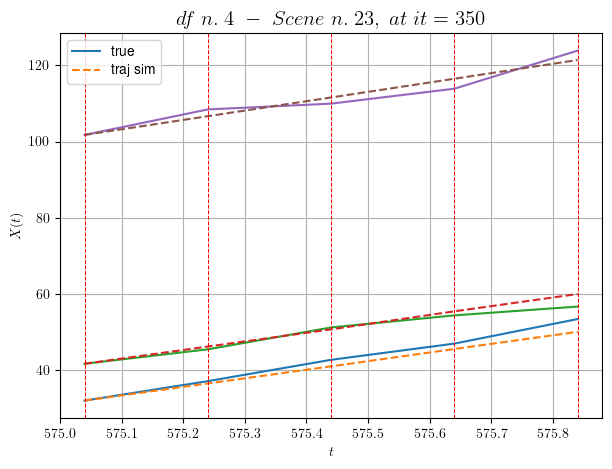

        For scene 23/30
        * use LR_NN=5e-05 with err=42.917657352353565 at it=19
        * v0_scn_mean = 25.013136153630082
        * MAE = 3.191201099098656



            - Time interval n.0: [313.84, 314.04]
                * y_true: [15.70108851 23.28855659 11.30165534]
                * v_ann: [24.328149795532227, 24.977123260498047, 25.160602569580078, 26.416039076566552]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [314.04, 314.24]
                * y_true: [25.15198981 24.43240479 30.10483754]
                * v_ann: [24.127243041992188, 24.385082244873047, 24.590362548828125, 26.416039076566552]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [314.24, 314.44]
                * y_true: [27.30252596 23.75264682 40.35752125]
                * v_ann: [24.192663192749023, 24.545360565185547, 24.742509

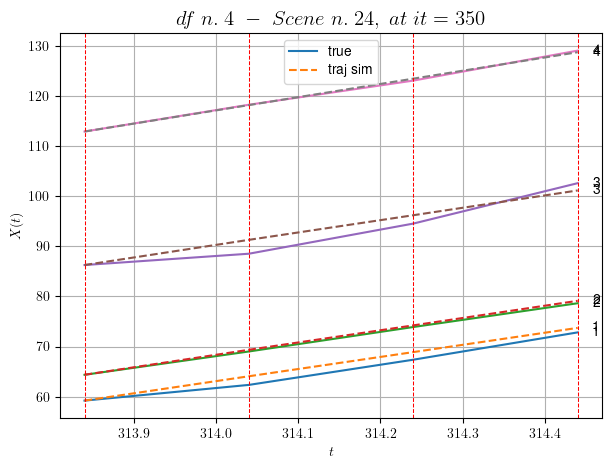

        For scene 24/30
        * use LR_NN=5e-05 with err=10.961655675112318 at it=19
        * v0_scn_mean = 26.82511486044959
        * MAE = 1.1832024625135158



        For scene 25/30
        * use LR_NN=0.001 with err=3.1656048871926306 at it=19
        * v0_scn_mean = 26.868082635913034
        * MAE = 0.12956956818429424



        For scene 26/30
        * use LR_NN=0.001 with err=8.274917556834 at it=19
        * v0_scn_mean = 31.178009845928273
        * MAE = 0.27682398359838734



            - Time interval n.0: [495.24, 495.44]
                * y_true: [12.91123632 28.10335872 24.95329593]
                * v_ann: [22.51409149169922, 22.509916305541992, 22.537460327148438, 16.439733421153665]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [495.44, 495.64]
                * y_true: [ 9.32105302 18.99250639 15.85230368]
                * v_ann: [22.41901969909668, 22.405317306518555,

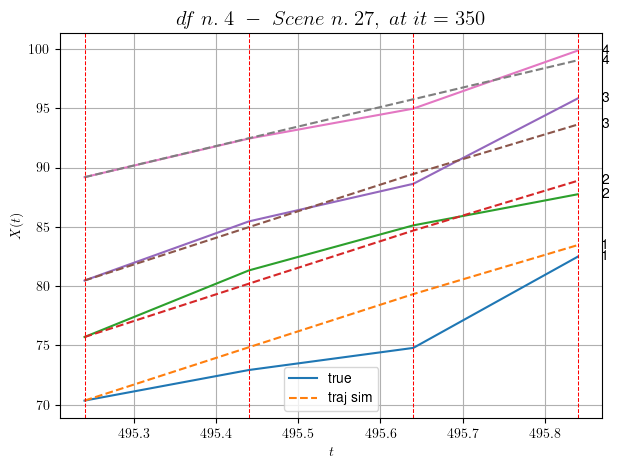

        For scene 27/30
        * use LR_NN=0.0005 with err=10.329564933750362 at it=19
        * v0_scn_mean = 17.987511647231237
        * MAE = 2.1787576653000276



            - Time interval n.0: [541.84, 542.04]
                * y_true: [15.49040827 18.57067001 15.06113134]
                * v_ann: [18.873891830444336, 18.97077178955078, 18.96884536743164, 25.31225808344175]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [542.04, 542.24]
                * y_true: [18.02057424 22.22093452 14.29121645]
                * v_ann: [18.079965591430664, 17.535573959350586, 17.447664260864258, 25.31225808344175]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [542.24, 542.44]
                * y_true: [23.32090187 15.10072652 30.16295254]
                * v_ann: [18.21739387512207, 17.885873794555664, 17.723102569

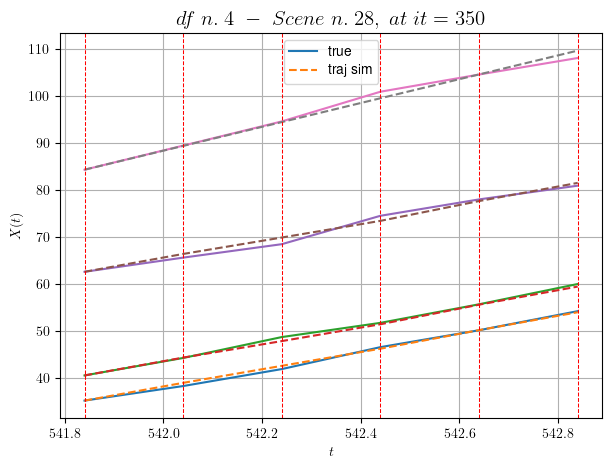

        For scene 28/30
        * use LR_NN=0.001 with err=18.53927221933096 at it=19
        * v0_scn_mean = 25.847320194922375
        * MAE = 0.45348749346666206



            - Time interval n.0: [559.04, 559.24]
                * y_true: [23.32160164 21.40183754 23.15354324]
                * v_ann: [18.03650665283203, 17.659549713134766, 18.032609939575195, 21.821996764913898]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [559.24, 559.44]
                * y_true: [16.34126249 10.38103794 18.30306556]
                * v_ann: [19.429094314575195, 19.772546768188477, 19.43281364440918, 21.821996764913898]

----------------------------------------------------------------------------------------------------
            * err= 0.40455116023815985
            * Learning rate NN = 0.00036449998151510954
            * diff = 1.5496389195068794e-05


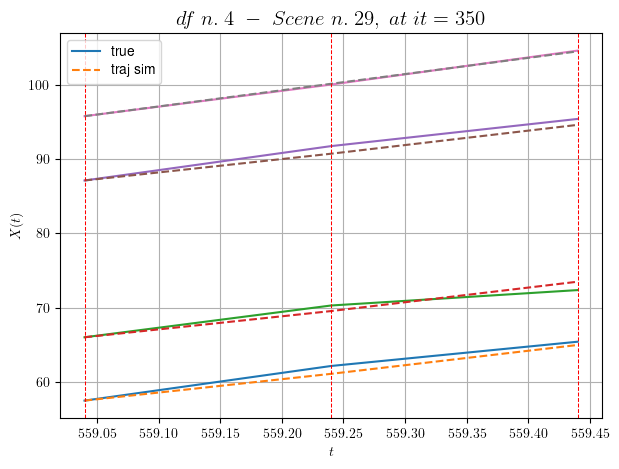

        For scene 29/30
        * use LR_NN=0.0005 with err=6.056725205738317 at it=19
        * v0_scn_mean = 22.755439722429795
        * MAE = 0.40385254154018235



For df=4 with 30 scenes, time taken:        385.53
------------------------------------------------------------
****************************************************************************************************
In df n.5/10 we have 14 scenes
****************************************************************************************************
            - Time interval n.0: [23.72, 23.92]
                * y_true: [21.79018354 24.07032953]
                * v_ann: [20.854248046875, 18.62174415588379, 24.534843225110123]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.92, 24.12]
                * y_true: [25.91031727 27.52052784]
                * v_ann: [22.22658348083496, 22.547828674316406, 24.534843225110123]

----------------

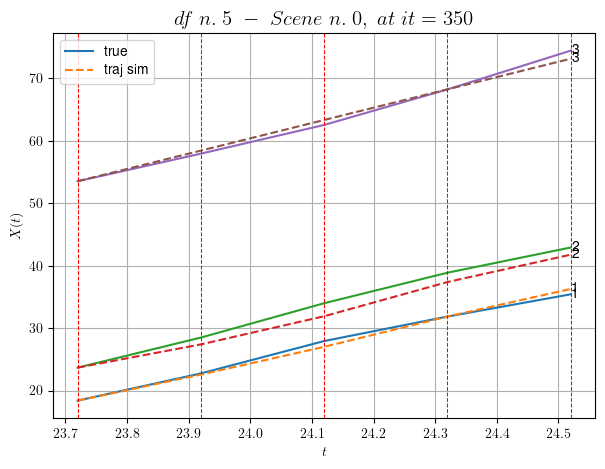

        For scene 0/14
        * use LR_NN=0.001 with err=22.37991914450245 at it=19
        * v0_scn_mean = 25.003245611461182
        * MAE = 0.3978076498477055



            - Time interval n.0: [28.12, 28.32]
                * y_true: [22.39001619 28.9506918 ]
                * v_ann: [26.571012496948242, 26.080366134643555, 25.379417180280765]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [28.32, 28.52]
                * y_true: [21.14004613 26.65085251]
                * v_ann: [26.556703567504883, 25.891538619995117, 25.379417180280765]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [28.52, 28.72]
                * y_true: [24.23010561 33.45140848]
                * v_ann: [26.121997833251953, 25.388044357299805, 25.379417180280765]

-----------------------------------------------------------------------

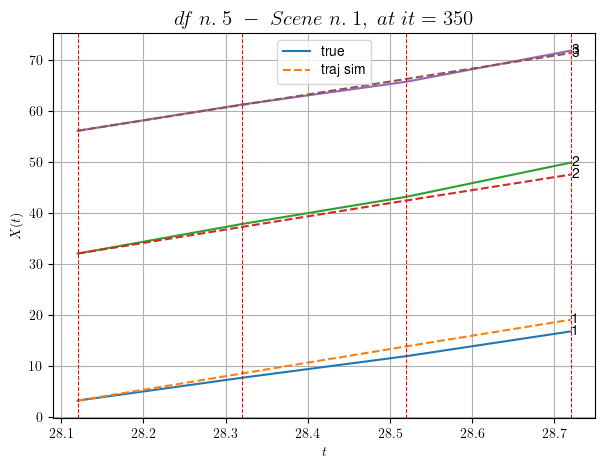

        For scene 1/14
        * use LR_NN=0.0001 with err=4.84341037898185 at it=19
        * v0_scn_mean = 25.775433636575954
        * MAE = 1.376288915046049



        For scene 2/14
        * use LR_NN=0.001 with err=28.946807036658317 at it=19
        * v0_scn_mean = 32.82381350018765
        * MAE = 6.231759360038391



            - Time interval n.0: [151.12, 151.32]
                * y_true: [20.88055844 29.97204611]
                * v_ann: [27.78091812133789, 26.95611572265625, 31.516127782594133]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [151.32, 151.52]
                * y_true: [26.72089495 29.6522691 ]
                * v_ann: [26.347238540649414, 26.017608642578125, 31.516127782594133]

----------------------------------------------------------------------------------------------------
            * err= 0.6804538204181244
            * Learning rate NN = 0.0003644999815151095

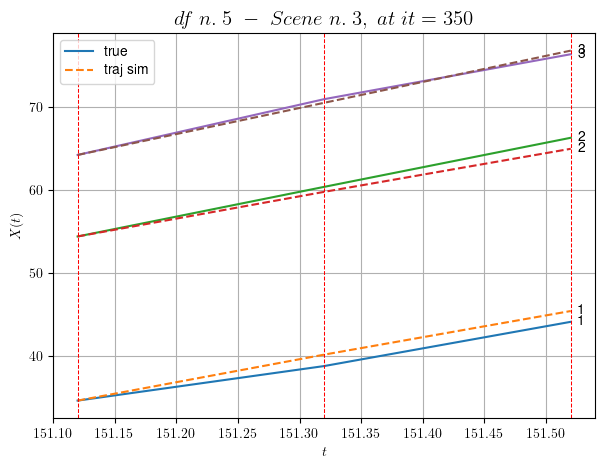

        For scene 3/14
        * use LR_NN=0.0005 with err=5.712129294558785 at it=19
        * v0_scn_mean = 31.386184964733143
        * MAE = 0.6804538204181244



            - Time interval n.0: [177.32, 177.52]
                * y_true: [23.78017477 21.57540501]
                * v_ann: [27.596004486083984, 28.34312629699707, 26.180405984731102]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [177.52, 177.72]
                * y_true: [28.99044664 21.37044807]
                * v_ann: [25.45362663269043, 25.667606353759766, 26.180405984731102]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [177.72, 177.92]
                * y_true: [30.9005134  20.55062028]
                * v_ann: [25.27083969116211, 25.49071502685547, 26.180405984731102]

--------------------------------------------------------------------

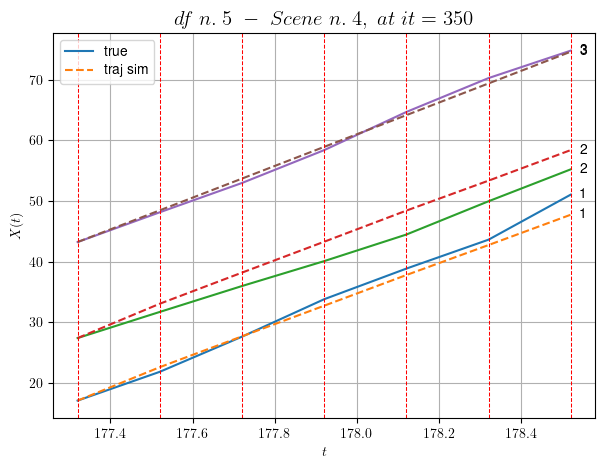

        For scene 4/14
        * use LR_NN=0.001 with err=39.54488776486084 at it=19
        * v0_scn_mean = 26.507772065035294
        * MAE = 3.373454806970363



            - Time interval n.0: [266.92, 267.12]
                * y_true: [18.75024149 31.34179995]
                * v_ann: [31.245569229125977, 29.732542037963867, 29.08570823249262]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [267.12, 267.32]
                * y_true: [26.80047756 43.40316595]
                * v_ann: [30.00052833557129, 28.95469093322754, 29.08570823249262]

----------------------------------------------------------------------------------------------------
            * err= 3.0003894025596263
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0016828562856456841


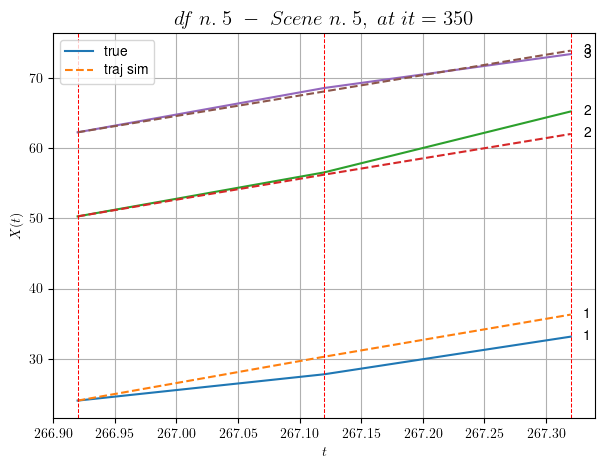

        For scene 5/14
        * use LR_NN=0.0001 with err=13.086830445778922 at it=19
        * v0_scn_mean = 29.164069469573743
        * MAE = 3.0003894025596263



            - Time interval n.0: [316.92, 317.12]
                * y_true: [22.23560763 28.12633872]
                * v_ann: [25.255624771118164, 25.15438461303711, 22.342101196302174]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.12, 317.32]
                * y_true: [22.67586827 27.74684297]
                * v_ann: [25.21703338623047, 25.168655395507812, 22.342101196302174]

----------------------------------------------------------------------------------------------------
            * err= 0.35611414918268003
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00032200460467807224


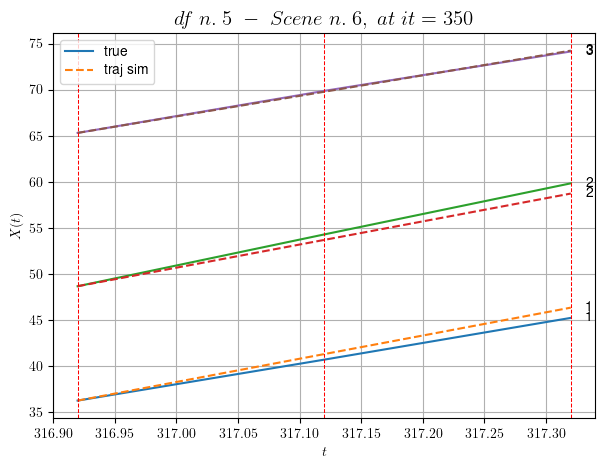

        For scene 6/14
        * use LR_NN=0.0005 with err=1.344792167071563 at it=19
        * v0_scn_mean = 22.998437001812267
        * MAE = 0.35611414918268003



        For scene 7/14
        * use LR_NN=0.0005 with err=8.872038973972758 at it=19
        * v0_scn_mean = 27.555695130783505
        * MAE = 0.031693147623850934



        For scene 8/14
        * use LR_NN=0.0001 with err=1.8534704362548384 at it=19
        * v0_scn_mean = 34.5676129260245
        * MAE = 0.006066595481499316



            - Time interval n.0: [338.52, 338.72]
                * y_true: [22.83038671 20.44060351]
                * v_ann: [24.00790786743164, 24.039936065673828, 27.85394393324863]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [338.72, 338.92]
                * y_true: [25.85061095 23.65082523]
                * v_ann: [23.213930130004883, 23.249853134155273, 27.85394393324863]

-------------------

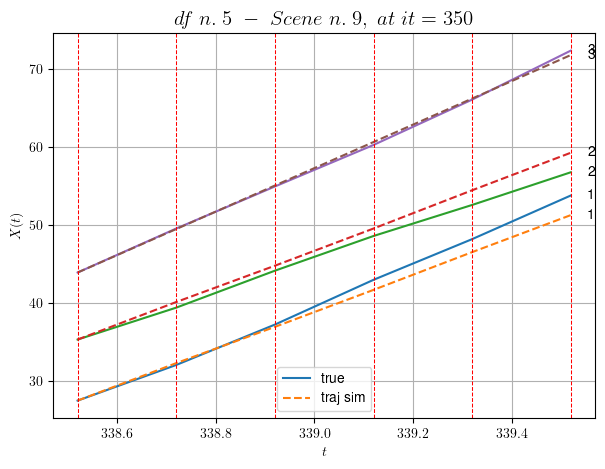

        For scene 9/14
        * use LR_NN=0.001 with err=11.45933874800915 at it=19
        * v0_scn_mean = 28.03787603699505
        * MAE = 1.2637001438313282



            - Time interval n.0: [435.72, 435.92]
                * y_true: [16.6003121  32.10080247]
                * v_ann: [19.93157196044922, 17.737768173217773, 23.002320042478168]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [435.92, 436.12]
                * y_true: [17.55040576 22.4007406 ]
                * v_ann: [21.070938110351562, 20.351295471191406, 23.002320042478168]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [436.12, 436.32]
                * y_true: [16.72550921 26.8011085 ]
                * v_ann: [20.788841247558594, 20.038509368896484, 23.002320042478168]

-------------------------------------------------------------------

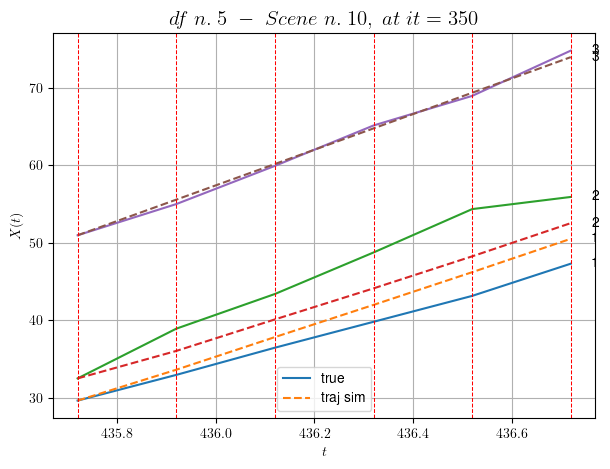

        For scene 10/14
        * use LR_NN=0.001 with err=12.708785462390667 at it=19
        * v0_scn_mean = 23.602070447825238
        * MAE = 6.485975380816606



        For scene 11/14
        * use LR_NN=5e-05 with err=2.519702720549943 at it=19
        * v0_scn_mean = 23.023173097783857
        * MAE = 0.1617180833463764



        For scene 12/14
        * use LR_NN=5e-05 with err=3.6272943384738316 at it=19
        * v0_scn_mean = 21.768162114368614
        * MAE = 0.09587209625620652



            - Time interval n.0: [178.12, 178.32]
                * y_true: [23.59034379 23.87574209 27.4762805 ]
                * v_ann: [27.049732208251953, 26.55219268798828, 27.442546844482422, 26.192903384607693]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [178.32, 178.52]
                * y_true: [17.35034213 37.1766426  26.34131635]
                * v_ann: [24.800289154052734, 25.0649642944335

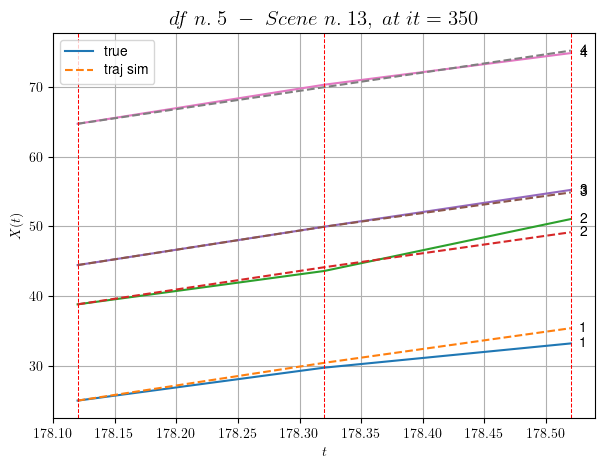

        For scene 13/14
        * use LR_NN=0.001 with err=6.633990384732595 at it=19
        * v0_scn_mean = 26.62744803102857
        * MAE = 0.7889660733497422



For df=5 with 14 scenes, time taken:        123.58
------------------------------------------------------------
****************************************************************************************************
In df n.6/10 we have 3 scenes
****************************************************************************************************
            - Time interval n.0: [552.20, 552.40]
                * y_true: [14.01030513 13.18063102]
                * v_ann: [17.98832130432129, 18.264387130737305, 20.23327561277354]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [552.40, 552.60]
                * y_true: [18.39048446 22.9012939 ]
                * v_ann: [17.713165283203125, 17.92610740661621, 20.23327561277354]

---------------

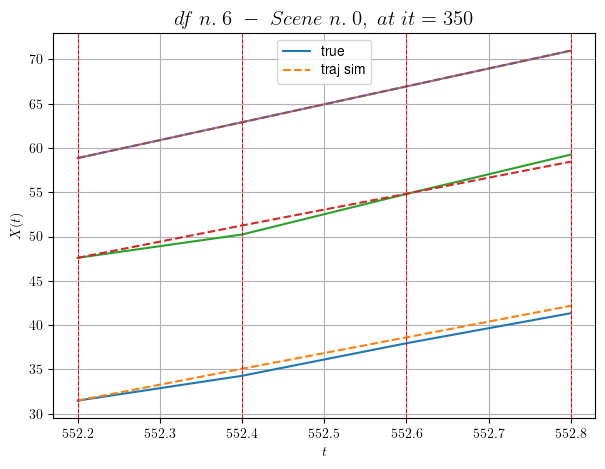

        For scene 0/3
        * use LR_NN=0.0001 with err=5.827966396328455 at it=19
        * v0_scn_mean = 21.070352607678135
        * MAE = 0.2527649446254046



            - Time interval n.0: [553.00, 553.20]
                * y_true: [23.0804555  19.17546127 18.9008181 ]
                * v_ann: [19.446287155151367, 19.416067123413086, 19.380870819091797, 23.749701248855562]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [553.20, 553.40]
                * y_true: [22.02058024 17.45053567 16.85079909]
                * v_ann: [19.69818115234375, 19.737741470336914, 19.782115936279297, 23.749701248855562]

----------------------------------------------------------------------------------------------------
            * err= 0.262600446451226
            * Learning rate NN = 0.00036449998151510954
            * diff = 5.330424874605555e-06


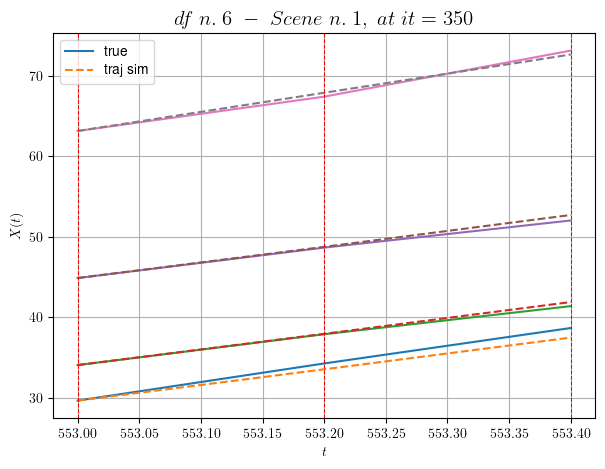

        For scene 1/3
        * use LR_NN=0.0005 with err=6.111820509635211 at it=19
        * v0_scn_mean = 24.463114680460983
        * MAE = 0.2589689744827662



            - Time interval n.0: [554.00, 554.20]
                * y_true: [20.50061186 21.35116733 22.20133365]
                * v_ann: [1.1556515293331682e-11, 22.48297119140625, 4.8333491577068344e-05, 23.647953726266184]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.20, 554.40]
                * y_true: [18.86075328 25.85180384 21.5614577 ]
                * v_ann: [5.523895577064231e-12, 20.918298721313477, 4.710621578851715e-05, 23.647953726266184]

----------------------------------------------------------------------------------------------------
            * err= 14.661504817300207
            * Learning rate NN = 0.0036449995823204517
            * diff = 3.808356461831863e-05


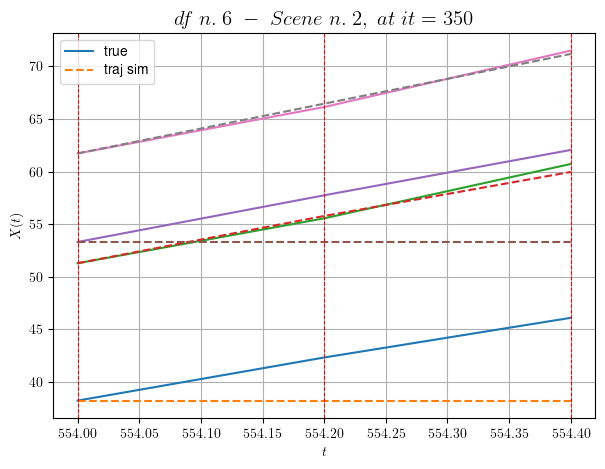

        For scene 2/3
        * use LR_NN=0.005 with err=6.905315182065959 at it=19
        * v0_scn_mean = 24.372980690622427
        * MAE = 0.9444093903040114



For df=6 with 3 scenes, time taken:        23.10
------------------------------------------------------------
****************************************************************************************************
In df n.7/10 we have 8 scenes
****************************************************************************************************
            - Time interval n.0: [38.56, 38.76]
                * y_true: [34.50899027 34.29923068]
                * v_ann: [31.241336822509766, 32.1526985168457, 28.99001788809879]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.76, 38.96]
                * y_true: [33.76780394 27.40980382]
                * v_ann: [32.858699798583984, 33.66453170776367, 28.99001788809879]

-----------------------

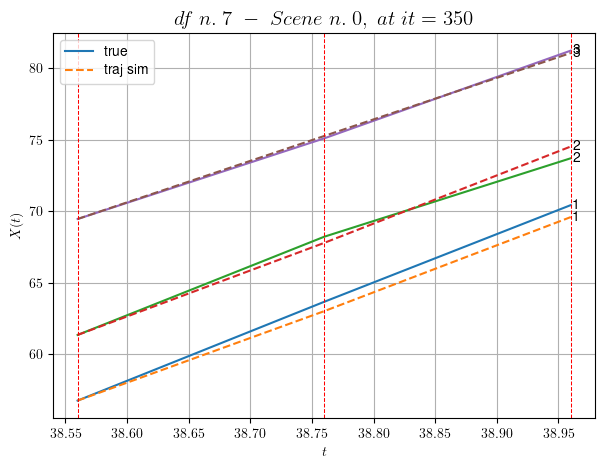

        For scene 0/8
        * use LR_NN=0.001 with err=3.496773452554415 at it=19
        * v0_scn_mean = 29.076580460934764
        * MAE = 0.14432000389883462



            - Time interval n.0: [39.76, 39.96]
                * y_true: [22.5368218  26.50901133]
                * v_ann: [27.38041114807129, 7.928321961107046e-19, 28.629762622553923]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [39.96, 40.16]
                * y_true: [27.13488394 22.34107329]
                * v_ann: [24.963153839111328, 1.0412504055883822e-18, 28.629762622553923]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [40.16, 40.36]
                * y_true: [29.97962766 28.56631616]
                * v_ann: [26.262500762939453, 3.6014555297635184e-21, 28.629762622553923]

-------------------------------------------------------------

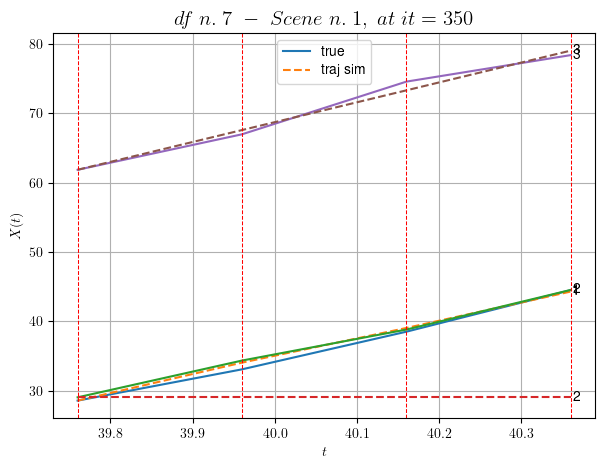

        For scene 1/8
        * use LR_NN=0.001 with err=26.13285521391444 at it=19
        * v0_scn_mean = 28.747201606264717
        * MAE = 4.479765584612904



        For scene 2/8
        * use LR_NN=5e-05 with err=3.054350209800211 at it=19
        * v0_scn_mean = 22.570795193223542
        * MAE = 36.66835326665806



        For scene 3/8
        * use LR_NN=0.0001 with err=1.9471512765043721 at it=19
        * v0_scn_mean = 33.17444584784243
        * MAE = 14.206049784928117



            - Time interval n.0: [165.76, 165.96]
                * y_true: [14.62535373 14.97522028]
                * v_ann: [14.068140029907227, 14.365582466125488, 27.26222960772804]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [165.96, 166.16]
                * y_true: [14.90483904 10.97892299]
                * v_ann: [14.21042251586914, 14.382268905639648, 27.26222960772804]

------------------------------

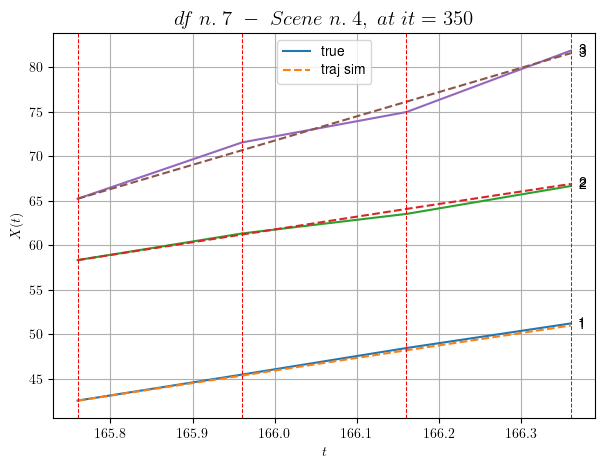

        For scene 4/8
        * use LR_NN=0.0005 with err=1.408080723261439 at it=19
        * v0_scn_mean = 27.49687579224644
        * MAE = 0.226224679315972



            - Time interval n.0: [188.16, 188.36]
                * y_true: [18.26365072 21.2472937 ]
                * v_ann: [20.070146560668945, 21.54986572265625, 24.89864510474215]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [188.36, 188.56]
                * y_true: [19.58083161 26.63811802]
                * v_ann: [20.138891220092773, 21.64636993408203, 24.89864510474215]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [188.56, 188.76]
                * y_true: [19.1135942  21.22632097]
                * v_ann: [20.348405838012695, 21.665815353393555, 24.89864510474215]

------------------------------------------------------------------------

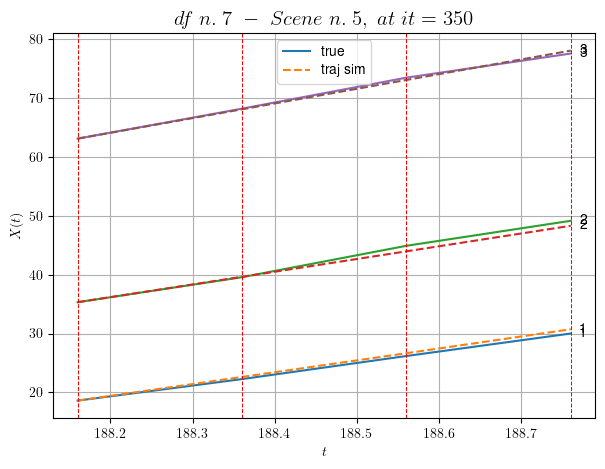

        For scene 5/8
        * use LR_NN=1e-05 with err=2.2842028477461143 at it=19
        * v0_scn_mean = 25.335867110438556
        * MAE = 0.22737931252607768



            - Time interval n.0: [220.96, 221.16]
                * y_true: [27.25777683 27.84910592]
                * v_ann: [28.194000244140625, 28.371591567993164, 26.579870119515892]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [221.16, 221.36]
                * y_true: [24.9447965  32.01250046]
                * v_ann: [27.78711700439453, 27.69048500061035, 26.579870119515892]

----------------------------------------------------------------------------------------------------
            * err= 0.1855390223011761
            * Learning rate NN = 0.00036449998151510954
            * diff = 8.471673654336653e-06


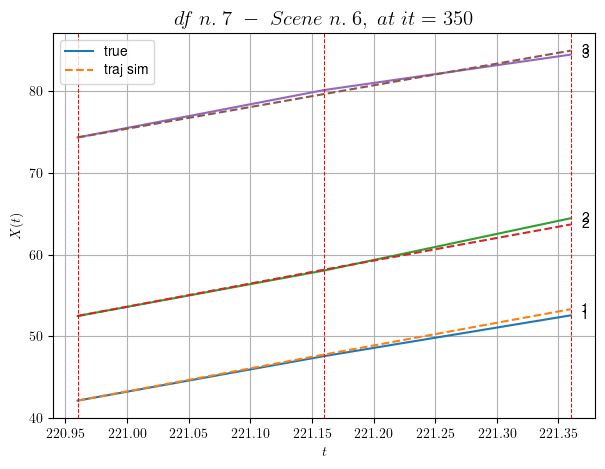

        For scene 6/8
        * use LR_NN=0.0005 with err=3.1149043257284874 at it=19
        * v0_scn_mean = 26.872999312992626
        * MAE = 0.1740917557000945



            - Time interval n.0: [166.56, 166.76]
                * y_true: [17.24164345 15.73752306 15.58083022]
                * v_ann: [18.038522720336914, 17.930469512939453, 17.977502822875977, 17.37043158542254]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [166.76, 166.96]
                * y_true: [18.38470966 27.72552812  9.3330177 ]
                * v_ann: [16.658679962158203, 17.17434310913086, 16.920698165893555, 17.37043158542254]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.96, 167.16]
                * y_true: [16.02323775 24.97208403 13.98221987]
                * v_ann: [17.86948585510254, 17.815996170043945, 17.8464298248

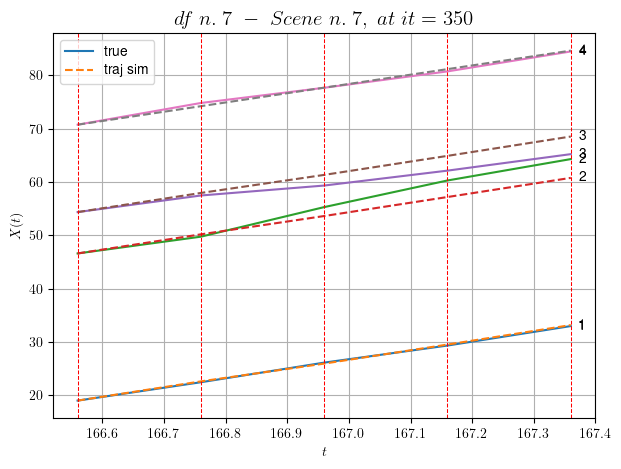

        For scene 7/8
        * use LR_NN=0.001 with err=26.274918623559444 at it=19
        * v0_scn_mean = 18.81197927795333
        * MAE = 2.4176958687119594



For df=7 with 8 scenes, time taken:        70.37
------------------------------------------------------------
****************************************************************************************************
In df n.8/10 we have 21 scenes
****************************************************************************************************
        For scene 0/21
        * use LR_NN=0.001 with err=17.723622511757483 at it=19
        * v0_scn_mean = 18.532749214531986
        * MAE = 1.5726945836824882



            - Time interval n.0: [50.24, 50.44]
                * y_true: [14.83043604 14.50055453]
                * v_ann: [19.553232192993164, 22.68970489501953, 30.15765983487899]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [50.44

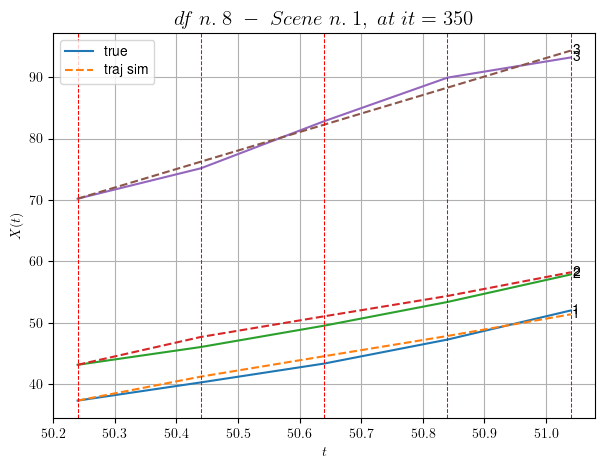

        For scene 1/21
        * use LR_NN=0.001 with err=11.263039167496062 at it=19
        * v0_scn_mean = 30.1441472777959
        * MAE = 0.8114558269989333



            - Time interval n.0: [102.24, 102.44]
                * y_true: [22.78095819 15.94092959]
                * v_ann: [20.4591121673584, 20.55213165283203, 31.34828224079019]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [102.44, 102.64]
                * y_true: [23.36120187 12.10080168]
                * v_ann: [20.159318923950195, 20.509183883666992, 31.34828224079019]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [102.64, 102.84]
                * y_true: [20.51121756 22.37162153]
                * v_ann: [19.565839767456055, 19.862445831298828, 31.34828224079019]

------------------------------------------------------------------------

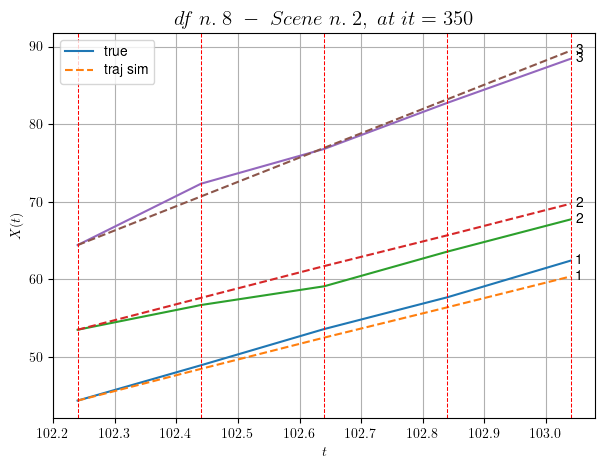

        For scene 2/21
        * use LR_NN=0.0005 with err=12.951549770621776 at it=19
        * v0_scn_mean = 31.232724966758735
        * MAE = 1.8290437299634101



            - Time interval n.0: [108.84, 109.04]
                * y_true: [17.9810803  26.65193678]
                * v_ann: [20.75617790222168, 20.52260398864746, 20.549083403843284]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.04, 109.24]
                * y_true: [14.30252156 22.9019425 ]
                * v_ann: [21.440046310424805, 21.456668853759766, 20.549083403843284]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.24, 109.44]
                * y_true: [21.24158827 21.25204953]
                * v_ann: [20.12311553955078, 19.943696975708008, 20.549083403843284]

------------------------------------------------------------------

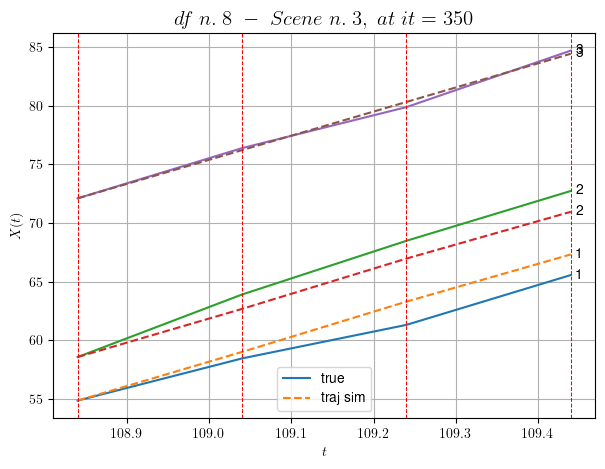

        For scene 3/21
        * use LR_NN=0.001 with err=5.938983920668502 at it=19
        * v0_scn_mean = 21.359093449151537
        * MAE = 1.215155775263015



            - Time interval n.0: [130.04, 130.24]
                * y_true: [23.9806113  21.72216875]
                * v_ann: [23.42658805847168, 23.317914962768555, 41.055542418781506]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.24, 130.44]
                * y_true: [20.38064152 27.22317612]
                * v_ann: [23.284038543701172, 23.2742919921875, 41.055542418781506]

----------------------------------------------------------------------------------------------------
            * err= 0.0690316699723073
            * Learning rate NN = 7.289998757187277e-05
            * diff = 2.3888021956769423e-06


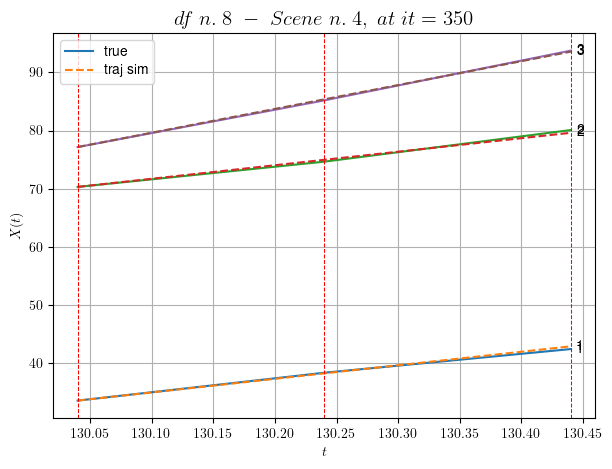

        For scene 4/21
        * use LR_NN=0.0001 with err=9.665651100934035 at it=19
        * v0_scn_mean = 40.10800465094372
        * MAE = 0.0690316699723073



            - Time interval n.0: [215.24, 215.44]
                * y_true: [ 1.34614625 10.42531549]
                * v_ann: [19.0433292388916, 21.01545524597168, 15.100797270465677]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.44, 215.64]
                * y_true: [18.28906766 10.32533879]
                * v_ann: [15.008308410644531, 13.427153587341309, 15.100797270465677]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.64, 215.84]
                * y_true: [29.02100933 15.78058213]
                * v_ann: [15.167572975158691, 13.538674354553223, 15.100797270465677]

--------------------------------------------------------------------

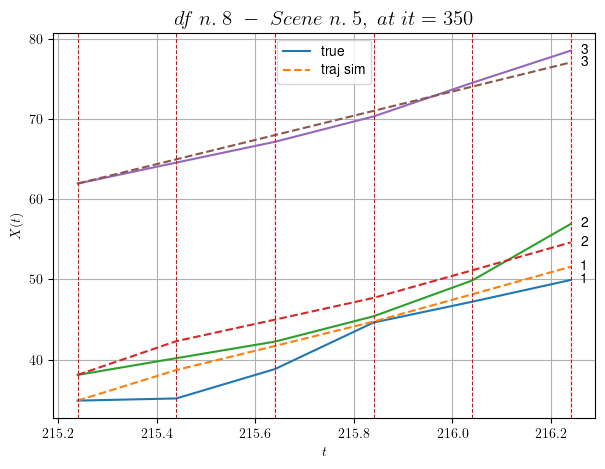

        For scene 5/21
        * use LR_NN=0.001 with err=46.43473520584772 at it=19
        * v0_scn_mean = 16.377763769452134
        * MAE = 2.829795379681394



            - Time interval n.0: [222.64, 222.84]
                * y_true: [3.4148313  7.54419185]
                * v_ann: [6.456457138061523, 4.829220294952393, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [222.84, 223.04]
                * y_true: [1.34614625 9.61287691]
                * v_ann: [7.088357925415039, 4.772531032562256, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.04, 223.24]
                * y_true: [ 1.34614625 10.20300693]
                * v_ann: [6.963418960571289, 4.716510772705078, 12.428665091344943]

----------------------------------------------------------------------------

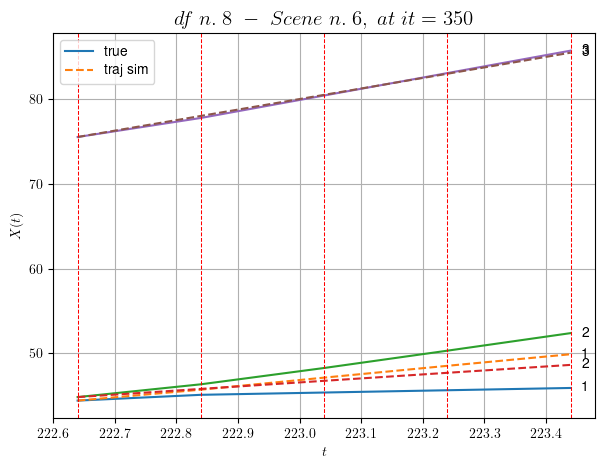

        For scene 6/21
        * use LR_NN=1e-05 with err=24.698874693523837 at it=19
        * v0_scn_mean = 13.934652118177068
        * MAE = 3.4061783058924875



            - Time interval n.0: [225.24, 225.44]
                * y_true: [9.85023046 1.34614625]
                * v_ann: [9.66262435913086, 9.715965270996094, 13.143805199617391]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.44, 225.64]
                * y_true: [11.30531094  1.34614625]
                * v_ann: [8.569778442382812, 8.402548789978027, 13.143805199617391]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.64, 225.84]
                * y_true: [12.27536459  1.34614625]
                * v_ann: [8.07808780670166, 7.726049900054932, 13.143805199617391]

--------------------------------------------------------------------------

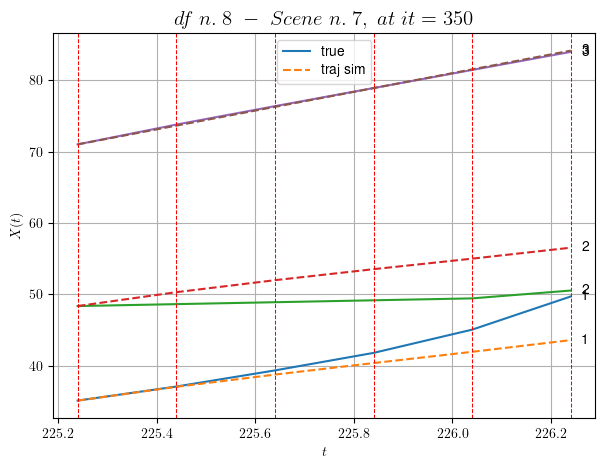

        For scene 7/21
        * use LR_NN=0.001 with err=51.67446144292737 at it=19
        * v0_scn_mean = 14.588499687719553
        * MAE = 7.924859545075228



            - Time interval n.0: [227.04, 227.24]
                * y_true: [ 1.34614625 11.86069537]
                * v_ann: [7.919046401977539, 8.472051620483398, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [227.24, 227.44]
                * y_true: [ 1.34614625 11.90074479]
                * v_ann: [6.1361260414123535, 6.348659038543701, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.44, 227.64]
                * y_true: [ 1.34614625 14.03099458]
                * v_ann: [6.609355926513672, 6.9278883934021, 26.24318261171468]

----------------------------------------------------------------------------

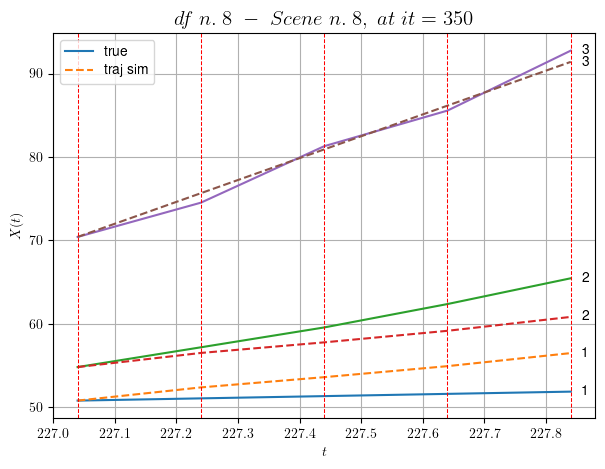

        For scene 8/21
        * use LR_NN=0.005 with err=2.8647486058031375 at it=19
        * v0_scn_mean = 26.56516829341416
        * MAE = 5.221945174665735



            - Time interval n.0: [237.64, 237.84]
                * y_true: [17.80043487 10.22573725]
                * v_ann: [15.803433418273926, 15.256808280944824, 29.702969638681957]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.84, 238.04]
                * y_true: [20.29063338 11.60088234]
                * v_ann: [14.280683517456055, 14.422944068908691, 29.702969638681957]

----------------------------------------------------------------------------------------------------
            * err= 0.7134662596165869
            * Learning rate NN = 0.0007289999630302191
            * diff = 5.982574554863618e-06


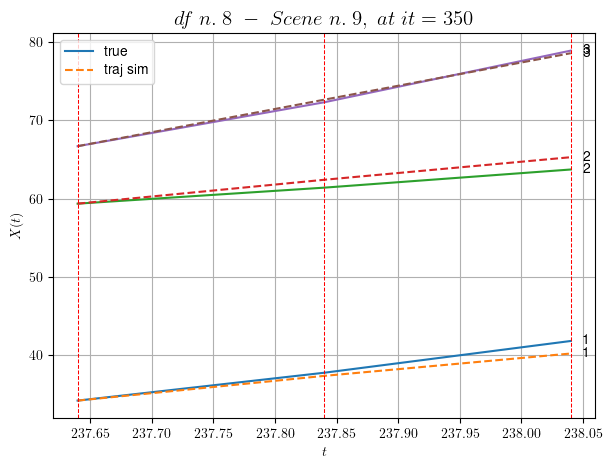

        For scene 9/21
        * use LR_NN=0.001 with err=0.4380376904516698 at it=19
        * v0_scn_mean = 29.728427230438445
        * MAE = 0.328877192649985



        For scene 10/21
        * use LR_NN=0.0005 with err=4.276271723360741 at it=19
        * v0_scn_mean = 30.115494083379403
        * MAE = 0.06335544038134495



            - Time interval n.0: [243.44, 243.64]
                * y_true: [18.26109982  7.28715228]
                * v_ann: [13.53023910522461, 12.17126178741455, 16.743010063526874]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [243.64, 243.84]
                * y_true: [23.05153691  9.06731774]
                * v_ann: [13.808846473693848, 11.868244171142578, 16.743010063526874]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [243.84, 244.04]
                * y_true: [10.5233463

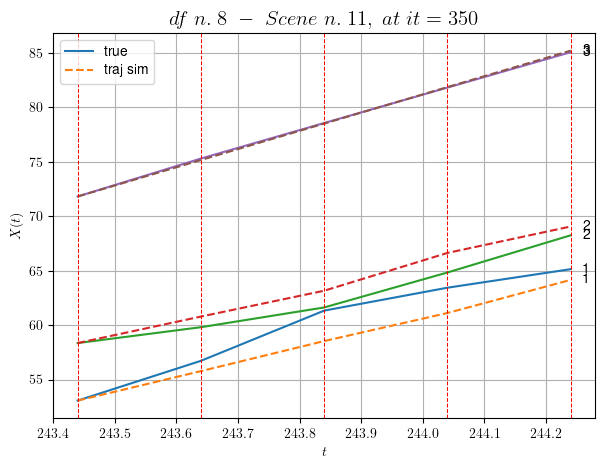

        For scene 11/21
        * use LR_NN=0.005 with err=23.55301058764068 at it=19
        * v0_scn_mean = 17.879227372169616
        * MAE = 1.19397100225737



            - Time interval n.0: [251.64, 251.84]
                * y_true: [14.32016282 17.2315068 ]
                * v_ann: [12.769160270690918, 15.603952407836914, 19.82497961154461]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [251.84, 252.04]
                * y_true: [20.34029568 17.65159646]
                * v_ann: [15.023040771484375, 16.036428451538086, 19.82497961154461]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [252.04, 252.24]
                * y_true: [20.93040622 16.61174803]
                * v_ann: [18.769975662231445, 17.02130699157715, 19.82497961154461]

----------------------------------------------------------------------

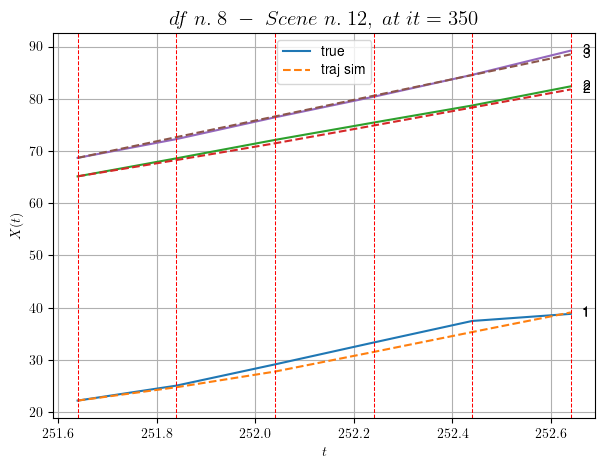

        For scene 12/21
        * use LR_NN=0.001 with err=32.3958984381105 at it=19
        * v0_scn_mean = 20.697050446369047
        * MAE = 0.6613853803912507



            - Time interval n.0: [290.84, 291.04]
                * y_true: [10.67508652 21.71084933]
                * v_ann: [16.030141830444336, 17.659624099731445, 25.378277675805748]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [291.04, 291.24]
                * y_true: [ 9.47510968 18.71084105]
                * v_ann: [15.60049057006836, 16.805034637451172, 25.378277675805748]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [291.24, 291.44]
                * y_true: [ 9.47510968 24.76138307]
                * v_ann: [13.655182838439941, 14.485177993774414, 25.378277675805748]

------------------------------------------------------------------

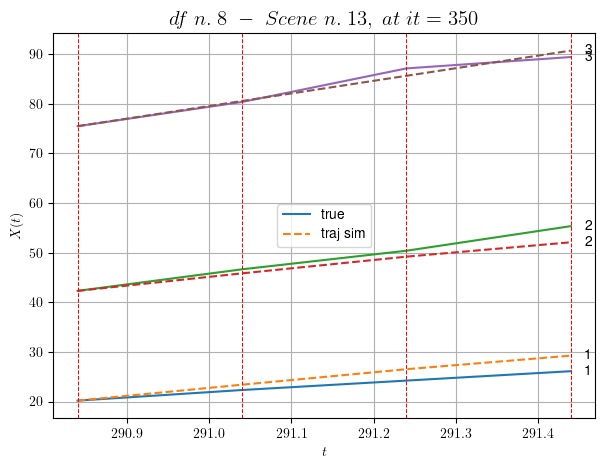

        For scene 13/21
        * use LR_NN=0.001 with err=2.326597890895313 at it=19
        * v0_scn_mean = 25.774391795651386
        * MAE = 2.682592558943338



            - Time interval n.0: [350.64, 350.84]
                * y_true: [14.24956692  9.34769854]
                * v_ann: [16.40984344482422, 17.82744026184082, 24.017599259794128]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [350.84, 351.04]
                * y_true: [ 4.06677119 24.77080184]
                * v_ann: [15.078886032104492, 15.206696510314941, 24.017599259794128]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [351.04, 351.24]
                * y_true: [15.46321179 18.97073364]
                * v_ann: [14.932426452636719, 14.849614143371582, 24.017599259794128]

-------------------------------------------------------------------

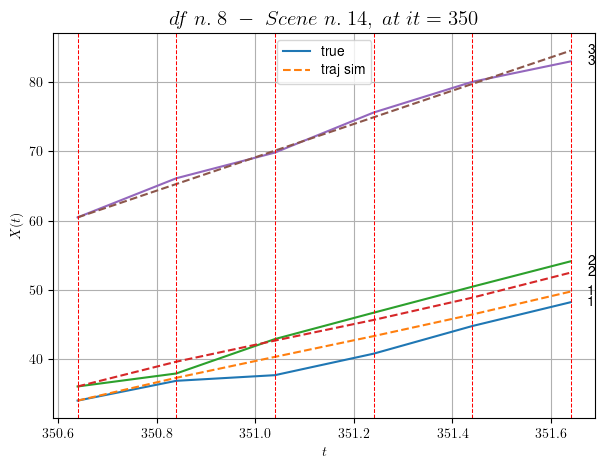

        For scene 14/21
        * use LR_NN=0.001 with err=11.627643537914159 at it=19
        * v0_scn_mean = 24.53033309310237
        * MAE = 1.7493082725673397



            - Time interval n.0: [368.84, 369.04]
                * y_true: [17.45059381  8.87536169]
                * v_ann: [15.287942886352539, 13.022669792175293, 17.012105849841006]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.04, 369.24]
                * y_true: [23.11801305  8.05829994]
                * v_ann: [15.293363571166992, 12.681038856506348, 17.012105849841006]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.24, 369.44]
                * y_true: [ 6.12528304 15.69072344]
                * v_ann: [9.425832748413086, 13.497004508972168, 17.012105849841006]

-----------------------------------------------------------------

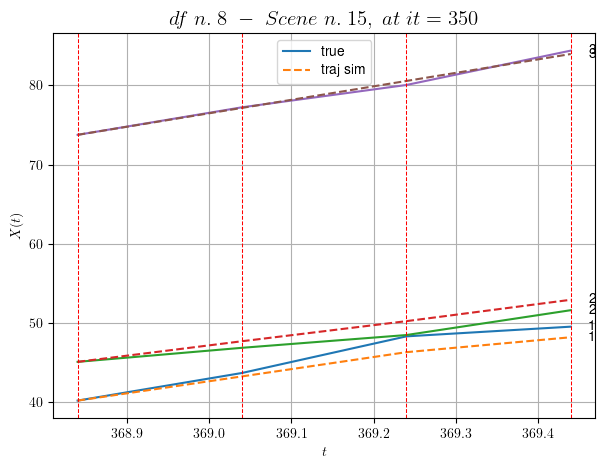

        For scene 15/21
        * use LR_NN=0.0005 with err=18.581029769336002 at it=19
        * v0_scn_mean = 18.125259756342118
        * MAE = 0.8500724086162491



            - Time interval n.0: [414.44, 414.64]
                * y_true: [25.58017481 23.93124381]
                * v_ann: [21.993837356567383, 21.492666244506836, 14.740338902151805]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.64, 414.84]
                * y_true: [28.7103211   9.12051681]
                * v_ann: [22.29669761657715, 21.59328269958496, 14.740338902151805]

----------------------------------------------------------------------------------------------------
            * err= 1.0061731843485677
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00022233731794862877


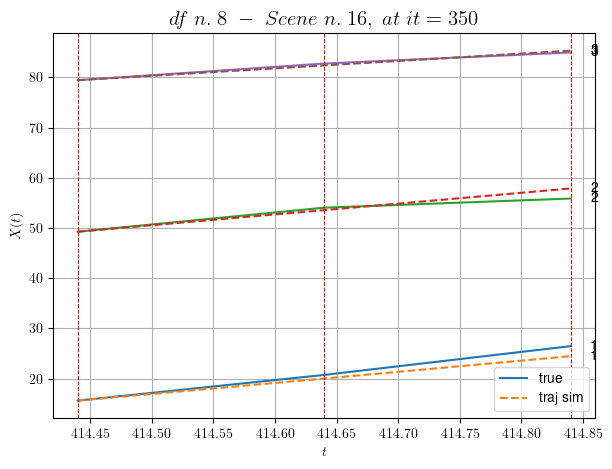

        For scene 16/21
        * use LR_NN=5e-05 with err=6.065743015568681 at it=19
        * v0_scn_mean = 16.048199219349087
        * MAE = 1.0061731843485677



            - Time interval n.0: [477.84, 478.04]
                * y_true: [17.90015387 15.74042221]
                * v_ann: [18.743167877197266, 18.829832077026367, 21.26822239699199]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [478.04, 478.24]
                * y_true: [18.02021575 17.32056356]
                * v_ann: [18.626806259155273, 18.663837432861328, 21.26822239699199]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [478.24, 478.44]
                * y_true: [20.95033635 22.3908747 ]
                * v_ann: [18.57052993774414, 18.57819938659668, 21.26822239699199]

---------------------------------------------------------------------

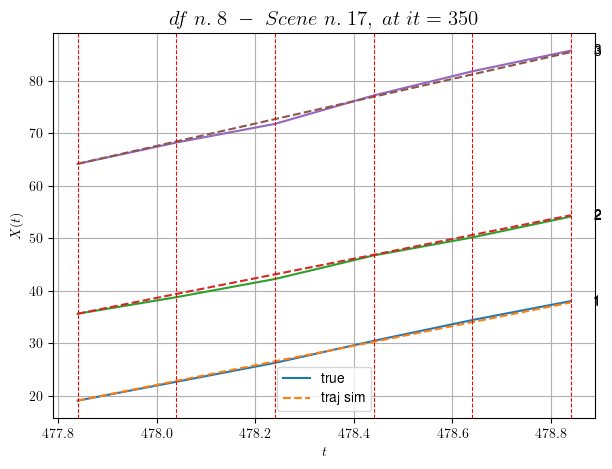

        For scene 17/21
        * use LR_NN=0.0001 with err=16.13646738537351 at it=19
        * v0_scn_mean = 22.016597171001806
        * MAE = 0.17686454862594347



            - Time interval n.0: [522.64, 522.84]
                * y_true: [ 6.78505349 16.71042372]
                * v_ann: [13.57499885559082, 13.933087348937988, 25.15600788472012]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [522.84, 523.04]
                * y_true: [ 7.85007105 23.28071684]
                * v_ann: [13.44108772277832, 13.692818641662598, 25.15600788472012]

----------------------------------------------------------------------------------------------------
            * err= 1.6528019475872913
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0019676816465534763


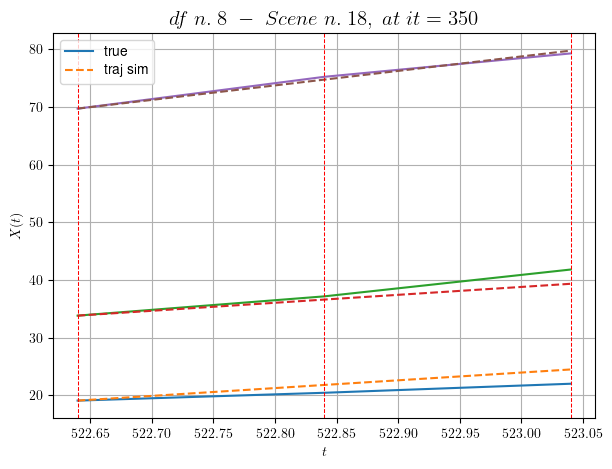

        For scene 18/21
        * use LR_NN=0.0001 with err=0.8769931513471986 at it=19
        * v0_scn_mean = 25.571172089467968
        * MAE = 1.6528019475872913



            - Time interval n.0: [593.04, 593.24]
                * y_true: [18.14041096 18.46062677]
                * v_ann: [18.79123878479004, 19.069679260253906, 20.297906154933845]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [593.24, 593.44]
                * y_true: [15.67042287 23.16095213]
                * v_ann: [18.740686416625977, 18.894468307495117, 20.297906154933845]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [593.44, 593.64]
                * y_true: [13.25043489 21.00101152]
                * v_ann: [19.067617416381836, 19.03805160522461, 20.297906154933845]

----------------------------------------------------------------

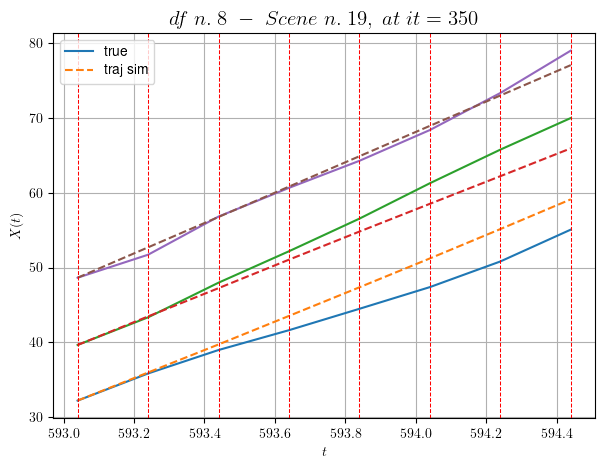

        For scene 19/21
        * use LR_NN=0.0005 with err=30.652235969000895 at it=19
        * v0_scn_mean = 21.129443857659577
        * MAE = 4.551453643603584



            - Time interval n.0: [256.44, 256.64]
                * y_true: [ 7.48303167 10.07767618 21.73093279]
                * v_ann: [11.27326774597168, 15.307741165161133, 15.69576358795166, 17.106091873677283]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [256.64, 256.84]
                * y_true: [13.09283525 13.17831107 21.42106847]
                * v_ann: [16.114652633666992, 16.144750595092773, 15.098642349243164, 17.106091873677283]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [256.84, 257.04]
                * y_true: [11.5255681  16.82586504 17.99104223]
                * v_ann: [16.154682159423828, 16.09823226928711, 15.28979873

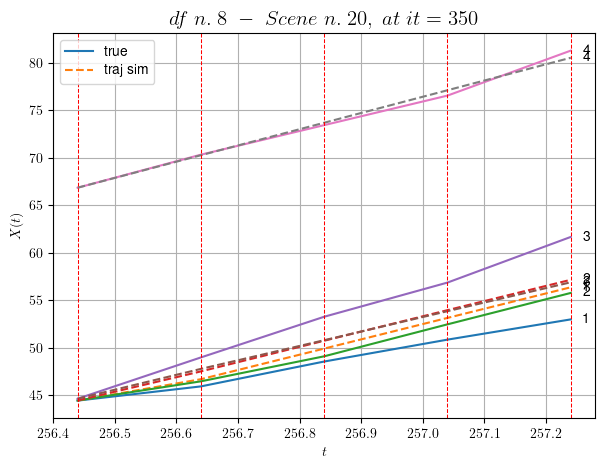

        For scene 20/21
        * use LR_NN=0.001 with err=18.717874211113788 at it=19
        * v0_scn_mean = 18.577811484123593
        * MAE = 3.3045756698967392



For df=8 with 21 scenes, time taken:        236.66
------------------------------------------------------------
****************************************************************************************************
In df n.9/10 we have 9 scenes
****************************************************************************************************
            - Time interval n.0: [5.40, 5.60]
                * y_true: [17.46255149 32.38946228]
                * v_ann: [26.482248306274414, 26.955896377563477, 29.081113719923103]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [5.60, 5.80]
                * y_true: [27.89361325 30.52270411]
                * v_ann: [24.16565704345703, 26.192485809326172, 29.081113719923103]

------------------

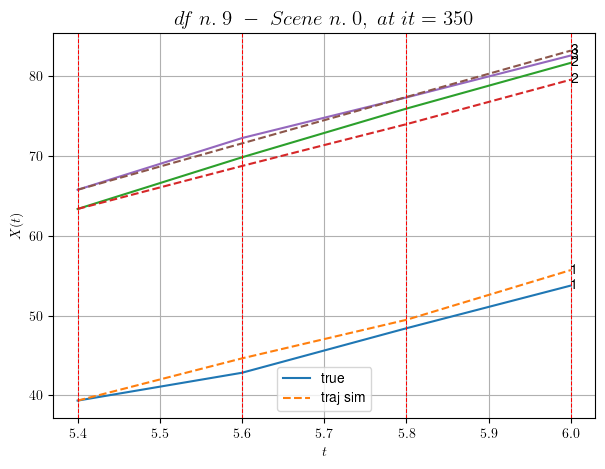

        For scene 0/9
        * use LR_NN=0.001 with err=29.097662498836282 at it=19
        * v0_scn_mean = 29.159868739056456
        * MAE = 1.2740587697071997



        For scene 1/9
        * use LR_NN=0.001 with err=14.686070931388544 at it=19
        * v0_scn_mean = 32.4599909897823
        * MAE = 0.1438486094691862



            - Time interval n.0: [37.80, 38.00]
                * y_true: [21.35828745 27.25004814]
                * v_ann: [21.636341094970703, 21.82838249206543, 23.639097032447108]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.00, 38.20]
                * y_true: [19.23626153 17.91519282]
                * v_ann: [22.60835075378418, 22.485485076904297, 23.639097032447108]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [38.20, 38.40]
                * y_true: [24.96063116 28.627719

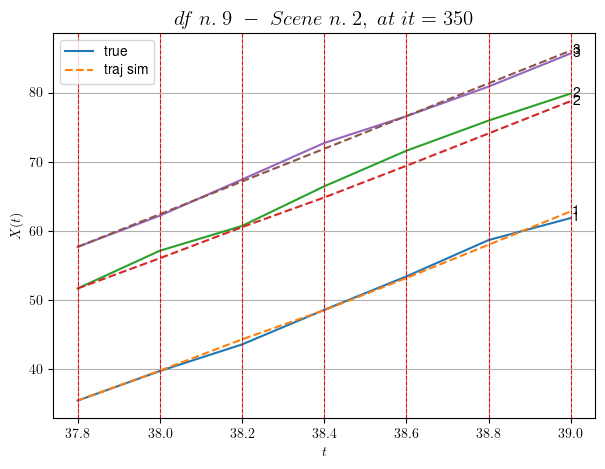

        For scene 2/9
        * use LR_NN=0.001 with err=39.49935035707844 at it=19
        * v0_scn_mean = 24.184271169635398
        * MAE = 0.7604253746311339



            - Time interval n.0: [44.40, 44.60]
                * y_true: [24.95803839 22.94664651]
                * v_ann: [25.85934829711914, 26.19890594482422, 18.016193314109287]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [44.60, 44.80]
                * y_true: [22.38974011 30.85088397]
                * v_ann: [24.655689239501953, 24.2393856048584, 18.016193314109287]

----------------------------------------------------------------------------------------------------
            * err= 0.15895671071176018
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.096332978486105e-05


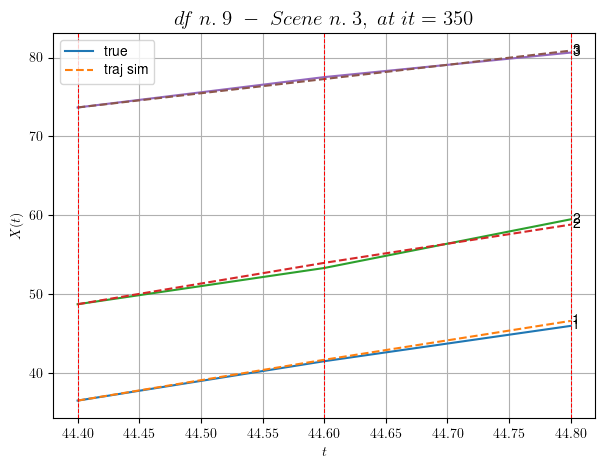

        For scene 3/9
        * use LR_NN=0.0005 with err=5.49634370997168 at it=19
        * v0_scn_mean = 19.043289860549013
        * MAE = 0.1573934309409676



            - Time interval n.0: [117.80, 118.00]
                * y_true: [26.21501314 26.51617559]
                * v_ann: [25.822561264038086, 25.49262809753418, 32.94780433300785]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [118.00, 118.20]
                * y_true: [24.27291409 32.45579962]
                * v_ann: [25.897388458251953, 25.61943244934082, 32.94780433300785]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [118.20, 118.40]
                * y_true: [21.96072195 23.86482679]
                * v_ann: [26.173593521118164, 26.185243606567383, 32.94780433300785]

-----------------------------------------------------------------------

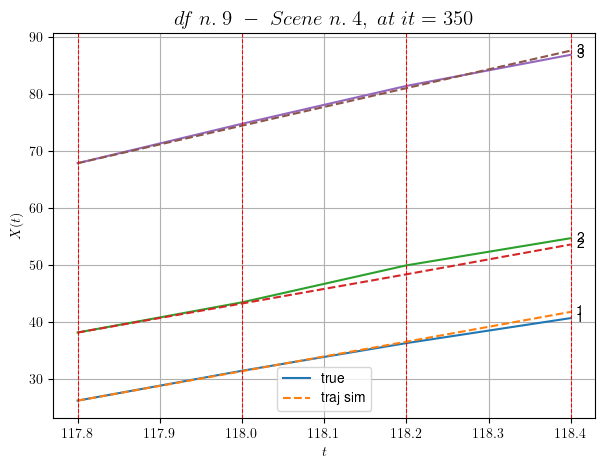

        For scene 4/9
        * use LR_NN=0.0001 with err=7.459190571943178 at it=19
        * v0_scn_mean = 32.695156762050566
        * MAE = 0.4639476641714781



            - Time interval n.0: [119.20, 119.40]
                * y_true: [23.20444186 22.52067771]
                * v_ann: [25.067319869995117, 25.065181732177734, 26.734613425844156]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [119.40, 119.60]
                * y_true: [27.39348249 26.5570173 ]
                * v_ann: [24.79079818725586, 24.796791076660156, 26.734613425844156]

----------------------------------------------------------------------------------------------------
            * err= 0.050565676997356056
            * Learning rate NN = 7.289998757187277e-05
            * diff = 3.0166665350023214e-05


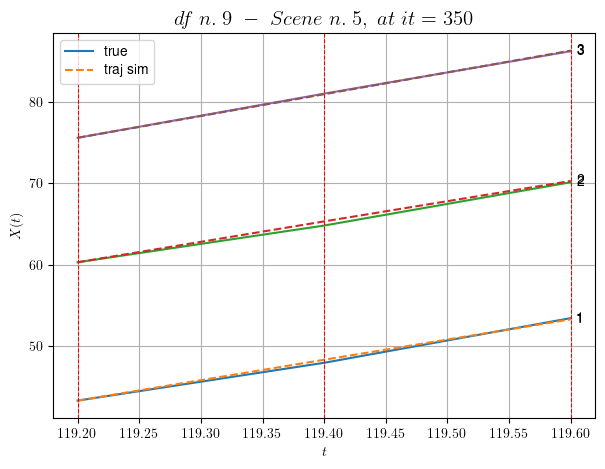

        For scene 5/9
        * use LR_NN=0.0001 with err=0.29589373042643946 at it=19
        * v0_scn_mean = 27.014480029254457
        * MAE = 0.050565676997356056



            - Time interval n.0: [120.20, 120.40]
                * y_true: [30.48045094 26.16776015]
                * v_ann: [26.70256233215332, 27.079845428466797, 27.349006463344075]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [120.40, 120.60]
                * y_true: [26.23623075 25.12734403]
                * v_ann: [26.842609405517578, 27.309593200683594, 27.349006463344075]

----------------------------------------------------------------------------------------------------
            * err= 0.1856315997407987
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00014096404542340846


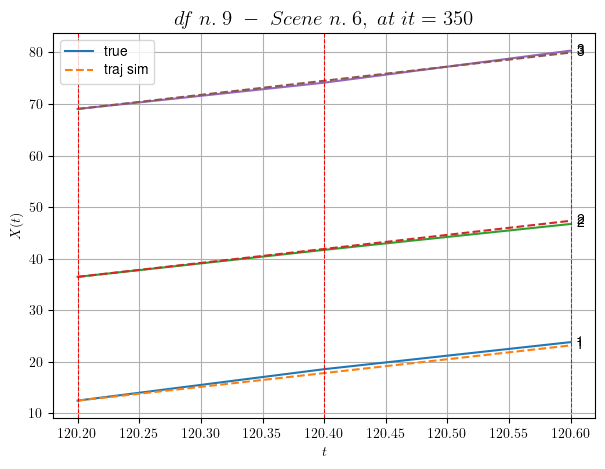

        For scene 6/9
        * use LR_NN=5e-05 with err=1.6225398445595165 at it=19
        * v0_scn_mean = 27.576215260807313
        * MAE = 0.1856315997407987



            - Time interval n.0: [121.40, 121.60]
                * y_true: [23.88369588 31.34452269]
                * v_ann: [25.71468162536621, 26.13770294189453, 28.657538135052054]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.60, 121.80]
                * y_true: [22.66516063 24.1738881 ]
                * v_ann: [26.545494079589844, 28.00457000732422, 28.657538135052054]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.80, 122.00]
                * y_true: [27.39865086 24.79107704]
                * v_ann: [24.517671585083008, 22.747560501098633, 28.657538135052054]

--------------------------------------------------------------------

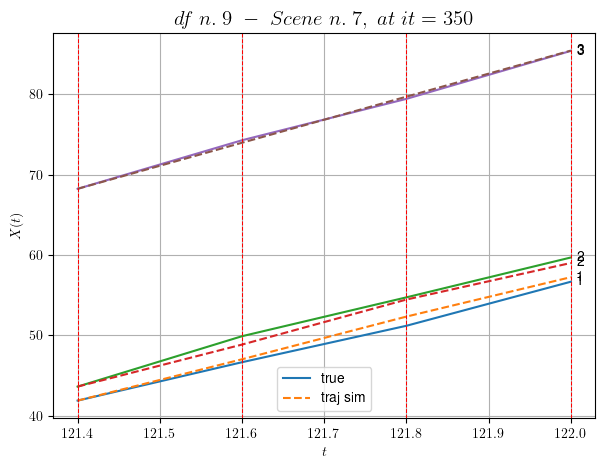

        For scene 7/9
        * use LR_NN=0.001 with err=9.789928960678786 at it=19
        * v0_scn_mean = 28.772596561923798
        * MAE = 0.23092766909732787



            - Time interval n.0: [205.80, 206.00]
                * y_true: [16.81767795  9.52209489]
                * v_ann: [11.702332496643066, 12.722373962402344, 23.158700610445457]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [206.00, 206.20]
                * y_true: [13.65726133  9.1692133 ]
                * v_ann: [12.515006065368652, 12.222976684570312, 23.158700610445457]

----------------------------------------------------------------------------------------------------
            * err= 0.5116316251893969
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00048000932704306276


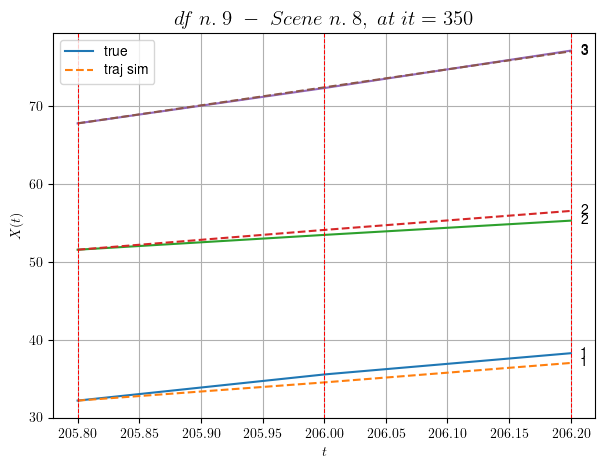

        For scene 8/9
        * use LR_NN=0.0005 with err=1.3367725159738144 at it=19
        * v0_scn_mean = 23.74504810088364
        * MAE = 0.5116316251893969



For df=9 with 9 scenes, time taken:        80.50
------------------------------------------------------------
****************************************************************************************************
In df n.10/10 we have 22 scenes
****************************************************************************************************
            - Time interval n.0: [25.72, 25.92]
                * y_true: [19.85100065 23.2716    ]
                * v_ann: [24.07280731201172, 23.924606323242188, 19.70885794583036]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [25.92, 26.12]
                * y_true: [21.59125574 29.46240542]
                * v_ann: [23.18168067932129, 22.911376953125, 19.70885794583036]

----------------------

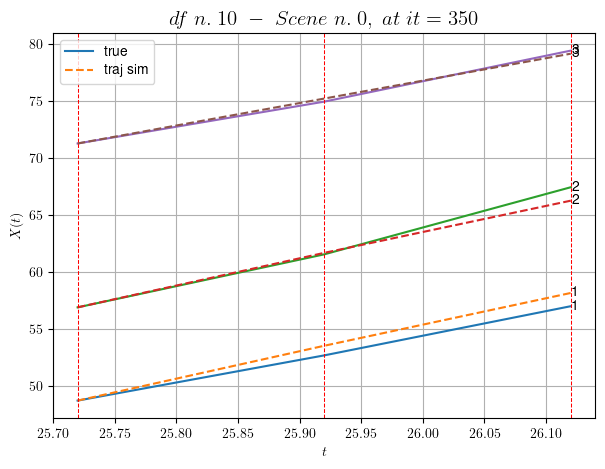

        For scene 0/22
        * use LR_NN=0.0005 with err=2.7435272841129614 at it=19
        * v0_scn_mean = 20.59088122439368
        * MAE = 0.40198591188159233



            - Time interval n.0: [71.72, 71.92]
                * y_true: [25.44045996  0.68637625]
                * v_ann: [15.824912071228027, 17.110977172851562, 24.696218424736625]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [71.92, 72.12]
                * y_true: [ 7.65710886 16.8398502 ]
                * v_ann: [13.36272144317627, 19.652875900268555, 24.696218424736625]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.12, 72.32]
                * y_true: [ 0.68637625 22.9307169 ]
                * v_ann: [14.124980926513672, 19.737686157226562, 24.696218424736625]

----------------------------------------------------------------------

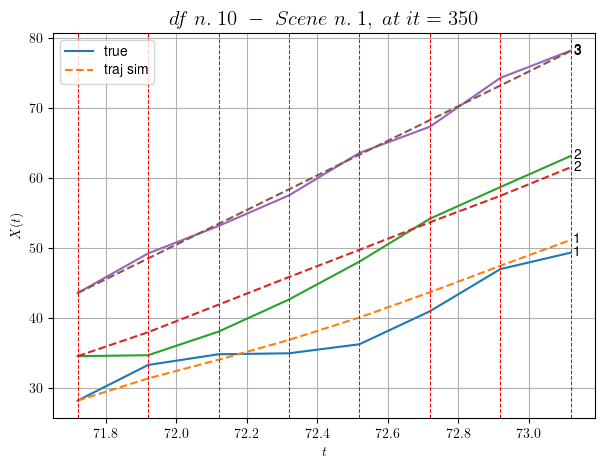

        For scene 1/22
        * use LR_NN=0.0001 with err=12.187547047116505 at it=19
        * v0_scn_mean = 25.150789821105807
        * MAE = 3.337598328651913



            - Time interval n.0: [120.92, 121.12]
                * y_true: [2.40007998 4.01291198]
                * v_ann: [7.416305065155029, 7.205214977264404, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.12, 121.32]
                * y_true: [3.94779745 3.96114827]
                * v_ann: [7.137763500213623, 7.493175506591797, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.32, 121.52]
                * y_true: [24.74097787  3.92663913]
                * v_ann: [6.854091167449951, 7.612768650054932, 19.875509421847788]

--------------------------------------------------------------------------

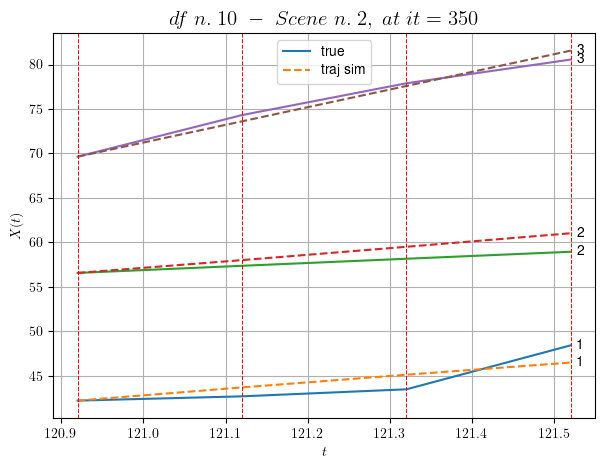

        For scene 2/22
        * use LR_NN=0.0001 with err=6.717919884499094 at it=19
        * v0_scn_mean = 20.743249496420685
        * MAE = 1.2946784634066013



            - Time interval n.0: [122.12, 122.32]
                * y_true: [20.84138029  3.6661027 ]
                * v_ann: [8.44815731048584, 8.823358535766602, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [122.32, 122.52]
                * y_true: [11.80149783  9.92593948]
                * v_ann: [13.233185768127441, 11.877361297607422, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [122.52, 122.72]
                * y_true: [ 5.61571017 11.00089954]
                * v_ann: [11.316680908203125, 8.918747901916504, 27.527697849634308]

--------------------------------------------------------------------

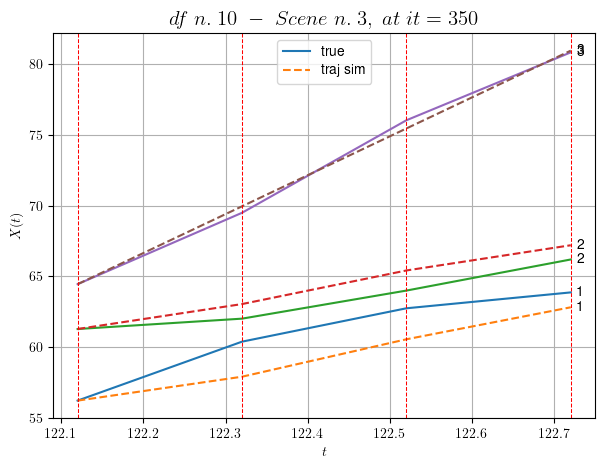

        For scene 3/22
        * use LR_NN=0.005 with err=5.1367727205930445 at it=19
        * v0_scn_mean = 27.739591538088593
        * MAE = 1.1440184213436628



            - Time interval n.0: [194.52, 194.72]
                * y_true: [18.69097642 14.73135237]
                * v_ann: [21.067031860351562, 20.59285545349121, 15.38515226818578]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [194.72, 194.92]
                * y_true: [17.84107996 20.91213867]
                * v_ann: [18.241106033325195, 18.946327209472656, 15.38515226818578]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [194.92, 195.12]
                * y_true: [20.95142105 24.20273885]
                * v_ann: [18.74641990661621, 19.29642677307129, 15.38515226818578]

----------------------------------------------------------------------

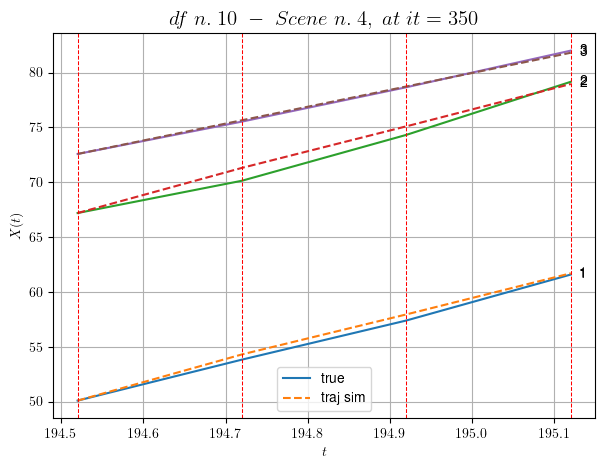

        For scene 4/22
        * use LR_NN=0.001 with err=15.320367415634118 at it=19
        * v0_scn_mean = 16.637747543255045
        * MAE = 0.2132376947458733



            - Time interval n.0: [201.52, 201.72]
                * y_true: [45.67726396 25.9301702 ]
                * v_ann: [29.23593521118164, 29.55716323852539, 25.797453724579626]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [201.72, 201.92]
                * y_true: [22.15536429 29.26032799]
                * v_ann: [30.189414978027344, 32.12129211425781, 25.797453724579626]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [201.92, 202.12]
                * y_true: [30.43022185 23.25036083]
                * v_ann: [29.343528747558594, 29.937803268432617, 25.797453724579626]

-------------------------------------------------------------------

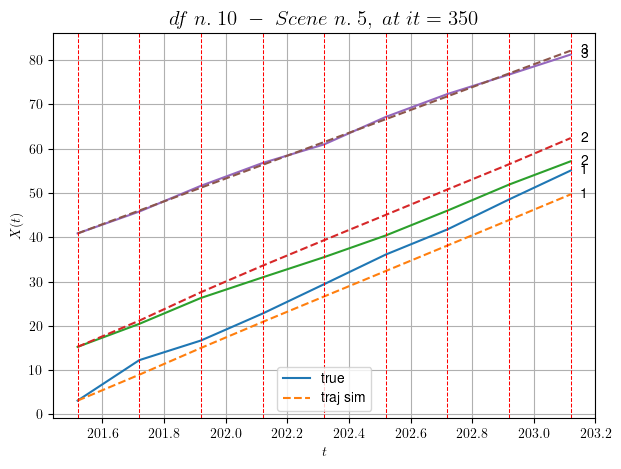

        For scene 5/22
        * use LR_NN=0.0005 with err=152.5456942674321 at it=19
        * v0_scn_mean = 26.157641507884087
        * MAE = 8.198553081378854



            - Time interval n.0: [210.12, 210.32]
                * y_true: [23.65050773 21.02104774]
                * v_ann: [23.673540115356445, 24.344890594482422, 24.38294001142724]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [210.32, 210.52]
                * y_true: [27.53081175 21.02121012]
                * v_ann: [22.301536560058594, 22.69712257385254, 24.38294001142724]

----------------------------------------------------------------------------------------------------
            * err= 0.28665088766252755
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0005640452313959154


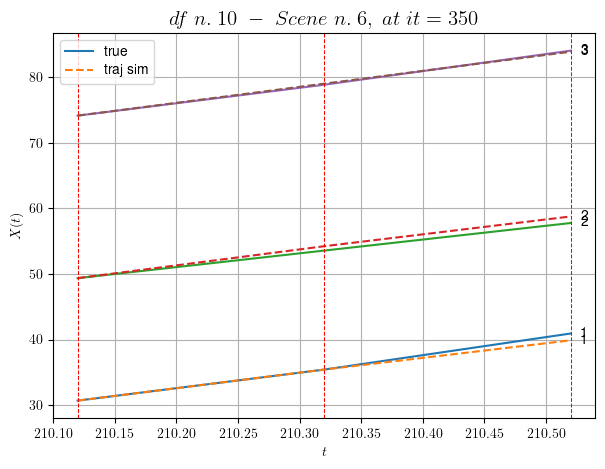

        For scene 6/22
        * use LR_NN=0.0005 with err=2.0088056868478428 at it=19
        * v0_scn_mean = 24.86436157192358
        * MAE = 0.28665088766252755



            - Time interval n.0: [236.52, 236.72]
                * y_true: [22.75077388 14.36119092]
                * v_ann: [24.90932846069336, 22.719388961791992, 24.944297288056802]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [236.72, 236.92]
                * y_true: [21.51093715 22.77208028]
                * v_ann: [18.855642318725586, 20.061195373535156, 24.944297288056802]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [236.92, 237.12]
                * y_true: [26.0213192  23.10241688]
                * v_ann: [21.478845596313477, 21.355295181274414, 24.944297288056802]

----------------------------------------------------------------

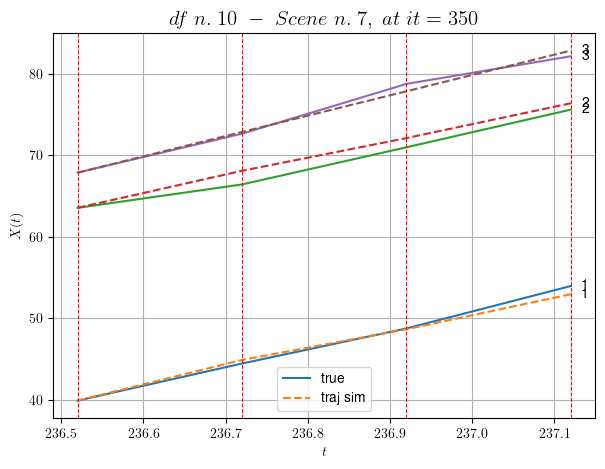

        For scene 7/22
        * use LR_NN=0.001 with err=7.92263699517038 at it=19
        * v0_scn_mean = 25.37760658045195
        * MAE = 0.5857744864484187



            - Time interval n.0: [237.72, 237.92]
                * y_true: [25.90146221 17.55123599]
                * v_ann: [21.561717987060547, 21.55451774597168, 25.832622552460464]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.92, 238.12]
                * y_true: [21.20141323 21.76181979]
                * v_ann: [21.65668296813965, 21.64230728149414, 25.832622552460464]

----------------------------------------------------------------------------------------------------
            * err= 0.3022635882979648
            * Learning rate NN = 0.0007289999630302191
            * diff = 1.1010287688850706e-05


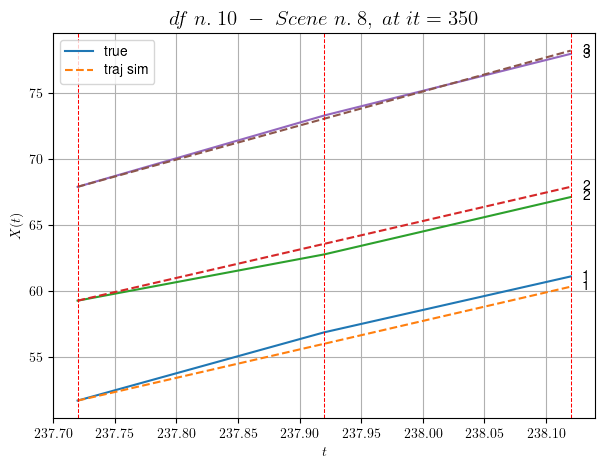

        For scene 8/22
        * use LR_NN=0.001 with err=1.8836901661641026 at it=19
        * v0_scn_mean = 26.189796119781054
        * MAE = 0.3022635882979648



            - Time interval n.0: [317.32, 317.52]
                * y_true: [14.46061508  5.00523108]
                * v_ann: [9.809418678283691, 9.615514755249023, 5.959565079937927]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.52, 317.72]
                * y_true: [10.48047894  8.66542797]
                * v_ann: [9.838141441345215, 9.658581733703613, 5.959565079937927]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [317.72, 317.92]
                * y_true: [ 5.95030099 13.38070893]
                * v_ann: [9.695646286010742, 9.531835556030273, 5.959565079937927]

-------------------------------------------------------------------------

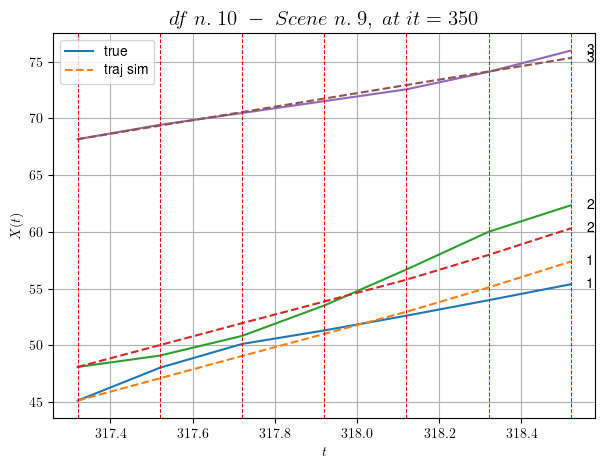

        For scene 9/22
        * use LR_NN=0.005 with err=106.68514272825428 at it=19
        * v0_scn_mean = 8.01999949184934
        * MAE = 0.9206618152615434



            - Time interval n.0: [321.12, 321.32]
                * y_true: [25.50087189 14.95118626]
                * v_ann: [19.39165496826172, 17.844362258911133, 25.32846239154247]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [321.32, 321.52]
                * y_true: [23.87107171  3.25027229]
                * v_ann: [19.134971618652344, 18.277585983276367, 25.32846239154247]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [321.52, 321.72]
                * y_true: [25.04128771 23.00208642]
                * v_ann: [18.086528778076172, 18.74484634399414, 25.32846239154247]

-----------------------------------------------------------------------

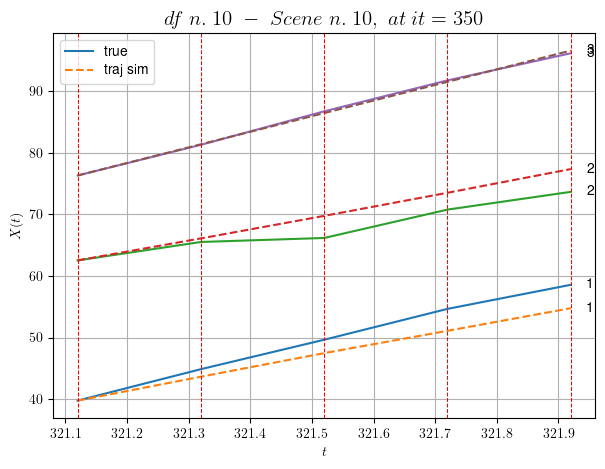

        For scene 10/22
        * use LR_NN=0.0001 with err=4.668303755005435 at it=19
        * v0_scn_mean = 25.728846031731337
        * MAE = 4.3844135026258915



            - Time interval n.0: [323.12, 323.32]
                * y_true: [ 6.90008114 15.05052158]
                * v_ann: [12.110493659973145, 11.562156677246094, 13.161438821254912]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [323.32, 323.52]
                * y_true: [ 8.30010994 16.45065772]
                * v_ann: [12.003683090209961, 11.59045124053955, 13.161438821254912]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [323.52, 323.72]
                * y_true: [ 9.85014911 16.15074097]
                * v_ann: [11.932500839233398, 11.635563850402832, 13.161438821254912]

----------------------------------------------------------------

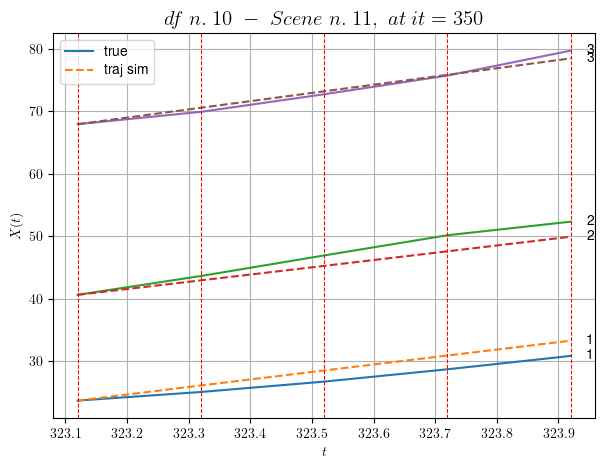

        For scene 11/22
        * use LR_NN=5e-05 with err=21.85020448361143 at it=19
        * v0_scn_mean = 14.604621983919492
        * MAE = 2.1957847583624517



            - Time interval n.0: [337.72, 337.92]
                * y_true: [11.69035174 22.47147634]
                * v_ann: [13.266243934631348, 13.573012351989746, 16.738540275581723]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [337.92, 338.12]
                * y_true: [10.20034007 18.27135214]
                * v_ann: [14.129831314086914, 14.618027687072754, 16.738540275581723]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.12, 338.32]
                * y_true: [ 7.94029275 13.91116184]
                * v_ann: [13.970025062561035, 14.599884033203125, 16.738540275581723]

----------------------------------------------------------------

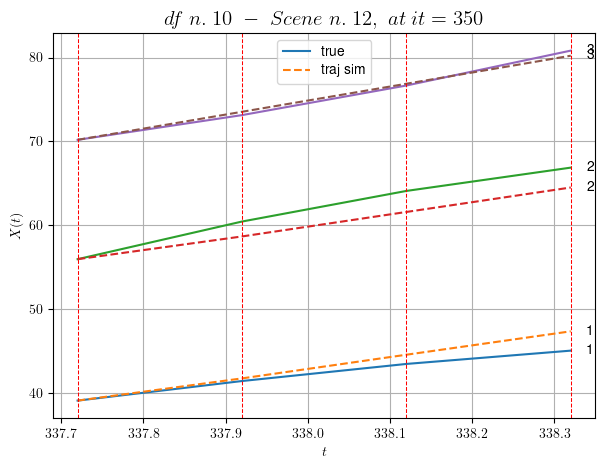

        For scene 12/22
        * use LR_NN=0.0005 with err=12.23479920623727 at it=19
        * v0_scn_mean = 17.87514067649877
        * MAE = 1.8587199320895904



            - Time interval n.0: [369.32, 369.52]
                * y_true: [22.34117259 11.42097363]
                * v_ann: [16.36141014099121, 16.447423934936523, 20.508930553904207]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.52, 369.72]
                * y_true: [22.31135956  8.65079743]
                * v_ann: [16.49247932434082, 16.512317657470703, 20.508930553904207]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.72, 369.92]
                * y_true: [16.17115552 17.53172003]
                * v_ann: [16.280193328857422, 16.32510757446289, 20.508930553904207]

-------------------------------------------------------------------

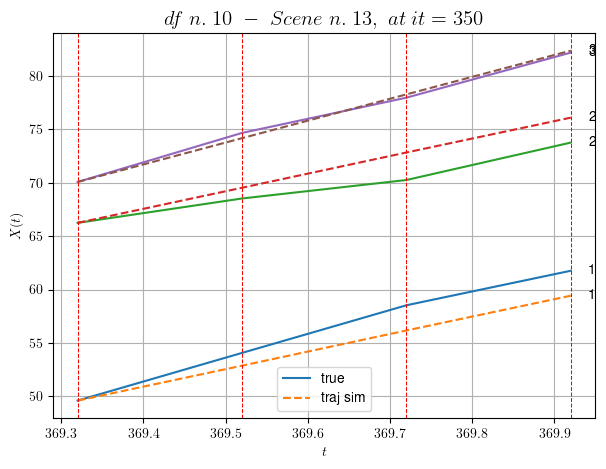

        For scene 13/22
        * use LR_NN=0.0005 with err=5.4500372067711025 at it=19
        * v0_scn_mean = 21.322381980952652
        * MAE = 2.16226488816025



            - Time interval n.0: [370.92, 371.12]
                * y_true: [12.30016813 11.70074461]
                * v_ann: [9.9723539352417, 9.75079345703125, 19.892193491628227]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.12, 371.32]
                * y_true: [ 9.3501493  10.70073785]
                * v_ann: [10.575724601745605, 10.60250473022461, 19.892193491628227]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.32, 371.52]
                * y_true: [ 8.90016062 10.12074395]
                * v_ann: [10.400368690490723, 10.520209312438965, 19.892193491628227]

----------------------------------------------------------------------

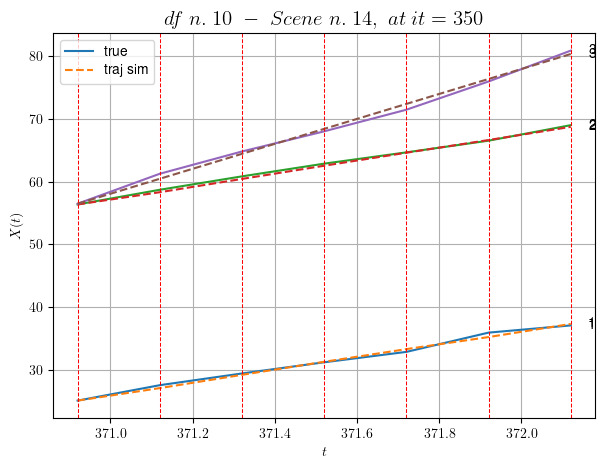

        For scene 14/22
        * use LR_NN=0.001 with err=29.081986581844017 at it=19
        * v0_scn_mean = 20.758503624037996
        * MAE = 0.1799890176155781



        For scene 15/22
        * use LR_NN=0.0001 with err=16.234259846154504 at it=19
        * v0_scn_mean = 15.675358364294338
        * MAE = 0.11611997317821969



            - Time interval n.0: [433.52, 433.72]
                * y_true: [21.56070162 24.64178312]
                * v_ann: [22.236427307128906, 22.129005432128906, 21.09574286493239]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [433.72, 433.92]
                * y_true: [20.75082718 21.171764  ]
                * v_ann: [22.777996063232422, 22.444435119628906, 21.09574286493239]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [433.92, 434.12]
                * y_true: [19.9709

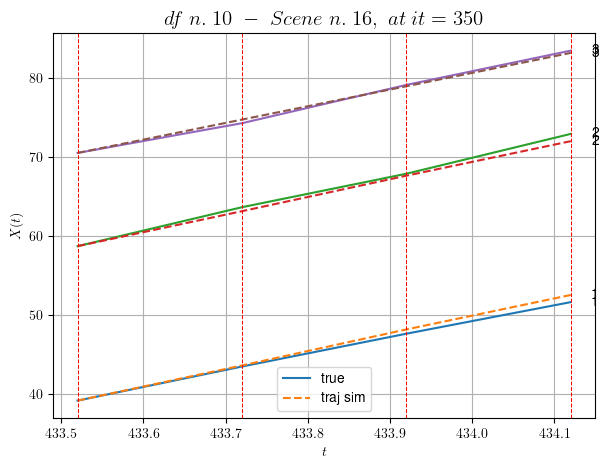

        For scene 16/22
        * use LR_NN=0.0005 with err=8.14409468260528 at it=19
        * v0_scn_mean = 21.858900348338924
        * MAE = 0.21734343847598003



            - Time interval n.0: [483.92, 484.12]
                * y_true: [19.08092085  0.51217506]
                * v_ann: [9.705316543579102, 10.048018455505371, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [484.12, 484.32]
                * y_true: [19.26103904  0.51217506]
                * v_ann: [9.994553565979004, 9.650653839111328, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            * err= 3.9144891257078336
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0009283578283749705


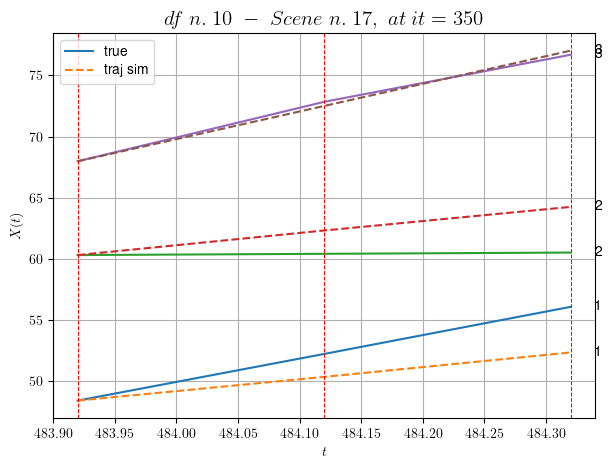

        For scene 17/22
        * use LR_NN=0.0005 with err=4.912866433665331 at it=19
        * v0_scn_mean = 23.251576451713916
        * MAE = 3.9144891257078336



            - Time interval n.0: [531.72, 531.92]
                * y_true: [0.21693371 8.7044085 ]
                * v_ann: [10.548367500305176, 9.584748268127441, 18.20525917578688]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.92, 532.12]
                * y_true: [13.20333652  9.14775604]
                * v_ann: [8.198003768920898, 8.101962089538574, 18.20525917578688]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.12, 532.32]
                * y_true: [18.40074328  5.60188997]
                * v_ann: [9.359894752502441, 8.93921184539795, 18.20525917578688]

--------------------------------------------------------------------------

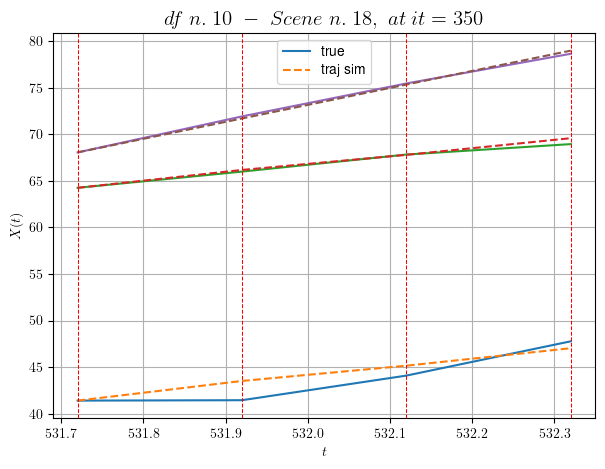

        For scene 18/22
        * use LR_NN=0.001 with err=8.801138639475303 at it=19
        * v0_scn_mean = 19.216151447685775
        * MAE = 0.5372678757547599



            - Time interval n.0: [202.52, 202.72]
                * y_true: [23.35318258 28.37081651 28.03104175]
                * v_ann: [27.90244483947754, 27.869897842407227, 28.08558464050293, 24.014995625684968]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [202.72, 202.92]
                * y_true: [23.6005682  33.85129081 29.41136895]
                * v_ann: [26.86227798461914, 27.18238639831543, 25.597200393676758, 24.014995625684968]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [202.92, 203.12]
                * y_true: [26.25082225 32.65166271 26.3315156 ]
                * v_ann: [29.073427200317383, 28.37678337097168, 30.40055274963

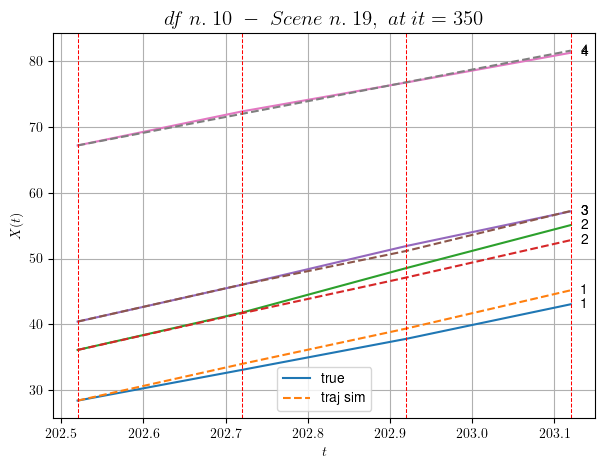

        For scene 19/22
        * use LR_NN=0.001 with err=21.56531011397908 at it=19
        * v0_scn_mean = 24.698128173240814
        * MAE = 0.9942771725466553



        For scene 20/22
        * use LR_NN=0.001 with err=8.062211491711215 at it=19
        * v0_scn_mean = 17.180414687098963
        * MAE = 0.5193366851964862



            - Time interval n.0: [441.12, 441.32]
                * y_true: [16.40031153 12.42055509 15.89074593]
                * v_ann: [15.300905227661133, 15.180379867553711, 15.401843070983887, 19.354115329350048]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [441.32, 441.52]
                * y_true: [16.46038907  8.18039995 21.4511847 ]
                * v_ann: [14.970864295959473, 15.055692672729492, 14.874731063842773, 19.354115329350048]

----------------------------------------------------------------------------------------------------
            * err= 0.5

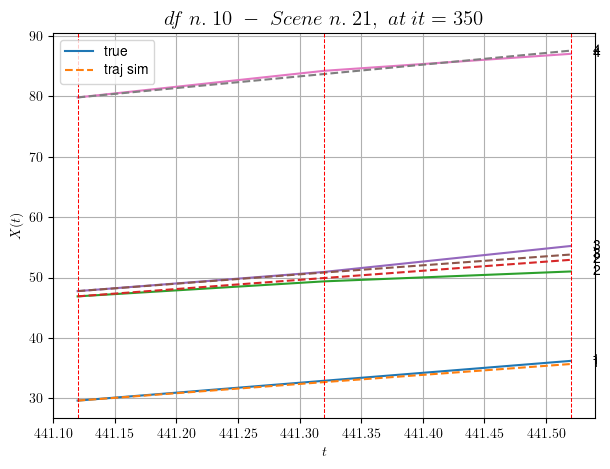

        For scene 21/22
        * use LR_NN=0.001 with err=3.9536831216887474 at it=19
        * v0_scn_mean = 20.56924398443554
        * MAE = 0.5720839378097763



For df=10 with 22 scenes, time taken:        234.69
------------------------------------------------------------

Time taken for the computation: 2218.02

Time taken using 1-4-1 NN structure: 2218.05


NN structure: 1-10-1
****************************************************************************************************
In df n.1/10 we have 28 scenes
****************************************************************************************************
            - Time interval n.0: [14.24, 14.44]
                * y_true: [32.1443344  20.77111865]
                * v_ann: [26.27035140991211, 27.37550926208496, 27.63629536512854]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [14.44, 14.64]
                * y_true: [32.5721373  24.27

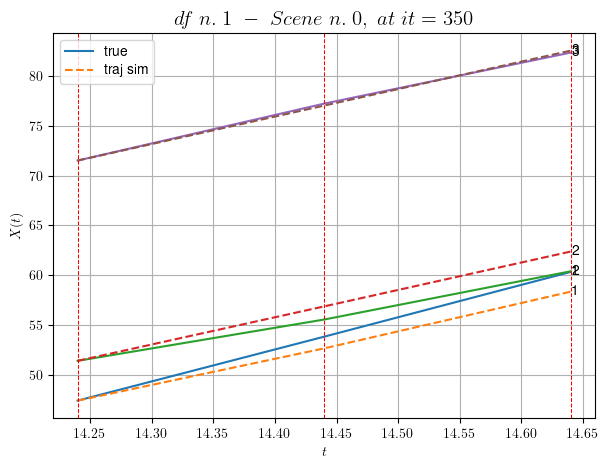

        For scene 0/28
        * use LR_NN=0.001 with err=13.709255384544392 at it=19
        * v0_scn_mean = 27.838881482454536
        * MAE = 1.2314390907632953



            - Time interval n.0: [23.64, 23.84]
                * y_true: [26.6509107  26.65125804]
                * v_ann: [25.995624542236328, 24.626861572265625, 31.184412007415986]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [26.834075927734375, 26.329574584960938, 31.184412007415986]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [29.05143519 29.47691739]
                * v_ann: [28.569355010986328, 29.123653411865234, 31.184412007415986]

----------------------------------------------------------------------

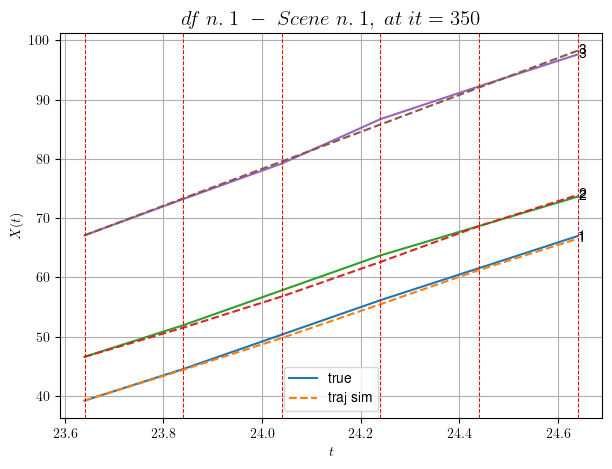

        For scene 1/28
        * use LR_NN=0.001 with err=28.734543058406377 at it=19
        * v0_scn_mean = 31.082899565312662
        * MAE = 0.17185149484166187



            - Time interval n.0: [72.44, 72.64]
                * y_true: [25.85001228 31.10049693]
                * v_ann: [27.494430541992188, 28.749284744262695, 28.250933212462616]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.64, 72.84]
                * y_true: [30.00006309 33.82077482]
                * v_ann: [27.49159812927246, 28.80107307434082, 28.250933212462616]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.84, 73.04]
                * y_true: [23.75011307 26.19081077]
                * v_ann: [27.619295120239258, 28.332996368408203, 28.250933212462616]

-----------------------------------------------------------------------

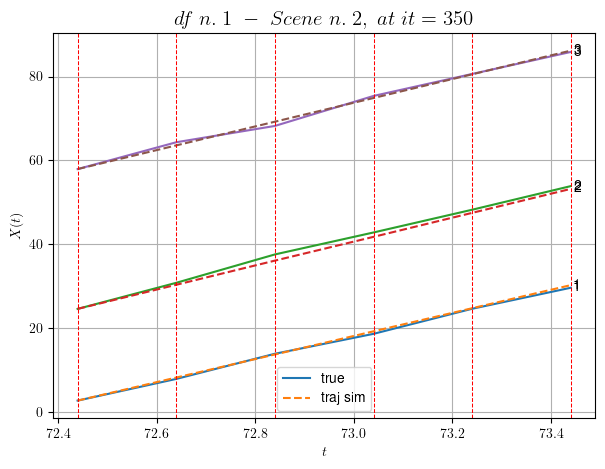

        For scene 2/28
        * use LR_NN=1e-05 with err=3.3089013020107814 at it=19
        * v0_scn_mean = 28.400840541916427
        * MAE = 0.24800142902282538



            - Time interval n.0: [84.24, 84.44]
                * y_true: [29.4403562  23.48047527]
                * v_ann: [26.839370727539062, 27.38765525817871, 29.49436924721108]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [84.44, 84.64]
                * y_true: [27.01049004 24.28067739]
                * v_ann: [27.492685317993164, 27.7249813079834, 29.49436924721108]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [84.64, 84.84]
                * y_true: [27.60069732 32.65118399]
                * v_ann: [27.62258529663086, 27.206222534179688, 29.49436924721108]

----------------------------------------------------------------------------

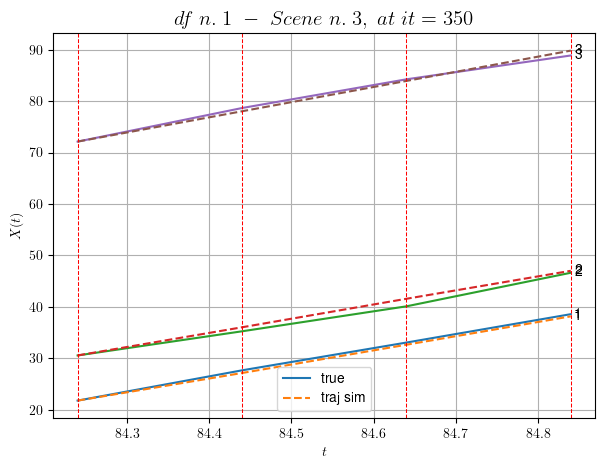

        For scene 3/28
        * use LR_NN=0.0001 with err=24.143986239070824 at it=19
        * v0_scn_mean = 29.537705360148777
        * MAE = 0.4113958192460605



            - Time interval n.0: [131.64, 131.84]
                * y_true: [30.80073929 29.11067519]
                * v_ann: [28.893375396728516, 28.889034271240234, 28.442903953642848]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.84, 132.04]
                * y_true: [30.16079766 28.07097758]
                * v_ann: [30.207155227661133, 30.165714263916016, 28.442903953642848]

----------------------------------------------------------------------------------------------------
            * err= 0.08601965855195483
            * Learning rate NN = 0.00036449998151510954
            * diff = 2.3483229555865126e-05


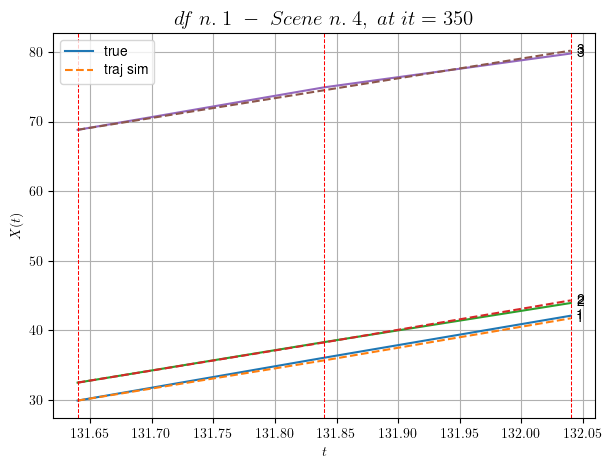

        For scene 4/28
        * use LR_NN=0.0005 with err=15.49045843254391 at it=19
        * v0_scn_mean = 28.576358039945397
        * MAE = 0.08540646553660808



            - Time interval n.0: [148.04, 148.24]
                * y_true: [21.93113488 25.90203153]
                * v_ann: [26.26824951171875, 26.248779296875, 27.621673906725427]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [148.24, 148.44]
                * y_true: [23.17638158 33.20310746]
                * v_ann: [25.848466873168945, 25.774852752685547, 27.621673906725427]

----------------------------------------------------------------------------------------------------
            * err= 0.5297656886182809
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0003558047405763931


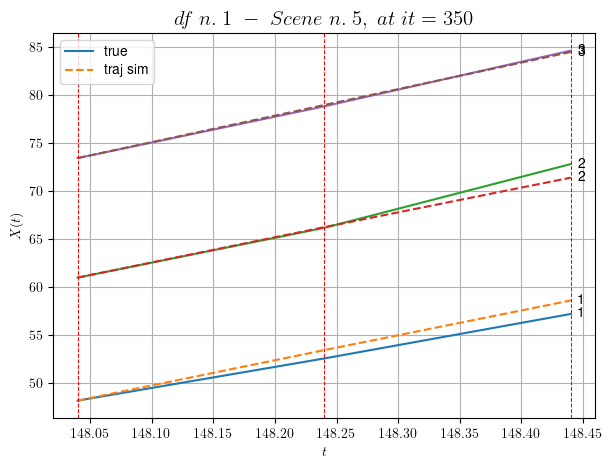

        For scene 5/28
        * use LR_NN=0.0001 with err=0.8053700366227696 at it=19
        * v0_scn_mean = 27.82551318590763
        * MAE = 0.5262746090773066



            - Time interval n.0: [161.64, 161.84]
                * y_true: [31.66062591 25.70084842]
                * v_ann: [28.075531005859375, 27.44732666015625, 34.71178115124991]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [161.84, 162.04]
                * y_true: [29.96082912 27.30094687]
                * v_ann: [29.278493881225586, 29.782644271850586, 34.71178115124991]

----------------------------------------------------------------------------------------------------
            * err= 0.27090242218909916
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00018133407460380058


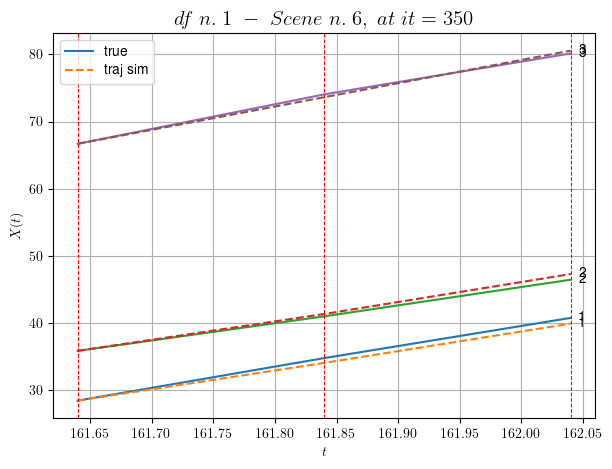

        For scene 6/28
        * use LR_NN=0.0005 with err=13.17325228651656 at it=19
        * v0_scn_mean = 34.30794835630662
        * MAE = 0.2695889017098869



            - Time interval n.0: [164.04, 164.24]
                * y_true: [27.950014  32.5307084]
                * v_ann: [27.583831787109375, 27.969690322875977, 32.43283336687014]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [164.24, 164.44]
                * y_true: [26.70005561 31.43096027]
                * v_ann: [28.80771827697754, 29.205530166625977, 32.43283336687014]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [164.44, 164.64]
                * y_true: [26.20012328 27.61110245]
                * v_ann: [28.838523864746094, 29.539533615112305, 32.43283336687014]

-----------------------------------------------------------------------

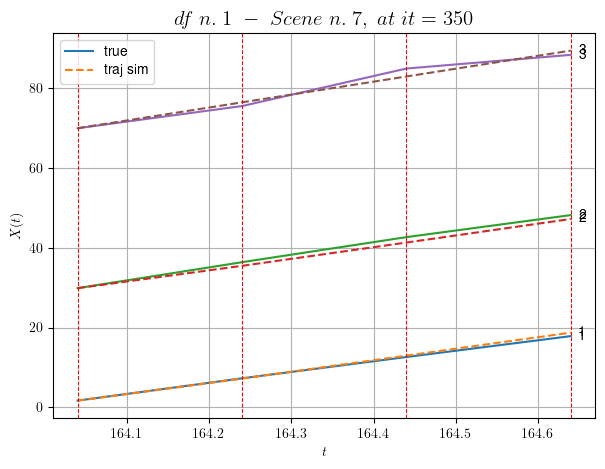

        For scene 7/28
        * use LR_NN=5e-05 with err=1.5691169374521 at it=19
        * v0_scn_mean = 32.22432243084916
        * MAE = 0.7720726423097038



            - Time interval n.0: [215.64, 215.84]
                * y_true: [29.28007092 34.74092457]
                * v_ann: [31.494083404541016, 31.85009002685547, 37.48372439573744]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.84, 216.04]
                * y_true: [29.05016449 33.87124084]
                * v_ann: [31.58264923095703, 31.945035934448242, 37.48372439573744]

----------------------------------------------------------------------------------------------------
            * err= 0.262218499072368
            * Learning rate NN = 7.289998848136747e-06
            * diff = 4.35128256857098e-05


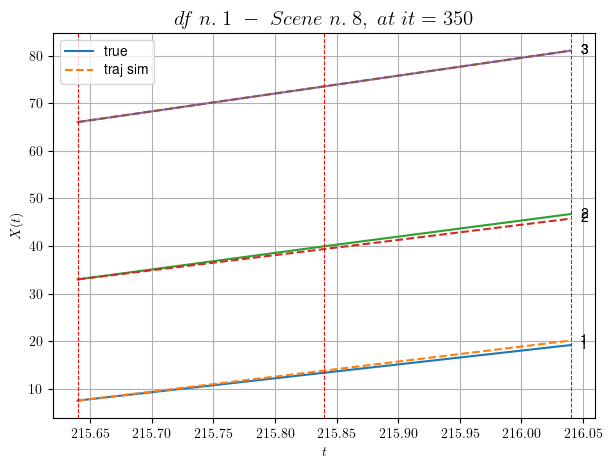

        For scene 8/28
        * use LR_NN=1e-05 with err=1.34270073710192 at it=19
        * v0_scn_mean = 36.84231656241397
        * MAE = 0.26130439537843037



            - Time interval n.0: [216.64, 216.84]
                * y_true: [37.52054047 34.13112536]
                * v_ann: [36.11357879638672, 37.58447265625, 34.85179005228114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [216.84, 217.04]
                * y_true: [39.83095433 33.81148861]
                * v_ann: [35.04497528076172, 35.779170989990234, 34.85179005228114]

----------------------------------------------------------------------------------------------------
            * err= 0.46124421948554656
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.003367943097041526


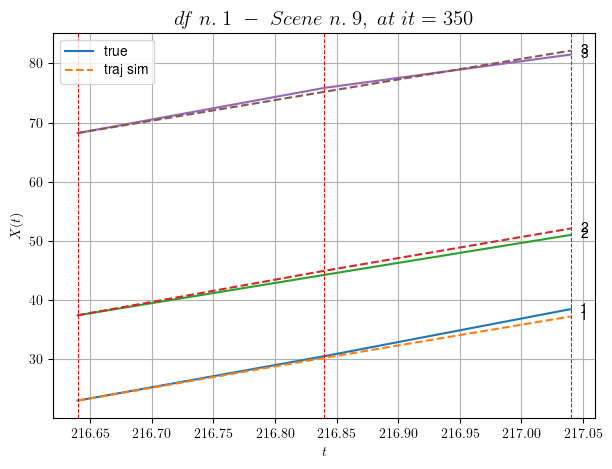

        For scene 9/28
        * use LR_NN=0.0001 with err=9.22209513020593 at it=19
        * v0_scn_mean = 34.435957509470455
        * MAE = 0.46124421948554656



            - Time interval n.0: [240.64, 240.84]
                * y_true: [28.54090912 24.62265201]
                * v_ann: [31.03337287902832, 31.101516723632812, 33.34474567234067]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [240.84, 241.04]
                * y_true: [33.36143299 35.0745887 ]
                * v_ann: [29.806907653808594, 29.88713836669922, 33.34474567234067]

----------------------------------------------------------------------------------------------------
            * err= 0.2266053642957406
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00014748822649826576


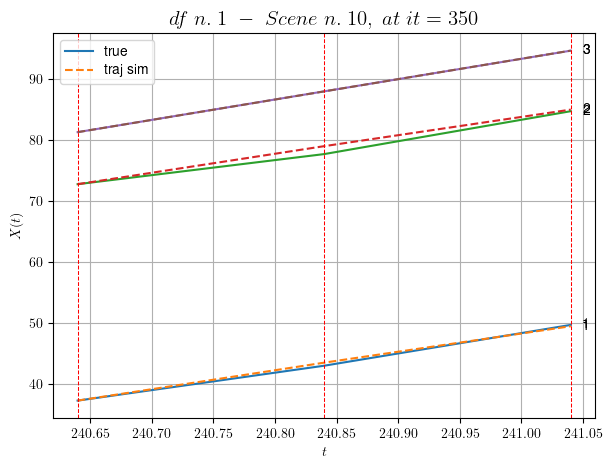

        For scene 10/28
        * use LR_NN=5e-05 with err=8.550001880921627 at it=19
        * v0_scn_mean = 33.058077435875916
        * MAE = 0.2266053642957406



            - Time interval n.0: [253.64, 253.84]
                * y_true: [26.81042151 28.10122634]
                * v_ann: [30.464099884033203, 31.973514556884766, 27.474897828445044]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [253.84, 254.04]
                * y_true: [31.5007643  35.35225595]
                * v_ann: [28.639738082885742, 29.992172241210938, 27.474897828445044]

----------------------------------------------------------------------------------------------------
            * err= 0.14743732553853703
            * Learning rate NN = 7.289998757187277e-05
            * diff = 6.22989019931075e-05


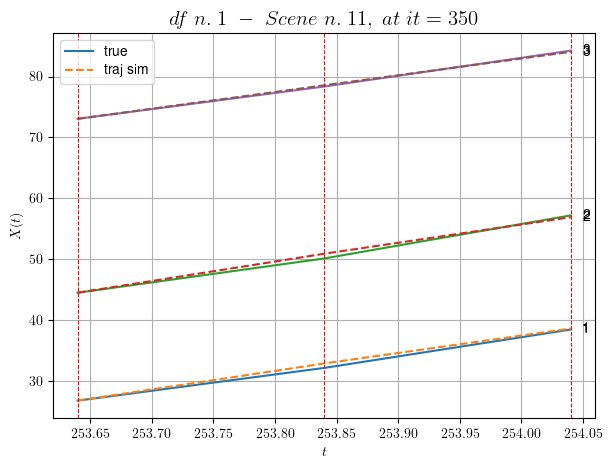

        For scene 11/28
        * use LR_NN=0.0001 with err=1.6112963503855704 at it=19
        * v0_scn_mean = 27.691316850195893
        * MAE = 0.14379401887626322



            - Time interval n.0: [262.64, 262.84]
                * y_true: [36.75102901 34.57147294]
                * v_ann: [29.89531707763672, 28.791893005371094, 35.9310545703503]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [262.84, 263.04]
                * y_true: [20.65076329 34.76181544]
                * v_ann: [33.063880920410156, 33.648014068603516, 35.9310545703503]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [263.04, 263.24]
                * y_true: [40.30193432 23.95156631]
                * v_ann: [28.860090255737305, 29.30108642578125, 35.9310545703503]

---------------------------------------------------------------------

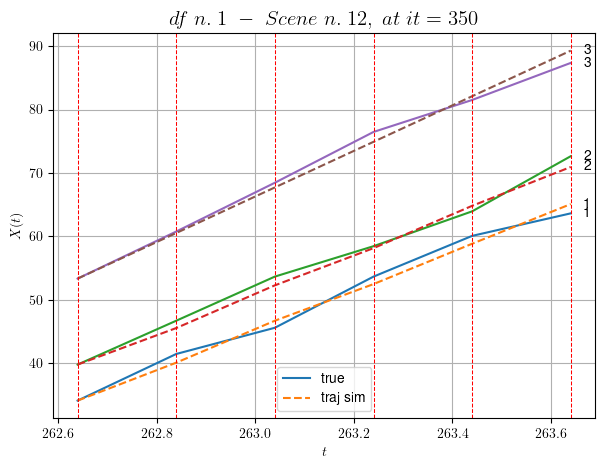

        For scene 12/28
        * use LR_NN=0.001 with err=29.836403833716655 at it=19
        * v0_scn_mean = 35.42272146505045
        * MAE = 1.2372615328035284



            - Time interval n.0: [314.84, 315.04]
                * y_true: [29.62016755 31.54681236]
                * v_ann: [29.605812072753906, 29.65815544128418, 30.926241166014943]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [315.04, 315.24]
                * y_true: [30.12030665 32.32740505]
                * v_ann: [29.886411666870117, 29.970138549804688, 30.926241166014943]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [315.24, 315.44]
                * y_true: [25.99040223 31.02242591]
                * v_ann: [30.262645721435547, 30.382064819335938, 30.926241166014943]

-----------------------------------------------------------------

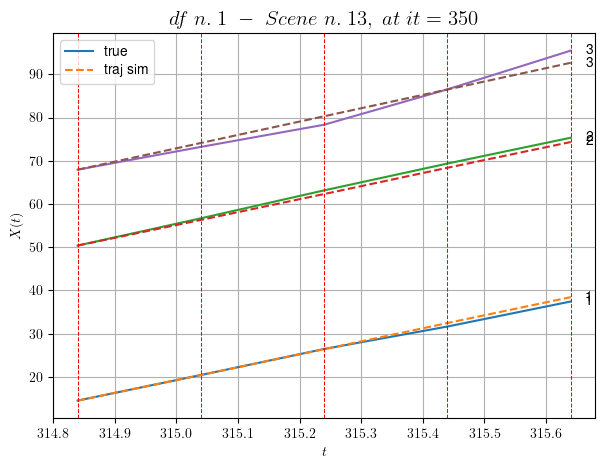

        For scene 13/28
        * use LR_NN=5e-05 with err=22.32351520894629 at it=19
        * v0_scn_mean = 30.8468557814111
        * MAE = 1.1387368239448383



            - Time interval n.0: [325.24, 325.44]
                * y_true: [29.06068603 28.85087529]
                * v_ann: [28.87822723388672, 28.55333137512207, 29.804035226087322]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.44, 325.64]
                * y_true: [28.37089255 31.80128105]
                * v_ann: [28.977991104125977, 29.064029693603516, 29.804035226087322]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [325.64, 325.84]
                * y_true: [30.70143178 22.60113815]
                * v_ann: [28.82945442199707, 29.068988800048828, 29.804035226087322]

---------------------------------------------------------------------

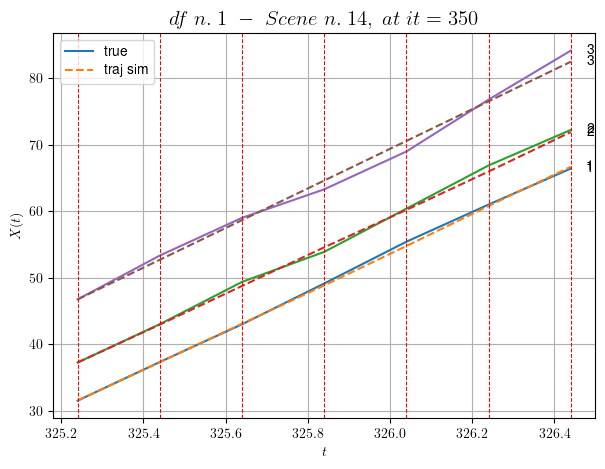

        For scene 14/28
        * use LR_NN=0.001 with err=16.152751360454044 at it=19
        * v0_scn_mean = 29.820830785944562
        * MAE = 0.47821247482744234



            - Time interval n.0: [354.04, 354.24]
                * y_true: [29.77169216 32.15176545]
                * v_ann: [28.7645320892334, 26.396759033203125, 32.6935027099963]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [354.24, 354.44]
                * y_true: [35.38251939 26.55179403]
                * v_ann: [29.59451675415039, 30.23817253112793, 32.6935027099963]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [354.44, 354.64]
                * y_true: [26.40441101 27.01000163]
                * v_ann: [30.061931610107422, 31.632890701293945, 32.6935027099963]

------------------------------------------------------------------------

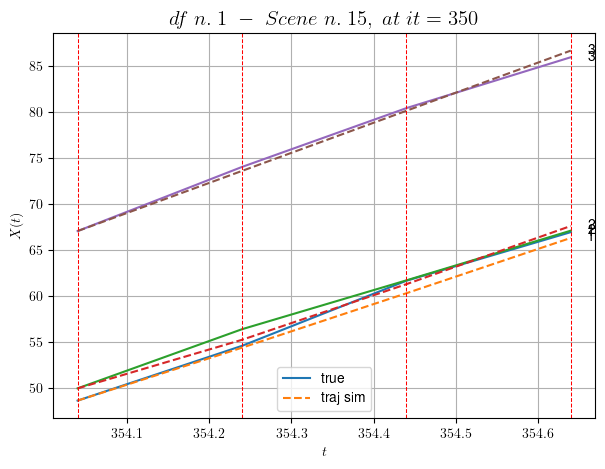

        For scene 15/28
        * use LR_NN=0.001 with err=20.929832204483322 at it=19
        * v0_scn_mean = 32.46265057729938
        * MAE = 0.3988360855593889



            - Time interval n.0: [363.44, 363.64]
                * y_true: [23.6502752  28.55056389]
                * v_ann: [29.666641235351562, 29.479652404785156, 38.923429963342]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [363.64, 363.84]
                * y_true: [26.3393983  33.66093634]
                * v_ann: [27.597068786621094, 26.674556732177734, 38.923429963342]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [363.84, 364.04]
                * y_true: [30.2407755  29.94110461]
                * v_ann: [28.167112350463867, 30.300365447998047, 38.923429963342]

-------------------------------------------------------------------------

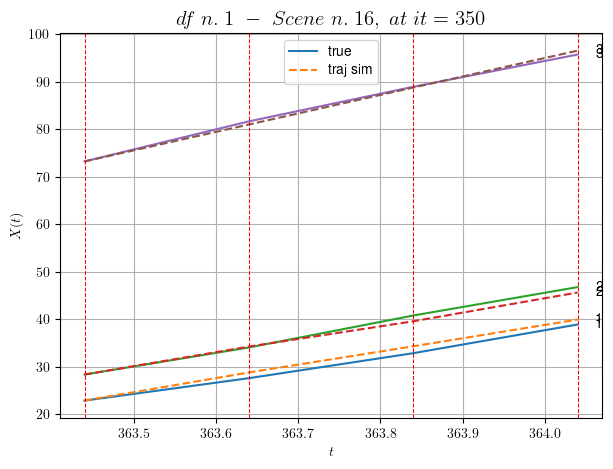

        For scene 16/28
        * use LR_NN=0.0005 with err=22.629335760392134 at it=19
        * v0_scn_mean = 38.15862923365898
        * MAE = 0.7009048493897319



            - Time interval n.0: [386.64, 386.84]
                * y_true: [28.15052447 34.1607672 ]
                * v_ann: [35.555755615234375, 35.01260757446289, 39.346032634271914]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [386.84, 387.04]
                * y_true: [34.00091123 38.91120777]
                * v_ann: [33.42256546020508, 32.424259185791016, 39.346032634271914]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.04, 387.24]
                * y_true: [32.52639997 34.00151192]
                * v_ann: [34.055755615234375, 35.845420837402344, 39.346032634271914]

-----------------------------------------------------------------

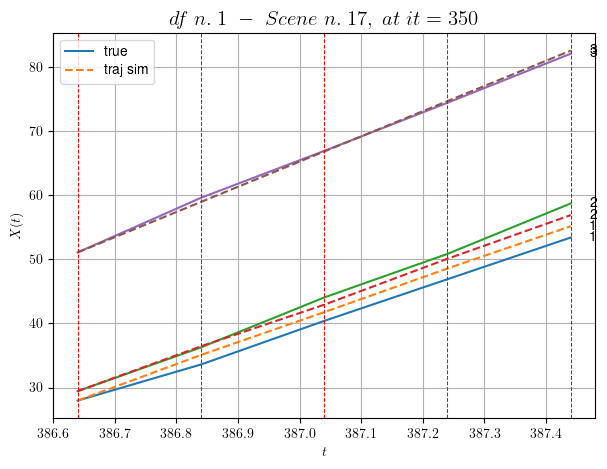

        For scene 17/28
        * use LR_NN=0.001 with err=31.5443540098548 at it=19
        * v0_scn_mean = 38.545011882419935
        * MAE = 1.0550445323384257



            - Time interval n.0: [431.84, 432.04]
                * y_true: [30.8908033  31.49166882]
                * v_ann: [33.90555191040039, 35.939048767089844, 30.08416102804866]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [432.04, 432.24]
                * y_true: [39.73151551 26.376716  ]
                * v_ann: [27.907726287841797, 29.09624481201172, 30.08416102804866]

----------------------------------------------------------------------------------------------------
            * err= 0.8138591811406176
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0021303456904394613


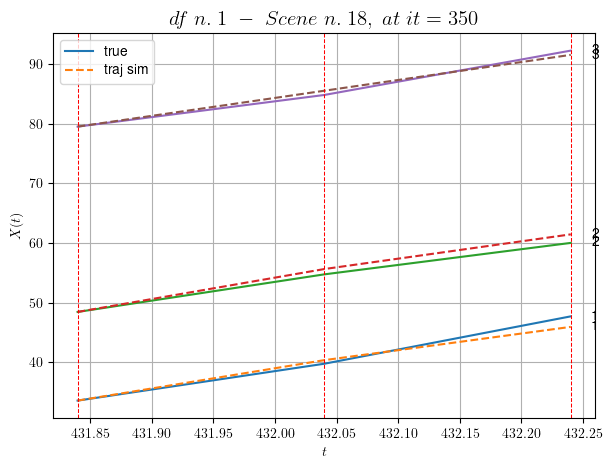

        For scene 18/28
        * use LR_NN=0.0005 with err=7.082616334627342 at it=19
        * v0_scn_mean = 30.076947835820903
        * MAE = 0.8138591811406176



            - Time interval n.0: [446.24, 446.44]
                * y_true: [25.89017971 23.30046083]
                * v_ann: [26.329458236694336, 26.281164169311523, 29.55443242874609]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [446.44, 446.64]
                * y_true: [28.05031625 27.72075411]
                * v_ann: [26.70108985900879, 26.781431198120117, 29.55443242874609]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [446.64, 446.84]
                * y_true: [26.94045507 27.8009832 ]
                * v_ann: [26.77066993713379, 26.845951080322266, 29.55443242874609]

--------------------------------------------------------------------

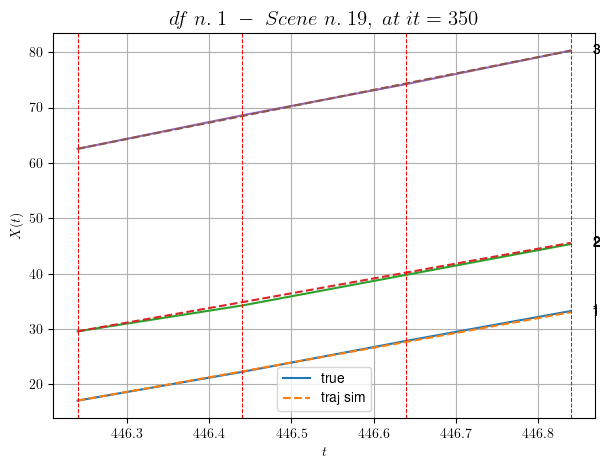

        For scene 19/28
        * use LR_NN=1e-05 with err=12.286312347619694 at it=19
        * v0_scn_mean = 29.59262070444424
        * MAE = 0.054977475007677024



            - Time interval n.0: [447.44, 447.64]
                * y_true: [31.0713577  29.31148494]
                * v_ann: [25.81718635559082, 24.07386016845703, 32.58484136741204]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [447.64, 447.84]
                * y_true: [37.68225285 24.50151408]
                * v_ann: [28.036338806152344, 28.580425262451172, 32.58484136741204]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [447.84, 448.04]
                * y_true: [25.261801   20.71149408]
                * v_ann: [28.74723243713379, 31.59554672241211, 32.58484136741204]

---------------------------------------------------------------------

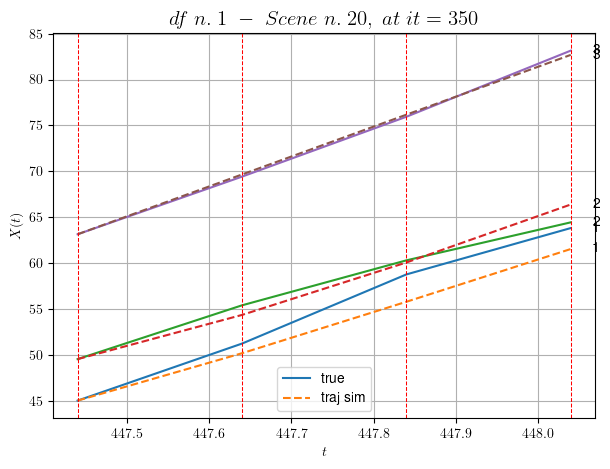

        For scene 20/28
        * use LR_NN=0.001 with err=20.56554261016071 at it=19
        * v0_scn_mean = 32.36330227627474
        * MAE = 1.479363938899685



            - Time interval n.0: [495.84, 496.04]
                * y_true: [23.1307843  13.57637571]
                * v_ann: [19.335872650146484, 19.579660415649414, 23.563140002877937]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [496.04, 496.24]
                * y_true: [23.23098731 16.2618474 ]
                * v_ann: [18.74953269958496, 18.56197738647461, 23.563140002877937]

----------------------------------------------------------------------------------------------------
            * err= 0.8818814902398683
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0001098069095720744


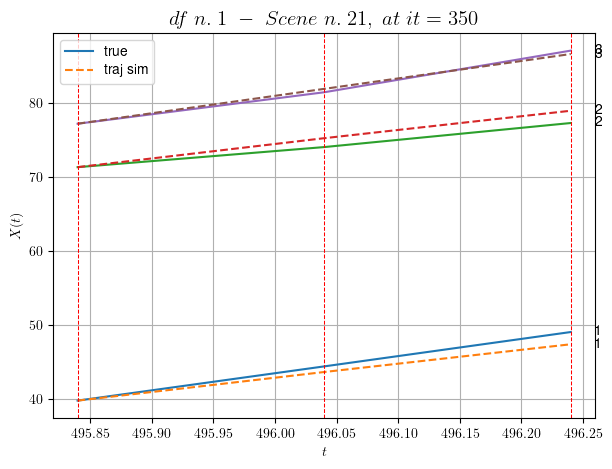

        For scene 21/28
        * use LR_NN=0.0001 with err=2.7474905524714033 at it=19
        * v0_scn_mean = 24.114824191904944
        * MAE = 0.8818814902398683



            - Time interval n.0: [496.84, 497.04]
                * y_true: [19.47545433 17.05100655]
                * v_ann: [17.945720672607422, 18.347597122192383, 23.671067862249625]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [497.04, 497.24]
                * y_true: [13.44536038 20.12642582]
                * v_ann: [17.969276428222656, 17.94878578186035, 23.671067862249625]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [497.24, 497.44]
                * y_true: [18.49565962 22.17670532]
                * v_ann: [17.476308822631836, 17.281036376953125, 23.671067862249625]

---------------------------------------------------------------

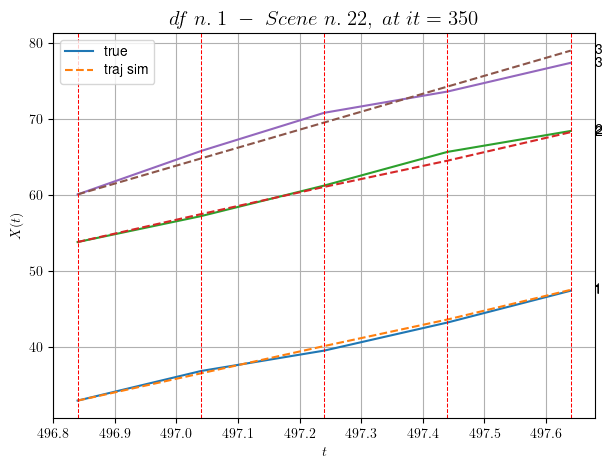

        For scene 22/28
        * use LR_NN=0.001 with err=12.938552784596288 at it=19
        * v0_scn_mean = 24.21350187438909
        * MAE = 0.5118948633964108



            - Time interval n.0: [499.04, 499.24]
                * y_true: [23.84103851 15.32650765]
                * v_ann: [24.114564895629883, 22.82451629638672, 17.83225143987477]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [499.24, 499.44]
                * y_true: [26.92142921 19.88726092]
                * v_ann: [18.360538482666016, 19.472015380859375, 17.83225143987477]

----------------------------------------------------------------------------------------------------
            * err= 0.8154034702787653
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.000172647548831395


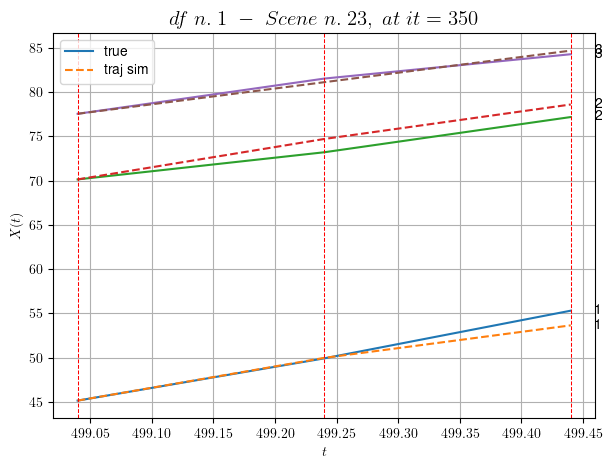

        For scene 23/28
        * use LR_NN=0.001 with err=5.156997958251362 at it=19
        * v0_scn_mean = 18.8751130990807
        * MAE = 0.7736889179891189



        For scene 24/28
        * use LR_NN=0.001 with err=10.328556004817495 at it=19
        * v0_scn_mean = 14.185957297597577
        * MAE = 0.04568819852192574



            - Time interval n.0: [502.24, 502.44]
                * y_true: [20.97545504 14.04040867]
                * v_ann: [16.36461067199707, 17.633100509643555, 15.581120912086842]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [502.44, 502.64]
                * y_true: [18.07559412 14.7904947 ]
                * v_ann: [17.37060546875, 17.776639938354492, 15.581120912086842]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [502.64, 502.84]
                * y_true: [18.07559412 14

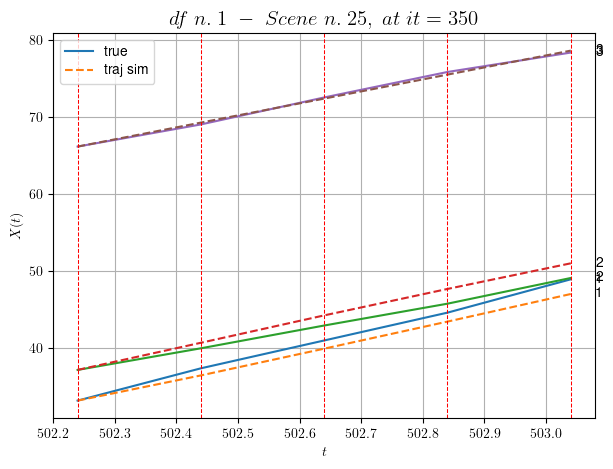

        For scene 25/28
        * use LR_NN=0.001 with err=28.19295893685482 at it=19
        * v0_scn_mean = 16.81692029561352
        * MAE = 1.1184952223066649



            - Time interval n.0: [534.84, 535.04]
                * y_true: [ 8.93323515 20.37071651]
                * v_ann: [17.787670135498047, 18.420040130615234, 29.753484139130997]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [535.04, 535.24]
                * y_true: [ 8.47527286 31.64140498]
                * v_ann: [16.347789764404297, 16.57191276550293, 29.753484139130997]

----------------------------------------------------------------------------------------------------
            * err= 2.9081319883502146
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0011892113838176677


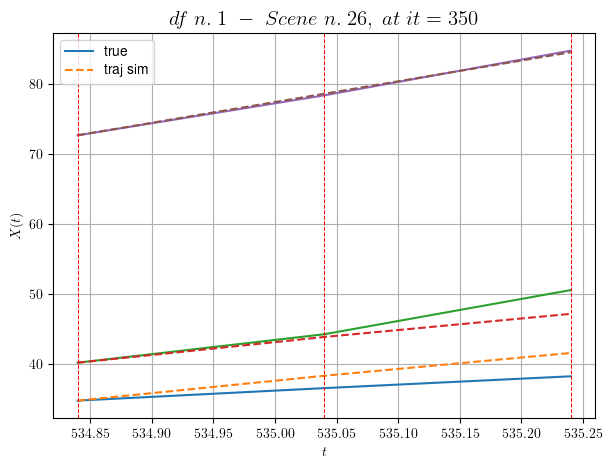

        For scene 26/28
        * use LR_NN=0.0005 with err=1.0149306598660301 at it=19
        * v0_scn_mean = 29.774612282797154
        * MAE = 1.9878983999795377



            - Time interval n.0: [573.84, 574.04]
                * y_true: [20.07571717 13.74586409]
                * v_ann: [13.0833101272583, 13.77982234954834, 9.338868955850176]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [574.04, 574.24]
                * y_true: [13.45064024 11.92582032]
                * v_ann: [14.10359001159668, 14.760293960571289, 9.338868955850176]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [574.24, 574.44]
                * y_true: [13.45064024 11.00083908]
                * v_ann: [13.678764343261719, 14.065302848815918, 9.338868955850176]

---------------------------------------------------------------------

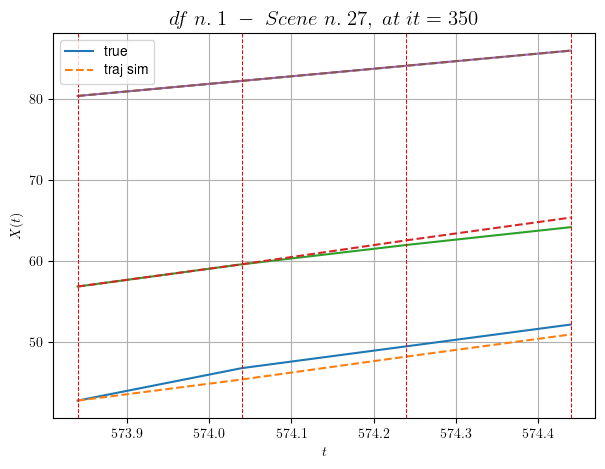

        For scene 27/28
        * use LR_NN=0.0005 with err=22.494754818647696 at it=19
        * v0_scn_mean = 11.10967325011269
        * MAE = 0.5661972456040738



For df=1 with 28 scenes, time taken:        268.09
------------------------------------------------------------
****************************************************************************************************
In df n.2/10 we have 18 scenes
****************************************************************************************************
            - Time interval n.0: [86.16, 86.36]
                * y_true: [16.74023073 23.1409288 ]
                * v_ann: [18.39072036743164, 18.39065933227539, 16.235429521340052]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [19.40034801 15.51071286]
                * v_ann: [18.785308837890625, 18.325702667236328, 16.235429521340052]

--------------

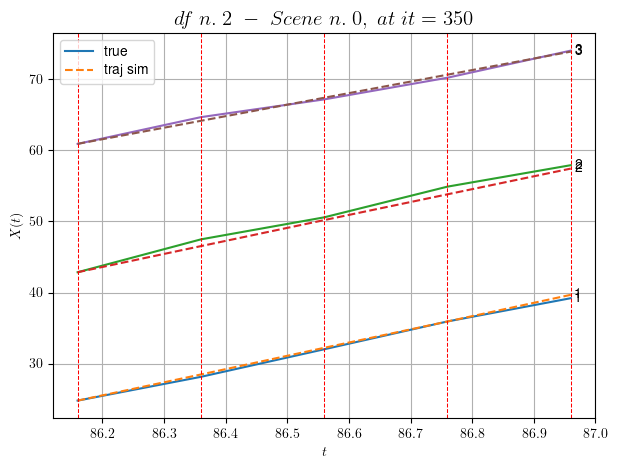

        For scene 0/18
        * use LR_NN=0.0001 with err=15.803779500863522 at it=19
        * v0_scn_mean = 17.41515005358986
        * MAE = 0.22309177199236654



            - Time interval n.0: [109.36, 109.56]
                * y_true: [28.77160952 15.03115545]
                * v_ann: [22.408296585083008, 22.769113540649414, 20.03393071799543]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.56, 109.76]
                * y_true: [23.64157457 15.83133823]
                * v_ann: [22.383502960205078, 22.659717559814453, 20.03393071799543]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.76, 109.96]
                * y_true: [24.63196009 20.68195399]
                * v_ann: [21.8165340423584, 22.09976577758789, 20.03393071799543]

---------------------------------------------------------------------

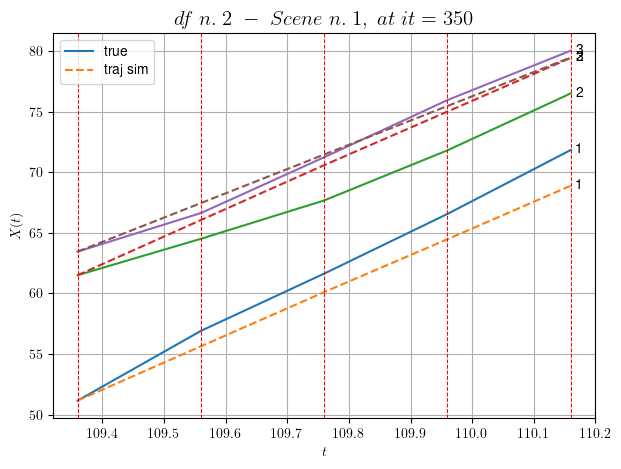

        For scene 1/18
        * use LR_NN=0.001 with err=11.387854086646998 at it=19
        * v0_scn_mean = 20.888092972897056
        * MAE = 3.1998770842516553



            - Time interval n.0: [170.36, 170.56]
                * y_true: [25.3307413  19.52081588]
                * v_ann: [23.689157485961914, 26.102895736694336, 16.15170945762333]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [29.74113537 17.1608437 ]
                * v_ann: [22.903430938720703, 23.426074981689453, 16.15170945762333]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [170.76, 170.96]
                * y_true: [24.43113316 23.6413756 ]
                * v_ann: [25.02283477783203, 23.32341766357422, 16.15170945762333]

---------------------------------------------------------------------

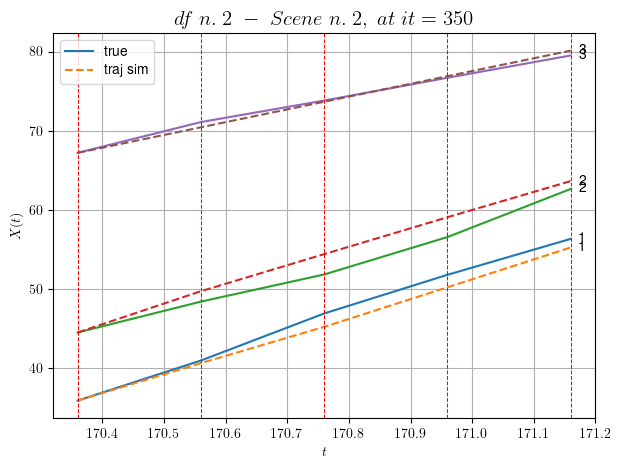

        For scene 2/18
        * use LR_NN=0.001 with err=39.95397507653638 at it=19
        * v0_scn_mean = 17.338605388355976
        * MAE = 1.5412648750469244



            - Time interval n.0: [179.36, 179.56]
                * y_true: [10.36002857 23.43048282]
                * v_ann: [17.218448638916016, 17.744722366333008, 22.082056744021124]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [179.56, 179.76]
                * y_true: [10.37004005 22.87060641]
                * v_ann: [17.111539840698242, 17.55780601501465, 22.082056744021124]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [179.76, 179.96]
                * y_true: [15.39008451 20.81068862]
                * v_ann: [17.084381103515625, 17.47698211669922, 22.082056744021124]

-------------------------------------------------------------------

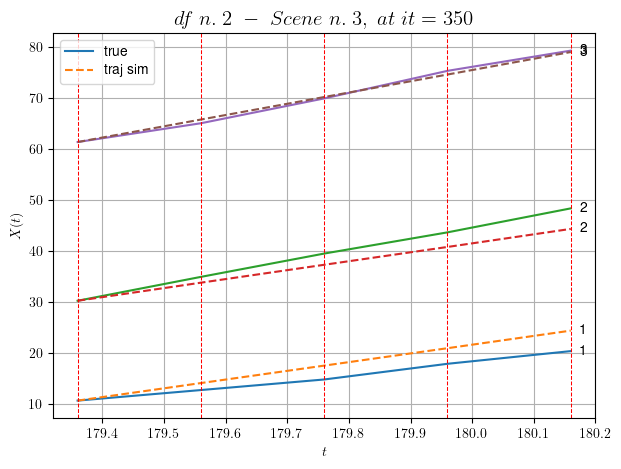

        For scene 3/18
        * use LR_NN=0.0001 with err=5.84482906386529 at it=19
        * v0_scn_mean = 22.760680188664747
        * MAE = 4.021135958404029



            - Time interval n.0: [199.76, 199.96]
                * y_true: [18.79121443 18.55195156]
                * v_ann: [19.79094886779785, 19.086820602416992, 14.651780868496049]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [199.96, 200.16]
                * y_true: [20.30155709 19.85230976]
                * v_ann: [18.912792205810547, 19.683435440063477, 14.651780868496049]

----------------------------------------------------------------------------------------------------
            * err= 0.008070623368582565
            * Learning rate NN = 0.0007289999630302191
            * diff = 2.6659496440343752e-05


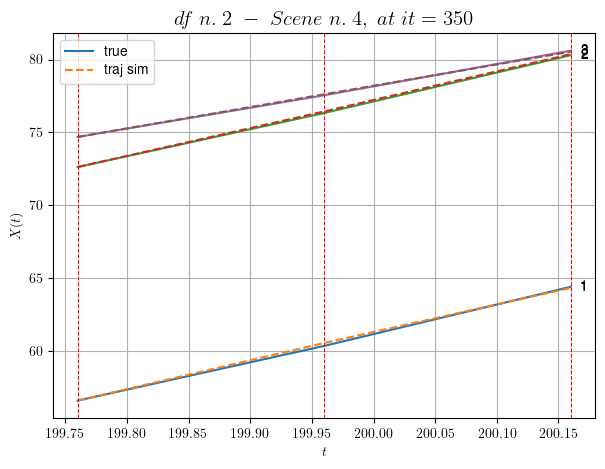

        For scene 4/18
        * use LR_NN=0.001 with err=8.676435477701721 at it=19
        * v0_scn_mean = 15.967231232237879
        * MAE = 0.008070623368582565



            - Time interval n.0: [212.56, 212.76]
                * y_true: [14.43013055 12.85042103]
                * v_ann: [15.613397598266602, 17.19020652770996, 20.507203914763075]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [212.76, 212.96]
                * y_true: [10.79011916 33.80137312]
                * v_ann: [15.413511276245117, 17.521343231201172, 20.507203914763075]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [212.96, 213.16]
                * y_true: [16.24022861 13.70067627]
                * v_ann: [16.58785057067871, 17.295045852661133, 20.507203914763075]

-----------------------------------------------------------------

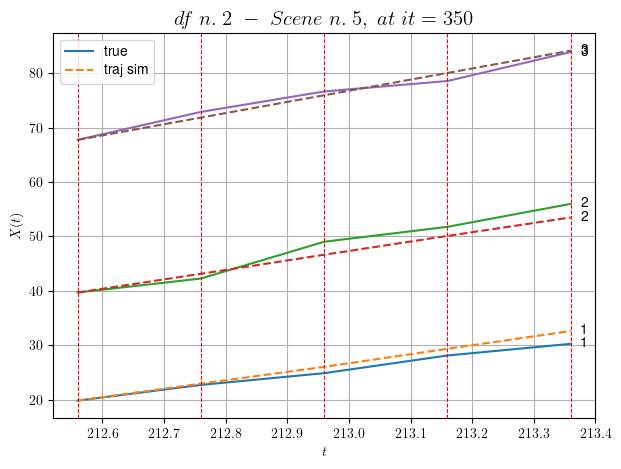

        For scene 5/18
        * use LR_NN=5e-05 with err=8.76268162513984 at it=19
        * v0_scn_mean = 21.320803326933362
        * MAE = 1.8259646572992259



            - Time interval n.0: [318.16, 318.36]
                * y_true: [13.01007537 20.36054455]
                * v_ann: [16.178762435913086, 17.40707778930664, 20.355267320886874]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [318.36, 318.56]
                * y_true: [14.27010639 20.89068863]
                * v_ann: [16.31028175354004, 17.432004928588867, 20.355267320886874]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.56, 318.76]
                * y_true: [12.16011799 21.20084683]
                * v_ann: [16.569555282592773, 17.517545700073242, 20.355267320886874]

--------------------------------------------------------------------

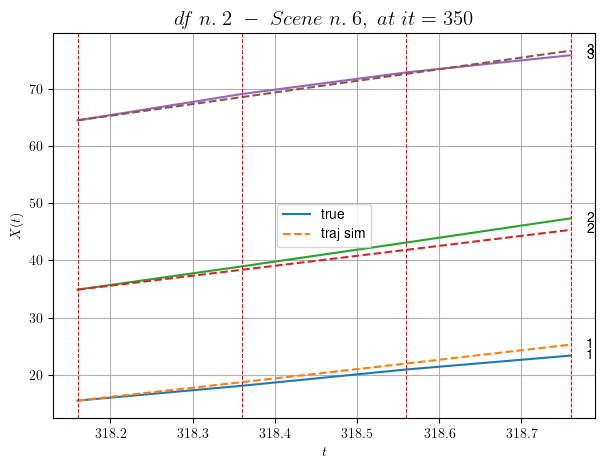

        For scene 6/18
        * use LR_NN=0.0001 with err=4.949808227640223 at it=19
        * v0_scn_mean = 21.181888768119585
        * MAE = 0.9432947291645936



            - Time interval n.0: [430.16, 430.36]
                * y_true: [15.83005748 20.27065425]
                * v_ann: [18.820581436157227, 18.671600341796875, 21.236966061391445]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [430.36, 430.56]
                * y_true: [19.99011659 24.33092793]
                * v_ann: [18.926067352294922, 18.873821258544922, 21.236966061391445]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [430.56, 430.76]
                * y_true: [14.67011767 20.05093433]
                * v_ann: [19.390119552612305, 18.840057373046875, 21.236966061391445]

----------------------------------------------------------------

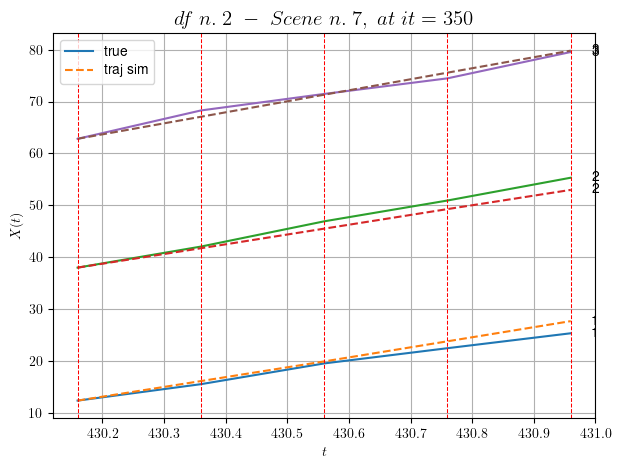

        For scene 7/18
        * use LR_NN=5e-05 with err=8.628956546604075 at it=19
        * v0_scn_mean = 21.988019723269552
        * MAE = 1.3898987495297013



            - Time interval n.0: [435.96, 436.16]
                * y_true: [15.85107698 23.95169404]
                * v_ann: [19.838573455810547, 22.178483963012695, 21.458777210396725]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [436.16, 436.36]
                * y_true: [18.0813972  25.19206379]
                * v_ann: [21.792526245117188, 19.012710571289062, 21.458777210396725]

----------------------------------------------------------------------------------------------------
            * err= 0.6323057461589223
            * Learning rate NN = 0.0036449995823204517
            * diff = 3.593134929469333e-05


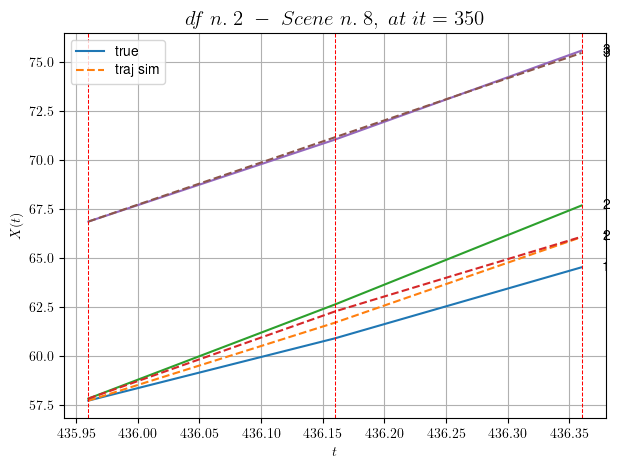

        For scene 8/18
        * use LR_NN=0.005 with err=2.1825080287104583 at it=19
        * v0_scn_mean = 22.19082009622671
        * MAE = 0.6207961909538439



            - Time interval n.0: [442.76, 442.96]
                * y_true: [18.06141662 13.31057742]
                * v_ann: [19.912296295166016, 18.972076416015625, 22.775949002661733]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [442.96, 443.16]
                * y_true: [20.34015276 11.01053508]
                * v_ann: [19.131650924682617, 18.5949649810791, 22.775949002661733]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [443.16, 443.36]
                * y_true: [26.42894929 13.47072378]
                * v_ann: [18.49320411682129, 18.268491744995117, 22.775949002661733]

--------------------------------------------------------------------

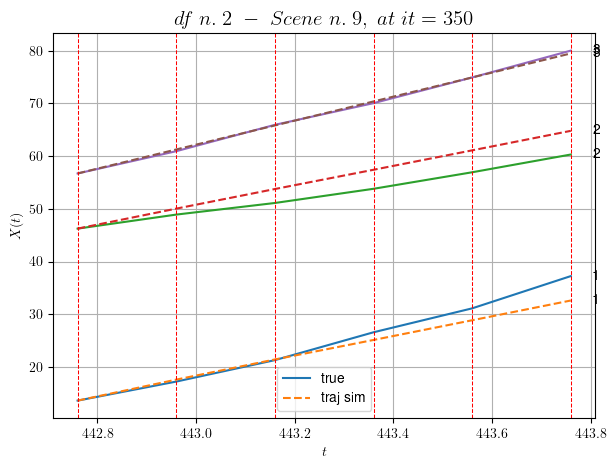

        For scene 9/18
        * use LR_NN=0.0001 with err=8.016847119385167 at it=19
        * v0_scn_mean = 23.395100998780624
        * MAE = 4.6011400773019195



            - Time interval n.0: [487.56, 487.76]
                * y_true: [22.90018755 16.61065196]
                * v_ann: [20.8248348236084, 20.409500122070312, 21.111964471908973]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.76, 487.96]
                * y_true: [21.00025249 21.71102285]
                * v_ann: [20.563331604003906, 20.35887336730957, 21.111964471908973]

----------------------------------------------------------------------------------------------------
            * err= 0.15095642088352457
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 1.688617501285905e-05


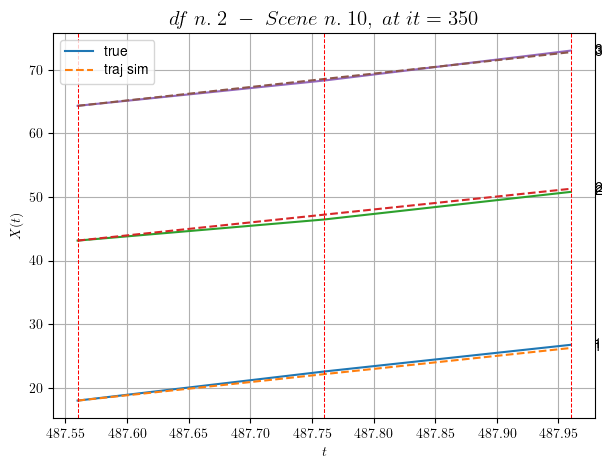

        For scene 10/18
        * use LR_NN=5e-05 with err=1.6952172763253337 at it=19
        * v0_scn_mean = 21.873731649468603
        * MAE = 0.14932109071468663



            - Time interval n.0: [531.76, 531.96]
                * y_true: [23.26110286 19.80102444]
                * v_ann: [21.392045974731445, 22.203899383544922, 17.911818675880006]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.96, 532.16]
                * y_true: [19.37730225 14.13461647]
                * v_ann: [21.367565155029297, 20.69667625427246, 17.911818675880006]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.16, 532.36]
                * y_true: [16.15104075 20.18132342]
                * v_ann: [19.1644287109375, 20.67190933227539, 17.911818675880006]

------------------------------------------------------------------

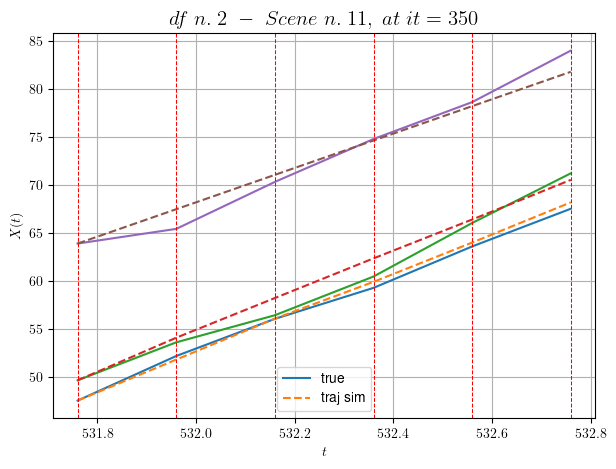

        For scene 11/18
        * use LR_NN=0.001 with err=20.931056883436284 at it=19
        * v0_scn_mean = 18.94786086315595
        * MAE = 1.0143846637783114



            - Time interval n.0: [538.36, 538.56]
                * y_true: [17.69068154 17.20117669]
                * v_ann: [21.718183517456055, 20.557126998901367, 21.518930627751246]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [538.56, 538.76]
                * y_true: [18.89091077 18.60142936]
                * v_ann: [20.00408935546875, 19.844125747680664, 21.518930627751246]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [538.76, 538.96]
                * y_true: [19.15102468 24.05210496]
                * v_ann: [19.50971221923828, 19.626327514648438, 21.518930627751246]

------------------------------------------------------------------

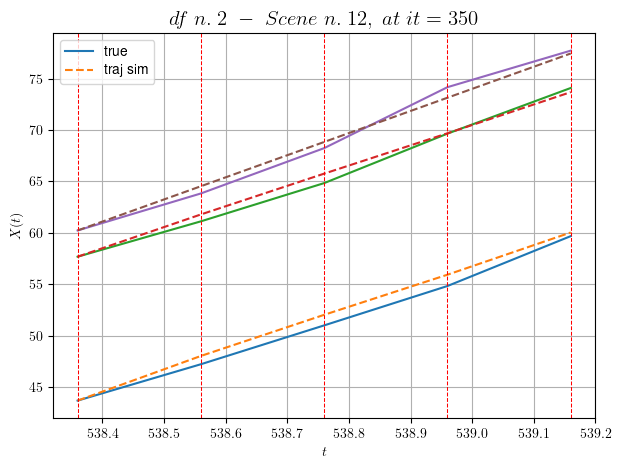

        For scene 12/18
        * use LR_NN=0.001 with err=17.89493556531907 at it=19
        * v0_scn_mean = 22.245817942497073
        * MAE = 0.43221975309277



            - Time interval n.0: [541.16, 541.36]
                * y_true: [22.67086863 28.23390149]
                * v_ann: [25.506168365478516, 25.113435745239258, 20.490059693196088]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [541.36, 541.56]
                * y_true: [19.45088023 23.11862329]
                * v_ann: [24.14396095275879, 24.3797664642334, 20.490059693196088]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [541.56, 541.76]
                * y_true: [24.96136667 24.68114114]
                * v_ann: [22.79239845275879, 22.55402183532715, 20.490059693196088]

-----------------------------------------------------------------------

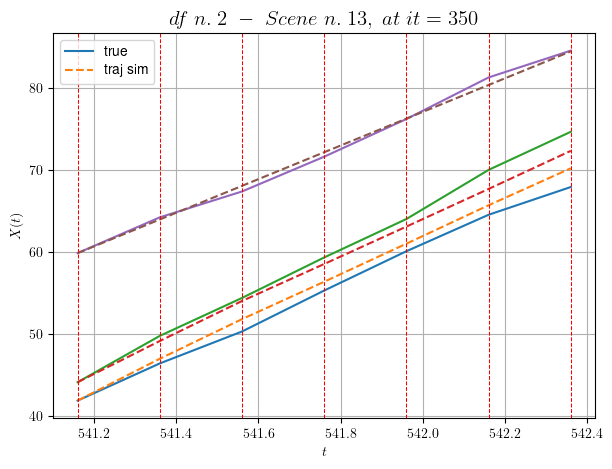

        For scene 13/18
        * use LR_NN=0.001 with err=27.81616410307376 at it=19
        * v0_scn_mean = 21.305128485774617
        * MAE = 1.2040419663254802



            - Time interval n.0: [549.76, 549.96]
                * y_true: [23.30098965 17.25125335]
                * v_ann: [22.806833267211914, 20.846677780151367, 22.49577375007867]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [549.96, 550.16]
                * y_true: [23.30098965 23.35192881]
                * v_ann: [22.103351593017578, 21.03853416442871, 22.49577375007867]

----------------------------------------------------------------------------------------------------
            * err= 0.07929490886965322
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00040893848814121947


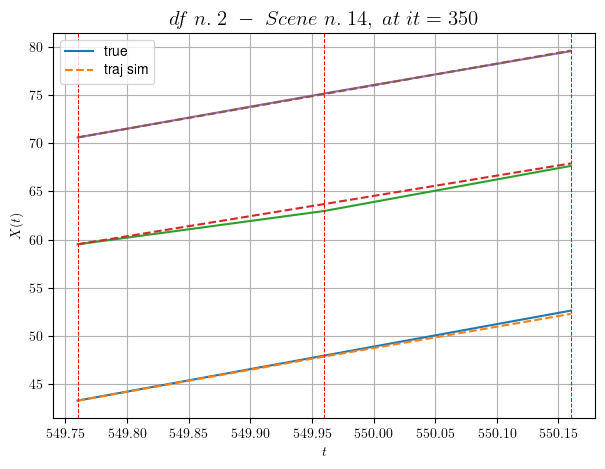

        For scene 14/18
        * use LR_NN=0.0001 with err=1.39037235078259 at it=19
        * v0_scn_mean = 23.138938736550163
        * MAE = 0.06923942523635589



        For scene 15/18
        * use LR_NN=0.0001 with err=0.8373547821401924 at it=19
        * v0_scn_mean = 25.04720642895467
        * MAE = 0.0640252677528759



            - Time interval n.0: [87.56, 87.76]
                * y_true: [20.56019483 17.07029985 18.3510221 ]
                * v_ann: [19.578567504882812, 20.727632522583008, 19.507320404052734, 23.400041684740113]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [87.76, 87.96]
                * y_true: [21.72029145 17.49039467 19.46124504]
                * v_ann: [19.096960067749023, 18.886720657348633, 18.271263122558594, 23.400041684740113]

----------------------------------------------------------------------------------------------------
            - Time inter

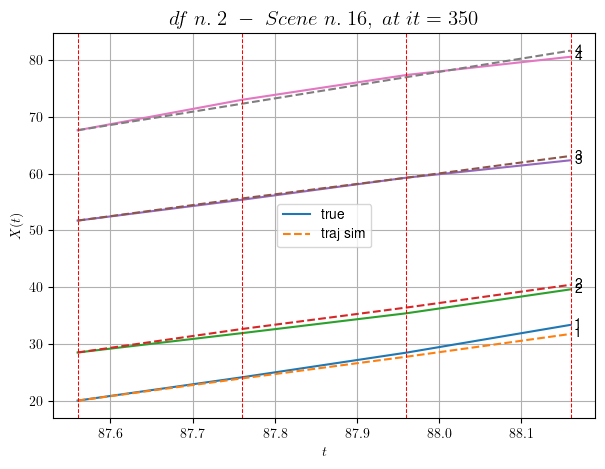

        For scene 16/18
        * use LR_NN=0.001 with err=8.717889579562057 at it=19
        * v0_scn_mean = 24.153365501346677
        * MAE = 0.48003808590248365



        For scene 17/18
        * use LR_NN=0.0001 with err=5.406922623395413 at it=19
        * v0_scn_mean = 15.658848893318348
        * MAE = 0.02715126267058749



For df=2 with 18 scenes, time taken:        188.81
------------------------------------------------------------
****************************************************************************************************
In df n.3/10 we have 55 scenes
****************************************************************************************************
            - Time interval n.0: [16.16, 16.36]
                * y_true: [27.36596872 40.6089382 ]
                * v_ann: [24.302448272705078, 23.80446434020996, 39.227215112044]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [

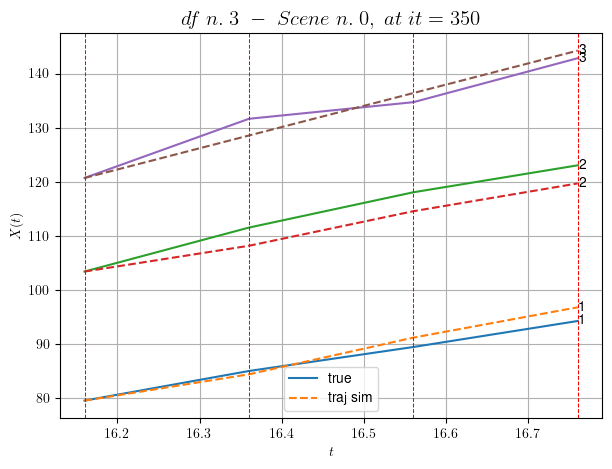

        For scene 0/55
        * use LR_NN=0.0005 with err=13.258774076892843 at it=19
        * v0_scn_mean = 38.436377857801986
        * MAE = 4.906531231938755



        For scene 1/55
        * use LR_NN=0.0001 with err=9.930538929796525 at it=19
        * v0_scn_mean = 36.46079988030287
        * MAE = 0.8616708620407237



            - Time interval n.0: [23.96, 24.16]
                * y_true: [31.9527567  21.95230333]
                * v_ann: [24.179954528808594, 25.37143325805664, 27.016685910779742]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [24.16, 24.36]
                * y_true: [26.79271708 14.85171745]
                * v_ann: [26.229263305664062, 27.87713623046875, 27.016685910779742]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.36, 24.56]
                * y_true: [20.5424093  31.654

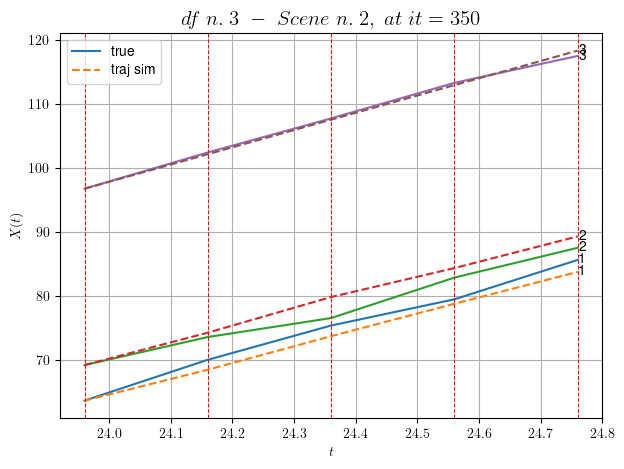

        For scene 2/55
        * use LR_NN=0.001 with err=26.597031999863916 at it=19
        * v0_scn_mean = 27.272376917677466
        * MAE = 1.7863664692236194



            - Time interval n.0: [42.96, 43.16]
                * y_true: [34.44093898 36.40531345]
                * v_ann: [24.928321838378906, 24.850759506225586, 27.35069258451141]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [43.16, 43.36]
                * y_true: [27.09071898 44.10770887]
                * v_ann: [34.13570785522461, 32.03287124633789, 27.35069258451141]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [43.36, 43.56]
                * y_true: [24.51583897 25.2301032 ]
                * v_ann: [38.770931243896484, 30.075815200805664, 27.35069258451141]

---------------------------------------------------------------------------

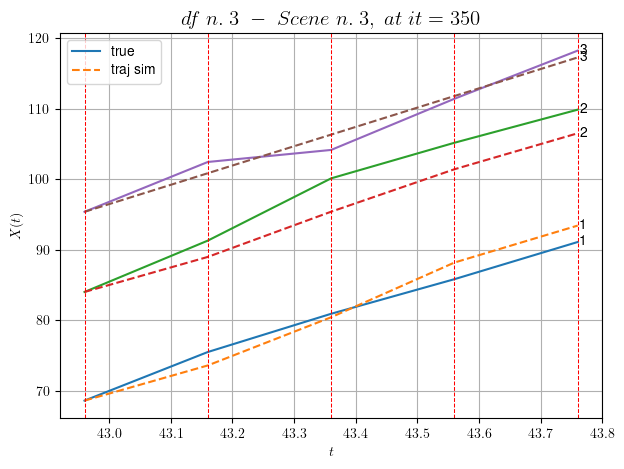

        For scene 3/55
        * use LR_NN=0.001 with err=21.56319687397216 at it=19
        * v0_scn_mean = 27.577756869527697
        * MAE = 4.283547021307496



            - Time interval n.0: [61.76, 61.96]
                * y_true: [28.79377133  7.10177762]
                * v_ann: [29.156003952026367, 28.979339599609375, 27.830106096169622]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [61.96, 62.16]
                * y_true: [41.29768472 31.64601894]
                * v_ann: [25.569509506225586, 23.382627487182617, 27.830106096169622]

----------------------------------------------------------------------------------------------------
            * err= 4.939671573077294
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.016304073720642798


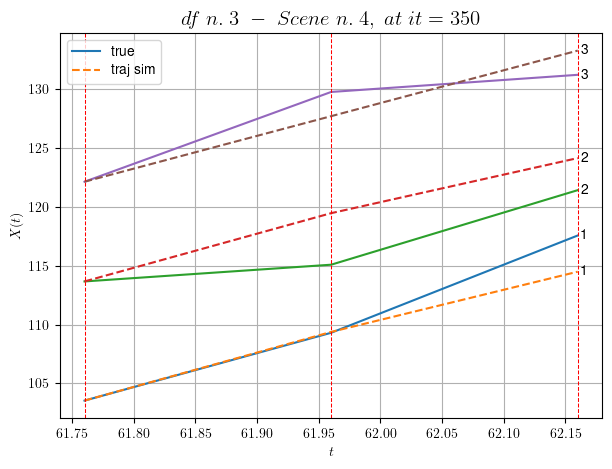

        For scene 4/55
        * use LR_NN=0.001 with err=7.324420816376825 at it=19
        * v0_scn_mean = 28.01608127026752
        * MAE = 4.939671573077294



            - Time interval n.0: [63.76, 63.96]
                * y_true: [39.33120973 30.97229006]
                * v_ann: [33.68941879272461, 25.894834518432617, 33.839854928033795]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [63.96, 64.16]
                * y_true: [32.2308074  22.86038312]
                * v_ann: [34.27445602416992, 27.340991973876953, 33.839854928033795]

----------------------------------------------------------------------------------------------------
            * err= 0.6067194594185157
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0010225330042420433


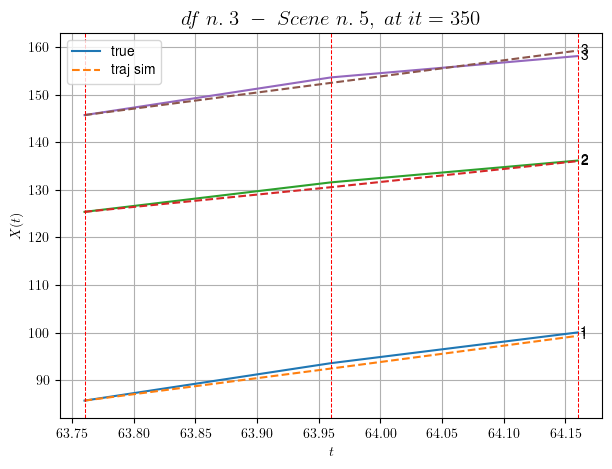

        For scene 5/55
        * use LR_NN=5e-05 with err=2.1025748232972963 at it=19
        * v0_scn_mean = 33.510752344957446
        * MAE = 0.591941441110655



            - Time interval n.0: [67.16, 67.36]
                * y_true: [27.17586615 28.72375126]
                * v_ann: [25.57978057861328, 24.381244659423828, 32.13930608407808]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [67.36, 67.56]
                * y_true: [31.70635664 24.62373081]
                * v_ann: [28.12199592590332, 25.86783218383789, 32.13930608407808]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [67.56, 67.76]
                * y_true: [27.5714436  21.15852297]
                * v_ann: [28.725534439086914, 26.486610412597656, 32.13930608407808]

-----------------------------------------------------------------------------

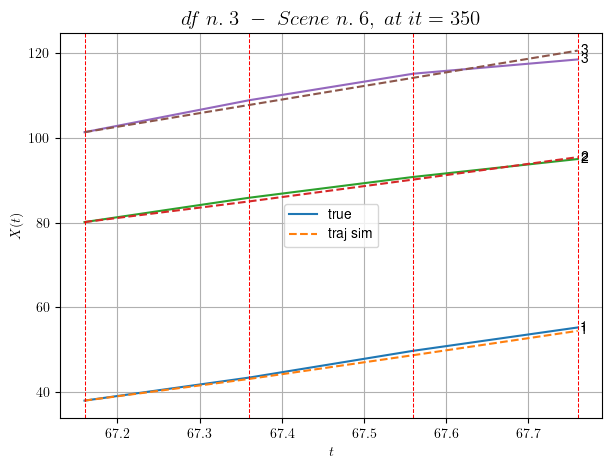

        For scene 6/55
        * use LR_NN=0.0001 with err=4.381460640782722 at it=19
        * v0_scn_mean = 31.95595250133714
        * MAE = 0.7954968333686449



            - Time interval n.0: [72.76, 72.96]
                * y_true: [28.501496   30.93407752]
                * v_ann: [31.7071475982666, 30.408037185668945, 28.1212538387427]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [72.96, 73.16]
                * y_true: [36.65243351 31.9148258 ]
                * v_ann: [31.32698631286621, 30.419837951660156, 28.1212538387427]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [73.16, 73.36]
                * y_true: [27.70226144 28.33497935]
                * v_ann: [32.119354248046875, 31.870479583740234, 28.1212538387427]

--------------------------------------------------------------------------------

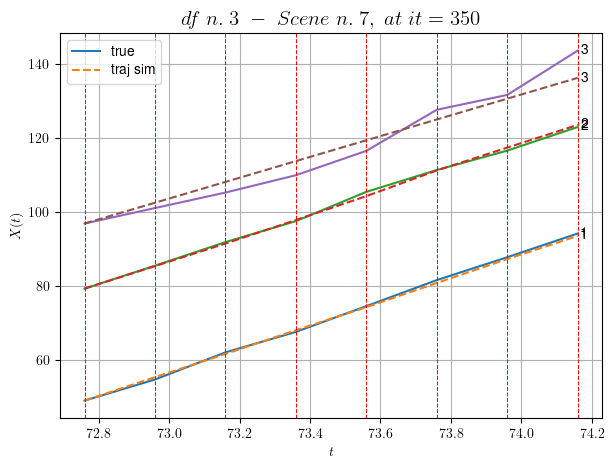

        For scene 7/55
        * use LR_NN=0.0001 with err=47.09311094466495 at it=19
        * v0_scn_mean = 28.282275602898505
        * MAE = 4.13934931289097



            - Time interval n.0: [82.16, 82.36]
                * y_true: [30.54468004 23.04450554]
                * v_ann: [31.169429779052734, 32.13331604003906, 27.55025511528059]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [82.36, 82.56]
                * y_true: [22.71402344 43.65971655]
                * v_ann: [30.556886672973633, 29.9437313079834, 27.55025511528059]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [82.56, 82.76]
                * y_true: [35.61686857 24.88594316]
                * v_ann: [27.47536849975586, 28.609216690063477, 27.55025511528059]

-------------------------------------------------------------------------------

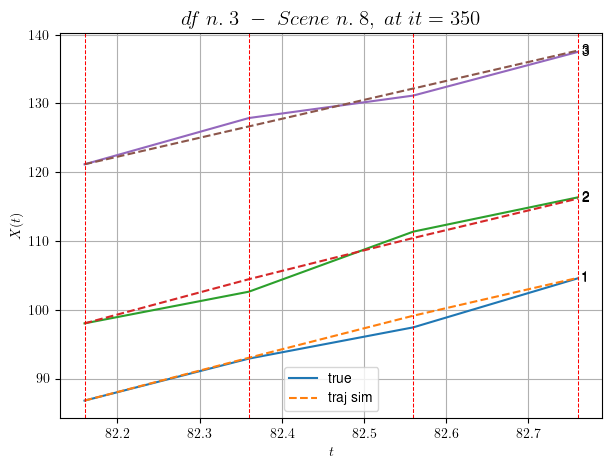

        For scene 8/55
        * use LR_NN=0.0005 with err=6.637796310722114 at it=19
        * v0_scn_mean = 27.760215487364654
        * MAE = 0.8002126236200467



            - Time interval n.0: [86.16, 86.36]
                * y_true: [27.89181051 25.45740923]
                * v_ann: [27.88667106628418, 32.43852615356445, 35.764694958435115]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [86.36, 86.56]
                * y_true: [36.25627338 46.92477715]
                * v_ann: [27.471757888793945, 31.783979415893555, 35.764694958435115]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [86.56, 86.76]
                * y_true: [29.50579063 21.07714474]
                * v_ann: [28.745615005493164, 33.826194763183594, 35.764694958435115]

------------------------------------------------------------------------

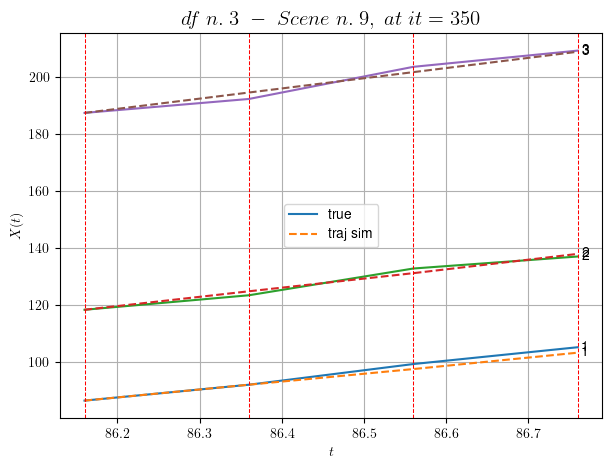

        For scene 9/55
        * use LR_NN=1e-05 with err=13.813661099412466 at it=19
        * v0_scn_mean = 35.27062004231875
        * MAE = 1.7431883900664096



            - Time interval n.0: [130.96, 131.16]
                * y_true: [15.85249734 39.95916833]
                * v_ann: [32.03648376464844, 30.593887329101562, 31.752325223025004]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [131.16, 131.36]
                * y_true: [19.2732587 14.0236874]
                * v_ann: [34.291770935058594, 29.66135025024414, 31.752325223025004]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [131.36, 131.56]
                * y_true: [20.77382027 41.90201833]
                * v_ann: [31.90293312072754, 28.428966522216797, 31.752325223025004]

----------------------------------------------------------------------

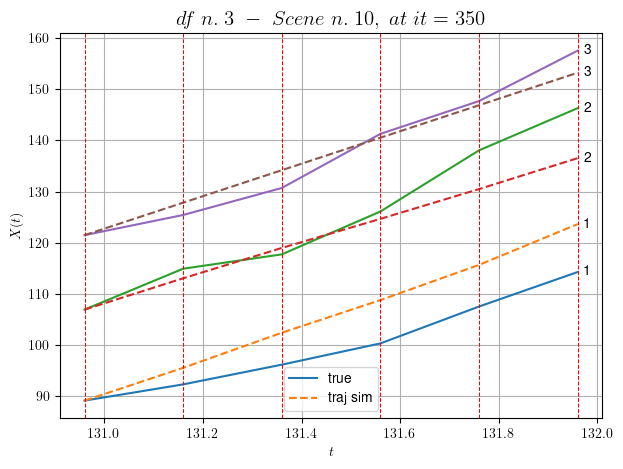

        For scene 10/55
        * use LR_NN=0.0001 with err=59.495249498174054 at it=19
        * v0_scn_mean = 31.60213862272469
        * MAE = 15.106803405774043



            - Time interval n.0: [139.16, 139.36]
                * y_true: [22.50033849 31.62238978]
                * v_ann: [26.468700408935547, 28.202381134033203, 28.144643973847398]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [139.36, 139.56]
                * y_true: [29.90063418 17.15160439]
                * v_ann: [27.309288024902344, 27.61103057861328, 28.144643973847398]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [139.56, 139.76]
                * y_true: [27.10078793 37.57385655]
                * v_ann: [25.756465911865234, 27.831193923950195, 28.144643973847398]

----------------------------------------------------------------

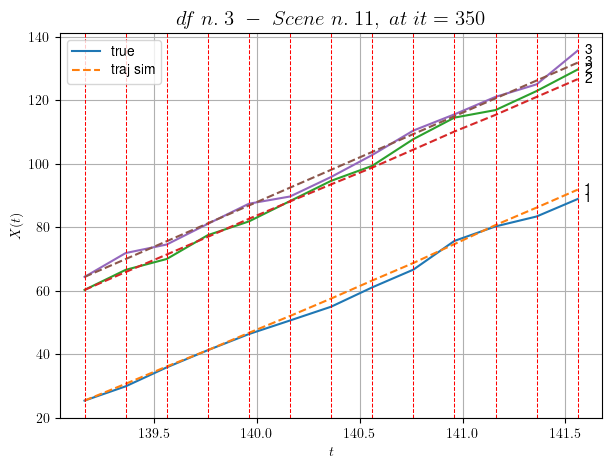

        For scene 11/55
        * use LR_NN=0.0005 with err=239.74358814427353 at it=19
        * v0_scn_mean = 28.30366103886062
        * MAE = 2.424785138833824



            - Time interval n.0: [143.76, 143.96]
                * y_true: [30.62207823 41.7261053 ]
                * v_ann: [27.458877563476562, 26.496183395385742, 29.414748692205062]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [143.96, 144.16]
                * y_true: [21.21173425 33.31570327]
                * v_ann: [37.069034576416016, 33.42289733886719, 29.414748692205062]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [144.16, 144.36]
                * y_true: [29.72284222 27.36558717]
                * v_ann: [28.996652603149414, 26.969507217407227, 29.414748692205062]

-----------------------------------------------------------------

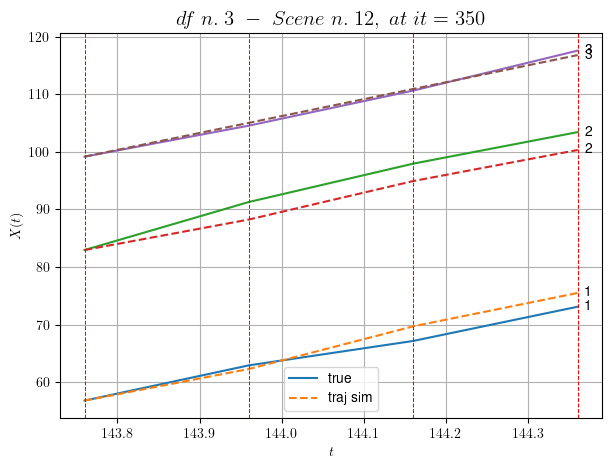

        For scene 12/55
        * use LR_NN=0.0005 with err=17.53563658624119 at it=19
        * v0_scn_mean = 29.464908846886726
        * MAE = 3.4628219253165784



            - Time interval n.0: [149.36, 149.56]
                * y_true: [25.90049539 27.45094024]
                * v_ann: [27.12377166748047, 28.246835708618164, 23.4436027042894]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [149.56, 149.76]
                * y_true: [21.18057417 22.42095425]
                * v_ann: [26.930288314819336, 26.97701072692871, 23.4436027042894]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [149.76, 149.96]
                * y_true: [37.02126181 27.98148311]
                * v_ann: [26.30828094482422, 25.849624633789062, 23.4436027042894]

------------------------------------------------------------------------

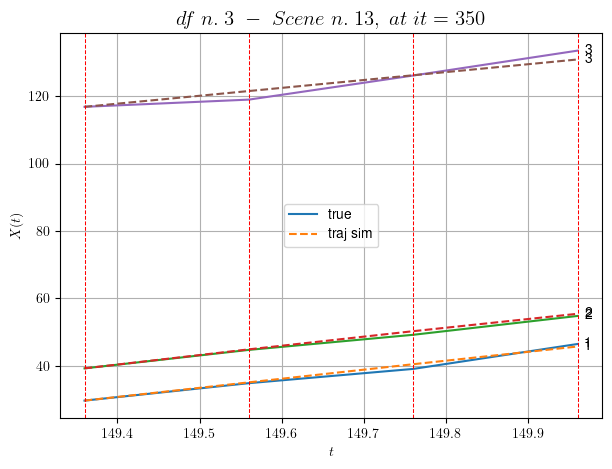

        For scene 13/55
        * use LR_NN=0.0001 with err=26.403990316958154 at it=19
        * v0_scn_mean = 24.00553208082398
        * MAE = 1.4065825011292301



            - Time interval n.0: [156.16, 156.36]
                * y_true: [12.56997445 35.72646923]
                * v_ann: [25.419126510620117, 29.48014259338379, 36.77956791836885]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [156.36, 156.56]
                * y_true: [42.07610638 31.26485338]
                * v_ann: [31.37784194946289, 29.517080307006836, 36.77956791836885]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [156.56, 156.76]
                * y_true: [30.09491831 26.35466702]
                * v_ann: [31.44399070739746, 30.634340286254883, 36.77956791836885]

---------------------------------------------------------------------

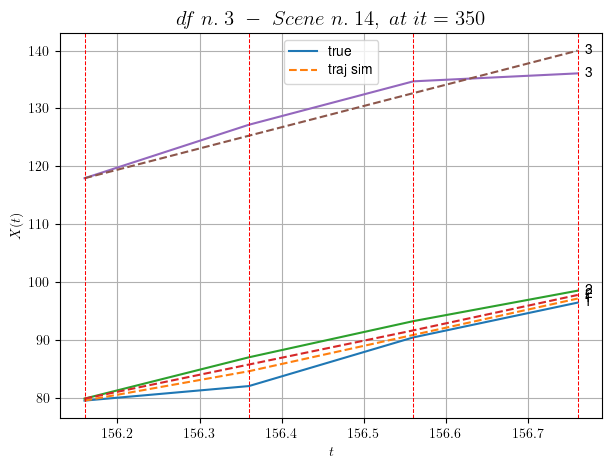

        For scene 14/55
        * use LR_NN=5e-05 with err=28.609135846750416 at it=19
        * v0_scn_mean = 36.19851124933011
        * MAE = 2.613554201005115



            - Time interval n.0: [207.96, 208.16]
                * y_true: [30.12104774 28.85226703]
                * v_ann: [30.918596267700195, 30.679521560668945, 31.1249015167828]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [208.16, 208.36]
                * y_true: [31.19139939 27.73265496]
                * v_ann: [29.819015502929688, 29.95290756225586, 31.1249015167828]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [208.36, 208.56]
                * y_true: [31.59181924 26.81292648]
                * v_ann: [29.43616485595703, 29.512672424316406, 31.1249015167828]

-------------------------------------------------------------------------

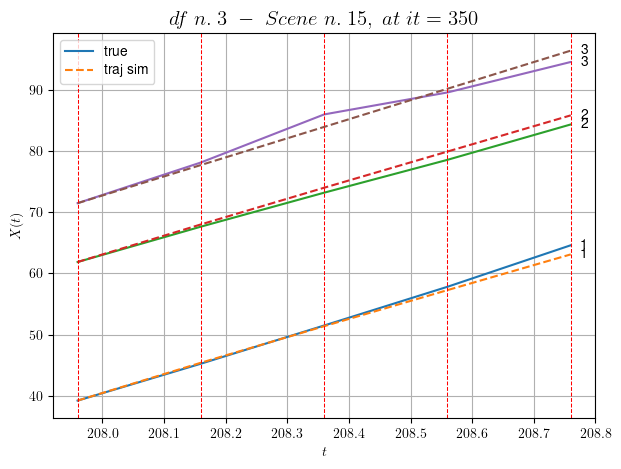

        For scene 15/55
        * use LR_NN=0.0005 with err=9.51258559110638 at it=19
        * v0_scn_mean = 31.028489542419344
        * MAE = 0.9867366118946695



            - Time interval n.0: [218.16, 218.36]
                * y_true: [26.47083003 31.40159485]
                * v_ann: [32.51288604736328, 32.02362823486328, 31.94691151510615]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [218.36, 218.56]
                * y_true: [32.09751616 29.50187244]
                * v_ann: [29.998632431030273, 30.08245086669922, 31.94691151510615]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [218.56, 218.76]
                * y_true: [31.61167285 38.50305628]
                * v_ann: [30.85411834716797, 31.15361213684082, 31.94691151510615]

------------------------------------------------------------------------

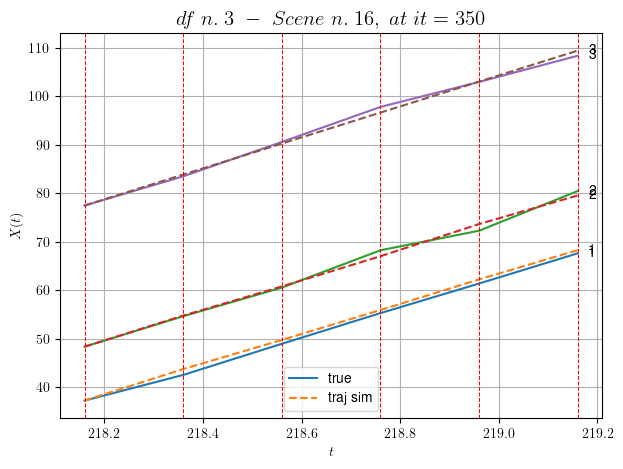

        For scene 16/55
        * use LR_NN=0.0005 with err=26.772960367531656 at it=19
        * v0_scn_mean = 31.780047500540157
        * MAE = 0.5672926794099263



            - Time interval n.0: [222.96, 223.16]
                * y_true: [37.21103813 39.71315438]
                * v_ann: [35.050323486328125, 34.2397575378418, 31.279741440153785]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [223.16, 223.36]
                * y_true: [31.35126998 28.99272163]
                * v_ann: [35.65785598754883, 35.22203063964844, 31.279741440153785]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.36, 223.56]
                * y_true: [33.72173898 31.78369531]
                * v_ann: [34.910396575927734, 34.38518142700195, 31.279741440153785]

-------------------------------------------------------------------

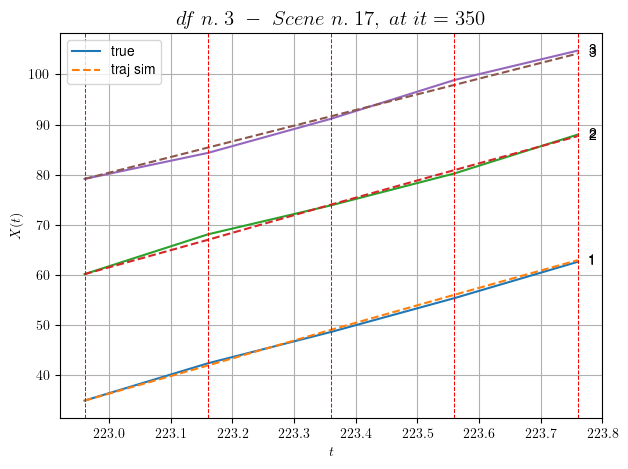

        For scene 17/55
        * use LR_NN=5e-05 with err=6.183690697465774 at it=19
        * v0_scn_mean = 31.1700585949637
        * MAE = 0.358431042785228



            - Time interval n.0: [247.36, 247.56]
                * y_true: [24.34113117 25.37248976]
                * v_ann: [29.0559024810791, 26.78928565979004, 29.199550876740712]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [247.56, 247.76]
                * y_true: [20.86113385 27.00305492]
                * v_ann: [27.329509735107422, 25.86216163635254, 29.199550876740712]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [247.76, 247.96]
                * y_true: [25.44173909 29.15378269]
                * v_ann: [26.717138290405273, 26.902185440063477, 29.199550876740712]

-----------------------------------------------------------------------

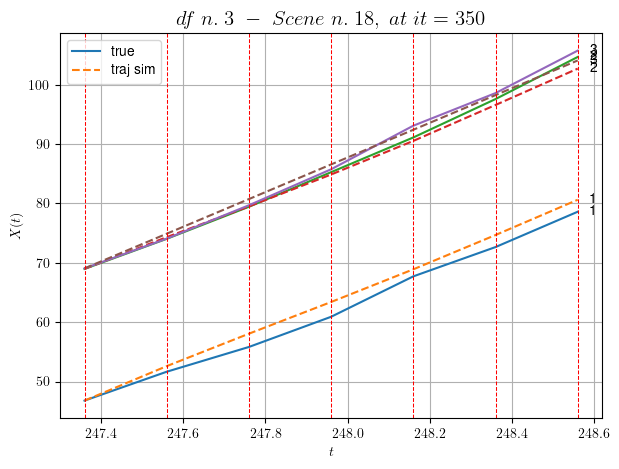

        For scene 18/55
        * use LR_NN=0.001 with err=5.493471525362871 at it=19
        * v0_scn_mean = 29.26815499825642
        * MAE = 1.108216813614553



            - Time interval n.0: [269.56, 269.76]
                * y_true: [27.75027124 32.18076388]
                * v_ann: [29.179847717285156, 29.336231231689453, 30.53917177371945]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [269.76, 269.96]
                * y_true: [33.80053503 32.77104018]
                * v_ann: [29.258018493652344, 29.303760528564453, 30.53917177371945]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [269.96, 270.16]
                * y_true: [22.10049768 29.95131945]
                * v_ann: [30.609872817993164, 30.862573623657227, 30.53917177371945]

---------------------------------------------------------------------

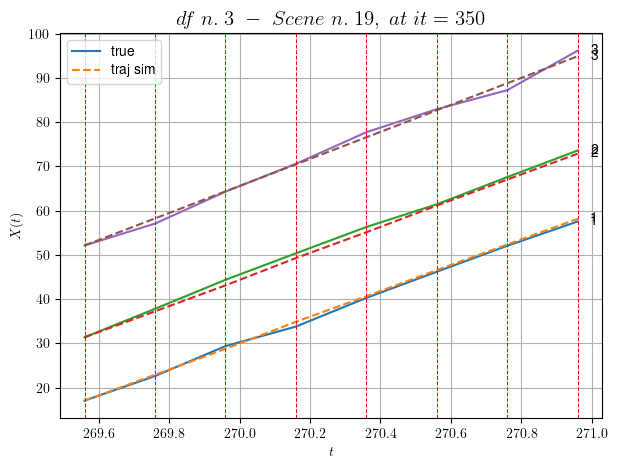

        For scene 19/55
        * use LR_NN=0.0005 with err=5.704461764899353 at it=19
        * v0_scn_mean = 30.492960959306323
        * MAE = 0.4707952105075408



            - Time interval n.0: [316.16, 316.36]
                * y_true: [33.9635286 19.3731464]
                * v_ann: [27.695039749145508, 27.974506378173828, 31.119723216260347]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [316.36, 316.56]
                * y_true: [24.60296417 29.75560281]
                * v_ann: [26.018709182739258, 26.072124481201172, 31.119723216260347]

----------------------------------------------------------------------------------------------------
            * err= 0.7777577611392342
            * Learning rate NN = 7.289998757187277e-05
            * diff = 7.799163590882507e-05


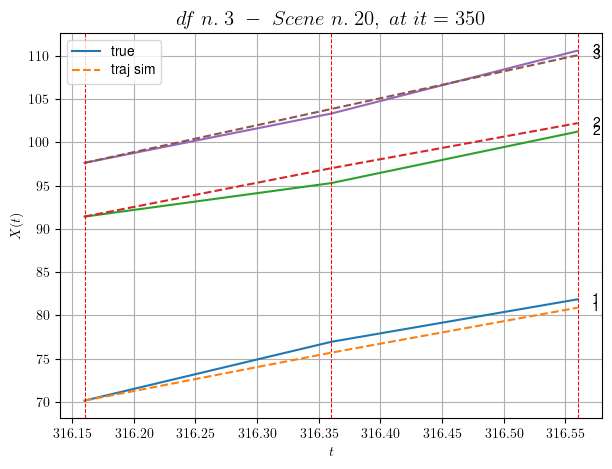

        For scene 20/55
        * use LR_NN=0.0001 with err=3.191952989182653 at it=19
        * v0_scn_mean = 31.02375505868519
        * MAE = 0.7777577611392342



            - Time interval n.0: [317.76, 317.96]
                * y_true: [22.24301013 28.10582296]
                * v_ann: [28.032629013061523, 30.83994483947754, 28.729615682184505]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.96, 318.16]
                * y_true: [28.26433817 33.10585656]
                * v_ann: [23.519412994384766, 28.4583740234375, 28.729615682184505]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [318.16, 318.36]
                * y_true: [11.28182915 18.67354228]
                * v_ann: [30.40513038635254, 15.42831802368164, 28.729615682184505]

---------------------------------------------------------------------

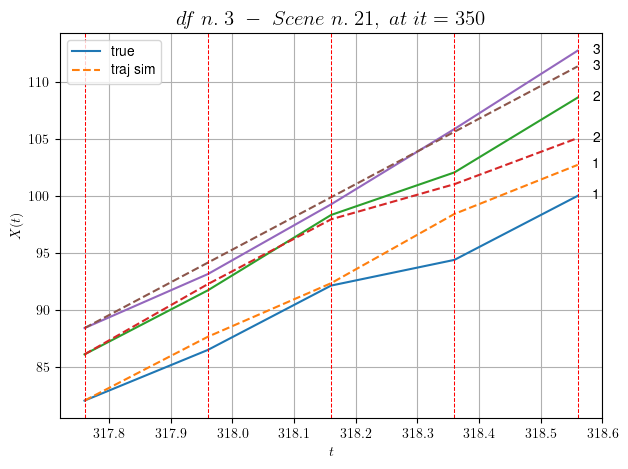

        For scene 21/55
        * use LR_NN=0.005 with err=14.627044713911081 at it=19
        * v0_scn_mean = 28.838496556157345
        * MAE = 2.836633808741666



            - Time interval n.0: [325.76, 325.96]
                * y_true: [25.31057708 30.22149101]
                * v_ann: [21.97768783569336, 27.154569625854492, 33.13552965013222]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [325.96, 326.16]
                * y_true: [25.23074384 33.46208613]
                * v_ann: [24.49083709716797, 30.759979248046875, 33.13552965013222]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [326.16, 326.36]
                * y_true: [24.63092838 29.01218385]
                * v_ann: [26.13072395324707, 32.681854248046875, 33.13552965013222]

----------------------------------------------------------------------

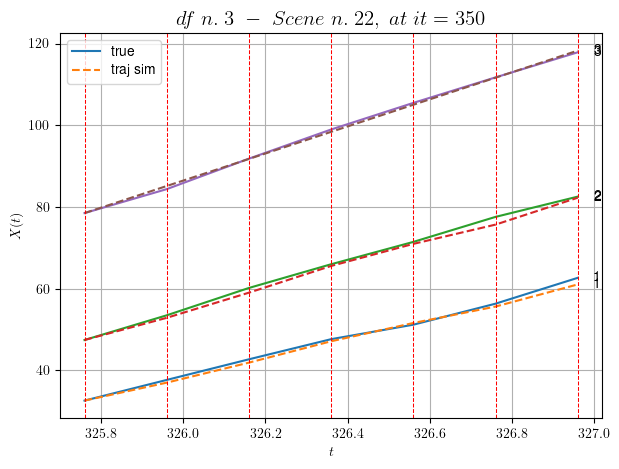

        For scene 22/55
        * use LR_NN=0.0005 with err=11.308324379220599 at it=19
        * v0_scn_mean = 32.866792698734464
        * MAE = 0.5454049440405512



            - Time interval n.0: [335.76, 335.96]
                * y_true: [36.00253797 32.17585284]
                * v_ann: [37.85216522216797, 33.994232177734375, 9.495828685169702]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [335.96, 336.16]
                * y_true: [33.90297107 37.71766361]
                * v_ann: [33.14580535888672, 31.676393508911133, 9.495828685169702]

----------------------------------------------------------------------------------------------------
            * err= 0.6151445816724469
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0049675302542337985


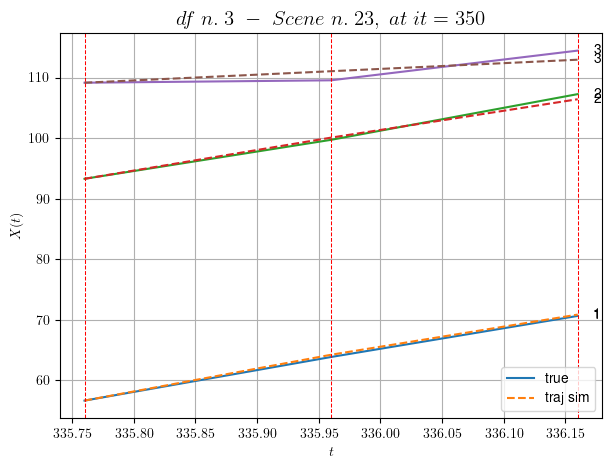

        For scene 23/55
        * use LR_NN=0.0001 with err=16.955484718530002 at it=19
        * v0_scn_mean = 11.253180426321075
        * MAE = 0.6151445816724469



            - Time interval n.0: [371.16, 371.36]
                * y_true: [24.42036896 26.80112378]
                * v_ann: [27.031797409057617, 27.007322311401367, 32.53948924917022]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.36, 371.56]
                * y_true: [25.21053633 31.30165898]
                * v_ann: [25.936058044433594, 25.17158317565918, 32.53948924917022]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.56, 371.76]
                * y_true: [24.36067127 30.15199262]
                * v_ann: [27.730539321899414, 29.068178176879883, 32.53948924917022]

------------------------------------------------------------------

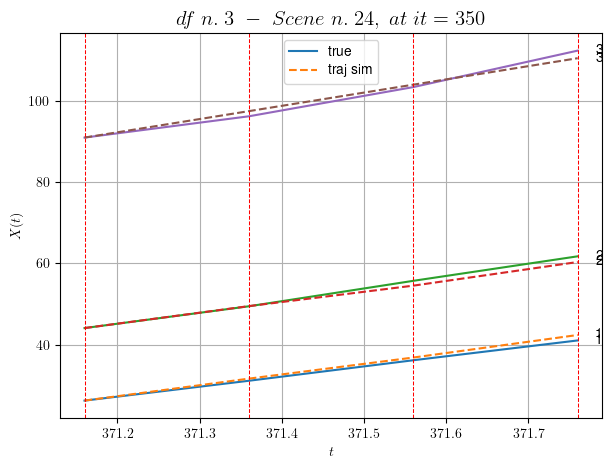

        For scene 24/55
        * use LR_NN=0.0001 with err=7.50218093237806 at it=19
        * v0_scn_mean = 32.321837153646065
        * MAE = 0.9382322212453937



            - Time interval n.0: [387.36, 387.56]
                * y_true: [32.47194771 39.46360823]
                * v_ann: [0.0003094935673289001, 4.1401056844955764e-13, 33.03187618027038]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [387.56, 387.76]
                * y_true: [28.80212467 26.65295039]
                * v_ann: [4.6916120481910184e-05, 2.0378008308563622e-11, 33.03187618027038]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [387.76, 387.96]
                * y_true: [28.30253286 24.25305315]
                * v_ann: [8.372434240300208e-05, 2.8964471879971976e-13, 33.03187618027038]

---------------------------------------------

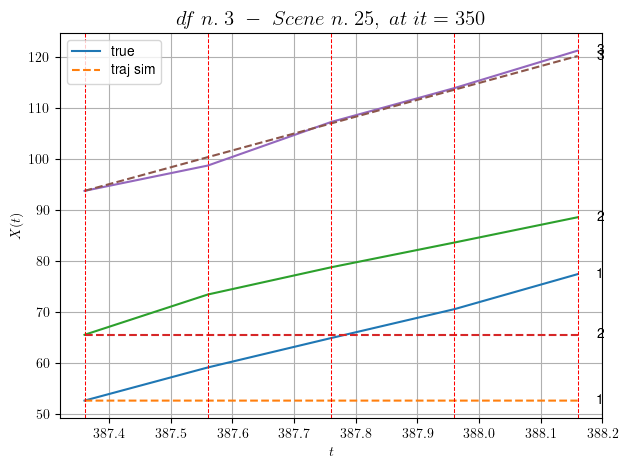

        For scene 25/55
        * use LR_NN=0.0005 with err=16.286913891857775 at it=19
        * v0_scn_mean = 32.772023060505184
        * MAE = 21.227881543341198



            - Time interval n.0: [390.36, 390.56]
                * y_true: [34.37306474 33.21473815]
                * v_ann: [2.640578600221488e-07, 4.293061010685051e-06, 36.35421452147256]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [390.56, 390.76]
                * y_true: [31.79338609 29.7348149 ]
                * v_ann: [3.5989290836369037e-07, 2.558964524723706e-07, 36.35421452147256]

----------------------------------------------------------------------------------------------------
            * err= 47.709926425391465
            * Learning rate NN = 7.289998757187277e-05
            * diff = 1.0833598409476508e-06


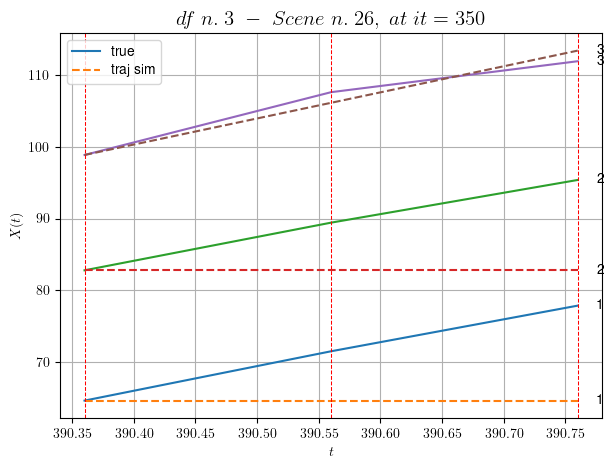

        For scene 26/55
        * use LR_NN=0.0001 with err=1.0495685156884973 at it=19
        * v0_scn_mean = 35.809613631169675
        * MAE = 47.66132358311639



            - Time interval n.0: [427.96, 428.16]
                * y_true: [33.16108667 24.70091575]
                * v_ann: [28.78144073486328, 1.0717911545747588e-18, 37.34980306665185]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [428.16, 428.36]
                * y_true: [36.08159054 35.68166414]
                * v_ann: [36.10935974121094, 7.081268334337432e-20, 37.34980306665185]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [428.36, 428.56]
                * y_true: [27.64533545 36.4184567 ]
                * v_ann: [34.073272705078125, 9.0898838739361e-20, 37.34980306665185]

------------------------------------------------------------

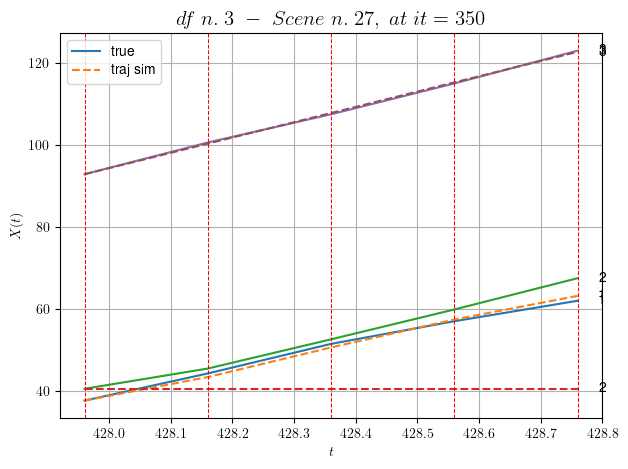

        For scene 27/55
        * use LR_NN=5e-05 with err=76.79812646461257 at it=19
        * v0_scn_mean = 36.71987323345032
        * MAE = 85.14931099405935



            - Time interval n.0: [439.36, 439.56]
                * y_true: [29.12388438 22.06331107]
                * v_ann: [27.90685272216797, 28.012508392333984, 33.53635301945251]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [439.56, 439.76]
                * y_true: [38.07606081 22.99369197]
                * v_ann: [28.43059730529785, 23.972850799560547, 33.53635301945251]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [439.76, 439.96]
                * y_true: [23.98424021 18.65338098]
                * v_ann: [21.287994384765625, 24.952104568481445, 33.53635301945251]

-----------------------------------------------------------------------

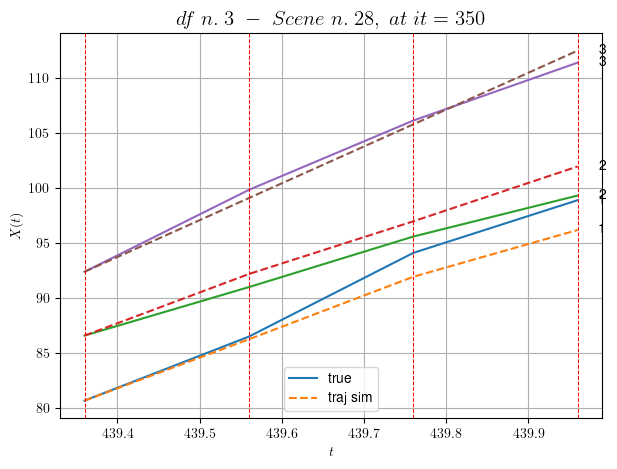

        For scene 28/55
        * use LR_NN=0.001 with err=13.354067747317659 at it=19
        * v0_scn_mean = 33.23326268526436
        * MAE = 1.2574167641953071



            - Time interval n.0: [448.36, 448.56]
                * y_true: [32.70350359 27.85524745]
                * v_ann: [32.31513214111328, 32.74832534790039, 31.58503673308329]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [448.56, 448.76]
                * y_true: [39.76511656 28.75604876]
                * v_ann: [31.893911361694336, 32.33863067626953, 31.58503673308329]

----------------------------------------------------------------------------------------------------
            * err= 0.8996367767005665
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0013936444854013574


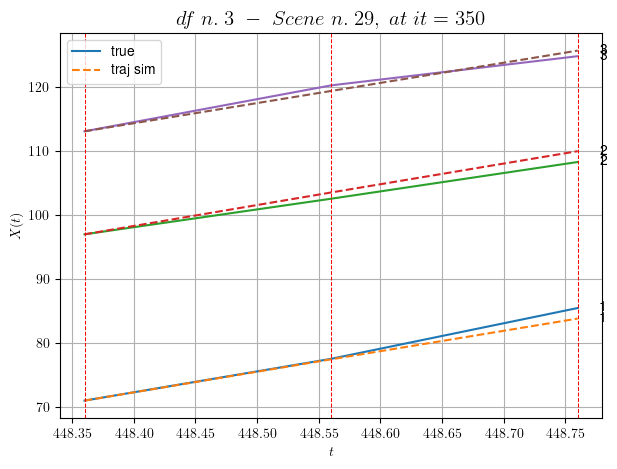

        For scene 29/55
        * use LR_NN=5e-05 with err=0.6004903502222778 at it=19
        * v0_scn_mean = 31.449187933349894
        * MAE = 0.8996367767005665



            - Time interval n.0: [465.16, 465.36]
                * y_true: [25.95020905 30.0319773 ]
                * v_ann: [5.555174105009025e-15, 1.4528812243952416e-05, 24.722117202498676]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [465.36, 465.56]
                * y_true: [21.30025919 28.782318  ]
                * v_ann: [2.2808327221259667e-15, 2.70342716248706e-05, 24.722117202498676]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [465.56, 465.76]
                * y_true: [22.00036741 28.59272475]
                * v_ann: [4.462830781230105e-16, 1.0551084415055811e-05, 24.722117202498676]

-------------------------------------------

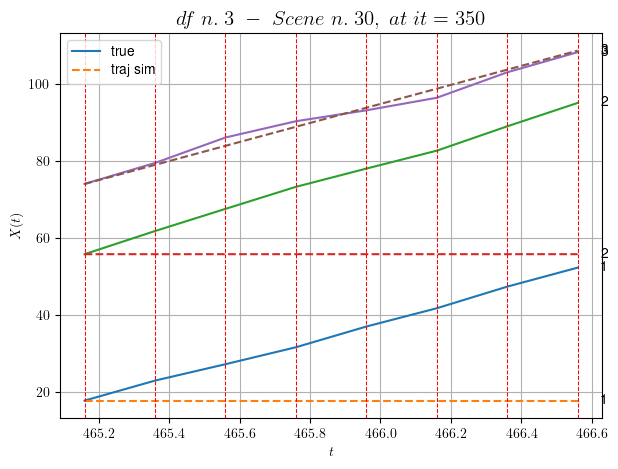

        For scene 30/55
        * use LR_NN=0.0005 with err=65.2033781721621 at it=19
        * v0_scn_mean = 25.17446889140034
        * MAE = 43.67791921595191



            - Time interval n.0: [467.16, 467.36]
                * y_true: [14.52040439 29.14139959]
                * v_ann: [19.842424392700195, 21.0917911529541, 20.776329501781685]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [467.36, 467.56]
                * y_true: [ 8.96028804 21.01119683]
                * v_ann: [19.197521209716797, 19.919719696044922, 20.776329501781685]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [467.56, 467.76]
                * y_true: [15.62056342 22.22157858]
                * v_ann: [19.15242576599121, 20.045433044433594, 20.776329501781685]

---------------------------------------------------------------------

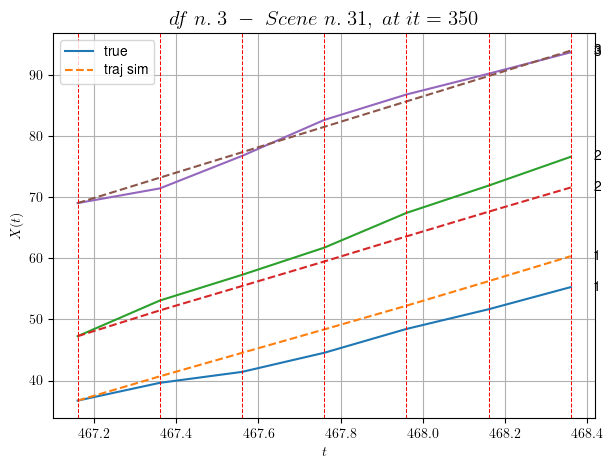

        For scene 31/55
        * use LR_NN=0.0001 with err=15.992296201031792 at it=19
        * v0_scn_mean = 21.56686295768007
        * MAE = 7.706117001916102



            - Time interval n.0: [480.76, 480.96]
                * y_true: [26.72145209 13.04113053]
                * v_ann: [16.51922607421875, 17.309335708618164, 18.304926244694727]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [480.96, 481.16]
                * y_true: [27.70182882 12.50117676]
                * v_ann: [17.312271118164062, 19.085525512695312, 18.304926244694727]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [481.16, 481.36]
                * y_true: [16.26121495 12.26123448]
                * v_ann: [17.35651206970215, 20.132381439208984, 18.304926244694727]

------------------------------------------------------------------

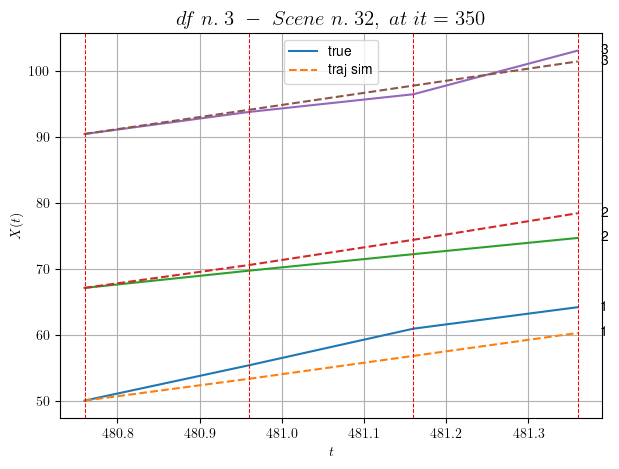

        For scene 32/55
        * use LR_NN=0.0005 with err=15.345183053092782 at it=19
        * v0_scn_mean = 19.307276347569537
        * MAE = 5.023829580829371



            - Time interval n.0: [487.16, 487.36]
                * y_true: [ 6.3002445  28.62315801]
                * v_ann: [14.532510757446289, 14.547280311584473, 23.071881683469584]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [487.36, 487.56]
                * y_true: [10.63044184 13.60161023]
                * v_ann: [14.976936340332031, 14.833110809326172, 23.071881683469584]

----------------------------------------------------------------------------------------------------
            * err= 2.6191315136257063
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0001974670327373751


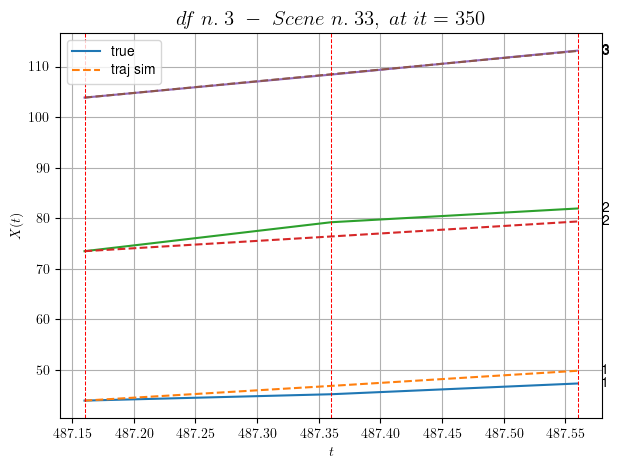

        For scene 33/55
        * use LR_NN=5e-05 with err=3.8868094323501086 at it=19
        * v0_scn_mean = 23.665670166773314
        * MAE = 2.6191315136257063



            - Time interval n.0: [498.56, 498.76]
                * y_true: [19.66086018 15.38134444]
                * v_ann: [16.93297004699707, 17.164981842041016, 26.404288947134958]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [498.76, 498.96]
                * y_true: [16.17082592 17.38167269]
                * v_ann: [16.875516891479492, 17.499223709106445, 26.404288947134958]

----------------------------------------------------------------------------------------------------
            * err= 0.20650223811842763
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 4.968732736215786e-05


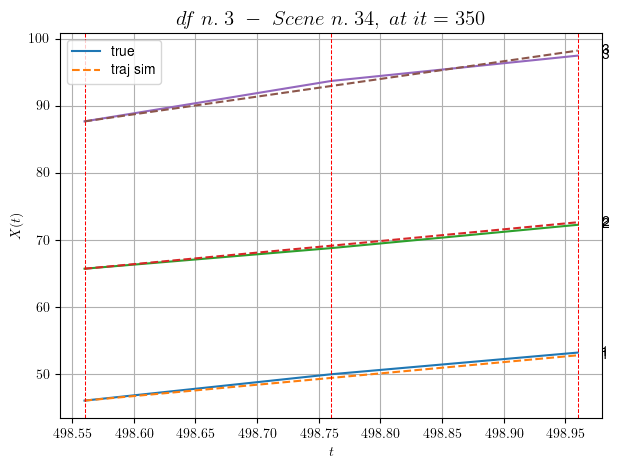

        For scene 34/55
        * use LR_NN=5e-05 with err=0.8419566579375924 at it=19
        * v0_scn_mean = 26.712466682406937
        * MAE = 0.20650223811842763



            - Time interval n.0: [517.96, 518.16]
                * y_true: [11.01062169 17.99135838]
                * v_ann: [14.213898658752441, 13.390511512756348, 13.435858379544593]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [518.16, 518.36]
                * y_true: [13.11081201 12.94110202]
                * v_ann: [13.300128936767578, 14.1123046875, 13.435858379544593]

----------------------------------------------------------------------------------------------------
            * err= 0.27646702281787433
            * Learning rate NN = 0.0007289999630302191
            * diff = 2.6343750517299203e-05


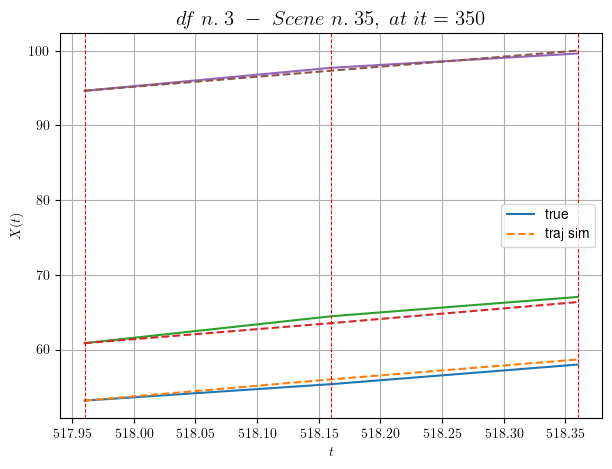

        For scene 35/55
        * use LR_NN=0.001 with err=7.300986513134377 at it=19
        * v0_scn_mean = 14.855521855353429
        * MAE = 0.2762161268142105



            - Time interval n.0: [527.36, 527.56]
                * y_true: [14.45064103 23.0016556 ]
                * v_ann: [16.72607421875, 16.75476837158203, 16.921000530114533]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [527.56, 527.76]
                * y_true: [16.14079976 10.04077962]
                * v_ann: [16.86724090576172, 16.76889419555664, 16.921000530114533]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [527.76, 527.96]
                * y_true: [12.25068777 19.3317022 ]
                * v_ann: [16.691455841064453, 16.68570327758789, 16.921000530114533]

------------------------------------------------------------------------

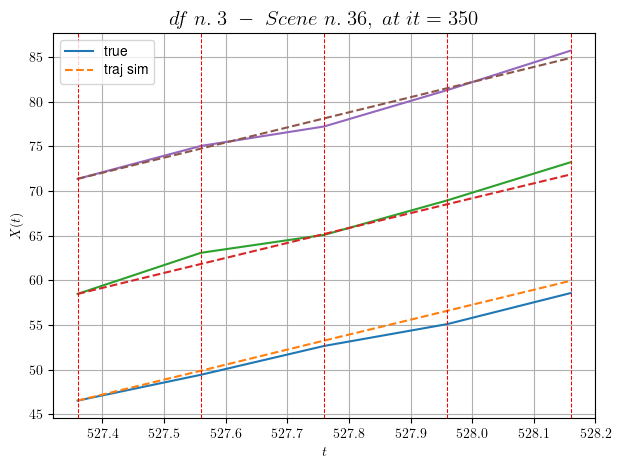

        For scene 36/55
        * use LR_NN=5e-05 with err=14.099541717928021 at it=19
        * v0_scn_mean = 18.041962803496954
        * MAE = 0.6586993885323132



            - Time interval n.0: [530.36, 530.56]
                * y_true: [16.07060164 26.13260896]
                * v_ann: [19.9601993560791, 19.120834350585938, 18.054941466396027]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [530.56, 530.76]
                * y_true: [15.14064363 18.85215172]
                * v_ann: [20.4320011138916, 19.00345802307129, 18.054941466396027]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [530.76, 530.96]
                * y_true: [16.69081323 25.36324467]
                * v_ann: [20.561498641967773, 18.77197265625, 18.054941466396027]

------------------------------------------------------------------------

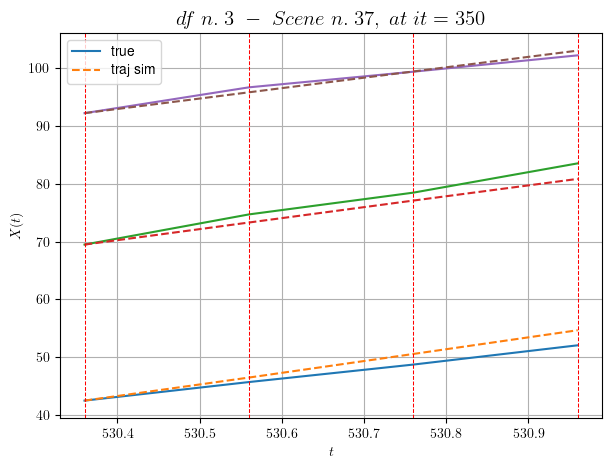

        For scene 37/55
        * use LR_NN=1e-05 with err=10.805670629865437 at it=19
        * v0_scn_mean = 19.078717023567016
        * MAE = 1.9411060206364565



            - Time interval n.0: [576.56, 576.76]
                * y_true: [22.12000755 22.50086521]
                * v_ann: [23.146469116210938, 22.228303909301758, 21.51674944574931]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [576.76, 576.96]
                * y_true: [22.90003133 17.69083   ]
                * v_ann: [23.037809371948242, 22.194673538208008, 21.51674944574931]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [576.96, 577.16]
                * y_true: [24.57008129 24.8113942 ]
                * v_ann: [22.36356544494629, 21.75132942199707, 21.51674944574931]

--------------------------------------------------------------------

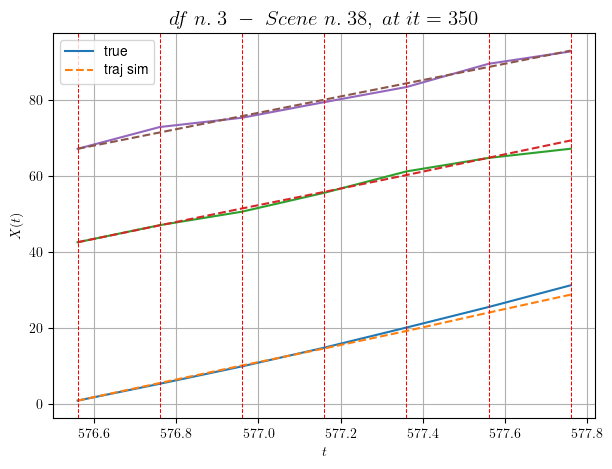

        For scene 38/55
        * use LR_NN=0.0001 with err=19.64741848447939 at it=19
        * v0_scn_mean = 22.24382370313931
        * MAE = 0.7624929309290956



            - Time interval n.0: [579.56, 579.76]
                * y_true: [21.03058275 42.18516565]
                * v_ann: [25.253629684448242, 23.780235290527344, 25.358438002860318]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.76, 579.96]
                * y_true: [19.36065083 36.06520173]
                * v_ann: [28.12603759765625, 24.97986602783203, 25.358438002860318]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.96, 580.16]
                * y_true: [21.76088956 12.96224398]
                * v_ann: [29.208776473999023, 24.719045639038086, 25.358438002860318]

------------------------------------------------------------------

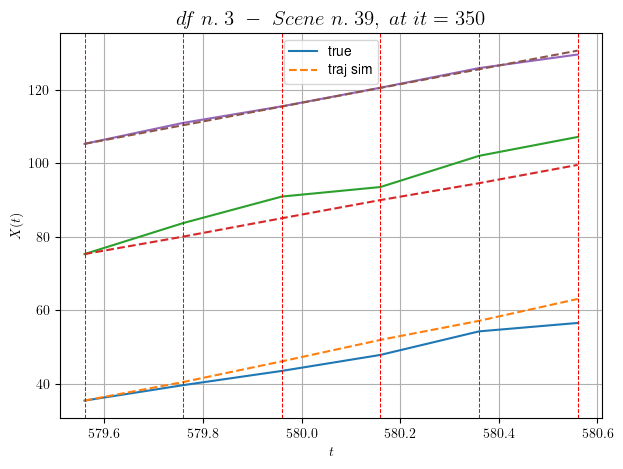

        For scene 39/55
        * use LR_NN=0.0001 with err=37.23438832373244 at it=19
        * v0_scn_mean = 25.756252522262553
        * MAE = 13.926828356742837



            - Time interval n.0: [592.16, 592.36]
                * y_true: [ 4.45046478 21.56401461]
                * v_ann: [16.263816833496094, 15.010947227478027, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [592.36, 592.56]
                * y_true: [14.40168088 21.61284101]
                * v_ann: [10.636551856994629, 15.607162475585938, 24.71001897344754]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [592.56, 592.76]
                * y_true: [14.40168088 22.933287  ]
                * v_ann: [12.698363304138184, 15.738348960876465, 24.71001897344754]

------------------------------------------------------------------

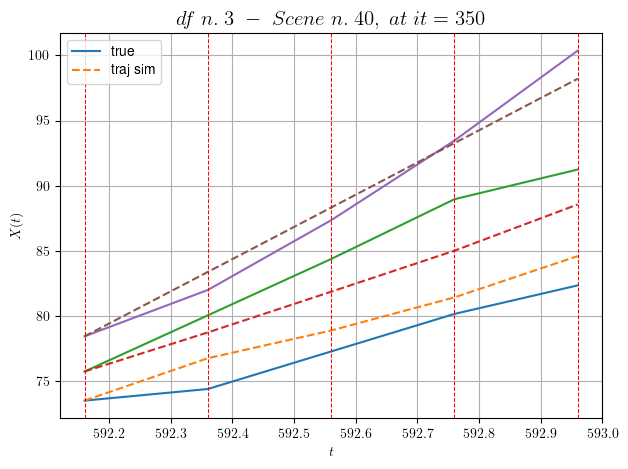

        For scene 40/55
        * use LR_NN=0.005 with err=13.241681213710935 at it=19
        * v0_scn_mean = 25.163407565696268
        * MAE = 2.8596409661356925



            - Time interval n.0: [21.56, 21.76]
                * y_true: [26.48927836 26.93283237 27.60013316]
                * v_ann: [23.46121597290039, 27.52960205078125, 22.851274490356445, 29.083788662827413]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.76, 21.96]
                * y_true: [24.19440937 24.35304119 22.73494812]
                * v_ann: [23.63699722290039, 27.817882537841797, 22.972164154052734, 29.083788662827413]

----------------------------------------------------------------------------------------------------
            * err= 0.3353478090967013
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.016084336847995873


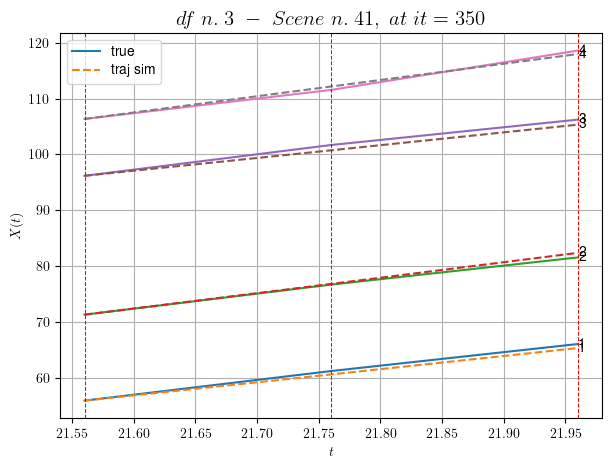

        For scene 41/55
        * use LR_NN=5e-05 with err=3.7495578393338467 at it=19
        * v0_scn_mean = 29.188365659888323
        * MAE = 0.3353478090967013



            - Time interval n.0: [31.36, 31.56]
                * y_true: [24.92105739 19.11766565 26.56610692]
                * v_ann: [19.026641845703125, 21.695663452148438, 23.07142448425293, 30.91704367792894]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [31.56, 31.76]
                * y_true: [24.72130541 29.91666352 24.00857353]
                * v_ann: [21.012619018554688, 25.920867919921875, 27.516693115234375, 30.91704367792894]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [31.76, 31.96]
                * y_true: [24.58151426  8.80091982 33.80389928]
                * v_ann: [22.43848991394043, 25.3758602142334, 30.399829864501953, 

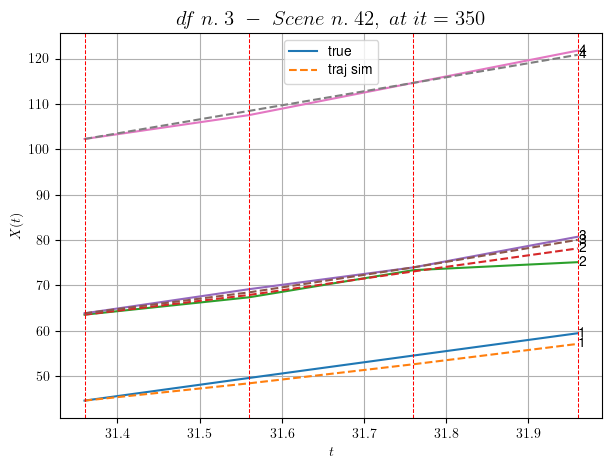

        For scene 42/55
        * use LR_NN=0.001 with err=9.373669774259064 at it=19
        * v0_scn_mean = 30.812371676917227
        * MAE = 1.1648427935481462



            - Time interval n.0: [33.76, 33.96]
                * y_true: [24.27120267 28.75319668 39.53553599]
                * v_ann: [27.483078002929688, 28.42693328857422, 27.44293212890625, 24.316455544260645]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [33.96, 34.16]
                * y_true: [18.63110748 26.36338094 39.47623422]
                * v_ann: [31.602825164794922, 29.59503936767578, 29.927692413330078, 24.316455544260645]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [34.16, 34.36]
                * y_true: [25.20172426 27.37399424 29.73574355]
                * v_ann: [29.115510940551758, 27.71795082092285, 27.141616821289062,

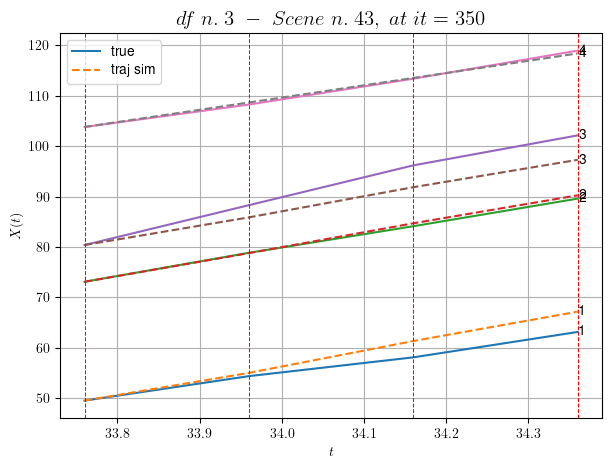

        For scene 43/55
        * use LR_NN=0.0005 with err=15.049646358352739 at it=19
        * v0_scn_mean = 24.96517924776504
        * MAE = 4.335532761931224



            - Time interval n.0: [34.96, 35.16]
                * y_true: [33.40218228 30.49313647 20.11252108]
                * v_ann: [25.324371337890625, 26.20924949645996, 25.315114974975586, 34.043949579976285]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [35.16, 35.36]
                * y_true: [28.66899207 22.90260208 19.5026699 ]
                * v_ann: [25.64698028564453, 26.855100631713867, 26.21670150756836, 34.043949579976285]

----------------------------------------------------------------------------------------------------
            * err= 1.2534702201402417
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0014874416225398868


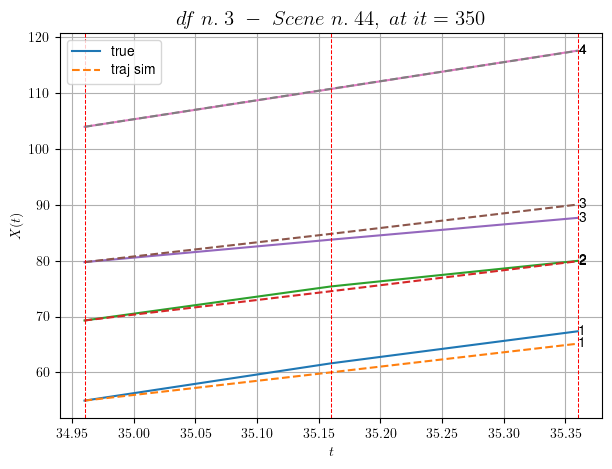

        For scene 44/55
        * use LR_NN=5e-05 with err=9.762593232783901 at it=19
        * v0_scn_mean = 33.58237037201238
        * MAE = 1.2534702201402417



            - Time interval n.0: [83.36, 83.56]
                * y_true: [27.1108197  22.97496526 13.79424223]
                * v_ann: [28.481985092163086, 27.52761459350586, 28.944286346435547, 26.108277505261114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [83.56, 83.76]
                * y_true: [28.73111951 35.1785896  26.83859352]
                * v_ann: [27.97480010986328, 27.648269653320312, 28.77462387084961, 26.108277505261114]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [83.76, 83.96]
                * y_true: [29.25142438 34.77932949 18.27648805]
                * v_ann: [28.246444702148438, 27.91913604736328, 28.527015686035156, 

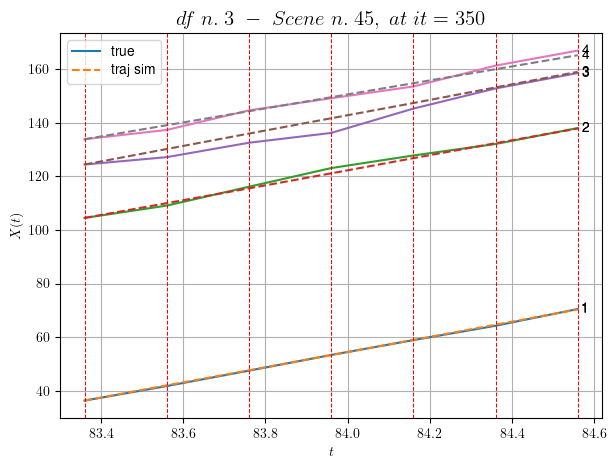

        For scene 45/55
        * use LR_NN=1e-05 with err=99.85995076571008 at it=19
        * v0_scn_mean = 26.552481408205743
        * MAE = 2.4605731486143356



            - Time interval n.0: [94.36, 94.56]
                * y_true: [33.70387327 38.57908217 21.70251029]
                * v_ann: [29.64695930480957, 29.951313018798828, 29.470287322998047, 29.526223424799525]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [94.56, 94.76]
                * y_true: [29.14386677 24.50535727 32.05702124]
                * v_ann: [32.566627502441406, 28.39508628845215, 32.88042068481445, 29.526223424799525]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [94.76, 94.96]
                * y_true: [29.96461386 30.28702151 28.36707369]
                * v_ann: [26.90121841430664, 31.098295211791992, 26.42866325378418, 

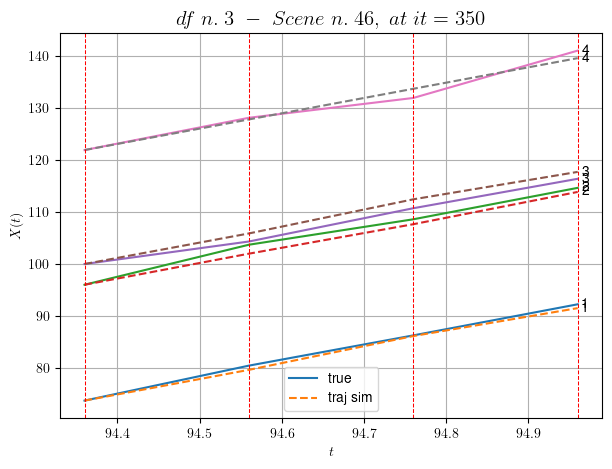

        For scene 46/55
        * use LR_NN=0.001 with err=21.570903914841743 at it=19
        * v0_scn_mean = 29.580300611472712
        * MAE = 1.1361302641156306



            - Time interval n.0: [142.16, 142.36]
                * y_true: [31.90177154 33.47450881 19.84324761]
                * v_ann: [25.169174194335938, 25.40439796447754, 25.810129165649414, 28.12150482470027]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [142.36, 142.56]
                * y_true: [31.50218522 24.08376432 24.27420294]
                * v_ann: [26.284008026123047, 27.083982467651367, 27.415355682373047, 28.12150482470027]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [142.56, 142.76]
                * y_true: [24.70204715 30.9853993  17.45337402]
                * v_ann: [26.095600128173828, 27.01653289794922, 27.333164215

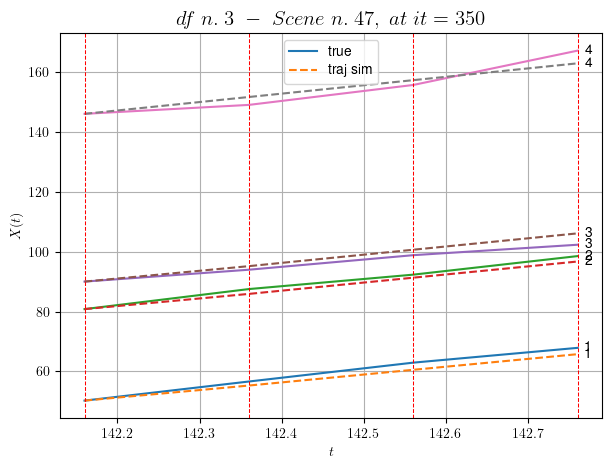

        For scene 47/55
        * use LR_NN=0.0001 with err=32.77198953728207 at it=19
        * v0_scn_mean = 28.33591756601419
        * MAE = 4.097734903752793



            - Time interval n.0: [170.36, 170.56]
                * y_true: [24.1106547  30.95205085 31.86307572]
                * v_ann: [25.548641204833984, 25.634492874145508, 25.48127555847168, 32.996113961383685]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [170.56, 170.76]
                * y_true: [28.33103197 10.10076519 29.63331411]
                * v_ann: [26.0006046295166, 25.91627311706543, 26.084476470947266, 32.996113961383685]

----------------------------------------------------------------------------------------------------
            * err= 0.9410385098187999
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.000702942946471663


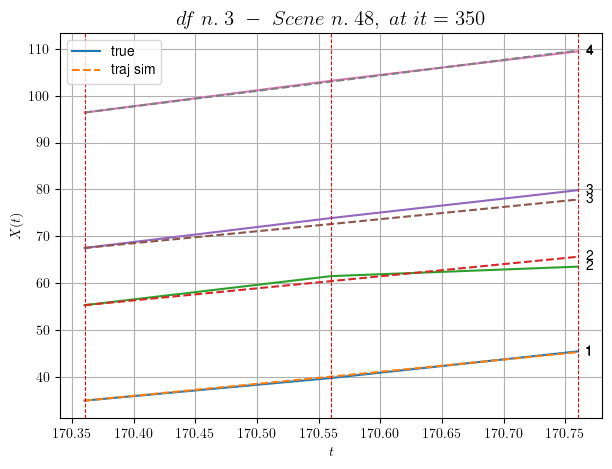

        For scene 48/55
        * use LR_NN=5e-05 with err=1.795983309196488 at it=19
        * v0_scn_mean = 32.65413543719226
        * MAE = 0.9164604177200655



            - Time interval n.0: [248.16, 248.36]
                * y_true: [31.21204442 24.6823336  32.34552948]
                * v_ann: [31.132736206054688, 33.52888107299805, 30.497007369995117, 30.24893521731518]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [248.36, 248.56]
                * y_true: [31.9625999  29.77329807 35.48696999]
                * v_ann: [27.871265411376953, 29.416532516479492, 32.40571975708008, 30.24893521731518]

----------------------------------------------------------------------------------------------------
            * err= 0.7028318046743258
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0006052562837259856


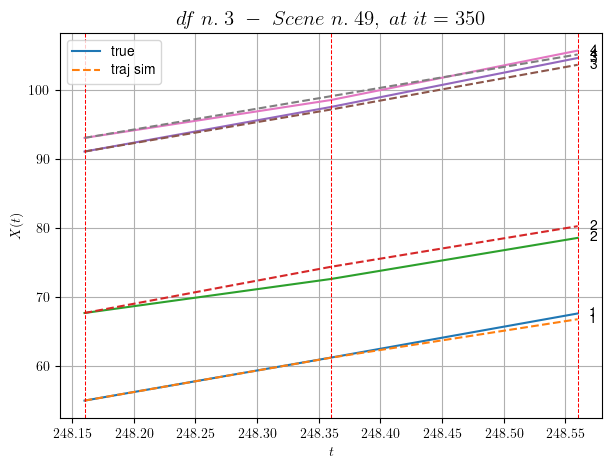

        For scene 49/55
        * use LR_NN=0.001 with err=12.461373706131882 at it=19
        * v0_scn_mean = 30.22052157907149
        * MAE = 0.4773056309944237



            - Time interval n.0: [320.56, 320.76]
                * y_true: [27.61038846 20.60122903 24.07186814]
                * v_ann: [35.43089294433594, 32.606712341308594, 34.40009689331055, 28.13040675966605]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [320.76, 320.96]
                * y_true: [30.26064275 26.25184013 33.56317876]
                * v_ann: [17.417205810546875, 22.254968643188477, 16.971790313720703, 28.13040675966605]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [320.96, 321.16]
                * y_true: [38.25114958 30.20253063 29.36323845]
                * v_ann: [30.28278923034668, 29.637664794921875, 30.95788764953

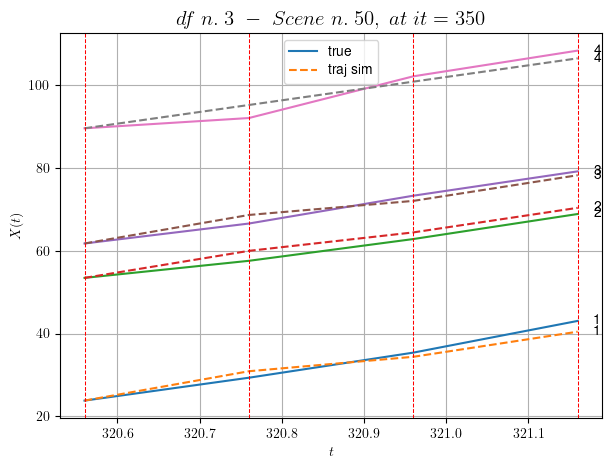

        For scene 50/55
        * use LR_NN=0.001 with err=7.371924622173847 at it=19
        * v0_scn_mean = 28.343803427953326
        * MAE = 1.5348163385689746



            - Time interval n.0: [333.96, 334.16]
                * y_true: [31.40121985 21.58136302 16.05156144]
                * v_ann: [29.28033447265625, 29.626033782958984, 29.16485023498535, 24.219597199973922]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [334.16, 334.36]
                * y_true: [27.67132891 33.9725354  36.25406589]
                * v_ann: [29.57513427734375, 28.886381149291992, 29.646425247192383, 24.219597199973922]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [334.36, 334.56]
                * y_true: [23.81145278 36.52334008 36.85496039]
                * v_ann: [29.28738021850586, 29.202547073364258, 29.0237045288

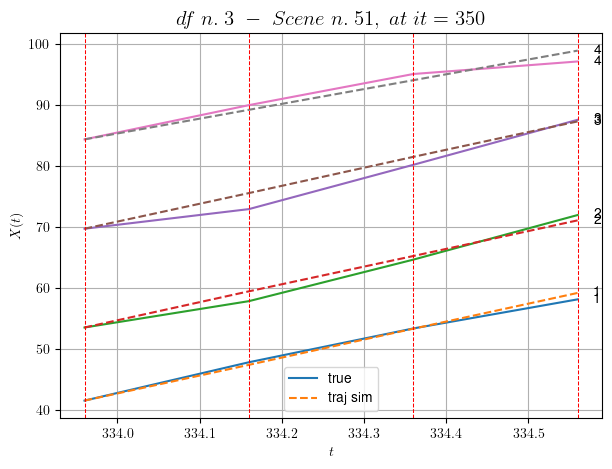

        For scene 51/55
        * use LR_NN=5e-05 with err=4.3769725604373715 at it=19
        * v0_scn_mean = 24.87937638202867
        * MAE = 1.1476144119792355



            - Time interval n.0: [393.36, 393.56]
                * y_true: [28.21049617 36.91227562 35.66212709]
                * v_ann: [25.87494468688965, 31.743144989013672, 30.302831649780273, 27.006719107886315]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [393.56, 393.76]
                * y_true: [27.89067116 17.24119841 30.82238865]
                * v_ann: [27.457622528076172, 27.907052993774414, 31.787113189697266, 27.006719107886315]

----------------------------------------------------------------------------------------------------
            * err= 1.2988720934679348
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00016550371900359018


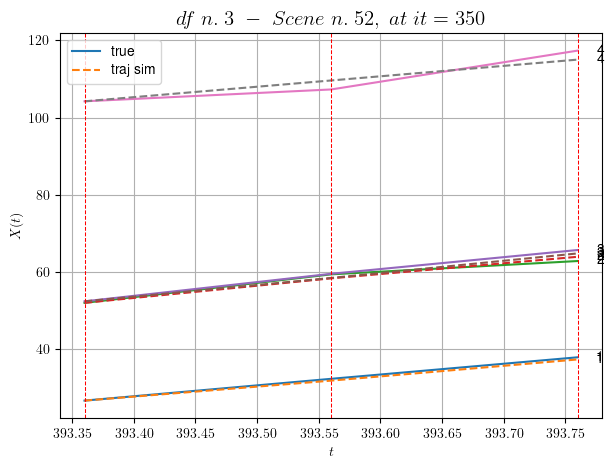

        For scene 52/55
        * use LR_NN=0.0001 with err=15.573675431235383 at it=19
        * v0_scn_mean = 27.348374263587164
        * MAE = 1.1633997865972339



            - Time interval n.0: [521.76, 521.96]
                * y_true: [10.54036018 15.07054541 11.30098461]
                * v_ann: [14.287942886352539, 15.564104080200195, 15.33549690246582, 17.249600462639783]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [521.96, 522.16]
                * y_true: [20.11080333 12.92054275 19.50185752]
                * v_ann: [18.126007080078125, 14.349664688110352, 14.562217712402344, 17.249600462639783]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [522.16, 522.36]
                * y_true: [16.31074126 16.85079656 12.50130097]
                * v_ann: [13.160086631774902, 15.33564281463623, 15.113349

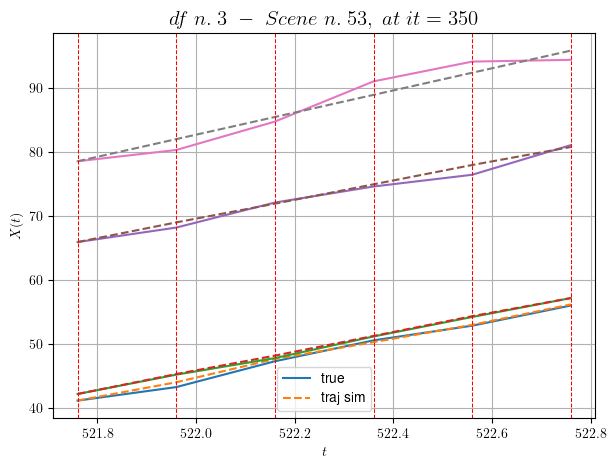

        For scene 53/55
        * use LR_NN=0.001 with err=25.72870225561614 at it=19
        * v0_scn_mean = 18.704939903274074
        * MAE = 0.7049277866115289



            - Time interval n.0: [95.36, 95.56]
                * y_true: [30.52238998 38.21809619 31.62683865 21.81676128]
                * v_ann: [25.134830474853516, 28.060617446899414, 22.46654510498047, 28.429746627807617, 33.348609616246016]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [95.56, 95.76]
                * y_true: [29.11270185 26.43618159 23.59563306 15.73527867]
                * v_ann: [31.854358673095703, 24.688426971435547, 25.963529586791992, 27.912839889526367, 33.348609616246016]

----------------------------------------------------------------------------------------------------
            * err= 2.233313648444299
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00173786033955

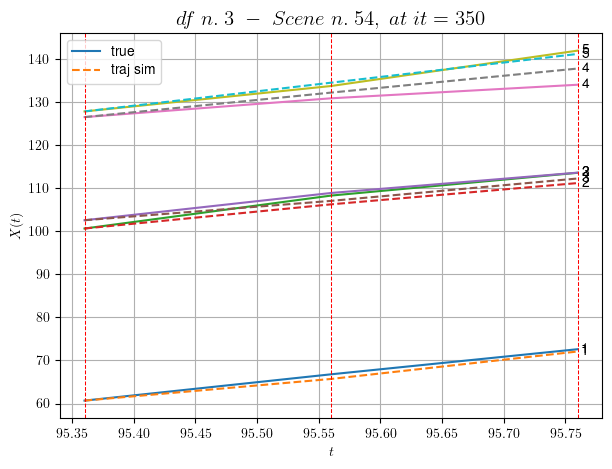

        For scene 54/55
        * use LR_NN=0.0005 with err=17.474023968015626 at it=19
        * v0_scn_mean = 32.87313348320182
        * MAE = 2.2103647965464974



For df=3 with 55 scenes, time taken:        617.81
------------------------------------------------------------
****************************************************************************************************
In df n.4/10 we have 30 scenes
****************************************************************************************************
            - Time interval n.0: [7.04, 7.24]
                * y_true: [ 8.37556318 26.1843701 ]
                * v_ann: [17.764835357666016, 17.768030166625977, 36.154185886666866]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [7.24, 7.44]
                * y_true: [12.54090657 23.03433042]
                * v_ann: [17.397260665893555, 17.180883407592773, 36.154185886666866]

----------------

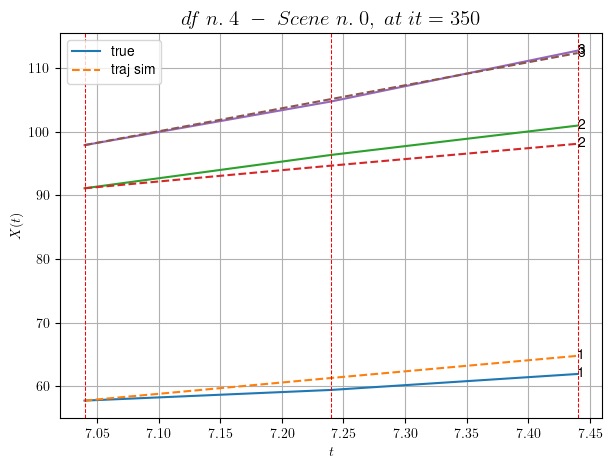

        For scene 0/30
        * use LR_NN=0.0005 with err=12.219799272525151 at it=19
        * v0_scn_mean = 35.62672885769243
        * MAE = 2.5447323956821406



            - Time interval n.0: [19.84, 20.04]
                * y_true: [38.50393497 35.76621737]
                * v_ann: [30.730234146118164, 28.972537994384766, 26.058995147815413]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [20.04, 20.24]
                * y_true: [14.10165462 33.63672046]
                * v_ann: [32.2280158996582, 29.41602325439453, 26.058995147815413]

----------------------------------------------------------------------------------------------------
            * err= 1.5440912052929907
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.0038688353762610372


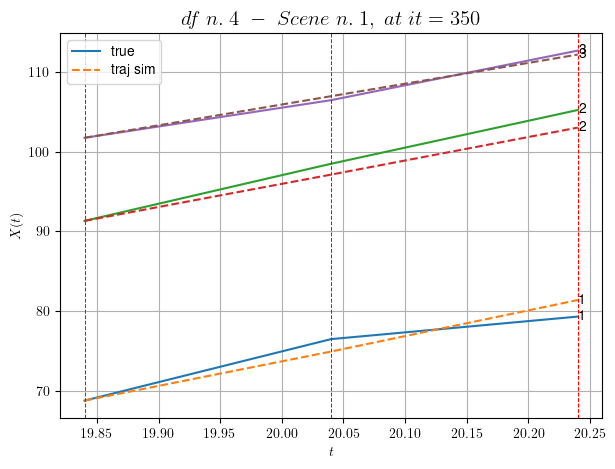

        For scene 1/30
        * use LR_NN=0.0001 with err=10.442125254820956 at it=19
        * v0_scn_mean = 26.396766991043386
        * MAE = 1.5440912052929907



            - Time interval n.0: [23.64, 23.84]
                * y_true: [16.50112189 27.57447859]
                * v_ann: [16.330955505371094, 21.93536949157715, 25.974604646459824]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.84, 24.04]
                * y_true: [13.80103575 15.46275359]
                * v_ann: [19.474374771118164, 14.650715827941895, 25.974604646459824]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [24.04, 24.24]
                * y_true: [18.55153987 13.07248815]
                * v_ann: [16.798187255859375, 16.853851318359375, 25.974604646459824]

----------------------------------------------------------------------

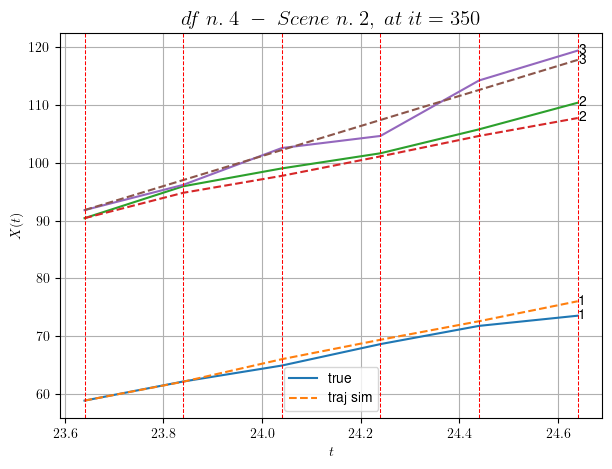

        For scene 2/30
        * use LR_NN=0.001 with err=26.701927457490058 at it=19
        * v0_scn_mean = 26.31960934939312
        * MAE = 1.7851959303554612



            - Time interval n.0: [80.24, 80.44]
                * y_true: [20.8407888  28.56113721]
                * v_ann: [24.41345977783203, 28.79843521118164, 22.367829423056083]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [80.44, 80.64]
                * y_true: [28.49133895 28.481454  ]
                * v_ann: [26.68042755126953, 27.34910011291504, 22.367829423056083]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [80.64, 80.84]
                * y_true: [29.84173661 32.11200361]
                * v_ann: [26.81488609313965, 26.84339141845703, 22.367829423056083]

-----------------------------------------------------------------------------

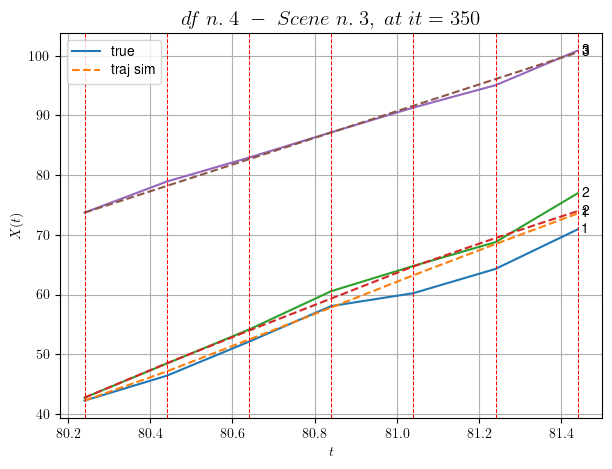

        For scene 3/30
        * use LR_NN=0.0005 with err=54.9619518475183 at it=19
        * v0_scn_mean = 23.021960138519695
        * MAE = 2.2349727500163925



            - Time interval n.0: [89.04, 89.24]
                * y_true: [19.34082001 24.8230577 ]
                * v_ann: [19.56194496154785, 20.487401962280273, 32.77541157779926]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [89.24, 89.44]
                * y_true: [14.120693   17.32233598]
                * v_ann: [19.712993621826172, 20.634187698364258, 32.77541157779926]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [89.44, 89.64]
                * y_true: [18.19104002 31.50485669]
                * v_ann: [19.08213233947754, 19.52654457092285, 32.77541157779926]

-----------------------------------------------------------------------------

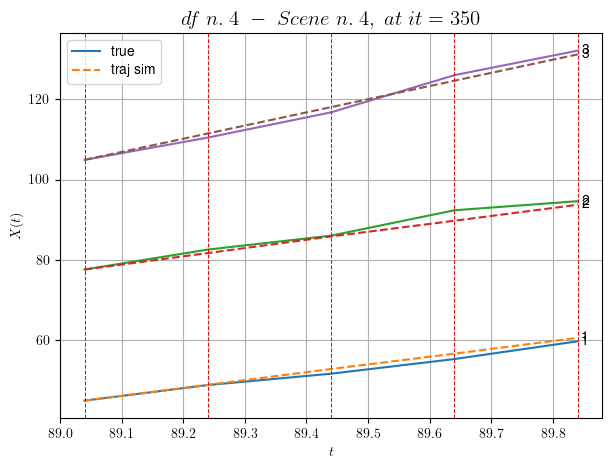

        For scene 4/30
        * use LR_NN=5e-05 with err=4.267547375987428 at it=19
        * v0_scn_mean = 32.537539278852506
        * MAE = 1.183246902559218



            - Time interval n.0: [96.44, 96.64]
                * y_true: [16.86045215 20.08121647]
                * v_ann: [18.354778289794922, 18.62966537475586, 18.4013644164237]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [96.64, 96.84]
                * y_true: [17.24055532  8.93061591]
                * v_ann: [18.168676376342773, 18.662996292114258, 18.4013644164237]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [96.84, 97.04]
                * y_true: [21.11081641 16.18118624]
                * v_ann: [17.085174560546875, 18.031387329101562, 18.4013644164237]

-------------------------------------------------------------------------------

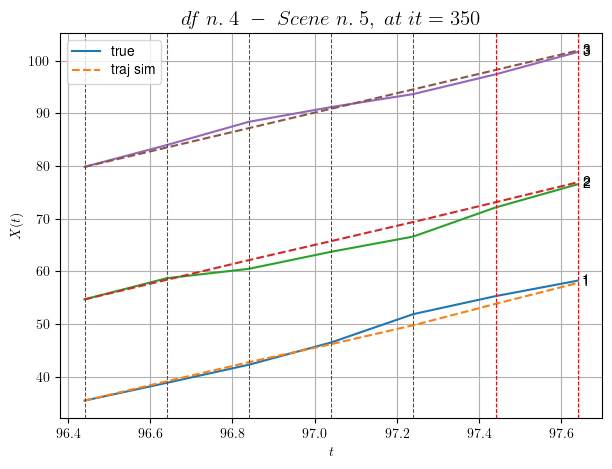

        For scene 5/30
        * use LR_NN=0.0005 with err=31.772677156540297 at it=19
        * v0_scn_mean = 19.39544908947916
        * MAE = 1.251811874352599



            - Time interval n.0: [182.24, 182.44]
                * y_true: [18.61043577 13.125309  ]
                * v_ann: [19.0993709564209, 19.56864356994629, 20.773266238583332]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [182.44, 182.64]
                * y_true: [12.51734154 21.64870909]
                * v_ann: [15.621033668518066, 19.60881996154785, 20.773266238583332]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [182.64, 182.84]
                * y_true: [15.03048681 24.29091592]
                * v_ann: [19.059682846069336, 19.430910110473633, 20.773266238583332]

---------------------------------------------------------------------

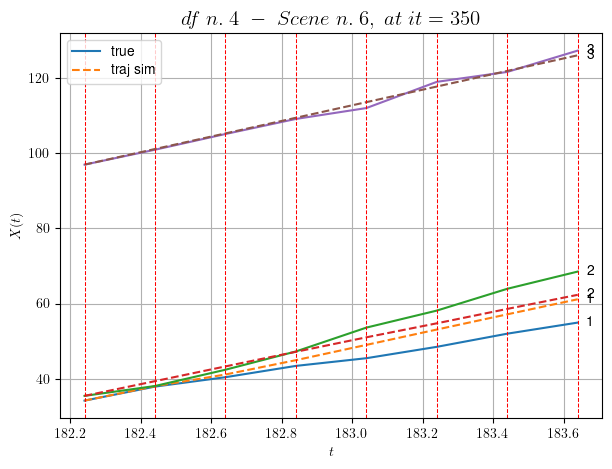

        For scene 6/30
        * use LR_NN=0.0001 with err=53.63808019114244 at it=19
        * v0_scn_mean = 21.56406223768993
        * MAE = 8.098152210432506



            - Time interval n.0: [193.04, 193.24]
                * y_true: [26.28155868 27.90372348]
                * v_ann: [24.01962661743164, 24.601242065429688, 18.50661179835625]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [193.24, 193.44]
                * y_true: [29.63205884 19.30286837]
                * v_ann: [27.781158447265625, 26.20734214782715, 18.50661179835625]

----------------------------------------------------------------------------------------------------
            * err= 0.34894769157684813
            * Learning rate NN = 0.00036449998151510954
            * diff = 3.946454357572904e-05


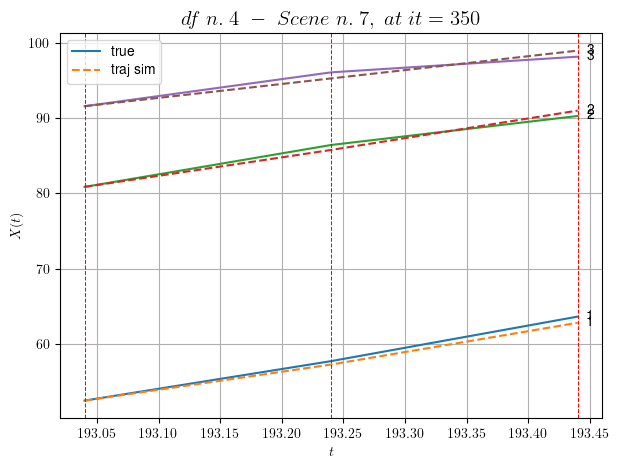

        For scene 7/30
        * use LR_NN=0.0005 with err=7.209462792389737 at it=19
        * v0_scn_mean = 19.491676030300177
        * MAE = 0.33879899619699055



            - Time interval n.0: [196.84, 197.04]
                * y_true: [ 8.77046468 10.16548364]
                * v_ann: [9.269118309020996, 5.247021022114495e-07, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [197.04, 197.24]
                * y_true: [7.43042623 9.26246532]
                * v_ann: [8.557124137878418, 1.0922868831642063e-08, 20.188844124320998]

----------------------------------------------------------------------------------------------------
            * err= 2.221532223890162
            * Learning rate NN = 0.0036449995823204517
            * diff = 6.818143362785634e-06


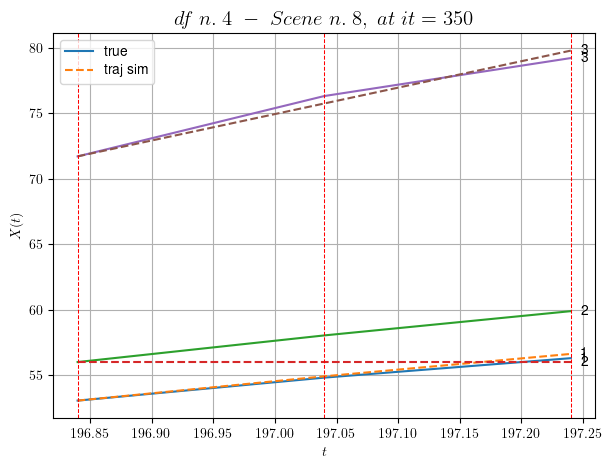

        For scene 8/30
        * use LR_NN=0.005 with err=3.007464147055894 at it=19
        * v0_scn_mean = 21.029729210389302
        * MAE = 2.221379268691242



        For scene 9/30
        * use LR_NN=0.0005 with err=5.398193139827072 at it=19
        * v0_scn_mean = 30.094441532938035
        * MAE = 30.51618083006098



            - Time interval n.0: [224.84, 225.04]
                * y_true: [17.10046829 25.29311811]
                * v_ann: [18.736194610595703, 20.32260513305664, 15.713780360625538]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.04, 225.24]
                * y_true: [17.70062553 10.9614656 ]
                * v_ann: [19.13191795349121, 20.641841888427734, 15.713780360625538]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.24, 225.44]
                * y_true: [22.57087879 26

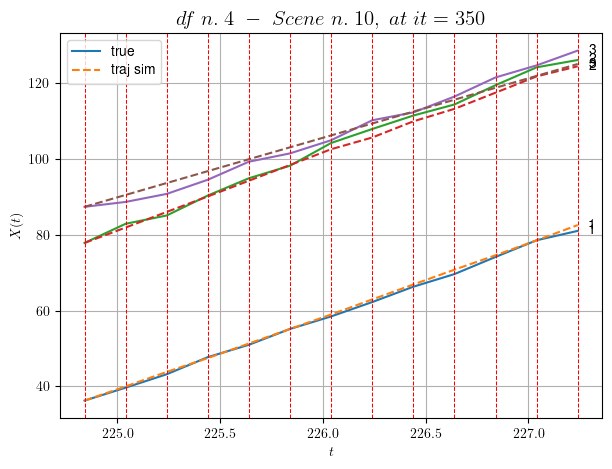

        For scene 10/30
        * use LR_NN=0.0005 with err=200.65264021589715 at it=19
        * v0_scn_mean = 16.938209896071623
        * MAE = 1.9492043035195799



            - Time interval n.0: [230.84, 231.04]
                * y_true: [ 5.64695095 17.97864337]
                * v_ann: [11.727468490600586, 13.951117515563965, 23.322771251469238]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [231.04, 231.24]
                * y_true: [ 5.72513489 21.19066695]
                * v_ann: [14.742033004760742, 13.709158897399902, 23.322771251469238]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [231.24, 231.44]
                * y_true: [ 6.01015392 28.29114422]
                * v_ann: [14.570145606994629, 13.83653736114502, 23.322771251469238]

---------------------------------------------------------------

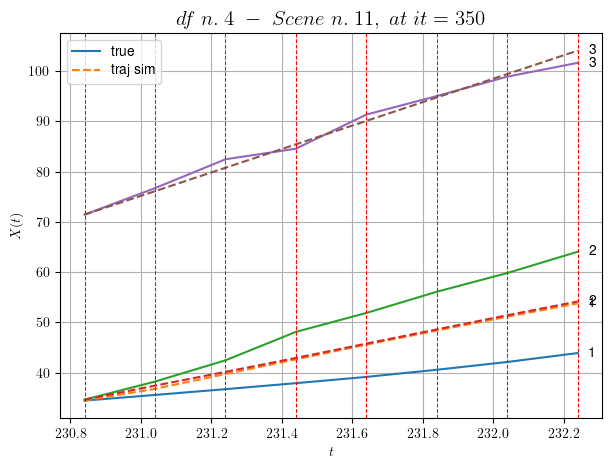

        For scene 11/30
        * use LR_NN=0.001 with err=20.53961805705759 at it=19
        * v0_scn_mean = 23.895056733633915
        * MAE = 25.6699277375528



            - Time interval n.0: [233.84, 234.04]
                * y_true: [14.14101026 12.7012637 ]
                * v_ann: [21.08547592163086, 21.919212341308594, 21.4628681603156]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [234.04, 234.24]
                * y_true: [26.43219185 20.11227439]
                * v_ann: [20.919097900390625, 21.743677139282227, 21.4628681603156]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [234.24, 234.44]
                * y_true: [22.40209801 33.22429882]
                * v_ann: [20.893413543701172, 21.806812286376953, 21.4628681603156]

-------------------------------------------------------------------------

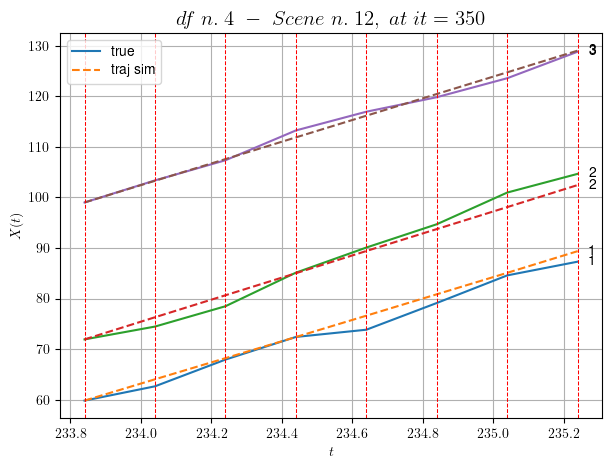

        For scene 12/30
        * use LR_NN=5e-05 with err=33.16115480672783 at it=19
        * v0_scn_mean = 22.194560422955682
        * MAE = 1.5724694277090026



            - Time interval n.0: [302.44, 302.64]
                * y_true: [15.00036276 19.90190261]
                * v_ann: [19.862836837768555, 19.399948120117188, 25.744568982281994]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [302.64, 302.84]
                * y_true: [17.72492583 25.30273749]
                * v_ann: [19.60759925842285, 18.958084106445312, 25.744568982281994]

----------------------------------------------------------------------------------------------------
            * err= 0.5973240629366087
            * Learning rate NN = 7.289998757187277e-05
            * diff = 0.00015578759754131255


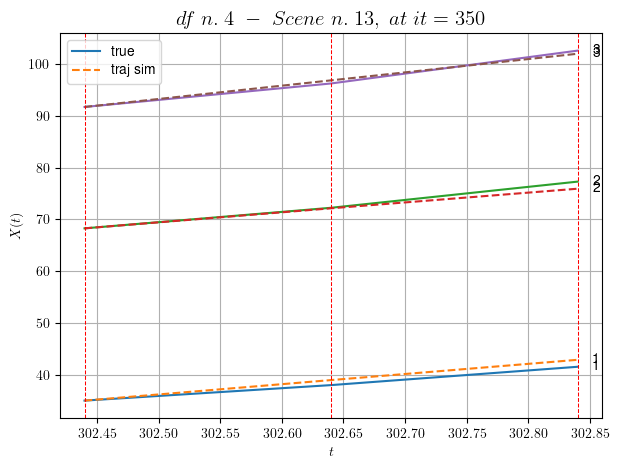

        For scene 13/30
        * use LR_NN=0.0001 with err=2.0994436011925086 at it=19
        * v0_scn_mean = 26.10928936007706
        * MAE = 0.5874096780038975



            - Time interval n.0: [364.64, 364.84]
                * y_true: [23.68175628 20.26218764]
                * v_ann: [18.459890365600586, 19.10619354248047, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [364.84, 365.04]
                * y_true: [20.38169455 13.81168669]
                * v_ann: [18.78018569946289, 19.18883514404297, 28.205737859029586]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [365.04, 365.24]
                * y_true: [10.17092159 27.1635357 ]
                * v_ann: [18.961278915405273, 18.259185791015625, 28.205737859029586]

------------------------------------------------------------------

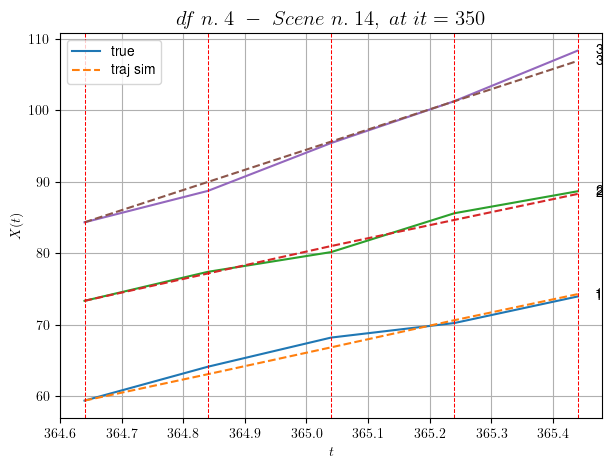

        For scene 14/30
        * use LR_NN=0.0001 with err=0.9748428651229529 at it=19
        * v0_scn_mean = 28.35951874824957
        * MAE = 0.542893633040443



            - Time interval n.0: [422.64, 422.84]
                * y_true: [18.36052369 19.91162557]
                * v_ann: [31.83439826965332, 24.057586669921875, 27.545107346547073]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [422.84, 423.04]
                * y_true: [28.40107569 15.51150308]
                * v_ann: [21.12281036376953, 17.597827911376953, 27.545107346547073]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [423.04, 423.24]
                * y_true: [26.09121176 24.58263804]
                * v_ann: [22.194475173950195, 19.76385498046875, 27.545107346547073]

-------------------------------------------------------------------

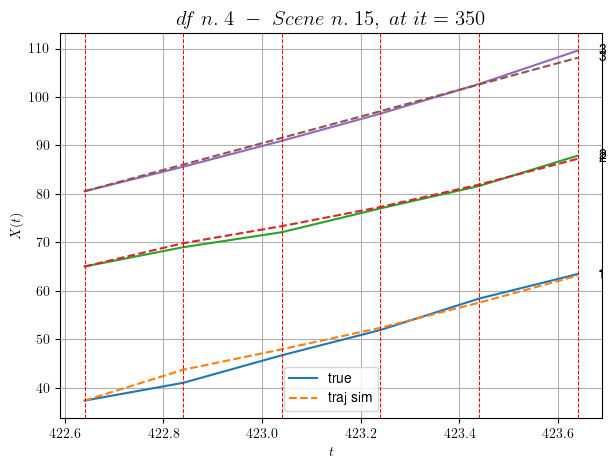

        For scene 15/30
        * use LR_NN=0.001 with err=2.507709220908367 at it=19
        * v0_scn_mean = 27.755508918629225
        * MAE = 0.8048991975329608



            - Time interval n.0: [440.44, 440.64]
                * y_true: [23.50209477 27.05306951]
                * v_ann: [20.373493194580078, 20.118600845336914, 21.12705861242051]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [440.64, 440.84]
                * y_true: [ 8.15079495 24.70319187]
                * v_ann: [21.09634017944336, 21.51072883605957, 21.12705861242051]

----------------------------------------------------------------------------------------------------
            * err= 1.1463899340849417
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00017539439862246375


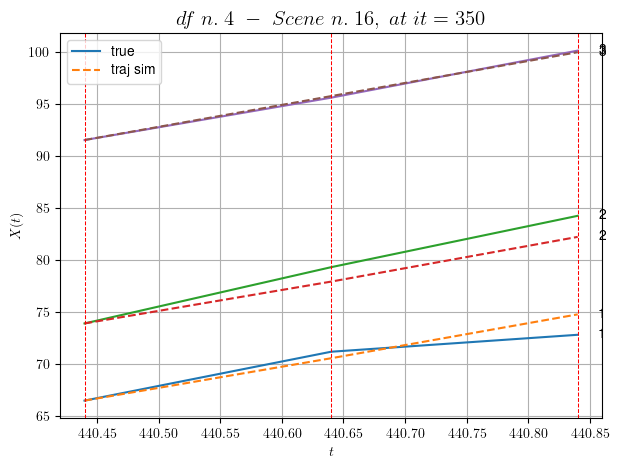

        For scene 16/30
        * use LR_NN=0.0005 with err=2.744738335972809 at it=19
        * v0_scn_mean = 21.887532115942648
        * MAE = 1.145274860769602



            - Time interval n.0: [459.64, 459.84]
                * y_true: [ 8.02057991 18.30147717]
                * v_ann: [16.09236717224121, 19.006315231323242, 21.749537222117457]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [459.84, 460.04]
                * y_true: [15.90126261 32.50305135]
                * v_ann: [21.569232940673828, 18.37797737121582, 21.749537222117457]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [460.04, 460.24]
                * y_true: [12.56106954  7.60079575]
                * v_ann: [16.907470703125, 17.166126251220703, 21.749537222117457]

---------------------------------------------------------------------

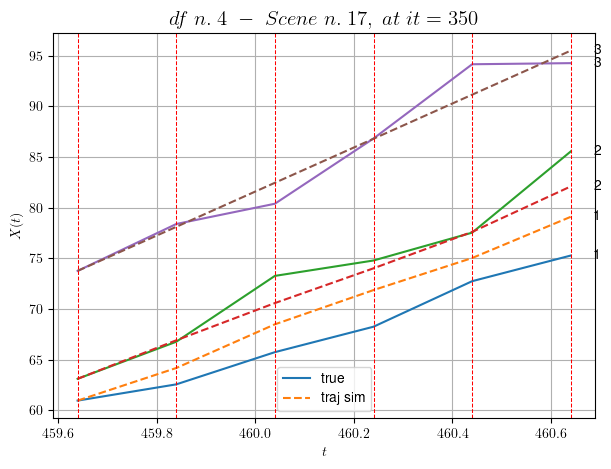

        For scene 17/30
        * use LR_NN=0.001 with err=10.305755959814526 at it=19
        * v0_scn_mean = 22.456659929267563
        * MAE = 4.1291885313516286



            - Time interval n.0: [493.84, 494.04]
                * y_true: [22.94003108 21.75102788]
                * v_ann: [22.458877563476562, 24.74826431274414, 20.43701074020977]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [494.04, 494.24]
                * y_true: [17.14085991 24.35137427]
                * v_ann: [20.810691833496094, 24.85012435913086, 20.43701074020977]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [494.24, 494.44]
                * y_true: [21.88131212 25.00167951]
                * v_ann: [24.87838363647461, 23.359548568725586, 20.43701074020977]

---------------------------------------------------------------------

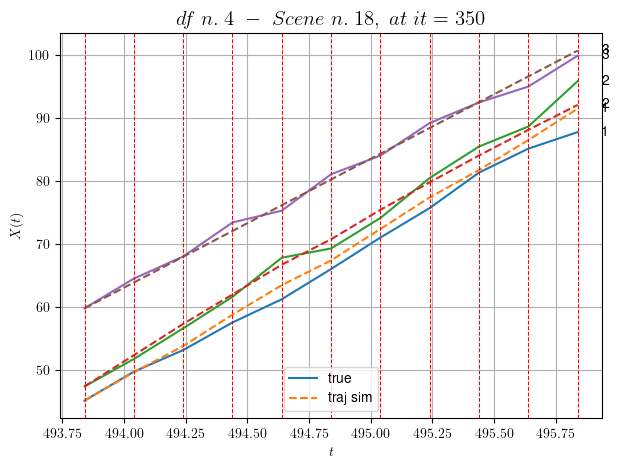

        For scene 18/30
        * use LR_NN=0.001 with err=58.57605804369732 at it=19
        * v0_scn_mean = 21.256626201291553
        * MAE = 1.761465894804249



            - Time interval n.0: [520.04, 520.24]
                * y_true: [17.72000935 17.53021327]
                * v_ann: [20.756589889526367, 21.89824867248535, 25.96283649925432]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [520.24, 520.44]
                * y_true: [21.19003079 20.68032877]
                * v_ann: [20.304983139038086, 21.09306526184082, 25.96283649925432]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [520.44, 520.64]
                * y_true: [20.95006602 20.21041565]
                * v_ann: [20.313161849975586, 21.114473342895508, 25.96283649925432]

----------------------------------------------------------------------

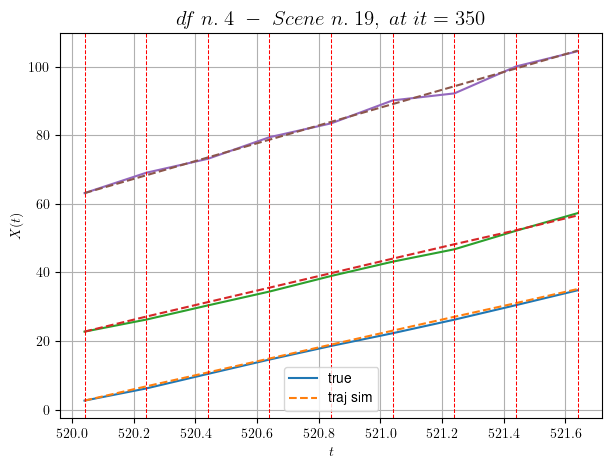

        For scene 19/30
        * use LR_NN=0.0001 with err=26.966129389350808 at it=19
        * v0_scn_mean = 26.308849815199302
        * MAE = 0.6210771440922866



            - Time interval n.0: [550.44, 550.64]
                * y_true: [23.95217582 22.66294351]
                * v_ann: [24.140602111816406, 23.3663272857666, 20.14846882256258]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [550.64, 550.84]
                * y_true: [22.2022957  28.49416646]
                * v_ann: [23.697568893432617, 23.1148624420166, 20.14846882256258]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [550.84, 551.04]
                * y_true: [19.80228834 20.61332089]
                * v_ann: [25.379179000854492, 23.75710678100586, 20.14846882256258]

----------------------------------------------------------------------

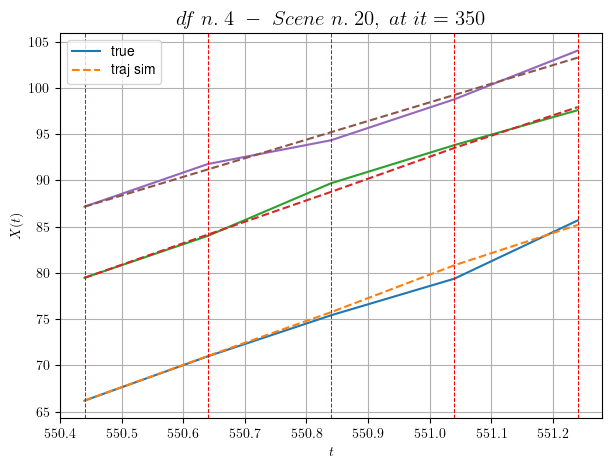

        For scene 20/30
        * use LR_NN=0.001 with err=15.134337088244465 at it=19
        * v0_scn_mean = 20.99281435605704
        * MAE = 0.3644612382555045



            - Time interval n.0: [554.64, 554.84]
                * y_true: [16.3871362  34.43556815]
                * v_ann: [25.32223129272461, 24.843978881835938, 20.440796892460163]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.84, 555.04]
                * y_true: [19.58824641 23.53414882]
                * v_ann: [21.600339889526367, 22.277767181396484, 20.440796892460163]

----------------------------------------------------------------------------------------------------
            * err= 1.8226244268549792
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.002136495377448311


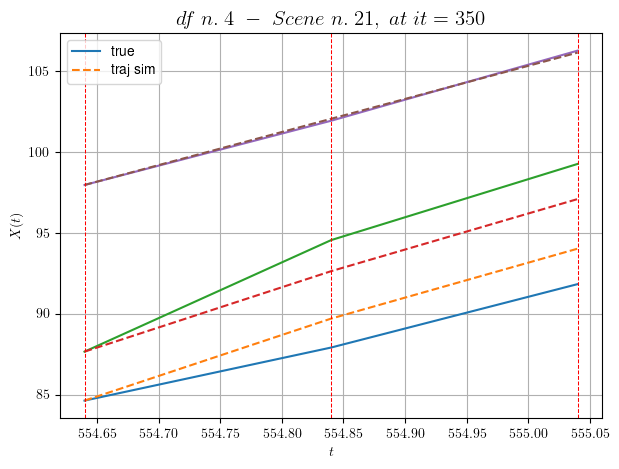

        For scene 21/30
        * use LR_NN=0.001 with err=2.421358225180852 at it=19
        * v0_scn_mean = 21.260087853656835
        * MAE = 1.8226244268549792



            - Time interval n.0: [556.24, 556.44]
                * y_true: [24.75252122 21.70224237]
                * v_ann: [23.250869750976562, 24.779582977294922, 15.086200202024516]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [556.44, 556.64]
                * y_true: [25.4427559  22.85265518]
                * v_ann: [24.14167594909668, 22.43836784362793, 15.086200202024516]

----------------------------------------------------------------------------------------------------
            * err= 0.18992778025127222
            * Learning rate NN = 0.0007289999630302191
            * diff = 1.6436918635648334e-05


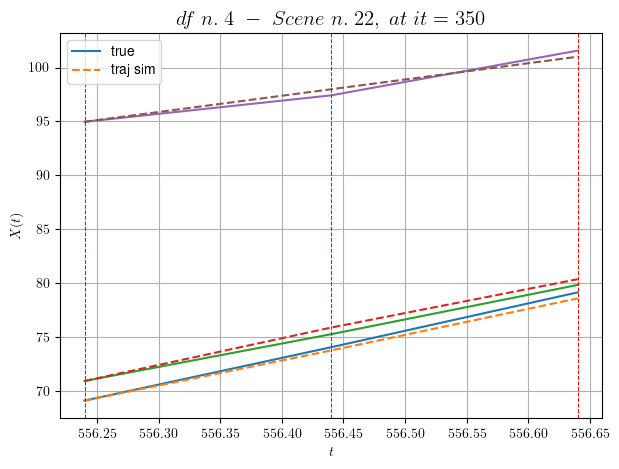

        For scene 22/30
        * use LR_NN=0.001 with err=12.695255193244533 at it=19
        * v0_scn_mean = 16.36441777247617
        * MAE = 0.18646435083691815



            - Time interval n.0: [575.04, 575.24]
                * y_true: [25.50060057 18.90068968]
                * v_ann: [-2.1514815671253018e-05, 0.0, 24.545660919825842]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [575.24, 575.44]
                * y_true: [27.95087423 28.65128625]
                * v_ann: [-0.00017826091789174825, 0.0, 24.545660919825842]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [575.44, 575.64]
                * y_true: [21.25083564 15.85084753]
                * v_ann: [-0.00014810121501795948, 0.0, 24.545660919825842]

---------------------------------------------------------------------------------------------

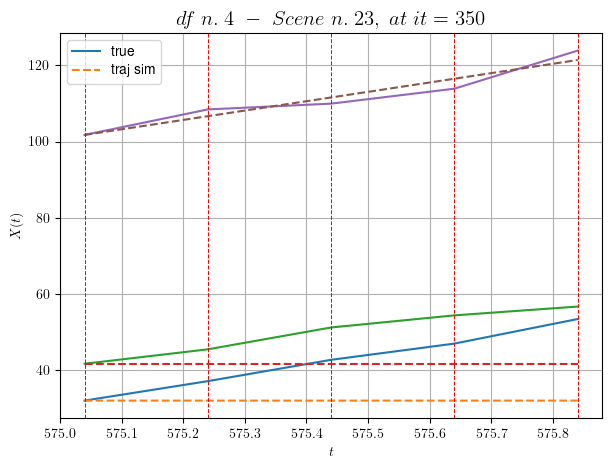

        For scene 23/30
        * use LR_NN=0.0005 with err=42.850516686955366 at it=19
        * v0_scn_mean = 25.013136153629894
        * MAE = 26.907419164158625



            - Time interval n.0: [313.84, 314.04]
                * y_true: [15.70108851 23.28855659 11.30165534]
                * v_ann: [22.64192008972168, 28.959518432617188, 30.531089782714844, 26.41603907656751]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [314.04, 314.24]
                * y_true: [25.15198981 24.43240479 30.10483754]
                * v_ann: [20.029895782470703, 19.935029983520508, 19.792964935302734, 26.41603907656751]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [314.24, 314.44]
                * y_true: [27.30252596 23.75264682 40.35752125]
                * v_ann: [21.848129272460938, 24.22958755493164, 25.50139236

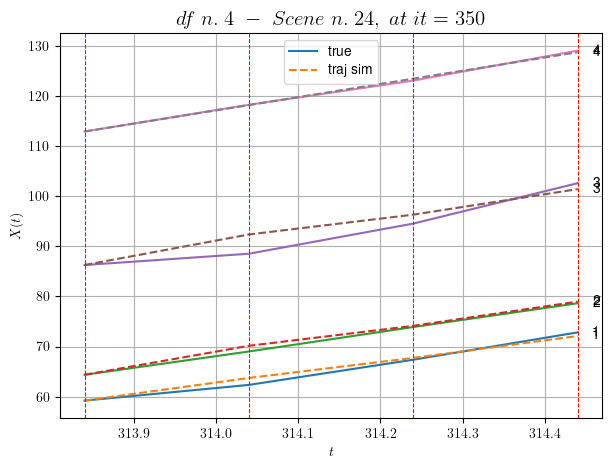

        For scene 24/30
        * use LR_NN=0.0005 with err=9.756906705951701 at it=19
        * v0_scn_mean = 26.82511486045004
        * MAE = 1.4441361039355427



            - Time interval n.0: [460.84, 461.04]
                * y_true: [19.8211655  14.23151831 20.23251805]
                * v_ann: [18.7023983001709, 18.070554733276367, 19.13417625427246, 26.404825675262657]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [461.04, 461.24]
                * y_true: [19.5413591  21.77263281 16.55223683]
                * v_ann: [18.466012954711914, 18.85015869140625, 18.924114227294922, 26.404825675262657]

----------------------------------------------------------------------------------------------------
            * err= 0.1123988118500499
            * Learning rate NN = 0.00036449998151510954
            * diff = 2.7721693929172453e-05


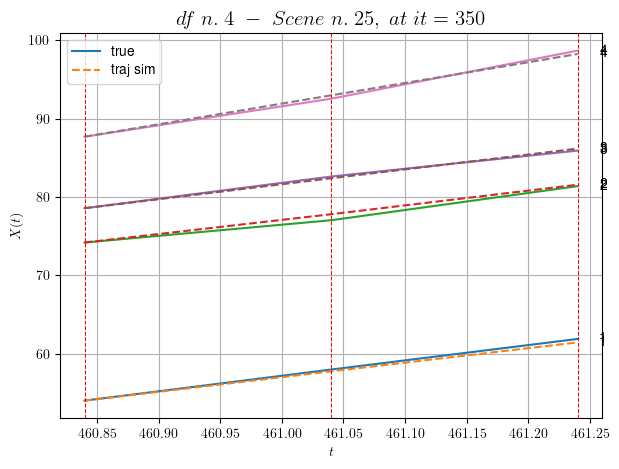

        For scene 25/30
        * use LR_NN=0.0005 with err=2.5994541813321757 at it=19
        * v0_scn_mean = 26.81518136454271
        * MAE = 0.10801100815545572



            - Time interval n.0: [462.64, 462.84]
                * y_true: [21.60177307 15.7113741  22.90372044]
                * v_ann: [19.950916290283203, 18.5548152923584, 20.009201049804688, 31.352254948017134]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [462.84, 463.04]
                * y_true: [18.06167929 17.53172974 18.9633766 ]
                * v_ann: [18.228736877441406, 19.570064544677734, 18.41077423095703, 31.352254948017134]

----------------------------------------------------------------------------------------------------
            * err= 0.2504955069260826
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.00011062523212107545


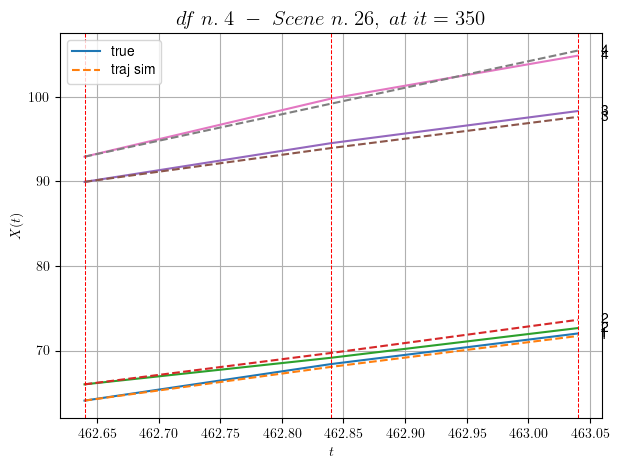

        For scene 26/30
        * use LR_NN=0.001 with err=7.508316343909967 at it=19
        * v0_scn_mean = 31.19790763098814
        * MAE = 0.22853710607366345



            - Time interval n.0: [495.24, 495.44]
                * y_true: [12.91123632 28.10335872 24.95329593]
                * v_ann: [21.869081497192383, 22.080095291137695, 23.111684799194336, 16.439733421153687]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [495.44, 495.64]
                * y_true: [ 9.32105302 18.99250639 15.85230368]
                * v_ann: [22.80459213256836, 22.974502563476562, 22.22264862060547, 16.439733421153687]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [495.64, 495.84]
                * y_true: [38.46439916 13.12188353 36.00587838]
                * v_ann: [20.139745712280273, 22.439847946166992, 19.15238189

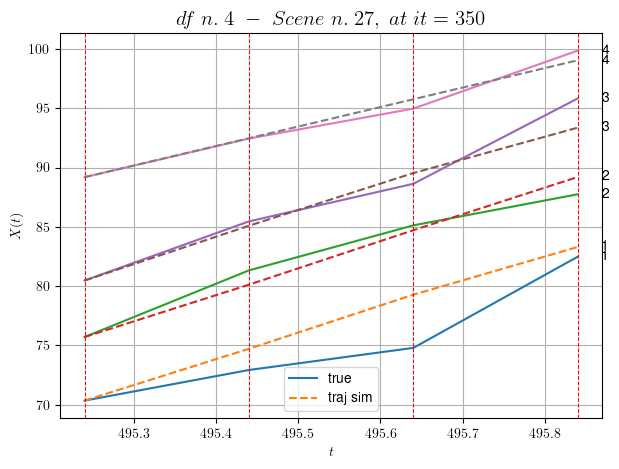

        For scene 27/30
        * use LR_NN=0.001 with err=10.35603640027085 at it=19
        * v0_scn_mean = 17.987511647231347
        * MAE = 2.2452146115868894



            - Time interval n.0: [541.84, 542.04]
                * y_true: [15.49040827 18.57067001 15.06113134]
                * v_ann: [18.69593620300293, 18.869976043701172, 18.8649845123291, 25.31225808344114]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [542.04, 542.24]
                * y_true: [18.02057424 22.22093452 14.29121645]
                * v_ann: [17.945093154907227, 17.281620025634766, 17.177200317382812, 25.31225808344114]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [542.24, 542.44]
                * y_true: [23.32090187 15.10072652 30.16295254]
                * v_ann: [18.130884170532227, 17.845962524414062, 17.70709609985

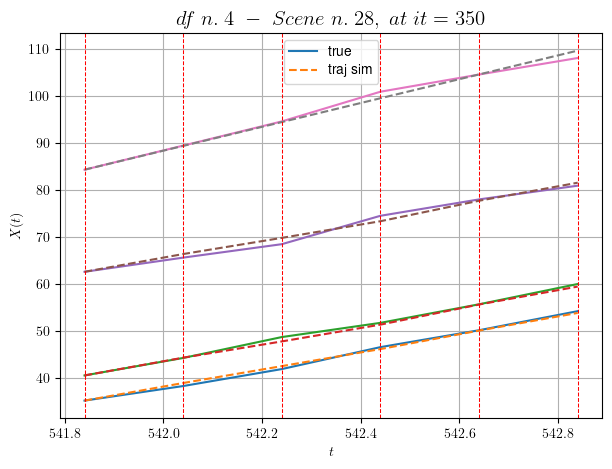

        For scene 28/30
        * use LR_NN=0.001 with err=14.473102507061494 at it=19
        * v0_scn_mean = 25.847320194921725
        * MAE = 0.4593640296225563



            - Time interval n.0: [559.04, 559.24]
                * y_true: [23.32160164 21.40183754 23.15354324]
                * v_ann: [18.64219856262207, 18.681156158447266, 18.64259147644043, 21.821996764913973]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [559.24, 559.44]
                * y_true: [16.34126249 10.38103794 18.30306556]
                * v_ann: [18.862768173217773, 19.08828353881836, 18.865188598632812, 21.821996764913973]

----------------------------------------------------------------------------------------------------
            * err= 0.35423182332236847
            * Learning rate NN = 7.289998757187277e-05
            * diff = 6.294662832162512e-05


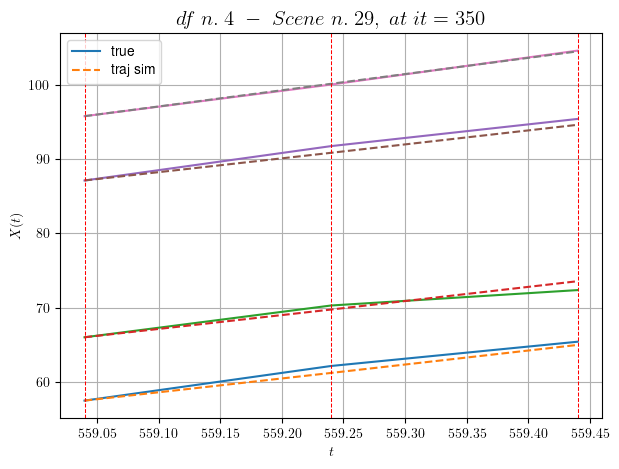

        For scene 29/30
        * use LR_NN=0.0001 with err=5.300345155872652 at it=19
        * v0_scn_mean = 22.755439722429433
        * MAE = 0.35423182332236847



For df=4 with 30 scenes, time taken:        396.17
------------------------------------------------------------
****************************************************************************************************
In df n.5/10 we have 14 scenes
****************************************************************************************************
            - Time interval n.0: [23.72, 23.92]
                * y_true: [21.79018354 24.07032953]
                * v_ann: [23.421003341674805, 20.217792510986328, 24.53484322511012]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [23.92, 24.12]
                * y_true: [25.91031727 27.52052784]
                * v_ann: [22.716745376586914, 21.60184669494629, 24.53484322511012]

--------------

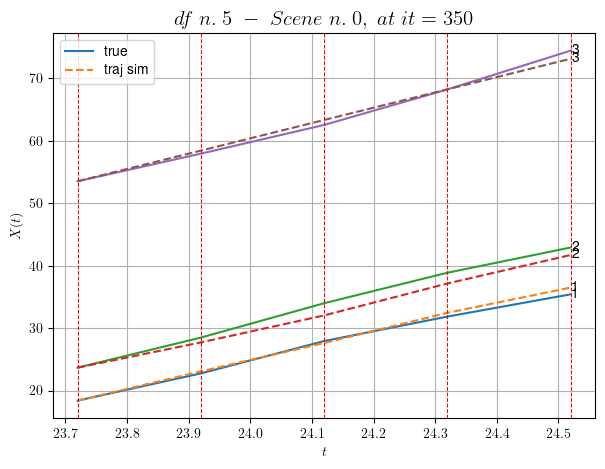

        For scene 0/14
        * use LR_NN=0.001 with err=17.792911360729892 at it=19
        * v0_scn_mean = 25.00324561146116
        * MAE = 0.3685184227583574



            - Time interval n.0: [28.12, 28.32]
                * y_true: [22.39001619 28.9506918 ]
                * v_ann: [26.880178451538086, 25.126413345336914, 25.379417180280793]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [28.32, 28.52]
                * y_true: [21.14004613 26.65085251]
                * v_ann: [27.327573776245117, 24.85765266418457, 25.379417180280793]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [28.52, 28.72]
                * y_true: [24.23010561 33.45140848]
                * v_ann: [27.509401321411133, 24.365610122680664, 25.379417180280793]

------------------------------------------------------------------------

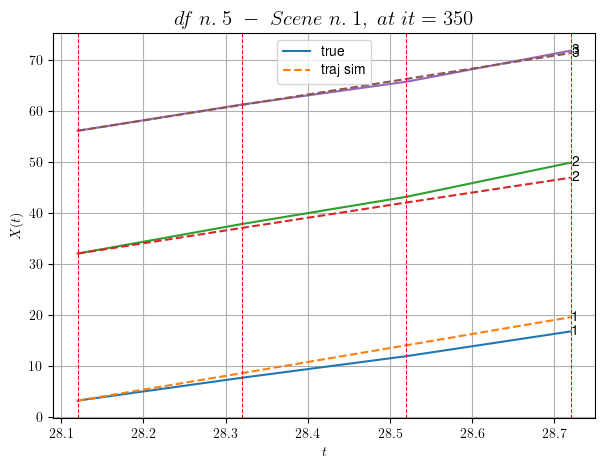

        For scene 1/14
        * use LR_NN=5e-05 with err=4.730739080412236 at it=19
        * v0_scn_mean = 25.775433636575954
        * MAE = 2.0149383728445085



            - Time interval n.0: [146.52, 146.72]
                * y_true: [32.70054419 14.69037585]
                * v_ann: [23.083049774169922, 23.21006965637207, 33.2471618145075]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [146.72, 146.92]
                * y_true: [35.65090038 15.01046474]
                * v_ann: [26.169647216796875, 24.630361557006836, 33.2471618145075]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [146.92, 147.12]
                * y_true: [28.09191726 21.83491468]
                * v_ann: [24.84209632873535, 25.945709228515625, 33.2471618145075]

-------------------------------------------------------------------------

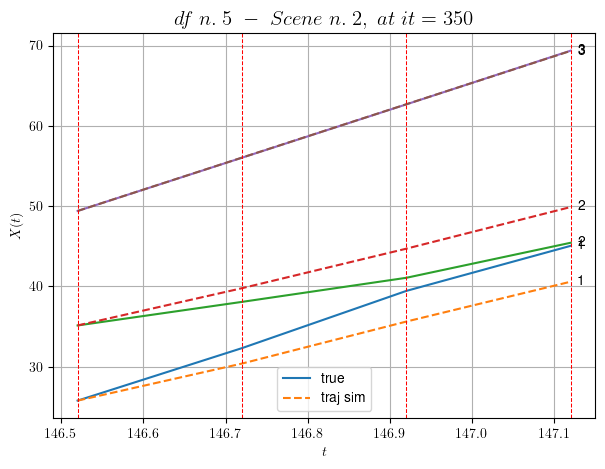

        For scene 2/14
        * use LR_NN=0.0005 with err=27.74198322142386 at it=19
        * v0_scn_mean = 32.96885720122107
        * MAE = 5.395849023906141



            - Time interval n.0: [151.12, 151.32]
                * y_true: [20.88055844 29.97204611]
                * v_ann: [27.153322219848633, 27.205642700195312, 31.516127782593827]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [151.32, 151.52]
                * y_true: [26.72089495 29.6522691 ]
                * v_ann: [26.725534439086914, 26.13864517211914, 31.516127782593827]

----------------------------------------------------------------------------------------------------
            * err= 0.6018141510693131
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0006362218828247501


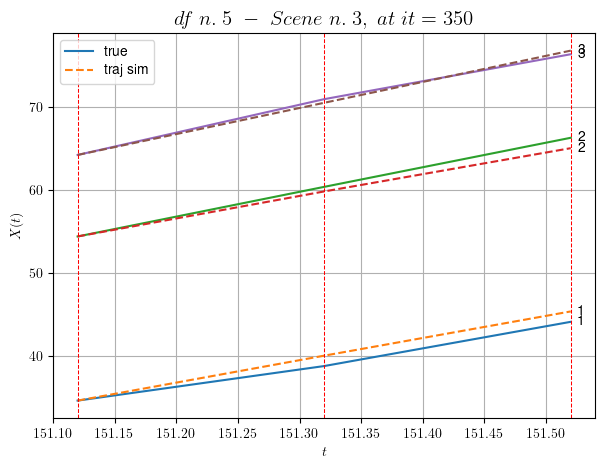

        For scene 3/14
        * use LR_NN=0.0005 with err=5.893891761731727 at it=19
        * v0_scn_mean = 31.386184964733086
        * MAE = 0.5930872977283039



            - Time interval n.0: [177.32, 177.52]
                * y_true: [23.78017477 21.57540501]
                * v_ann: [24.56476593017578, 25.839181900024414, 26.18040598473106]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [177.52, 177.72]
                * y_true: [28.99044664 21.37044807]
                * v_ann: [23.701921463012695, 24.92745590209961, 26.18040598473106]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [177.72, 177.92]
                * y_true: [30.9005134  20.55062028]
                * v_ann: [25.467979431152344, 25.69280242919922, 26.18040598473106]

----------------------------------------------------------------------

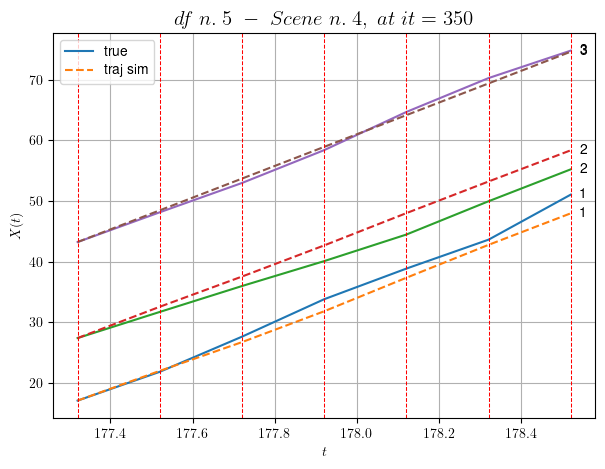

        For scene 4/14
        * use LR_NN=0.001 with err=36.04604464701102 at it=19
        * v0_scn_mean = 26.507772065035223
        * MAE = 2.9636374831058103



            - Time interval n.0: [266.92, 267.12]
                * y_true: [18.75024149 31.34179995]
                * v_ann: [33.34131622314453, 32.143821716308594, 29.08570823249343]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [267.12, 267.32]
                * y_true: [26.80047756 43.40316595]
                * v_ann: [26.83818244934082, 26.342926025390625, 29.08570823249343]

----------------------------------------------------------------------------------------------------
            * err= 3.1290779884486493
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0013034622754184433


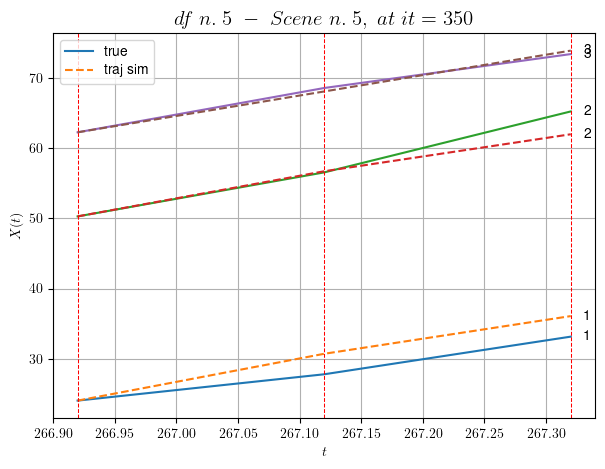

        For scene 5/14
        * use LR_NN=0.0005 with err=14.272258043094837 at it=19
        * v0_scn_mean = 29.164069469574038
        * MAE = 3.1290779884486493



        For scene 6/14
        * use LR_NN=0.0005 with err=1.3450165398851002 at it=19
        * v0_scn_mean = 23.162478757942726
        * MAE = 0.3496306179671786



        For scene 7/14
        * use LR_NN=0.001 with err=7.265857725482852 at it=19
        * v0_scn_mean = 27.47495997241978
        * MAE = 0.03178411577657067



            - Time interval n.0: [330.12, 330.32]
                * y_true: [27.05007287 28.28069592]
                * v_ann: [25.7887020111084, 28.611398696899414, 35.47864367944545]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [330.32, 330.52]
                * y_true: [28.75016695 26.32589786]
                * v_ann: [25.914745330810547, 29.08029556274414, 35.47864367944545]

------------------------

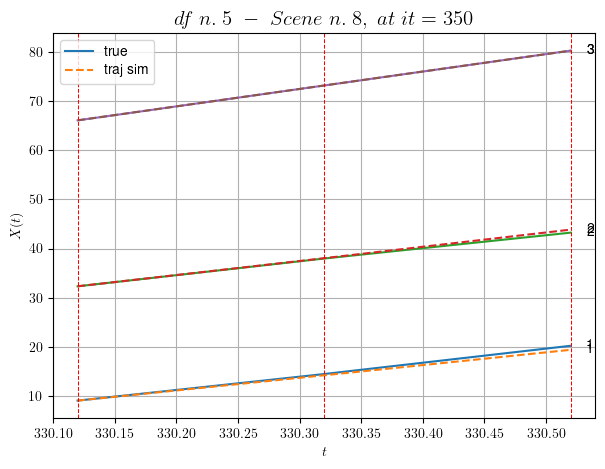

        For scene 8/14
        * use LR_NN=0.0001 with err=1.811658651977406 at it=19
        * v0_scn_mean = 35.0090853704853
        * MAE = 0.12445321930702706



            - Time interval n.0: [338.52, 338.72]
                * y_true: [22.83038671 20.44060351]
                * v_ann: [23.8142032623291, 23.794095993041992, 27.853943933248644]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [338.72, 338.92]
                * y_true: [25.85061095 23.65082523]
                * v_ann: [23.445615768432617, 23.368446350097656, 27.853943933248644]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.92, 339.12]
                * y_true: [28.6708889  22.23087004]
                * v_ann: [23.706478118896484, 23.67938232421875, 27.853943933248644]

--------------------------------------------------------------------

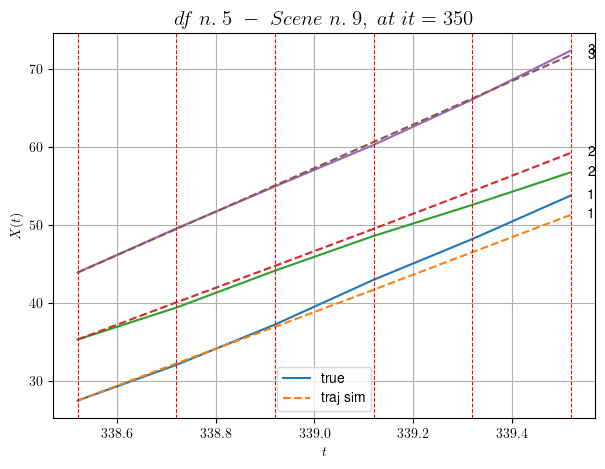

        For scene 9/14
        * use LR_NN=0.0005 with err=12.00492648538693 at it=19
        * v0_scn_mean = 28.037876036995254
        * MAE = 0.5855896518797474



            - Time interval n.0: [435.72, 435.92]
                * y_true: [16.6003121  32.10080247]
                * v_ann: [24.2511043548584, 19.755090713500977, 23.002320042478406]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [435.92, 436.12]
                * y_true: [17.55040576 22.4007406 ]
                * v_ann: [21.81426429748535, 20.000699996948242, 23.002320042478406]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [436.12, 436.32]
                * y_true: [16.72550921 26.8011085 ]
                * v_ann: [20.403579711914062, 19.885162353515625, 23.002320042478406]

-------------------------------------------------------------------

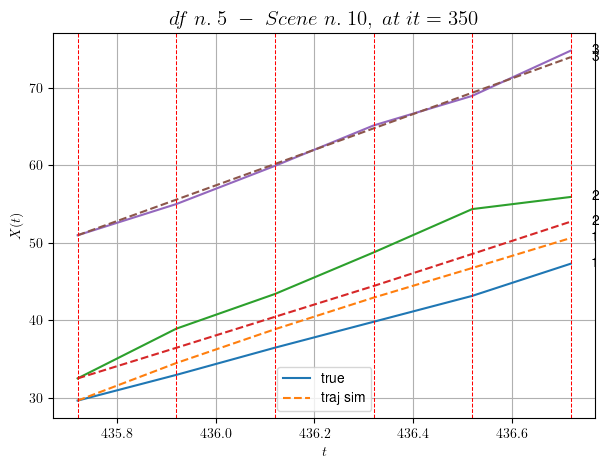

        For scene 10/14
        * use LR_NN=0.001 with err=12.921807129471373 at it=19
        * v0_scn_mean = 23.602070447824968
        * MAE = 6.687520195432334



            - Time interval n.0: [565.12, 565.32]
                * y_true: [12.82514463 16.9507403 ]
                * v_ann: [16.46250343322754, 14.845168113708496, 20.75038047095175]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [565.32, 565.52]
                * y_true: [14.2510345  19.19106683]
                * v_ann: [16.698823928833008, 15.042547225952148, 20.75038047095175]

----------------------------------------------------------------------------------------------------
            * err= 0.41779078604014447
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 8.368805308567318e-05


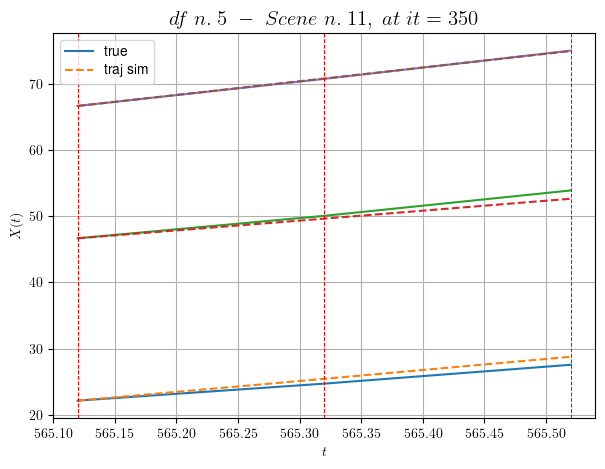

        For scene 11/14
        * use LR_NN=5e-05 with err=2.5116707741660513 at it=19
        * v0_scn_mean = 21.5431379413596
        * MAE = 0.41779078604014447



            - Time interval n.0: [578.92, 579.12]
                * y_true: [17.01001565 16.52033104]
                * v_ann: [16.75284767150879, 16.45921516418457, 20.916676982793472]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [579.12, 579.32]
                * y_true: [16.33004654 15.70042243]
                * v_ann: [16.728771209716797, 16.682992935180664, 20.916676982793472]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [579.32, 579.52]
                * y_true: [18.25006509 16.3654818 ]
                * v_ann: [16.6406192779541, 16.91181182861328, 20.916676982793472]

---------------------------------------------------------------------

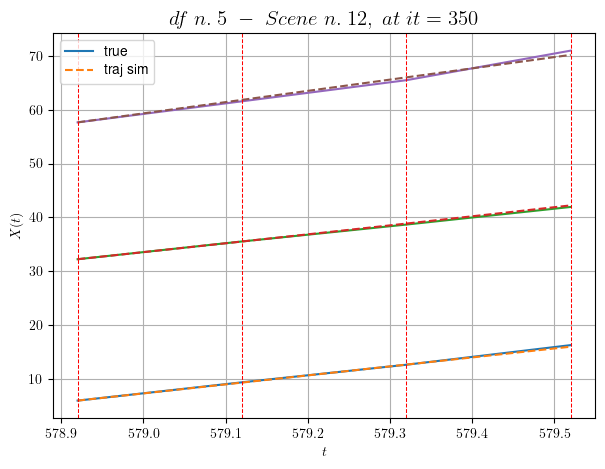

        For scene 12/14
        * use LR_NN=5e-05 with err=3.6285812661353627 at it=19
        * v0_scn_mean = 21.695181672139338
        * MAE = 0.0917513332052306



            - Time interval n.0: [178.12, 178.32]
                * y_true: [23.59034379 23.87574209 27.4762805 ]
                * v_ann: [26.75554847717285, 26.7180233001709, 27.429752349853516, 26.19290338460745]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [178.32, 178.52]
                * y_true: [17.35034213 37.1766426  26.34131635]
                * v_ann: [24.54572105407715, 25.24749183654785, 24.840229034423828, 26.19290338460745]

----------------------------------------------------------------------------------------------------
            * err= 0.7222501865468377
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.00029861119553042936


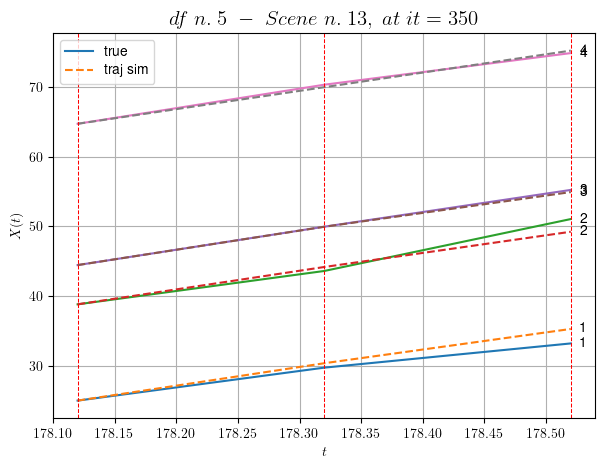

        For scene 13/14
        * use LR_NN=0.001 with err=6.8230441001023285 at it=19
        * v0_scn_mean = 26.627448031028337
        * MAE = 0.48295744998399603



For df=5 with 14 scenes, time taken:        134.77
------------------------------------------------------------
****************************************************************************************************
In df n.6/10 we have 3 scenes
****************************************************************************************************
            - Time interval n.0: [552.20, 552.40]
                * y_true: [14.01030513 13.18063102]
                * v_ann: [18.208044052124023, 18.0156192779541, 20.233275612773262]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [552.40, 552.60]
                * y_true: [18.39048446 22.9012939 ]
                * v_ann: [17.88297462463379, 17.558073043823242, 20.233275612773262]

-----------

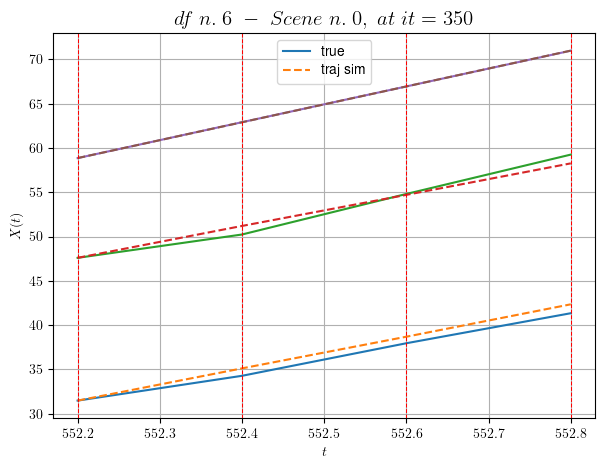

        For scene 0/3
        * use LR_NN=0.0001 with err=5.925348036150773 at it=19
        * v0_scn_mean = 21.07035260767802
        * MAE = 0.2860565618900582



            - Time interval n.0: [553.00, 553.20]
                * y_true: [23.0804555  19.17546127 18.9008181 ]
                * v_ann: [19.285247802734375, 19.13996124267578, 19.066560745239258, 23.749701248855523]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [553.20, 553.40]
                * y_true: [22.02058024 17.45053567 16.85079909]
                * v_ann: [19.878257751464844, 19.94245147705078, 20.104042053222656, 23.749701248855523]

----------------------------------------------------------------------------------------------------
            * err= 0.26395560354935166
            * Learning rate NN = 0.0007289999630302191
            * diff = 5.01856105871723e-05


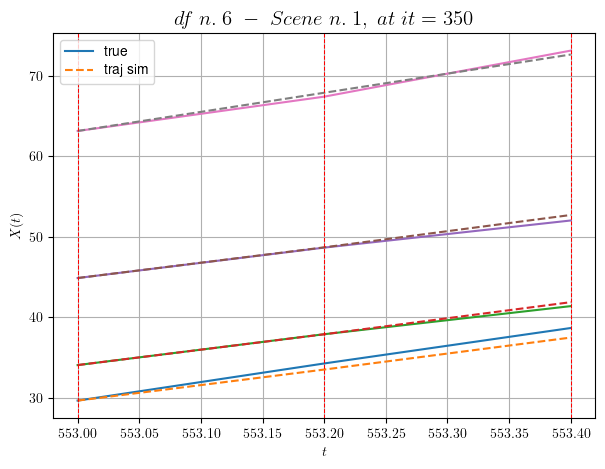

        For scene 1/3
        * use LR_NN=0.001 with err=5.803754982339184 at it=19
        * v0_scn_mean = 24.4631146804615
        * MAE = 0.2552618316515371



            - Time interval n.0: [554.00, 554.20]
                * y_true: [20.50061186 21.35116733 22.20133365]
                * v_ann: [21.68514060974121, 21.406940460205078, 22.16995620727539, 23.647953726265474]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [554.20, 554.40]
                * y_true: [18.86075328 25.85180384 21.5614577 ]
                * v_ann: [21.37557601928711, 21.760608673095703, 21.929519653320312, 23.647953726265474]

----------------------------------------------------------------------------------------------------
            * err= 0.12181716433390893
            * Learning rate NN = 0.0007289999630302191
            * diff = 2.9877136790645853e-05


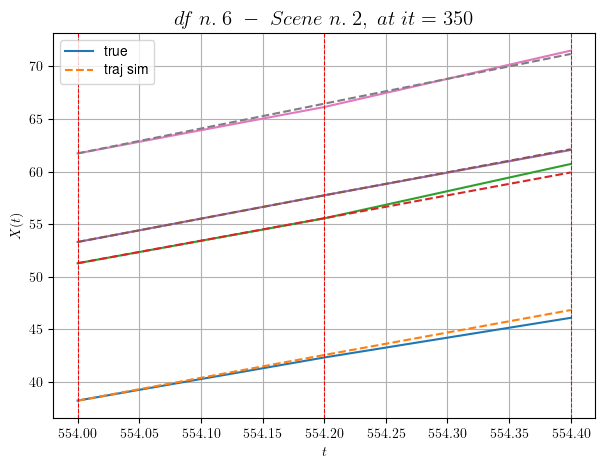

        For scene 2/3
        * use LR_NN=0.001 with err=6.31038665712787 at it=19
        * v0_scn_mean = 24.372980690622487
        * MAE = 0.11973067957541955



For df=6 with 3 scenes, time taken:        22.85
------------------------------------------------------------
****************************************************************************************************
In df n.7/10 we have 8 scenes
****************************************************************************************************
            - Time interval n.0: [38.56, 38.76]
                * y_true: [34.50899027 34.29923068]
                * v_ann: [31.24941635131836, 32.23870849609375, 28.99001788809881]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.76, 38.96]
                * y_true: [33.76780394 27.40980382]
                * v_ann: [32.77904510498047, 33.640106201171875, 28.99001788809881]

-----------------------

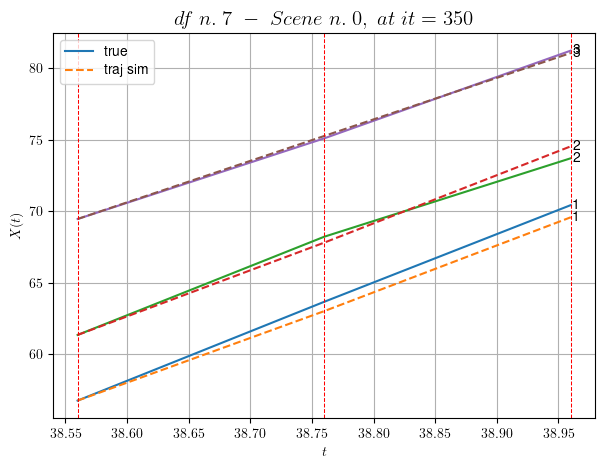

        For scene 0/8
        * use LR_NN=0.001 with err=3.24305095416837 at it=19
        * v0_scn_mean = 29.076580460934775
        * MAE = 0.22966919219950624



            - Time interval n.0: [39.76, 39.96]
                * y_true: [22.5368218  26.50901133]
                * v_ann: [27.538211822509766, 27.065021514892578, 28.62976262255397]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [39.96, 40.16]
                * y_true: [27.13488394 22.34107329]
                * v_ann: [24.010337829589844, 25.324129104614258, 28.62976262255397]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [40.16, 40.36]
                * y_true: [29.97962766 28.56631616]
                * v_ann: [26.817909240722656, 26.303613662719727, 28.62976262255397]

---------------------------------------------------------------------------

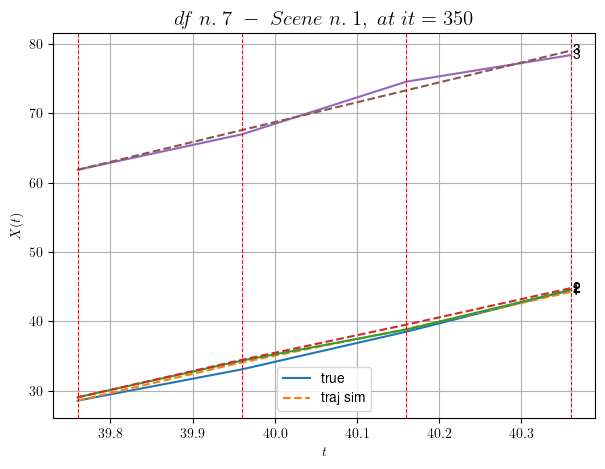

        For scene 1/8
        * use LR_NN=0.0005 with err=18.10299812589289 at it=19
        * v0_scn_mean = 28.747201606264685
        * MAE = 0.34644118580206346



            - Time interval n.0: [45.96, 46.16]
                * y_true: [25.63954073 32.24792255]
                * v_ann: [28.60422134399414, 28.4270076751709, 21.67942641957732]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [46.16, 46.36]
                * y_true: [27.5623729  28.76269973]
                * v_ann: [28.763835906982422, 28.383955001831055, 21.67942641957732]

----------------------------------------------------------------------------------------------------
            * err= 0.2613602733417504
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 9.845899653854184e-05


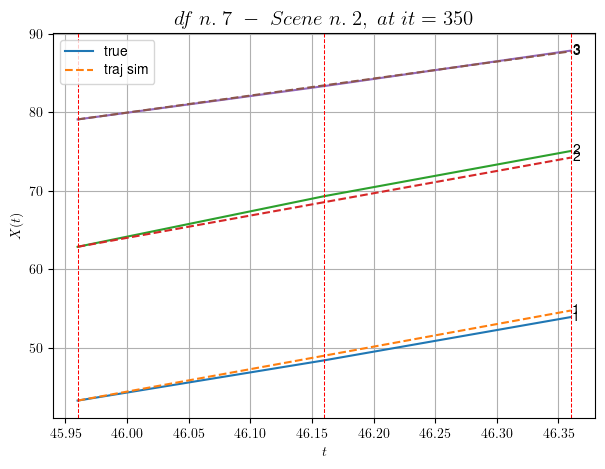

        For scene 2/8
        * use LR_NN=5e-05 with err=3.061051667925526 at it=19
        * v0_scn_mean = 22.392558115777916
        * MAE = 0.2613602733417504



            - Time interval n.0: [162.76, 162.96]
                * y_true: [10.08699654 20.77195672]
                * v_ann: [17.161819458007812, 16.828229904174805, 33.51452922086696]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [162.96, 163.16]
                * y_true: [12.77745535 25.37230132]
                * v_ann: [17.68958854675293, 17.55310821533203, 33.51452922086696]

----------------------------------------------------------------------------------------------------
            * err= 1.5997889791262905
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0003640188458149396


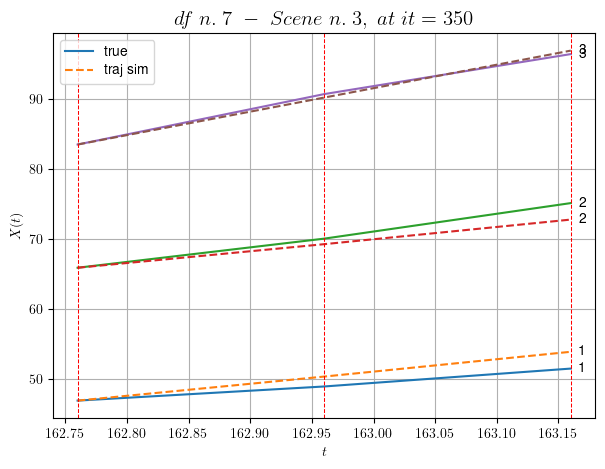

        For scene 3/8
        * use LR_NN=5e-05 with err=1.9442547838297772 at it=19
        * v0_scn_mean = 33.21330933976166
        * MAE = 1.5522382713887168



            - Time interval n.0: [165.76, 165.96]
                * y_true: [14.62535373 14.97522028]
                * v_ann: [14.13449764251709, 15.865386009216309, 27.26222960772804]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [165.96, 166.16]
                * y_true: [14.90483904 10.97892299]
                * v_ann: [14.152209281921387, 13.704748153686523, 27.26222960772804]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [166.16, 166.36]
                * y_true: [13.82116599 15.66867879]
                * v_ann: [13.911394119262695, 13.362330436706543, 27.26222960772804]

----------------------------------------------------------------------

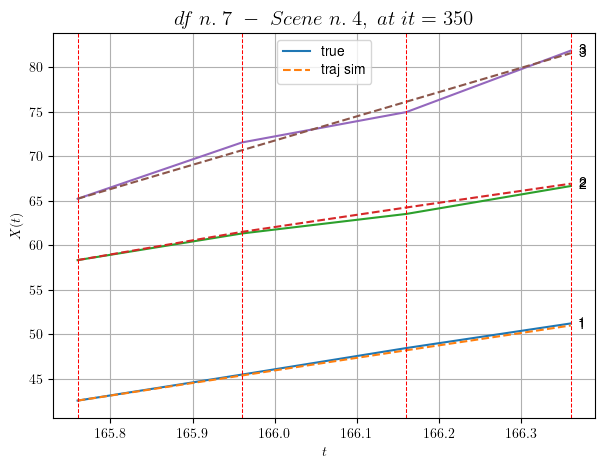

        For scene 4/8
        * use LR_NN=5e-05 with err=1.4210452357691643 at it=19
        * v0_scn_mean = 27.49687579224644
        * MAE = 0.24596843815636063



            - Time interval n.0: [188.16, 188.36]
                * y_true: [18.26365072 21.2472937 ]
                * v_ann: [19.849817276000977, 21.61836814880371, 24.898645104742123]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [188.36, 188.56]
                * y_true: [19.58083161 26.63811802]
                * v_ann: [19.823213577270508, 21.57021141052246, 24.898645104742123]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [188.56, 188.76]
                * y_true: [19.1135942  21.22632097]
                * v_ann: [20.295940399169922, 21.91924476623535, 24.898645104742123]

--------------------------------------------------------------------

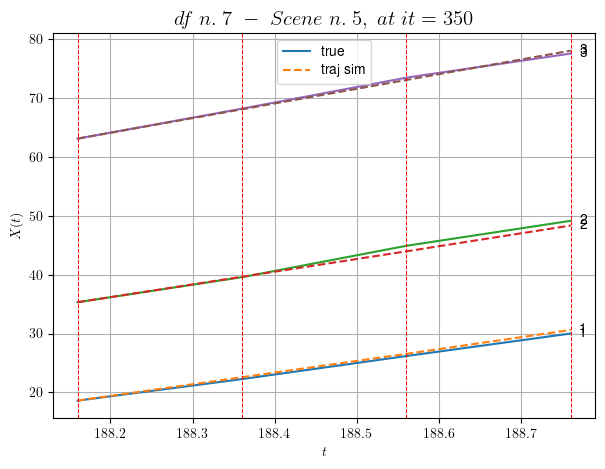

        For scene 5/8
        * use LR_NN=0.0001 with err=2.1535277138761075 at it=19
        * v0_scn_mean = 25.335867110438656
        * MAE = 0.09280523825805093



        For scene 6/8
        * use LR_NN=0.0005 with err=3.0373835787740933 at it=19
        * v0_scn_mean = 26.933635352173287
        * MAE = 0.18709051499965393



            - Time interval n.0: [166.56, 166.76]
                * y_true: [17.24164345 15.73752306 15.58083022]
                * v_ann: [18.100929260253906, 17.669572830200195, 17.36299705505371, 17.37043158542252]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [166.76, 166.96]
                * y_true: [18.38470966 27.72552812  9.3330177 ]
                * v_ann: [17.386707305908203, 17.379087448120117, 16.933536529541016, 17.37043158542252]

----------------------------------------------------------------------------------------------------
            - Time inte

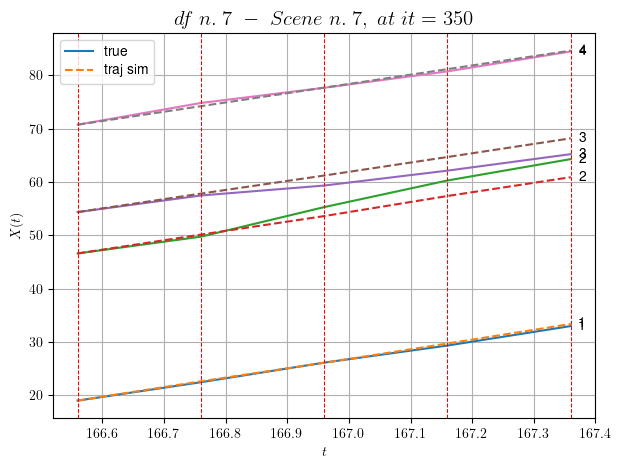

        For scene 7/8
        * use LR_NN=0.0005 with err=25.773126175917593 at it=19
        * v0_scn_mean = 18.81197927795333
        * MAE = 2.0258473587960286



For df=7 with 8 scenes, time taken:        67.32
------------------------------------------------------------
****************************************************************************************************
In df n.8/10 we have 21 scenes
****************************************************************************************************
            - Time interval n.0: [36.44, 36.64]
                * y_true: [16.4303266   8.20020738]
                * v_ann: [12.385797500610352, 12.126097679138184, 17.15688873745732]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [36.64, 36.84]
                * y_true: [18.55044671  6.80018642]
                * v_ann: [12.662435531616211, 12.212176322937012, 17.15688873745732]

------------------

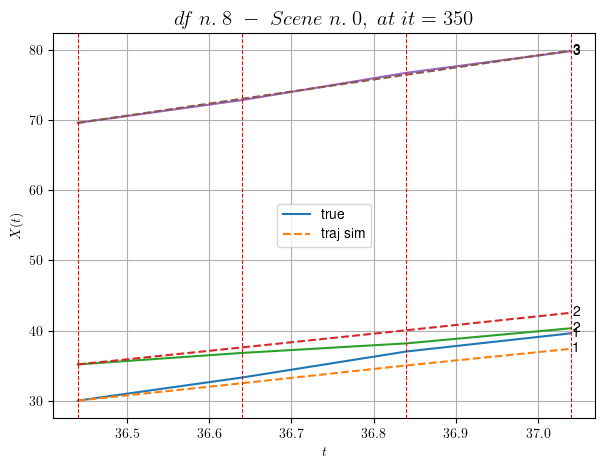

        For scene 0/21
        * use LR_NN=0.0005 with err=14.873301462587705 at it=19
        * v0_scn_mean = 18.257633731852916
        * MAE = 1.5320422661111157



            - Time interval n.0: [50.24, 50.44]
                * y_true: [14.83043604 14.50055453]
                * v_ann: [19.946292877197266, 20.113323211669922, 30.1576598348791]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [50.44, 50.64]
                * y_true: [15.35052738 17.38080918]
                * v_ann: [17.69685935974121, 16.60101890563965, 30.1576598348791]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [50.64, 50.84]
                * y_true: [19.54078826 19.30097894]
                * v_ann: [17.30260467529297, 17.339954376220703, 30.1576598348791]

------------------------------------------------------------------------------

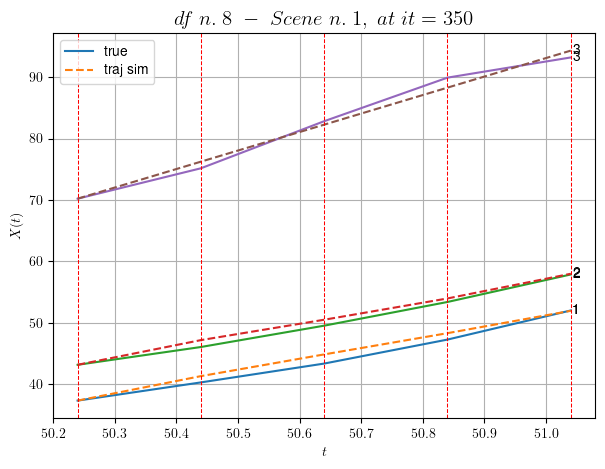

        For scene 1/21
        * use LR_NN=0.001 with err=9.566857443230928 at it=19
        * v0_scn_mean = 30.144147277795906
        * MAE = 0.7492089030928488



            - Time interval n.0: [102.24, 102.44]
                * y_true: [22.78095819 15.94092959]
                * v_ann: [18.264596939086914, 18.660449981689453, 31.348282240790297]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [102.44, 102.64]
                * y_true: [23.36120187 12.10080168]
                * v_ann: [19.15471649169922, 20.858905792236328, 31.348282240790297]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [102.64, 102.84]
                * y_true: [20.51121756 22.37162153]
                * v_ann: [21.714200973510742, 20.316410064697266, 31.348282240790297]

------------------------------------------------------------------

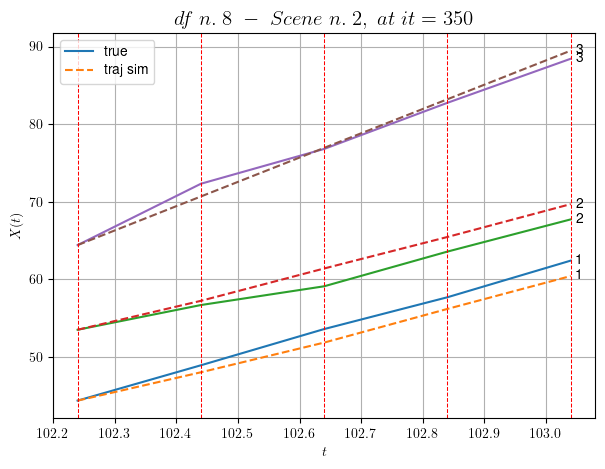

        For scene 2/21
        * use LR_NN=0.001 with err=11.002831099039271 at it=19
        * v0_scn_mean = 31.232724966758738
        * MAE = 1.2580224023120608



            - Time interval n.0: [108.84, 109.04]
                * y_true: [17.9810803  26.65193678]
                * v_ann: [22.05014991760254, 21.08896255493164, 20.54908340384348]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [109.04, 109.24]
                * y_true: [14.30252156 22.9019425 ]
                * v_ann: [20.22649574279785, 21.37606430053711, 20.54908340384348]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [109.24, 109.44]
                * y_true: [21.24158827 21.25204953]
                * v_ann: [19.47557830810547, 20.02023696899414, 20.54908340384348]

-------------------------------------------------------------------------

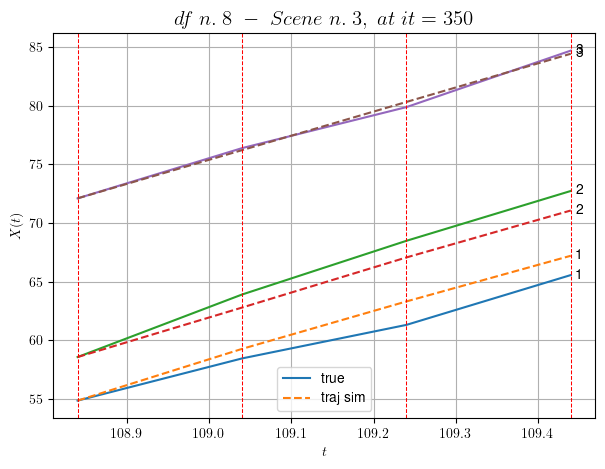

        For scene 3/21
        * use LR_NN=0.001 with err=5.399769519318025 at it=19
        * v0_scn_mean = 21.359093449151526
        * MAE = 1.0367564231586759



            - Time interval n.0: [130.04, 130.24]
                * y_true: [23.9806113  21.72216875]
                * v_ann: [25.634000778198242, 23.5542049407959, 41.055542418781656]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [130.24, 130.44]
                * y_true: [20.38064152 27.22317612]
                * v_ann: [21.239551544189453, 22.35450553894043, 41.055542418781656]

----------------------------------------------------------------------------------------------------
            * err= 0.103310281622623
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.00010642894015551463


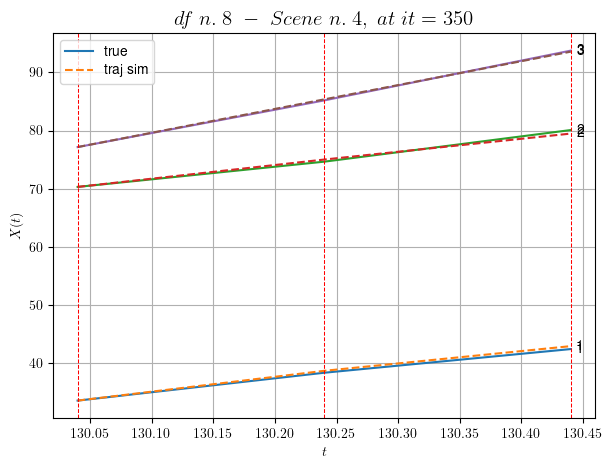

        For scene 4/21
        * use LR_NN=0.0005 with err=8.920632085005373 at it=19
        * v0_scn_mean = 40.10800465094396
        * MAE = 0.103310281622623



            - Time interval n.0: [215.24, 215.44]
                * y_true: [ 1.34614625 10.42531549]
                * v_ann: [19.083518981933594, 20.296554565429688, 15.100797270465883]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [215.44, 215.64]
                * y_true: [18.28906766 10.32533879]
                * v_ann: [13.894729614257812, 13.740290641784668, 15.100797270465883]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [215.64, 215.84]
                * y_true: [29.02100933 15.78058213]
                * v_ann: [15.7510986328125, 14.021422386169434, 15.100797270465883]

--------------------------------------------------------------------

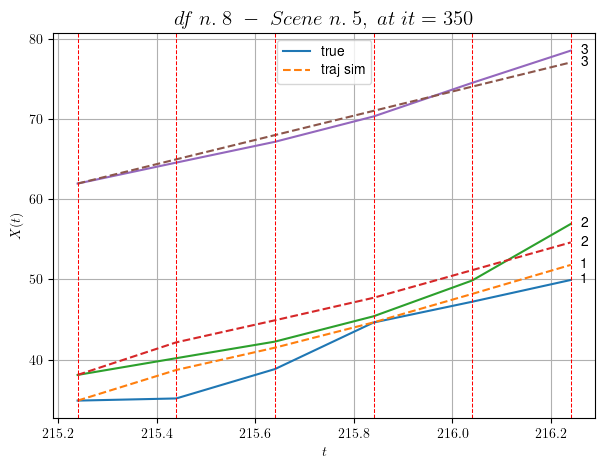

        For scene 5/21
        * use LR_NN=0.001 with err=38.83544170273042 at it=19
        * v0_scn_mean = 16.377763769452063
        * MAE = 2.842505439858863



            - Time interval n.0: [222.64, 222.84]
                * y_true: [3.4148313  7.54419185]
                * v_ann: [5.508218765258789, 5.619286060333252, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [222.84, 223.04]
                * y_true: [1.34614625 9.61287691]
                * v_ann: [5.34774112701416, 5.6500349044799805, 12.428665091344943]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [223.04, 223.24]
                * y_true: [ 1.34614625 10.20300693]
                * v_ann: [6.30132532119751, 5.685832500457764, 12.428665091344943]

-----------------------------------------------------------------------------

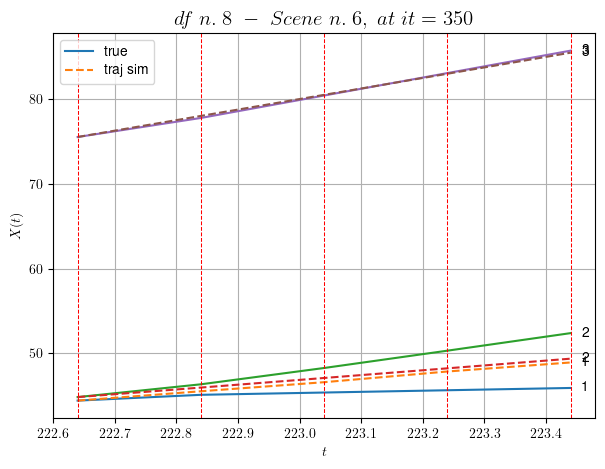

        For scene 6/21
        * use LR_NN=0.0005 with err=25.24938283639122 at it=19
        * v0_scn_mean = 13.93465211817708
        * MAE = 2.042456816534821



            - Time interval n.0: [225.24, 225.44]
                * y_true: [9.85023046 1.34614625]
                * v_ann: [7.1457743644714355, 8.985125541687012, 13.143805199617178]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [225.44, 225.64]
                * y_true: [11.30531094  1.34614625]
                * v_ann: [6.097863674163818, 8.197474479675293, 13.143805199617178]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [225.64, 225.84]
                * y_true: [12.27536459  1.34614625]
                * v_ann: [6.569976806640625, 8.076000213623047, 13.143805199617178]

-------------------------------------------------------------------------

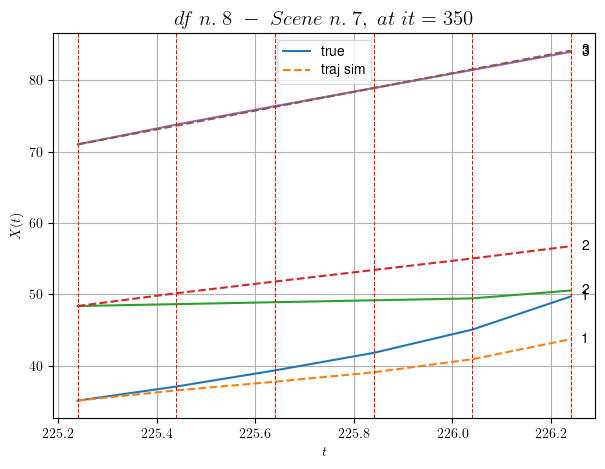

        For scene 7/21
        * use LR_NN=0.001 with err=52.440103411280234 at it=19
        * v0_scn_mean = 14.588499687719501
        * MAE = 8.323443577977374



            - Time interval n.0: [227.04, 227.24]
                * y_true: [ 1.34614625 11.86069537]
                * v_ann: [12.799598693847656, 6.12930154800415, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [227.24, 227.44]
                * y_true: [ 1.34614625 11.90074479]
                * v_ann: [9.160584449768066, 6.408632278442383, 26.24318261171468]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [227.44, 227.64]
                * y_true: [ 1.34614625 14.03099458]
                * v_ann: [6.208717346191406, 7.1316423416137695, 26.24318261171468]

-------------------------------------------------------------------------

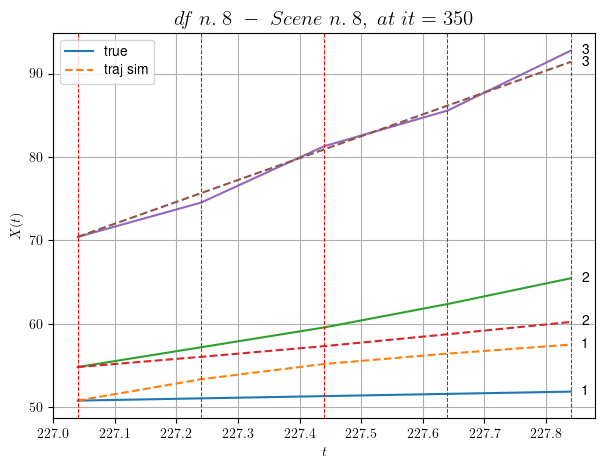

        For scene 8/21
        * use LR_NN=1e-05 with err=2.7170949633232304 at it=19
        * v0_scn_mean = 26.56516829341416
        * MAE = 8.381456574279564



            - Time interval n.0: [237.64, 237.84]
                * y_true: [17.80043487 10.22573725]
                * v_ann: [15.424793243408203, 15.093107223510742, 29.702969638682323]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.84, 238.04]
                * y_true: [20.29063338 11.60088234]
                * v_ann: [14.71318244934082, 14.603593826293945, 29.702969638682323]

----------------------------------------------------------------------------------------------------
            * err= 0.7109870284955288
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.0004363289140485449


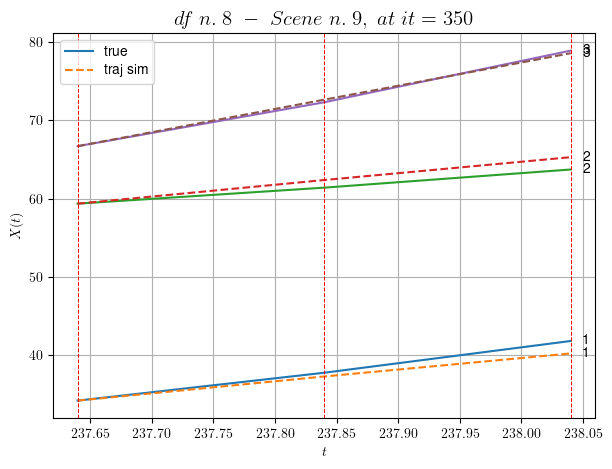

        For scene 9/21
        * use LR_NN=0.0005 with err=0.24549538595995798 at it=19
        * v0_scn_mean = 29.72842723043832
        * MAE = 0.21206137428417712



            - Time interval n.0: [239.84, 240.04]
                * y_true: [16.30079237 13.85576065]
                * v_ann: [15.664827346801758, 16.355812072753906, 30.13123859028378]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [240.04, 240.24]
                * y_true: [17.06097057 17.27611431]
                * v_ann: [16.534744262695312, 15.939733505249023, 30.13123859028378]

----------------------------------------------------------------------------------------------------
            * err= 0.05288759761113021
            * Learning rate NN = 0.0007289999630302191
            * diff = 2.8590500987933642e-05


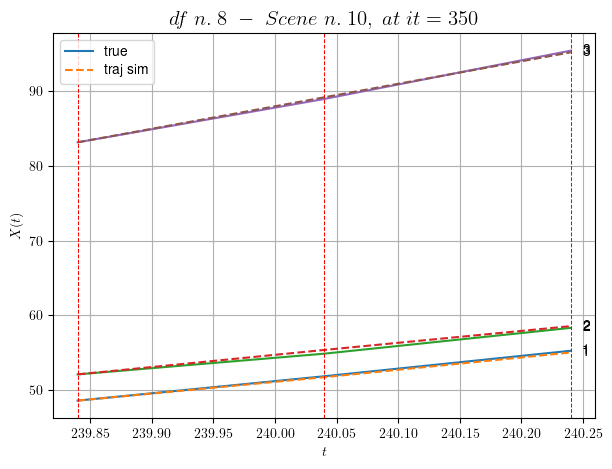

        For scene 10/21
        * use LR_NN=0.001 with err=3.0784340088097655 at it=19
        * v0_scn_mean = 30.119990519752687
        * MAE = 0.05288759761113021



        For scene 11/21
        * use LR_NN=0.001 with err=24.18404914805423 at it=19
        * v0_scn_mean = 18.02582251732012
        * MAE = 1.3905972970448872



        For scene 12/21
        * use LR_NN=0.0005 with err=28.659938847379994 at it=19
        * v0_scn_mean = 21.428938019741217
        * MAE = 0.44171678260087677



            - Time interval n.0: [290.84, 291.04]
                * y_true: [10.67508652 21.71084933]
                * v_ann: [14.537008285522461, 16.326326370239258, 25.378277675805634]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [291.04, 291.24]
                * y_true: [ 9.47510968 18.71084105]
                * v_ann: [14.924216270446777, 16.451841354370117, 25.378277675805634]

----------------

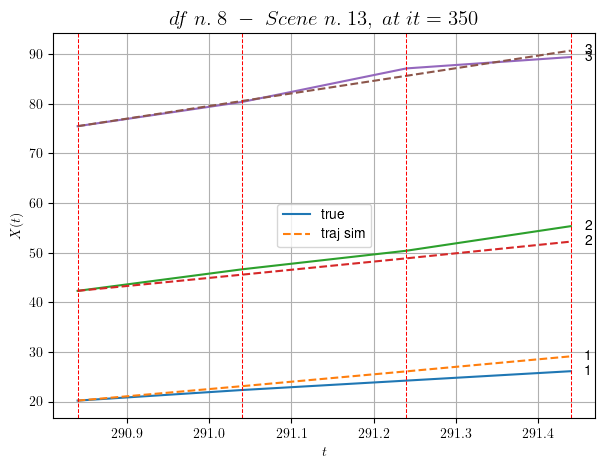

        For scene 13/21
        * use LR_NN=5e-05 with err=2.303465034183876 at it=19
        * v0_scn_mean = 25.774391795651436
        * MAE = 2.402017718714149



            - Time interval n.0: [350.64, 350.84]
                * y_true: [14.24956692  9.34769854]
                * v_ann: [15.484840393066406, 15.607870101928711, 24.017599259793506]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [350.84, 351.04]
                * y_true: [ 4.06677119 24.77080184]
                * v_ann: [12.607816696166992, 16.354013442993164, 24.017599259793506]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [351.04, 351.24]
                * y_true: [15.46321179 18.97073364]
                * v_ann: [17.557212829589844, 16.007204055786133, 24.017599259793506]

-----------------------------------------------------------------

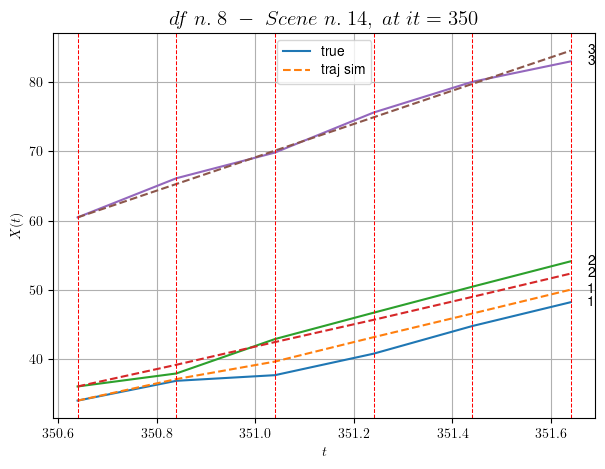

        For scene 14/21
        * use LR_NN=0.0001 with err=14.083955648709598 at it=19
        * v0_scn_mean = 24.530333093102293
        * MAE = 1.5454028321134696



            - Time interval n.0: [368.84, 369.04]
                * y_true: [17.45059381  8.87536169]
                * v_ann: [13.520064353942871, 12.185446739196777, 17.012105849840474]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.04, 369.24]
                * y_true: [23.11801305  8.05829994]
                * v_ann: [15.307043075561523, 12.747060775756836, 17.012105849840474]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.24, 369.44]
                * y_true: [ 6.12528304 15.69072344]
                * v_ann: [10.924558639526367, 14.345404624938965, 17.012105849840474]

--------------------------------------------------------------

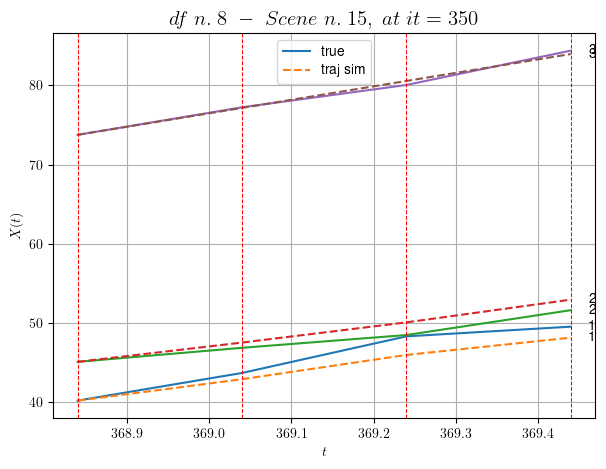

        For scene 15/21
        * use LR_NN=0.001 with err=16.782969482638556 at it=19
        * v0_scn_mean = 18.125259756342167
        * MAE = 1.014661354949947



            - Time interval n.0: [414.44, 414.64]
                * y_true: [25.58017481 23.93124381]
                * v_ann: [22.41219139099121, 21.244182586669922, 14.740338902152256]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [414.64, 414.84]
                * y_true: [28.7103211   9.12051681]
                * v_ann: [22.610193252563477, 21.025850296020508, 14.740338902152256]

----------------------------------------------------------------------------------------------------
            * err= 0.8667874775979838
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 4.54408842831544e-06


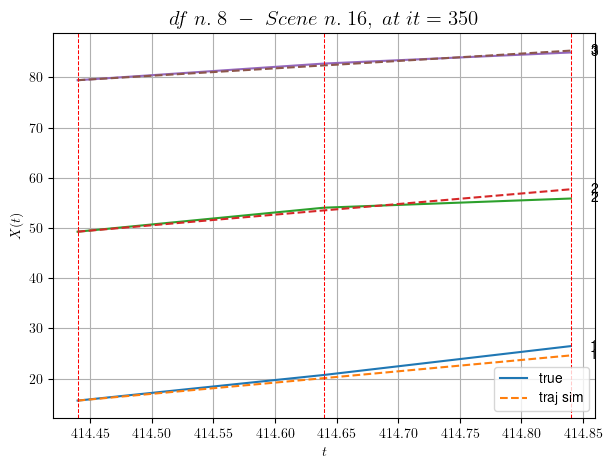

        For scene 16/21
        * use LR_NN=5e-05 with err=6.102099859557323 at it=19
        * v0_scn_mean = 16.048199219348923
        * MAE = 0.8667874775979838



            - Time interval n.0: [477.84, 478.04]
                * y_true: [17.90015387 15.74042221]
                * v_ann: [18.51304054260254, 18.95891571044922, 21.268222396991753]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [478.04, 478.24]
                * y_true: [18.02021575 17.32056356]
                * v_ann: [18.358989715576172, 18.760543823242188, 21.268222396991753]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [478.24, 478.44]
                * y_true: [20.95033635 22.3908747 ]
                * v_ann: [18.289108276367188, 18.6516170501709, 21.268222396991753]

--------------------------------------------------------------------

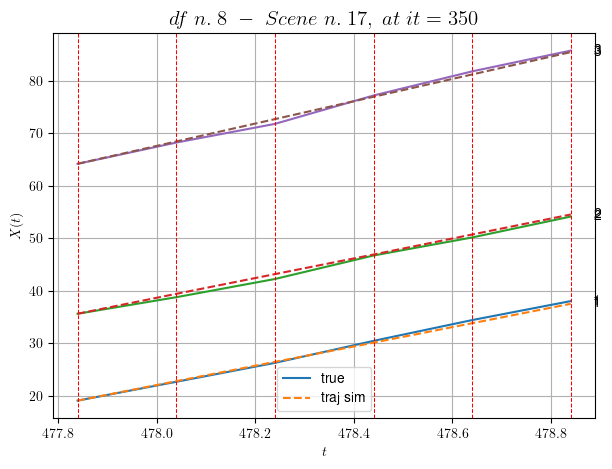

        For scene 17/21
        * use LR_NN=0.0001 with err=15.962712889771707 at it=19
        * v0_scn_mean = 22.016597171001987
        * MAE = 0.21841316844318767



            - Time interval n.0: [522.64, 522.84]
                * y_true: [ 6.78505349 16.71042372]
                * v_ann: [15.175409317016602, 13.235203742980957, 25.156007884721372]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [522.84, 523.04]
                * y_true: [ 7.85007105 23.28071684]
                * v_ann: [14.966771125793457, 12.981854438781738, 25.156007884721372]

----------------------------------------------------------------------------------------------------
            * err= 2.331313728157433
            * Learning rate NN = 7.289998848136747e-06
            * diff = 0.004260245779425631


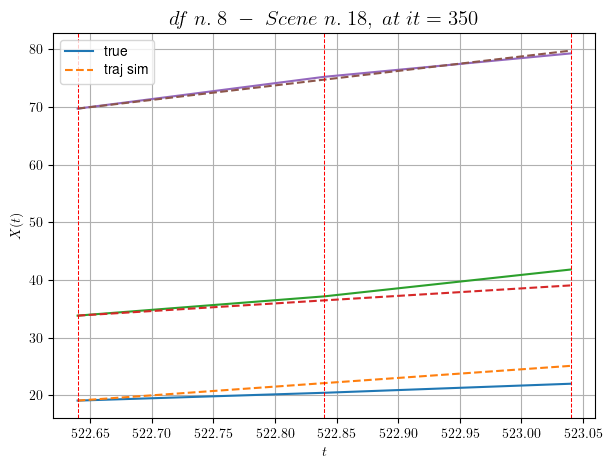

        For scene 18/21
        * use LR_NN=1e-05 with err=0.7688639824539177 at it=19
        * v0_scn_mean = 25.571172089467904
        * MAE = 2.331313728157433



            - Time interval n.0: [593.04, 593.24]
                * y_true: [18.14041096 18.46062677]
                * v_ann: [19.419734954833984, 18.588441848754883, 20.29790615493367]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [593.24, 593.44]
                * y_true: [15.67042287 23.16095213]
                * v_ann: [19.2301025390625, 18.671884536743164, 20.29790615493367]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [593.44, 593.64]
                * y_true: [13.25043489 21.00101152]
                * v_ann: [18.538747787475586, 18.581113815307617, 20.29790615493367]

---------------------------------------------------------------------

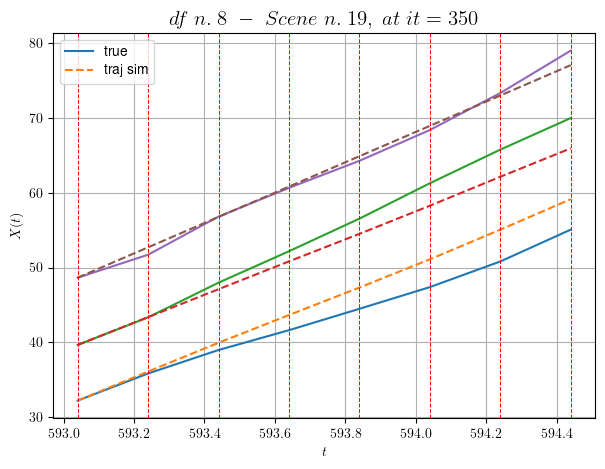

        For scene 19/21
        * use LR_NN=0.001 with err=30.408632152884596 at it=19
        * v0_scn_mean = 21.129443857659837
        * MAE = 4.676178180561989



            - Time interval n.0: [256.44, 256.64]
                * y_true: [ 7.48303167 10.07767618 21.73093279]
                * v_ann: [12.409591674804688, 13.75952434539795, 16.023956298828125, 17.10609187367735]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [256.64, 256.84]
                * y_true: [13.09283525 13.17831107 21.42106847]
                * v_ann: [15.767009735107422, 17.551292419433594, 15.206307411193848, 17.10609187367735]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [256.84, 257.04]
                * y_true: [11.5255681  16.82586504 17.99104223]
                * v_ann: [15.786279678344727, 16.049652099609375, 15.026787757

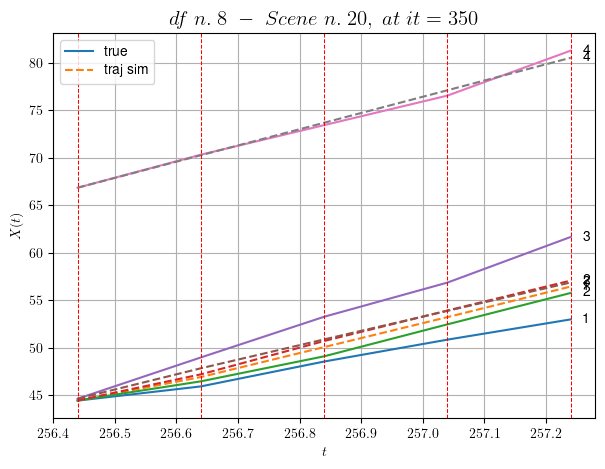

        For scene 20/21
        * use LR_NN=0.001 with err=12.025454658654503 at it=19
        * v0_scn_mean = 18.57781148412369
        * MAE = 3.3604592904911614



For df=8 with 21 scenes, time taken:        234.50
------------------------------------------------------------
****************************************************************************************************
In df n.9/10 we have 9 scenes
****************************************************************************************************
            - Time interval n.0: [5.40, 5.60]
                * y_true: [17.46255149 32.38946228]
                * v_ann: [26.078208923339844, 27.416059494018555, 29.081113719923096]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [5.60, 5.80]
                * y_true: [27.89361325 30.52270411]
                * v_ann: [25.989521026611328, 26.746315002441406, 29.081113719923096]

------------------

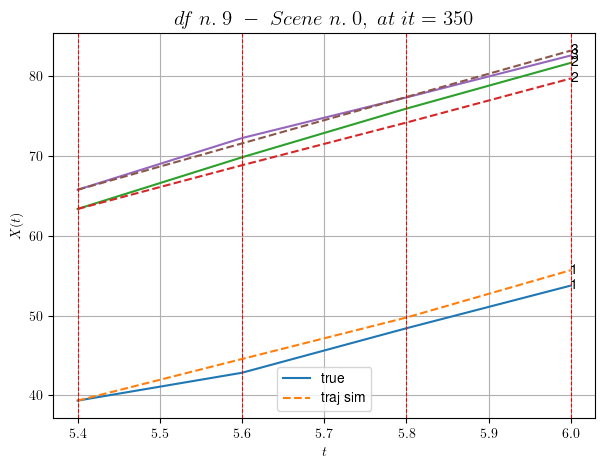

        For scene 0/9
        * use LR_NN=0.001 with err=26.350442972438103 at it=19
        * v0_scn_mean = 29.159868739056456
        * MAE = 1.2089565915068161



            - Time interval n.0: [20.80, 21.00]
                * y_true: [29.01888251 26.46522664]
                * v_ann: [27.753307342529297, 27.43874740600586, 32.733291821512346]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [21.00, 21.20]
                * y_true: [29.93697896 25.84808908]
                * v_ann: [27.885662078857422, 28.185380935668945, 32.733291821512346]

----------------------------------------------------------------------------------------------------
            * err= 0.14354873517188885
            * Learning rate NN = 0.0007289999630302191
            * diff = 3.684650785235055e-06


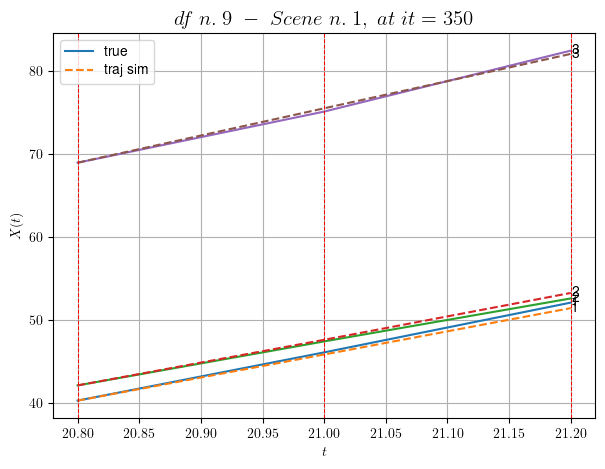

        For scene 1/9
        * use LR_NN=0.001 with err=12.125953831330468 at it=19
        * v0_scn_mean = 32.499029482017754
        * MAE = 0.14125323843330861



            - Time interval n.0: [37.80, 38.00]
                * y_true: [21.35828745 27.25004814]
                * v_ann: [21.608205795288086, 21.849491119384766, 23.63909703244711]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [38.00, 38.20]
                * y_true: [19.23626153 17.91519282]
                * v_ann: [22.63544464111328, 22.449234008789062, 23.63909703244711]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [38.20, 38.40]
                * y_true: [24.96063116 28.62771944]
                * v_ann: [21.05624008178711, 21.473674774169922, 23.63909703244711]

---------------------------------------------------------------------------

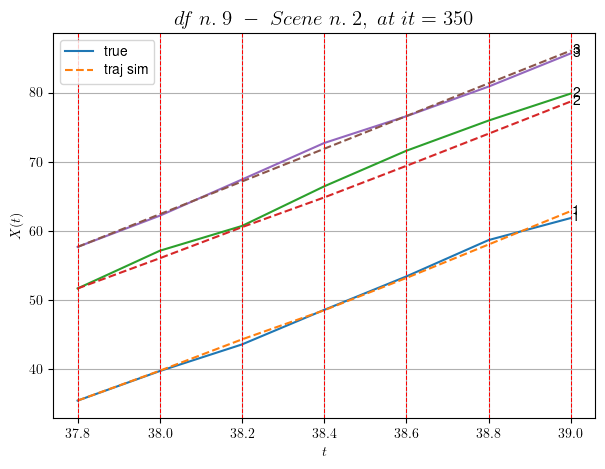

        For scene 2/9
        * use LR_NN=0.001 with err=35.834695960507716 at it=19
        * v0_scn_mean = 24.184271169635398
        * MAE = 0.7803532476399456



            - Time interval n.0: [44.40, 44.60]
                * y_true: [24.95803839 22.94664651]
                * v_ann: [25.095260620117188, 25.506813049316406, 18.01619331410936]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [44.60, 44.80]
                * y_true: [22.38974011 30.85088397]
                * v_ann: [25.01418113708496, 25.29184913635254, 18.01619331410936]

----------------------------------------------------------------------------------------------------
            * err= 0.11667986928003853
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.0006631706210723232


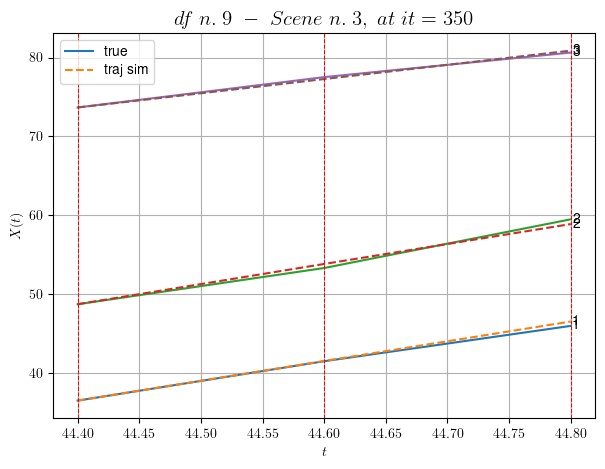

        For scene 3/9
        * use LR_NN=5e-05 with err=5.619798556351753 at it=19
        * v0_scn_mean = 19.043289860549024
        * MAE = 0.09534341687352305



            - Time interval n.0: [117.80, 118.00]
                * y_true: [26.21501314 26.51617559]
                * v_ann: [24.8874568939209, 23.50994110107422, 32.94780433300771]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [118.00, 118.20]
                * y_true: [24.27291409 32.45579962]
                * v_ann: [25.89539909362793, 25.78042221069336, 32.94780433300771]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [118.20, 118.40]
                * y_true: [21.96072195 23.86482679]
                * v_ann: [26.47897720336914, 27.923160552978516, 32.94780433300771]

--------------------------------------------------------------------------

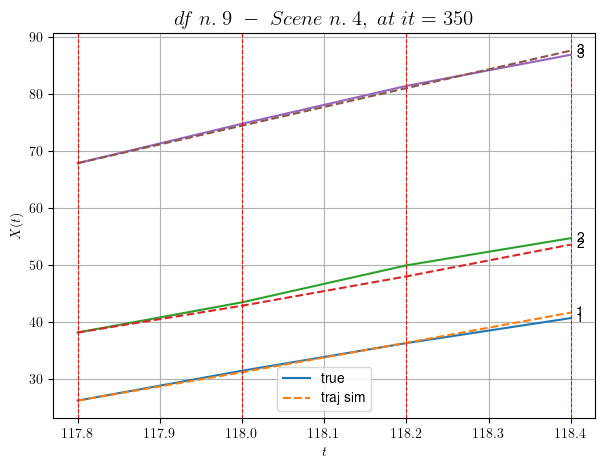

        For scene 4/9
        * use LR_NN=0.0005 with err=7.234828118247265 at it=19
        * v0_scn_mean = 32.69515676205051
        * MAE = 0.555165917767725



            - Time interval n.0: [119.20, 119.40]
                * y_true: [23.20444186 22.52067771]
                * v_ann: [24.794620513916016, 25.432199478149414, 26.734613425844]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [119.40, 119.60]
                * y_true: [27.39348249 26.5570173 ]
                * v_ann: [24.636892318725586, 24.876449584960938, 26.734613425844]

----------------------------------------------------------------------------------------------------
            * err= 0.06289532429629317
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 2.9832785950464902e-05


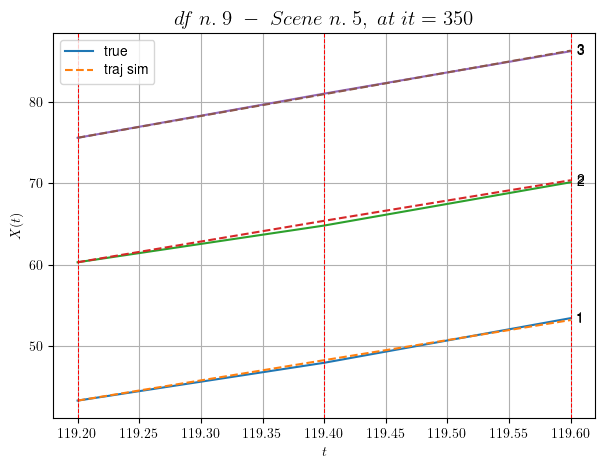

        For scene 5/9
        * use LR_NN=5e-05 with err=0.29413793285417716 at it=19
        * v0_scn_mean = 27.014480029254404
        * MAE = 0.06289532429629317



            - Time interval n.0: [120.20, 120.40]
                * y_true: [30.48045094 26.16776015]
                * v_ann: [26.771320343017578, 26.965017318725586, 27.349006463343738]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [120.40, 120.60]
                * y_true: [26.23623075 25.12734403]
                * v_ann: [27.13734245300293, 27.14867401123047, 27.349006463343738]

----------------------------------------------------------------------------------------------------
            * err= 0.1655647084283802
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 2.355558095584742e-05


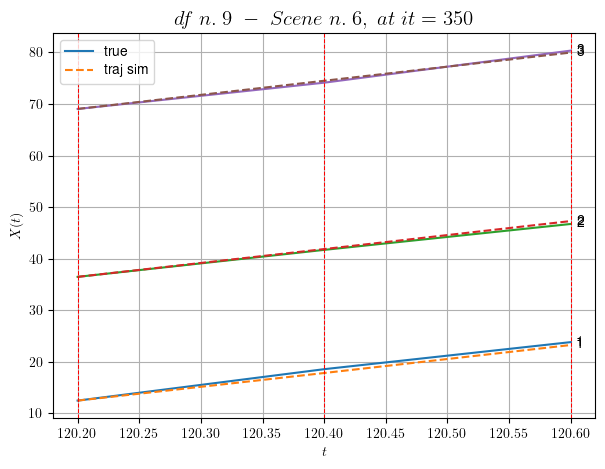

        For scene 6/9
        * use LR_NN=5e-05 with err=1.5726152162962652 at it=19
        * v0_scn_mean = 27.576215260807324
        * MAE = 0.1655647084283802



            - Time interval n.0: [121.40, 121.60]
                * y_true: [23.88369588 31.34452269]
                * v_ann: [27.32489013671875, 25.926368713378906, 28.657538135051936]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.60, 121.80]
                * y_true: [22.66516063 24.1738881 ]
                * v_ann: [25.6968936920166, 27.15896987915039, 28.657538135051936]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.80, 122.00]
                * y_true: [27.39865086 24.79107704]
                * v_ann: [24.096391677856445, 23.876140594482422, 28.657538135051936]

---------------------------------------------------------------------

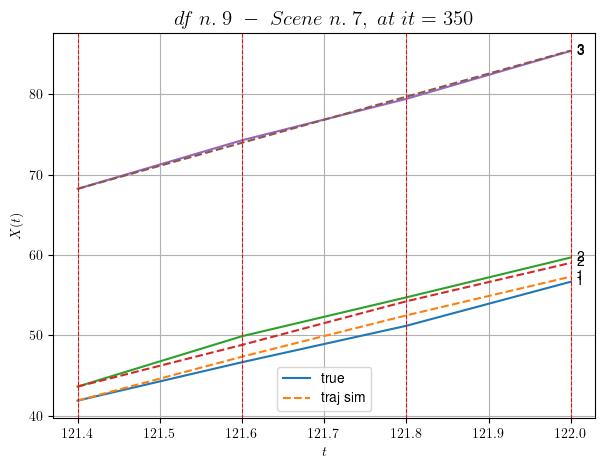

        For scene 7/9
        * use LR_NN=0.001 with err=8.86247032264153 at it=19
        * v0_scn_mean = 28.77259656192382
        * MAE = 0.3397220420146098



            - Time interval n.0: [205.80, 206.00]
                * y_true: [16.81767795  9.52209489]
                * v_ann: [12.486234664916992, 12.033295631408691, 23.158700610445003]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [206.00, 206.20]
                * y_true: [13.65726133  9.1692133 ]
                * v_ann: [12.272615432739258, 12.412636756896973, 23.158700610445003]

----------------------------------------------------------------------------------------------------
            * err= 0.4057549418600122
            * Learning rate NN = 7.289998848136747e-06
            * diff = 7.132127625419926e-05


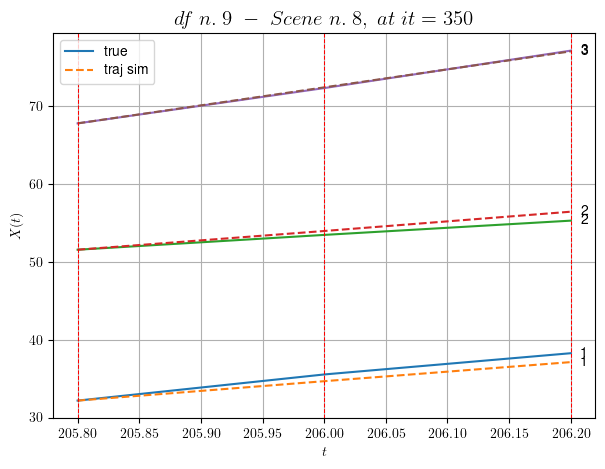

        For scene 8/9
        * use LR_NN=1e-05 with err=1.3245862354653097 at it=19
        * v0_scn_mean = 23.74504810088363
        * MAE = 0.4029091226386778



For df=9 with 9 scenes, time taken:        79.52
------------------------------------------------------------
****************************************************************************************************
In df n.10/10 we have 22 scenes
****************************************************************************************************
            - Time interval n.0: [25.72, 25.92]
                * y_true: [19.85100065 23.2716    ]
                * v_ann: [24.122058868408203, 23.252559661865234, 19.708857945830378]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [25.92, 26.12]
                * y_true: [21.59125574 29.46240542]
                * v_ann: [23.842580795288086, 23.14566421508789, 19.708857945830378]

-----------------

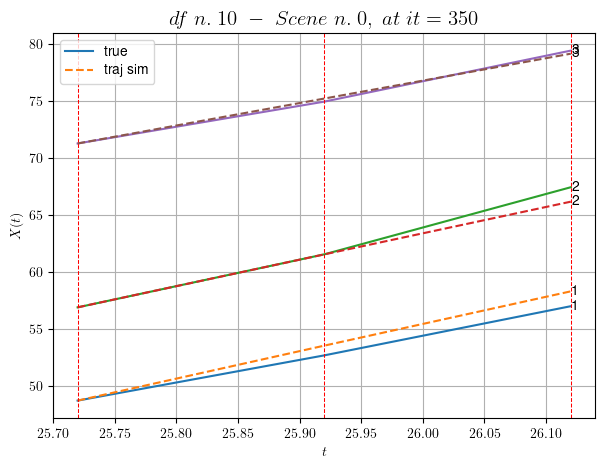

        For scene 0/22
        * use LR_NN=0.0001 with err=2.7699323012935295 at it=19
        * v0_scn_mean = 20.590881224393677
        * MAE = 0.4646843208710638



            - Time interval n.0: [71.72, 71.92]
                * y_true: [25.44045996  0.68637625]
                * v_ann: [15.317845344543457, 16.844135284423828, 24.696218424736607]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [71.92, 72.12]
                * y_true: [ 7.65710886 16.8398502 ]
                * v_ann: [12.552390098571777, 19.907947540283203, 24.696218424736607]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [72.12, 72.32]
                * y_true: [ 0.68637625 22.9307169 ]
                * v_ann: [13.389259338378906, 20.059329986572266, 24.696218424736607]

---------------------------------------------------------------------

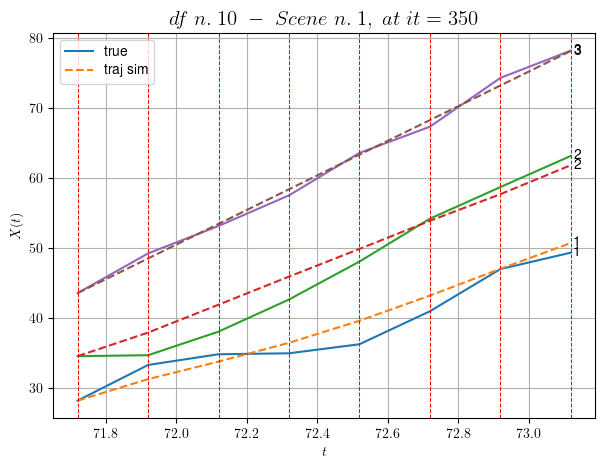

        For scene 1/22
        * use LR_NN=0.0001 with err=12.38310111512898 at it=19
        * v0_scn_mean = 25.15078982110579
        * MAE = 2.964864729266875



            - Time interval n.0: [120.92, 121.12]
                * y_true: [2.40007998 4.01291198]
                * v_ann: [7.110115051269531, 6.616662502288818, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [121.12, 121.32]
                * y_true: [3.94779745 3.96114827]
                * v_ann: [6.967652320861816, 7.819773197174072, 19.875509421847788]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [121.32, 121.52]
                * y_true: [24.74097787  3.92663913]
                * v_ann: [6.702147483825684, 8.554563522338867, 19.875509421847788]

----------------------------------------------------------------------------

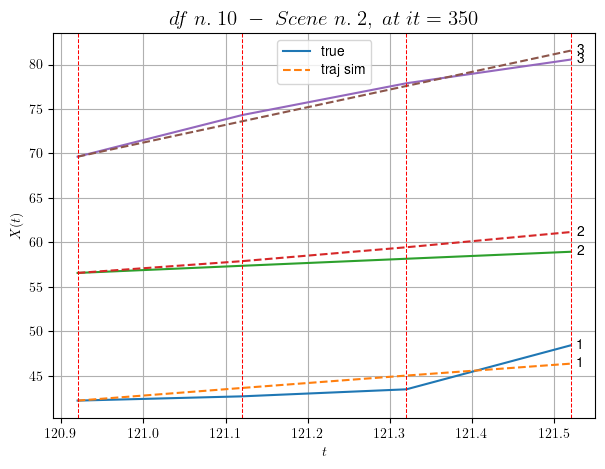

        For scene 2/22
        * use LR_NN=0.0001 with err=6.5410675730950265 at it=19
        * v0_scn_mean = 20.743249496420695
        * MAE = 1.3186110998009042



            - Time interval n.0: [122.12, 122.32]
                * y_true: [20.84138029  3.6661027 ]
                * v_ann: [10.495810508728027, 11.152395248413086, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [122.32, 122.52]
                * y_true: [11.80149783  9.92593948]
                * v_ann: [12.050716400146484, 11.996088027954102, 27.527697849634308]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [122.52, 122.72]
                * y_true: [ 5.61571017 11.00089954]
                * v_ann: [8.484384536743164, 8.401566505432129, 27.527697849634308]

-----------------------------------------------------------------

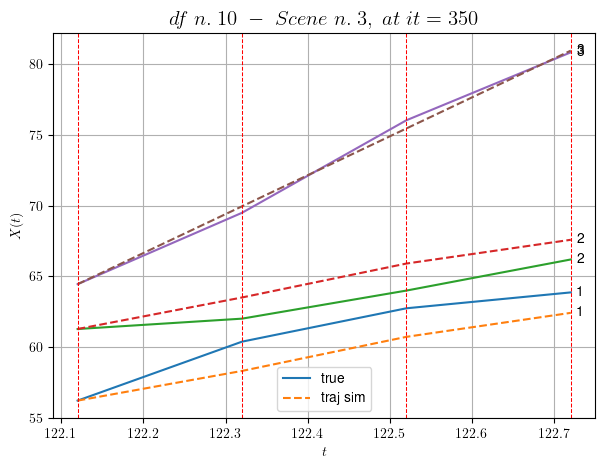

        For scene 3/22
        * use LR_NN=0.01 with err=2.4727108792253745 at it=19
        * v0_scn_mean = 27.73959153808861
        * MAE = 1.5699674019350451



            - Time interval n.0: [194.52, 194.72]
                * y_true: [18.69097642 14.73135237]
                * v_ann: [19.961740493774414, 19.201936721801758, 15.385152268185733]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [194.72, 194.92]
                * y_true: [17.84107996 20.91213867]
                * v_ann: [19.459035873413086, 19.038681030273438, 15.385152268185733]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [194.92, 195.12]
                * y_true: [20.95142105 24.20273885]
                * v_ann: [19.486703872680664, 18.999431610107422, 15.385152268185733]

------------------------------------------------------------------

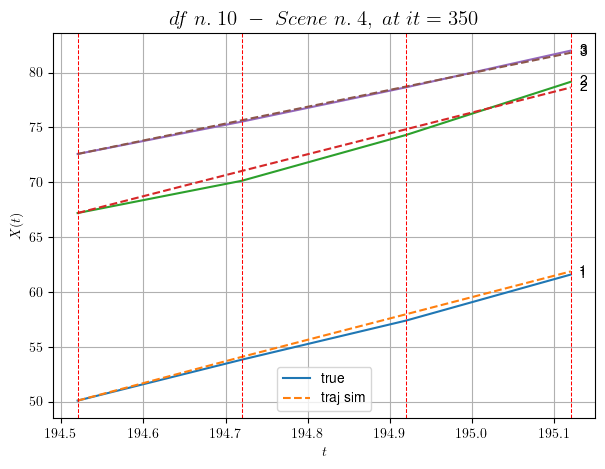

        For scene 4/22
        * use LR_NN=0.0001 with err=15.72014787809197 at it=19
        * v0_scn_mean = 16.63774754325494
        * MAE = 0.15653582804450963



            - Time interval n.0: [201.52, 201.72]
                * y_true: [45.67726396 25.9301702 ]
                * v_ann: [29.26811408996582, 29.891273498535156, 25.79745372457978]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [201.72, 201.92]
                * y_true: [22.15536429 29.26032799]
                * v_ann: [30.518421173095703, 33.94306564331055, 25.79745372457978]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [201.92, 202.12]
                * y_true: [30.43022185 23.25036083]
                * v_ann: [29.004880905151367, 29.535167694091797, 25.79745372457978]

---------------------------------------------------------------------

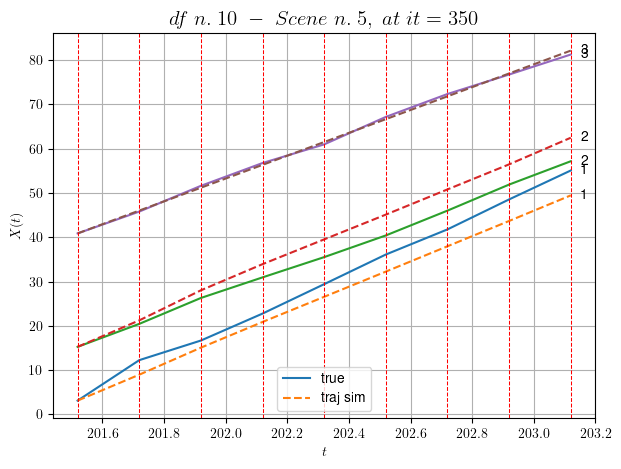

        For scene 5/22
        * use LR_NN=0.0005 with err=130.2358024699718 at it=19
        * v0_scn_mean = 26.157641507884108
        * MAE = 8.68464677509877



            - Time interval n.0: [210.12, 210.32]
                * y_true: [23.65050773 21.02104774]
                * v_ann: [24.085416793823242, 22.944496154785156, 24.38294001142681]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [210.32, 210.52]
                * y_true: [27.53081175 21.02121012]
                * v_ann: [23.9876708984375, 22.580398559570312, 24.38294001142681]

----------------------------------------------------------------------------------------------------
            * err= 0.1201072648853788
            * Learning rate NN = 3.6449993785936385e-05
            * diff = 0.00032118897578364836


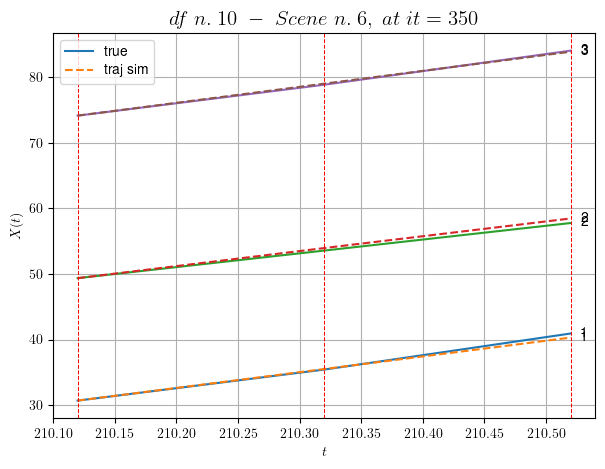

        For scene 6/22
        * use LR_NN=5e-05 with err=2.016640893281314 at it=19
        * v0_scn_mean = 24.8643615719235
        * MAE = 0.10981327213720117



            - Time interval n.0: [236.52, 236.72]
                * y_true: [22.75077388 14.36119092]
                * v_ann: [23.976716995239258, 21.957685470581055, 24.94429728805685]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [236.72, 236.92]
                * y_true: [21.51093715 22.77208028]
                * v_ann: [20.218944549560547, 20.86717987060547, 24.94429728805685]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [236.92, 237.12]
                * y_true: [26.0213192  23.10241688]
                * v_ann: [21.437238693237305, 21.314735412597656, 24.94429728805685]

----------------------------------------------------------------------

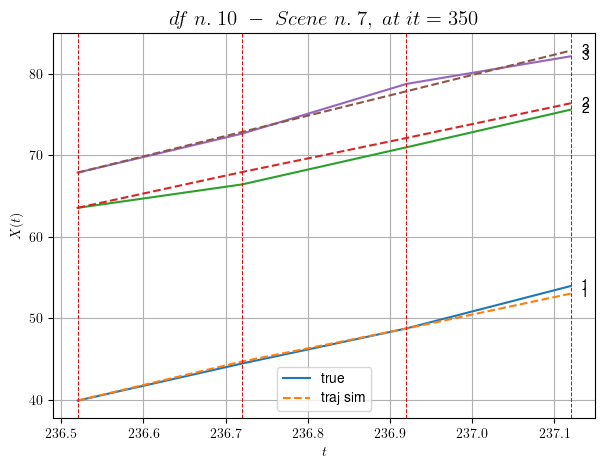

        For scene 7/22
        * use LR_NN=0.0005 with err=8.151488202342538 at it=19
        * v0_scn_mean = 25.377606580451918
        * MAE = 0.4950172696065658



            - Time interval n.0: [237.72, 237.92]
                * y_true: [25.90146221 17.55123599]
                * v_ann: [21.563980102539062, 21.55402946472168, 25.83262255246066]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [237.92, 238.12]
                * y_true: [21.20141323 21.76181979]
                * v_ann: [21.65406608581543, 21.64267921447754, 25.83262255246066]

----------------------------------------------------------------------------------------------------
            * err= 0.3021672081240576
            * Learning rate NN = 0.0007289999630302191
            * diff = 7.806320316661175e-06


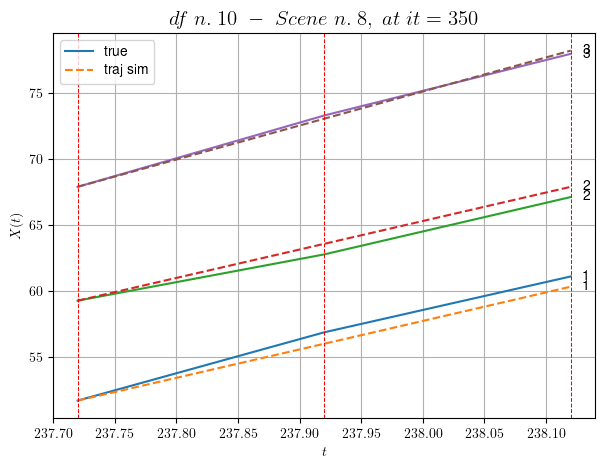

        For scene 8/22
        * use LR_NN=0.001 with err=1.7876520797124718 at it=19
        * v0_scn_mean = 26.189796119781153
        * MAE = 0.3021672081240576



            - Time interval n.0: [317.32, 317.52]
                * y_true: [14.46061508  5.00523108]
                * v_ann: [9.964517593383789, 9.811187744140625, 5.959565079937984]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [317.52, 317.72]
                * y_true: [10.48047894  8.66542797]
                * v_ann: [9.952776908874512, 9.691964149475098, 5.959565079937984]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [317.72, 317.92]
                * y_true: [ 5.95030099 13.38070893]
                * v_ann: [9.568231582641602, 9.536478996276855, 5.959565079937984]

-------------------------------------------------------------------------

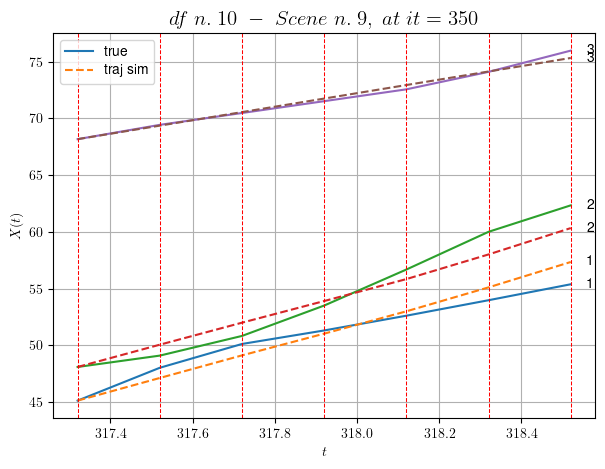

        For scene 9/22
        * use LR_NN=0.005 with err=100.54451620781579 at it=19
        * v0_scn_mean = 8.01999949184941
        * MAE = 0.8884040358885863



            - Time interval n.0: [321.12, 321.32]
                * y_true: [25.50087189 14.95118626]
                * v_ann: [19.649429321289062, 17.51053810119629, 25.32846239154345]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [321.32, 321.52]
                * y_true: [23.87107171  3.25027229]
                * v_ann: [19.2601375579834, 18.077781677246094, 25.32846239154345]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [321.52, 321.72]
                * y_true: [25.04128771 23.00208642]
                * v_ann: [17.917118072509766, 18.831981658935547, 25.32846239154345]

------------------------------------------------------------------------

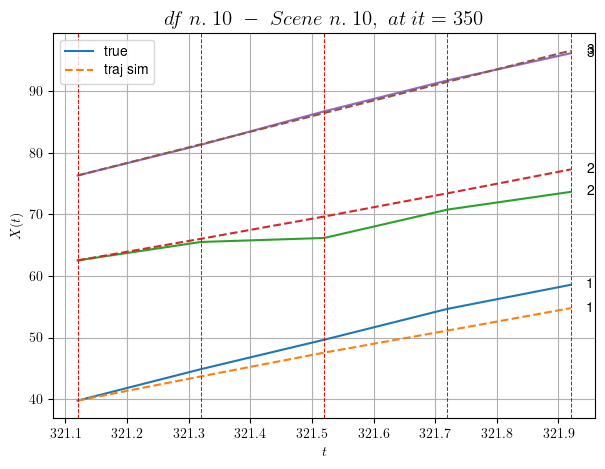

        For scene 10/22
        * use LR_NN=0.0001 with err=4.536175488393177 at it=19
        * v0_scn_mean = 25.728846031731337
        * MAE = 4.217755685466956



            - Time interval n.0: [323.12, 323.32]
                * y_true: [ 6.90008114 15.05052158]
                * v_ann: [11.958904266357422, 11.658111572265625, 13.16143882125472]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [323.32, 323.52]
                * y_true: [ 8.30010994 16.45065772]
                * v_ann: [11.864091873168945, 11.624755859375, 13.16143882125472]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [323.52, 323.72]
                * y_true: [ 9.85014911 16.15074097]
                * v_ann: [11.854814529418945, 11.690439224243164, 13.16143882125472]

----------------------------------------------------------------------

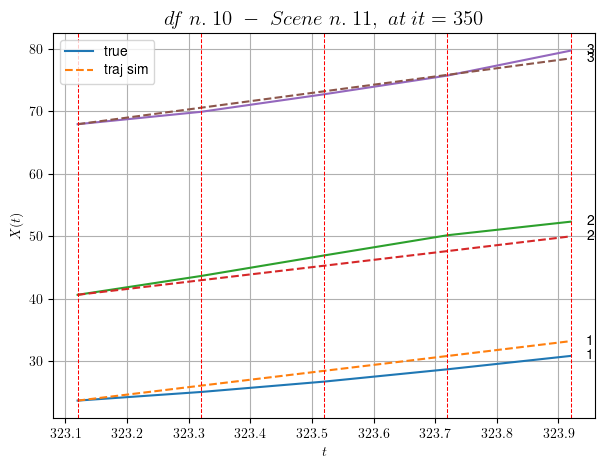

        For scene 11/22
        * use LR_NN=0.0001 with err=21.8706626393296 at it=19
        * v0_scn_mean = 14.604621983919516
        * MAE = 2.0945587456206183



            - Time interval n.0: [337.72, 337.92]
                * y_true: [11.69035174 22.47147634]
                * v_ann: [13.967358589172363, 13.921830177307129, 16.7385402755812]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [337.92, 338.12]
                * y_true: [10.20034007 18.27135214]
                * v_ann: [14.110343933105469, 13.97378158569336, 16.7385402755812]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [338.12, 338.32]
                * y_true: [ 7.94029275 13.91116184]
                * v_ann: [14.15184497833252, 13.975871086120605, 16.7385402755812]

------------------------------------------------------------------------

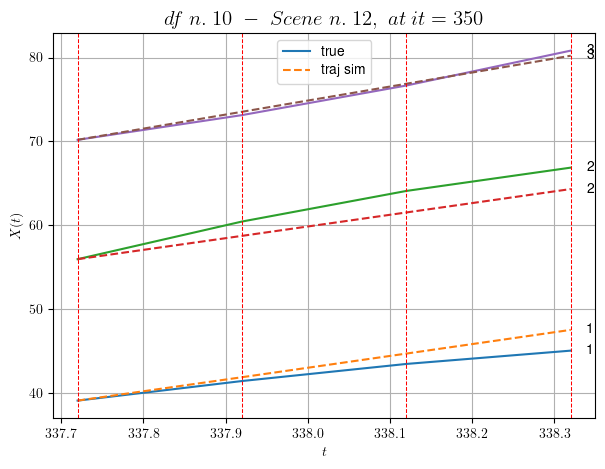

        For scene 12/22
        * use LR_NN=5e-05 with err=12.186335127350562 at it=19
        * v0_scn_mean = 17.87514067649869
        * MAE = 2.0434338495095736



            - Time interval n.0: [369.32, 369.52]
                * y_true: [22.34117259 11.42097363]
                * v_ann: [16.368423461914062, 16.472980499267578, 20.508930553905007]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [369.52, 369.72]
                * y_true: [22.31135956  8.65079743]
                * v_ann: [16.640750885009766, 16.603519439697266, 20.508930553905007]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [369.72, 369.92]
                * y_true: [16.17115552 17.53172003]
                * v_ann: [16.103727340698242, 16.205339431762695, 20.508930553905007]

----------------------------------------------------------------

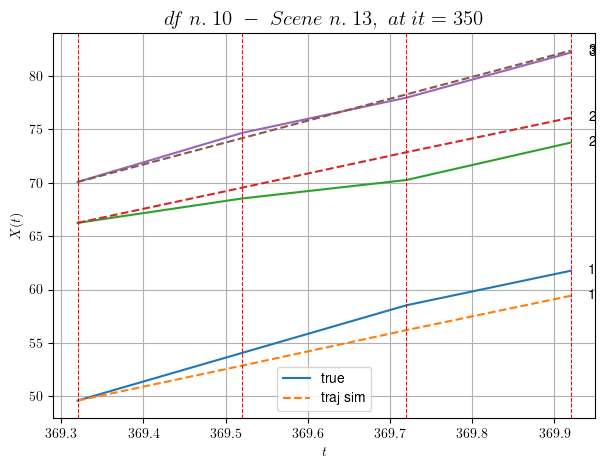

        For scene 13/22
        * use LR_NN=0.001 with err=5.177091562827748 at it=19
        * v0_scn_mean = 21.322381980952716
        * MAE = 2.1619825318641253



            - Time interval n.0: [370.92, 371.12]
                * y_true: [12.30016813 11.70074461]
                * v_ann: [10.181604385375977, 12.002893447875977, 19.89219349162808]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [371.12, 371.32]
                * y_true: [ 9.3501493  10.70073785]
                * v_ann: [10.431709289550781, 9.8702974319458, 19.89219349162808]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [371.32, 371.52]
                * y_true: [ 8.90016062 10.12074395]
                * v_ann: [10.384828567504883, 9.885753631591797, 19.89219349162808]

-----------------------------------------------------------------------

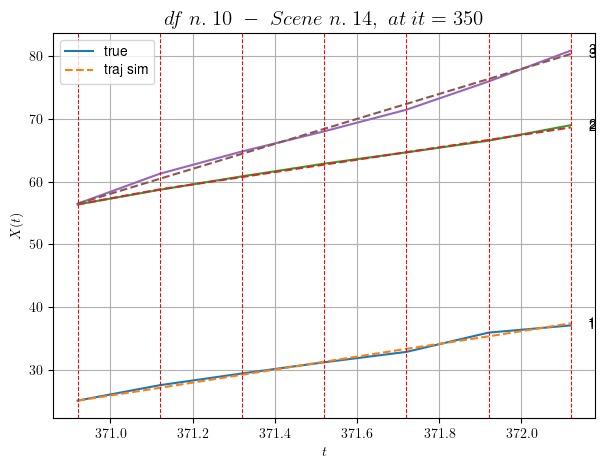

        For scene 14/22
        * use LR_NN=0.0005 with err=27.21484311281394 at it=19
        * v0_scn_mean = 20.75850362403803
        * MAE = 0.15961097815301498



            - Time interval n.0: [376.92, 377.12]
                * y_true: [ 9.78017765 12.68091602]
                * v_ann: [11.02624225616455, 11.06806755065918, 13.629784520488037]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [377.12, 377.32]
                * y_true: [10.39021059 11.81092637]
                * v_ann: [11.107269287109375, 11.097535133361816, 13.629784520488037]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [377.32, 377.52]
                * y_true: [10.59024861 11.25094207]
                * v_ann: [11.105496406555176, 11.097384452819824, 13.629784520488037]

-----------------------------------------------------------------

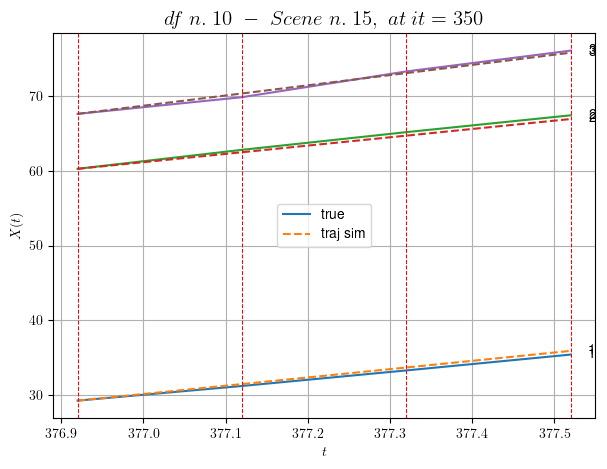

        For scene 15/22
        * use LR_NN=0.0005 with err=15.435517006415935 at it=19
        * v0_scn_mean = 15.032827161627305
        * MAE = 0.1128247951385833



            - Time interval n.0: [433.52, 433.72]
                * y_true: [21.56070162 24.64178312]
                * v_ann: [22.31602668762207, 22.11522674560547, 21.095742864931832]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [433.72, 433.92]
                * y_true: [20.75082718 21.171764  ]
                * v_ann: [22.995845794677734, 22.468629837036133, 21.095742864931832]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [433.92, 434.12]
                * y_true: [19.97093958 25.19244807]
                * v_ann: [21.597110748291016, 21.65867042541504, 21.095742864931832]

-----------------------------------------------------------------

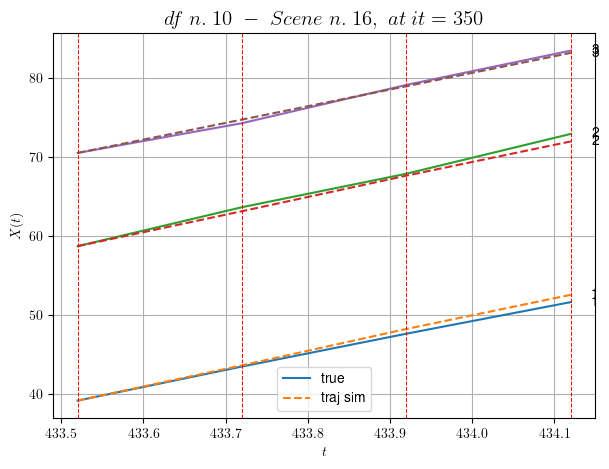

        For scene 16/22
        * use LR_NN=0.0005 with err=7.900277912302076 at it=19
        * v0_scn_mean = 21.8589003483387
        * MAE = 0.2316338293606841



            - Time interval n.0: [483.92, 484.12]
                * y_true: [19.08092085  0.51217506]
                * v_ann: [9.685601234436035, 10.098245620727539, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [484.12, 484.32]
                * y_true: [19.26103904  0.51217506]
                * v_ann: [10.037192344665527, 9.622523307800293, 22.618970274116737]

----------------------------------------------------------------------------------------------------
            * err= 3.920276345322209
            * Learning rate NN = 0.00036449998151510954
            * diff = 0.001291119678379804


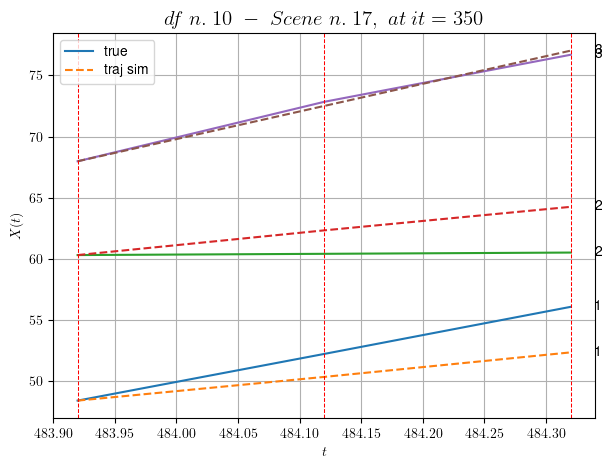

        For scene 17/22
        * use LR_NN=0.0005 with err=4.94363592531242 at it=19
        * v0_scn_mean = 23.251576451713937
        * MAE = 3.920276345322209



            - Time interval n.0: [531.72, 531.92]
                * y_true: [0.21693371 8.7044085 ]
                * v_ann: [9.635086059570312, 8.83483600616455, 18.20525917578688]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [531.92, 532.12]
                * y_true: [13.20333652  9.14775604]
                * v_ann: [9.505600929260254, 8.818337440490723, 18.20525917578688]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [532.12, 532.32]
                * y_true: [18.40074328  5.60188997]
                * v_ann: [9.556031227111816, 8.928913116455078, 18.20525917578688]

-----------------------------------------------------------------------------

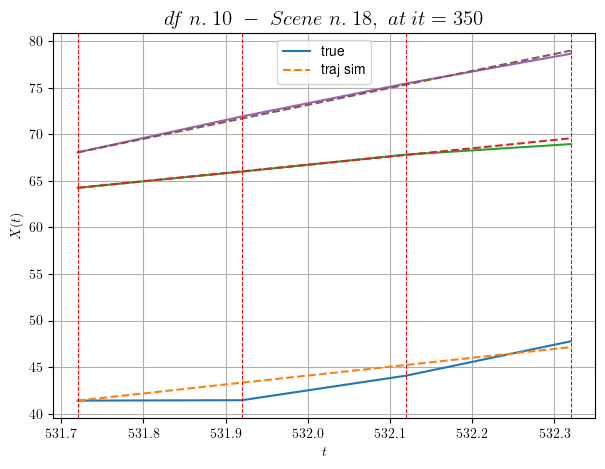

        For scene 18/22
        * use LR_NN=0.0001 with err=8.54122193022448 at it=19
        * v0_scn_mean = 19.216151447685775
        * MAE = 0.48423045632968115



            - Time interval n.0: [202.52, 202.72]
                * y_true: [23.35318258 28.37081651 28.03104175]
                * v_ann: [28.13698387145996, 28.040508270263672, 28.677757263183594, 24.01499562568497]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [202.72, 202.92]
                * y_true: [23.6005682  33.85129081 29.41136895]
                * v_ann: [27.28536605834961, 27.536775588989258, 26.290178298950195, 24.01499562568497]

----------------------------------------------------------------------------------------------------
            - Time interval n.2: [202.92, 203.12]
                * y_true: [26.25082225 32.65166271 26.3315156 ]
                * v_ann: [28.43195343017578, 28.084388732910156, 29.0904502868

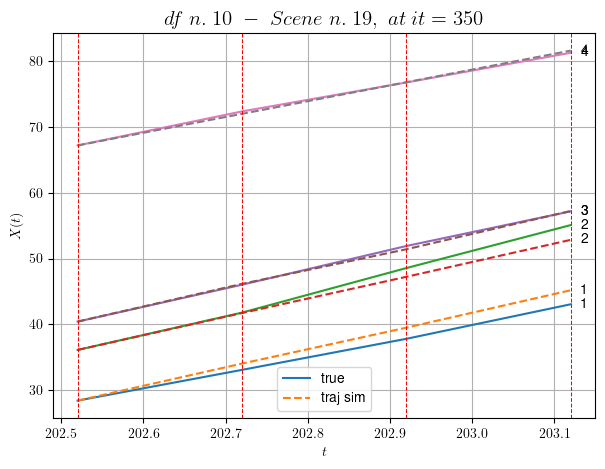

        For scene 19/22
        * use LR_NN=0.0005 with err=21.577677120436732 at it=19
        * v0_scn_mean = 24.69812817324073
        * MAE = 0.9758145339455815



            - Time interval n.0: [342.92, 343.12]
                * y_true: [ 9.90771225 17.81228574 16.23940532]
                * v_ann: [-0.00018376683874521405, 14.74793815612793, -0.00011539077968336642, 15.47360309335659]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [343.12, 343.32]
                * y_true: [13.33029638 14.00078454 21.70124661]
                * v_ann: [-4.604514833772555e-05, 16.280933380126953, -0.00010050649871118367, 15.47360309335659]

----------------------------------------------------------------------------------------------------
            * err= 7.855584251069742
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0001363725671676974


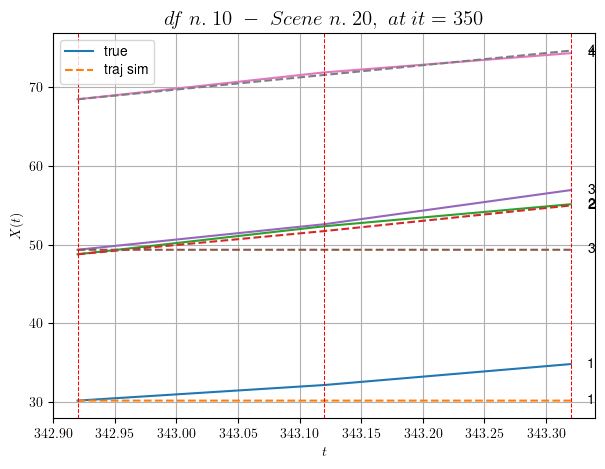

        For scene 20/22
        * use LR_NN=0.001 with err=6.928284193926055 at it=19
        * v0_scn_mean = 17.13165610468422
        * MAE = 7.850443163853512



            - Time interval n.0: [441.12, 441.32]
                * y_true: [16.40031153 12.42055509 15.89074593]
                * v_ann: [15.133246421813965, 16.25887680053711, 15.804729461669922, 19.354115329348666]

----------------------------------------------------------------------------------------------------
            - Time interval n.1: [441.32, 441.52]
                * y_true: [16.46038907  8.18039995 21.4511847 ]
                * v_ann: [14.497634887695312, 14.194046020507812, 14.817099571228027, 19.354115329348666]

----------------------------------------------------------------------------------------------------
            * err= 0.6101820786653118
            * Learning rate NN = 0.0007289999630302191
            * diff = 0.0011634409119390954


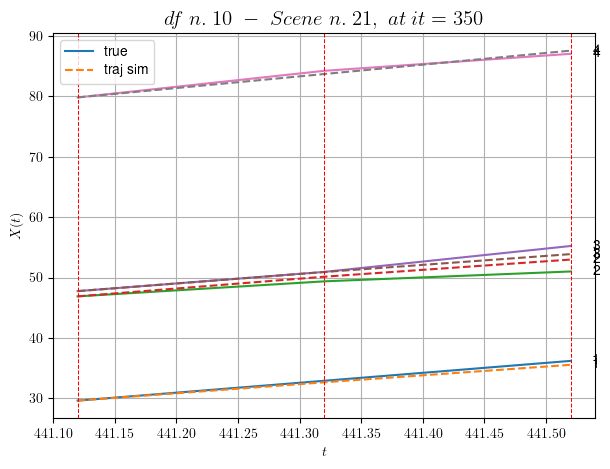

        For scene 21/22
        * use LR_NN=0.001 with err=3.628163499363991 at it=19
        * v0_scn_mean = 20.569243984435406
        * MAE = 0.6101820786653118



For df=10 with 22 scenes, time taken:        239.90
------------------------------------------------------------

Time taken for the computation: 2249.73

Time taken using 1-10-1 NN structure: 2249.75

Time taken for the computation: 6756.51


In [5]:
info_alldataset = []

start_time1 = time.time()
for DOE_struct in DOE:
     
    print("\n")
    print("=="*30)
    
    s = '-'.join(str(x) for x in DOE_struct)
    print(f"NN structure: {s}")

    start_time2 = time.time()
    
    # Create the model
    model = create_model(DOE_struct)
    
    info_dataset = solve_nn_dataset(model, v0_guess, dataset, NUM_ITER, LEARNING_RATE_v0)
    
    # Store info about the NN structure
    nrow = info_dataset.shape[0]
    info_dataset['DOE'] = [DOE_struct]*nrow
    info_dataset['processed'] = [processed_flag]*nrow

    # Append info_dflist
    info_alldataset.append(info_dataset)
    
    time_taken=time.time() - start_time2
    print(f"\nTime taken using {s} NN structure: {'{0:.02f}'.format(time_taken)}")
    
time_taken=time.time() - start_time1
print(f"\nTime taken for the computation: {'{0:.02f}'.format(time_taken)}")

In [6]:
# To better handling info_dataset
tmp = info_alldataset
info_alldataset = pd.concat(tmp, sort=False)

## Prepare the out dir

In [7]:
# Create the directory..
if flag_save:
    
    ext = ".svg"
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-POST")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_alldataset.txt'

    with open(path + namefile, 'w') as output:
        info_alldataset.to_csv(path + namefile, sep=',', index=False)

## Plot

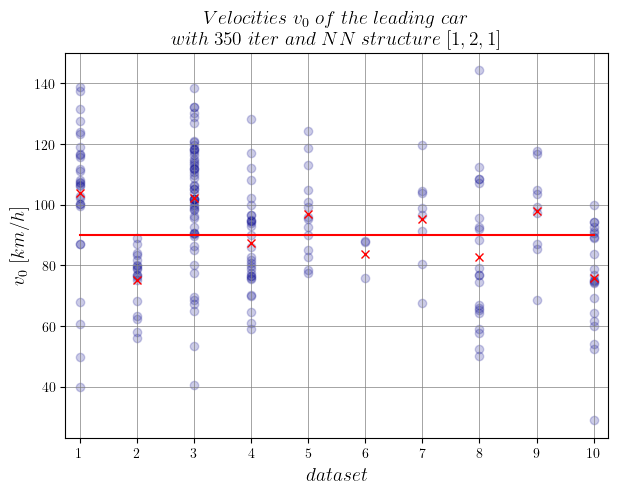

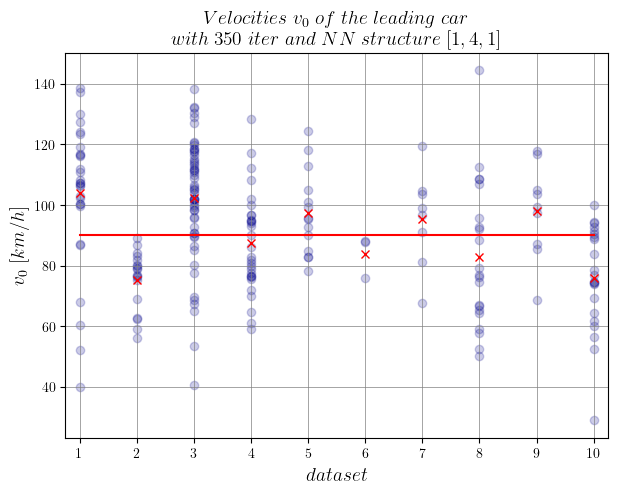

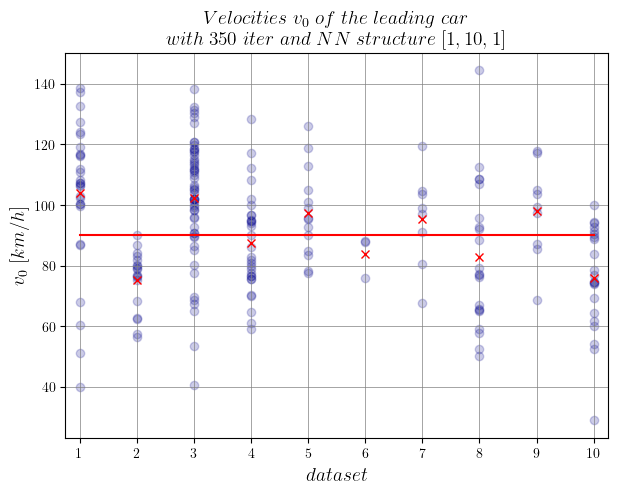

In [8]:
ms2kmh = 3.6

for d in DOE:
    
    # Initialize the figure
    width, height = 7, 5
    fig, ax = plt.subplots(figsize=(width,height))
    
    info_dataset = info_alldataset.loc[info_alldataset['DOE'].isin([d])]
    
    for _, scn in info_dataset.iterrows():

        # Convert velocities to km/h
        v0_scn_mean_kmh = scn['v0_scn_mean']*ms2kmh

        # For each scene, plot v0 mean (averagin over iterations)
        ax.scatter(scn['N. file'], v0_scn_mean_kmh, alpha = .2, color = 'darkblue');

    # For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
    info_grouped = info_dataset.groupby(['N. file']).mean(numeric_only=True)
    for nf, p in info_grouped.iterrows():
        ax.plot(nf, p['v0_scn_mean']*ms2kmh, color = 'r', marker="x")

    # Plot v0 mean over all dfs
    alldfs = [a for a, _ in info_grouped.iterrows()]
    v0_mean_alldfs = info_grouped['v0_scn_mean'].mean()*ms2kmh
    ax.plot(alldfs, [v0_mean_alldfs]*len(alldfs), color = 'r')  

    ax.set_xlabel(r"$data set$",fontsize=14)
    ax.set_ylabel(r"$v_{0}\ [km/h]$",fontsize=14)
    ax.set_title(fr"$Velocities\ v_{0}\ of\ the\ leading\ car$"
                   "\n"  # Newline: the backslash is interpreted as usual
                 fr"$with\ {NUM_ITER}\ iter\ and\ NN\ structure\ {str(d)}$",fontsize=14)

    xlim = [0.75,10.25]
    ax.set_xlim(xlim)
    ax.set_xticks(range(1,11))
    ylim = ax.get_ylim()

    ax.grid(color='grey', linestyle='-', linewidth=0.5);

    plt.show()
    
    # Save figure
    if flag_save:

        title = f"/v0_df{df_seen_str}_{NUM_ITER}it_NN-{str(d[1]).zfill(2)}"     
        fig.savefig(path+title+ext, bbox_inches='tight')

> **WARNING**: The maximal km speed allowed on the highway is 100 h

### Plot togheter

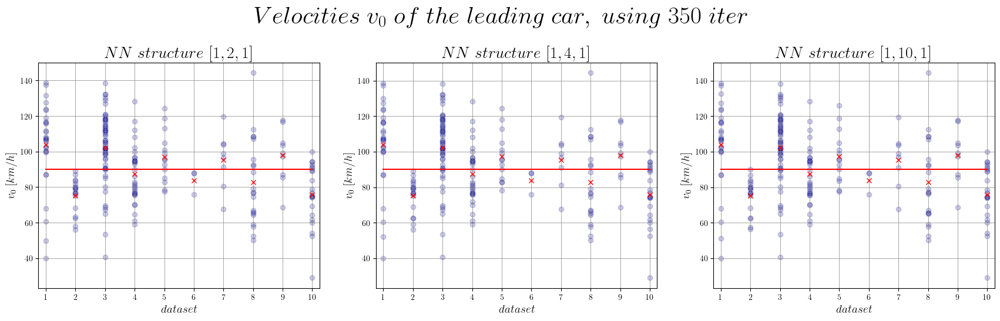

In [9]:
# define subplot grid
width, height = 7, 5
nfig = len(DOE)

fig, axes = plt.subplots(nrows=1, ncols=nfig, figsize = (width*nfig,height))
plt.subplots_adjust(hspace=0.4)

suptitle = fr"$Velocities\ v_{0}\ of\ the\ leading\ car,\ using\ {NUM_ITER}\ iter$"
fig.suptitle(suptitle, fontsize=30, y=1.075)

ms2kmh = 3.6

for ax, d in zip(axes.ravel(), DOE):

    # get the right df
    info_dataset = info_alldataset.loc[info_alldataset['DOE'].isin([d])]
    
    for _, scn in info_dataset.iterrows():

        # Convert velocities to km/h
        v0_scn_mean_kmh = scn['v0_scn_mean']*ms2kmh

        # For each scene, plot v0 mean (averagin over iterations)
        ax.scatter(scn['N. file'], v0_scn_mean_kmh, alpha = .2, color = 'darkblue');

    # For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
    info_grouped = info_dataset.groupby(['N. file']).mean(numeric_only=True)
    for nf, p in info_grouped.iterrows():
        ax.plot(nf, p['v0_scn_mean']*ms2kmh, color = 'r', marker="x")

    # Plot v0 mean over all dfs
    alldfs = [a for a, _ in info_grouped.iterrows()]
    v0_mean_alldfs = info_grouped['v0_scn_mean'].mean()*ms2kmh
    ax.plot(alldfs, [v0_mean_alldfs]*len(alldfs), color = 'r')
        
    ax.set_xlabel(r"$data set$",fontsize=14)
    ax.set_ylabel(r"$v_{0}\ [km/h]$",fontsize=14)
    ax.set_title(fr"$NN\ structure\ {d}$",fontsize=20)

    # Limits
    xlim = [0.75,10.25]
    ax.set_xlim(xlim)
    ax.set_xticks(range(1,11))
    ylim = ax.get_ylim()

    ax.grid(color='grey', linestyle='-', linewidth=0.5);
    
plt.show()

In [10]:
# Save figure
if flag_save:

    title = f"/v0_df{df_seen_str}_{NUM_ITER}it_NN-ALL"     
    fig.savefig(path+title+ext, bbox_inches='tight')

### Plot comparing

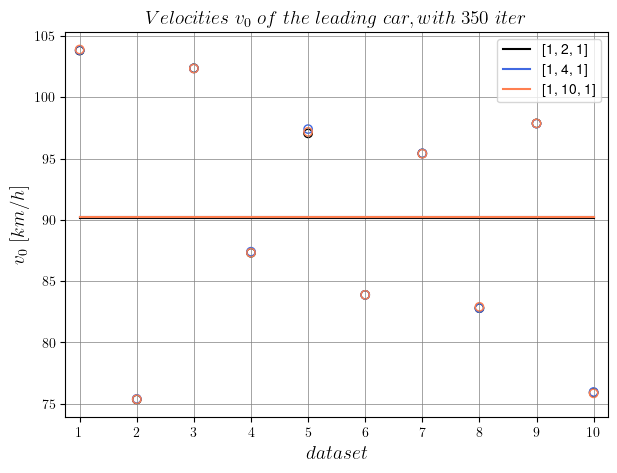

In [11]:
# Initialize the figure
width, height = 7, 5
fig, ax = plt.subplots(figsize=(width,height))

ms2kmh = 3.6

palette = ['black', 'royalblue', 'coral']

for step, d in enumerate(DOE):   
        
    # get the right df
    info_dataset = info_alldataset.loc[info_alldataset['DOE'].isin([d])]
    color = palette[step]

    # For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
    info_grouped = info_dataset.groupby(['N. file']).mean(numeric_only=True)
    for nf, p in info_grouped.iterrows():
        ax.scatter(nf, p['v0_scn_mean']*ms2kmh, facecolors='none', edgecolors=color)

    # Plot v0 mean over all dfs
    alldfs = [a for a, _ in info_grouped.iterrows()]
    v0_mean_alldfs = info_grouped['v0_scn_mean'].mean()*ms2kmh
    ax.plot(alldfs, [v0_mean_alldfs]*len(alldfs), color = color, label=str(d))

ax.set_xlabel(r"$data set$",fontsize=14)
ax.set_ylabel(r"$v_{0}\ [km/h]$",fontsize=14)
ax.set_title(fr"$Velocities\ v_{0}\ of\ the\ leading\ car, with\ {NUM_ITER}\ iter$",fontsize=14)

xlim = [0.75,10.25]
ax.set_xlim(xlim)
ax.set_xticks(range(1,11))
ylim = ax.get_ylim()

ax.legend()
ax.grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

In [12]:
# Save figure
if flag_save:

    title = f"/v0_df{df_seen_str}_{NUM_ITER}iter_NN-ALL-comparing"
    fig.savefig(path+title+ext, bbox_inches='tight')